Code from or based on:
https://github.com/davidADSP/Generative_Deep_Learning_2nd_Edition/blob/main/notebooks/11_music/01_transformer/transformer.ipynb

# Installs & Imports

In [1]:
!pip install -q music21

In [2]:
!apt-get update && apt-get install -y musescore3

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,315 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,526 kB]
Get:13 https://r2u.stat.illinois.edu/ubu

In [3]:
import os
import glob
import pickle as pkl
import numpy as np
import time
import matplotlib.pyplot as plt
from fractions import Fraction

import tensorflow as tf
import keras
from tensorflow.keras import layers, models, losses, callbacks

import warnings
warnings.filterwarnings('ignore', category=UserWarning)

In [4]:
import music21
music21.environment.set('musicxmlPath', '/usr/bin/mscore3')

# Helper Functions

Code from or based on:
https://github.com/davidADSP/Generative_Deep_Learning_2nd_Edition/blob/main/notebooks/11_music/01_transformer/transformer_utils.py

In [5]:
def parse_midi_files(file_list, parser, seq_len, parsed_data_path=None):
    notes_list = []
    duration_list = []
    notes = []
    durations = []

    for i, file in enumerate(file_list):
        print(i + 1, "Parsing %s" % file)
        score = parser.parse(file).chordify()

        notes.append("START")
        durations.append("0.0")

        for element in score.flatten():
            note_name = None
            duration_name = None

            if isinstance(element, music21.key.Key):
                note_name = str(element.tonic.name) + ":" + str(element.mode)
                duration_name = "0.0"

            elif isinstance(element, music21.meter.TimeSignature):
                note_name = str(element.ratioString) + "TS"
                duration_name = "0.0"

            elif isinstance(element, music21.chord.Chord):
                note_name = element.pitches[-1].nameWithOctave
                duration_name = str(element.duration.quarterLength)

            elif isinstance(element, music21.note.Rest):
                note_name = str(element.name)
                duration_name = str(element.duration.quarterLength)

            elif isinstance(element, music21.note.Note):
                note_name = str(element.nameWithOctave)
                duration_name = str(element.duration.quarterLength)

            if note_name and duration_name:
                notes.append(note_name)
                durations.append(duration_name)
        print(f"{len(notes)} notes parsed")

    notes_list = []
    duration_list = []

    print(f"Building sequences of length {seq_len}")
    for i in range(len(notes) - seq_len):
        notes_list.append(" ".join(notes[i : (i + seq_len)]))
        duration_list.append(" ".join(durations[i : (i + seq_len)]))

    if parsed_data_path:
        with open(os.path.join(parsed_data_path, "notes"), "wb") as f:
            pkl.dump(notes_list, f)
        with open(os.path.join(parsed_data_path, "durations"), "wb") as f:
            pkl.dump(duration_list, f)

    return notes_list, duration_list

In [6]:
def load_parsed_files(parsed_data_path):
    with open(os.path.join(parsed_data_path, "notes"), "rb") as f:
        notes = pkl.load(f)
    with open(os.path.join(parsed_data_path, "durations"), "rb") as f:
        durations = pkl.load(f)
    return notes, durations

In [7]:
def get_midi_note(sample_note, sample_duration):
    new_note = None

    if "TS" in sample_note:
        new_note = music21.meter.TimeSignature(sample_note.split("TS")[0])

    elif "major" in sample_note or "minor" in sample_note:
        tonic, mode = sample_note.split(":")
        new_note = music21.key.Key(tonic, mode)

    elif sample_note == "rest":
        new_note = music21.note.Rest()
        new_note.duration = music21.duration.Duration(
            float(Fraction(sample_duration))
        )
        new_note.storedInstrument = music21.instrument.Violoncello()

    elif "." in sample_note:
        notes_in_chord = sample_note.split(".")
        chord_notes = []
        for current_note in notes_in_chord:
            n = music21.note.Note(current_note)
            n.duration = music21.duration.Duration(
                float(Fraction(sample_duration))
            )
            n.storedInstrument = music21.instrument.Violoncello()
            chord_notes.append(n)
        new_note = music21.chord.Chord(chord_notes)

    elif sample_note == "rest":
        new_note = music21.note.Rest()
        new_note.duration = music21.duration.Duration(
            float(Fraction(sample_duration))
        )
        new_note.storedInstrument = music21.instrument.Violoncello()

    elif sample_note != "START":
        new_note = music21.note.Note(sample_note)
        new_note.duration = music21.duration.Duration(
            float(Fraction(sample_duration))
        )
        new_note.storedInstrument = music21.instrument.Violoncello()

    return new_note

Improved sinusoidal position encoding class.

In [8]:
class SinusoidalPositionEncoding(layers.Layer):
    """Sinusoidal positional encoding layer.

    This layer computes a positional encoding tensor using sine and cosine functions
    with geometrically increasing wavelengths, as introduced in
    [Attention Is All You Need](https://arxiv.org/abs/1706.03762).

    The layer expects an input tensor of shape [batch_size, sequence_length, hidden_dim]
    and returns a tensor of the same shape that can be added directly to the input embeddings.

    Args:
        max_wavelength: Maximum angular wavelength for the sine/cosine curves. Default is 10000.

    Examples:
        >>> seq_len = 100
        >>> vocab_size = 1000
        >>> hidden_dim = 32
        >>> inputs = tf.keras.Input((seq_len,), dtype=tf.int32)
        >>> embedding = tf.keras.layers.Embedding(input_dim=vocab_size, output_dim=hidden_dim)(inputs)
        >>> pos_encoding = SinusoidalPositionEncoding()(embedding)
        >>> outputs = embedding + pos_encoding

    References:
        - Vaswani et al., 2017: https://arxiv.org/abs/1706.03762
    """

    def __init__(self, max_wavelength=10000, **kwargs):
        super().__init__(**kwargs)
        self.max_wavelength = max_wavelength

    def call(self, inputs):
        # inputs shape: [batch_size, sequence_length, hidden_dim]
        input_shape = tf.shape(inputs)
        seq_length = input_shape[-2]
        hidden_dim = input_shape[-1]

        # Create a vector of positions [0, 1, ..., seq_length - 1]
        positions = tf.cast(tf.range(seq_length), self.compute_dtype)

        # Compute the inverse of max_wavelength
        inv_max_wavelength = tf.cast(1.0 / self.max_wavelength, self.compute_dtype)

        # Compute the exponent for each dimension: [0, 0, 2/hidden_dim, 2/hidden_dim, 4/hidden_dim, ...]
        exponent = tf.cast(2 * (tf.range(hidden_dim) // 2), self.compute_dtype) / tf.cast(hidden_dim, self.compute_dtype)
        timescales = tf.pow(inv_max_wavelength, exponent)

        # Compute the angles: each position scaled by the corresponding timescale
        angle_rates = tf.expand_dims(positions, 1) * tf.expand_dims(timescales, 0)

        # Apply sin to even indices and cos to odd indices
        # Create masks: even indices (0, 2, 4, ...) and odd indices (1, 3, 5, ...)
        even_mask = 1 - tf.cast(tf.range(hidden_dim) % 2, self.compute_dtype)
        odd_mask = tf.cast(tf.range(hidden_dim) % 2, self.compute_dtype)
        pos_encoding = tf.sin(angle_rates) * even_mask + tf.cos(angle_rates) * odd_mask

        # Broadcast the positional encoding across the batch dimension
        return tf.broadcast_to(pos_encoding, input_shape)

    def get_config(self):
        config = super().get_config()
        config.update({"max_wavelength": self.max_wavelength})
        return config

# Data Loading

In [9]:
%%bash
mkdir -p bach-cello
cd bach-cello
echo "Downloading Bach cello MIDI files..."
curl -O http://www.jsbach.net/midi/cs1-1pre.mid -s
curl -O http://www.jsbach.net/midi/cs1-2all.mid -s
curl -O http://www.jsbach.net/midi/cs1-3cou.mid -s
curl -O http://www.jsbach.net/midi/cs1-4sar.mid -s
curl -O http://www.jsbach.net/midi/cs1-5men.mid -s
curl -O http://www.jsbach.net/midi/cs1-6gig.mid -s
curl -O http://www.jsbach.net/midi/cs2-1pre.mid -s
curl -O http://www.jsbach.net/midi/cs2-2all.mid -s
curl -O http://www.jsbach.net/midi/cs2-3cou.mid -s
curl -O http://www.jsbach.net/midi/cs2-4sar.mid -s
curl -O http://www.jsbach.net/midi/cs2-5men.mid -s
curl -O http://www.jsbach.net/midi/cs2-6gig.mid -s
curl -O http://www.jsbach.net/midi/cs3-1pre.mid -s
curl -O http://www.jsbach.net/midi/cs3-2all.mid -s
curl -O http://www.jsbach.net/midi/cs3-3cou.mid -s
curl -O http://www.jsbach.net/midi/cs3-4sar.mid -s
curl -O http://www.jsbach.net/midi/cs3-5bou.mid -s
curl -O http://www.jsbach.net/midi/cs3-6gig.mid -s
curl -O http://www.jsbach.net/midi/cs4-1pre.mid -s
curl -O http://www.jsbach.net/midi/cs4-2all.mid -s
curl -O http://www.jsbach.net/midi/cs4-3cou.mid -s
curl -O http://www.jsbach.net/midi/cs4-4sar.mid -s
curl -O http://www.jsbach.net/midi/cs4-5bou.mid -s
curl -O http://www.jsbach.net/midi/cs4-6gig.mid -s
curl -O http://www.jsbach.net/midi/cs5-1pre.mid -s
curl -O http://www.jsbach.net/midi/cs5-2all.mid -s
curl -O http://www.jsbach.net/midi/cs5-3cou.mid -s
curl -O http://www.jsbach.net/midi/cs5-4sar.mid -s
curl -O http://www.jsbach.net/midi/cs5-5gav.mid -s
curl -O http://www.jsbach.net/midi/cs5-6gig.mid -s
curl -O http://www.jsbach.net/midi/cs6-1pre.mid -s
curl -O http://www.jsbach.net/midi/cs6-2all.mid -s
curl -O http://www.jsbach.net/midi/cs6-3cou.mid -s
curl -O http://www.jsbach.net/midi/cs6-4sar.mid -s
curl -O http://www.jsbach.net/midi/cs6-5gav.mid -s
curl -O http://www.jsbach.net/midi/cs6-6gig.mid -s
echo "Download complete!"

Download complete!


In [10]:
# Load the data
file_list = glob.glob("bach-cello/*.mid")
print(f"Found {len(file_list)} MIDI files")

Found 36 MIDI files


# Data Parsing

In [11]:
# Set parameters
os.makedirs('/content/parsed_data', exist_ok=True)
PARSED_DATA_PATH = "/content/parsed_data/"
PARSE_MIDI_FILES = True
DATASET_REPETITIONS = 1

SEQ_LEN = 50
EMBEDDING_DIM = 256
KEY_DIM = 256
N_HEADS = 5
DROPOUT_RATE = 0.3
FEED_FORWARD_DIM = 256
LOAD_MODEL = False

EPOCHS = 1000
BATCH_SIZE = 256

GENERATE_LEN = 50

In [12]:
# Initialize the parser
parser = music21.converter

In [13]:
# Example score
example_score = (
    music21.converter.parse(file_list[1]).splitAtQuarterLength(12)[0].chordify()
)

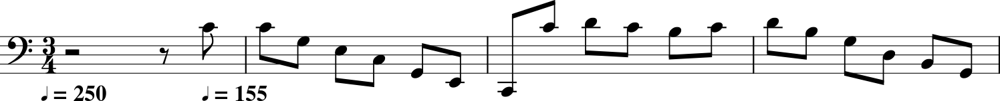

In [14]:
# Show the score
example_score.show()

In [15]:
# Show the score text
example_score.show("text")

{0.0} <music21.metadata.Metadata object at 0x7bc04590ea90>
{0.0} <music21.stream.Measure 1 offset=0.0>
    {0.0} <music21.instrument.Violoncello 'Solo Cello: Solo Cello'>
    {0.0} <music21.instrument.Violoncello 'Violoncello'>
    {0.0} <music21.clef.BassClef>
    {0.0} <music21.tempo.MetronomeMark Quarter=250>
    {0.0} <music21.key.Key of C major>
    {0.0} <music21.meter.TimeSignature 3/4>
    {0.0} <music21.note.Rest 2.5ql>
    {2.5} <music21.tempo.MetronomeMark Quarter=155>
    {2.5} <music21.chord.Chord C4>
{3.0} <music21.stream.Measure 2 offset=3.0>
    {0.0} <music21.chord.Chord C4>
    {0.5} <music21.chord.Chord G3>
    {1.0} <music21.chord.Chord E3>
    {1.5} <music21.chord.Chord C3>
    {2.0} <music21.chord.Chord G2>
    {2.5} <music21.chord.Chord E2>
{6.0} <music21.stream.Measure 3 offset=6.0>
    {0.0} <music21.chord.Chord C2>
    {0.5} <music21.chord.Chord C4>
    {1.0} <music21.chord.Chord D4>
    {1.5} <music21.chord.Chord C4>
    {2.0} <music21.chord.Chord B3>
    {2.

In [16]:
# Parse the MIDI files
if PARSE_MIDI_FILES:
    notes, durations = parse_midi_files(
        file_list, parser, SEQ_LEN + 1, PARSED_DATA_PATH
    )
else:
    notes, durations = load_parsed_files()

1 Parsing bach-cello/cs5-2all.mid
692 notes parsed
2 Parsing bach-cello/cs3-3cou.mid
1681 notes parsed
3 Parsing bach-cello/cs5-1pre.mid
2990 notes parsed
4 Parsing bach-cello/cs6-1pre.mid
4332 notes parsed
5 Parsing bach-cello/cs5-6gig.mid
4781 notes parsed
6 Parsing bach-cello/cs4-3cou.mid
5703 notes parsed
7 Parsing bach-cello/cs2-4sar.mid
6040 notes parsed
8 Parsing bach-cello/cs2-3cou.mid
6781 notes parsed
9 Parsing bach-cello/cs4-5bou.mid
8105 notes parsed
10 Parsing bach-cello/cs4-6gig.mid
9076 notes parsed
11 Parsing bach-cello/cs2-6gig.mid
9811 notes parsed
12 Parsing bach-cello/cs6-5gav.mid
10617 notes parsed
13 Parsing bach-cello/cs1-4sar.mid
10880 notes parsed
14 Parsing bach-cello/cs1-5men.mid
11527 notes parsed
15 Parsing bach-cello/cs5-5gav.mid
12729 notes parsed
16 Parsing bach-cello/cs6-2all.mid
13414 notes parsed
17 Parsing bach-cello/cs2-2all.mid
14107 notes parsed
18 Parsing bach-cello/cs4-2all.mid
15162 notes parsed
19 Parsing bach-cello/cs3-1pre.mid
16143 notes pa

In [17]:
# Validate example results
example_notes = notes[658]
example_durations = durations[658]
print("Notes string\n", example_notes, "...")
print("\nDuration string\n", example_durations, "...")

Notes string
 D4 B3 C4 B3 F3 G3 G#3 G3 F3 E-3 D3 C3 B2 C3 D3 E-3 F3 D3 G#2 B3 C4 B3 A3 G3 C4 F#3 G3 E-4 D4 E-4 F4 D4 B3 C4 START C:major 3/4TS rest C4 C4 G3 E3 C3 G2 E2 C2 C4 D4 C4 B3 C4 ...

Duration string
 0.25 0.25 0.5 0.5 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.25 0.75 0.25 0.25 0.25 0.25 0.25 1.5 0.5 0.75 0.25 0.25 0.25 0.25 0.25 1.5 0.5 0.0 0.0 0.0 2.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 ...


# Data Tokenization

In [18]:
def create_dataset(elements):
    ds = (
        tf.data.Dataset.from_tensor_slices(elements)
        .batch(BATCH_SIZE, drop_remainder=True)
        .shuffle(1000)
    )
    vectorize_layer = layers.TextVectorization(
        standardize=None, output_mode="int"
    )
    vectorize_layer.adapt(ds)
    vocab = vectorize_layer.get_vocabulary()
    return ds, vectorize_layer, vocab

In [19]:
# Create the dataset
notes_seq_ds, notes_vectorize_layer, notes_vocab = create_dataset(notes)
durations_seq_ds, durations_vectorize_layer, durations_vocab = create_dataset(
    durations
)
seq_ds = tf.data.Dataset.zip((notes_seq_ds, durations_seq_ds))

In [20]:
# Extract example notes and durations
example_tokenised_notes = notes_vectorize_layer(example_notes)
example_tokenised_durations = durations_vectorize_layer(example_durations)

# Create a header for the table
header = f"{'Note Token':>12} | {'Duration Token':>15}"
print(header)
print("-" * len(header))

# Print each pair in aligned columns
for note_int, duration_int in zip(
    example_tokenised_notes.numpy()[:11],
    example_tokenised_durations.numpy()[:11],
):
    print(f"{note_int:>12} | {duration_int:>15}")

  Note Token |  Duration Token
------------------------------
           7 |               2
           9 |               2
           6 |               3
           9 |               3
           5 |               2
           2 |               2
          14 |               2
           2 |               2
           5 |               2
          10 |               2
           4 |               2


In [21]:
# Get vocab sizes
notes_vocab_size = len(notes_vocab)
durations_vocab_size = len(durations_vocab)

# Display token:note mappings
print(f"NOTES_VOCAB: length = {len(notes_vocab)}")
for i, note in enumerate(notes_vocab[:10]):
    print(f"{i}: {note}")

print(f"\nDURATIONS_VOCAB: length = {len(durations_vocab)}")
# Display token:duration mappings
for i, note in enumerate(durations_vocab[:10]):
    print(f"{i}: {note}")

NOTES_VOCAB: length = 59
0: 
1: [UNK]
2: G3
3: A3
4: D3
5: F3
6: C4
7: D4
8: E3
9: B3

DURATIONS_VOCAB: length = 24
0: 
1: [UNK]
2: 0.25
3: 0.5
4: 1.0
5: 1/3
6: 0.75
7: 1/12
8: 1.5
9: 0.0


In [22]:
def prepare_inputs(notes, durations):
    """
    Prepare input and target pairs by tokenizing the sequences and shifting by one.

    Args:
        notes: A tensor/string tensor representing the note sequences.
        durations: A tensor/string tensor representing the duration sequences.

    Returns:
        A tuple (x, y) where:
          x is a tuple of tokenized notes and durations (excluding the last token)
          y is a tuple of tokenized notes and durations (excluding the first token)
    """
    notes = tf.expand_dims(notes, -1)
    durations = tf.expand_dims(durations, -1)
    tokenized_notes = notes_vectorize_layer(notes)
    tokenized_durations = durations_vectorize_layer(durations)
    x = (tokenized_notes[:, :-1], tokenized_durations[:, :-1])
    y = (tokenized_notes[:, 1:], tokenized_durations[:, 1:])
    return x, y

In [23]:
# Create the training set of sequences and the same sequences shifted by one note
ds = seq_ds.map(prepare_inputs).repeat(DATASET_REPETITIONS)

In [24]:
# Print example
example_input_output = ds.take(1).get_single_element()
print(example_input_output)

((<tf.Tensor: shape=(256, 50), dtype=int64, numpy=
array([[ 9,  6,  7, ...,  9,  3, 10],
       [ 6,  7,  9, ...,  3, 10,  3],
       [ 7,  9,  6, ..., 10,  3,  9],
       ...,
       [ 2,  5,  8, ..., 13, 11,  3],
       [ 5,  8,  5, ..., 11,  3,  2],
       [ 8,  5, 19, ...,  3,  2,  3]])>, <tf.Tensor: shape=(256, 50), dtype=int64, numpy=
array([[3, 3, 3, ..., 2, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       ...,
       [2, 2, 2, ..., 3, 3, 3],
       [2, 2, 2, ..., 3, 3, 3],
       [2, 2, 2, ..., 3, 3, 3]])>), (<tf.Tensor: shape=(256, 50), dtype=int64, numpy=
array([[ 6,  7,  9, ...,  3, 10,  3],
       [ 7,  9,  6, ..., 10,  3,  9],
       [ 9,  6,  7, ...,  3,  9,  6],
       ...,
       [ 5,  8,  5, ..., 11,  3,  2],
       [ 8,  5, 19, ...,  3,  2,  3],
       [ 5, 19, 29, ...,  2,  3, 13]])>, <tf.Tensor: shape=(256, 50), dtype=int64, numpy=
array([[3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       ...,

# Model Definition

In [25]:
def causal_attention_mask(batch_size, n_dest, n_src, dtype):
    """
    Create a causal attention mask to ensure each position in the output
    only attends to positions at or before it.

    Args:
        batch_size (int): Number of sequences in the batch.
        n_dest (int): Length of the destination sequence.
        n_src (int): Length of the source sequence.
        dtype: The data type of the mask (e.g., tf.bool or tf.float32).

    Returns:
        A tensor of shape [batch_size, n_dest, n_src] representing the causal mask.
    """
    i = tf.range(n_dest)[:, None]
    j = tf.range(n_src)
    # When n_dest == n_src, this produces a lower-triangular mask
    m = i >= j - n_src + n_dest
    mask = tf.cast(m, dtype)
    mask = tf.reshape(mask, [1, n_dest, n_src])
    return tf.tile(mask, [batch_size, 1, 1])

# Check the attention mask
np.transpose(causal_attention_mask(1, 10, 10, dtype=tf.int32)[0])

array([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 1]], dtype=int32)

In [26]:
class TokenAndPositionEmbedding(layers.Layer):
    """
    Combines token embedding with fixed sinusoidal positional encoding.
    """
    def __init__(self, vocab_size, embed_dim, **kwargs):
        super(TokenAndPositionEmbedding, self).__init__(**kwargs)
        self.vocab_size = vocab_size
        self.embed_dim = embed_dim
        self.token_emb = layers.Embedding(
            input_dim=vocab_size,
            output_dim=embed_dim,
            embeddings_initializer="he_uniform"
        )
        self.pos_emb = SinusoidalPositionEncoding()

    def call(self, x):
        token_embeddings = self.token_emb(x)
        pos_embeddings = self.pos_emb(token_embeddings)
        return token_embeddings + pos_embeddings

    def get_config(self):
        config = super().get_config()
        config.update({
            "vocab_size": self.vocab_size,
            "embed_dim": self.embed_dim,
        })
        return config

In [27]:
class TransformerBlock(layers.Layer):
    """
    Transformer encoder block with causal self-attention and a feed-forward network.
    """
    def __init__(self, num_heads, key_dim, embed_dim, ff_dim, dropout_rate=DROPOUT_RATE, **kwargs):
        super(TransformerBlock, self).__init__(**kwargs)
        self.num_heads = num_heads
        self.key_dim = key_dim
        self.embed_dim = embed_dim
        self.ff_dim = ff_dim
        self.dropout_rate = dropout_rate

        self.attn = layers.MultiHeadAttention(num_heads=num_heads, key_dim=key_dim, output_shape=embed_dim)
        self.dropout_1 = layers.Dropout(dropout_rate)
        self.ln_1 = layers.LayerNormalization(epsilon=1e-6)
        self.ffn_1 = layers.Dense(ff_dim, activation="relu")
        self.ffn_2 = layers.Dense(embed_dim)
        self.dropout_2 = layers.Dropout(dropout_rate)
        self.ln_2 = layers.LayerNormalization(epsilon=1e-6)

    def call(self, inputs, training=False):
        """
        Args:
            inputs: Tensor of shape [batch_size, seq_len, embed_dim].
            training (bool): Whether in training mode.

        Returns:
            A tuple (output, attention_scores) where:
              output: The output of the Transformer block.
              attention_scores: The attention weights from the multi-head attention.
        """
        input_shape = tf.shape(inputs)
        batch_size = input_shape[0]
        seq_len = input_shape[1]
        # Create causal mask
        causal_mask = causal_attention_mask(batch_size, seq_len, seq_len, tf.bool)

        attention_output, attention_scores = self.attn(
            inputs,
            inputs,
            attention_mask=causal_mask,
            return_attention_scores=True,
            training=training
        )
        attention_output = self.dropout_1(attention_output, training=training)
        out1 = self.ln_1(inputs + attention_output)
        ffn_1 = self.ffn_1(out1)
        ffn_2 = self.ffn_2(ffn_1)
        ffn_output = self.dropout_2(ffn_2, training=training)
        return (self.ln_2(out1 + ffn_output), attention_scores)

    def get_config(self):
        config = super().get_config()
        config.update({
            "num_heads": self.num_heads,
            "key_dim": self.key_dim,
            "embed_dim": self.embed_dim,
            "ff_dim": self.ff_dim,
            "dropout_rate": self.dropout_rate,
        })
        return config

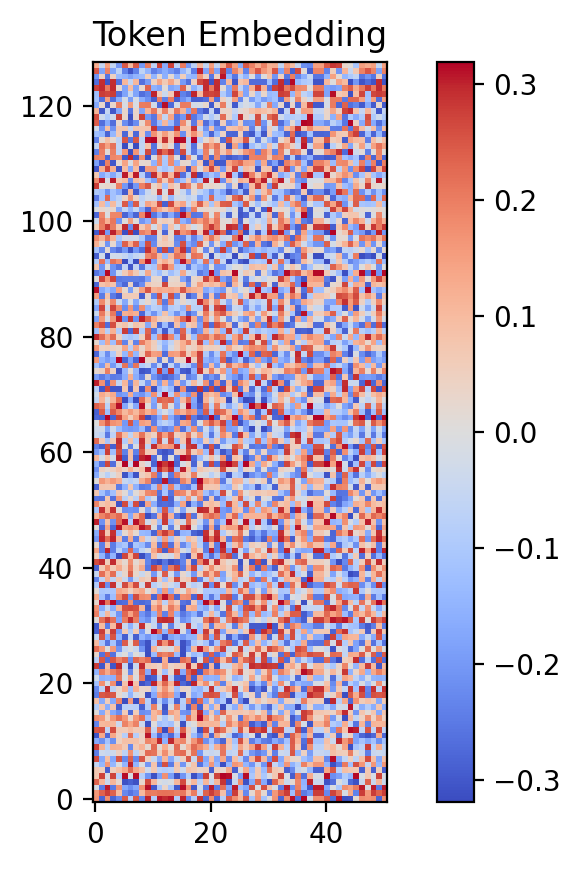

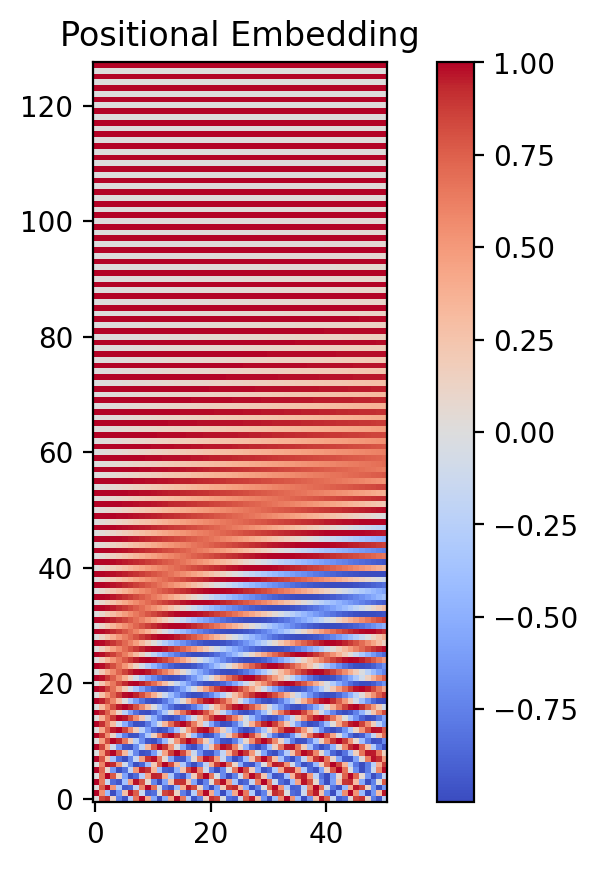

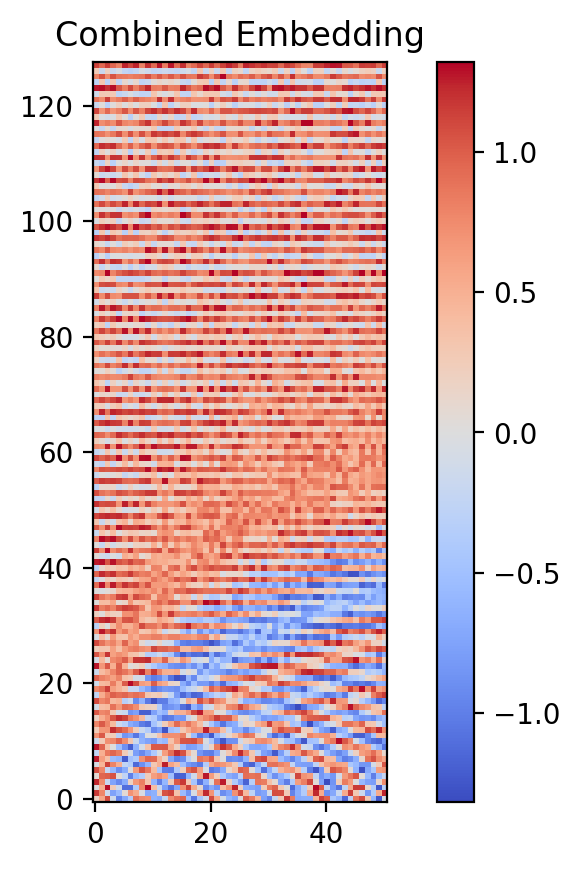

In [28]:
# Example to visualize token and positional embeddings
tpe = TokenAndPositionEmbedding(notes_vocab_size, EMBEDDING_DIM // 2)
token_embedding = tpe.token_emb(example_tokenised_notes)
position_embedding = tpe.pos_emb(token_embedding)
combined_embedding = tpe(example_tokenised_notes)

for title, emb in zip(
    ["Token Embedding", "Positional Embedding", "Combined Embedding"],
    [token_embedding, position_embedding, combined_embedding]
):
    plt.figure()
    plt.imshow(np.transpose(emb), cmap="coolwarm", interpolation="nearest", origin="lower")
    plt.title(title)
    plt.colorbar()
    plt.show()

In [29]:
# Set up the inputs
note_inputs = layers.Input(shape=(None,), dtype=tf.int32, name="note_inputs")
durations_inputs = layers.Input(shape=(None,), dtype=tf.int32, name="durations_inputs")

In [30]:
# Create separate embeddings and then concatenate
note_embeddings = TokenAndPositionEmbedding(notes_vocab_size, EMBEDDING_DIM // 2)(note_inputs)
duration_embeddings = TokenAndPositionEmbedding(durations_vocab_size, EMBEDDING_DIM // 2)(durations_inputs)
embeddings = layers.Concatenate(name="concatenated_embeddings")([note_embeddings, duration_embeddings])

In [31]:
# Pass the embeddings through the Transformer block
transformer_output, attention_scores = TransformerBlock(
    N_HEADS, KEY_DIM, EMBEDDING_DIM, FEED_FORWARD_DIM, name="transformer_block"
)(embeddings)

In [32]:
# Final output layers for both note and duration predictions
note_outputs = layers.Dense(notes_vocab_size, activation="softmax", name="note_outputs")(transformer_output)
duration_outputs = layers.Dense(durations_vocab_size, activation="softmax", name="duration_outputs")(transformer_output)

model = models.Model(
    inputs=[note_inputs, durations_inputs],
    outputs=[note_outputs, duration_outputs]
)

model.compile(
    optimizer="adam",
    loss=[losses.SparseCategoricalCrossentropy(), losses.SparseCategoricalCrossentropy()]
)

In [33]:
# Separate model to inspect attention scores
att_model = models.Model(
    inputs=[note_inputs, durations_inputs],
    outputs=attention_scores
)

In [34]:
# Model summary
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ note_inputs (InputLayer)  │ (None, None)           │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ durations_inputs          │ (None, None)           │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ token_and_position_embed… │ (None, None, 128)      │          7,552 │ note_inputs[0][0]      │
│ (TokenAndPositionEmbeddi… │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ token_and_position_embed… │ (None, None, 128)      │          3,072 │ durations_inputs[0][0] │
│ (TokenAndPositionEmbeddi… │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenated_embeddings   │ (None, None, 256)      │              0 │ token_and_position_em… │
│ (Concatenate)             │                        │                │ token_and_position_em… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ transformer_block         │ [(None, None, 256),    │      1,447,424 │ concatenated_embeddin… │
│ (TransformerBlock)        │ (None, 5, None, None)] │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ note_outputs (Dense)      │ (None, None, 59)       │         15,163 │ transformer_block[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ duration_outputs (Dense)  │ (None, None, 24)       │          6,168 │ transformer_block[0][… │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 1,479,379 (5.64 MB)

 Trainable params: 1,479,379 (5.64 MB)

 Non-trainable params: 0 (0.00 B)

In [35]:
if LOAD_MODEL:
    model.load_weights("./checkpoint/checkpoint.ckpt")
    # model = models.load_model('./models/model', compile=True)

# Model Training

In [36]:
# class MusicGenerator(callbacks.Callback):
#     """
#     A Keras callback that generates music at the end of each epoch
#     This callback uses the model's predictions to generate a MIDI stream from an initial prompt,
#     then saves and displays the generated MIDI. It also extracts attention scores for inspection.
#     """
#     def __init__(self, index_to_note, index_to_duration, top_k=10, output_dir="./output"):
#         super().__init__()
#         self.index_to_note = index_to_note
#         self.note_to_index = {note: index for index, note in enumerate(index_to_note)}
#         self.index_to_duration = index_to_duration
#         self.duration_to_index = {duration: index for index, duration in enumerate(index_to_duration)}
#         self.top_k = top_k
#         self.output_dir = output_dir
#         os.makedirs(self.output_dir, exist_ok=True)
#         self.attention_model = None  # Will be created once when needed

#     def sample_from(self, probs, temperature):
#         """
#         Sample an index from the probability distribution after applying temperature scaling and top-k filtering
#         Args:
#             probs (np.array): The probability distribution over tokens
#             temperature (float): Temperature for scaling the probabilities
#         Returns:
#             A tuple (sampled_index, new_probs) where:
#               - sampled_index: The index sampled from the top-k filtered distribution
#               - new_probs: The top-k filtered and normalized probability distribution
#         """
#         if temperature <= 0:
#             temperature = 1e-6  # Avoid division by zero if temperature is extremely low
#         scaled_probs = probs ** (1 / temperature)  # Scale the probabilities using temperature
#         if self.top_k > 0 and self.top_k < len(scaled_probs):
#             top_k_indices = np.argsort(scaled_probs)[::-1][:self.top_k]  # Get indices of top-k probabilities
#             top_k_probs = scaled_probs[top_k_indices]  # Retrieve top-k probabilities
#             top_k_probs = top_k_probs / np.sum(top_k_probs)  # Normalize the top-k probabilities
#             sampled_index = np.random.choice(top_k_indices, p=top_k_probs)  # Sample from top-k
#             new_probs = np.zeros_like(scaled_probs)  # Build a new distribution with zeros elsewhere
#             new_probs[top_k_indices] = top_k_probs
#             return sampled_index, new_probs
#         else:
#             scaled_probs = scaled_probs / np.sum(scaled_probs)  # Normalize full distribution
#             sampled_index = np.random.choice(len(scaled_probs), p=scaled_probs)
#             return sampled_index, scaled_probs

#     def get_note(self, note_preds, duration_preds, temperature):
#         """
#         Sample a note and its duration from the model predictions.
#         Re-sample if a 'START' token (assumed to be index 1) is generated.
#         """
#         sample_note_idx = 1
#         while sample_note_idx == 1:
#             sample_note_idx, note_probs = self.sample_from(note_preds[0][-1], temperature)
#             sample_note = self.index_to_note[sample_note_idx]
#         sample_duration_idx = 1
#         while sample_duration_idx == 1:
#             sample_duration_idx, duration_probs = self.sample_from(duration_preds[0][-1], temperature)
#             sample_duration = self.index_to_duration[sample_duration_idx]
#         new_note = get_midi_note(sample_note, sample_duration)
#         return (new_note,
#                 sample_note_idx,
#                 sample_note,
#                 note_probs,
#                 sample_duration_idx,
#                 sample_duration,
#                 duration_probs)

#     def generate(self, start_notes, start_durations, max_tokens, temperature):
#         """
#         Generate a sequence of notes given an initial prompt.
#         Returns a list of dictionaries containing the generation info, including the prompt,
#         generated MIDI stream, chosen note and duration, probability distributions, and attention scores.
#         """
#         # Build an attention extraction model using the transformer block's attention output (index 1)
#         if self.attention_model is None:
#             self.attention_model = models.Model(
#                 inputs=self.model.input,
#                 outputs=self.model.get_layer("transformer_block").output[1]
#             )
#         # Convert starting prompt into token indices
#         start_note_tokens = [self.note_to_index.get(x, 1) for x in start_notes]
#         start_duration_tokens = [self.duration_to_index.get(x, 1) for x in start_durations]
#         info = []
#         midi_stream = music21.stream.Stream()
#         midi_stream.append(music21.clef.BassClef())
#         # Append the starting notes to the MIDI stream
#         for note_tok, dur_tok in zip(start_notes, start_durations):
#             new_note = get_midi_note(note_tok, dur_tok)
#             if new_note is not None:
#                 midi_stream.append(new_note)
#         while len(start_note_tokens) < max_tokens:
#             x1 = np.array([start_note_tokens])
#             x2 = np.array([start_duration_tokens])
#             note_preds, duration_preds = self.model.predict([x1, x2], verbose=0)
#             repeat = True
#             attempts = 0
#             max_attempts = 10
#             while repeat and attempts < max_attempts:
#                 (new_note,
#                  sample_note_idx,
#                  sample_note,
#                  note_probs,
#                  sample_duration_idx,
#                  sample_duration,
#                  duration_probs) = self.get_note(note_preds, duration_preds, temperature)
#                 # Re-sample if the generated note is one of (Chord, Note, Rest) but duration equals "0.0"
#                 if (isinstance(new_note, (music21.chord.Chord, music21.note.Note, music21.note.Rest))
#                     and sample_duration == "0.0"):
#                     repeat = True
#                     attempts += 1
#                 else:
#                     repeat = False
#             if attempts >= max_attempts:
#                 break  # Break if too many unsuccessful attempts
#             if new_note is not None:
#                 midi_stream.append(new_note)
#             # Retrieve attention scores from the attention model (do not unpack since we already select index 1)
#             att = self.attention_model.predict([x1, x2], verbose=0)
#             info.append({
#                 "prompt": [start_notes.copy(), start_durations.copy()],
#                 "midi": midi_stream,
#                 "chosen_note": (sample_note, sample_duration),
#                 "note_probs": note_probs,
#                 "duration_probs": duration_probs,
#                 "atts": att[0, :, -1, :],
#             })
#             # Update sequences with the sampled tokens and strings
#             start_note_tokens.append(sample_note_idx)
#             start_duration_tokens.append(sample_duration_idx)
#             start_notes.append(sample_note)
#             start_durations.append(sample_duration)
#             if sample_note == "START":
#                 break  # Stop if a special token is generated
#         return info

#     def on_epoch_end(self, epoch, logs=None):
#         info = self.generate(["START"], ["0.0"], max_tokens=GENERATE_LEN, temperature=0.5)
#         if not info:
#             print("\nNo generation info produced at epoch", epoch)
#             return
#         midi_stream = info[-1]["midi"].chordify()
#         print("\nGeneration prompt:", info[-1]["prompt"])
#         midi_stream.show()
#         output_path = os.path.join("/content/output", f"output-{str(epoch).zfill(4)}.mid")
#         midi_stream.write("midi", fp=output_path)

Improved callback class to resolve TensorFlow's retracing warning.

In [37]:
class MusicGenerator(callbacks.Callback):
    """
    A Keras callback that generates music at the end of each epoch
    This callback uses the model's predictions to generate a MIDI stream from an initial prompt,
    then saves and displays the generated MIDI. It also extracts attention scores for inspection.
    """
    def __init__(self, index_to_note, index_to_duration, top_k=10, output_dir="./output"):
        super().__init__()
        self.index_to_note = index_to_note
        self.note_to_index = {note: index for index, note in enumerate(index_to_note)}
        self.index_to_duration = index_to_duration
        self.duration_to_index = {duration: index for index, duration in enumerate(index_to_duration)}
        self.top_k = top_k
        self.output_dir = output_dir
        os.makedirs(self.output_dir, exist_ok=True)
        self.attention_model = None  # Will be created once when needed
        self._predict_fn = None      # tf.function wrapper for model predictions
        self._att_fn = None          # tf.function wrapper for attention extraction

    def sample_from(self, probs, temperature):
        """
        Sample an index from the probability distribution after applying temperature scaling and top‑k filtering
        Args:
            probs (np.array): The probability distribution over tokens
            temperature (float): Temperature for scaling the probabilities
        Returns:
            A tuple (sampled_index, new_probs)
        """
        if temperature <= 0:
            temperature = 1e-6  # Avoid division by zero
        scaled_probs = probs ** (1 / temperature)
        if self.top_k > 0 and self.top_k < len(scaled_probs):
            top_k_indices = np.argsort(scaled_probs)[::-1][:self.top_k]
            top_k_probs = scaled_probs[top_k_indices]
            top_k_probs = top_k_probs / np.sum(top_k_probs)
            sampled_index = np.random.choice(top_k_indices, p=top_k_probs)
            new_probs = np.zeros_like(scaled_probs)
            new_probs[top_k_indices] = top_k_probs
            return sampled_index, new_probs
        else:
            scaled_probs = scaled_probs / np.sum(scaled_probs)
            sampled_index = np.random.choice(len(scaled_probs), p=scaled_probs)
            return sampled_index, scaled_probs

    def get_note(self, note_preds, duration_preds, temperature):
        """
        Sample a note and its duration from model predictions.
        Re-sample if a 'START' token (assumed index 1) is generated.
        """
        sample_note_idx = 1
        while sample_note_idx == 1:
            sample_note_idx, note_probs = self.sample_from(note_preds[0][-1], temperature)
            sample_note = self.index_to_note[sample_note_idx]
        sample_duration_idx = 1
        while sample_duration_idx == 1:
            sample_duration_idx, duration_probs = self.sample_from(duration_preds[0][-1], temperature)
            sample_duration = self.index_to_duration[sample_duration_idx]
        new_note = get_midi_note(sample_note, sample_duration)
        return (new_note,
                sample_note_idx,
                sample_note,
                note_probs,
                sample_duration_idx,
                sample_duration,
                duration_probs)

    def generate(self, start_notes, start_durations, max_tokens, temperature):
        """
        Generate a sequence of notes given an initial prompt.
        Returns a list of dictionaries containing the prompt, generated MIDI stream,
        chosen note and duration, probability distributions, and attention scores.
        """
        # Build (or reuse) the attention extraction model
        if self.attention_model is None:
            self.attention_model = models.Model(
                inputs=self.model.input,
                outputs=self.model.get_layer("transformer_block").output[1]
            )
        # Define and cache tf.function wrappers to avoid retracing
        if self._predict_fn is None:
            @tf.function(experimental_relax_shapes=True)
            def predict_fn(x1, x2):
                return self.model([x1, x2], training=False)
            self._predict_fn = predict_fn
        if self._att_fn is None:
            @tf.function(experimental_relax_shapes=True)
            def att_fn(x1, x2):
                return self.attention_model([x1, x2], training=False)
            self._att_fn = att_fn

        # Convert the starting prompt into token indices
        start_note_tokens = [self.note_to_index.get(x, 1) for x in start_notes]
        start_duration_tokens = [self.duration_to_index.get(x, 1) for x in start_durations]
        info = []
        midi_stream = music21.stream.Stream()
        midi_stream.append(music21.clef.BassClef())
        for note_tok, dur_tok in zip(start_notes, start_durations):
            new_note = get_midi_note(note_tok, dur_tok)
            if new_note is not None:
                midi_stream.append(new_note)
        while len(start_note_tokens) < max_tokens:
            x1 = tf.convert_to_tensor(np.array([start_note_tokens]), dtype=tf.int32)
            x2 = tf.convert_to_tensor(np.array([start_duration_tokens]), dtype=tf.int32)
            note_preds, duration_preds = self._predict_fn(x1, x2)
            repeat = True
            attempts = 0
            max_attempts = 10
            while repeat and attempts < max_attempts:
                (new_note,
                 sample_note_idx,
                 sample_note,
                 note_probs,
                 sample_duration_idx,
                 sample_duration,
                 duration_probs) = self.get_note(note_preds.numpy(), duration_preds.numpy(), temperature)
                if (isinstance(new_note, (music21.chord.Chord, music21.note.Note, music21.note.Rest))
                    and sample_duration == "0.0"):
                    repeat = True
                    attempts += 1
                else:
                    repeat = False
            if attempts >= max_attempts:
                break
            if new_note is not None:
                midi_stream.append(new_note)
            att = self._att_fn(x1, x2).numpy()
            info.append({
                "prompt": [start_notes.copy(), start_durations.copy()],
                "midi": midi_stream,
                "chosen_note": (sample_note, sample_duration),
                "note_probs": note_probs,
                "duration_probs": duration_probs,
                "atts": att[0, :, -1, :],
            })
            start_note_tokens.append(sample_note_idx)
            start_duration_tokens.append(sample_duration_idx)
            start_notes.append(sample_note)
            start_durations.append(sample_duration)
            if sample_note == "START":
                break
        return info

    def on_epoch_end(self, epoch, logs=None):
        info = self.generate(["START"], ["0.0"], max_tokens=GENERATE_LEN, temperature=0.5)
        if not info:
            print("\nNo generation info produced at epoch", epoch)
            return
        midi_stream = info[-1]["midi"].chordify()
        print("\nGeneration prompt:", info[-1]["prompt"])
        midi_stream.show()
        output_path = os.path.join("/content/output", f"output-{str(epoch).zfill(4)}.mid")
        midi_stream.write("midi", fp=output_path)

In [38]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.weights.h5",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

In [39]:
# TensorBoard callback
tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")

In [40]:
# Tokenize starting prompt
music_generator = MusicGenerator(
    index_to_note=notes_vocab,
    index_to_duration=durations_vocab,
    top_k=10,
    output_dir="/content/output"
)

Epoch 1/1000
106/107 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - duration_outputs_loss: 1.5186 - loss: 5.0792 - note_outputs_loss: 3.5606
Generation prompt: [['START', 'A3', 'B3', 'B3', 'G3', 'A3', 'B3', 'C4', 'B3', 'F#3', 'E3', 'F#3', 'A3', 'B3', 'A3', 'B3', 'E3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'E3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'G3', 'F#3', 'G3', 'F3', 'G3', 'F#3', 'G3', 'F3', 'E3', 'F3', 'E3', 'F3', 'G3', 'F3', 'G3', 'E3', 'F3'], ['0.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


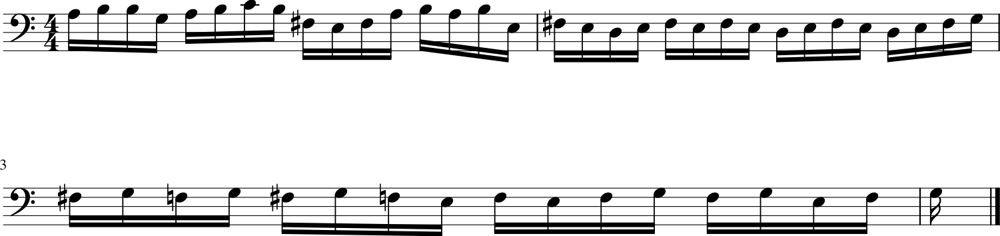

107/107 ━━━━━━━━━━━━━━━━━━━━ 19s 83ms/step - duration_outputs_loss: 1.5087 - loss: 5.0642 - note_outputs_loss: 3.5555
Epoch 2/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - duration_outputs_loss: 0.6503 - loss: 3.3631 - note_outputs_loss: 2.7129
Generation prompt: [['START', 'G3', 'A3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'A3', 'C4', 'D4', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'A3', 'G3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'F3', 'E3', 'F3', 'D3', 'G3', 'F3'], ['0.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


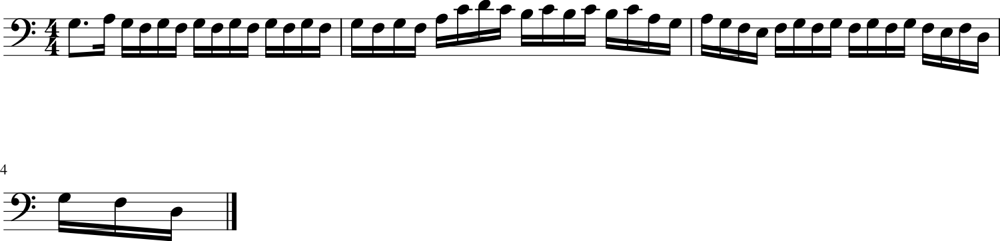

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 56ms/step - duration_outputs_loss: 0.6501 - loss: 3.3627 - note_outputs_loss: 2.7126
Epoch 3/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - duration_outputs_loss: 0.5249 - loss: 3.0957 - note_outputs_loss: 2.5708
No generation info produced at epoch 2
107/107 ━━━━━━━━━━━━━━━━━━━━ 5s 50ms/step - duration_outputs_loss: 0.5255 - loss: 3.0960 - note_outputs_loss: 2.5705
Epoch 4/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - duration_outputs_loss: 0.6091 - loss: 3.1293 - note_outputs_loss: 2.5202
Generation prompt: [['START', 'G:major'], ['0.0', '0.0']]


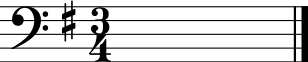

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 53ms/step - duration_outputs_loss: 0.6090 - loss: 3.1289 - note_outputs_loss: 2.5199
Epoch 5/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - duration_outputs_loss: 0.5452 - loss: 2.9292 - note_outputs_loss: 2.3840
Generation prompt: [['START', 'D:major'], ['0.0', '0.0']]


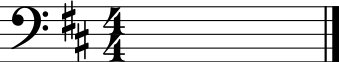

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 55ms/step - duration_outputs_loss: 0.5455 - loss: 2.9296 - note_outputs_loss: 2.3841
Epoch 6/1000
106/107 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - duration_outputs_loss: 0.6201 - loss: 2.9371 - note_outputs_loss: 2.3170
Generation prompt: [['START', 'D:major'], ['0.0', '0.0']]


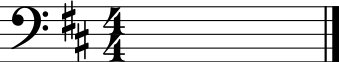

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 54ms/step - duration_outputs_loss: 0.6193 - loss: 2.9368 - note_outputs_loss: 2.3175
Epoch 7/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - duration_outputs_loss: 0.5051 - loss: 2.7823 - note_outputs_loss: 2.2772
Generation prompt: [['START', 'G:major', '3/4TS', 'rest'], ['0.0', '3.75', '0.25', '0.25']]


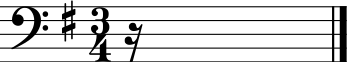

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 54ms/step - duration_outputs_loss: 0.5056 - loss: 2.7829 - note_outputs_loss: 2.2773
Epoch 8/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - duration_outputs_loss: 0.5956 - loss: 2.8674 - note_outputs_loss: 2.2718
Generation prompt: [['START', 'D:major', '4/4TS', 'rest'], ['0.0', '1.0', '1.0', '1.0']]


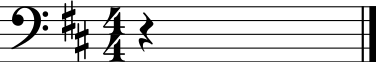

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 55ms/step - duration_outputs_loss: 0.5952 - loss: 2.8670 - note_outputs_loss: 2.2717
Epoch 9/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - duration_outputs_loss: 0.5787 - loss: 2.8333 - note_outputs_loss: 2.2546
Generation prompt: [['START', 'E-:major', '3/4TS', 'C4', 'rest', 'E-3', 'F3', 'G3', 'E-3', 'C3', 'B-2', 'G#2', 'C3', 'C3', 'E-3', 'F3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'B-2', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'C3', 'B-2', 'G#2', 'G#2', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


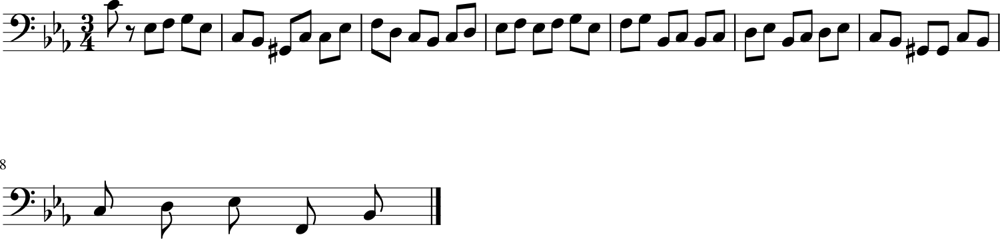

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5785 - loss: 2.8329 - note_outputs_loss: 2.2544
Epoch 10/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - duration_outputs_loss: 0.5912 - loss: 2.7754 - note_outputs_loss: 2.1843
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'C3', 'D3', 'C3', 'D3', 'C3', 'B2', 'A2', 'B2', 'C3', 'D3', 'E3', 'C3'], ['0.0', '0.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


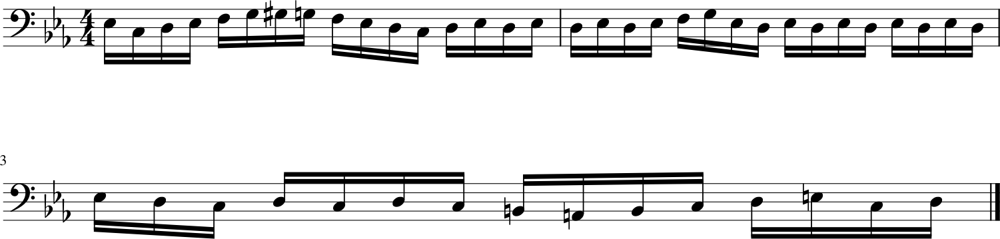

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 59ms/step - duration_outputs_loss: 0.5908 - loss: 2.7753 - note_outputs_loss: 2.1845
Epoch 11/1000
106/107 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - duration_outputs_loss: 0.5597 - loss: 2.7448 - note_outputs_loss: 2.1851
Generation prompt: [['START', 'G:major', '3/4TS', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'A3', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


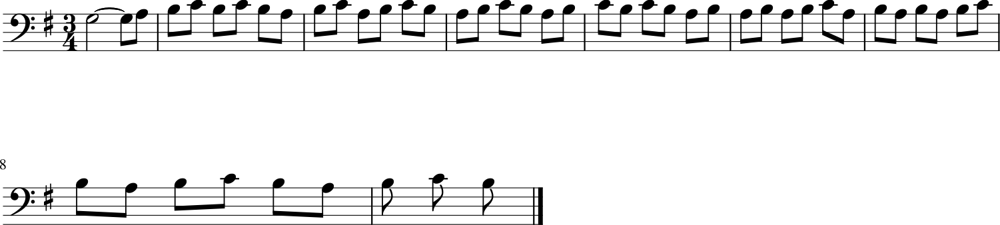

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 59ms/step - duration_outputs_loss: 0.5594 - loss: 2.7442 - note_outputs_loss: 2.1848
Epoch 12/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - duration_outputs_loss: 0.5179 - loss: 2.6761 - note_outputs_loss: 2.1582
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'G3', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'A3', 'B3', 'C4', 'D4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


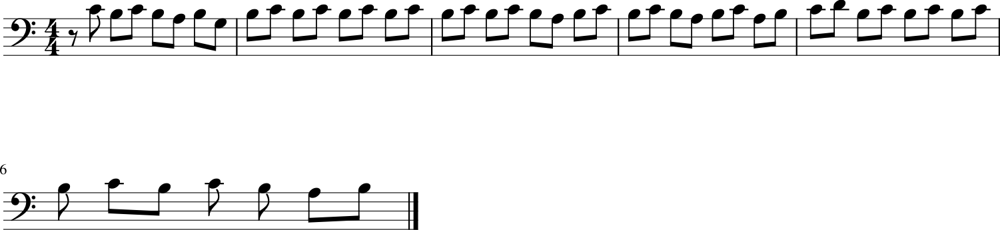

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 59ms/step - duration_outputs_loss: 0.5182 - loss: 2.6763 - note_outputs_loss: 2.1581
Epoch 13/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - duration_outputs_loss: 0.5589 - loss: 2.6594 - note_outputs_loss: 2.1005
Generation prompt: [['START', 'C:major', '6/8TS', 'rest', 'C4', 'C4', 'C4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'G3', 'A3', 'B3', 'G3', 'A3', 'B3', 'C4', 'A3', 'B3', 'C4', 'B3', 'A3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'A2', 'B2', 'C3', 'A2', 'B2', 'C3', 'A2', 'B2', 'C3', 'D3', 'E3', 'F#3', 'G3'], ['0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


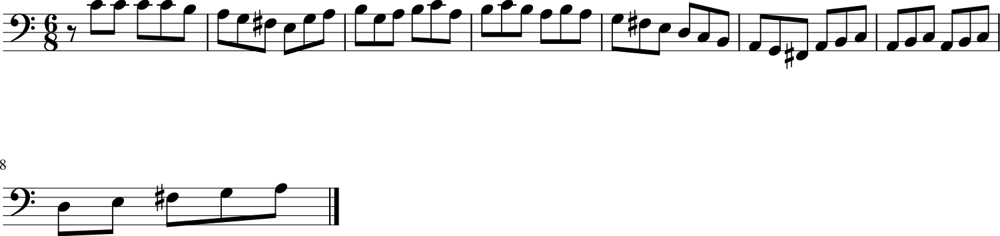

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.5589 - loss: 2.6596 - note_outputs_loss: 2.1007
Epoch 14/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5572 - loss: 2.6162 - note_outputs_loss: 2.0590
Generation prompt: [['START', 'G:major', '3/4TS', 'D3', 'B3', 'B3', 'C4', 'B3', 'A3', 'B3', 'B3', 'A3', 'B3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G#3', 'A3', 'B3', 'A3', 'G#3', 'A3', 'B3', 'A3', 'G#3', 'A3', 'E3', 'A3', 'B3', 'A3', 'G#3', 'A3', 'B3', 'A3', 'E3', 'D3', 'C#3', 'D3', 'E3', 'F#3', 'E3', 'F#3', 'E3', 'F#3', 'G#3', 'A3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


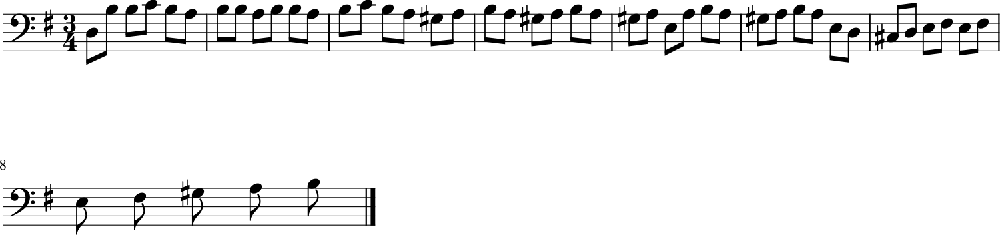

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 60ms/step - duration_outputs_loss: 0.5571 - loss: 2.6164 - note_outputs_loss: 2.0593
Epoch 15/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4992 - loss: 2.5702 - note_outputs_loss: 2.0710
Generation prompt: [['START', 'C:major', '3/4TS', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'E3', 'D4', 'C4', 'E3', 'D3', 'E3', 'D3', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4'], ['0.0', '3.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.25', '0.75', '0.25']]


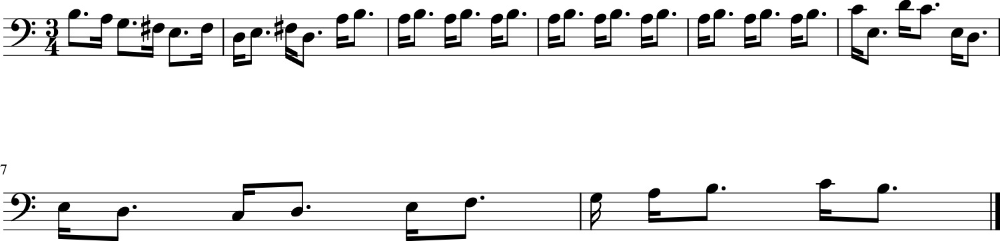

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4996 - loss: 2.5706 - note_outputs_loss: 2.0710
Epoch 16/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4994 - loss: 2.4906 - note_outputs_loss: 1.9912
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'B3', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'A3', 'B3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'B2', 'C3', 'A3', 'G3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'A3'], ['0.0', '0.0', '0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


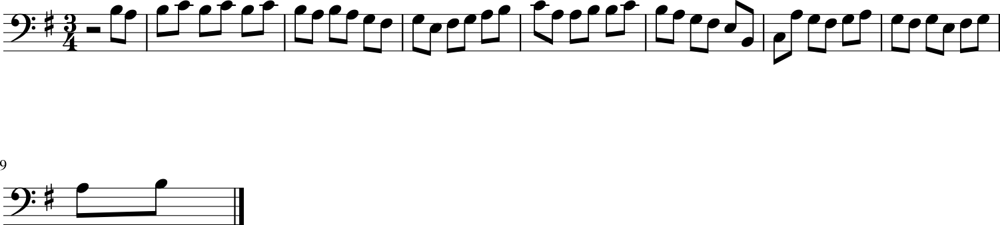

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4998 - loss: 2.4915 - note_outputs_loss: 1.9917
Epoch 17/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5889 - loss: 2.6118 - note_outputs_loss: 2.0229
Generation prompt: [['START', '3/4TS', 'rest', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'A2', 'D3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'G2', 'A2', 'B2', 'G2', 'A2', 'G2'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


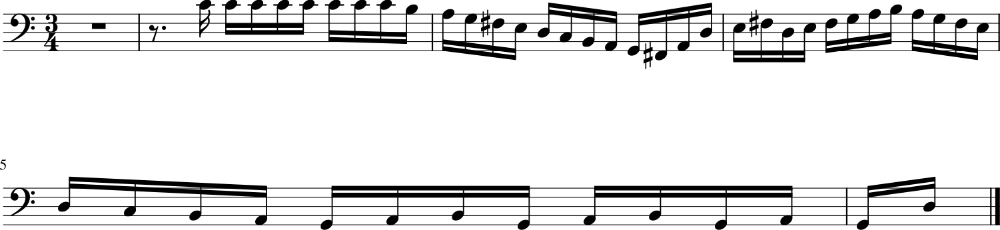

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5885 - loss: 2.6114 - note_outputs_loss: 2.0228
Epoch 18/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - duration_outputs_loss: 0.5574 - loss: 2.5376 - note_outputs_loss: 1.9803
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'E-3', 'E-3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'G2', 'G#2', 'G2', 'F2', 'E-2', 'G2'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


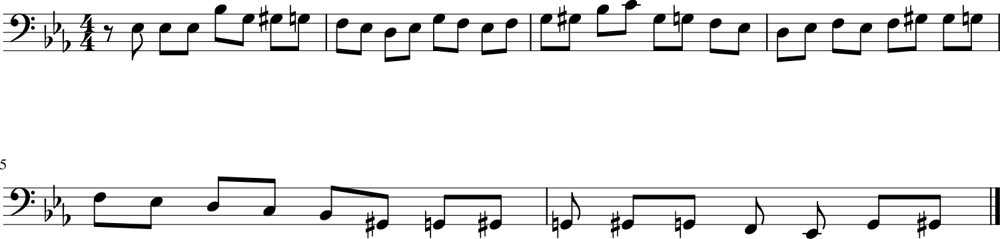

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - duration_outputs_loss: 0.5572 - loss: 2.5377 - note_outputs_loss: 1.9805
Epoch 19/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - duration_outputs_loss: 0.5547 - loss: 2.5050 - note_outputs_loss: 1.9503
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


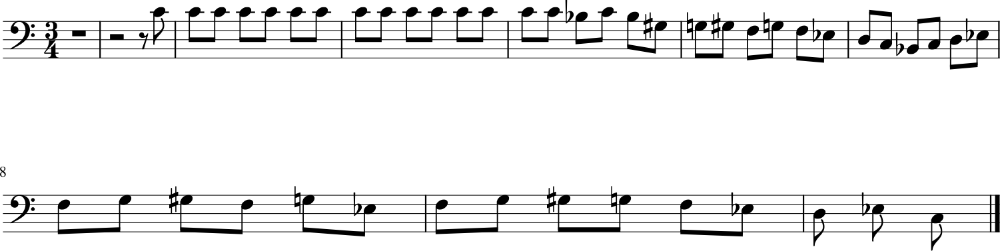

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 63ms/step - duration_outputs_loss: 0.5546 - loss: 2.5050 - note_outputs_loss: 1.9504
Epoch 20/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - duration_outputs_loss: 0.5366 - loss: 2.4583 - note_outputs_loss: 1.9217
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'C4', 'B3', 'C4', 'G3', 'A3', 'B3', 'C4', 'G3', 'A3', 'B3', 'G3', 'D3', 'B2', 'G2', 'E2', 'D2', 'rest'], ['0.0', '3.75', '0.25', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


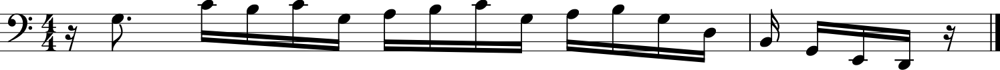

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5366 - loss: 2.4586 - note_outputs_loss: 1.9220
Epoch 21/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - duration_outputs_loss: 0.5379 - loss: 2.4800 - note_outputs_loss: 1.9421
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'G#3', 'B-3', 'C4', 'B-3'], ['0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


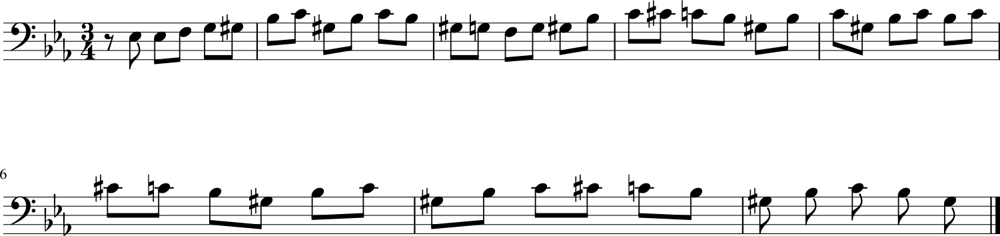

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5380 - loss: 2.4799 - note_outputs_loss: 1.9419
Epoch 22/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5227 - loss: 2.3413 - note_outputs_loss: 1.8186
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'G4', 'F#4', 'F#4', 'A4', 'A4', 'A4', 'A4', 'A4', 'A4', 'A4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'D4', 'C#4', 'E4', 'A3', 'G4', 'F#4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'F#4', 'F#4'], ['0.0', '3.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


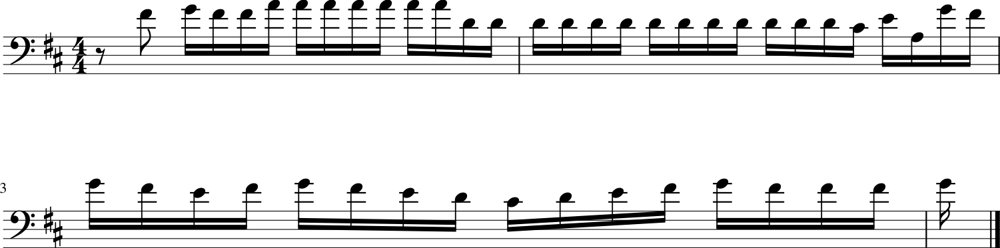

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5230 - loss: 2.3423 - note_outputs_loss: 1.8193
Epoch 23/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5058 - loss: 2.3169 - note_outputs_loss: 1.8111
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'C4', 'B3', 'C4', 'C4', 'C4', 'B3', 'C4', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


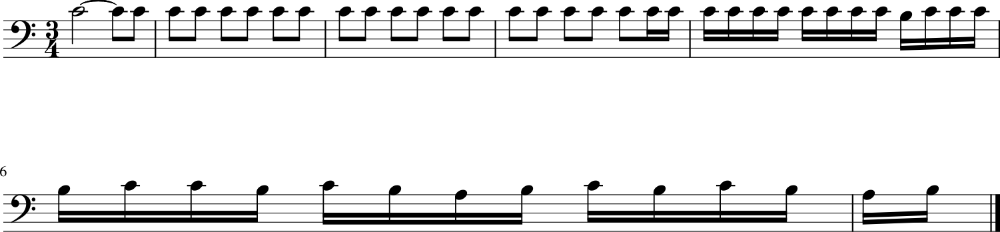

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5062 - loss: 2.3178 - note_outputs_loss: 1.8117
Epoch 24/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4882 - loss: 2.3051 - note_outputs_loss: 1.8169
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'D4', 'rest', 'F#4', 'F#4', 'F#4', 'E4', 'F#4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'F#4', 'F#4', 'F#4', 'G4', 'G4', 'F#4', 'E4', 'D4', 'G4', 'F#4', 'D4', 'B3', 'G4', 'F#4', 'G4', 'A3', 'G4', 'A3', 'F#4', 'A3', 'E4', 'A3', 'F#4', 'A3', 'G4', 'A3', 'F#4', 'A3', 'A4'], ['0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


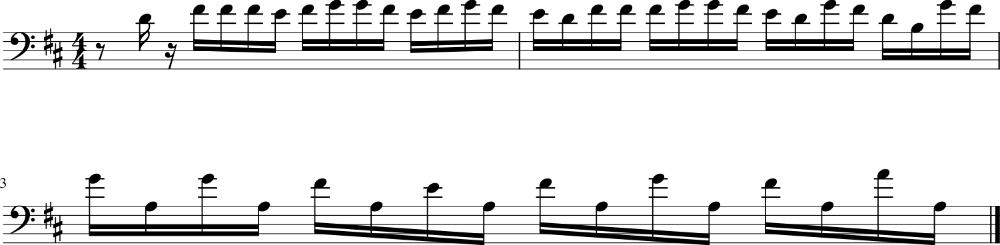

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4888 - loss: 2.3059 - note_outputs_loss: 1.8172
Epoch 25/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5759 - loss: 2.3842 - note_outputs_loss: 1.8083
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'E-3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'D3', 'B-2', 'G#2', 'C3', 'G2', 'F2', 'G#2', 'E-2', 'G3', 'G#3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


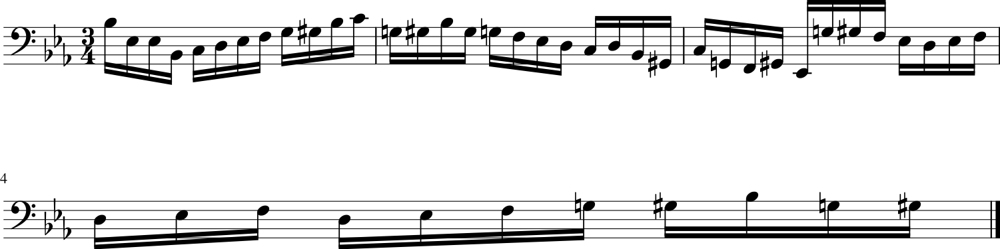

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 60ms/step - duration_outputs_loss: 0.5755 - loss: 2.3840 - note_outputs_loss: 1.8085
Epoch 26/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5406 - loss: 2.3381 - note_outputs_loss: 1.7975
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'F#4', 'D4', 'E4', 'F#4', 'G4', 'G4', 'C#4', 'C#4', 'C#4', 'A4', 'A4', 'G4', 'F#4', 'E4', 'A4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'B3', 'A3', 'A4', 'A4', 'A4', 'A4', 'B4', 'A4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'F#4', 'D4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


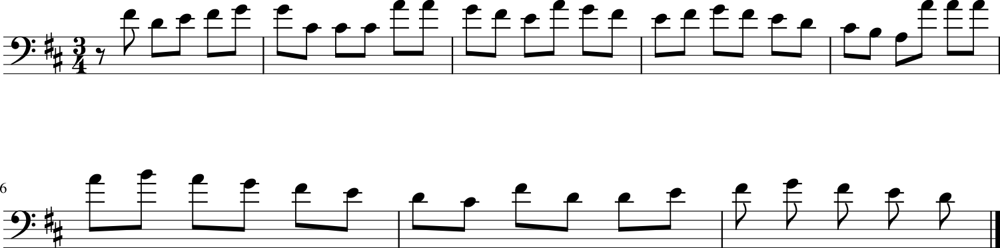

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 60ms/step - duration_outputs_loss: 0.5405 - loss: 2.3382 - note_outputs_loss: 1.7976
Epoch 27/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5220 - loss: 2.2770 - note_outputs_loss: 1.7550
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'D3', 'rest', 'D4', 'rest', 'D4', 'rest', 'D4', 'rest', 'D4', 'rest', 'D4', 'rest', 'D4', 'rest', 'A3', 'rest', 'D3', 'D3', 'F#3', 'A3', 'F#3', 'D3', 'A3', 'D3', 'F#3', 'A3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '1.0', '3.0', '1.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


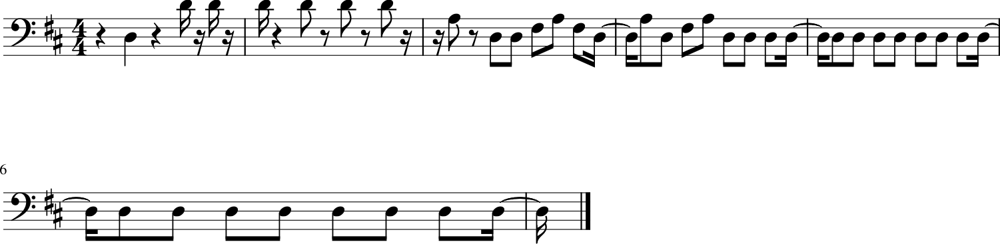

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5221 - loss: 2.2775 - note_outputs_loss: 1.7554
Epoch 28/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.6068 - loss: 2.3165 - note_outputs_loss: 1.7097
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'C4', 'B3', 'A3', 'B3', 'G3', 'D3', 'E3', 'F3', 'D3', 'D3', 'E3', 'C3', 'D3', 'E3', 'F3', 'A2', 'B2', 'D3', 'A2', 'B2', 'D3', 'E3', 'D3', 'A2', 'C3', 'E3', 'D3', 'C3', 'B2', 'D3', 'B2', 'D3', 'B2', 'D3', 'B2', 'D3', 'B2', 'D3', 'B2', 'D3', 'B2', 'D3', 'B2', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


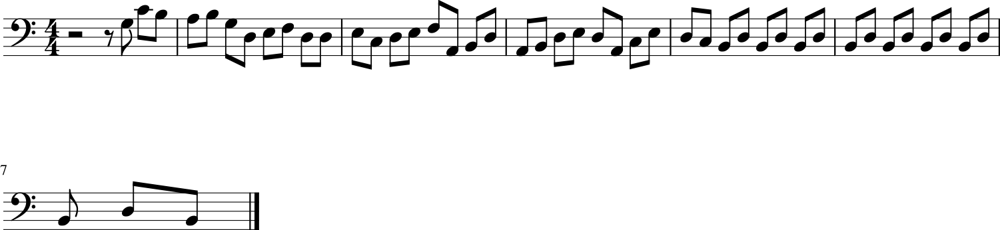

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.6062 - loss: 2.3163 - note_outputs_loss: 1.7102
Epoch 29/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5565 - loss: 2.2636 - note_outputs_loss: 1.7070
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'D4', 'E4', 'A3', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'B3', 'A3', 'G3', 'G3', 'F#3', 'E3', 'D3', 'C#3', 'D3', 'B2', 'C#3', 'D3', 'E3', 'A2', 'C3', 'A2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


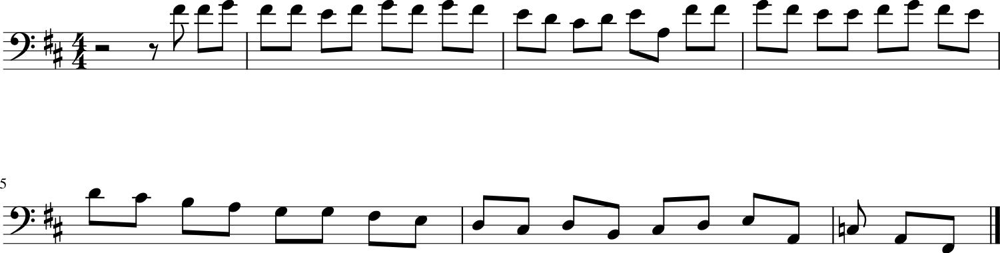

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5564 - loss: 2.2638 - note_outputs_loss: 1.7074
Epoch 30/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5236 - loss: 2.1861 - note_outputs_loss: 1.6625
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


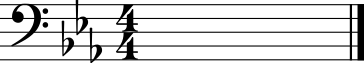

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5237 - loss: 2.1867 - note_outputs_loss: 1.6630
Epoch 31/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5206 - loss: 2.1988 - note_outputs_loss: 1.6782
Generation prompt: [['START', 'D:major', 'C#3', 'E3', 'A3', 'F#4', 'F#4', 'G4', 'F#4', 'D4', 'B3', 'F#3', 'B3', 'F#3', 'D4', 'C#4', 'D4', 'A3', 'F#3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A2', 'D3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'G3', 'A3', 'B3', 'C4'], ['0.0', '2.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


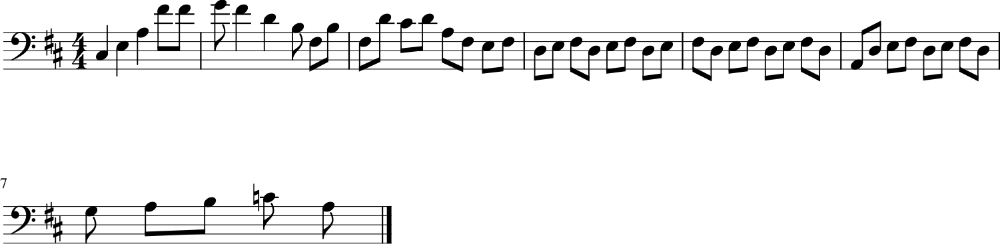

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5207 - loss: 2.1991 - note_outputs_loss: 1.6785
Epoch 32/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5361 - loss: 2.1783 - note_outputs_loss: 1.6422
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


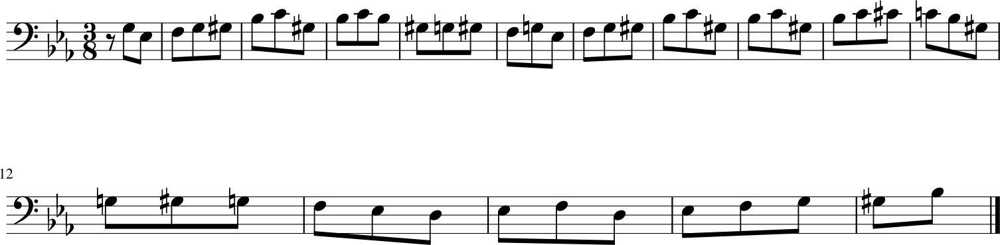

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5361 - loss: 2.1787 - note_outputs_loss: 1.6426
Epoch 33/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5393 - loss: 2.1785 - note_outputs_loss: 1.6392
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'rest', 'G3', 'E-3', 'C3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'A2', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B-2'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


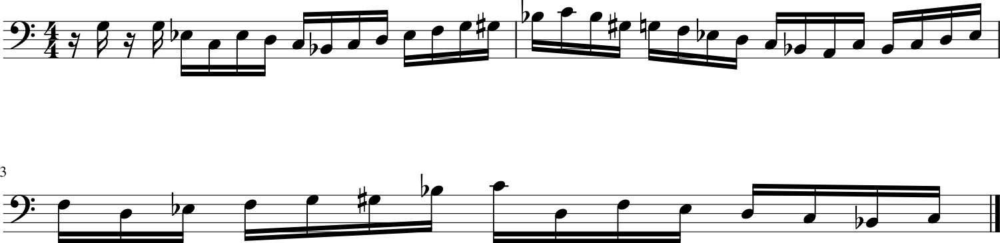

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5393 - loss: 2.1788 - note_outputs_loss: 1.6394
Epoch 34/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5008 - loss: 2.1082 - note_outputs_loss: 1.6073
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#3', 'F3', 'G3', 'G#3', 'F3', 'F2', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'G3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


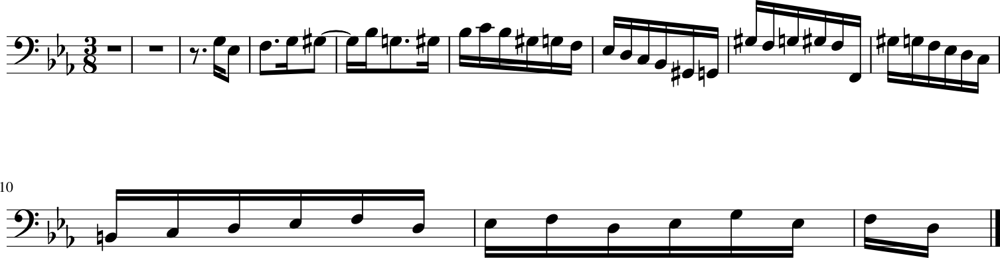

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5012 - loss: 2.1087 - note_outputs_loss: 1.6075
Epoch 35/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5697 - loss: 2.1712 - note_outputs_loss: 1.6015
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'G2', 'F2', 'G#2', 'D3', 'F3', 'B-2', 'D3', 'F3', 'G2', 'F2', 'G2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'F3', 'G3', 'G#3', 'F3', 'F2', 'E-2'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


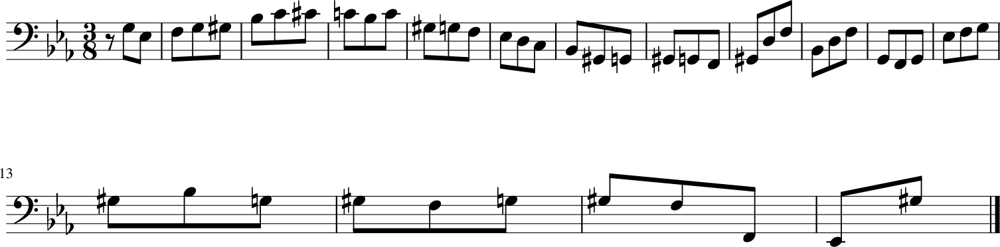

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5694 - loss: 2.1711 - note_outputs_loss: 1.6017
Epoch 36/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4916 - loss: 1.9908 - note_outputs_loss: 1.4992
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


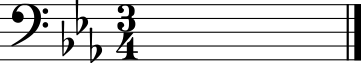

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 59ms/step - duration_outputs_loss: 0.4920 - loss: 1.9921 - note_outputs_loss: 1.5001
Epoch 37/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5226 - loss: 2.1147 - note_outputs_loss: 1.5921
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'E-3', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'E-2', 'G#3', 'F3', 'G3', 'E-3', 'F3', 'G3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


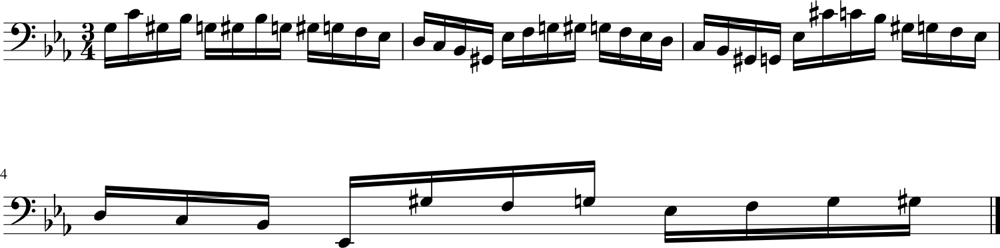

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5227 - loss: 2.1148 - note_outputs_loss: 1.5921
Epoch 38/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5481 - loss: 2.0566 - note_outputs_loss: 1.5085
Generation prompt: [['START', 'D:major', '3/2TS', 'F#4', 'F#4', 'G4', 'E4', 'B4', 'A4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'B4', 'A4', 'G4', 'E4', 'E4', 'E4', 'F#4', 'G4', 'E4', 'E4', 'E4', 'E4', 'E4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'E4', 'D4', 'C#4', 'B3', 'A3', 'D4', 'E4', 'F#4', 'G4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


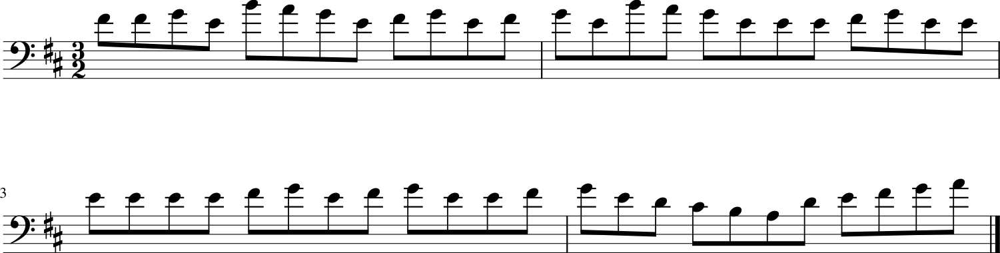

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5480 - loss: 2.0568 - note_outputs_loss: 1.5089
Epoch 39/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5424 - loss: 2.0397 - note_outputs_loss: 1.4974
Generation prompt: [['START', 'D:major', '6/8TS', 'A4', 'A4', 'G4', 'F#4', 'G4', 'F#4', 'G4', 'F#4', 'G4', 'A4', 'G4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'B4', 'F#4', 'G4', 'B4', 'B4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'A4', 'A4', 'F#4', 'G4', 'A4', 'F#4', 'F#4', 'F#4', 'F#4', 'F#4', 'F#4'], ['0.0', '1/12', '1/6', '1/12', '1/6', '1/12', '0.25', '0.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


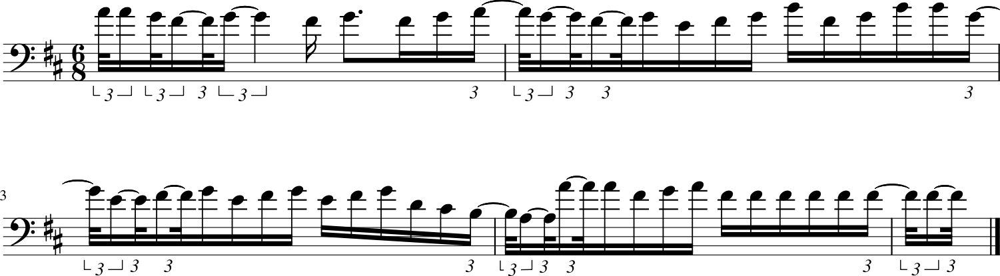

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 63ms/step - duration_outputs_loss: 0.5423 - loss: 2.0401 - note_outputs_loss: 1.4978
Epoch 40/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5407 - loss: 2.0306 - note_outputs_loss: 1.4899
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'D3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'B2', 'C#3', 'D3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C#2', 'A2', 'E3', 'G3', 'E3', 'F#3', 'G3', 'C#2', 'A2', 'E3', 'C#3', 'E3', 'G3', 'E4', 'C#4', 'E4', 'A4', 'F#4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


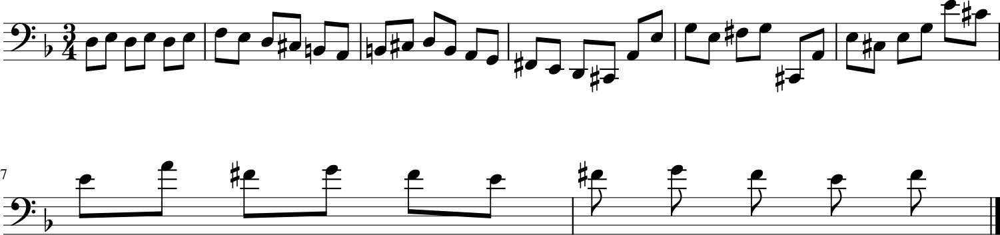

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5407 - loss: 2.0310 - note_outputs_loss: 1.4903
Epoch 41/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5036 - loss: 2.0033 - note_outputs_loss: 1.4996
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-2', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


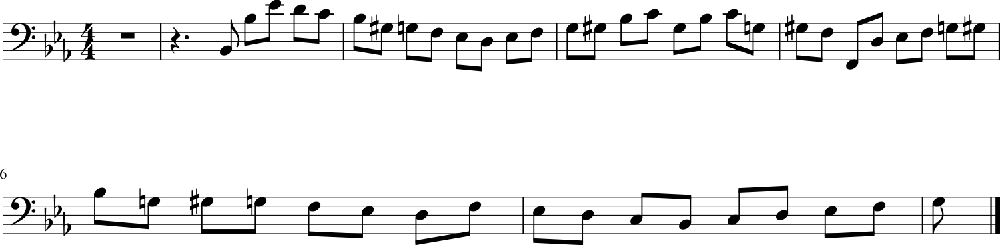

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5039 - loss: 2.0037 - note_outputs_loss: 1.4998
Epoch 42/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5201 - loss: 2.0617 - note_outputs_loss: 1.5416
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'D3', 'D3', 'D3', 'D3', 'F#3', 'A3', 'C4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'G2', 'B-3', 'B-3', 'G3', 'B-3', 'G3', 'B-3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


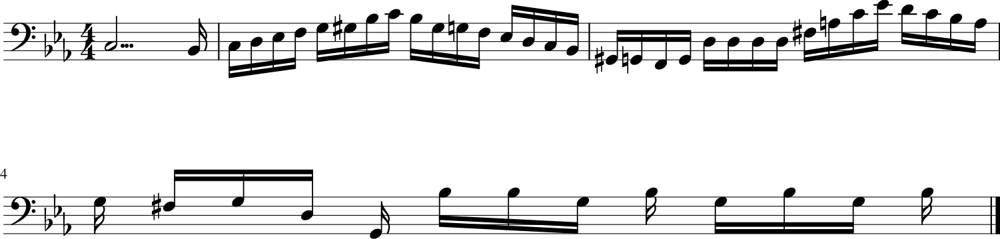

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5203 - loss: 2.0615 - note_outputs_loss: 1.5412
Epoch 43/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5345 - loss: 1.9970 - note_outputs_loss: 1.4625
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'F3', 'A3', 'D3', 'F3', 'G3', 'A3', 'F3', 'G3', 'F3', 'G3', 'A3', 'F3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'B-2', 'A2', 'G2', 'F2', 'A3', 'F3', 'D3', 'F2', 'A3', 'G3', 'F3', 'E3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'G3', 'B-3', 'B-3'], ['0.0', '0.0', '0.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


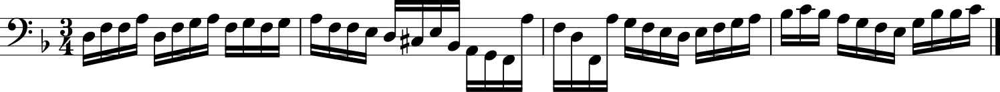

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5345 - loss: 1.9971 - note_outputs_loss: 1.4626
Epoch 44/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5542 - loss: 1.9268 - note_outputs_loss: 1.3727
Generation prompt: [['START', 'E-:major', '3/4TS', 'C4', 'E-3', 'D3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'F3', 'D3', 'G#3', 'D3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


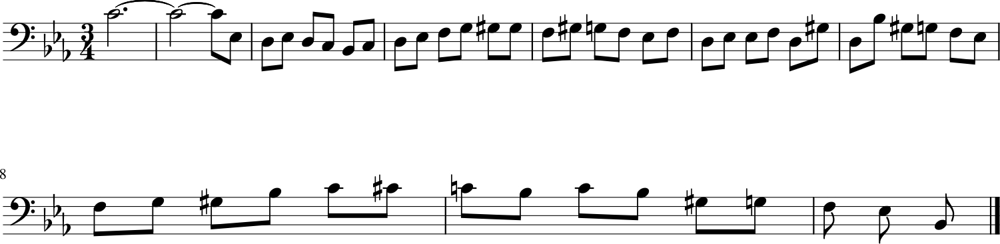

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5540 - loss: 1.9275 - note_outputs_loss: 1.3735
Epoch 45/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5043 - loss: 1.9445 - note_outputs_loss: 1.4402
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'G3', 'D3', 'E3', 'F3', 'B2', 'A2', 'B2', 'G3', 'F3', 'E3', 'D3', 'C3', 'E3', 'D3', 'C3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'D3', 'F#3', 'A3', 'C4', 'D4', 'E3', 'C4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


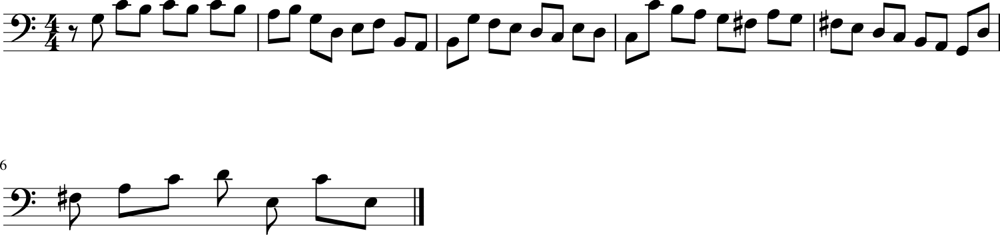

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - duration_outputs_loss: 0.5045 - loss: 1.9449 - note_outputs_loss: 1.4403
Epoch 46/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - duration_outputs_loss: 0.5370 - loss: 1.9405 - note_outputs_loss: 1.4034
Generation prompt: [['START', 'E-:major', '3/4TS', 'C4', 'D3', 'C3', 'G#2', 'C4', 'G#2', 'C3', 'G#2', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G#3', 'F3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'G2', 'G#2', 'B-2', 'G2', 'G#2', 'G2', 'G#2', 'G2', 'G#2', 'G2', 'G#2', 'G2', 'G#2'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


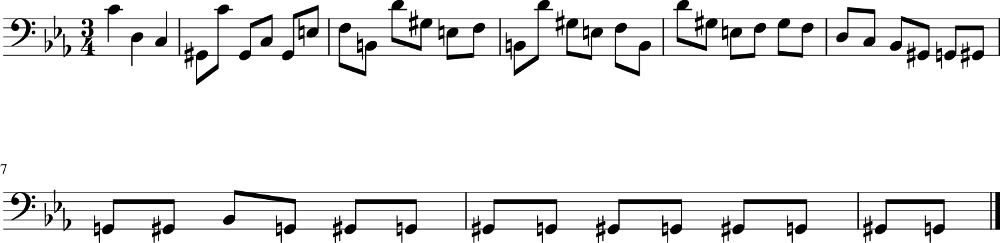

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5370 - loss: 1.9407 - note_outputs_loss: 1.4037
Epoch 47/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5290 - loss: 1.8822 - note_outputs_loss: 1.3532
Generation prompt: [['START', 'F:major', '3/4TS', 'B-3', 'A3', 'B-3', 'A3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


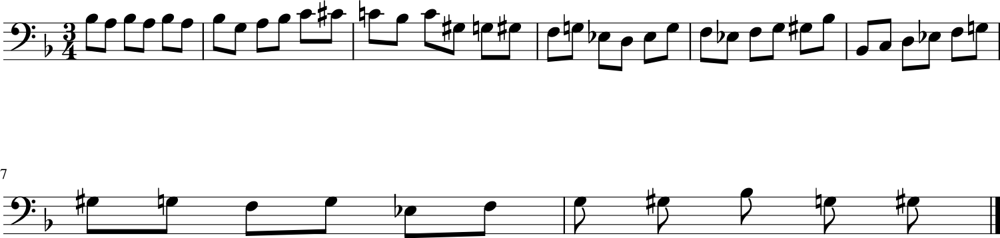

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5290 - loss: 1.8828 - note_outputs_loss: 1.3538
Epoch 48/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5119 - loss: 1.8432 - note_outputs_loss: 1.3314
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'B-3', 'E-3', 'G3', 'C3', 'G#2', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'E-3', 'F#3', 'A3', 'C4', 'D4', 'D4', 'C4', 'B3', 'A3', 'B3', 'C4', 'D4', 'B3', 'C4', 'B3', 'A3', 'B3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


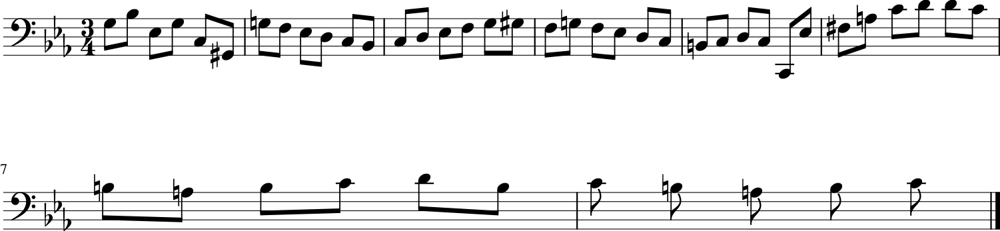

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5120 - loss: 1.8440 - note_outputs_loss: 1.3320
Epoch 49/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5714 - loss: 1.9789 - note_outputs_loss: 1.4075
Generation prompt: [['START', 'E-:major', '3/4TS', 'E-4', 'rest', 'E-3', 'B-2', 'D4', 'E-3', 'E-3', 'C3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


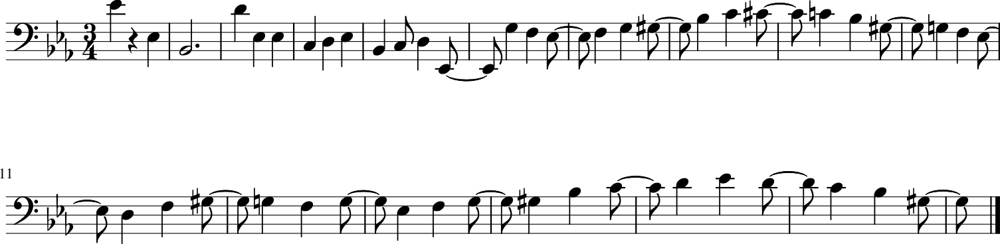

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5711 - loss: 1.9786 - note_outputs_loss: 1.4075
Epoch 50/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5674 - loss: 1.9380 - note_outputs_loss: 1.3706
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'C#4', 'G3', 'B-3', 'E-4', 'C4', 'C#4', 'B-3', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


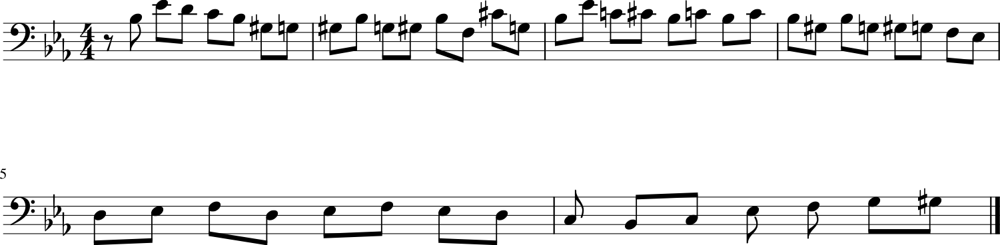

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5671 - loss: 1.9377 - note_outputs_loss: 1.3707
Epoch 51/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5246 - loss: 1.8618 - note_outputs_loss: 1.3372
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'F#4', 'G4', 'E4', 'C#4', 'D4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'A3', 'D4', 'D4', 'D4', 'C#4', 'B3', 'A3', 'G#3', 'A3', 'D4', 'D4', 'E4', 'F#4', 'A3', 'A3', 'B3', 'C#4', 'D4', 'C#4', 'D4', 'E4', 'D4', 'E4', 'F#4', 'A3', 'A3', 'B3', 'C#4', 'D4'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


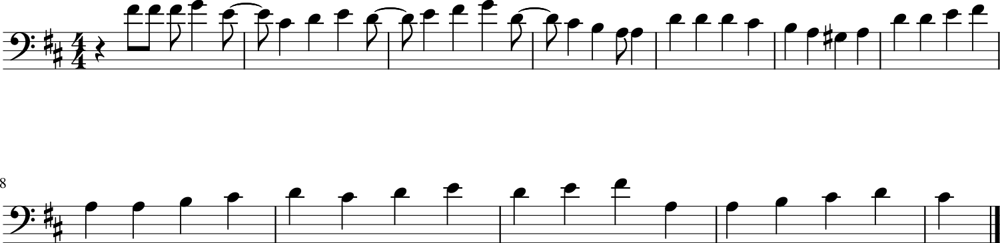

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5246 - loss: 1.8621 - note_outputs_loss: 1.3375
Epoch 52/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5409 - loss: 1.8673 - note_outputs_loss: 1.3264
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'F#4', 'E4', 'D4', 'E4', 'F#4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'D4', 'D4', 'D4', 'C#4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'A2', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'C4', 'B3'], ['0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


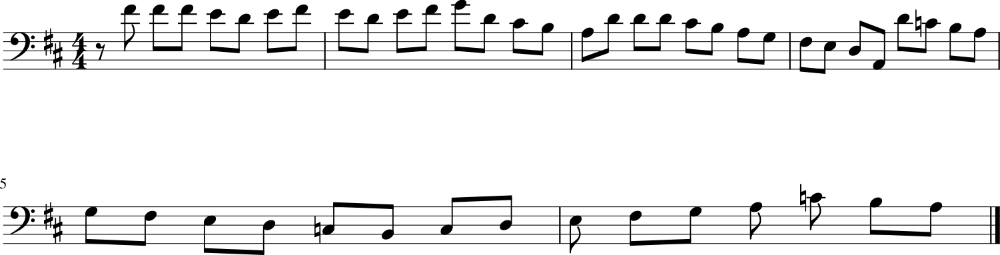

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5409 - loss: 1.8675 - note_outputs_loss: 1.3267
Epoch 53/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5543 - loss: 1.9223 - note_outputs_loss: 1.3680
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'E4', 'E4', 'C#4', 'D4', 'E4', 'D4', 'E4', 'D4', 'C#4', 'B3', 'A3', 'B3', 'C#4', 'A3', 'E4', 'F#4', 'G4', 'E4', 'C#4', 'E4', 'F#4', 'G4', 'A4', 'B4', 'C#5', 'D5', 'E4', 'E4', 'D5', 'C#5', 'B4', 'C#5', 'A4', 'F#4', 'D4', 'B4', 'A4', 'B4', 'A4', 'F#4', 'D4', 'B4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


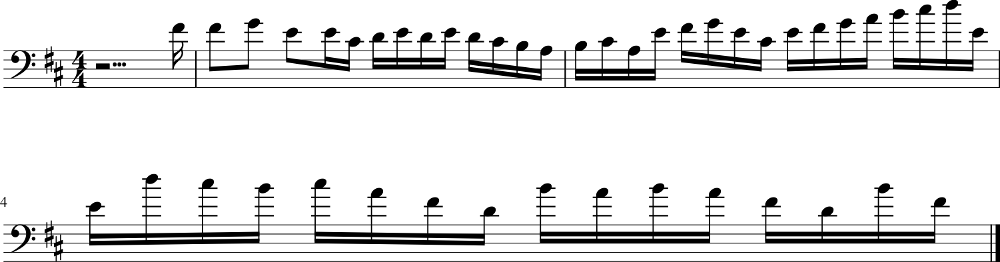

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5541 - loss: 1.9219 - note_outputs_loss: 1.3678
Epoch 54/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5794 - loss: 1.8682 - note_outputs_loss: 1.2888
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'B-2', 'G#2', 'G2', 'B-2', 'G#2', 'G2', 'B-2', 'C3', 'G#2', 'B-2', 'G2', 'F2', 'G2', 'E-2', 'F2', 'A2', 'B2', 'C3', 'E-2', 'D2', 'E-2', 'C2', 'D2', 'E-2', 'F2', 'G2', 'G#2', 'F2', 'B2', 'C3', 'D3', 'E-3', 'G#2', 'B3', 'C4', 'G#3', 'E3', 'F3', 'G#2', 'C2', 'G2', 'F3', 'E3', 'D3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


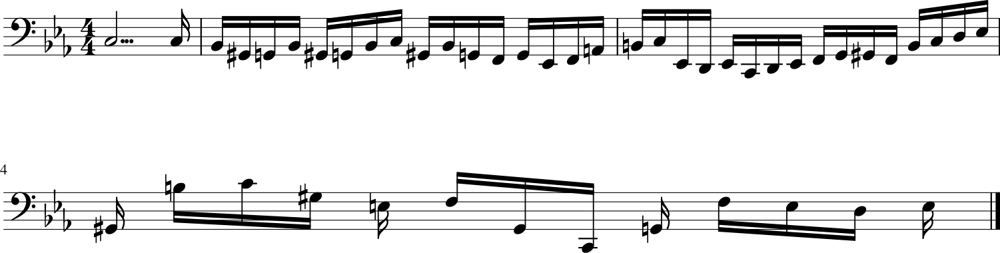

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5789 - loss: 1.8682 - note_outputs_loss: 1.2892
Epoch 55/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5307 - loss: 1.8230 - note_outputs_loss: 1.2923
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'E3', 'B2', 'G2', 'G2', 'E2', 'E2', 'B2', 'E3', 'G3', 'F#3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'B3', 'G3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'B3', 'A3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


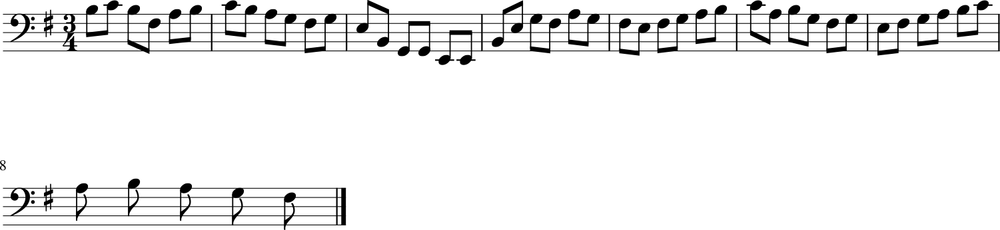

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5307 - loss: 1.8233 - note_outputs_loss: 1.2926
Epoch 56/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5116 - loss: 1.7855 - note_outputs_loss: 1.2740
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'rest'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


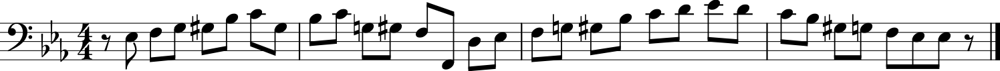

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.5118 - loss: 1.7863 - note_outputs_loss: 1.2745
Epoch 57/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5558 - loss: 1.8419 - note_outputs_loss: 1.2861
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'G2', 'B-2', 'A2', 'G2', 'B-2', 'E-2', 'C4', 'B-3', 'A3', 'B-3', 'G3', 'A2', 'F#3', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'A2', 'G2', 'D3', 'G2', 'A2', 'G2', 'E3', 'G2', 'A2', 'G2', 'F#3', 'G2', 'A2'], ['0.0', '0.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


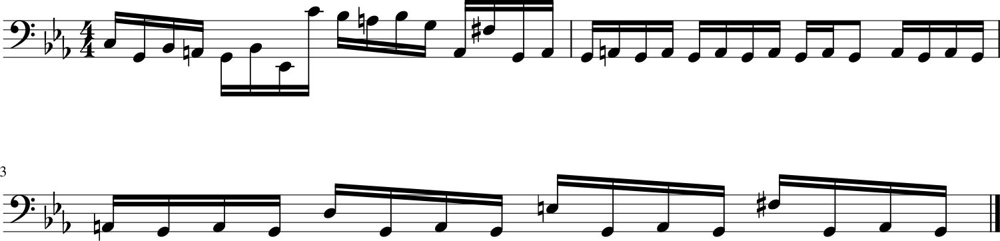

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5556 - loss: 1.8418 - note_outputs_loss: 1.2862
Epoch 58/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5702 - loss: 1.8022 - note_outputs_loss: 1.2321
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'A3', 'B-3', 'G3', 'F3', 'E-3', 'D3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'B-2', 'G#2', 'G2', 'B-2', 'E3', 'C#3', 'C3', 'B-2', 'G#2', 'C3', 'F3', 'G#2', 'B-2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


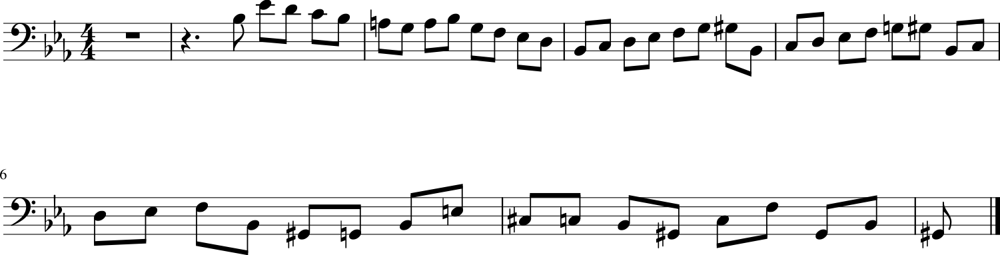

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5698 - loss: 1.8025 - note_outputs_loss: 1.2327
Epoch 59/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5617 - loss: 1.7871 - note_outputs_loss: 1.2254
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


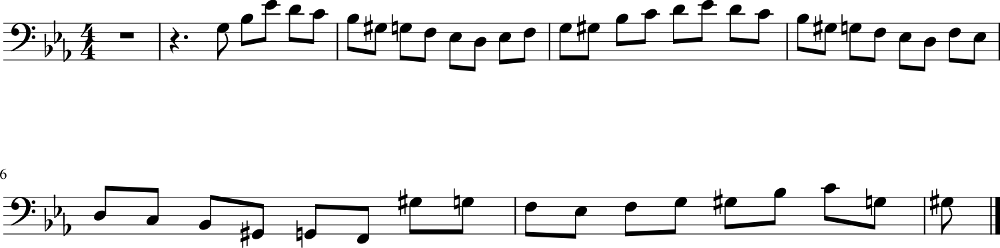

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5614 - loss: 1.7872 - note_outputs_loss: 1.2258
Epoch 60/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5229 - loss: 1.7673 - note_outputs_loss: 1.2443
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'B3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E3', 'F3', 'G2', 'G3', 'E3', 'F3', 'G2', 'G3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'F#3', 'D3', 'A3', 'F#3', 'D3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


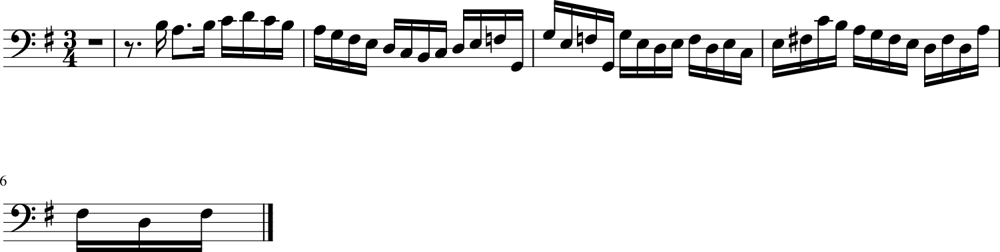

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5231 - loss: 1.7677 - note_outputs_loss: 1.2447
Epoch 61/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5082 - loss: 1.7457 - note_outputs_loss: 1.2375
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


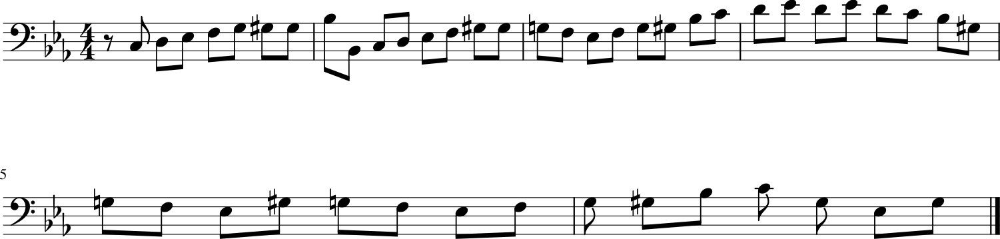

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5084 - loss: 1.7462 - note_outputs_loss: 1.2378
Epoch 62/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5238 - loss: 1.7225 - note_outputs_loss: 1.1987
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'G2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'G2', 'B-3', 'B-3', 'C4', 'D4', 'B3', 'G3', 'E3', 'F3', 'G3', 'E3', 'F3', 'D3', 'E3', 'C3', 'B-2', 'A2', 'C3', 'E3', 'A3', 'G3', 'F3', 'E3', 'D3', 'F3', 'D3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


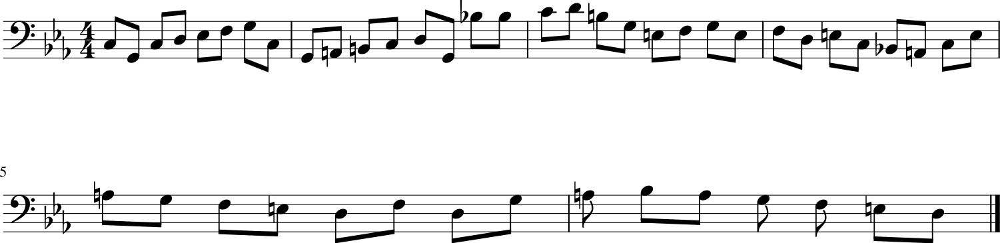

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5239 - loss: 1.7230 - note_outputs_loss: 1.1992
Epoch 63/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5316 - loss: 1.7853 - note_outputs_loss: 1.2537
Generation prompt: [['START', 'D:major', '3/2TS', 'F#4', 'F#4', 'G4', 'E4', 'F#4', 'B-3', 'E4', 'F#4', 'G4', 'B3', 'F#3', 'A3', 'G4', 'D4', 'C#4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'C#4', 'B3', 'C#4', 'D4', 'B3', 'F#4', 'A3', 'B3', 'C#4', 'D4', 'E4', 'D4', 'C#4', 'D4', 'E4', 'F#4', 'A3', 'A3', 'B3', 'C#4', 'D4', 'E4', 'D4', 'E4', 'D4', 'E4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


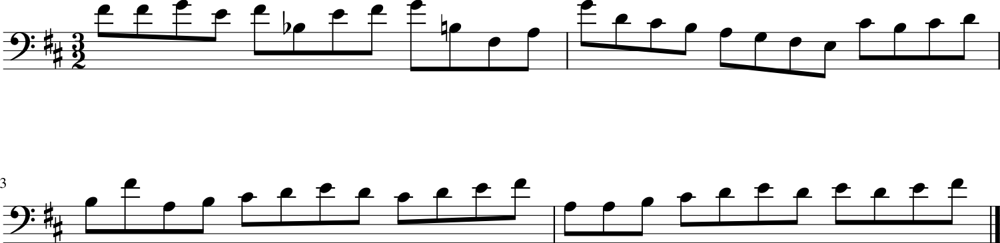

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5317 - loss: 1.7853 - note_outputs_loss: 1.2536
Epoch 64/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4907 - loss: 1.6788 - note_outputs_loss: 1.1881
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'G2', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'G3', 'B-3', 'A3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


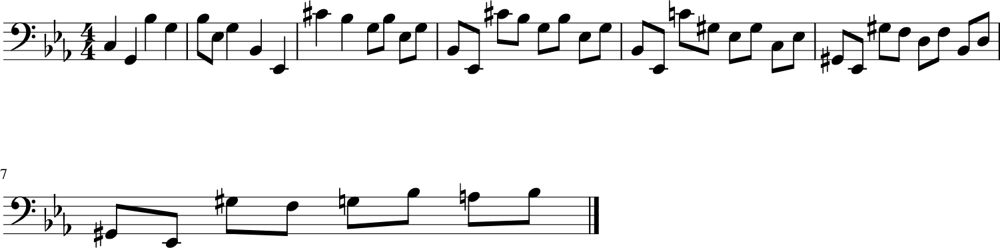

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4911 - loss: 1.6796 - note_outputs_loss: 1.1886
Epoch 65/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5097 - loss: 1.7112 - note_outputs_loss: 1.2015
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'E-4', 'G3', 'C#4', 'E-3', 'B-3', 'B-2', 'D3', 'E-3', 'F3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'F3', 'C#4', 'G3', 'C#4', 'C4', 'B-3', 'G#3', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G3', 'G3', 'E-3', 'B-3', 'C4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5']]


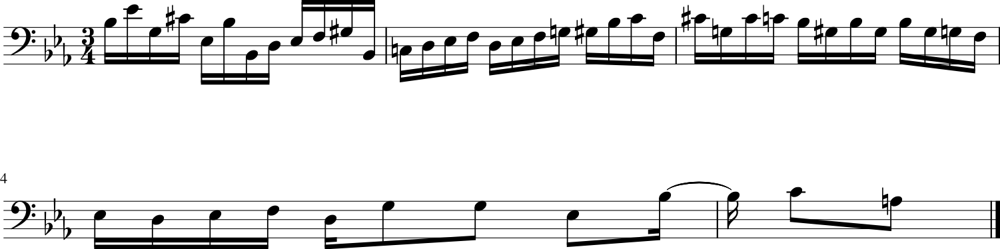

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5099 - loss: 1.7117 - note_outputs_loss: 1.2018
Epoch 66/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5305 - loss: 1.7368 - note_outputs_loss: 1.2062
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


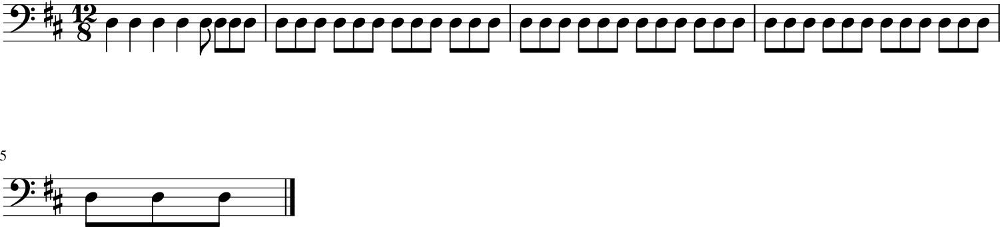

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5305 - loss: 1.7370 - note_outputs_loss: 1.2064
Epoch 67/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5091 - loss: 1.6994 - note_outputs_loss: 1.1903
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'B-3', 'D3', 'E-3', 'G3', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'G3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'F2', 'G2', 'D3', 'F3', 'B-2', 'G#2', 'G2', 'B-2', 'C3', 'D3', 'E-3', 'C#4', 'G#2', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


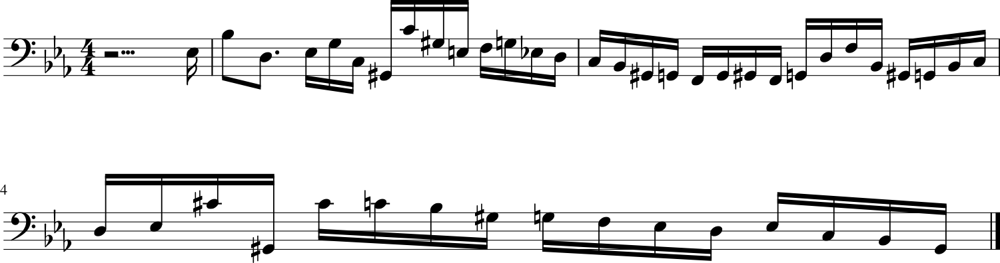

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5093 - loss: 1.6998 - note_outputs_loss: 1.1905
Epoch 68/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4984 - loss: 1.6497 - note_outputs_loss: 1.1512
Generation prompt: [['START', 'G:major', '3/4TS', 'G2', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B3', 'C4', 'A3', 'G3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


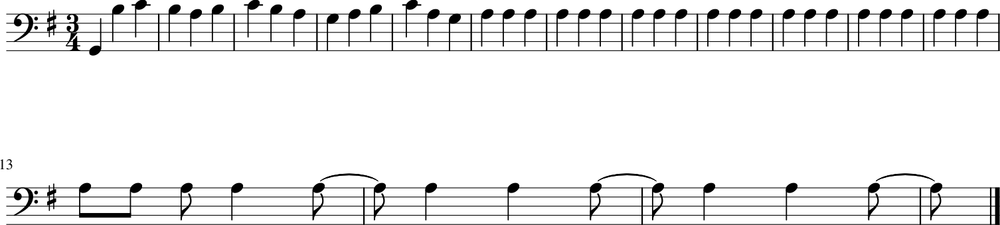

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4987 - loss: 1.6505 - note_outputs_loss: 1.1518
Epoch 69/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5372 - loss: 1.7371 - note_outputs_loss: 1.1999
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'G#3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


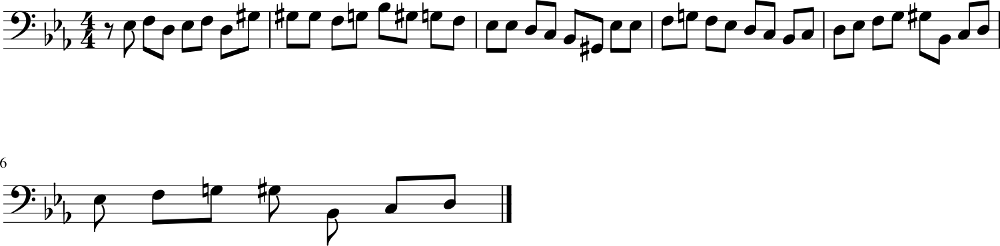

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5372 - loss: 1.7372 - note_outputs_loss: 1.2000
Epoch 70/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5545 - loss: 1.7215 - note_outputs_loss: 1.1670
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


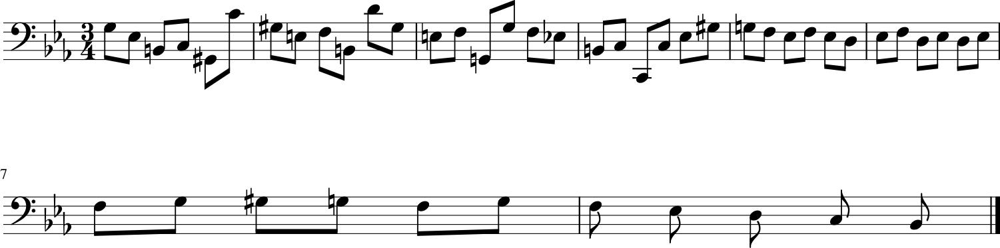

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5543 - loss: 1.7216 - note_outputs_loss: 1.1673
Epoch 71/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5221 - loss: 1.7052 - note_outputs_loss: 1.1831
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'D3', 'C3', 'B2', 'A2', 'F3', 'E3', 'D3', 'E3', 'C3', 'A2', 'F3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'C3', 'C2', 'B2', 'C#3', 'E3', 'A3', 'E3', 'F#3', 'G3', 'G3', 'E3', 'F#3', 'D3', 'D2', 'A2'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


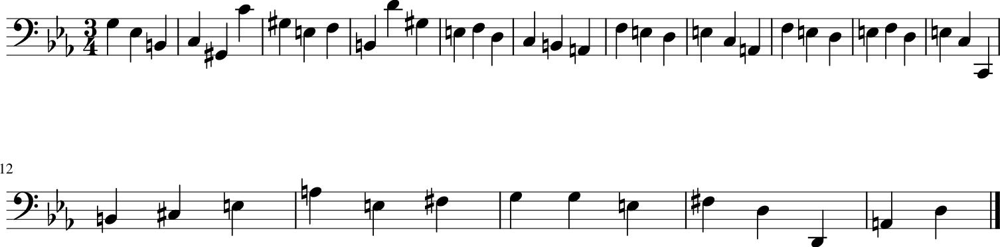

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5221 - loss: 1.7054 - note_outputs_loss: 1.1833
Epoch 72/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4874 - loss: 1.6472 - note_outputs_loss: 1.1598
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


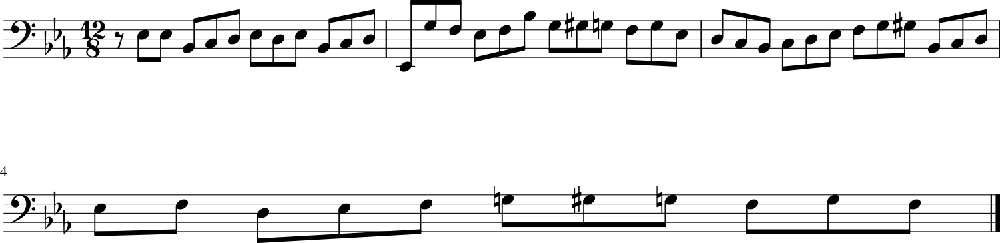

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4879 - loss: 1.6479 - note_outputs_loss: 1.1601
Epoch 73/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5091 - loss: 1.6684 - note_outputs_loss: 1.1593
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


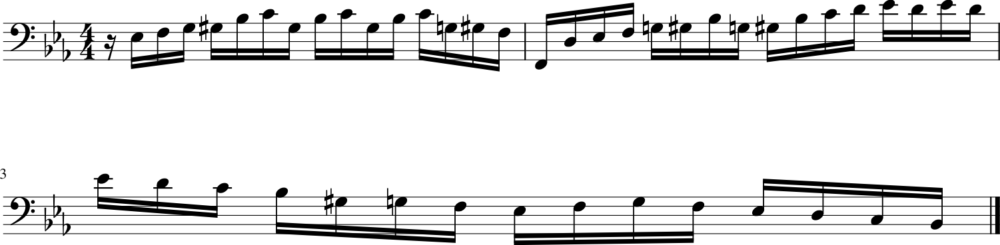

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5093 - loss: 1.6688 - note_outputs_loss: 1.1595
Epoch 74/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5127 - loss: 1.6043 - note_outputs_loss: 1.0916
Generation prompt: [['START', 'D:major', '3/2TS', 'F#4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'A4', 'A4', 'A4', 'B4', 'A4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'F#4', 'F#4', 'E4', 'F#4', 'G4', 'A4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'B3', 'C#4', 'B4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


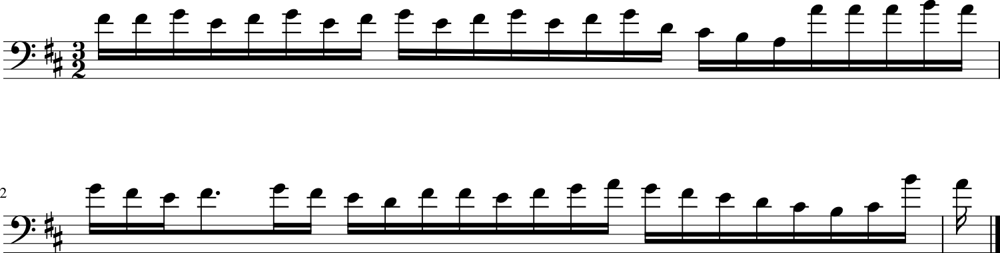

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5129 - loss: 1.6051 - note_outputs_loss: 1.0922
Epoch 75/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5296 - loss: 1.6678 - note_outputs_loss: 1.1381
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'E4', 'D4', 'C#4'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


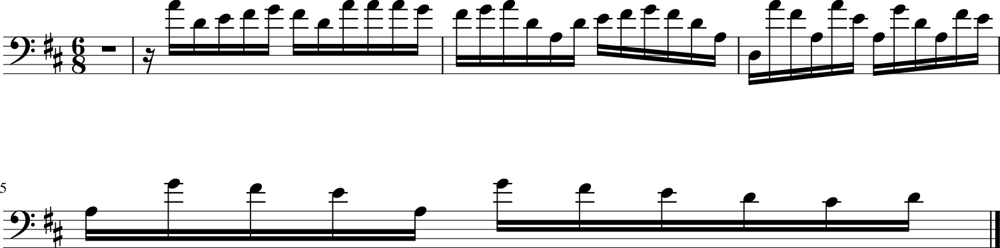

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5297 - loss: 1.6681 - note_outputs_loss: 1.1384
Epoch 76/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5537 - loss: 1.6555 - note_outputs_loss: 1.1018
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'A4', 'A4', 'A4', 'A4', 'A4', 'A4', 'A4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'A4', 'E4', 'F#4', 'G4', 'F#4', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'F#4', 'A3', 'A4', 'E4', 'F#4'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


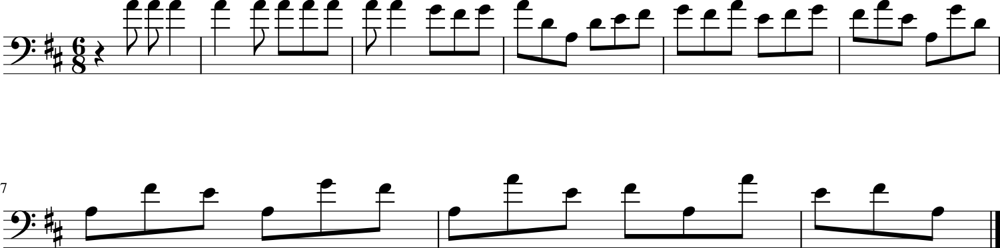

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5535 - loss: 1.6559 - note_outputs_loss: 1.1024
Epoch 77/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5239 - loss: 1.6142 - note_outputs_loss: 1.0903
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'A3', 'G3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


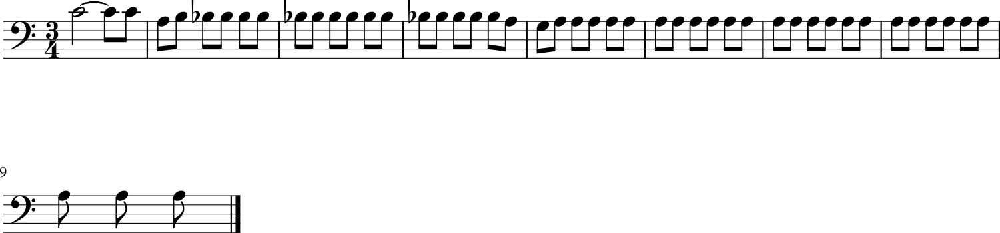

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5240 - loss: 1.6148 - note_outputs_loss: 1.0909
Epoch 78/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5271 - loss: 1.6714 - note_outputs_loss: 1.1443
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'G3', 'C4', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'B3', 'G3', 'A3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'D3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'B3', 'D4', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'G2', 'F2', 'E2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


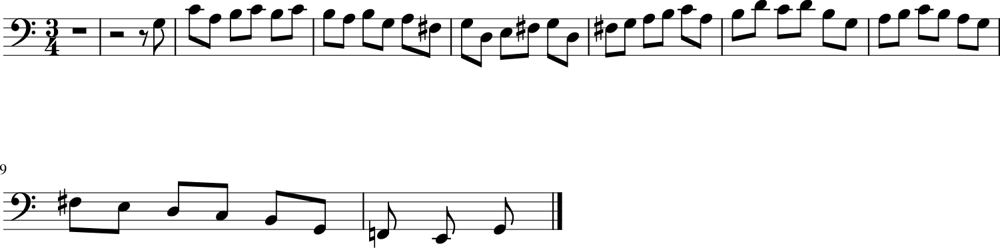

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5272 - loss: 1.6716 - note_outputs_loss: 1.1444
Epoch 79/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5134 - loss: 1.5902 - note_outputs_loss: 1.0768
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'A2', 'B2', 'C3', 'G#2', 'F#4', 'F#4', 'G#4', 'A4', 'B4', 'B4', 'D4', 'rest', 'B4', 'B4', 'G#4', 'A4', 'A4', 'G#4', 'E4', 'E4', 'E4', 'D4', 'C#4', 'E4', 'F#4', 'G4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'E4', 'C#4', 'C#4', 'A3', 'A3'], ['0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


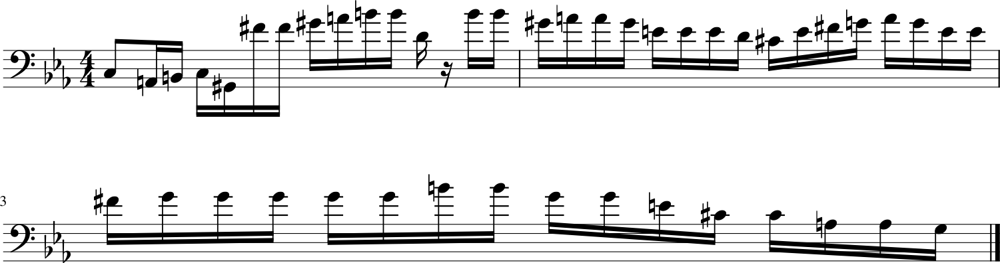

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5136 - loss: 1.5910 - note_outputs_loss: 1.0774
Epoch 80/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5234 - loss: 1.5829 - note_outputs_loss: 1.0595
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'E4', 'E4', 'E4', 'F#4', 'G4', 'A4', 'B4', 'F#4', 'D4', 'C#4', 'B3', 'B3', 'G#3', 'B3', 'E4', 'E4', 'E4', 'D4', 'E4', 'F#4', 'G#4', 'A4', 'B4', 'C#4', 'D4', 'E4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'F#4', 'E4', 'D4', 'C#4', 'D4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'F#4', 'F#4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


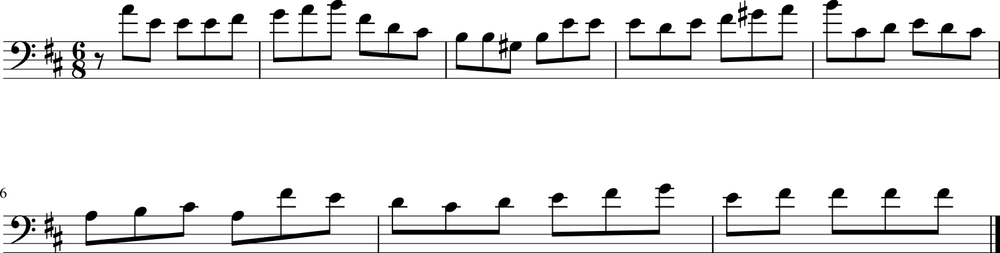

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5235 - loss: 1.5837 - note_outputs_loss: 1.0602
Epoch 81/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5573 - loss: 1.6758 - note_outputs_loss: 1.1185
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'G#2', 'C3', 'F3', 'G#3', 'C4', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'D3', 'C3', 'D3', 'C3', 'G2', 'C2', 'E-3', 'F3', 'E-3', 'E3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


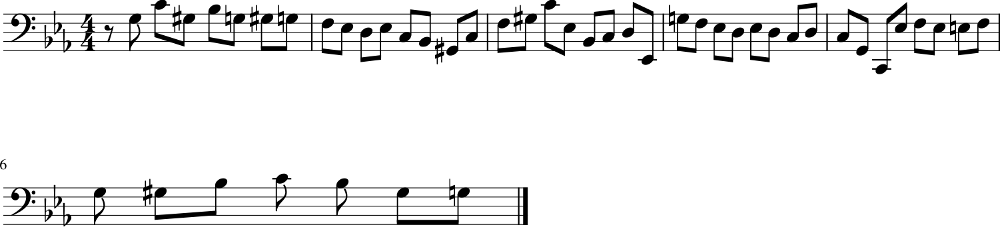

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5571 - loss: 1.6757 - note_outputs_loss: 1.1186
Epoch 82/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5277 - loss: 1.5891 - note_outputs_loss: 1.0614
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'D3', 'B2', 'D3', 'G3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'G3', 'D3', 'E3', 'F3', 'D3', 'B2', 'C3', 'D3', 'B2', 'G2', 'C2', 'C3', 'D3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


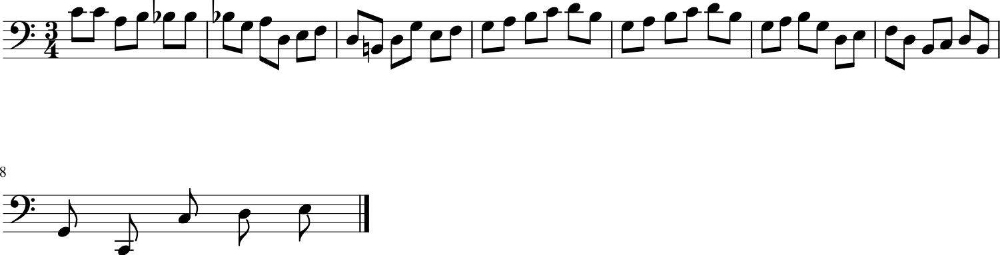

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5277 - loss: 1.5898 - note_outputs_loss: 1.0621
Epoch 83/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5597 - loss: 1.6487 - note_outputs_loss: 1.0890
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'G2', 'B-2', 'C3', 'G#2', 'G3', 'B-2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'D3', 'B-2', 'D3', 'G#2', 'G2', 'B-2', 'E-3', 'G3', 'B-3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'B-2', 'C3', 'D3', 'C4', 'G2', 'B-3', 'E-3', 'D3', 'E-2', 'G2', 'G#2'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


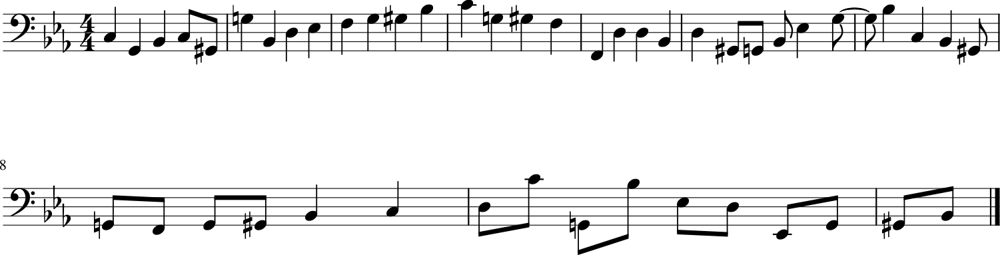

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5594 - loss: 1.6487 - note_outputs_loss: 1.0893
Epoch 84/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5621 - loss: 1.6466 - note_outputs_loss: 1.0844
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#3', 'F3', 'G3', 'B-3', 'D3', 'E-3', 'G2', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


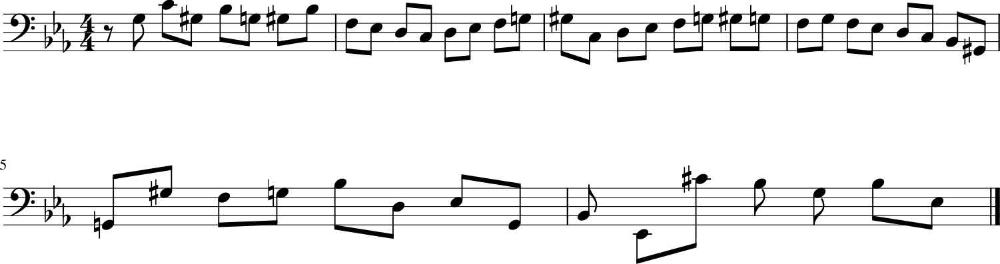

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5619 - loss: 1.6466 - note_outputs_loss: 1.0848
Epoch 85/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5164 - loss: 1.6271 - note_outputs_loss: 1.1107
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


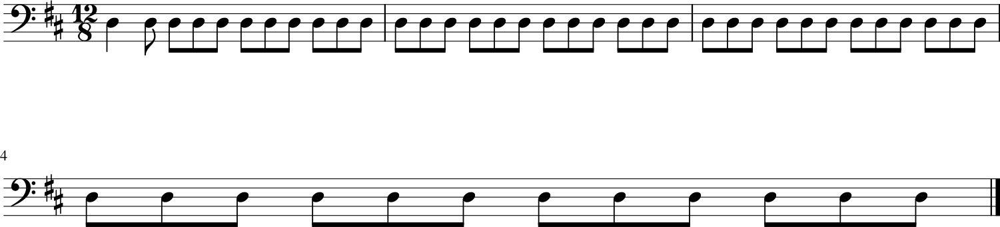

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5165 - loss: 1.6272 - note_outputs_loss: 1.1107
Epoch 86/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4919 - loss: 1.6066 - note_outputs_loss: 1.1147
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'A2', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'F#3', 'D3', 'E-3', 'C3', 'B-2', 'G2', 'F2', 'A2', 'D3', 'C3', 'B-2', 'D3', 'B-2', 'D3', 'B-2', 'A2', 'B-2', 'D3', 'B-2', 'E3', 'B-2', 'A2', 'B-2', 'A2', 'B-2', 'D3', 'G#2', 'B2', 'C3', 'B-2', 'A2', 'E-3', 'F3', 'D3', 'B-2', 'E2', 'B-2', 'C3', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


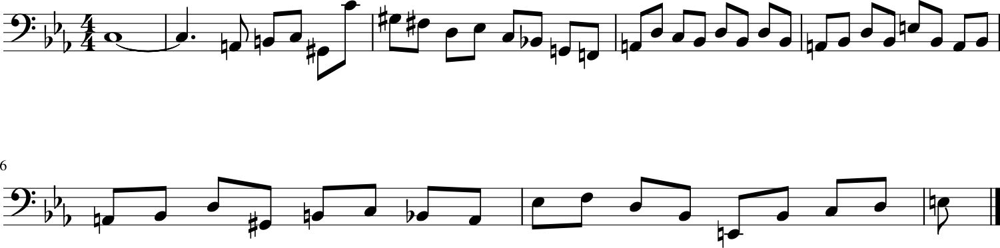

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4924 - loss: 1.6070 - note_outputs_loss: 1.1147
Epoch 87/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5634 - loss: 1.6092 - note_outputs_loss: 1.0457
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'G2', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'F3', 'E-3', 'F3', 'G3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'D4', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'A3', 'C4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


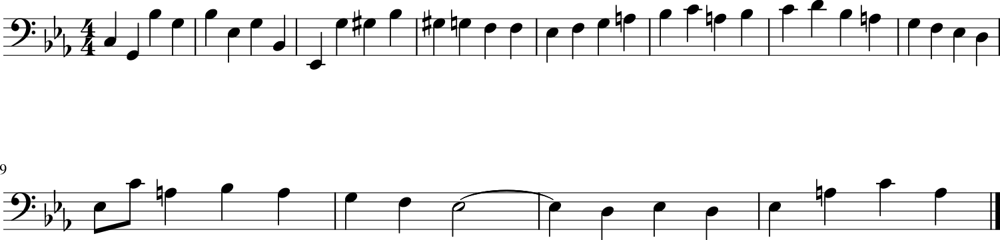

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5631 - loss: 1.6095 - note_outputs_loss: 1.0463
Epoch 88/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5795 - loss: 1.6623 - note_outputs_loss: 1.0828
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'E-2', 'G#3', 'F3', 'F3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'B3', 'D4', 'G3', 'F3', 'E-3', 'G3', 'D3', 'E-3', 'B-2', 'G2', 'B-2', 'E-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


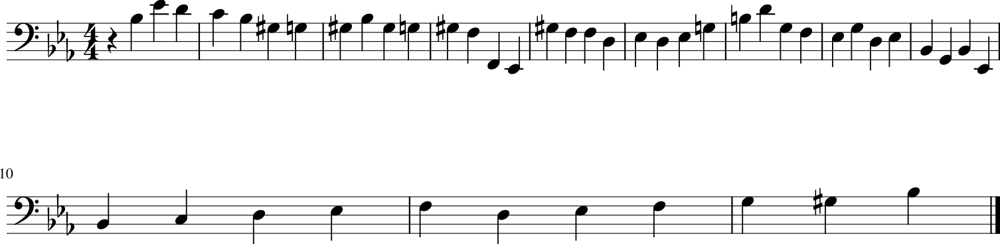

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5790 - loss: 1.6620 - note_outputs_loss: 1.0829
Epoch 89/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5255 - loss: 1.5891 - note_outputs_loss: 1.0636
Generation prompt: [['START', 'G:major', '3/4TS', 'G2', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'G3', 'C4', 'A3', 'B3', 'G3', 'D3', 'C4', 'B3', 'G3', 'C3', 'B3', 'A3', 'G3', 'F#3', 'A3', 'D4', 'D3', 'G3', 'B2', 'D2', 'F#3', 'G3', 'B3', 'A3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


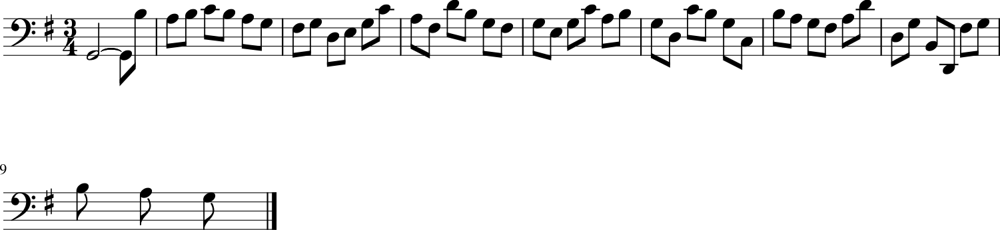

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5256 - loss: 1.5895 - note_outputs_loss: 1.0639
Epoch 90/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5293 - loss: 1.6249 - note_outputs_loss: 1.0956
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'A3', 'F3', 'A3', 'E-3', 'C4', 'A3', 'F3', 'A3', 'B-3', 'G3', 'F3', 'A3', 'D3', 'G3', 'F3', 'E-3', 'D3', 'C4', 'B3', 'C4', 'B-3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


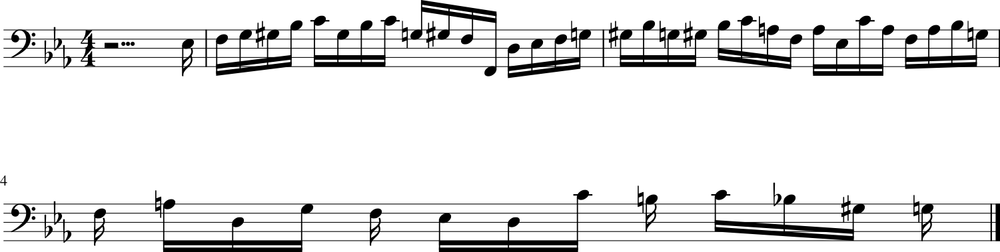

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5293 - loss: 1.6249 - note_outputs_loss: 1.0956
Epoch 91/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5415 - loss: 1.6071 - note_outputs_loss: 1.0656
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'F#4', 'F#4', 'F#4', 'F#4', 'F#4', 'G4', 'C4', 'F#4', 'D4', 'E3', 'D4', 'C#4', 'B3', 'D4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'D4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'F#4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


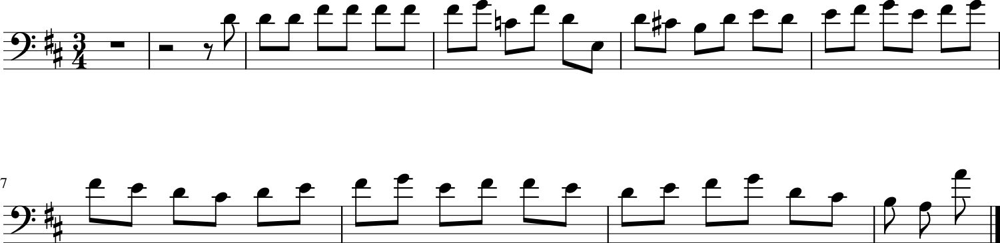

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5414 - loss: 1.6072 - note_outputs_loss: 1.0657
Epoch 92/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5111 - loss: 1.5545 - note_outputs_loss: 1.0435
Generation prompt: [['START', 'G:major', '4/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'D3', 'G2', 'B3', 'A3', 'B3', 'D3', 'B3', 'D3', 'G2', 'D3', 'B3', 'D3', 'B3', 'D3', 'E3', 'G3', 'D3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'F3', 'E3', 'F2', 'A3', 'G3', 'F3', 'E3', 'C#3', 'D3', 'B-2', 'A2', 'G2', 'A2', 'F2', 'D2', 'A2'], ['0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


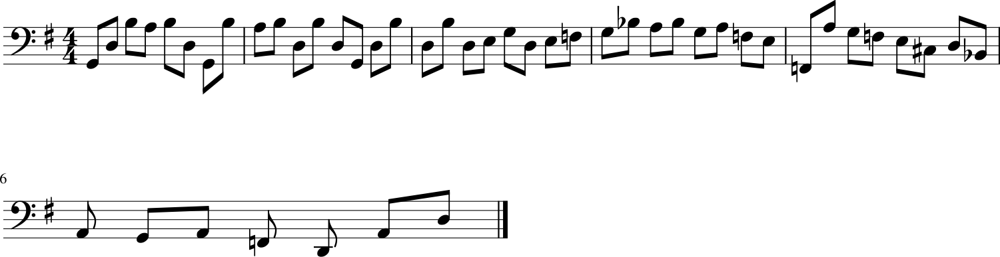

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5113 - loss: 1.5552 - note_outputs_loss: 1.0439
Epoch 93/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5465 - loss: 1.6063 - note_outputs_loss: 1.0598
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


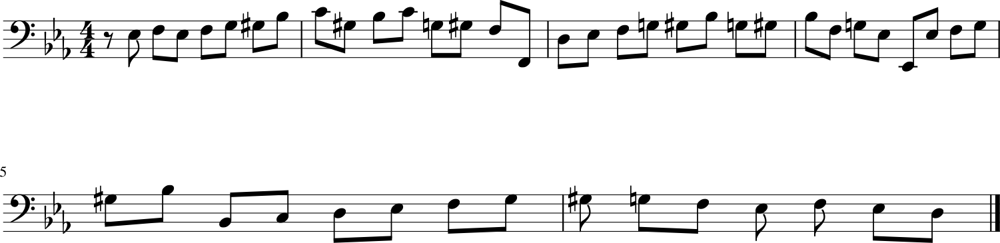

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5464 - loss: 1.6064 - note_outputs_loss: 1.0600
Epoch 94/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4917 - loss: 1.5093 - note_outputs_loss: 1.0176
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'F#4', 'G4', 'F#4', 'G4', 'E4', 'C#4', 'D4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'G4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'A4', 'A4', 'A4', 'B4', 'A4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'F#4', 'F#4', 'F#4', 'F#4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'D4'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


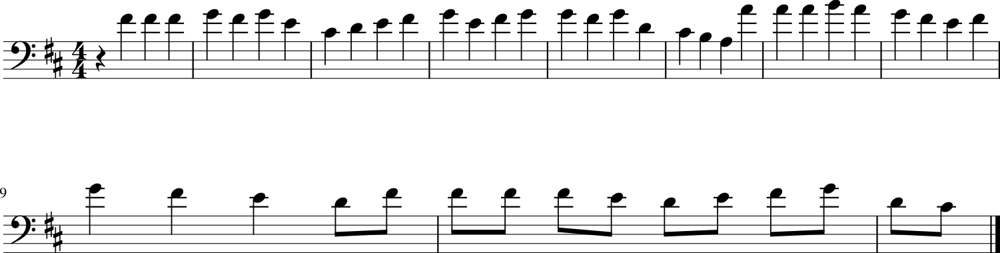

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4921 - loss: 1.5101 - note_outputs_loss: 1.0181
Epoch 95/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5313 - loss: 1.5607 - note_outputs_loss: 1.0294
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'F2', 'D3', 'G2', 'F2', 'G3', 'D3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'B-3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


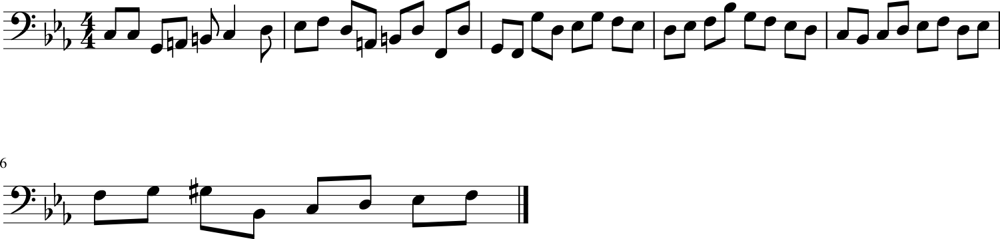

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5313 - loss: 1.5611 - note_outputs_loss: 1.0297
Epoch 96/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5313 - loss: 1.5672 - note_outputs_loss: 1.0358
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


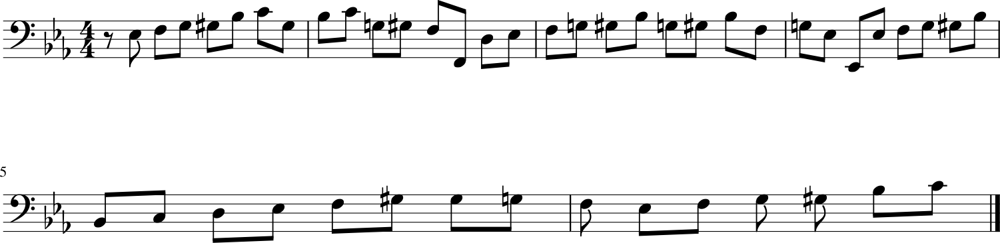

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5313 - loss: 1.5674 - note_outputs_loss: 1.0361
Epoch 97/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5064 - loss: 1.5414 - note_outputs_loss: 1.0351
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'B-2', 'B-3', 'G3', 'B-3', 'D3', 'E-3', 'C3', 'B-2', 'G#2', 'C3', 'G2', 'F2', 'G#2', 'D3', 'F3', 'G#3', 'C3', 'B2', 'D3', 'G3', 'B3', 'D4', 'F3', 'E-3', 'G3', 'C4', 'B3', 'C4', 'E-3', 'D3', 'C3', 'G2', 'D3', 'C4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


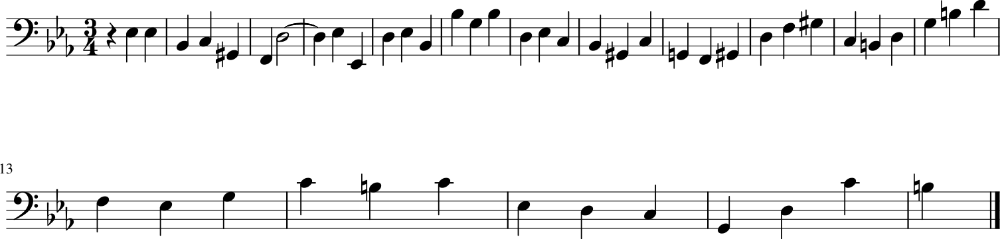

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5066 - loss: 1.5420 - note_outputs_loss: 1.0354
Epoch 98/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5147 - loss: 1.5531 - note_outputs_loss: 1.0384
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'G2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'E-3', 'G3', 'E-3', 'B-3', 'D3', 'E-3', 'C3', 'G#3', 'C3', 'D3', 'B2', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


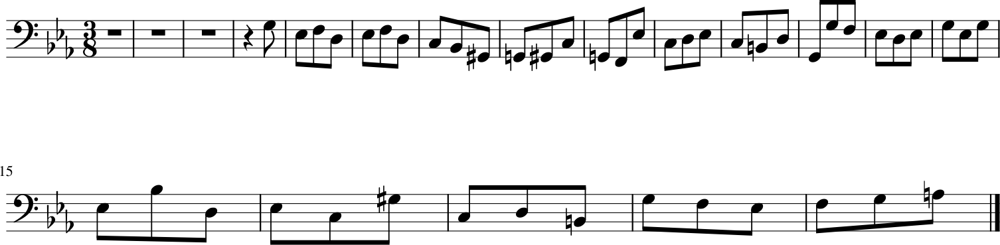

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5149 - loss: 1.5534 - note_outputs_loss: 1.0385
Epoch 99/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5703 - loss: 1.5963 - note_outputs_loss: 1.0260
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'E-3', 'D3', 'C3', 'D3', 'F3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


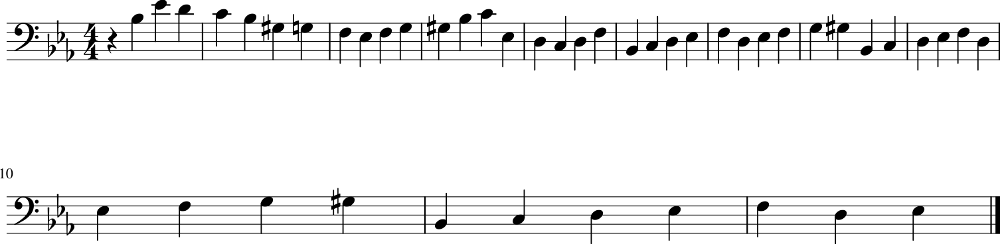

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5700 - loss: 1.5963 - note_outputs_loss: 1.0263
Epoch 100/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4764 - loss: 1.5104 - note_outputs_loss: 1.0340
Generation prompt: [['START', 'F:major', '3/4TS', 'A3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'F3', 'E3', 'F2', 'A3', 'G3', 'F3', 'E3', 'D3', 'G#3', 'D3', 'C#3', 'B2', 'C#3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'B-3', 'C4', 'A3', 'B-3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


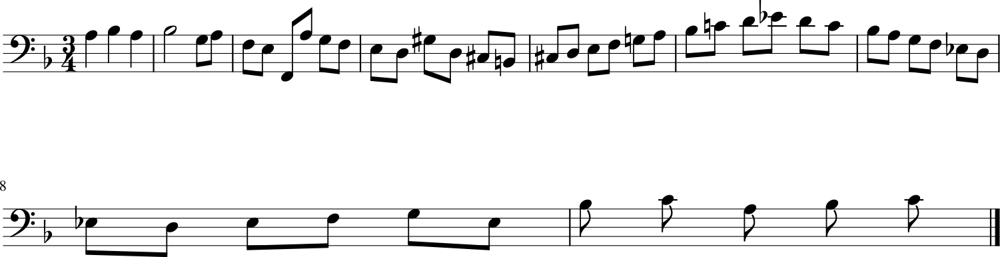

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4769 - loss: 1.5110 - note_outputs_loss: 1.0341
Epoch 101/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5832 - loss: 1.5865 - note_outputs_loss: 1.0032
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'C4', 'B-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


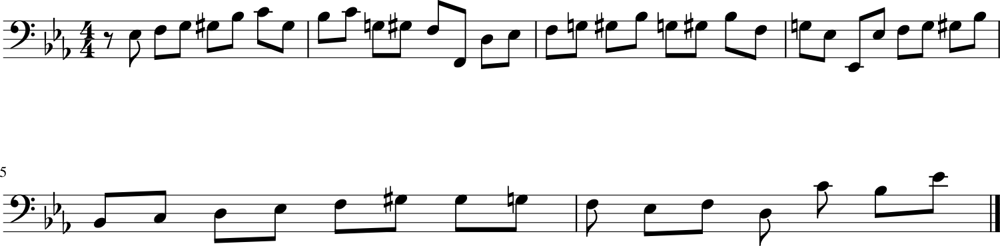

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5828 - loss: 1.5864 - note_outputs_loss: 1.0036
Epoch 102/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5169 - loss: 1.5084 - note_outputs_loss: 0.9915
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'B-3', 'B-3', 'B-3', 'G3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'C2', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'E3', 'E3', 'E3', 'E3', 'C3', 'E3', 'F#3', 'G3', 'A2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'E3', 'F#3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


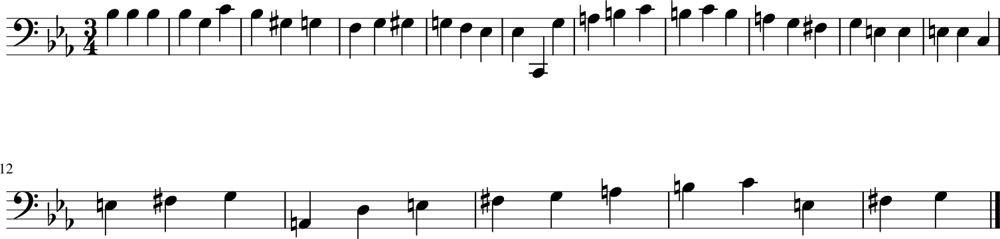

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5170 - loss: 1.5090 - note_outputs_loss: 0.9920
Epoch 103/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5048 - loss: 1.5090 - note_outputs_loss: 1.0042
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'F3', 'D3', 'E-3', 'C3', 'G#3', 'D3', 'G3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'B-3', 'F3', 'B-3', 'F3', 'E-3', 'F3', 'B-2', 'G3', 'E-3', 'F3', 'B-2', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


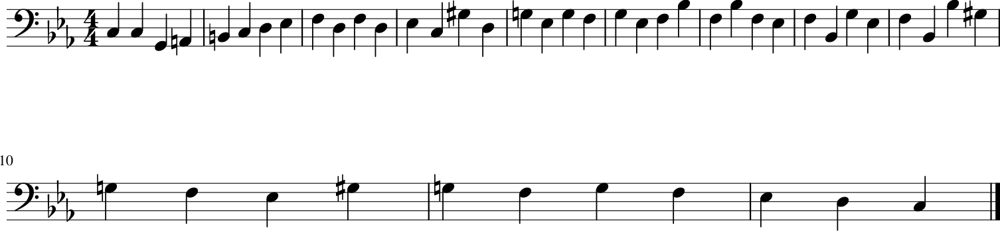

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5050 - loss: 1.5097 - note_outputs_loss: 1.0046
Epoch 104/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4814 - loss: 1.4768 - note_outputs_loss: 0.9955
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B-2', 'D3', 'E-2', 'B-3', 'G3', 'G3', 'E-3', 'C#2', 'B-3', 'G3', 'E3', 'F3', 'G2', 'C#4', 'B-3', 'E3', 'F3', 'C2', 'C4', 'B-3', 'G#3', 'E3', 'F3', 'F2', 'E-2', 'C3', 'F3', 'C3', 'F3', 'G#2', 'C3', 'E-2', 'D2', 'G#3', 'F3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


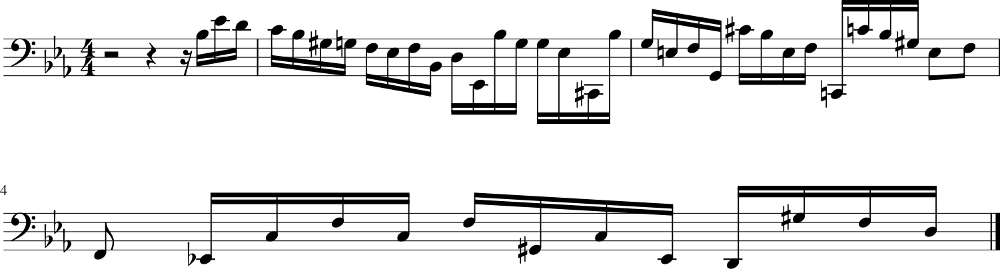

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4818 - loss: 1.4776 - note_outputs_loss: 0.9957
Epoch 105/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5585 - loss: 1.5603 - note_outputs_loss: 1.0017
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


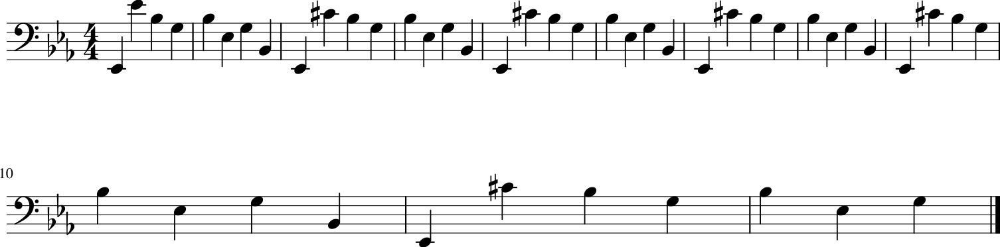

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5583 - loss: 1.5603 - note_outputs_loss: 1.0020
Epoch 106/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5075 - loss: 1.5155 - note_outputs_loss: 1.0080
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

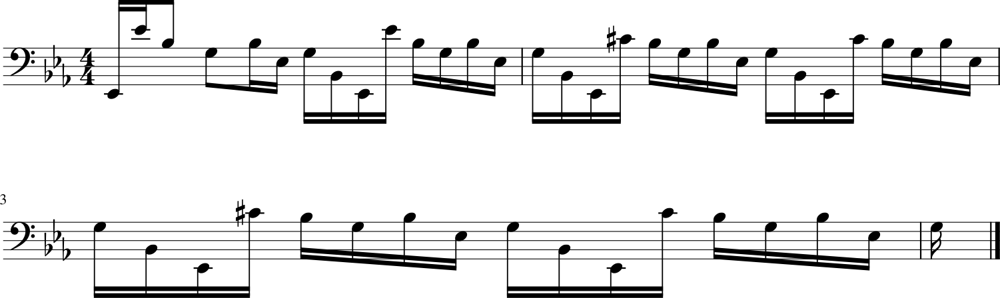

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5077 - loss: 1.5159 - note_outputs_loss: 1.0082
Epoch 107/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5558 - loss: 1.5503 - note_outputs_loss: 0.9945
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'F3'], ['0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


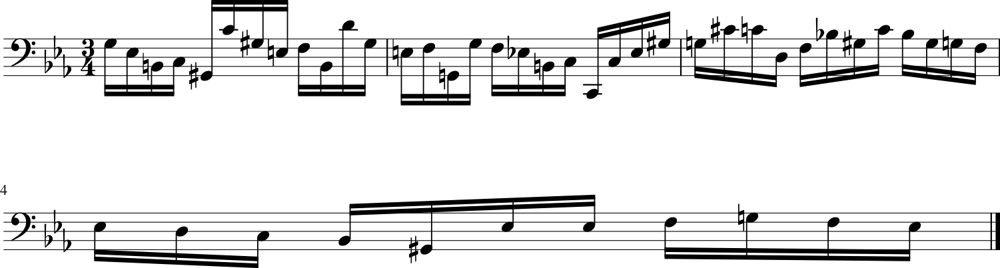

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5556 - loss: 1.5505 - note_outputs_loss: 0.9949
Epoch 108/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5111 - loss: 1.5151 - note_outputs_loss: 1.0040
Generation prompt: [['START', 'E-:major', '4/4TS', 'D3', 'B-3', 'G3', 'B-3', 'G3', 'C4', 'G#3', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


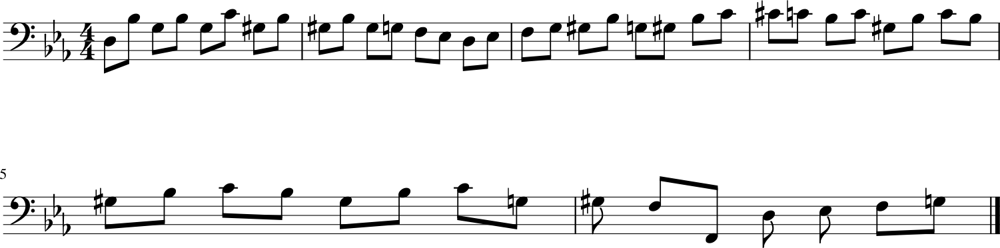

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5113 - loss: 1.5154 - note_outputs_loss: 1.0042
Epoch 109/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5310 - loss: 1.5383 - note_outputs_loss: 1.0074
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#3', 'F3', 'G3', 'B-3', 'D3', 'E-3', 'G2', 'B-2', 'E-2', 'E-3', 'G3', 'G#3', 'F3', 'G3', 'B-3', 'A3', 'B-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3'], ['0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


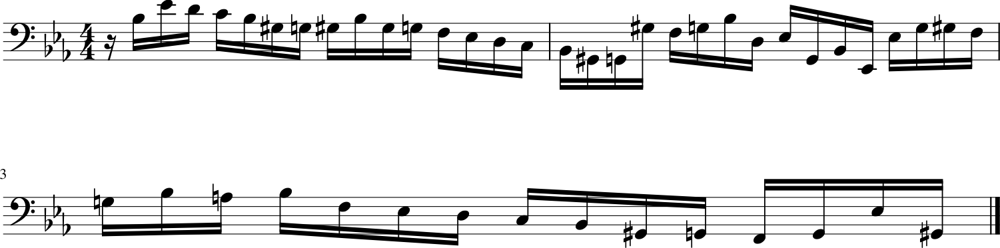

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5310 - loss: 1.5386 - note_outputs_loss: 1.0076
Epoch 110/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5046 - loss: 1.4593 - note_outputs_loss: 0.9547
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


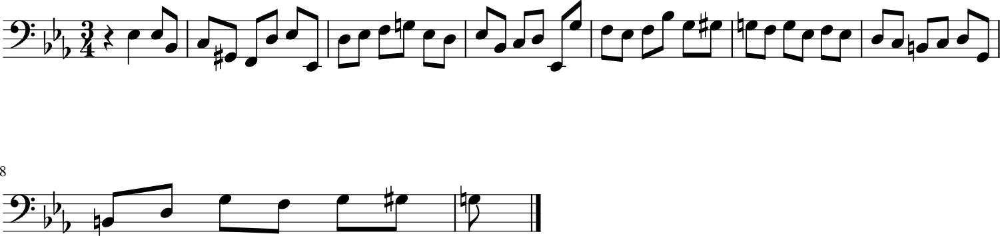

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5048 - loss: 1.4601 - note_outputs_loss: 0.9552
Epoch 111/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4899 - loss: 1.4922 - note_outputs_loss: 1.0023
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'C#3', 'E3', 'F3', 'G3', 'B-3', 'D4', 'A3', 'F3', 'E3', 'G3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'A3', 'B-3', 'B-3', 'A3', 'B-3', 'G3', 'C4', 'A3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


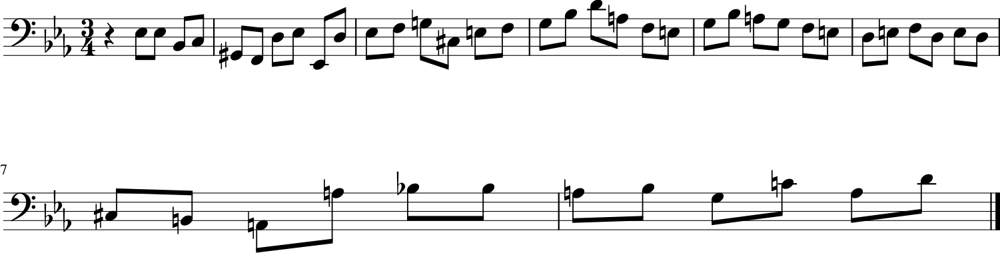

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4903 - loss: 1.4927 - note_outputs_loss: 1.0024
Epoch 112/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5196 - loss: 1.5219 - note_outputs_loss: 1.0024
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

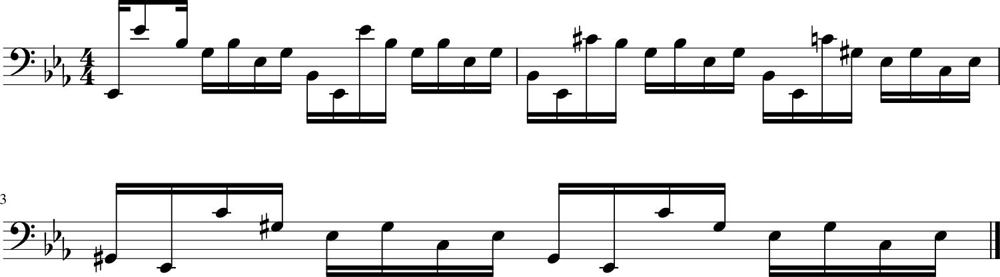

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5197 - loss: 1.5223 - note_outputs_loss: 1.0026
Epoch 113/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5811 - loss: 1.5773 - note_outputs_loss: 0.9961
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'C3', 'F#4', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G3', 'D3', 'B2', 'D3', 'G3', 'B3', 'D4', 'B3', 'G3', 'F3', 'B2', 'F3', 'G3', 'F3', 'B2', 'F3', 'G3', 'F3', 'D4', 'B3', 'G3', 'E3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


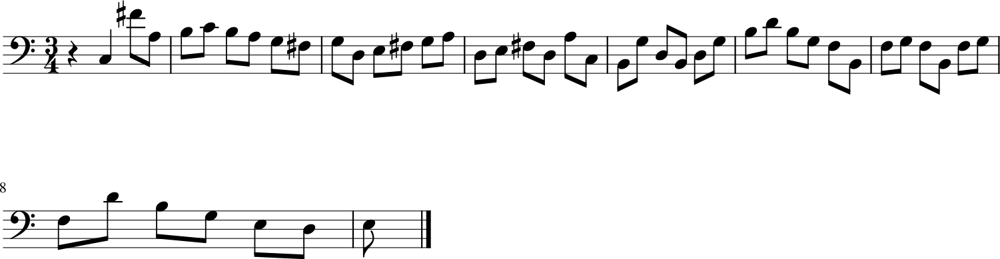

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5807 - loss: 1.5771 - note_outputs_loss: 0.9964
Epoch 114/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4980 - loss: 1.4748 - note_outputs_loss: 0.9768
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


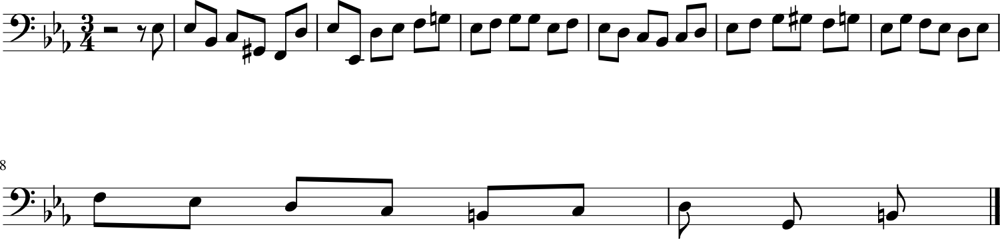

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4983 - loss: 1.4755 - note_outputs_loss: 0.9772
Epoch 115/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5090 - loss: 1.4643 - note_outputs_loss: 0.9553
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'G#3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


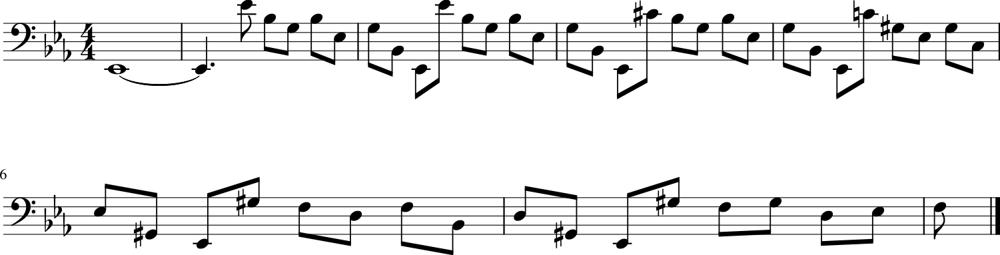

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5092 - loss: 1.4650 - note_outputs_loss: 0.9558
Epoch 116/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5165 - loss: 1.4606 - note_outputs_loss: 0.9441
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'G4', 'C#4', 'C3', 'D3', 'E-3', 'G2', 'E-2', 'C4', 'B3', 'C4', 'C4', 'C4', 'B3', 'A3', 'G#3', 'F#3', 'G#3', 'A3', 'B3', 'A3', 'B3', 'A3', 'G#3', 'F#3', 'G#3', 'F#3', 'E3', 'B3', 'A3', 'G#3', 'F#3', 'G#3', 'E3', 'C#4', 'B3', 'D4', 'C#4', 'B3', 'A3', 'G#3', 'A3', 'G#3', 'A3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


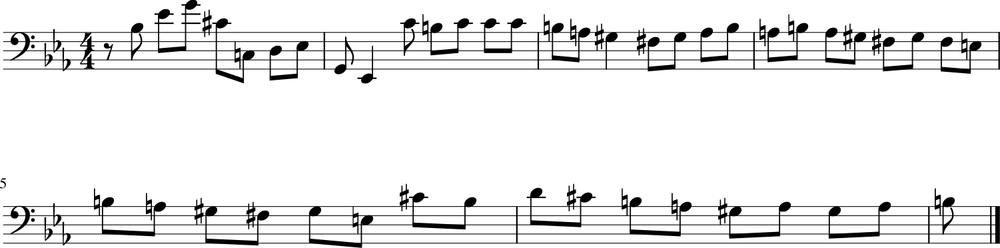

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5167 - loss: 1.4613 - note_outputs_loss: 0.9446
Epoch 117/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5302 - loss: 1.4934 - note_outputs_loss: 0.9631
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'G3', 'E-3', 'B-3', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3'], ['0.0', '1.0', '1.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


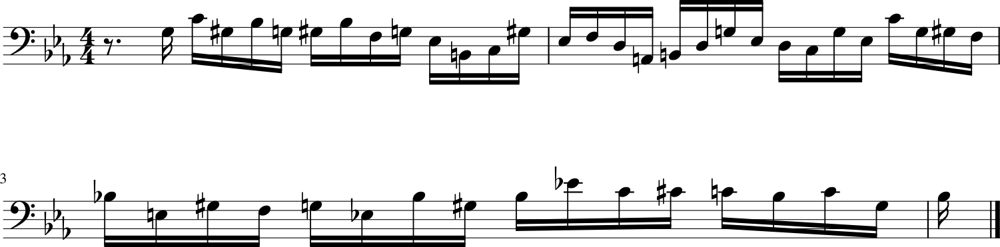

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5302 - loss: 1.4936 - note_outputs_loss: 0.9634
Epoch 118/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4734 - loss: 1.4162 - note_outputs_loss: 0.9428
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'F3', 'B-3', 'G3', 'B-3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'G2', 'B-2', 'E-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


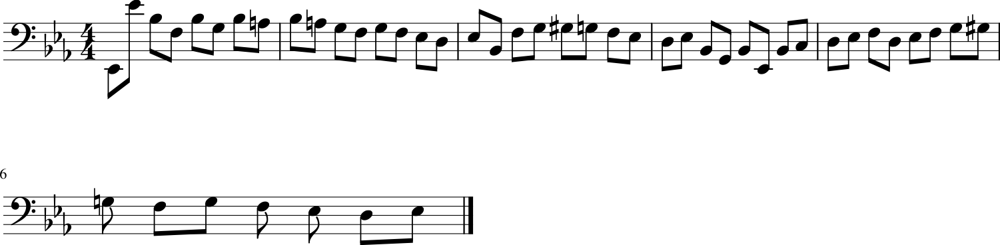

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4740 - loss: 1.4172 - note_outputs_loss: 0.9433
Epoch 119/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5432 - loss: 1.4835 - note_outputs_loss: 0.9403
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'C3', 'F3', 'G#2'], ['0.0', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

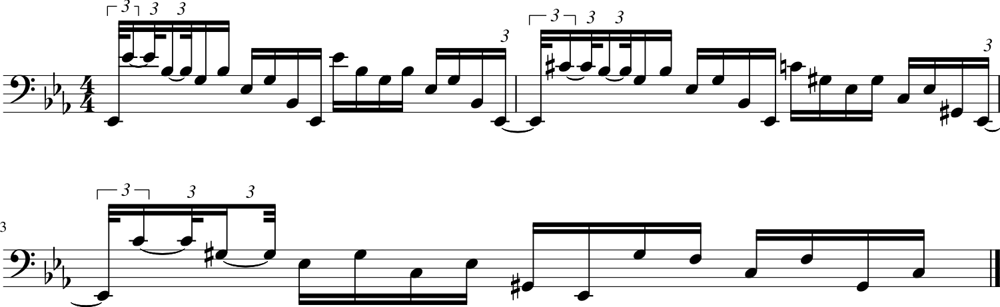

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5431 - loss: 1.4839 - note_outputs_loss: 0.9408
Epoch 120/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5241 - loss: 1.4857 - note_outputs_loss: 0.9616
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'D4', 'E4', 'F4', 'D4', 'E4', 'D4', 'C#4', 'E4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


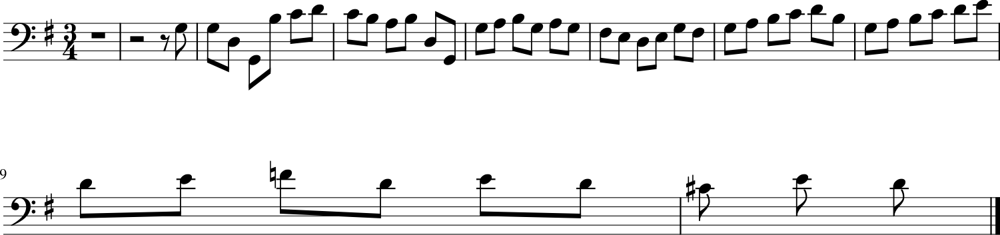

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5242 - loss: 1.4860 - note_outputs_loss: 0.9618
Epoch 121/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4551 - loss: 1.4132 - note_outputs_loss: 0.9582
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'F3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'D3', 'G#2', 'E-3', 'C3'], ['0.0', '1/12', '1/6', '1/12', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '0.25', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '0.25', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12']]


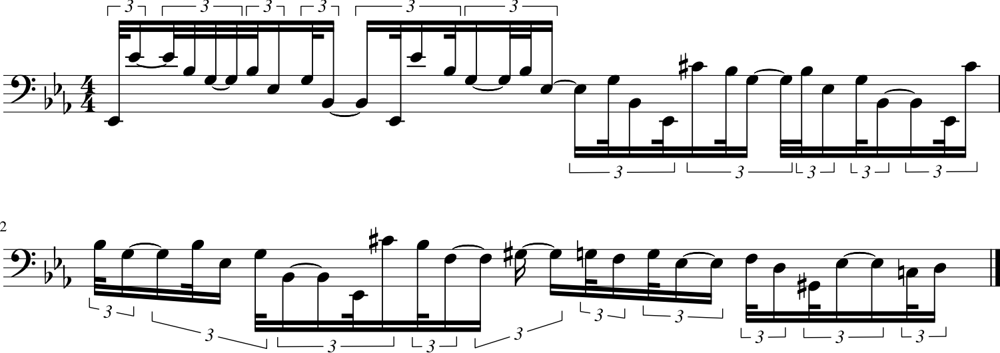

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 63ms/step - duration_outputs_loss: 0.4558 - loss: 1.4143 - note_outputs_loss: 0.9585
Epoch 122/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5269 - loss: 1.4817 - note_outputs_loss: 0.9547
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'D3', 'B-2', 'C3', 'G#2', 'C4', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'F2', 'G#3', 'G#3', 'G3', 'G#3', 'F3', 'D4', 'C4', 'D4', 'B-3', 'F4', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'G3', 'G#3', 'F4', 'G3', 'G#3', 'G#3', 'F3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


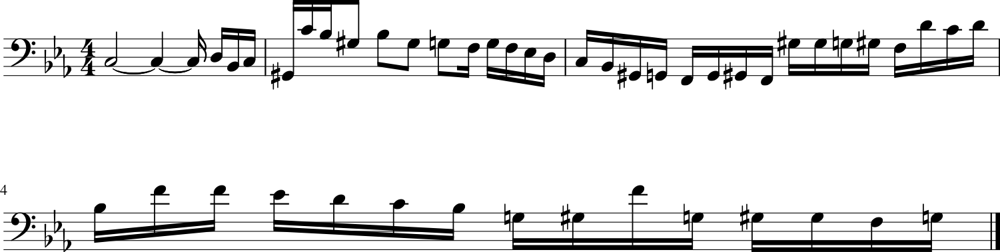

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5270 - loss: 1.4821 - note_outputs_loss: 0.9551
Epoch 123/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5063 - loss: 1.4668 - note_outputs_loss: 0.9605
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'C4', 'C4', 'C4', 'A3', 'B3', 'D4', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'C4', 'E3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'A2', 'G2', 'G3', 'F3', 'G2', 'A2', 'B2', 'G2', 'F2', 'E2', 'G2', 'C3', 'E2', 'D2', 'B2', 'C3', 'E3', 'G3', 'C4', 'D4', 'B3', 'C4', 'A3', 'F3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


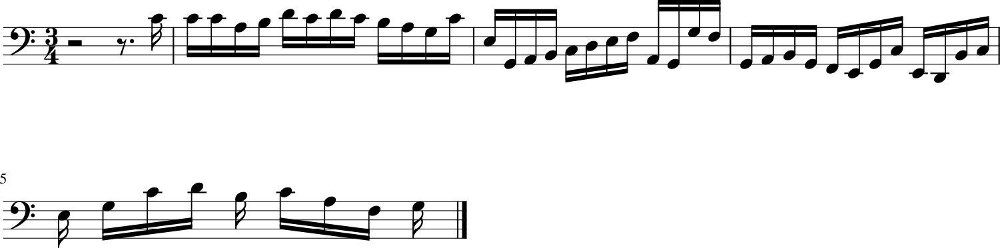

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5065 - loss: 1.4673 - note_outputs_loss: 0.9608
Epoch 124/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5590 - loss: 1.5221 - note_outputs_loss: 0.9631
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'C4', 'C#4', 'B-3', 'G#3', 'G3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'E-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


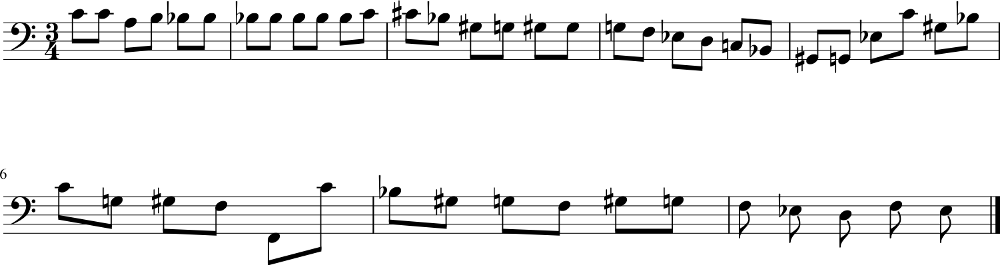

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5587 - loss: 1.5221 - note_outputs_loss: 0.9634
Epoch 125/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4926 - loss: 1.4541 - note_outputs_loss: 0.9616
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'G3', 'A3', 'F3', 'D3', 'F3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'F3', 'E-3', 'D3', 'E-3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


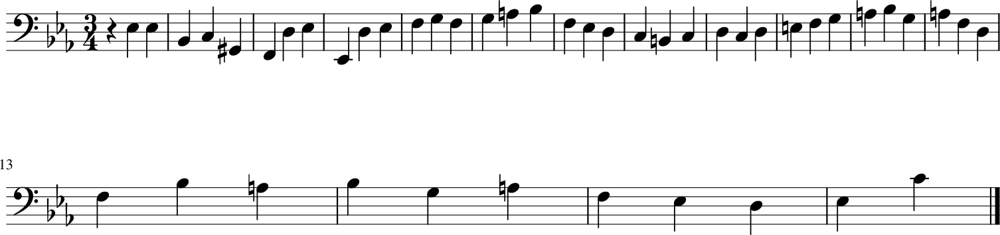

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4929 - loss: 1.4547 - note_outputs_loss: 0.9618
Epoch 126/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5829 - loss: 1.5472 - note_outputs_loss: 0.9643
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'D4', 'D4', 'D4', 'C4', 'B3', 'A3', 'A3', 'B3', 'G3', 'D3', 'B2', 'G2', 'F3', 'D3', 'F3', 'B3', 'F3', 'G3', 'F3', 'F3', 'F3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'B2', 'G2', 'B2', 'D3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


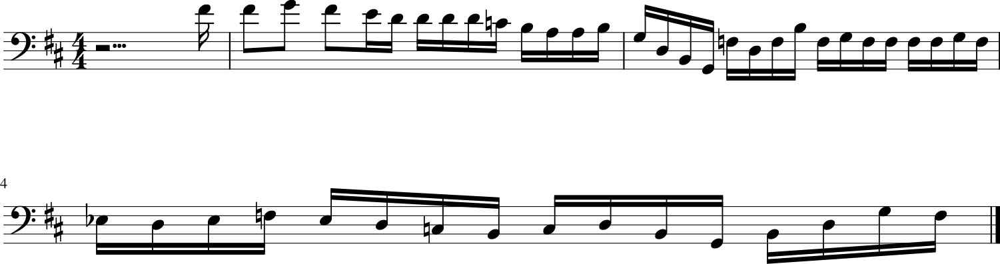

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5824 - loss: 1.5468 - note_outputs_loss: 0.9644
Epoch 127/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4949 - loss: 1.4567 - note_outputs_loss: 0.9618
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E3', 'F3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'F#3', 'B3', 'B-3', 'G#3', 'G3', 'F3', 'E3', 'F3', 'G3', 'G#3', 'F3', 'B3', 'C4', 'G3', 'G#3', 'F3', 'E3', 'D3', 'C3', 'B2', 'C3', 'G3', 'B2', 'A2', 'G2', 'B3', 'C4', 'C3', 'A2', 'C3', 'E-3', 'F#3', 'C3', 'A3', 'D3', 'G3', 'D3', 'G2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


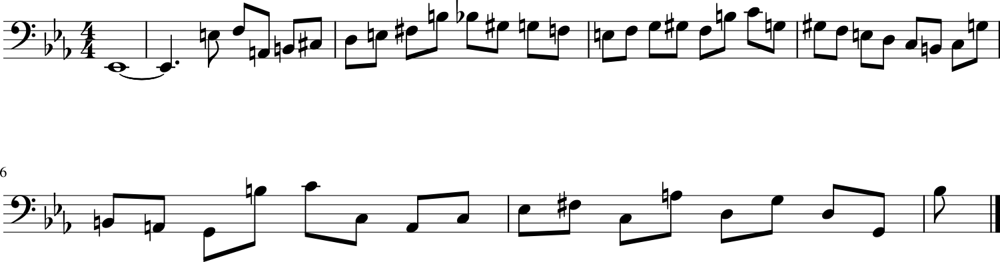

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4953 - loss: 1.4572 - note_outputs_loss: 0.9619
Epoch 128/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5187 - loss: 1.4767 - note_outputs_loss: 0.9580
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

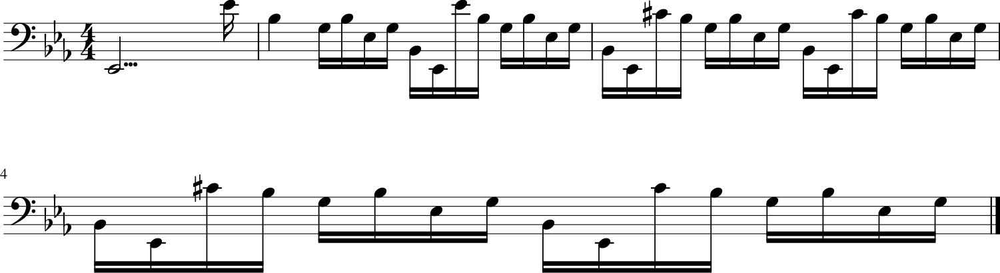

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5189 - loss: 1.4771 - note_outputs_loss: 0.9582
Epoch 129/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5223 - loss: 1.4300 - note_outputs_loss: 0.9076
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'C#4', 'E4', 'F#4', 'G4', 'B-3', 'G4', 'F#4', 'E4', 'B4', 'B-4', 'G#4', 'F#4', 'B4', 'A4', 'G4', 'F#4', 'E4', 'D4', 'C#4', 'D4', 'C#4', 'E4', 'B-3', 'B3', 'C#4', 'G3', 'F#3', 'E3', 'D3', 'C#3', 'D3', 'B2', 'B3', 'A2', 'G2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


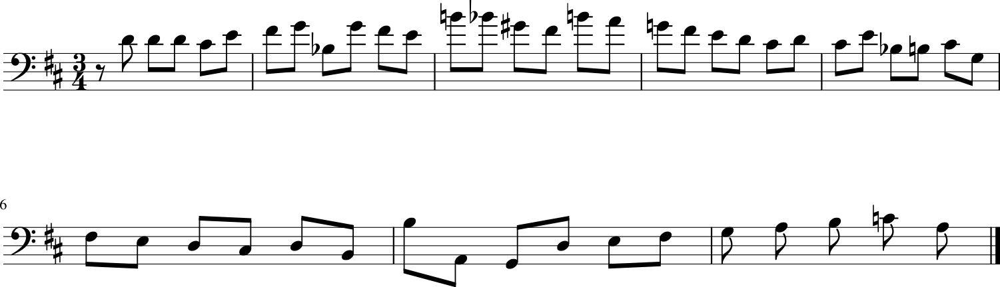

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5224 - loss: 1.4306 - note_outputs_loss: 0.9082
Epoch 130/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5767 - loss: 1.5111 - note_outputs_loss: 0.9344
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'G#3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'G3', 'G#3', 'C3', 'D3', 'G#3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B2', 'D3', 'F3', 'E-3', 'F3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


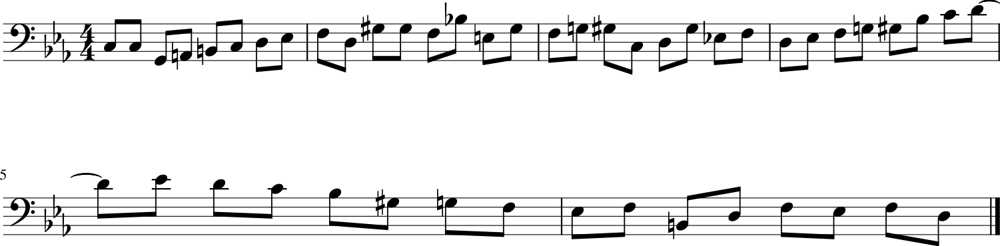

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5763 - loss: 1.5110 - note_outputs_loss: 0.9347
Epoch 131/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4934 - loss: 1.4403 - note_outputs_loss: 0.9469
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


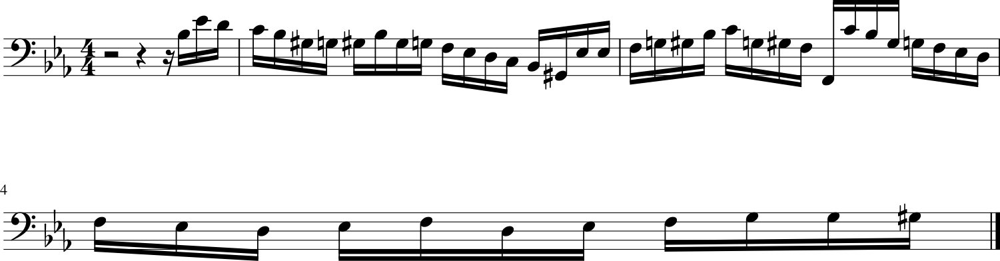

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4938 - loss: 1.4409 - note_outputs_loss: 0.9471
Epoch 132/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5373 - loss: 1.4929 - note_outputs_loss: 0.9555
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'B3', 'C4', 'G2', 'A3', 'F3', 'G2', 'D3', 'G2', 'B3', 'C4', 'D4', 'G2', 'B3', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'B2', 'E-3', 'E2', 'E3', 'D3', 'C3', 'B2', 'D3', 'G3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


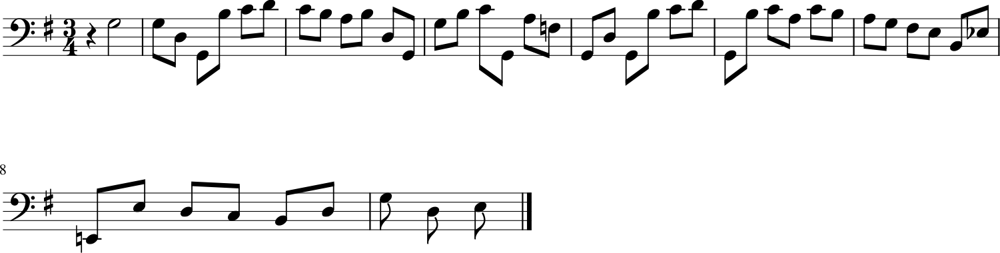

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5373 - loss: 1.4927 - note_outputs_loss: 0.9554
Epoch 133/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4833 - loss: 1.3845 - note_outputs_loss: 0.9011
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


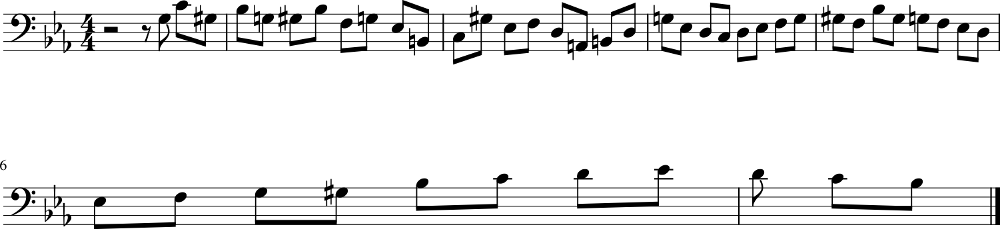

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4838 - loss: 1.3854 - note_outputs_loss: 0.9016
Epoch 134/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5388 - loss: 1.4744 - note_outputs_loss: 0.9356
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


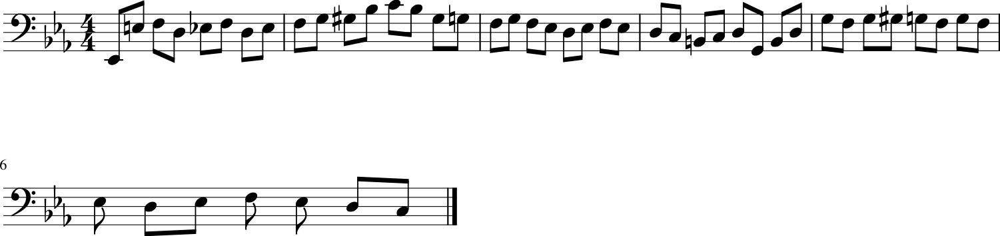

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5388 - loss: 1.4747 - note_outputs_loss: 0.9359
Epoch 135/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5663 - loss: 1.4832 - note_outputs_loss: 0.9168
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G3', 'C4', 'E-3', 'F3', 'D3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'C4', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


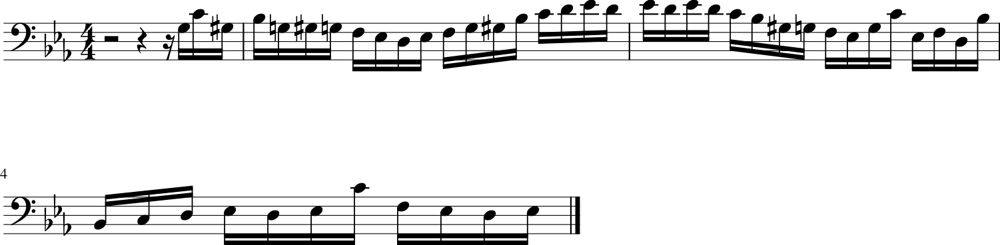

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5660 - loss: 1.4832 - note_outputs_loss: 0.9172
Epoch 136/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4625 - loss: 1.3490 - note_outputs_loss: 0.8865
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'E-3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'B-3', 'G3', 'A3', 'B-3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'B-3', 'A3', 'G3', 'F#3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


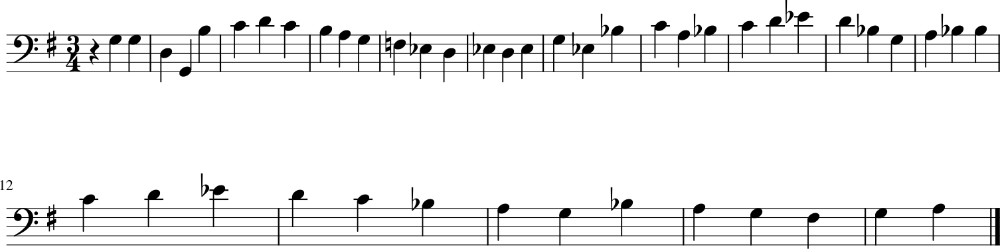

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4631 - loss: 1.3502 - note_outputs_loss: 0.8871
Epoch 137/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5641 - loss: 1.4674 - note_outputs_loss: 0.9033
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F4', 'E-4', 'C4', 'E-4', 'A3', 'F3', 'E-4', 'D4', 'B-3', 'D4', 'G3', 'E-3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


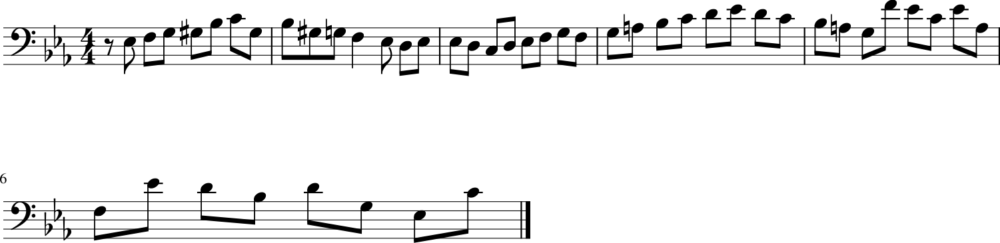

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5639 - loss: 1.4675 - note_outputs_loss: 0.9037
Epoch 138/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5593 - loss: 1.5290 - note_outputs_loss: 0.9697
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'C#4', 'E4', 'C3', 'G3', 'A3', 'B3', 'A3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'C4', 'D4', 'B3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


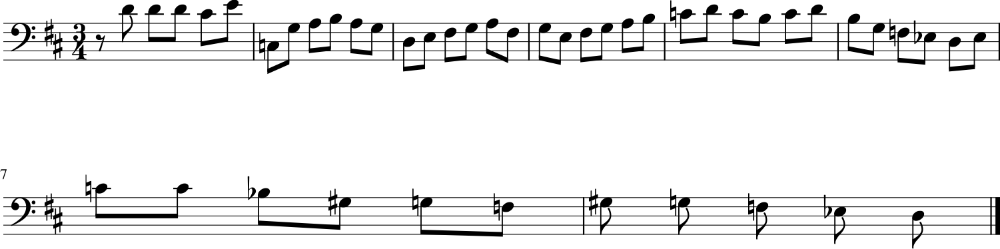

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5590 - loss: 1.5287 - note_outputs_loss: 0.9697
Epoch 139/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4888 - loss: 1.4109 - note_outputs_loss: 0.9221
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'B-3', 'G#3', 'G3', 'F3', 'E3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


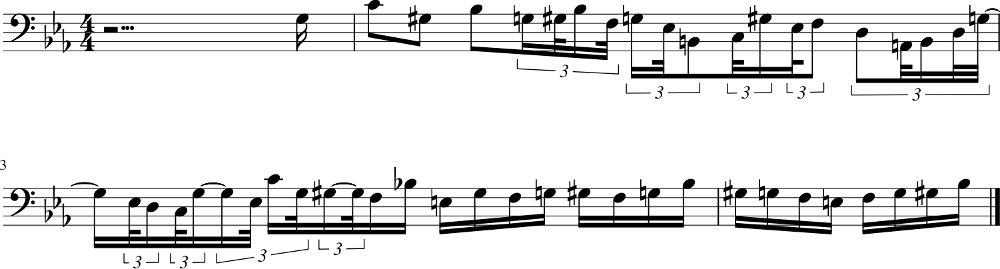

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4892 - loss: 1.4116 - note_outputs_loss: 0.9223
Epoch 140/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5183 - loss: 1.4526 - note_outputs_loss: 0.9344
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'F#4', 'G4', 'E3', 'F#4', 'A3', 'A3', 'F#3', 'D4', 'A3', 'G3', 'F#3', 'E3', 'D3', 'A3', 'C3', 'B2', 'G3', 'D3', 'B2', 'D3', 'G3', 'B3', 'D4', 'C4', 'C3', 'D3', 'B3', 'A3', 'C4', 'B3', 'A3', 'B3', 'G3', 'D3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


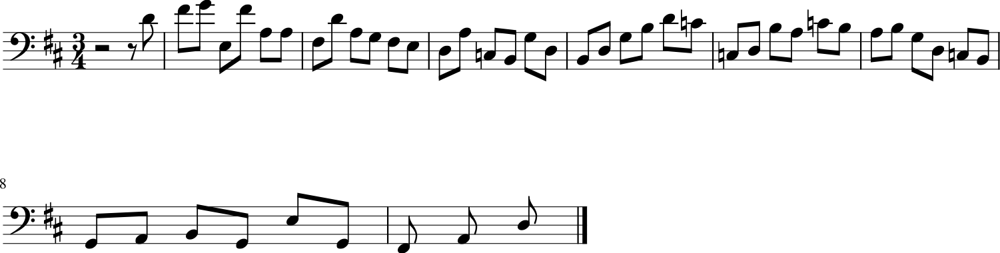

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5184 - loss: 1.4529 - note_outputs_loss: 0.9345
Epoch 141/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5682 - loss: 1.5348 - note_outputs_loss: 0.9666
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'F4', 'D4', 'E4', 'C4', 'B3', 'C2', 'E4', 'D4', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


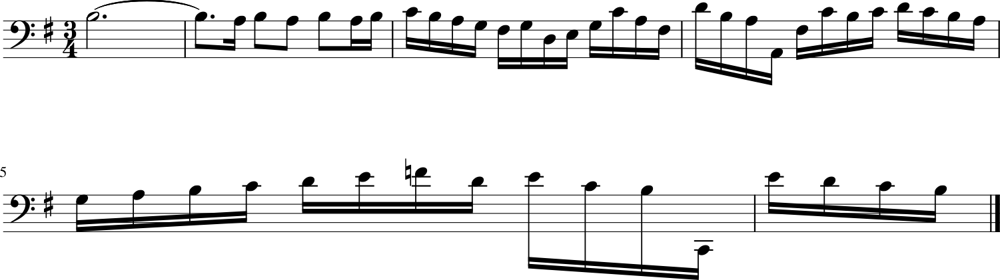

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5678 - loss: 1.5343 - note_outputs_loss: 0.9665
Epoch 142/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5477 - loss: 1.4551 - note_outputs_loss: 0.9075
Generation prompt: [['START', 'D:major', '3/2TS', 'F#4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'E4', 'E4', 'D4', 'C#4', 'B3', 'G3', 'F3', 'E3', 'D3', 'D4', 'C#4', 'D4', 'C#4', 'B3', 'E4', 'D4', 'C#4', 'B3', 'C#4', 'A3', 'E4', 'D4', 'C#4', 'B3', 'C#4', 'A3', 'F#4', 'E4', 'G4', 'F#4', 'E4', 'D4', 'B4', 'G#4', 'A4', 'B4', 'E4', 'G#4', 'D4', 'C#4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '2.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


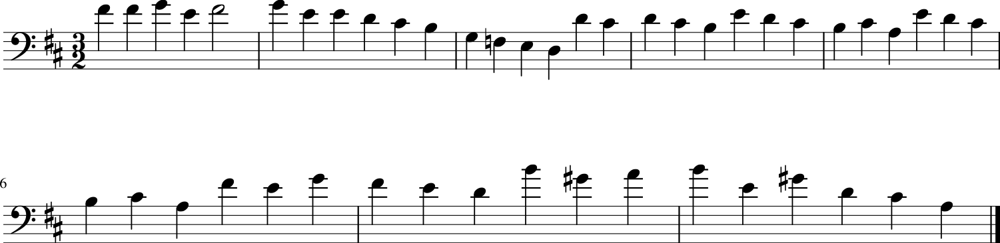

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5475 - loss: 1.4553 - note_outputs_loss: 0.9078
Epoch 143/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5109 - loss: 1.4062 - note_outputs_loss: 0.8954
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'G4', 'C#4', 'E-4', 'D4', 'B3', 'E-4', 'D4', 'C4', 'C#4', 'C#4', 'D4', 'A3', 'C#4', 'D4', 'D3', 'G2', 'F2', 'A3', 'B3', 'G3', 'E3', 'C3', 'B2', 'C#3', 'E3', 'A3', 'E3', 'C#3', 'E3', 'A2', 'A3', 'E3', 'G3', 'C#3', 'G3', 'E3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'E3', 'F#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


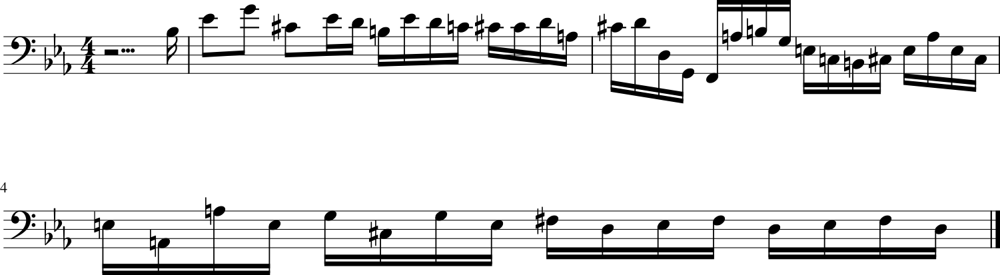

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5111 - loss: 1.4068 - note_outputs_loss: 0.8957
Epoch 144/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5036 - loss: 1.4431 - note_outputs_loss: 0.9396
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'E-4', 'D4'], ['0.0', '0.0', '0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


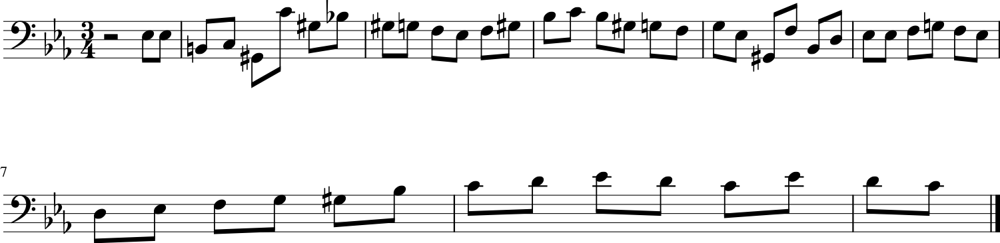

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5038 - loss: 1.4433 - note_outputs_loss: 0.9395
Epoch 145/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5223 - loss: 1.4011 - note_outputs_loss: 0.8789
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


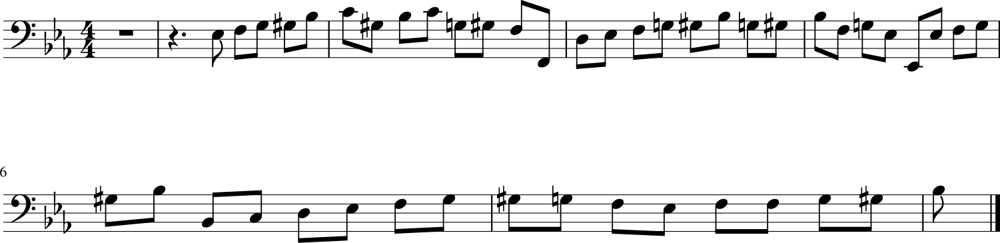

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5224 - loss: 1.4017 - note_outputs_loss: 0.8794
Epoch 146/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5239 - loss: 1.4560 - note_outputs_loss: 0.9321
Generation prompt: [['START', 'G:major', '3/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'B3', 'G3', 'D3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'C#3', 'D3', 'F#3', 'E3', 'D3', 'F#3', 'A3', 'C#4', 'D4', 'C#4', 'B3', 'C#4', 'A3', 'F#4', 'D4', 'C#4', 'D4', 'B3'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


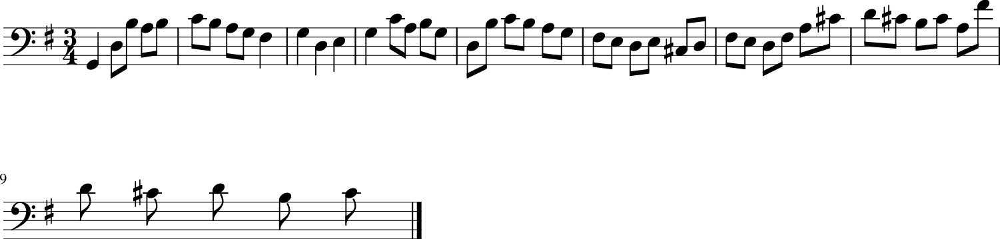

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5239 - loss: 1.4561 - note_outputs_loss: 0.9322
Epoch 147/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4970 - loss: 1.4028 - note_outputs_loss: 0.9058
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'C#4', 'D4', 'F#4', 'G4', 'F#4', 'E4', 'F#4', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'A4', 'A4', 'A4', 'B4', 'A4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'F#4', 'C#4', 'B3', 'B-3', 'B3', 'D3', 'F#4', 'G2', 'B4', 'A4', 'G4'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


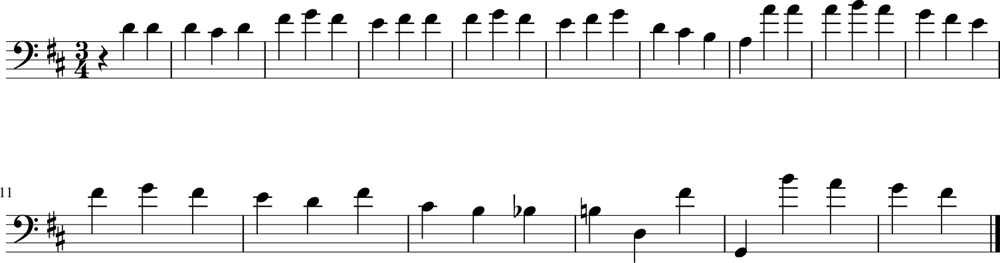

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4973 - loss: 1.4034 - note_outputs_loss: 0.9061
Epoch 148/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5299 - loss: 1.4530 - note_outputs_loss: 0.9230
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3'], ['0.0', '1/12', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]

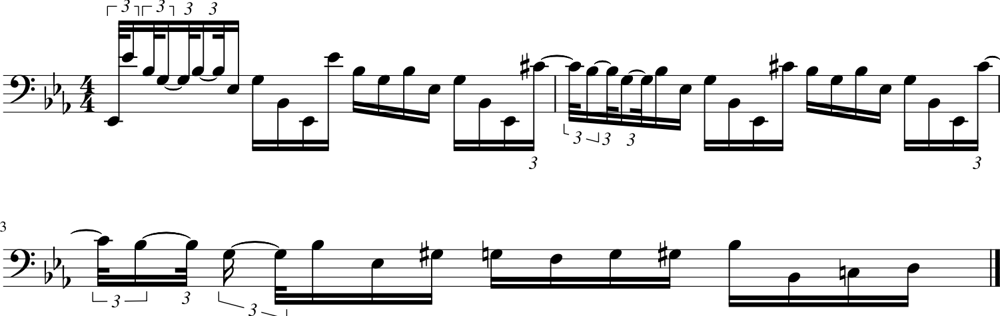

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5299 - loss: 1.4531 - note_outputs_loss: 0.9232
Epoch 149/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5553 - loss: 1.4430 - note_outputs_loss: 0.8877
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'C3', 'F3', 'G#2', 'C4', 'G#3', 'F3', 'E3', 'F3', 'C3', 'F3', 'G#2', 'E2', 'C4', 'B3', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'B3', 'C4', 'A3', 'F3', 'E3', 'D3', 'C3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'A2', 'G2', 'E3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


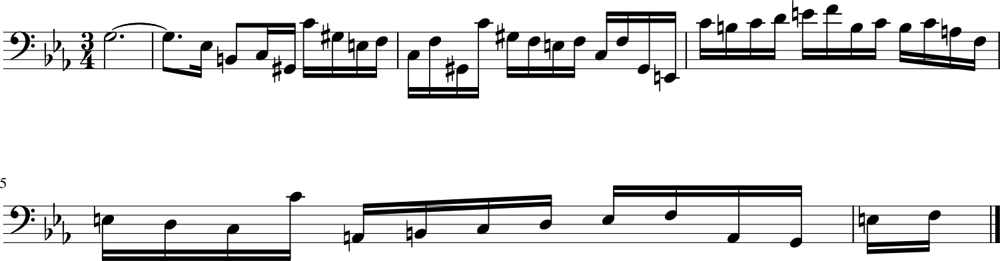

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5551 - loss: 1.4432 - note_outputs_loss: 0.8881
Epoch 150/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5618 - loss: 1.4764 - note_outputs_loss: 0.9146
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'C#4', 'E4', 'F#4', 'G4', 'D2', 'B4', 'A4', 'F#4', 'D4', 'C4', 'C4', 'A3', 'B3', 'F#3', 'D3', 'A2', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'E2', 'G3', 'A3', 'G3', 'F#3', 'G3', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C#2', 'A2', 'E3', 'F#3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


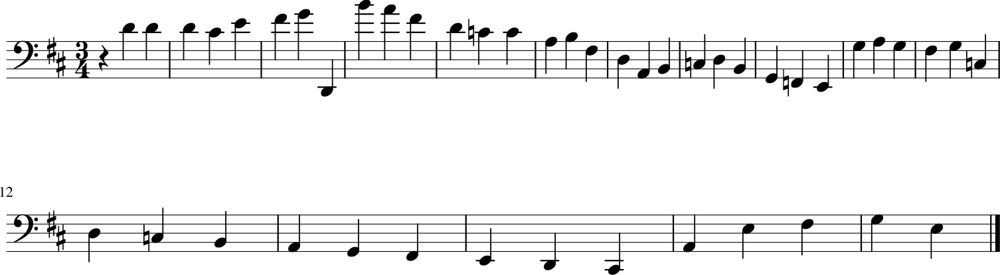

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5615 - loss: 1.4762 - note_outputs_loss: 0.9147
Epoch 151/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5217 - loss: 1.4428 - note_outputs_loss: 0.9211
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'A3', 'A3', 'F#3', 'G3', 'E3', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'B2', 'E-3', 'B2', 'C3', 'D3', 'E3'], ['0.0', '0.0', '0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


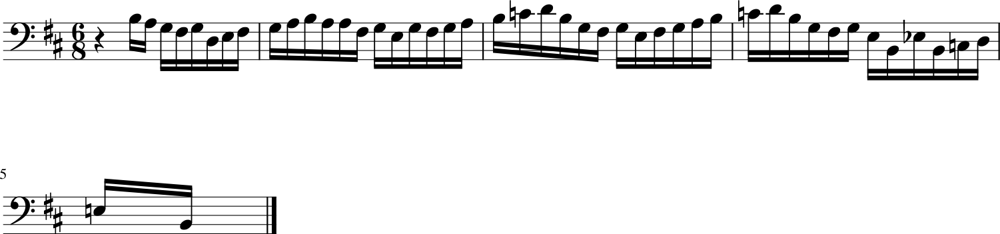

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5217 - loss: 1.4430 - note_outputs_loss: 0.9212
Epoch 152/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5275 - loss: 1.4072 - note_outputs_loss: 0.8797
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G2', 'E-2', 'D4', 'G3', 'D4', 'F#3', 'G3', 'D3', 'E-3', 'G3', 'C4', 'B3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


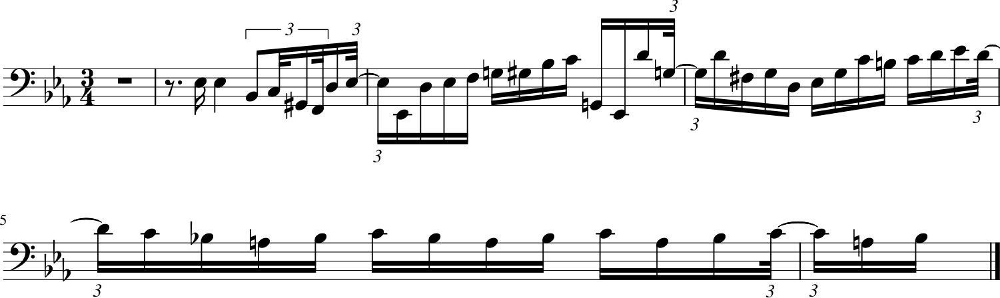

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5275 - loss: 1.4076 - note_outputs_loss: 0.8801
Epoch 153/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5635 - loss: 1.4535 - note_outputs_loss: 0.8899
Generation prompt: [['START', 'E-:major', '3/4TS', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'B-3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'E-4', 'B-2', 'B-2', 'D4', 'E-4', 'rest'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


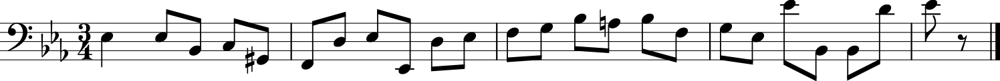

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.5633 - loss: 1.4535 - note_outputs_loss: 0.8902
Epoch 154/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5340 - loss: 1.4522 - note_outputs_loss: 0.9182
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'A2', 'B-2', 'G2', 'A2', 'B-2', 'D3', 'F3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'E3', 'F3', 'D3', 'G3', 'E3', 'D3', 'E3', 'F3', 'D3', 'G3', 'E3', 'D3', 'E3', 'F3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


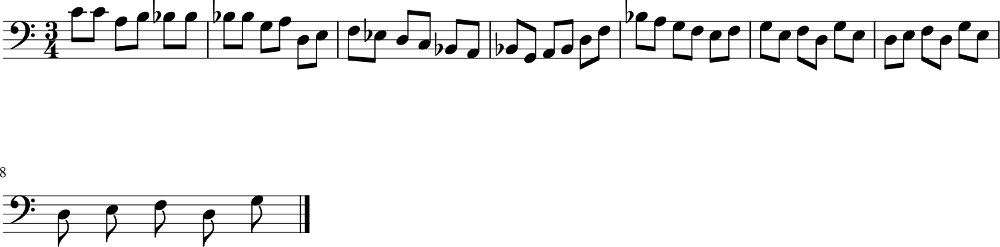

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5340 - loss: 1.4523 - note_outputs_loss: 0.9182
Epoch 155/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5262 - loss: 1.4156 - note_outputs_loss: 0.8894
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'D4', 'E4', 'F#4', 'G4', 'D4', 'D4', 'C#4', 'B3', 'A3', 'D4', 'D4', 'D4', 'C#4', 'D4', 'C#4', 'D4', 'E4', 'E4', 'E4', 'E4', 'E4', 'E4', 'E4', 'C#4', 'E4', 'B3', 'E4', 'C#4', 'E4', 'C#4', 'E4', 'C#4', 'E4', 'B3', 'E4', 'C#4', 'E4', 'C#4', 'E4', 'B3', 'E4', 'C#4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


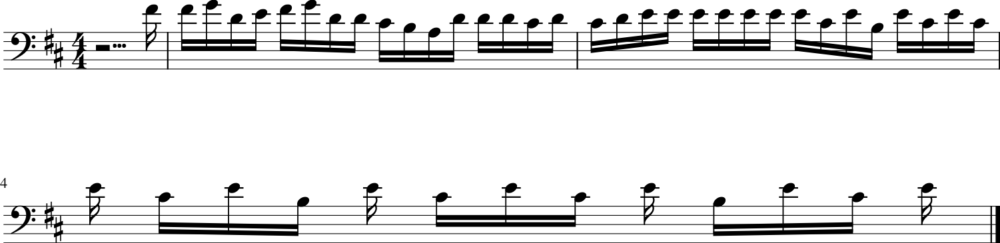

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5263 - loss: 1.4159 - note_outputs_loss: 0.8896
Epoch 156/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5563 - loss: 1.4603 - note_outputs_loss: 0.9039
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


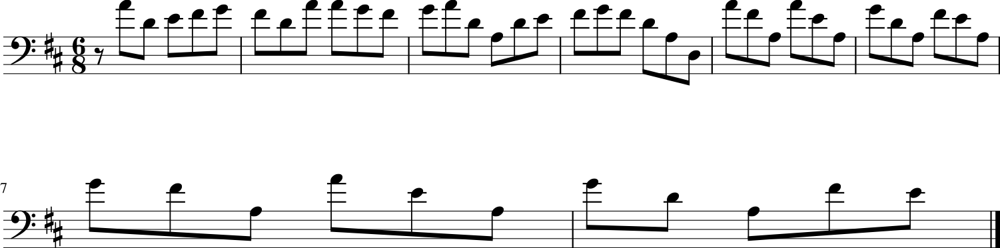

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5561 - loss: 1.4602 - note_outputs_loss: 0.9041
Epoch 157/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4718 - loss: 1.3640 - note_outputs_loss: 0.8921
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


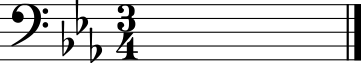

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.4724 - loss: 1.3647 - note_outputs_loss: 0.8923
Epoch 158/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5390 - loss: 1.4180 - note_outputs_loss: 0.8790
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'B-3', 'D3', 'E-3', 'C3', 'C#3', 'F3', 'G3', 'A3', 'F3', 'E-3', 'F3', 'D3', 'C#4', 'D4', 'F3', 'G3', 'G3', 'F3', 'G3', 'E-3', 'B-2', 'D4', 'E-4', 'rest'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


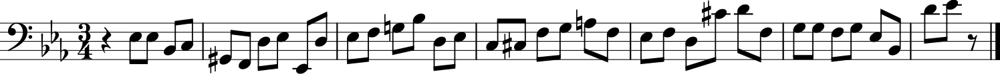

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 63ms/step - duration_outputs_loss: 0.5389 - loss: 1.4183 - note_outputs_loss: 0.8794
Epoch 159/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5716 - loss: 1.4461 - note_outputs_loss: 0.8745
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


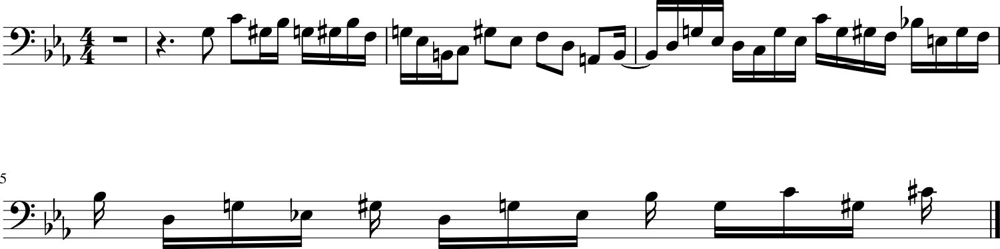

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5712 - loss: 1.4461 - note_outputs_loss: 0.8749
Epoch 160/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5633 - loss: 1.4421 - note_outputs_loss: 0.8788
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


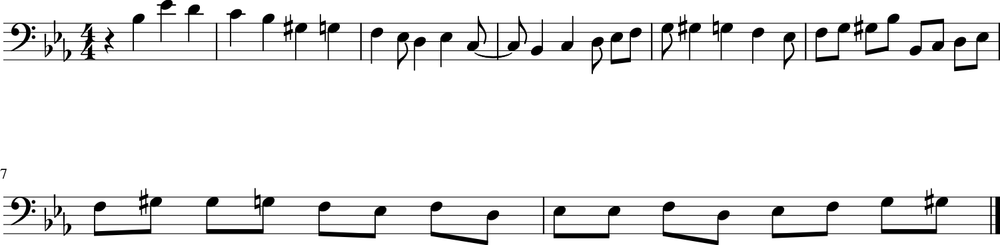

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5630 - loss: 1.4421 - note_outputs_loss: 0.8791
Epoch 161/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4916 - loss: 1.3574 - note_outputs_loss: 0.8658
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


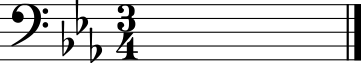

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.4920 - loss: 1.3581 - note_outputs_loss: 0.8661
Epoch 162/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5556 - loss: 1.4245 - note_outputs_loss: 0.8690
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


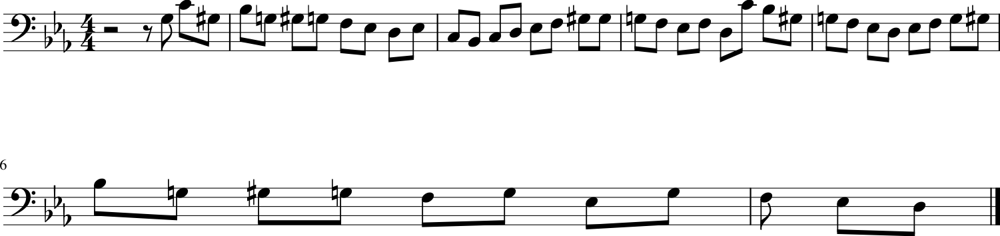

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5553 - loss: 1.4246 - note_outputs_loss: 0.8693
Epoch 163/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5076 - loss: 1.4073 - note_outputs_loss: 0.8996
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


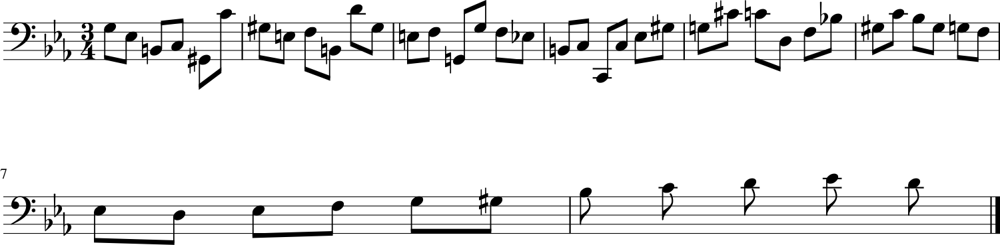

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5078 - loss: 1.4076 - note_outputs_loss: 0.8998
Epoch 164/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4962 - loss: 1.3924 - note_outputs_loss: 0.8962
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'C3', 'B2', 'C3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


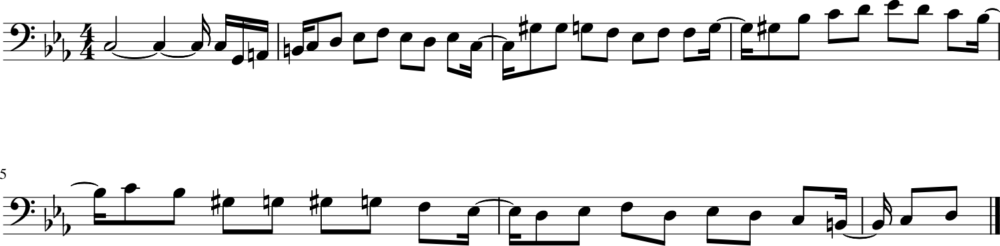

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4965 - loss: 1.3929 - note_outputs_loss: 0.8964
Epoch 165/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5341 - loss: 1.4091 - note_outputs_loss: 0.8750
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


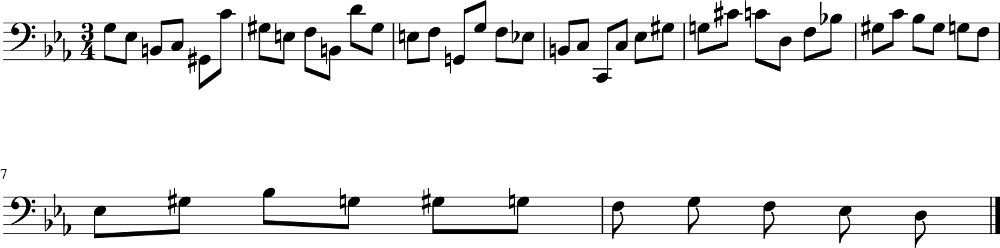

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5341 - loss: 1.4094 - note_outputs_loss: 0.8753
Epoch 166/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5073 - loss: 1.4087 - note_outputs_loss: 0.9015
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'G2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'E-3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'D4', 'E-4', 'E-4', 'E-4', 'D4', 'C4', 'B-3'], ['0.0', '0.0', '0.0', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


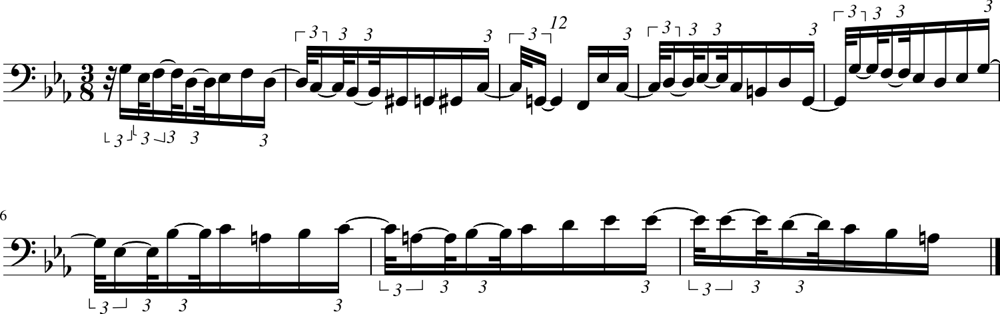

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5075 - loss: 1.4090 - note_outputs_loss: 0.9015
Epoch 167/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5356 - loss: 1.4154 - note_outputs_loss: 0.8797
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'D4', 'F#4', 'C4', 'F#4', 'C4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'G4', 'B3', 'F#3', 'E3', 'C#4', 'E4', 'B-3', 'G4', 'F#4', 'E4', 'B4', 'A4', 'G4', 'E4', 'B-3', 'C#4', 'A3', 'C#4', 'A3', 'C#4', 'E4', 'C#4', 'D4', 'E4', 'C#4', 'A4', 'A4', 'A4', 'B4'], ['0.0', '0.0', '0.0', '2.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.75', '0.25', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


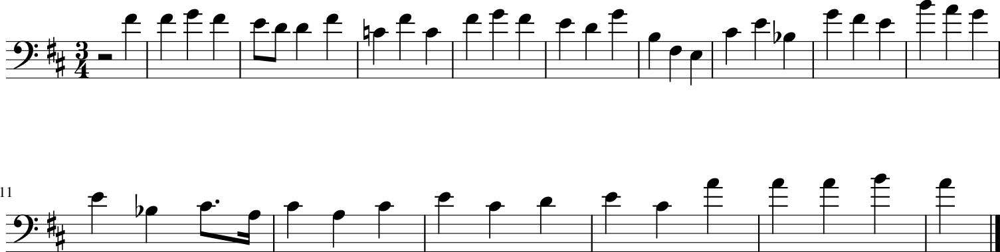

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5356 - loss: 1.4155 - note_outputs_loss: 0.8800
Epoch 168/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5504 - loss: 1.4141 - note_outputs_loss: 0.8637
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'D5', 'D5', 'C#5', 'D5', 'C#5'], ['0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


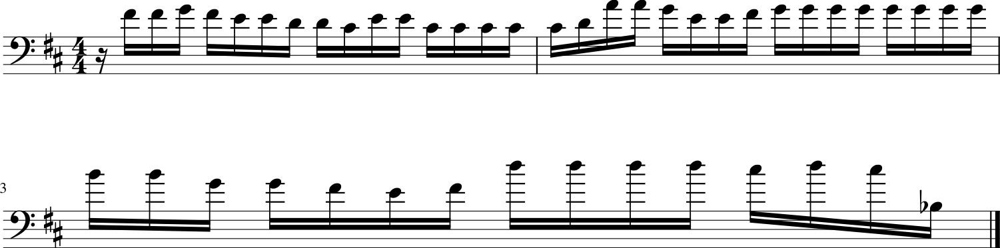

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5503 - loss: 1.4142 - note_outputs_loss: 0.8640
Epoch 169/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4757 - loss: 1.3278 - note_outputs_loss: 0.8520
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'C4', 'D4', 'B-3', 'F2', 'C#4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G#3', 'G3', 'F3', 'B-2', 'G#3', 'G3', 'F3', 'E-2', 'G3', 'F3', 'E-3', 'A2', 'F#3', 'F3', 'E-3', 'D3', 'F3', 'C4', 'B-3', 'G#3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


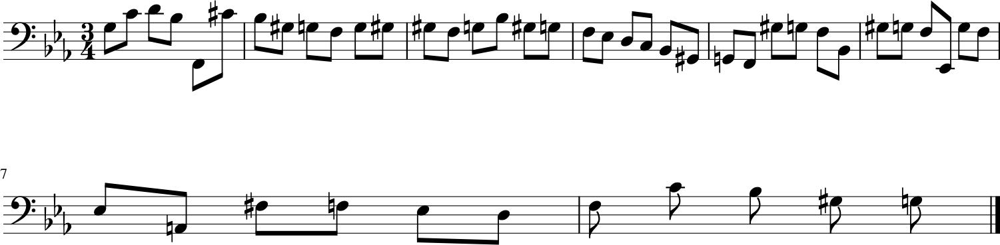

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4763 - loss: 1.3288 - note_outputs_loss: 0.8525
Epoch 170/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5042 - loss: 1.3704 - note_outputs_loss: 0.8662
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'D3', 'E3', 'F3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


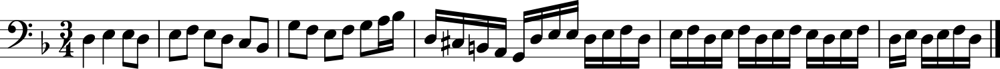

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5045 - loss: 1.3708 - note_outputs_loss: 0.8663
Epoch 171/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5663 - loss: 1.4288 - note_outputs_loss: 0.8625
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'G#3', 'B-3', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'B-3', 'E-4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


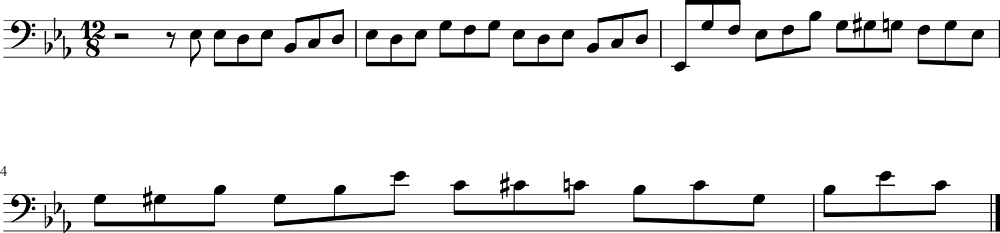

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5659 - loss: 1.4287 - note_outputs_loss: 0.8628
Epoch 172/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5482 - loss: 1.4169 - note_outputs_loss: 0.8687
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


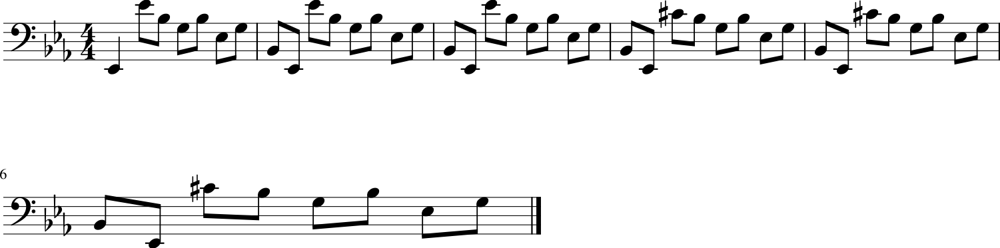

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5480 - loss: 1.4169 - note_outputs_loss: 0.8689
Epoch 173/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5277 - loss: 1.3922 - note_outputs_loss: 0.8645
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'E-4', 'G3', 'F#3', 'G3', 'A3', 'G3', 'B3', 'A3', 'G3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'A2', 'C#3', 'D2', 'rest', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


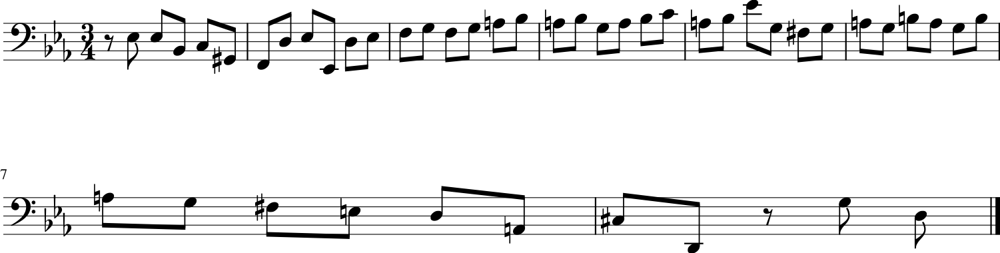

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5277 - loss: 1.3925 - note_outputs_loss: 0.8647
Epoch 174/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5117 - loss: 1.3820 - note_outputs_loss: 0.8703
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'G4', 'E4', 'C#4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3'], ['0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


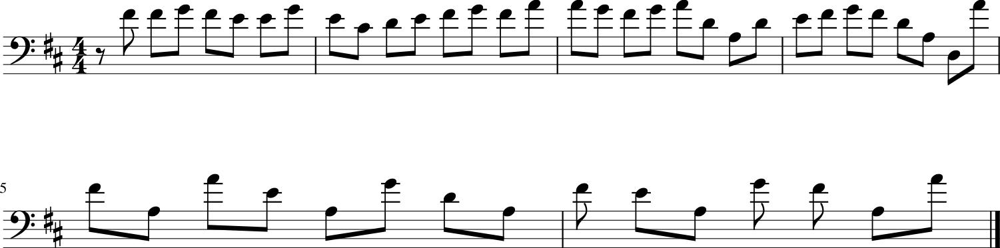

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5119 - loss: 1.3824 - note_outputs_loss: 0.8705
Epoch 175/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5216 - loss: 1.4034 - note_outputs_loss: 0.8818
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


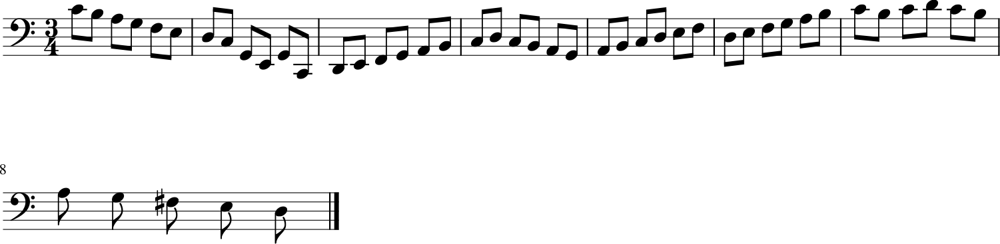

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5217 - loss: 1.4036 - note_outputs_loss: 0.8819
Epoch 176/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5653 - loss: 1.4549 - note_outputs_loss: 0.8896
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'A3', 'A3', 'B3', 'C4', 'D4', 'A3', 'F#3', 'G3', 'A3', 'F#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


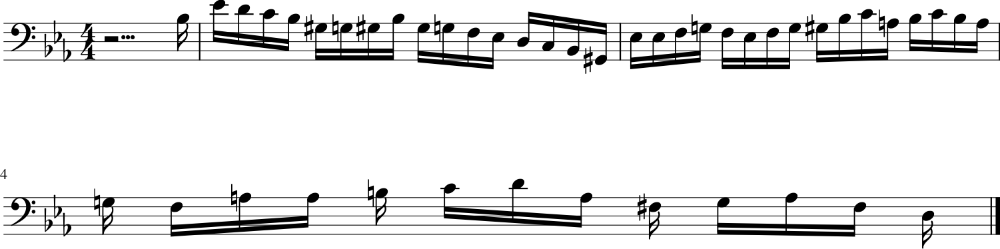

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5650 - loss: 1.4546 - note_outputs_loss: 0.8896
Epoch 177/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5312 - loss: 1.3759 - note_outputs_loss: 0.8447
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


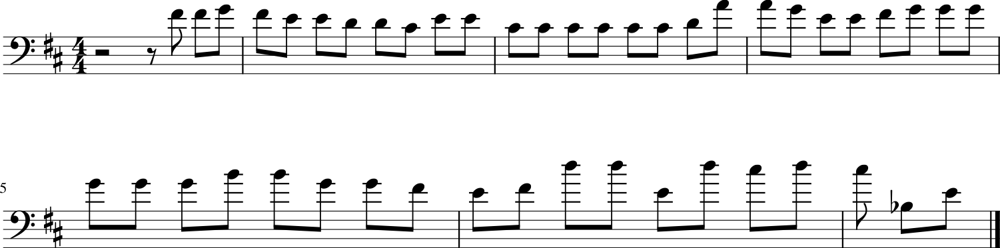

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5312 - loss: 1.3762 - note_outputs_loss: 0.8450
Epoch 178/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5296 - loss: 1.3354 - note_outputs_loss: 0.8059
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'G3', 'E3', 'F3', 'D3', 'E3', 'C3', 'C2', 'C3', 'D3', 'E3', 'F#3', 'G3', 'E3', 'C#3', 'G3', 'A3', 'G3', 'C#3', 'G3', 'C#3', 'G3', 'A3', 'G3', 'C#3'], ['0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


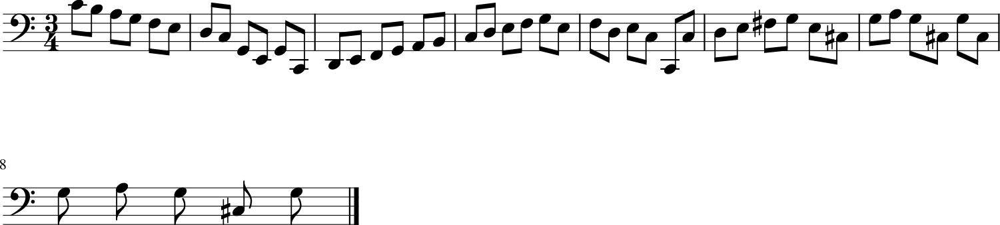

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5295 - loss: 1.3361 - note_outputs_loss: 0.8066
Epoch 179/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5315 - loss: 1.4035 - note_outputs_loss: 0.8719
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'G2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'E-3', 'B-2', 'G#2', 'C3', 'F3', 'G#3', 'C4', 'E-3', 'D3', 'C3', 'C3', 'B-2', 'A2', 'C3', 'F3', 'G#3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


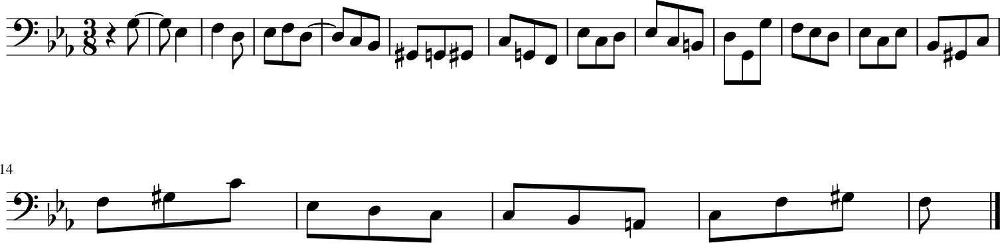

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5315 - loss: 1.4036 - note_outputs_loss: 0.8721
Epoch 180/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5267 - loss: 1.3770 - note_outputs_loss: 0.8503
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


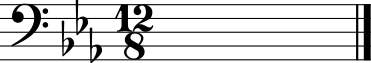

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5267 - loss: 1.3774 - note_outputs_loss: 0.8507
Epoch 181/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4976 - loss: 1.3203 - note_outputs_loss: 0.8227
Generation prompt: [['START', 'G:major', '4/4TS', 'G3', 'G3', 'G3', 'G3', 'B-3', 'G3', 'D3', 'G3', 'B-2', 'D3', 'G3', 'G#3', 'F3', 'D3', 'G3', 'B2', 'G3', 'D4', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'F3', 'D3', 'E3', 'C3', 'C2', 'C3', 'D3', 'E3', 'F#3', 'G3', 'E3', 'C#3', 'G3', 'A3', 'G3', 'A3', 'G3', 'A3', 'G3', 'A3', 'G3', 'F#3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


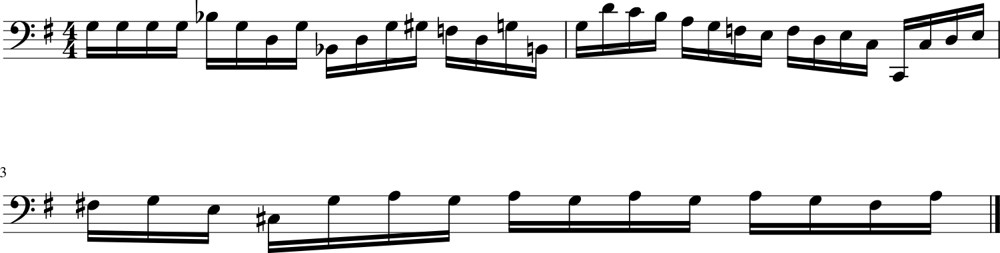

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4979 - loss: 1.3211 - note_outputs_loss: 0.8232
Epoch 182/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5576 - loss: 1.4141 - note_outputs_loss: 0.8565
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '0.0', '3.75', '1/12', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]

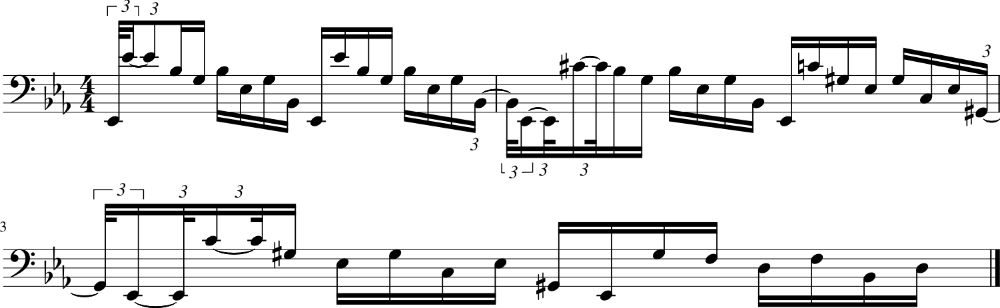

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5573 - loss: 1.4141 - note_outputs_loss: 0.8567
Epoch 183/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5378 - loss: 1.3749 - note_outputs_loss: 0.8371
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


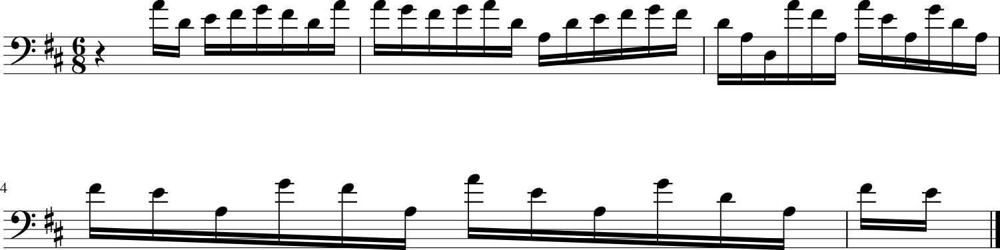

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5377 - loss: 1.3752 - note_outputs_loss: 0.8375
Epoch 184/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5647 - loss: 1.4082 - note_outputs_loss: 0.8434
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'F2', 'G2', 'D3', 'D3', 'D3', 'D3', 'D3', 'B-2', 'A2', 'B-2', 'F3', 'D3', 'B-2', 'E2', 'G2', 'C3', 'E3', 'G3', 'F#3'], ['0.0', '0.0', '0.0', '3.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25']]


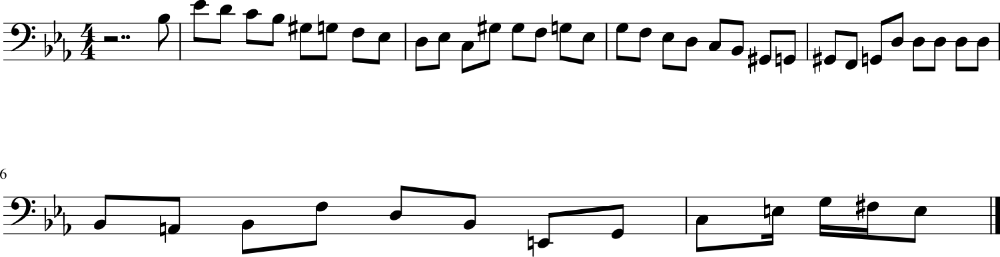

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5644 - loss: 1.4082 - note_outputs_loss: 0.8438
Epoch 185/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5466 - loss: 1.4127 - note_outputs_loss: 0.8661
Generation prompt: [['START', 'G:major'], ['0.0', '0.0']]


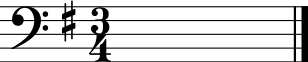

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5465 - loss: 1.4127 - note_outputs_loss: 0.8662
Epoch 186/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4889 - loss: 1.3333 - note_outputs_loss: 0.8444
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'G2', 'A2', 'B2', 'C3', 'D3', 'G4', 'F4', 'E-4', 'D4', 'E-4', 'E-4', 'D4', 'C4', 'B3', 'C4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'E-3', 'D3', 'E-3', 'F3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


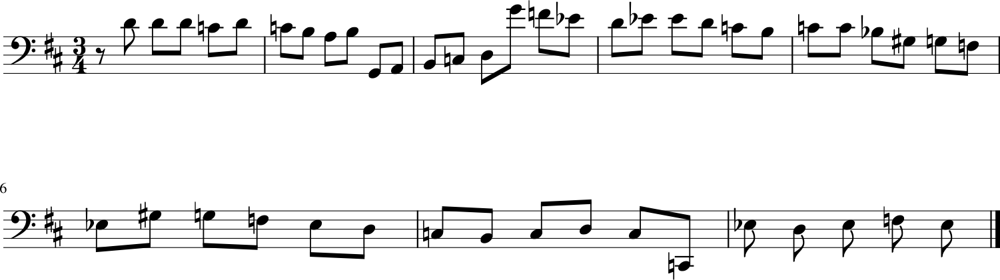

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4893 - loss: 1.3339 - note_outputs_loss: 0.8446
Epoch 187/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5328 - loss: 1.3714 - note_outputs_loss: 0.8386
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'F2', 'G2', 'C3', 'B2', 'D3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'E-3', 'B-2', 'G#2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


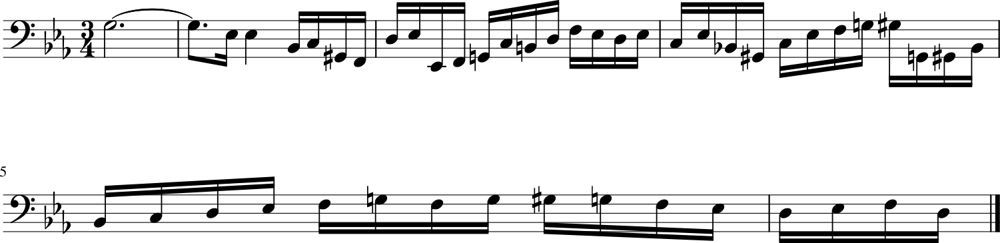

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5328 - loss: 1.3716 - note_outputs_loss: 0.8388
Epoch 188/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5027 - loss: 1.3493 - note_outputs_loss: 0.8466
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'G#2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'C#3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'G3', 'A3', 'F3', 'E3', 'F3', 'A3', 'F3', 'B-3', 'F3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


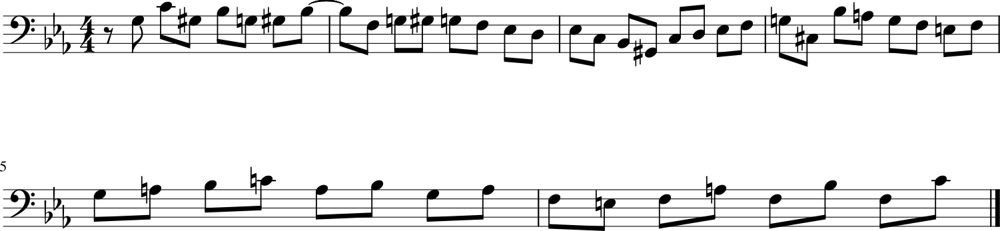

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5030 - loss: 1.3498 - note_outputs_loss: 0.8468
Epoch 189/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5363 - loss: 1.3808 - note_outputs_loss: 0.8444
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


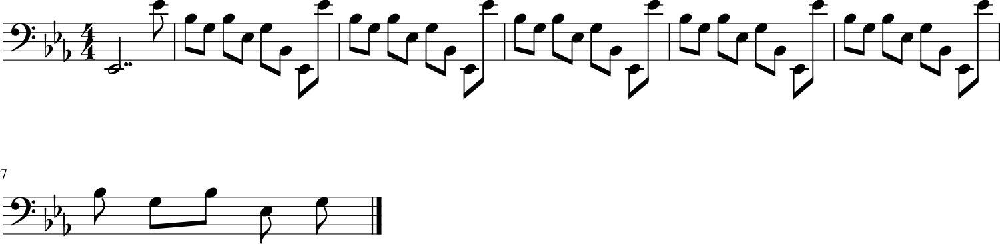

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5363 - loss: 1.3810 - note_outputs_loss: 0.8447
Epoch 190/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5587 - loss: 1.4168 - note_outputs_loss: 0.8581
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


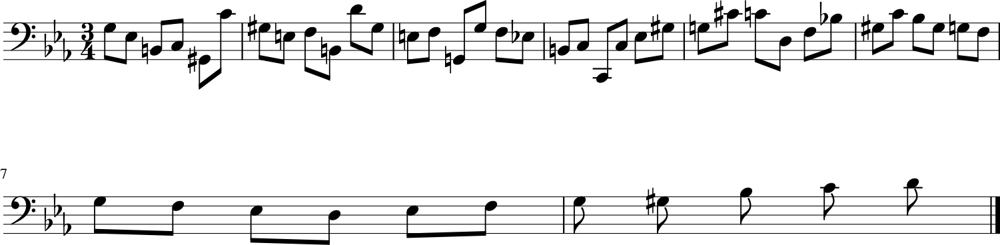

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5584 - loss: 1.4168 - note_outputs_loss: 0.8584
Epoch 191/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5051 - loss: 1.3641 - note_outputs_loss: 0.8590
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'E-3', 'D3', 'C3', 'D3', 'B-2', 'D3', 'G#2', 'E-2', 'G3', 'G#3', 'F3', 'E3', 'F3', 'D3', 'E-3', 'F3', 'B3', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


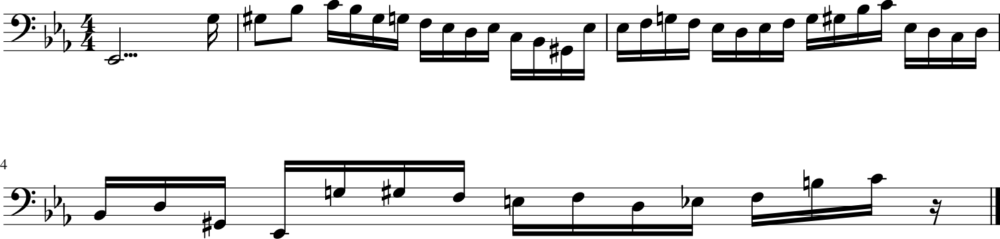

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5053 - loss: 1.3645 - note_outputs_loss: 0.8591
Epoch 192/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5646 - loss: 1.4119 - note_outputs_loss: 0.8473
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'C4', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'E-4', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


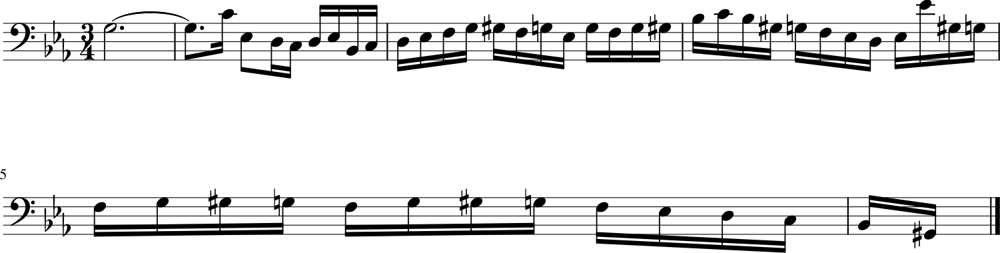

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5643 - loss: 1.4118 - note_outputs_loss: 0.8476
Epoch 193/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5685 - loss: 1.3942 - note_outputs_loss: 0.8257
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


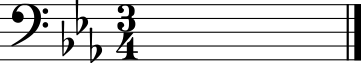

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5682 - loss: 1.3942 - note_outputs_loss: 0.8261
Epoch 194/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5785 - loss: 1.4075 - note_outputs_loss: 0.8290
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2'], ['0.0', '0.0', '0.0', '3.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


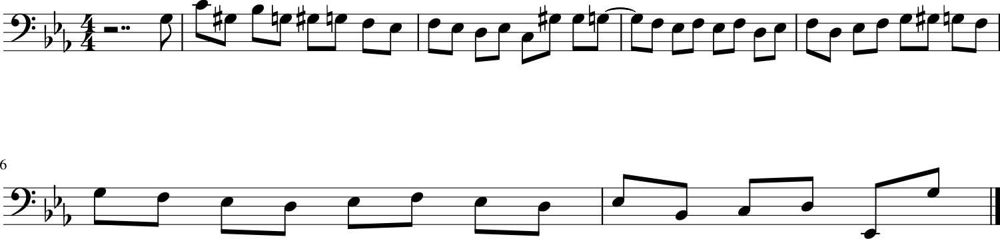

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5780 - loss: 1.4073 - note_outputs_loss: 0.8293
Epoch 195/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5139 - loss: 1.3087 - note_outputs_loss: 0.7948
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '2.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


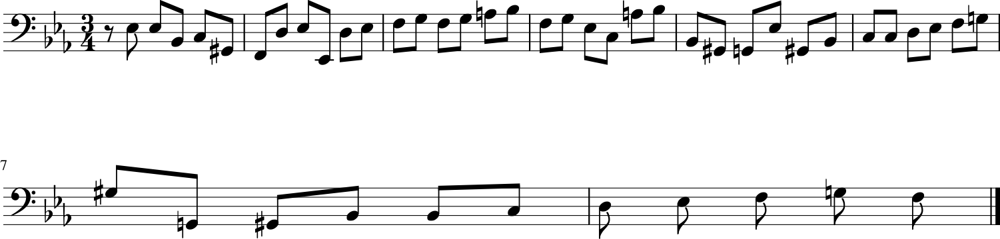

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5141 - loss: 1.3095 - note_outputs_loss: 0.7954
Epoch 196/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5346 - loss: 1.3767 - note_outputs_loss: 0.8421
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'G3', 'F3', 'E3', 'D3', 'C3', 'B2', 'A2', 'C3', 'G2', 'F2', 'E2', 'G2', 'C3', 'E2', 'D2', 'B2', 'C3', 'E3', 'G3', 'C4', 'rest'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


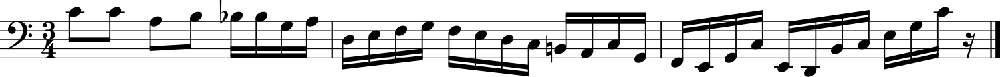

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.5345 - loss: 1.3769 - note_outputs_loss: 0.8424
Epoch 197/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5773 - loss: 1.3539 - note_outputs_loss: 0.7765
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


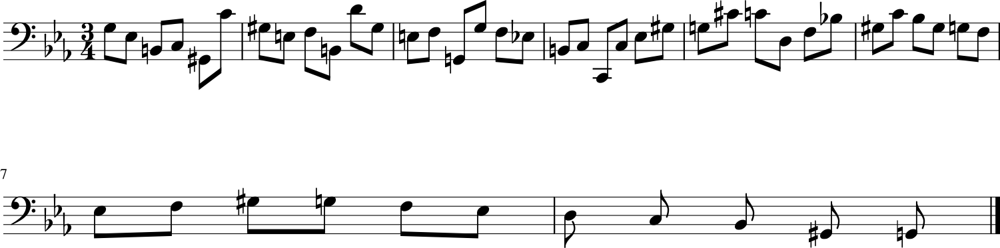

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5769 - loss: 1.3542 - note_outputs_loss: 0.7773
Epoch 198/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5682 - loss: 1.4337 - note_outputs_loss: 0.8654
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'G#3', 'B-3', 'G3', 'B-3', 'F3', 'G3', 'B-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'G#2', 'C3', 'F3', 'G#3', 'C4', 'E-3', 'D3', 'C3', 'D3', 'B-2', 'D3', 'G#2', 'G2', 'B-2', 'E-3', 'G3', 'B-3', 'C#3', 'C3', 'B-2', 'C3', 'G#2', 'C3', 'G2', 'F2', 'G#2', 'D3', 'F3', 'G#3', 'C3', 'B2'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


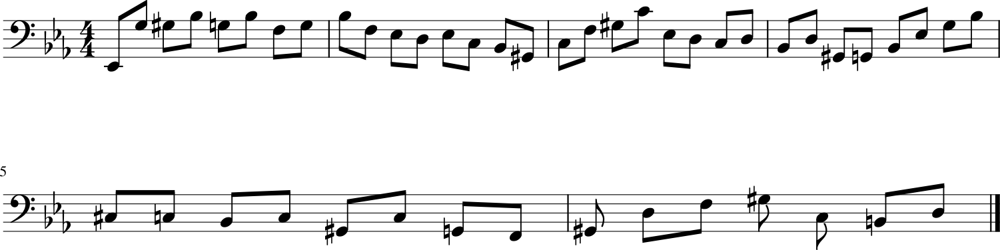

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5678 - loss: 1.4333 - note_outputs_loss: 0.8654
Epoch 199/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5260 - loss: 1.3623 - note_outputs_loss: 0.8363
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'B-3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


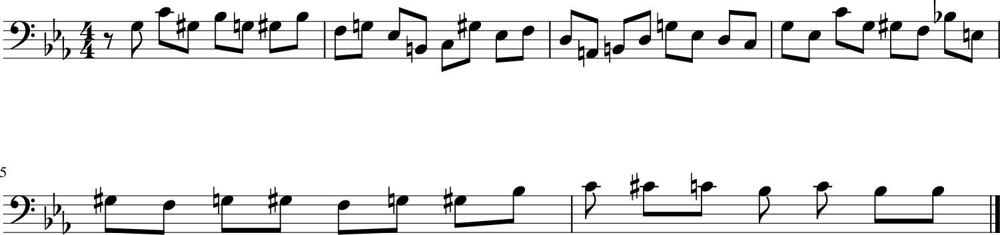

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5260 - loss: 1.3625 - note_outputs_loss: 0.8364
Epoch 200/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5118 - loss: 1.3255 - note_outputs_loss: 0.8138
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'C3', 'D3', 'G#2', 'B-3', 'G#3', 'B-3', 'G3', 'B-3', 'C#3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'F3', 'G3', 'F3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F2', 'E2', 'G2', 'C3', 'E2', 'D2', 'B2', 'C3', 'E3', 'G3', 'C4', 'D4', 'C4', 'B3', 'C4', 'A3', 'F3', 'E3', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


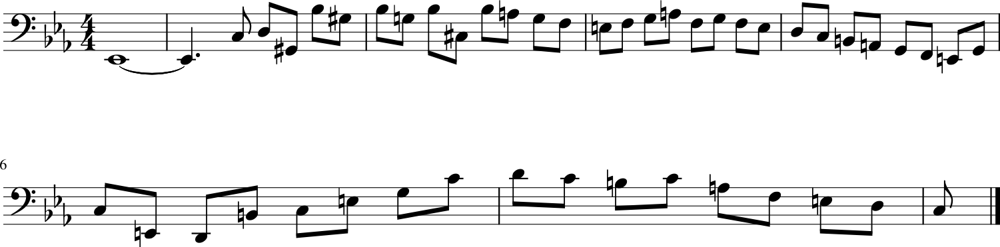

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5119 - loss: 1.3261 - note_outputs_loss: 0.8142
Epoch 201/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5532 - loss: 1.3889 - note_outputs_loss: 0.8357
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


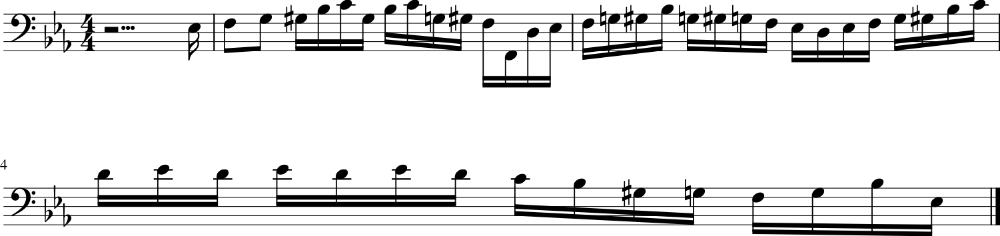

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5530 - loss: 1.3890 - note_outputs_loss: 0.8360
Epoch 202/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5687 - loss: 1.4316 - note_outputs_loss: 0.8629
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'C4', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1.0', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


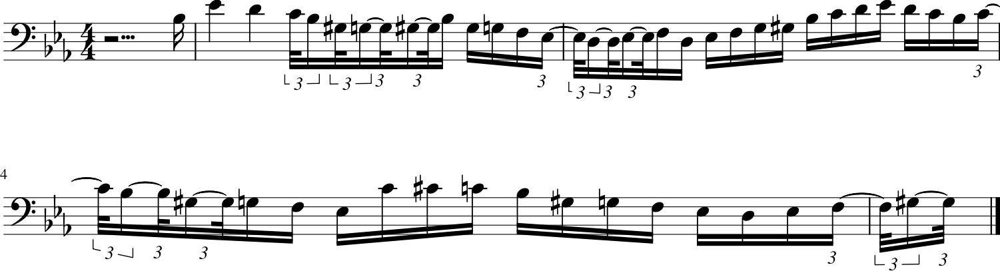

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5684 - loss: 1.4313 - note_outputs_loss: 0.8629
Epoch 203/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5448 - loss: 1.3419 - note_outputs_loss: 0.7971
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'D3', 'D3', 'C3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


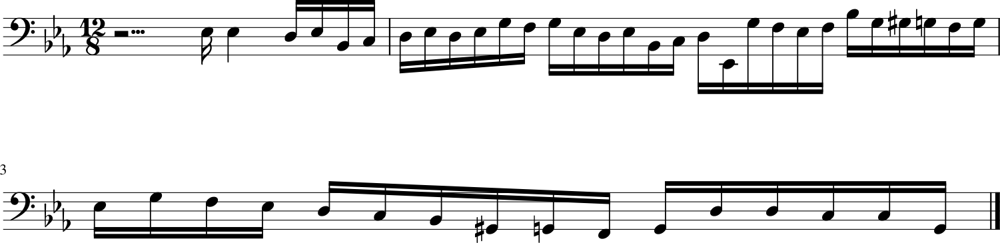

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5446 - loss: 1.3422 - note_outputs_loss: 0.7976
Epoch 204/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5443 - loss: 1.3849 - note_outputs_loss: 0.8406
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E3', 'F3', 'G3', 'B-3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'C4', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


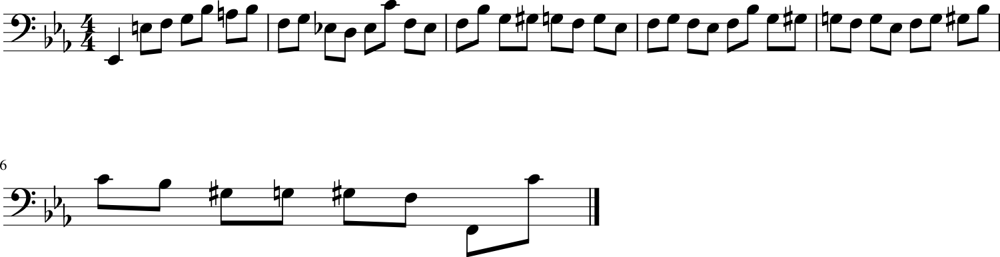

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5441 - loss: 1.3849 - note_outputs_loss: 0.8407
Epoch 205/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5259 - loss: 1.4015 - note_outputs_loss: 0.8756
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'G#3', 'B-3', 'G3', 'B-3', 'F3', 'G3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4'], ['0.0', '0.0', '0.0', '3.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


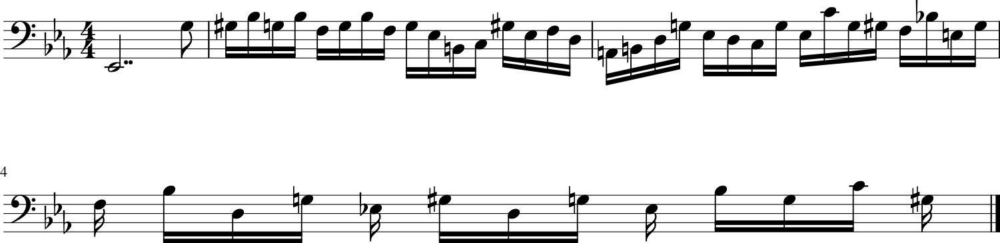

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5260 - loss: 1.4014 - note_outputs_loss: 0.8754
Epoch 206/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5853 - loss: 1.4379 - note_outputs_loss: 0.8526
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


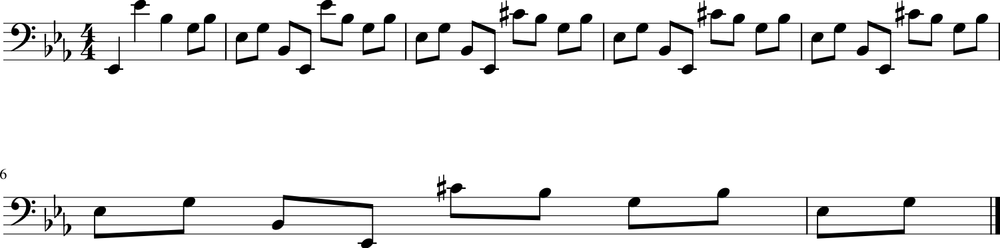

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5848 - loss: 1.4374 - note_outputs_loss: 0.8526
Epoch 207/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5087 - loss: 1.3182 - note_outputs_loss: 0.8096
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'A3', 'B2', 'C#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'B3', 'C#4', 'D4', 'B3', 'F#4', 'D4', 'C#4', 'B3', 'C#4', 'D4', 'E4', 'D4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'A4', 'B3', 'C#4', 'A4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


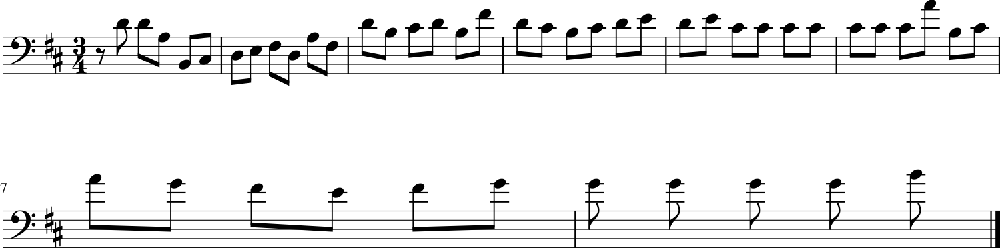

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5088 - loss: 1.3187 - note_outputs_loss: 0.8099
Epoch 208/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5089 - loss: 1.3208 - note_outputs_loss: 0.8119
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


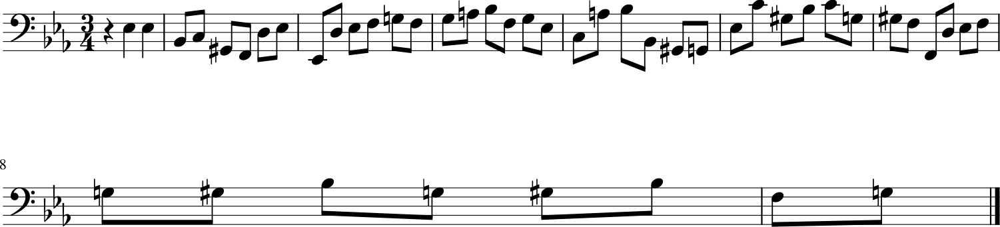

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5091 - loss: 1.3213 - note_outputs_loss: 0.8122
Epoch 209/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5111 - loss: 1.3477 - note_outputs_loss: 0.8366
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


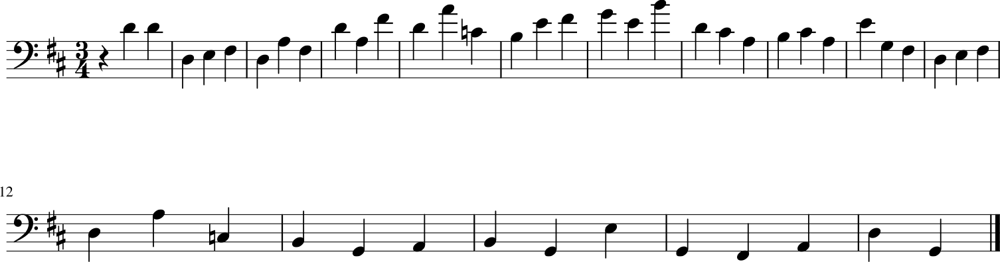

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5113 - loss: 1.3481 - note_outputs_loss: 0.8368
Epoch 210/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5667 - loss: 1.3941 - note_outputs_loss: 0.8274
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


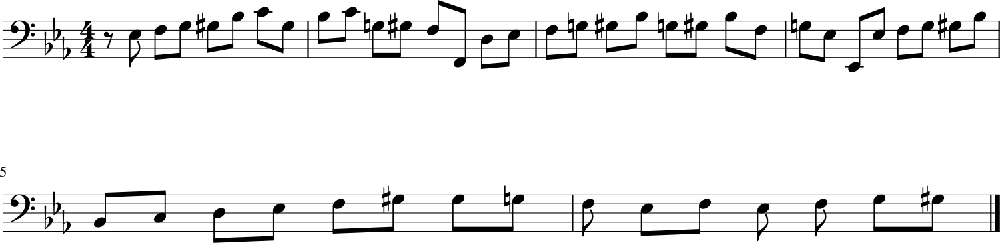

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5663 - loss: 1.3940 - note_outputs_loss: 0.8276
Epoch 211/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4831 - loss: 1.3102 - note_outputs_loss: 0.8272
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'D4', 'D4', 'C#4', 'B3', 'B3', 'C#4', 'D4', 'E4', 'F#4', 'G4', 'E4', 'F#4', 'F#4', 'F#4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'D4', 'D4', 'D4', 'C#4', 'B3', 'E4', 'C#4', 'A4', 'A4', 'A4', 'B4', 'A4', 'G4', 'F#4'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


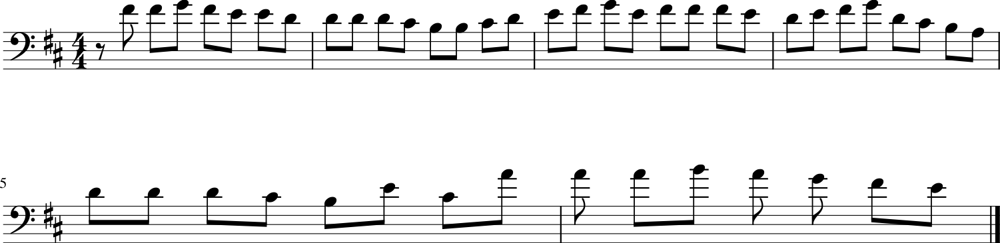

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.4835 - loss: 1.3109 - note_outputs_loss: 0.8274
Epoch 212/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5267 - loss: 1.3664 - note_outputs_loss: 0.8397
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'A3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'F2', 'G#3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


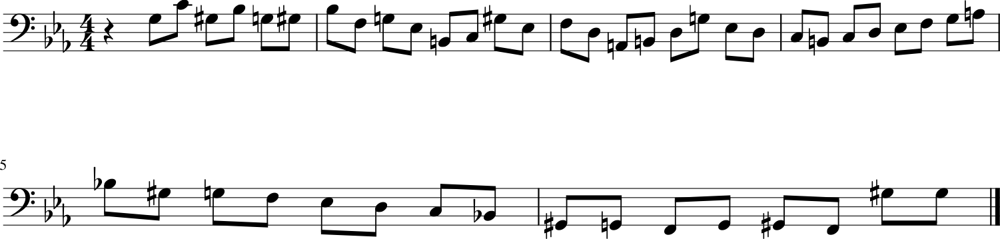

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5268 - loss: 1.3665 - note_outputs_loss: 0.8398
Epoch 213/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5544 - loss: 1.3704 - note_outputs_loss: 0.8160
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'E-3', 'D3', 'C3', 'D3', 'F3', 'B-2', 'G3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


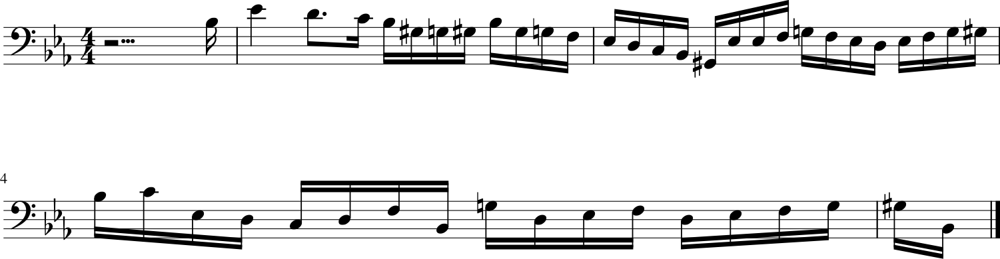

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5542 - loss: 1.3704 - note_outputs_loss: 0.8162
Epoch 214/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5502 - loss: 1.3454 - note_outputs_loss: 0.7952
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B3', 'F3', 'D4', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'G3', 'C4'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


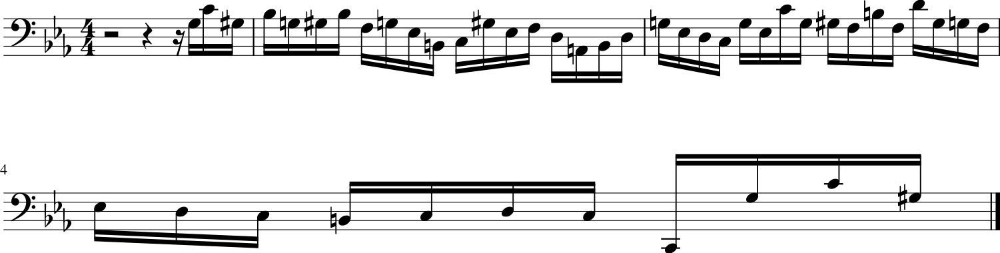

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5500 - loss: 1.3457 - note_outputs_loss: 0.7957
Epoch 215/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5370 - loss: 1.3402 - note_outputs_loss: 0.8032
Generation prompt: [['START', 'G:major', '3/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'G2', 'B2', 'C3', 'E3', 'G3', 'E4', 'G3', 'C3', 'E3', 'C3', 'C4', 'B3', 'A3', 'B3', 'C4', 'G3', 'F#3', 'B3', 'G3', 'E3', 'B2', 'B2', 'C3', 'F#3', 'G3', 'B2', 'A2', 'F#2', 'E2', 'E2', 'B2', 'G3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


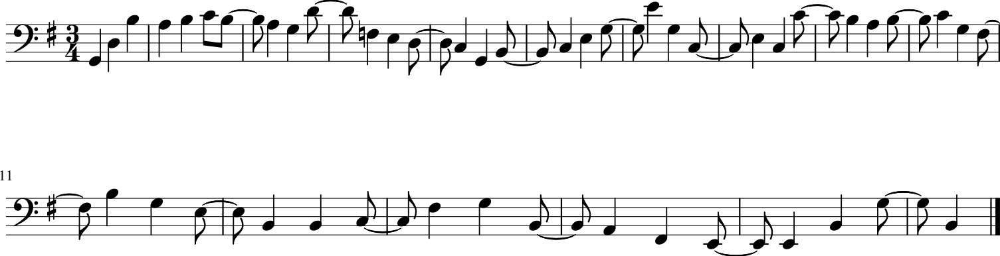

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5369 - loss: 1.3405 - note_outputs_loss: 0.8036
Epoch 216/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5680 - loss: 1.3984 - note_outputs_loss: 0.8305
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

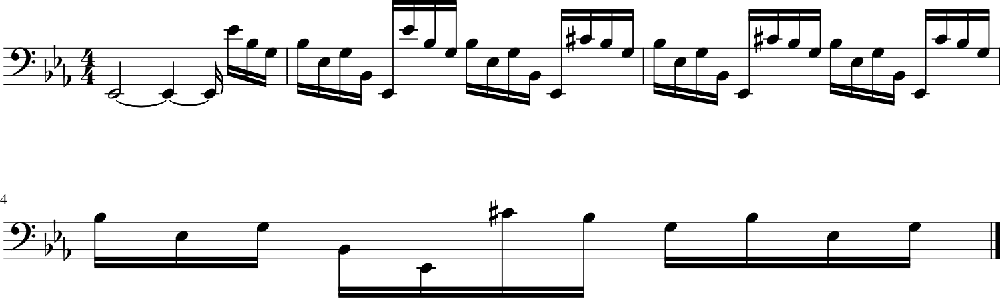

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5676 - loss: 1.3982 - note_outputs_loss: 0.8306
Epoch 217/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4847 - loss: 1.3024 - note_outputs_loss: 0.8177
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'E3', 'F3', 'E3', 'F3', 'E3', 'F3', 'C3', 'B-2', 'A2', 'B-2', 'A3', 'G3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'E3', 'F3', 'A3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


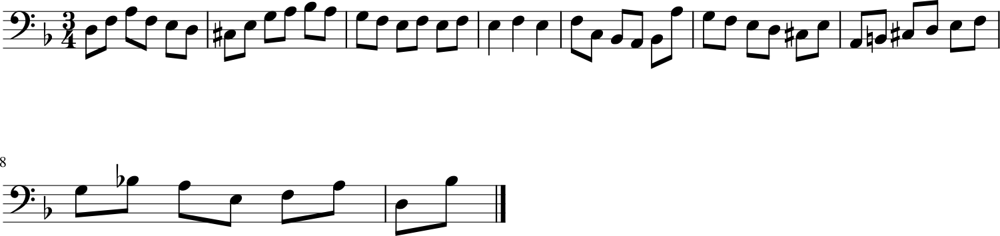

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4850 - loss: 1.3030 - note_outputs_loss: 0.8179
Epoch 218/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5145 - loss: 1.3412 - note_outputs_loss: 0.8267
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


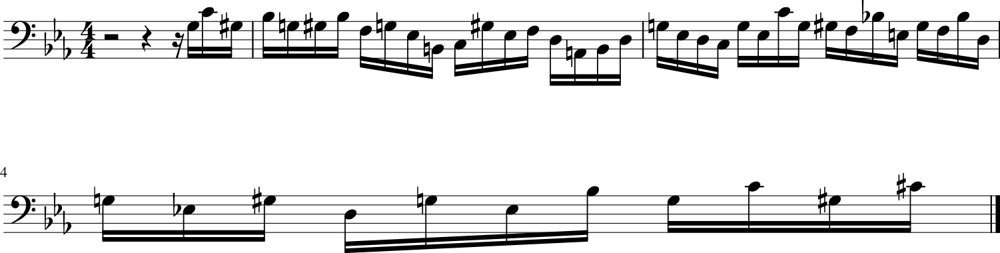

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5146 - loss: 1.3415 - note_outputs_loss: 0.8269
Epoch 219/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5080 - loss: 1.3046 - note_outputs_loss: 0.7966
Generation prompt: [['START', 'E-:major', '3/4TS', 'E-4', 'B-3', 'G3', 'C4', 'D4', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F2', 'D3', 'D3', 'C3', 'C3', 'G2', 'F2', 'E-2', 'F2', 'G2', 'C4', 'rest'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


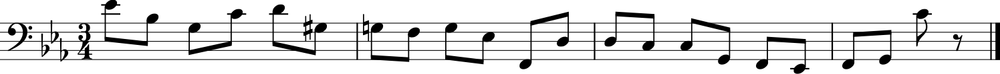

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.5081 - loss: 1.3052 - note_outputs_loss: 0.7970
Epoch 220/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5531 - loss: 1.4000 - note_outputs_loss: 0.8469
Generation prompt: [['START', 'G:major', '3/4TS', 'G3', 'G3', 'G3', 'G3', 'G#3', 'F3', 'B3', 'A3', 'G3', 'F#3', 'A3', 'B3', 'C4', 'E-4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D4', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'F3', 'D3', 'C2', 'F3', 'E3', 'D3', 'E3', 'C3', 'B2', 'C3', 'D3', 'E3', 'F#3', 'G3', 'A2', 'D3', 'E3', 'F#3', 'G3', 'A3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


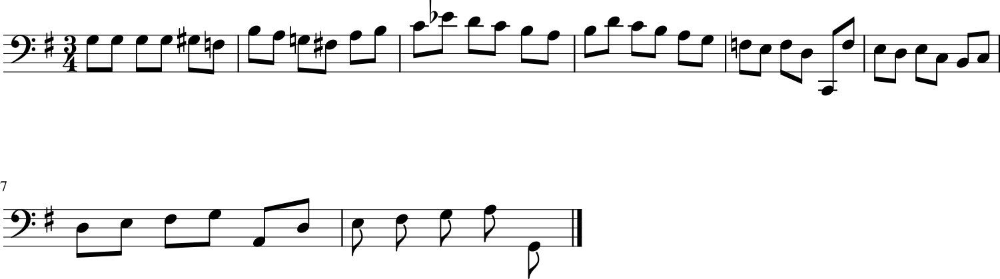

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5529 - loss: 1.3997 - note_outputs_loss: 0.8468
Epoch 221/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5150 - loss: 1.3122 - note_outputs_loss: 0.7972
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2', 'D3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


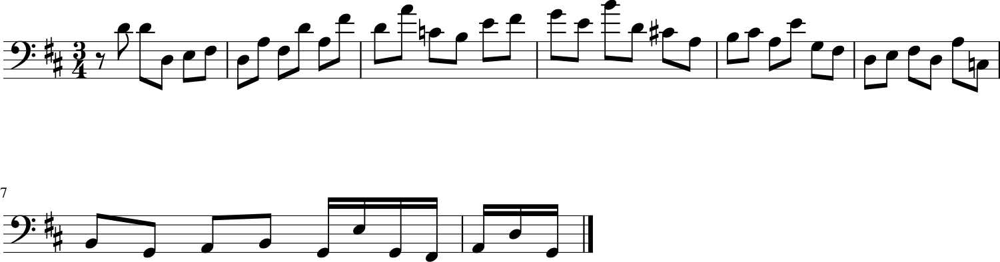

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5151 - loss: 1.3127 - note_outputs_loss: 0.7976
Epoch 222/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5305 - loss: 1.3339 - note_outputs_loss: 0.8034
Generation prompt: [['START', 'G:major', '3/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E-4', 'D4', 'C#4', 'D4', 'F#3', 'E-3', 'E3', 'F3', 'A3', 'C4', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


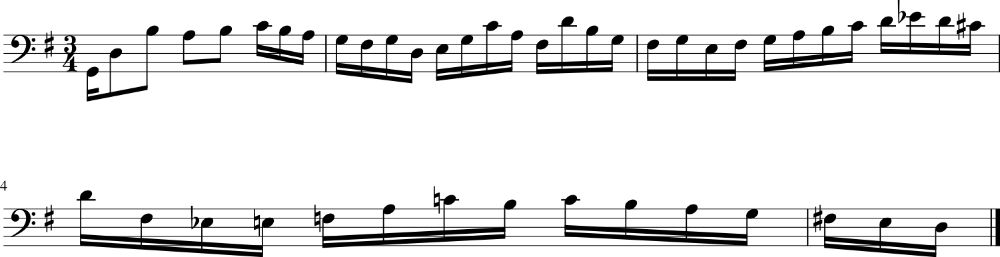

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5305 - loss: 1.3343 - note_outputs_loss: 0.8038
Epoch 223/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4936 - loss: 1.2910 - note_outputs_loss: 0.7974
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'D3', 'G3', 'D3', 'B2', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'A3', 'B3', 'C4', 'A3', 'D4', 'B3', 'A3', 'B3', 'A3', 'A3', 'B3', 'A3', 'A3', 'B3', 'G#3', 'E3', 'B3', 'E3', 'C4', 'E3', 'D4', 'B3', 'G3', 'F#3', 'A3', 'G3', 'F#3', 'E3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


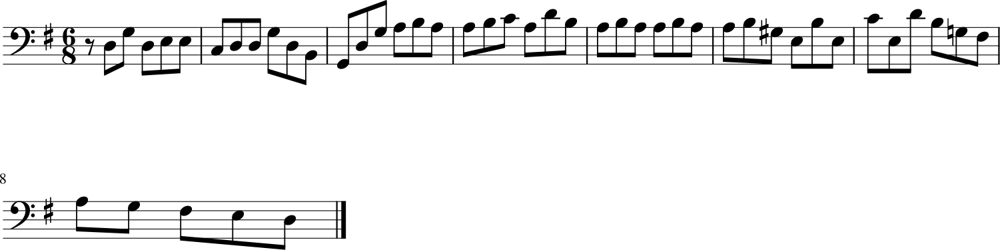

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4939 - loss: 1.2918 - note_outputs_loss: 0.7978
Epoch 224/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5119 - loss: 1.3619 - note_outputs_loss: 0.8501
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'D3', 'G2', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C4', 'rest'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


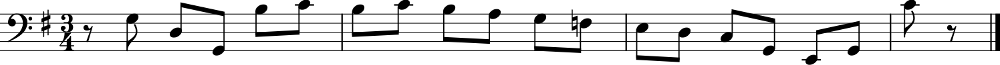

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.5120 - loss: 1.3620 - note_outputs_loss: 0.8500
Epoch 225/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5763 - loss: 1.3647 - note_outputs_loss: 0.7884
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


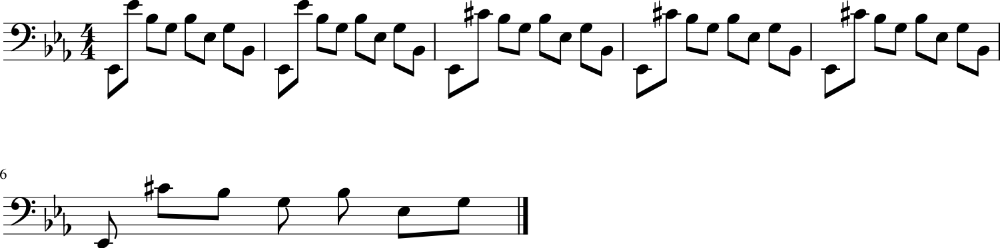

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5759 - loss: 1.3647 - note_outputs_loss: 0.7889
Epoch 226/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5458 - loss: 1.3321 - note_outputs_loss: 0.7864
Generation prompt: [['START', 'E-:major', '12/8TS', '3/4TS', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F3'], ['0.0', '0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


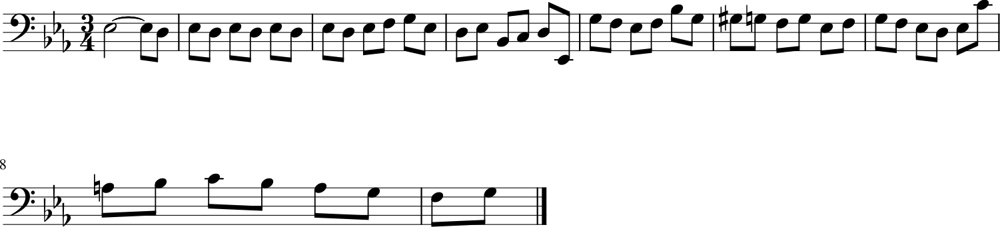

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5456 - loss: 1.3324 - note_outputs_loss: 0.7868
Epoch 227/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5233 - loss: 1.3066 - note_outputs_loss: 0.7833
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


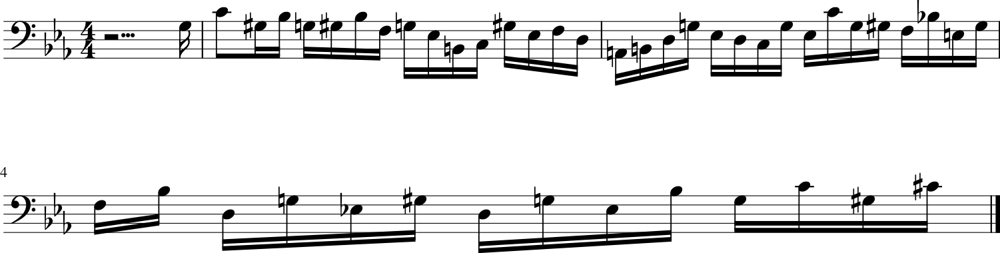

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5234 - loss: 1.3072 - note_outputs_loss: 0.7838
Epoch 228/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5016 - loss: 1.3020 - note_outputs_loss: 0.8004
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

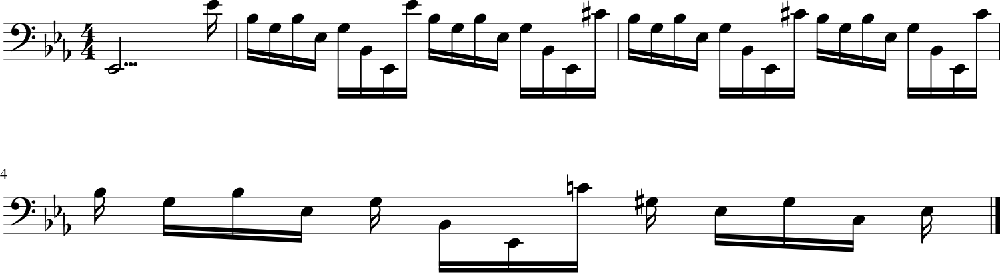

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5018 - loss: 1.3026 - note_outputs_loss: 0.8008
Epoch 229/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5293 - loss: 1.2975 - note_outputs_loss: 0.7681
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'F2', 'G3', 'B-3', 'G#3', 'B-3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


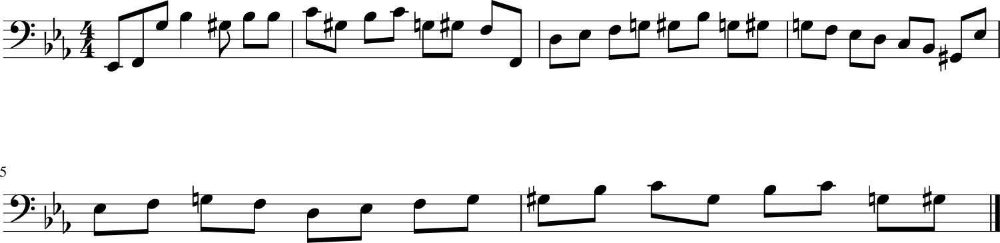

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5293 - loss: 1.2980 - note_outputs_loss: 0.7687
Epoch 230/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5662 - loss: 1.3481 - note_outputs_loss: 0.7819
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

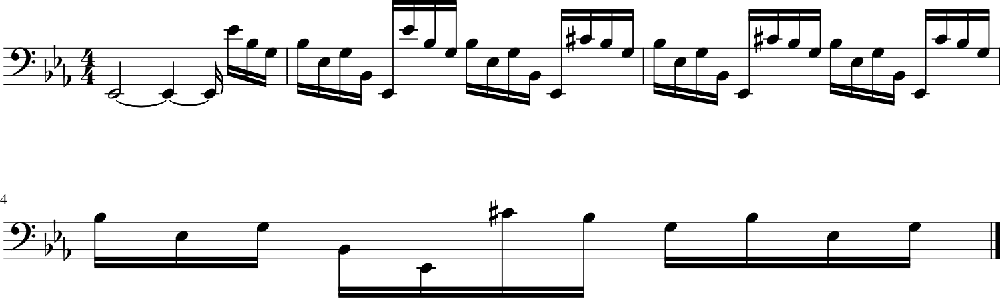

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5658 - loss: 1.3481 - note_outputs_loss: 0.7823
Epoch 231/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5470 - loss: 1.3762 - note_outputs_loss: 0.8291
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


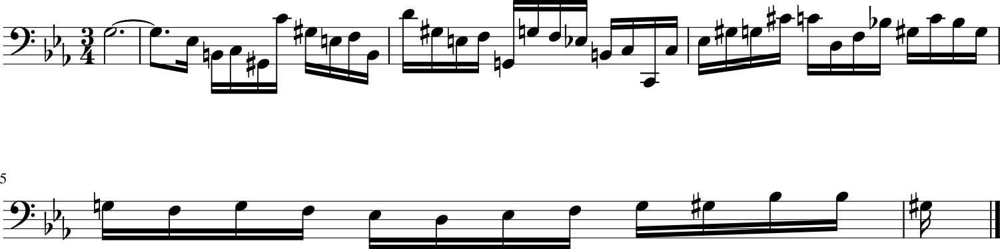

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5469 - loss: 1.3760 - note_outputs_loss: 0.8291
Epoch 232/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4973 - loss: 1.2916 - note_outputs_loss: 0.7943
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'F#3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'F#2', 'G2', 'E2', 'E2', 'B-2'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


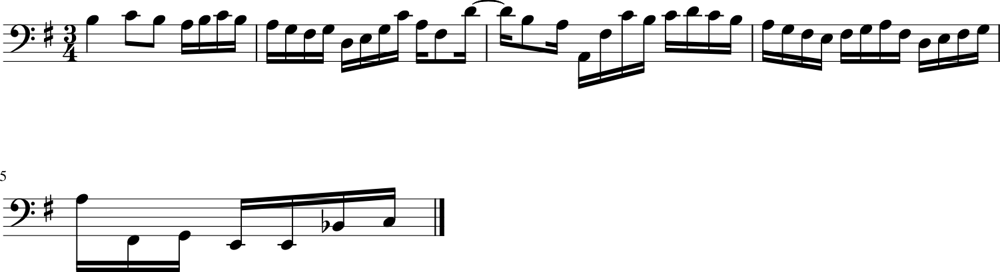

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4976 - loss: 1.2922 - note_outputs_loss: 0.7947
Epoch 233/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5032 - loss: 1.3212 - note_outputs_loss: 0.8180
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

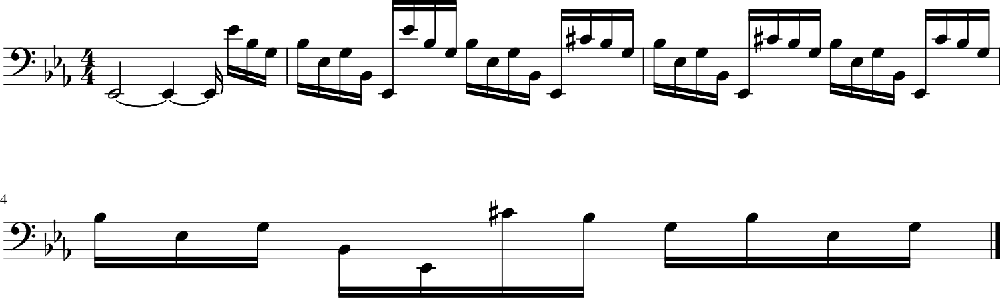

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5035 - loss: 1.3216 - note_outputs_loss: 0.8182
Epoch 234/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5640 - loss: 1.3912 - note_outputs_loss: 0.8272
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'G2', 'B-2', 'E-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


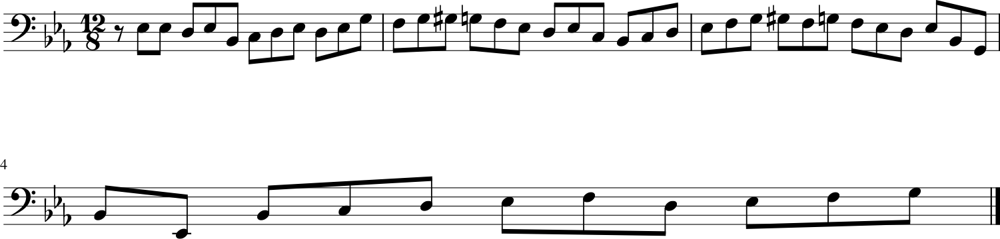

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5637 - loss: 1.3910 - note_outputs_loss: 0.8274
Epoch 235/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4843 - loss: 1.2966 - note_outputs_loss: 0.8123
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


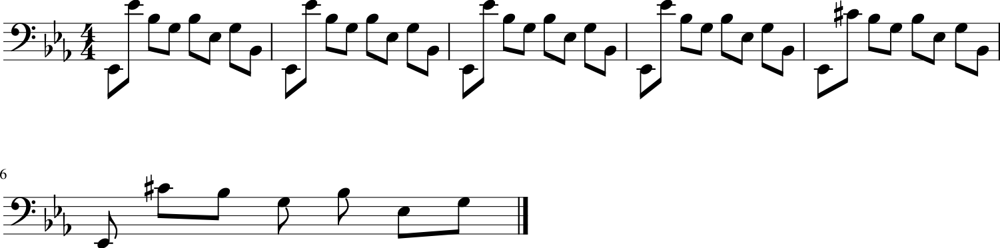

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4847 - loss: 1.2972 - note_outputs_loss: 0.8125
Epoch 236/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5748 - loss: 1.3738 - note_outputs_loss: 0.7990
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

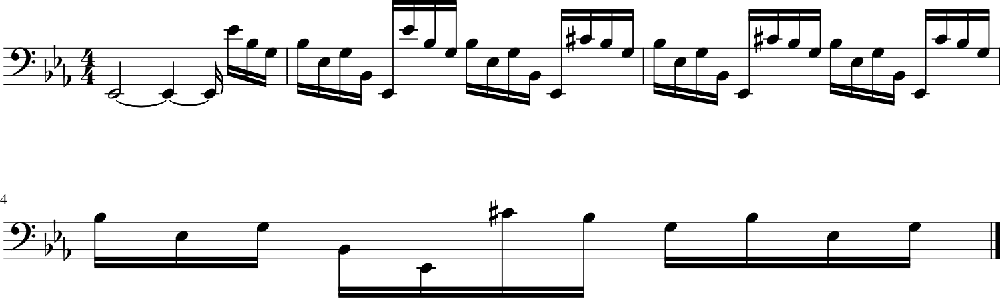

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5744 - loss: 1.3737 - note_outputs_loss: 0.7992
Epoch 237/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5212 - loss: 1.3273 - note_outputs_loss: 0.8061
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'D3', 'G3', 'D3', 'B2', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'A3', 'B3', 'C4', 'B3', 'B3', 'A3', 'A3', 'B3', 'F#3', 'G3', 'G3', 'E3', 'G3', 'A3', 'E3', 'F#3', 'F#3', 'D3', 'F#3', 'G3', 'B3', 'C4', 'E3', 'B2', 'D4', 'B3', 'G3', 'F#3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


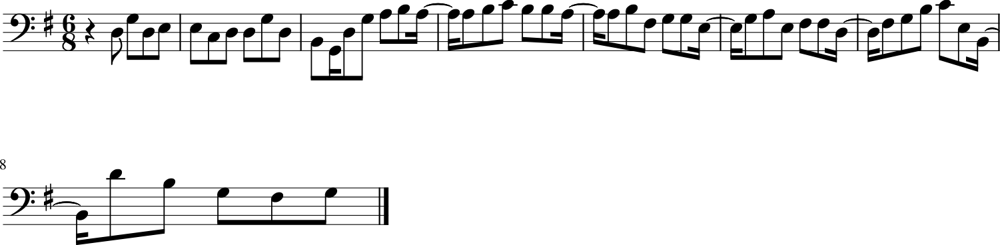

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5213 - loss: 1.3276 - note_outputs_loss: 0.8063
Epoch 238/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5102 - loss: 1.3045 - note_outputs_loss: 0.7943
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'B-3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'E-4', 'C4', 'D4', 'G3', 'B-3', 'A3', 'G3', 'F#3', 'G3', 'A3', 'G3', 'G2', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


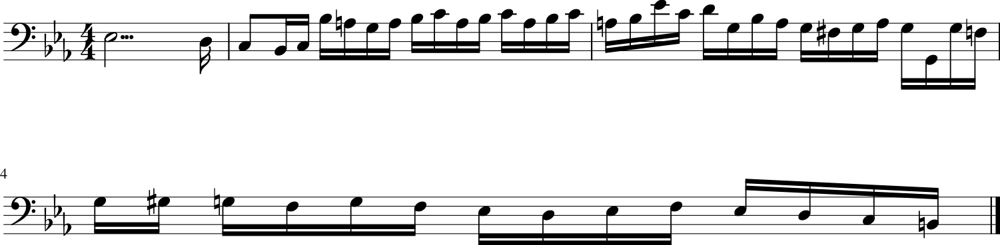

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5103 - loss: 1.3048 - note_outputs_loss: 0.7945
Epoch 239/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5667 - loss: 1.3648 - note_outputs_loss: 0.7982
Generation prompt: [['START', 'F:major', '3/4TS', 'A3', 'B-3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'D3', 'G3', 'F3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'A2', 'B-2', 'C3', 'A2', 'B-2', 'G2', 'F2', 'A3', 'A3', 'A3', 'A3', 'A3', 'E3', 'C3', 'B-2', 'C3', 'D3', 'B-2', 'C3', 'A2', 'G2', 'F#2', 'A2', 'D3', 'C4', 'B-3', 'F#3', 'G3', 'B-3', 'D4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


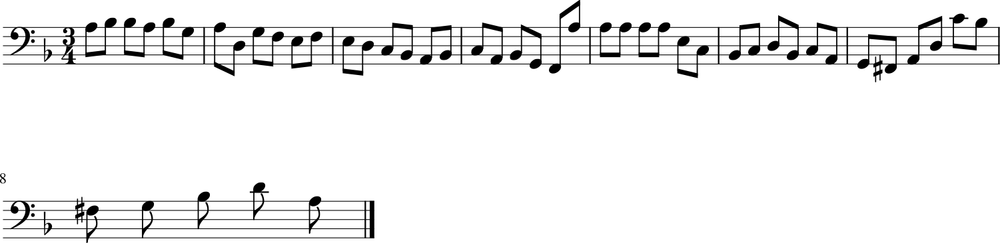

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5663 - loss: 1.3647 - note_outputs_loss: 0.7984
Epoch 240/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5587 - loss: 1.3439 - note_outputs_loss: 0.7852
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


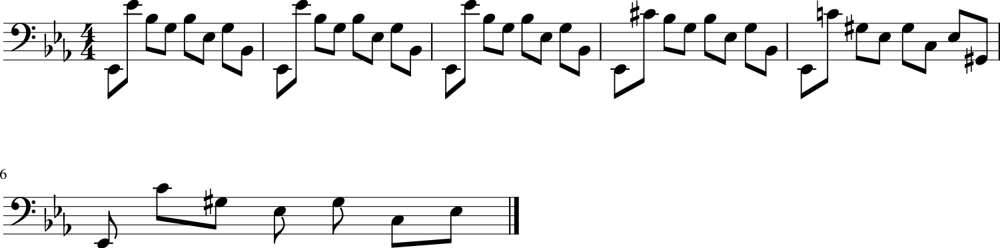

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5585 - loss: 1.3440 - note_outputs_loss: 0.7855
Epoch 241/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5175 - loss: 1.3150 - note_outputs_loss: 0.7975
Generation prompt: [['START', 'G:major'], ['0.0', '0.0']]


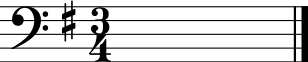

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5176 - loss: 1.3153 - note_outputs_loss: 0.7977
Epoch 242/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5013 - loss: 1.3026 - note_outputs_loss: 0.8013
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'A3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


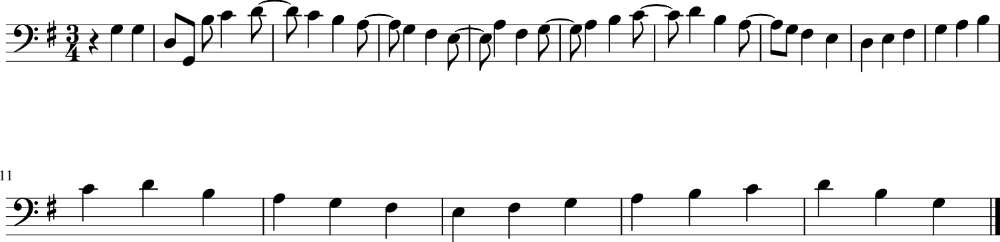

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5015 - loss: 1.3031 - note_outputs_loss: 0.8016
Epoch 243/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5258 - loss: 1.3119 - note_outputs_loss: 0.7861
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'G3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


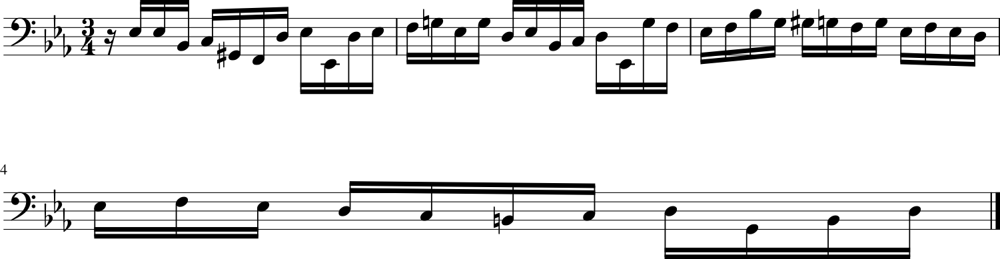

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5258 - loss: 1.3123 - note_outputs_loss: 0.7864
Epoch 244/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4694 - loss: 1.2901 - note_outputs_loss: 0.8207
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'D3', 'C3', 'B2', 'A2', 'G2', 'D3', 'F#3', 'A3', 'C4', 'A3', 'F#3', 'D3', 'B3', 'D3', 'E3', 'G3', 'A3', 'C#4', 'D4', 'A3', 'F#3', 'E3', 'D3', 'A3', 'F#3', 'D3', 'A2'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


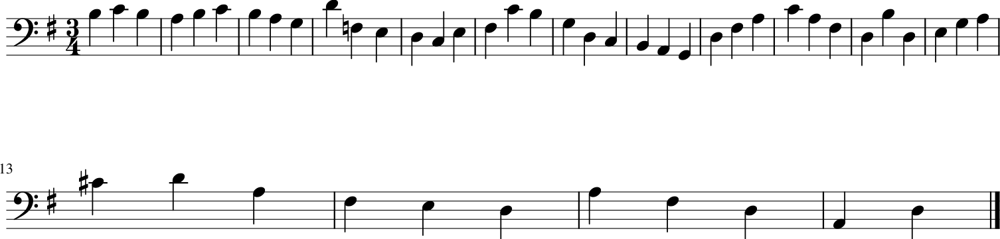

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4699 - loss: 1.2907 - note_outputs_loss: 0.8208
Epoch 245/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5567 - loss: 1.3524 - note_outputs_loss: 0.7956
Generation prompt: [['START', 'G:major', '3/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'G3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'D4', 'C4', 'B3', 'C4', 'A3', 'G3', 'F#3', 'G3', 'E3', 'C#3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'G3', 'E3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


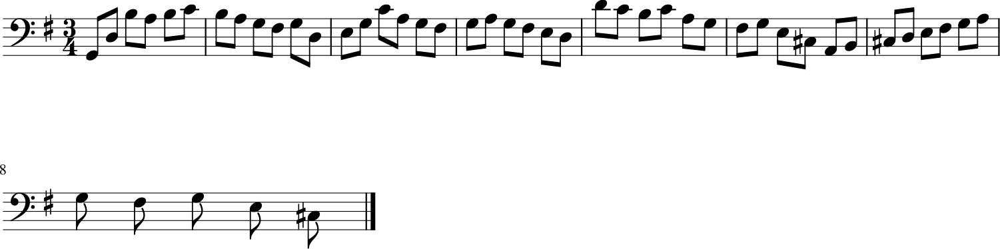

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5565 - loss: 1.3524 - note_outputs_loss: 0.7959
Epoch 246/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5014 - loss: 1.3230 - note_outputs_loss: 0.8216
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'A3', 'C4', 'B3', 'C4', 'B3', 'A3', 'G3', 'B3', 'C4', 'G3', 'D3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'B2', 'E-3', 'E2', 'D3', 'F3', 'E3', 'F3', 'G3', 'A3', 'C#4', 'D4', 'F3', 'B2', 'F3', 'B2', 'F3', 'D3', 'F3', 'B3', 'D4', 'C4', 'G3', 'B3', 'C4', 'E-4', 'B3', 'B3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


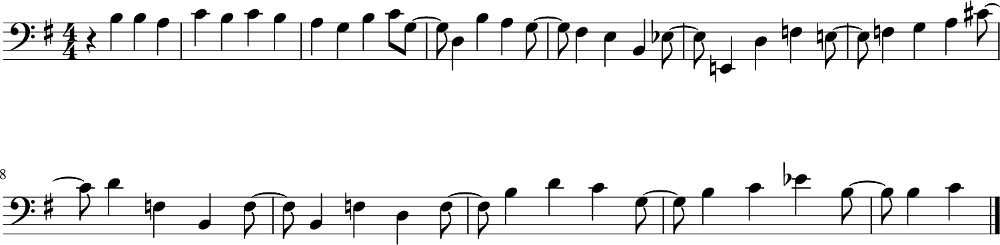

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5016 - loss: 1.3233 - note_outputs_loss: 0.8217
Epoch 247/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5431 - loss: 1.3436 - note_outputs_loss: 0.8005
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

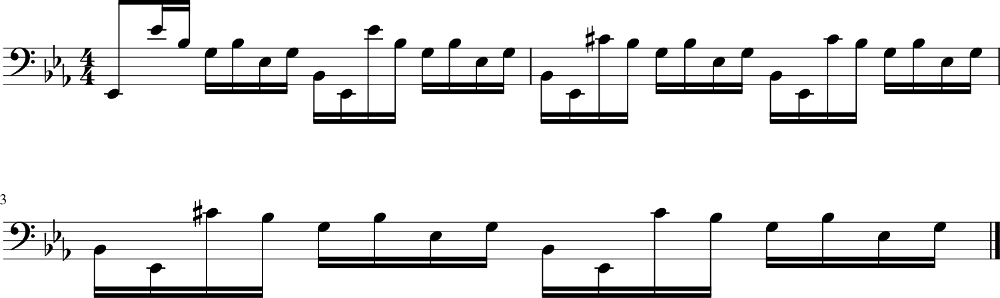

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5430 - loss: 1.3437 - note_outputs_loss: 0.8007
Epoch 248/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5375 - loss: 1.3211 - note_outputs_loss: 0.7836
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


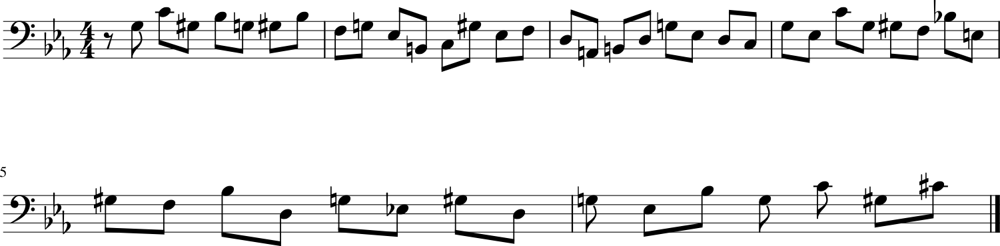

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5374 - loss: 1.3213 - note_outputs_loss: 0.7839
Epoch 249/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4717 - loss: 1.2911 - note_outputs_loss: 0.8193
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'G2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G2', 'F2', 'G#3', 'D3', 'B2', 'D3', 'G#2'], ['0.0', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.75', '0.25', '0.25', '0.25']]


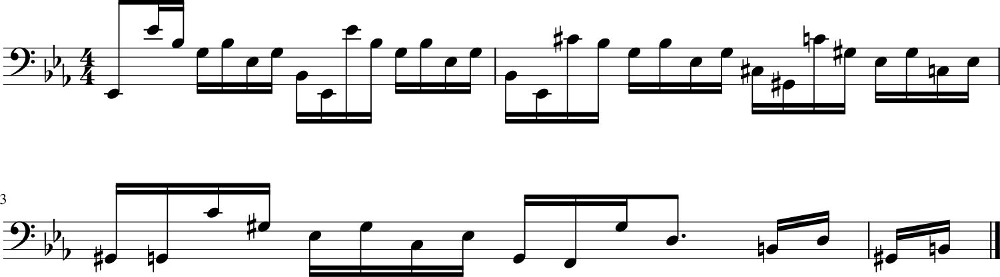

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4723 - loss: 1.2916 - note_outputs_loss: 0.8193
Epoch 250/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5672 - loss: 1.3296 - note_outputs_loss: 0.7624
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


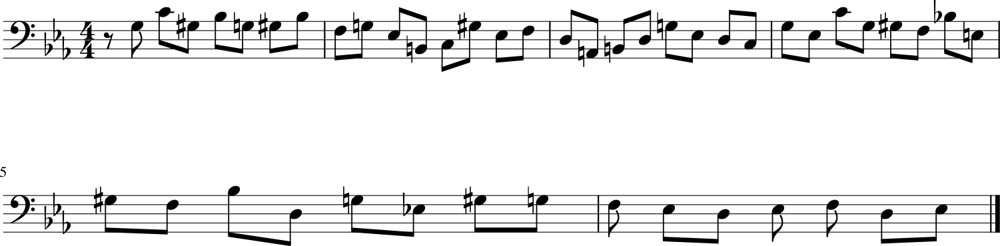

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5668 - loss: 1.3297 - note_outputs_loss: 0.7629
Epoch 251/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5453 - loss: 1.3109 - note_outputs_loss: 0.7656
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


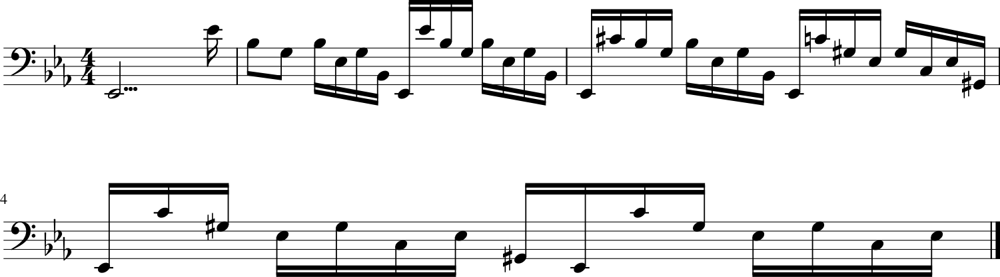

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5451 - loss: 1.3111 - note_outputs_loss: 0.7660
Epoch 252/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5319 - loss: 1.2969 - note_outputs_loss: 0.7650
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'B-3', 'B-3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


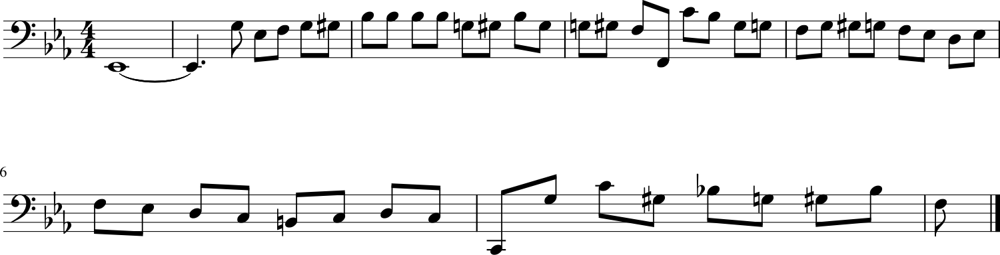

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5319 - loss: 1.2972 - note_outputs_loss: 0.7653
Epoch 253/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5239 - loss: 1.2939 - note_outputs_loss: 0.7700
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


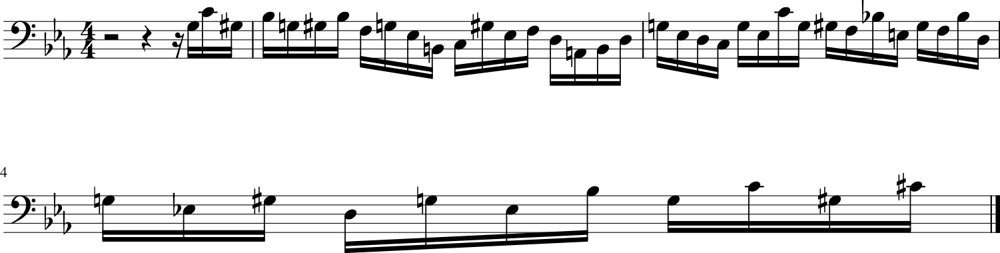

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5240 - loss: 1.2943 - note_outputs_loss: 0.7704
Epoch 254/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5556 - loss: 1.3250 - note_outputs_loss: 0.7694
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


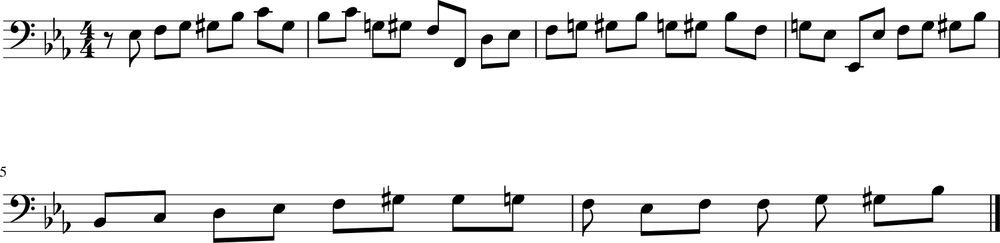

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5553 - loss: 1.3252 - note_outputs_loss: 0.7699
Epoch 255/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4906 - loss: 1.2726 - note_outputs_loss: 0.7820
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

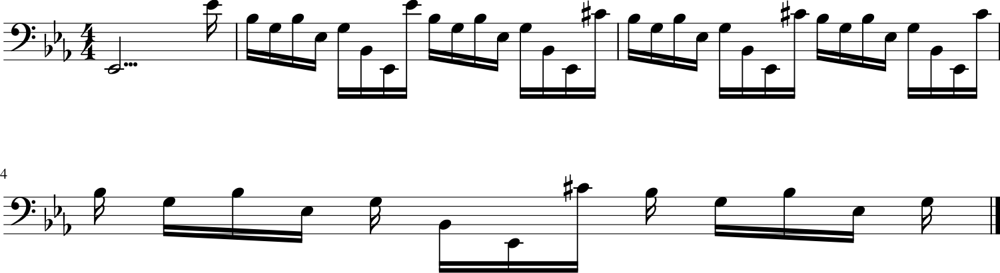

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4909 - loss: 1.2732 - note_outputs_loss: 0.7823
Epoch 256/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4999 - loss: 1.2946 - note_outputs_loss: 0.7947
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'C4', 'C4', 'G3', 'E3', 'C3', 'G2', 'E2', 'C2', 'C4', 'D4', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'C4', 'B3', 'G3', 'D3', 'B2', 'G2', 'F2', 'C4', 'B3', 'A3', 'G3', 'C4', 'B3', 'A3', 'G3', 'C4', 'B3', 'A3', 'G3', 'C4', 'E-4', 'D4', 'F3', 'E3', 'F3', 'B2', 'G3', 'F#3', 'G3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


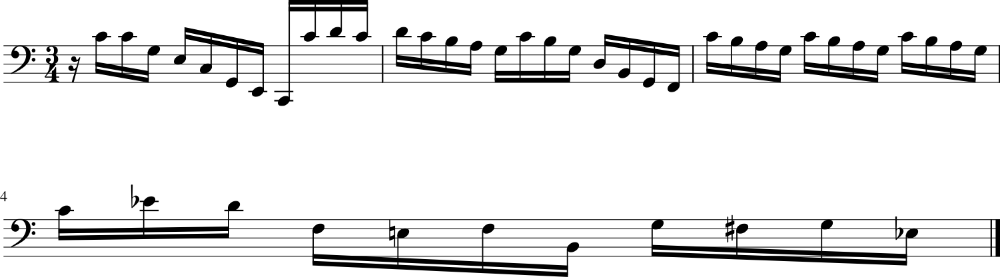

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5002 - loss: 1.2950 - note_outputs_loss: 0.7948
Epoch 257/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5690 - loss: 1.3460 - note_outputs_loss: 0.7770
Generation prompt: [['START', 'F:major', '3/4TS', 'A3', 'B-3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'D3', 'G3', 'F3', 'E3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'A3', 'B-3', 'B-3', 'A3', 'B-3', 'G3', 'C4', 'A3', 'D4', 'E4', 'C#4', 'E4', 'D4', 'E4', 'F4', 'B3', 'C#4', 'D4', 'C#4', 'D4', 'E4', 'D4', 'C#4', 'B3', 'C#4', 'D4', 'B3', 'C#4', 'D4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


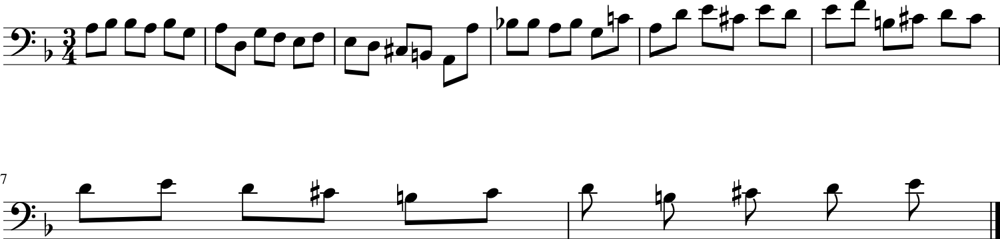

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5686 - loss: 1.3459 - note_outputs_loss: 0.7773
Epoch 258/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5025 - loss: 1.2847 - note_outputs_loss: 0.7822
Generation prompt: [['START', 'E-:major', '3/2TS', '3/4TS', 'F3', 'E3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'C4', 'B3', 'D4', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


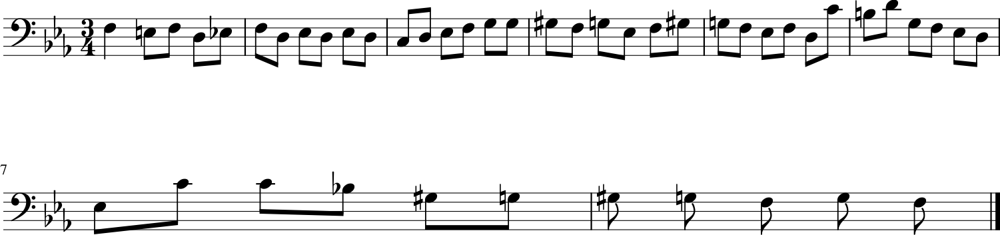

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5027 - loss: 1.2852 - note_outputs_loss: 0.7825
Epoch 259/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5707 - loss: 1.3462 - note_outputs_loss: 0.7755
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'E-3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


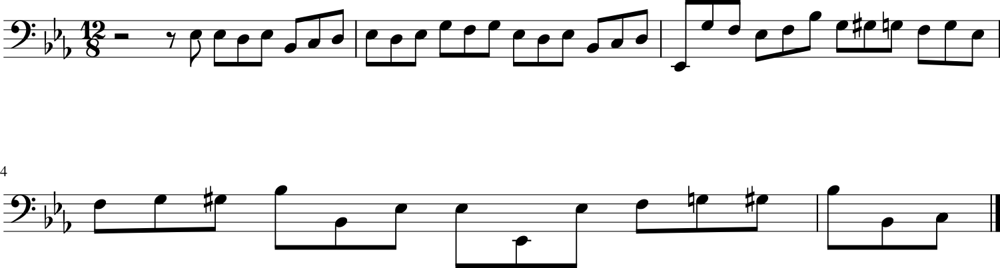

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5703 - loss: 1.3461 - note_outputs_loss: 0.7758
Epoch 260/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5623 - loss: 1.3408 - note_outputs_loss: 0.7784
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'B-3'], ['0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


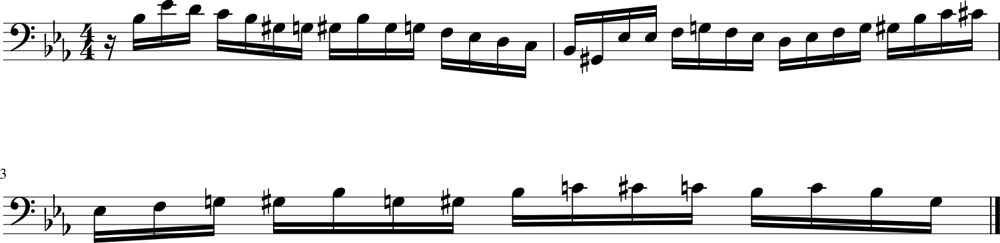

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5620 - loss: 1.3408 - note_outputs_loss: 0.7788
Epoch 261/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5326 - loss: 1.3096 - note_outputs_loss: 0.7770
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


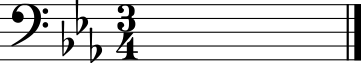

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5326 - loss: 1.3099 - note_outputs_loss: 0.7773
Epoch 262/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4681 - loss: 1.2447 - note_outputs_loss: 0.7766
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


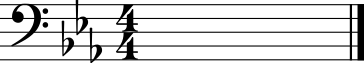

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.4687 - loss: 1.2456 - note_outputs_loss: 0.7769
Epoch 263/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4934 - loss: 1.2919 - note_outputs_loss: 0.7984
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-2', 'B-2', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


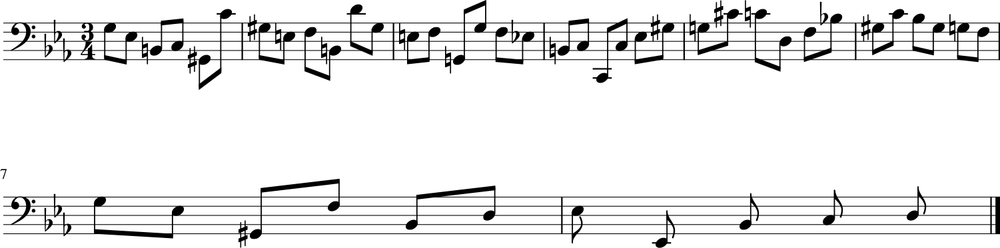

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4938 - loss: 1.2924 - note_outputs_loss: 0.7986
Epoch 264/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5072 - loss: 1.2681 - note_outputs_loss: 0.7609
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


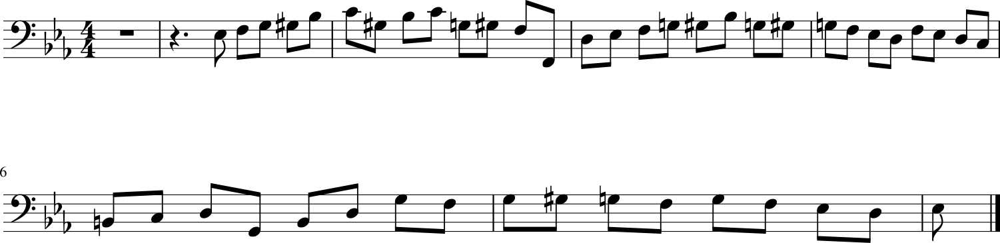

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5074 - loss: 1.2688 - note_outputs_loss: 0.7614
Epoch 265/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4963 - loss: 1.2513 - note_outputs_loss: 0.7550
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'E-3', 'C4', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'G#3', 'G3', 'C4', 'C#4'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


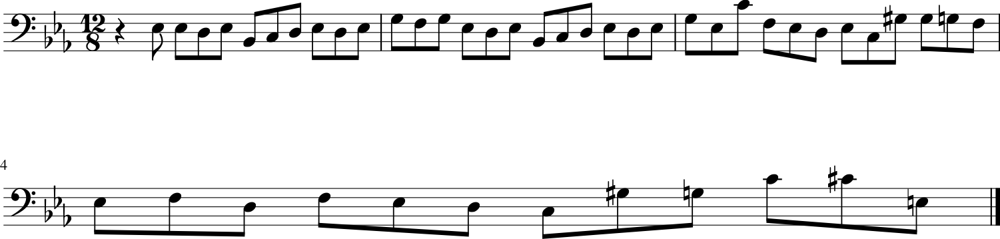

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4966 - loss: 1.2521 - note_outputs_loss: 0.7555
Epoch 266/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5151 - loss: 1.2903 - note_outputs_loss: 0.7752
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2'], ['0.0', '0.0', '0.0', '2.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


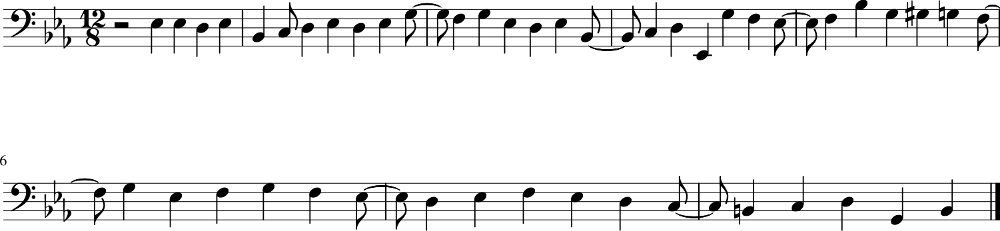

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5152 - loss: 1.2907 - note_outputs_loss: 0.7755
Epoch 267/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5297 - loss: 1.3080 - note_outputs_loss: 0.7783
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'G#3', 'G#3', 'B-3', 'F3', 'G3', 'B-3', 'C#4', 'B-3', 'C4', 'B-3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


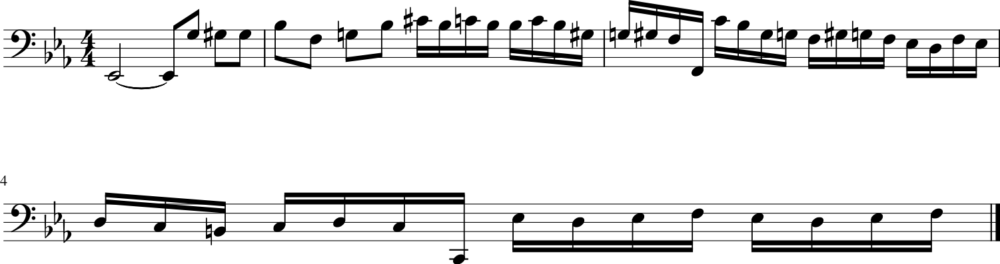

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5297 - loss: 1.3083 - note_outputs_loss: 0.7785
Epoch 268/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5105 - loss: 1.2771 - note_outputs_loss: 0.7666
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]

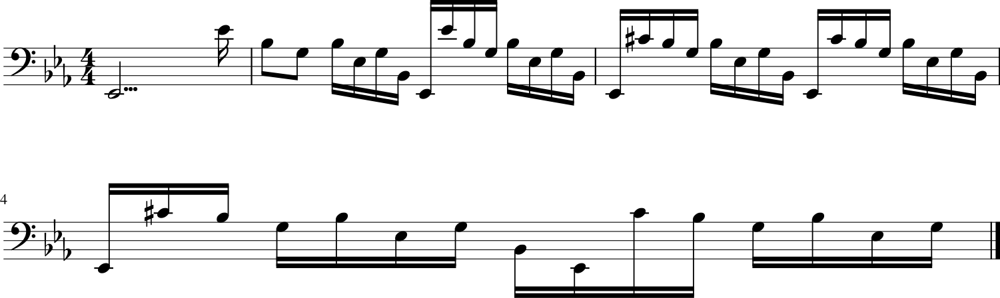

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5107 - loss: 1.2776 - note_outputs_loss: 0.7669
Epoch 269/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5317 - loss: 1.2830 - note_outputs_loss: 0.7513
Generation prompt: [['START', 'G:major', '3/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'D3', 'A2', 'D2', 'D3', 'F#3', 'A3', 'B3'], ['0.0', '0.0', '2.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


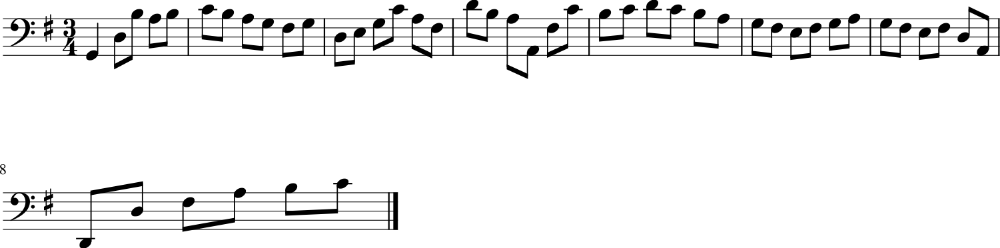

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5317 - loss: 1.2835 - note_outputs_loss: 0.7518
Epoch 270/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4843 - loss: 1.2661 - note_outputs_loss: 0.7818
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'F3', 'D3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3'], ['0.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.25', '0.25']]


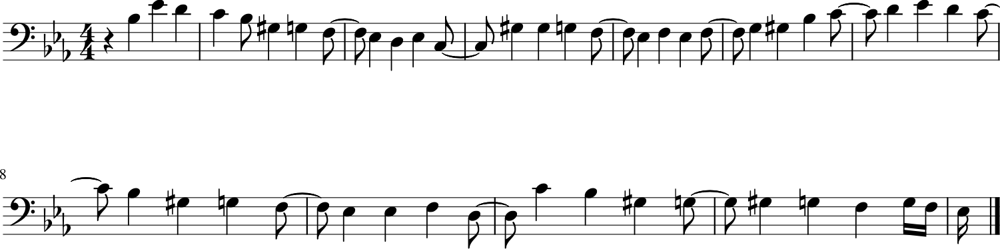

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4846 - loss: 1.2667 - note_outputs_loss: 0.7820
Epoch 271/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5161 - loss: 1.2993 - note_outputs_loss: 0.7832
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'D4', 'E4', 'F4', 'G3', 'F4', 'E4', 'D4', 'C4', 'B3', 'C4', 'A3', 'G3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'G3', 'D3', 'B2', 'B2', 'G2', 'G2', 'B3', 'C4', 'B3', 'A3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


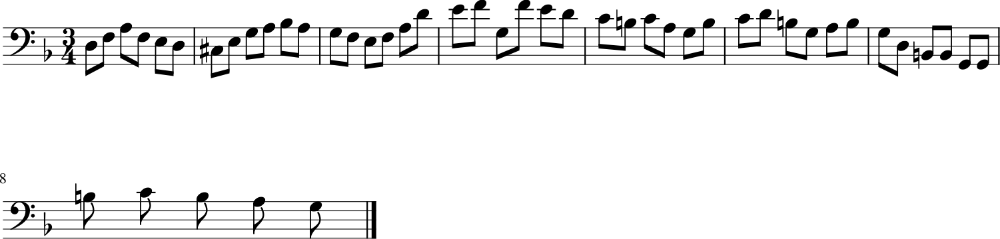

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5163 - loss: 1.2995 - note_outputs_loss: 0.7833
Epoch 272/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5379 - loss: 1.3159 - note_outputs_loss: 0.7780
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'B-3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'F3', 'F3', 'A3', 'F3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'G3', 'C4', 'D4', 'C4', 'D4', 'E-4', 'B-3', 'C4', 'G3', 'G3', 'G#3', 'D3', 'B-3'], ['0.0', '0.0', '0.0', '1.0', '0.75', '0.25', '0.5', '0.75', '0.25', '0.5', '0.75', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


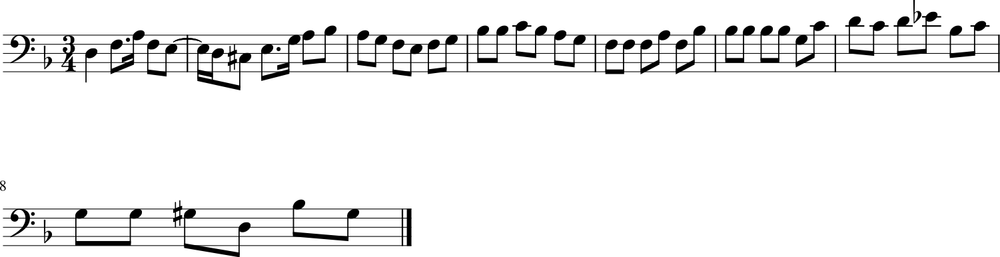

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5378 - loss: 1.3160 - note_outputs_loss: 0.7783
Epoch 273/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4794 - loss: 1.2577 - note_outputs_loss: 0.7782
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


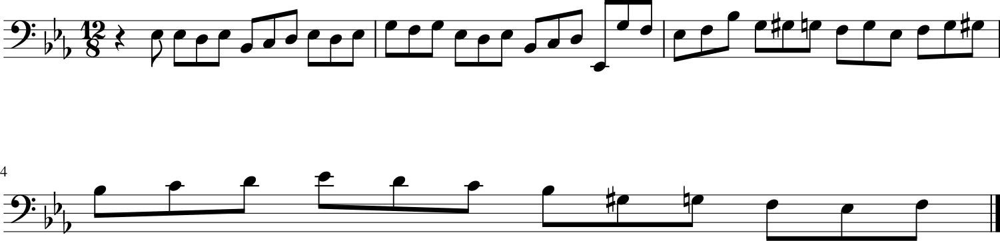

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4799 - loss: 1.2583 - note_outputs_loss: 0.7784
Epoch 274/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5277 - loss: 1.2871 - note_outputs_loss: 0.7594
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


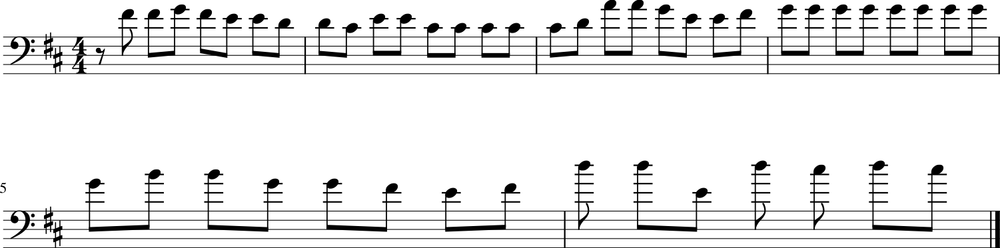

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5277 - loss: 1.2875 - note_outputs_loss: 0.7598
Epoch 275/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5293 - loss: 1.2991 - note_outputs_loss: 0.7698
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


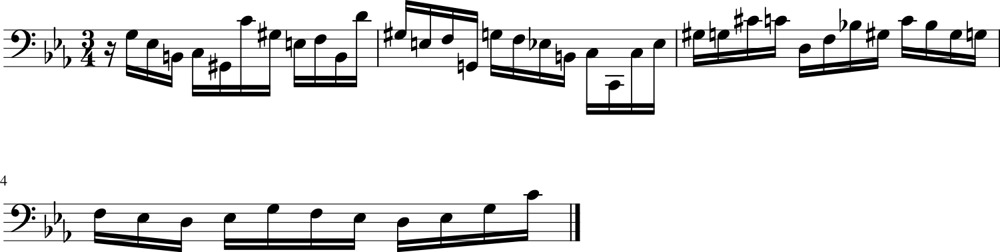

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5293 - loss: 1.2993 - note_outputs_loss: 0.7700
Epoch 276/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4883 - loss: 1.2494 - note_outputs_loss: 0.7611
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B-2', 'D3', 'F3', 'G#3', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'E-4', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'E-3', 'D3', 'C3', 'D3', 'B-2', 'E-4', 'D4', 'C4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


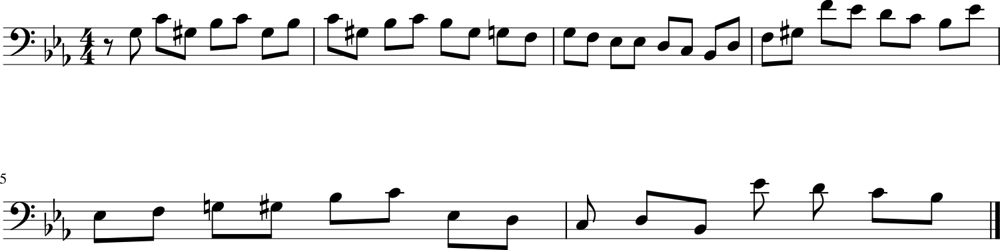

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4886 - loss: 1.2500 - note_outputs_loss: 0.7614
Epoch 277/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5461 - loss: 1.3317 - note_outputs_loss: 0.7857
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


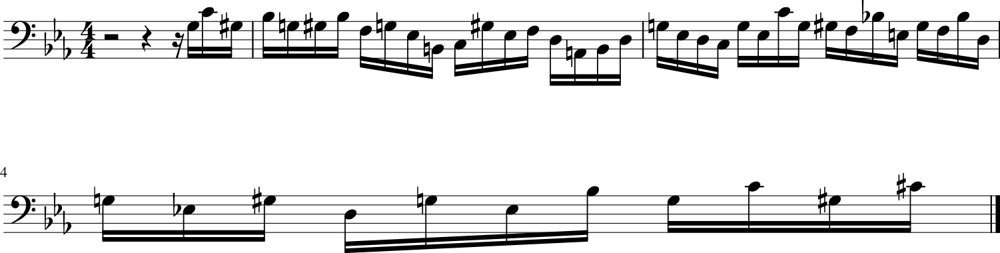

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5459 - loss: 1.3317 - note_outputs_loss: 0.7858
Epoch 278/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5362 - loss: 1.2991 - note_outputs_loss: 0.7628
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'F3', 'E-3', 'D3', 'E-3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '3.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


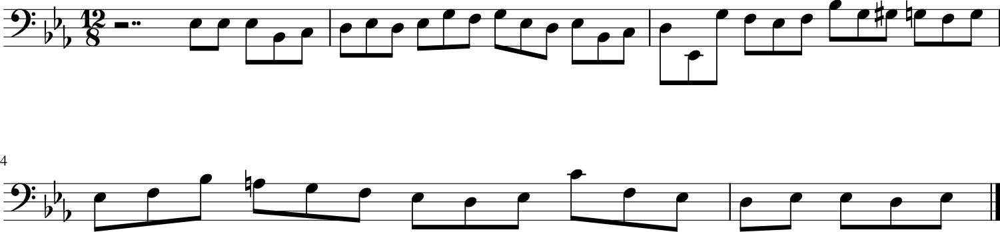

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5362 - loss: 1.2993 - note_outputs_loss: 0.7631
Epoch 279/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4867 - loss: 1.2316 - note_outputs_loss: 0.7448
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'E3', 'C3', 'C2', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'D3', 'D2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'A3', 'B3', 'C4', 'A3', 'C4', 'B3', 'A3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


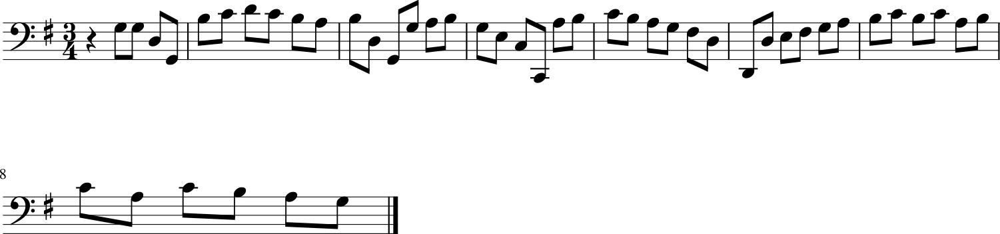

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4871 - loss: 1.2324 - note_outputs_loss: 0.7452
Epoch 280/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5231 - loss: 1.2882 - note_outputs_loss: 0.7651
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


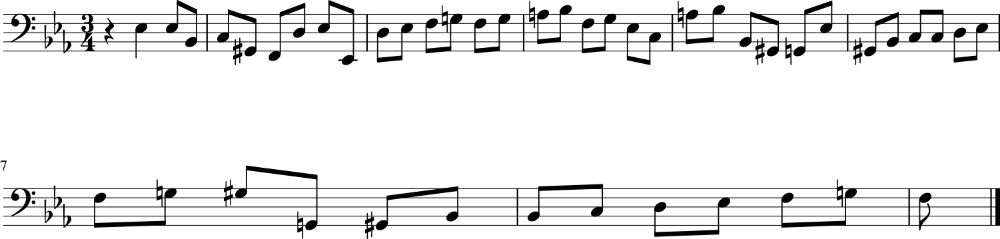

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5232 - loss: 1.2885 - note_outputs_loss: 0.7654
Epoch 281/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4938 - loss: 1.2516 - note_outputs_loss: 0.7577
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-2', 'B-2'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


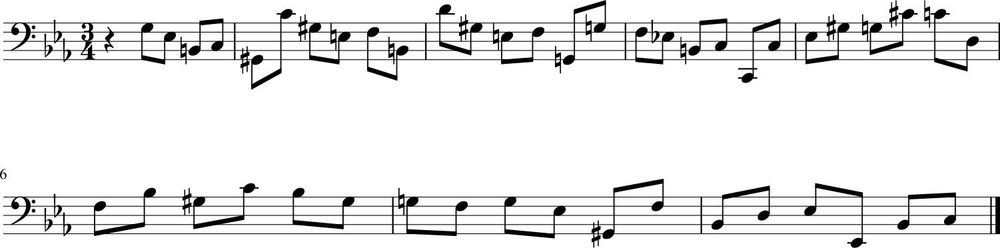

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4942 - loss: 1.2523 - note_outputs_loss: 0.7581
Epoch 282/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5175 - loss: 1.3107 - note_outputs_loss: 0.7933
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B-3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


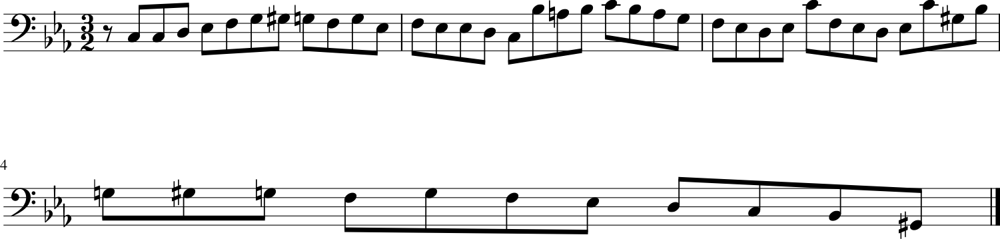

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5176 - loss: 1.3109 - note_outputs_loss: 0.7933
Epoch 283/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5042 - loss: 1.2565 - note_outputs_loss: 0.7523
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


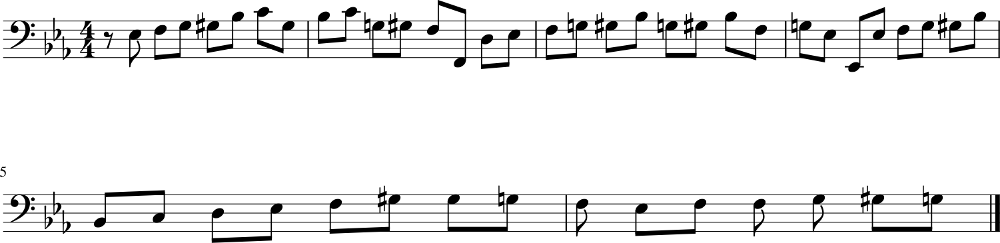

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5044 - loss: 1.2571 - note_outputs_loss: 0.7527
Epoch 284/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5145 - loss: 1.2870 - note_outputs_loss: 0.7726
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'E3', 'F#3', 'C4', 'B-3', 'G#3', 'B-3', 'G#3', 'B-3', 'C4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


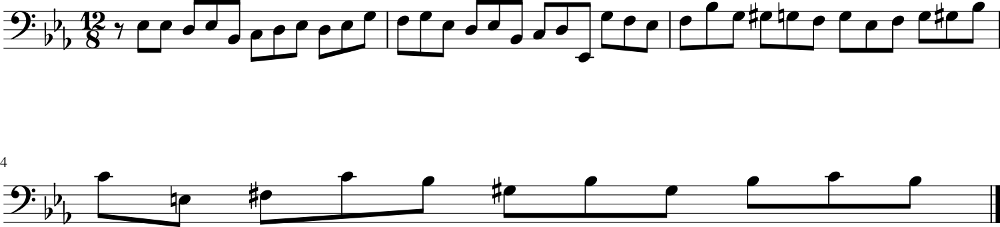

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5146 - loss: 1.2874 - note_outputs_loss: 0.7728
Epoch 285/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5160 - loss: 1.2804 - note_outputs_loss: 0.7644
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'B3', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'F3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


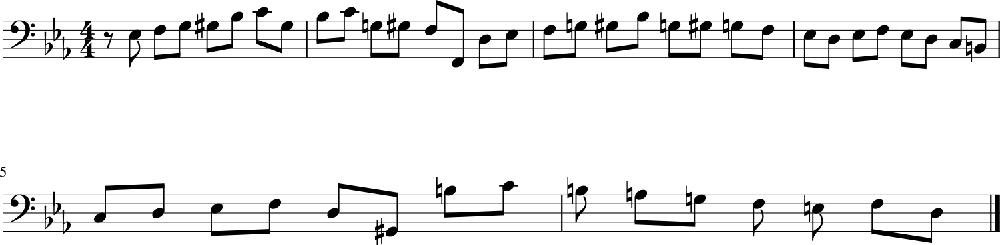

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5162 - loss: 1.2807 - note_outputs_loss: 0.7646
Epoch 286/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5234 - loss: 1.2852 - note_outputs_loss: 0.7618
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'C#4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'E-2', 'D2', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


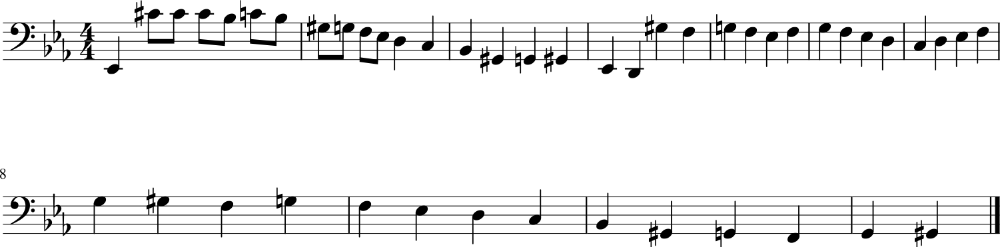

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5235 - loss: 1.2855 - note_outputs_loss: 0.7620
Epoch 287/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5467 - loss: 1.2924 - note_outputs_loss: 0.7457
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6']]


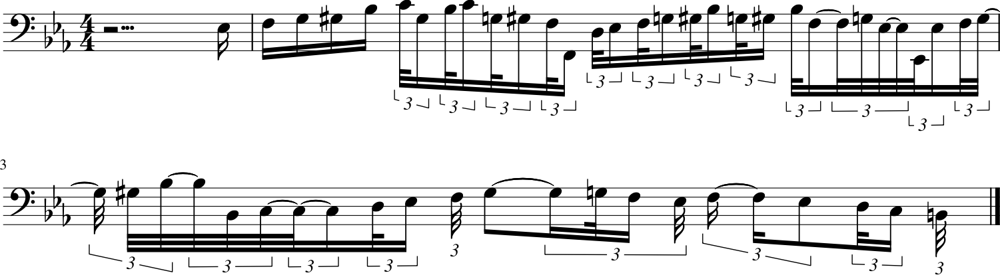

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5465 - loss: 1.2926 - note_outputs_loss: 0.7461
Epoch 288/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5081 - loss: 1.2725 - note_outputs_loss: 0.7645
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


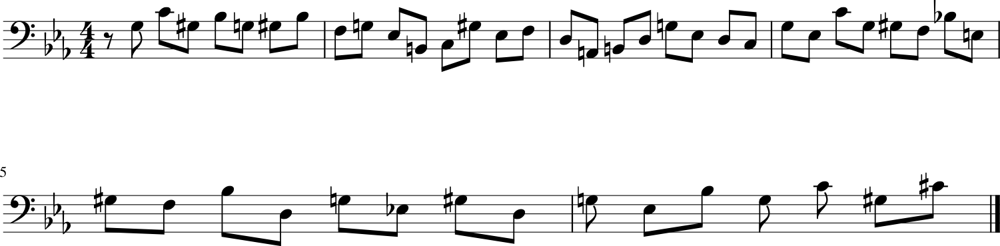

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5082 - loss: 1.2730 - note_outputs_loss: 0.7647
Epoch 289/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5362 - loss: 1.2843 - note_outputs_loss: 0.7481
Generation prompt: [['START', 'F:major'], ['0.0', '0.0']]


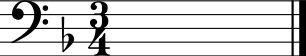

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 59ms/step - duration_outputs_loss: 0.5362 - loss: 1.2847 - note_outputs_loss: 0.7485
Epoch 290/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4971 - loss: 1.2626 - note_outputs_loss: 0.7655
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'C#4', 'D4', 'D3', 'E-3', 'F3', 'G3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'F3', 'E-3', 'D3', 'D3', 'E3', 'F3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


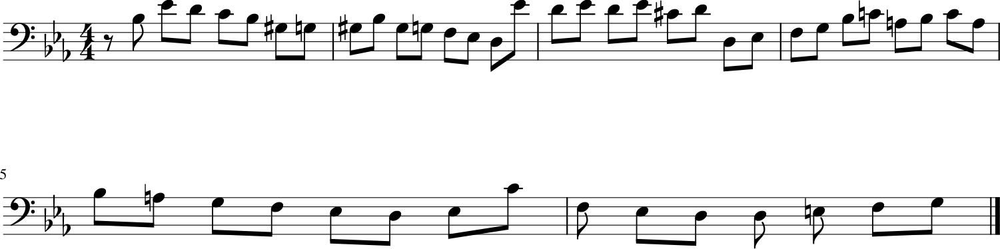

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4974 - loss: 1.2631 - note_outputs_loss: 0.7658
Epoch 291/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5168 - loss: 1.2571 - note_outputs_loss: 0.7402
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


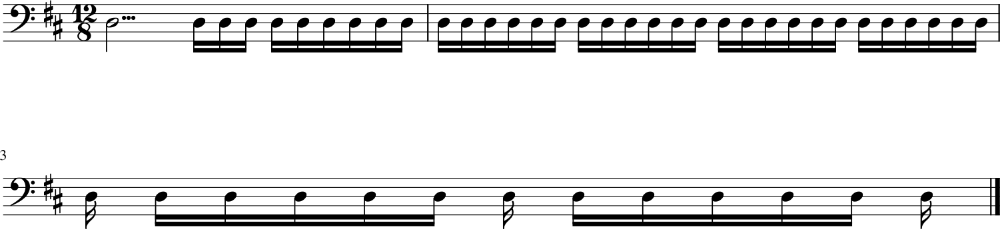

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5169 - loss: 1.2575 - note_outputs_loss: 0.7406
Epoch 292/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4841 - loss: 1.2346 - note_outputs_loss: 0.7506
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'B-3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'B2', 'C3', 'D3', 'E3', 'F3', 'A2', 'G#2', 'E3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


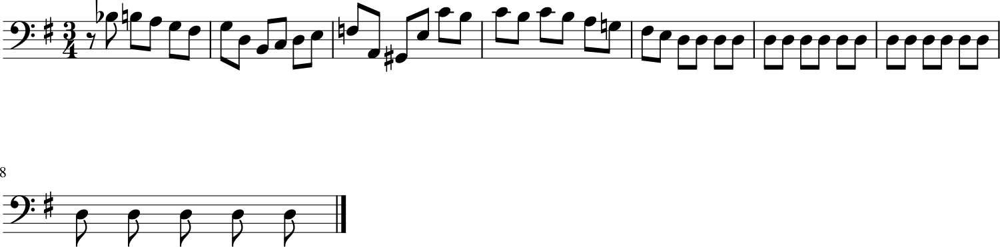

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4845 - loss: 1.2354 - note_outputs_loss: 0.7509
Epoch 293/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5414 - loss: 1.3177 - note_outputs_loss: 0.7764
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


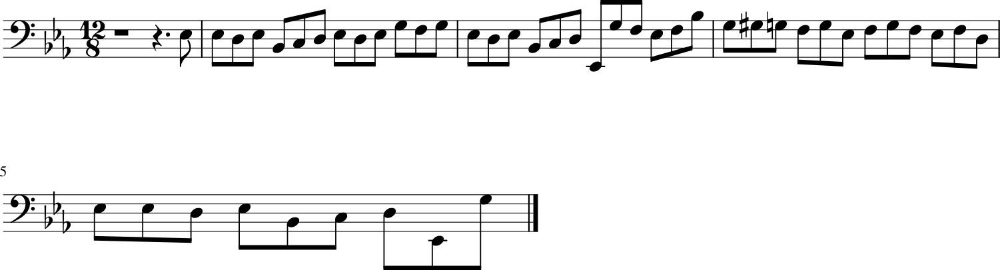

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5413 - loss: 1.3178 - note_outputs_loss: 0.7765
Epoch 294/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5762 - loss: 1.3498 - note_outputs_loss: 0.7735
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


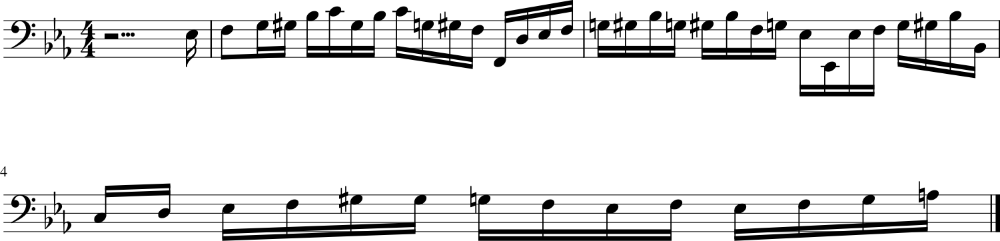

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5758 - loss: 1.3495 - note_outputs_loss: 0.7737
Epoch 295/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5452 - loss: 1.2898 - note_outputs_loss: 0.7447
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B2', 'G3', 'F3', 'E-3', 'F3', 'D3', 'F3', 'C3', 'F3', 'B2', 'F3', 'A2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


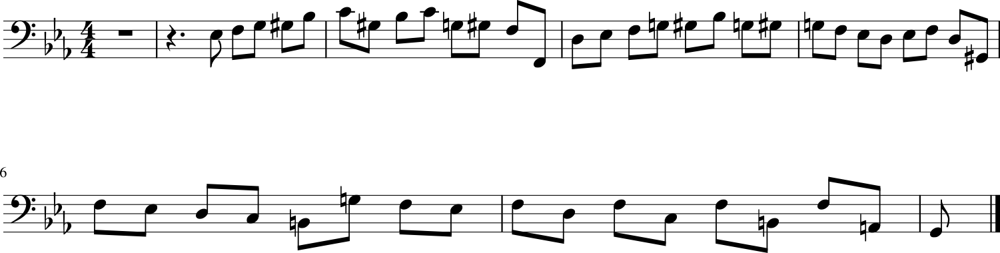

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5450 - loss: 1.2900 - note_outputs_loss: 0.7450
Epoch 296/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4492 - loss: 1.2242 - note_outputs_loss: 0.7749
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'B-2', 'D3', 'F3', 'B-3', 'A3', 'B-3', 'C4', 'D4', 'E-4', 'F3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


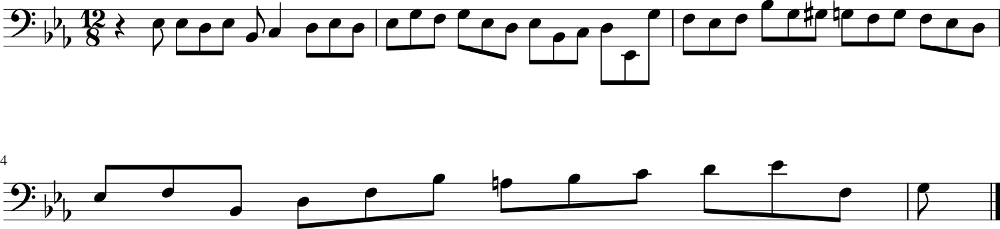

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4500 - loss: 1.2249 - note_outputs_loss: 0.7749
Epoch 297/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5385 - loss: 1.3098 - note_outputs_loss: 0.7713
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


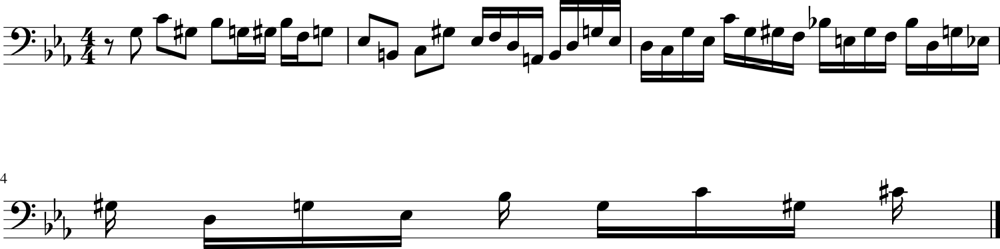

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5384 - loss: 1.3097 - note_outputs_loss: 0.7713
Epoch 298/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5179 - loss: 1.2298 - note_outputs_loss: 0.7119
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'G3', 'G#3', 'F3', 'F2', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'E-4', 'G#3', 'G3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


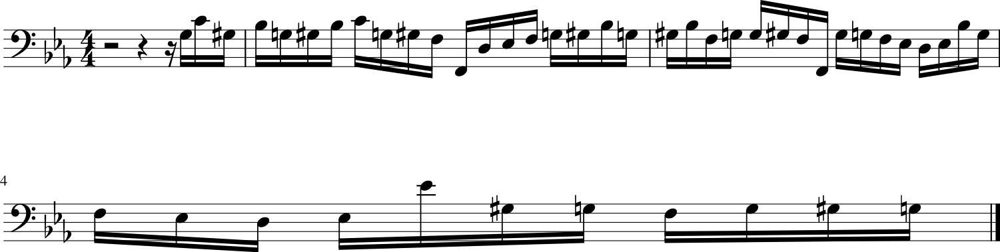

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5180 - loss: 1.2305 - note_outputs_loss: 0.7125
Epoch 299/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4972 - loss: 1.2501 - note_outputs_loss: 0.7528
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


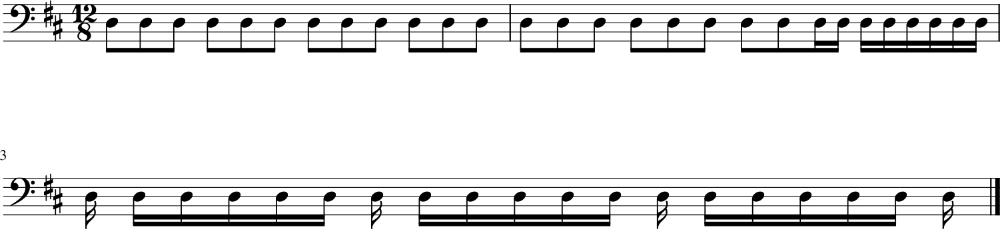

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4975 - loss: 1.2506 - note_outputs_loss: 0.7531
Epoch 300/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4687 - loss: 1.2192 - note_outputs_loss: 0.7505
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'B2', 'G3', 'D4', 'E-4', 'D4', 'E-4', 'C3', 'G2', 'B-2', 'G#2', 'G3', 'F3', 'E-4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


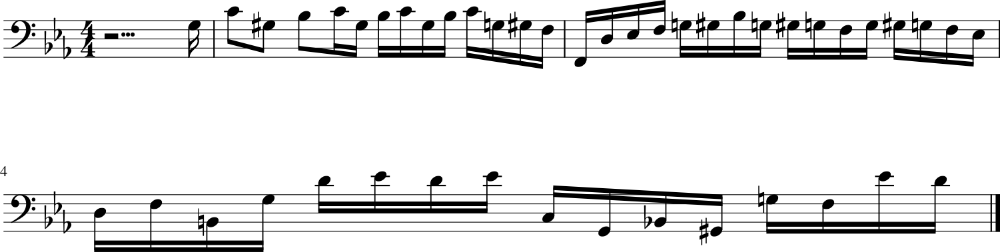

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4693 - loss: 1.2201 - note_outputs_loss: 0.7508
Epoch 301/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4471 - loss: 1.1950 - note_outputs_loss: 0.7479
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'C4', 'D4', 'B-3', 'F3', 'A3', 'B-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


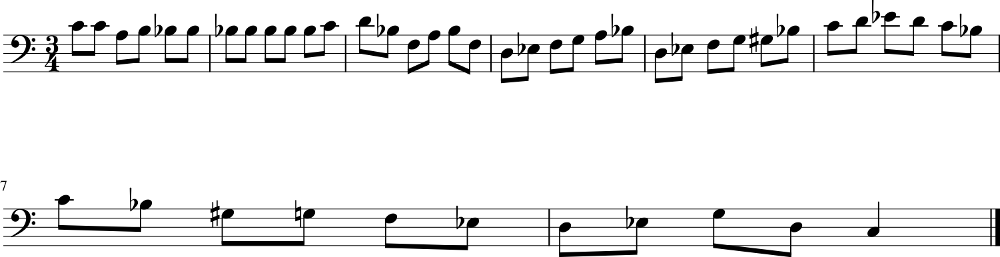

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4478 - loss: 1.1960 - note_outputs_loss: 0.7482
Epoch 302/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4603 - loss: 1.1910 - note_outputs_loss: 0.7308
Generation prompt: [['START', 'E-:major', '12/8TS', 'D3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


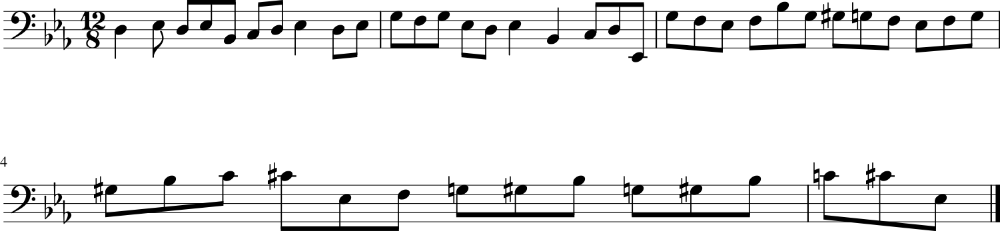

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.4609 - loss: 1.1921 - note_outputs_loss: 0.7312
Epoch 303/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5628 - loss: 1.3312 - note_outputs_loss: 0.7684
Generation prompt: [['START', 'F:major', '3/4TS', 'rest', 'A3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'A2', 'B-2', 'G2', 'A2', 'F2', 'E2', 'G3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'G3', 'F3', 'G3', 'A3', 'C#4', 'D4', 'F3', 'E3', 'F3', 'A3', 'D3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'F3', 'A3', 'D3', 'F3', 'E3', 'D3', 'E3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


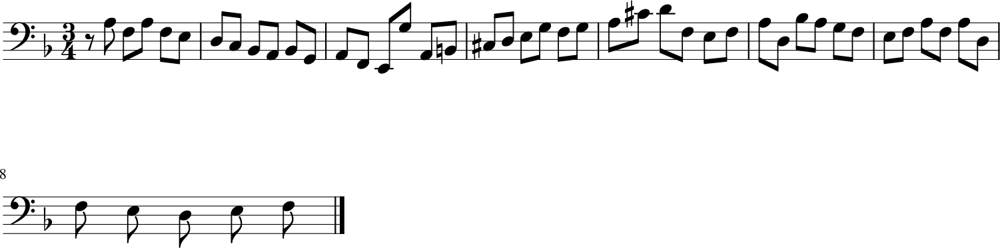

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5625 - loss: 1.3310 - note_outputs_loss: 0.7685
Epoch 304/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5282 - loss: 1.2700 - note_outputs_loss: 0.7418
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


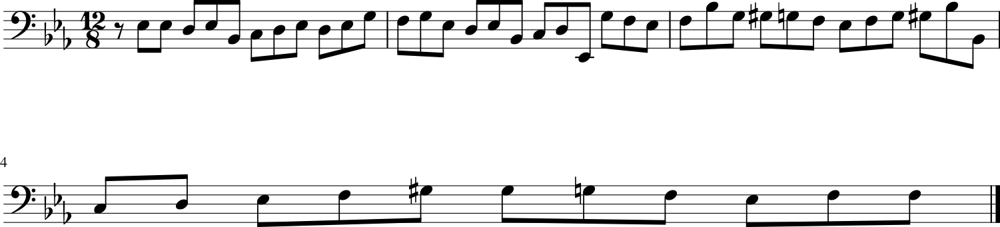

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5282 - loss: 1.2704 - note_outputs_loss: 0.7422
Epoch 305/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4754 - loss: 1.2253 - note_outputs_loss: 0.7500
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


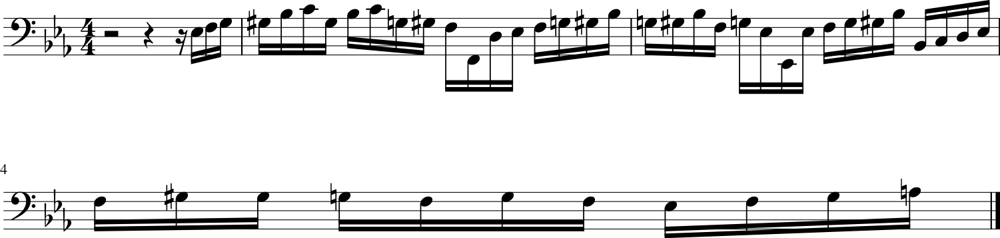

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4759 - loss: 1.2261 - note_outputs_loss: 0.7503
Epoch 306/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5377 - loss: 1.2787 - note_outputs_loss: 0.7410
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


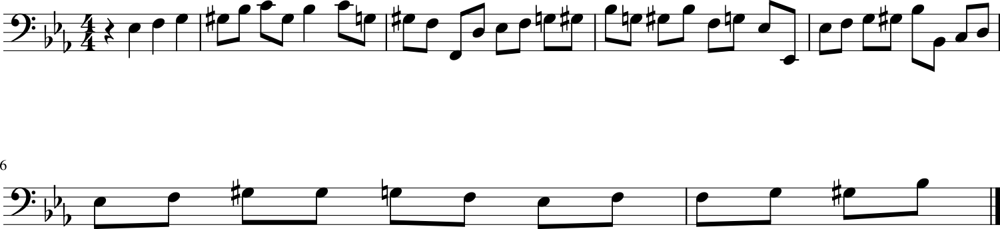

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5376 - loss: 1.2789 - note_outputs_loss: 0.7413
Epoch 307/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5752 - loss: 1.3405 - note_outputs_loss: 0.7653
Generation prompt: [['START', 'F:major', '3/4TS', 'rest', 'D4', 'A3', 'F3', 'A3', 'F3', 'A3', 'F3', 'A3', 'F3', 'A3', 'F3', 'A3', 'F3', 'A3', 'D3', 'B2', 'A3', 'F3', 'A3', 'B3', 'C4', 'G3', 'E3', 'D3', 'C3', 'E3', 'A3', 'C4', 'A3', 'F3', 'D3', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'G3', 'C4', 'E4', 'C4', 'A3', 'F3', 'E4', 'D4'], ['0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


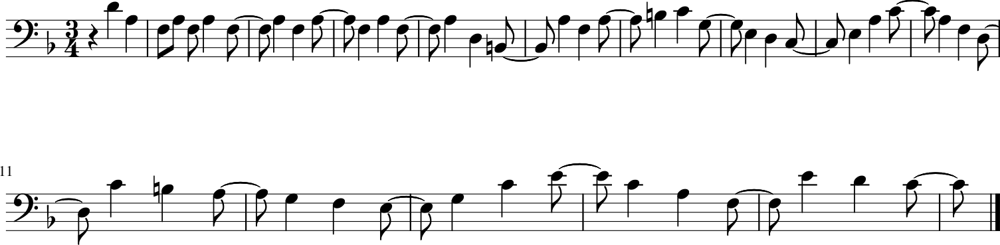

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5748 - loss: 1.3401 - note_outputs_loss: 0.7653
Epoch 308/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5651 - loss: 1.3050 - note_outputs_loss: 0.7398
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


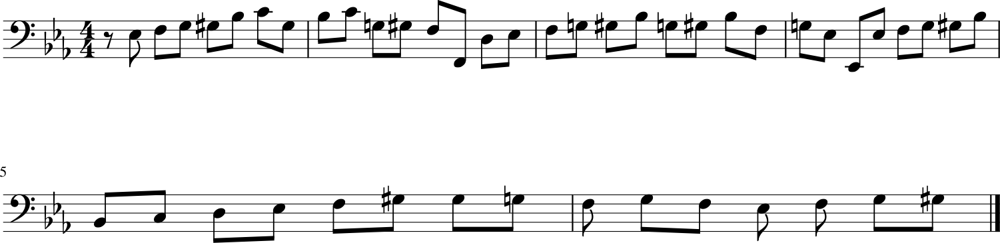

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5648 - loss: 1.3049 - note_outputs_loss: 0.7401
Epoch 309/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5620 - loss: 1.3200 - note_outputs_loss: 0.7580
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


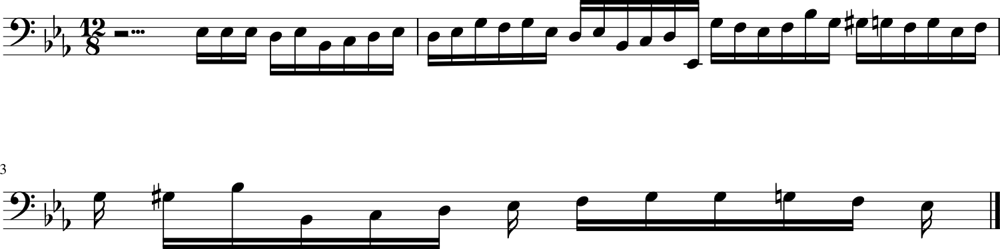

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5617 - loss: 1.3198 - note_outputs_loss: 0.7581
Epoch 310/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5203 - loss: 1.2714 - note_outputs_loss: 0.7512
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


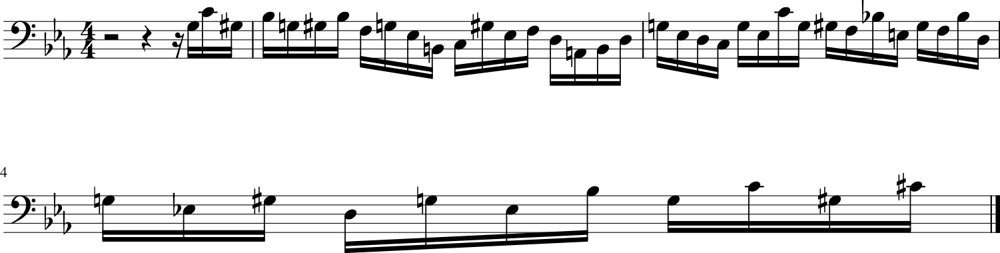

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5204 - loss: 1.2718 - note_outputs_loss: 0.7514
Epoch 311/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5802 - loss: 1.3321 - note_outputs_loss: 0.7519
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'G#3', 'F3', 'G3', 'B-3', 'E-4', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


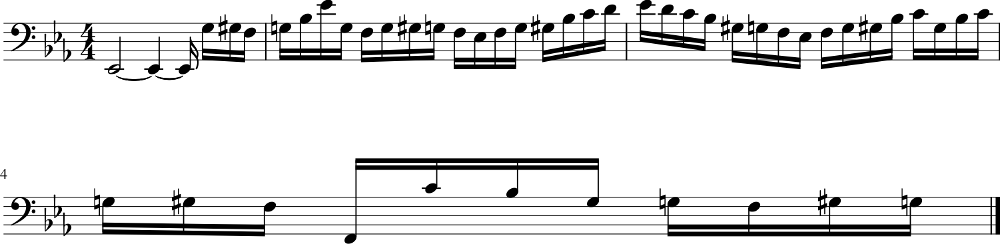

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5797 - loss: 1.3318 - note_outputs_loss: 0.7521
Epoch 312/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5253 - loss: 1.2734 - note_outputs_loss: 0.7481
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'B-3', 'B-3', 'B-3', 'G#3', 'B-3', 'C4', 'D4', 'F3', 'G3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


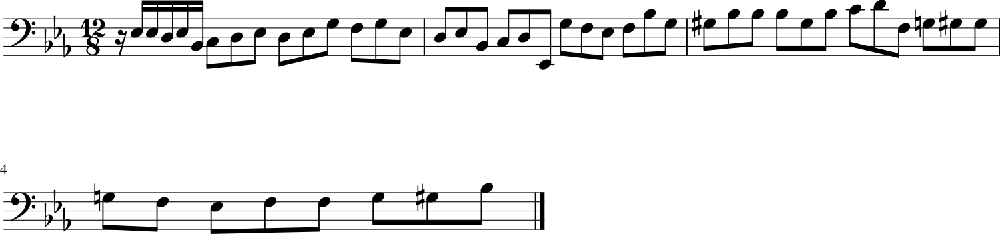

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5253 - loss: 1.2736 - note_outputs_loss: 0.7483
Epoch 313/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5242 - loss: 1.2637 - note_outputs_loss: 0.7395
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


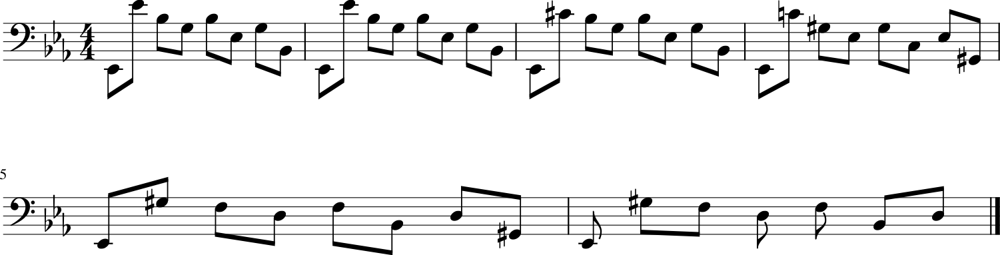

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5242 - loss: 1.2641 - note_outputs_loss: 0.7399
Epoch 314/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5506 - loss: 1.2941 - note_outputs_loss: 0.7435
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'B-2', 'E-2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


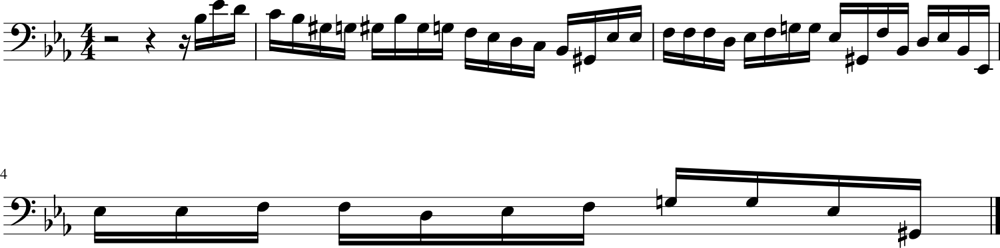

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5504 - loss: 1.2942 - note_outputs_loss: 0.7439
Epoch 315/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5205 - loss: 1.2714 - note_outputs_loss: 0.7509
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'D4', 'C4', 'B3', 'A3', 'G3', 'F3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'B3', 'C4', 'D4', 'E-4', 'D4', 'G3', 'B3', 'E-3', 'C4', 'E-3', 'F#3', 'A3', 'C4', 'B3', 'A3', 'B3', 'E3', 'G2', 'A3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


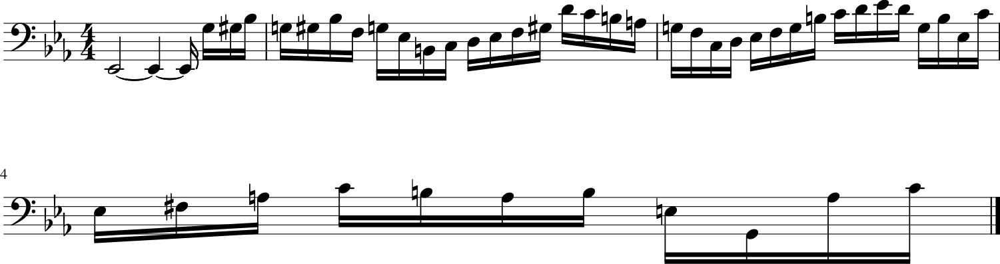

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - duration_outputs_loss: 0.5206 - loss: 1.2717 - note_outputs_loss: 0.7510
Epoch 316/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4979 - loss: 1.2649 - note_outputs_loss: 0.7670
Generation prompt: [['START', 'F:major', '3/4TS', 'D4', 'D4', 'B-3', 'B-3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'G3', 'F3', 'E3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'G3', 'F3', 'E3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'G3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'G3', 'B-3', 'A3', 'B-3', 'C4', 'B-3', 'C4', 'A3', 'F#3', 'D4', 'C4', 'B-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


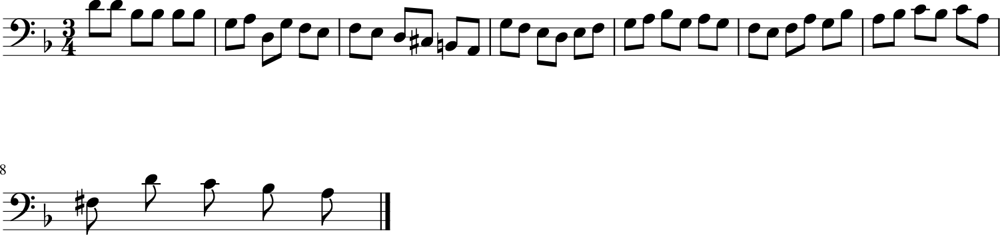

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4982 - loss: 1.2652 - note_outputs_loss: 0.7671
Epoch 317/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5522 - loss: 1.2939 - note_outputs_loss: 0.7417
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


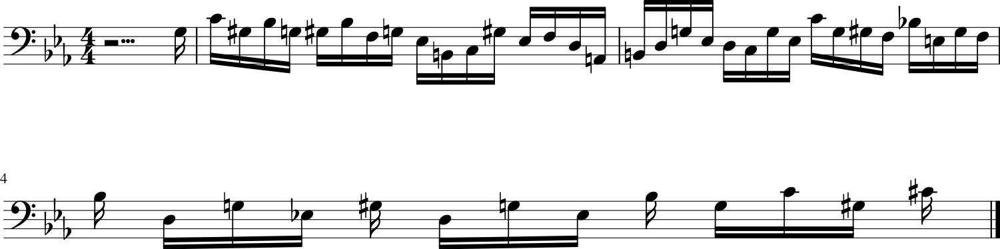

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5520 - loss: 1.2939 - note_outputs_loss: 0.7419
Epoch 318/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4728 - loss: 1.2109 - note_outputs_loss: 0.7381
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


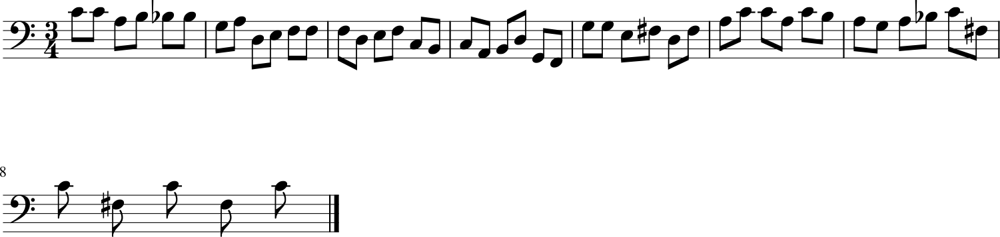

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4733 - loss: 1.2117 - note_outputs_loss: 0.7384
Epoch 319/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5324 - loss: 1.2850 - note_outputs_loss: 0.7526
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4', 'F#3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


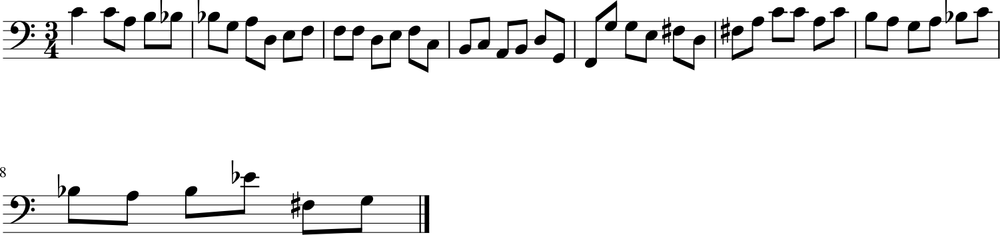

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5323 - loss: 1.2851 - note_outputs_loss: 0.7527
Epoch 320/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5367 - loss: 1.2905 - note_outputs_loss: 0.7538
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'F#3', 'A3', 'C4', 'B3', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'A3', 'C4', 'B3', 'C4', 'B3', 'A3', 'A2', 'B2', 'C3', 'D3', 'G2', 'B3', 'B3', 'D3', 'E3', 'C3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'B2', 'E-3', 'E2', 'E3', 'B2', 'D3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


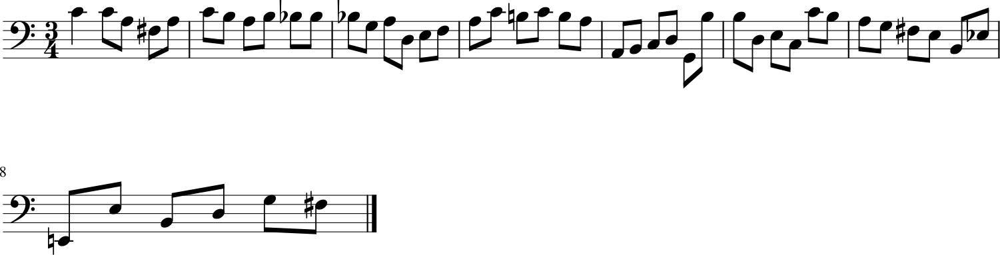

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5366 - loss: 1.2906 - note_outputs_loss: 0.7540
Epoch 321/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5370 - loss: 1.2638 - note_outputs_loss: 0.7269
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'G3', 'D3', 'B3', 'A3', 'D4', 'B3', 'C4', 'D4', 'B3', 'G3', 'F3', 'B3', 'B-3', 'B3', 'G3', 'F3', 'E3', 'C#4', 'D4', 'F#3', 'E3', 'D3', 'F#3', 'B3', 'F#3', 'B3', 'F#3', 'G3', 'E3', 'D3', 'C#3', 'B2', 'C#3', 'D3', 'E3', 'F#3', 'G3', 'C#4', 'D4', 'C#4', 'D4', 'A3', 'G3', 'F#3', 'E3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


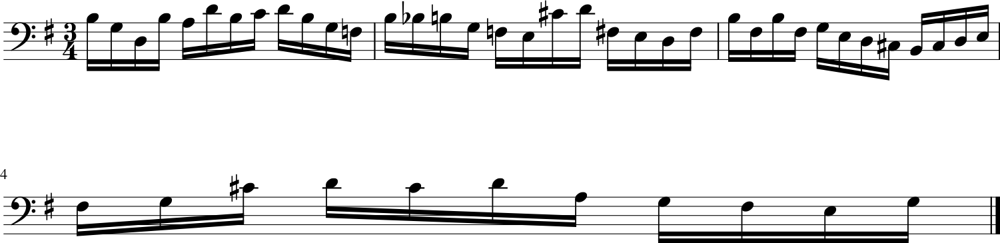

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5369 - loss: 1.2641 - note_outputs_loss: 0.7272
Epoch 322/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5050 - loss: 1.2165 - note_outputs_loss: 0.7115
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'G2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G2', 'F2', 'G#3', 'D3', 'B2', 'D3', 'G#2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


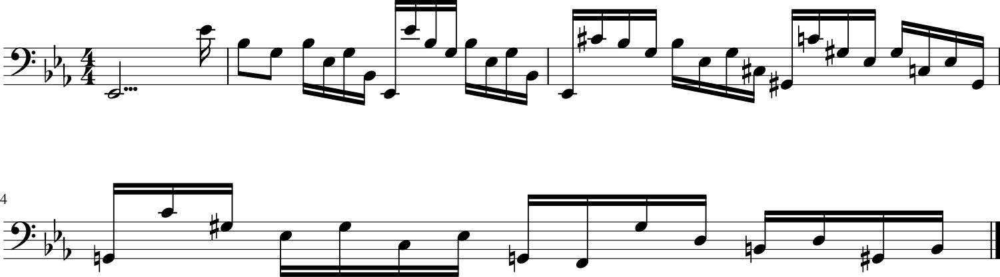

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5052 - loss: 1.2172 - note_outputs_loss: 0.7120
Epoch 323/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5327 - loss: 1.2506 - note_outputs_loss: 0.7179
Generation prompt: [['START', 'G:major', '3/4TS', 'D3', 'B3', 'A3', 'B3', 'A3', 'B3', 'E3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'D4', 'E4', 'F4', 'D4', 'E4', 'G3', 'C3', 'D4', 'C4', 'B3', 'A3', 'B3', 'C4', 'E4', 'D4', 'C4', 'D4', 'A3', 'B2', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


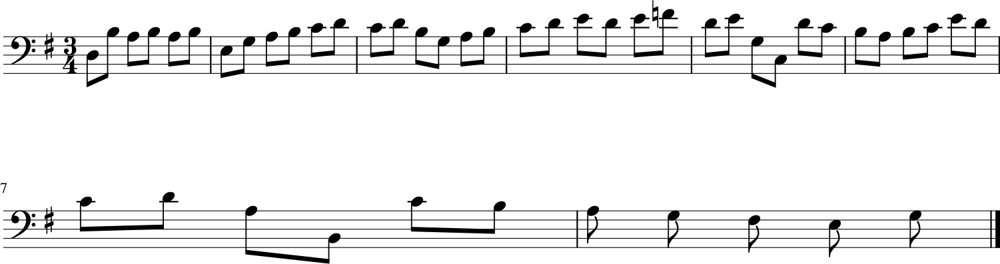

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5326 - loss: 1.2510 - note_outputs_loss: 0.7183
Epoch 324/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5521 - loss: 1.2856 - note_outputs_loss: 0.7335
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


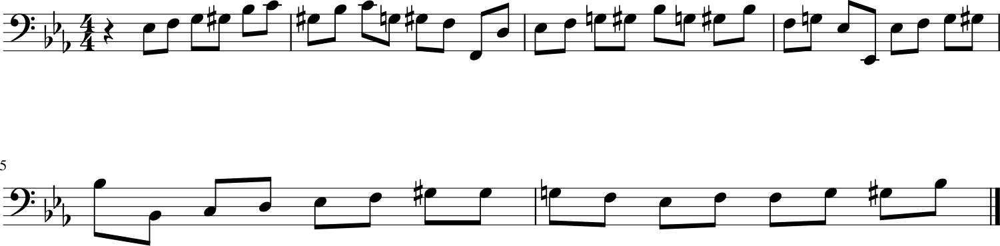

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5518 - loss: 1.2856 - note_outputs_loss: 0.7338
Epoch 325/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5517 - loss: 1.2794 - note_outputs_loss: 0.7276
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


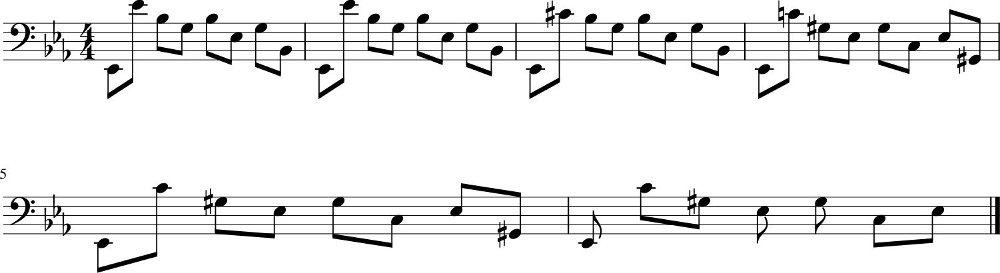

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5515 - loss: 1.2794 - note_outputs_loss: 0.7279
Epoch 326/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5197 - loss: 1.2691 - note_outputs_loss: 0.7493
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'F#3', 'D4', 'C4', 'B-3', 'A3', 'B-3', 'D4', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'B-3', 'A3', 'G3', 'A3', 'F3', 'A3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


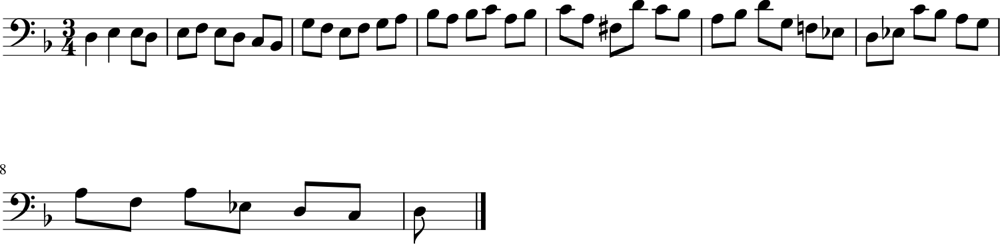

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5198 - loss: 1.2693 - note_outputs_loss: 0.7495
Epoch 327/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5230 - loss: 1.2573 - note_outputs_loss: 0.7343
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'C4', 'B3', 'A3', 'G3', 'C4', 'E-3', 'F3', 'D3', 'C4', 'B3', 'A3', 'G3', 'C4', 'E-3', 'F3', 'D3', 'B-3', 'D3', 'E-3', 'C3', 'G#3', 'C3', 'D3', 'B2', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


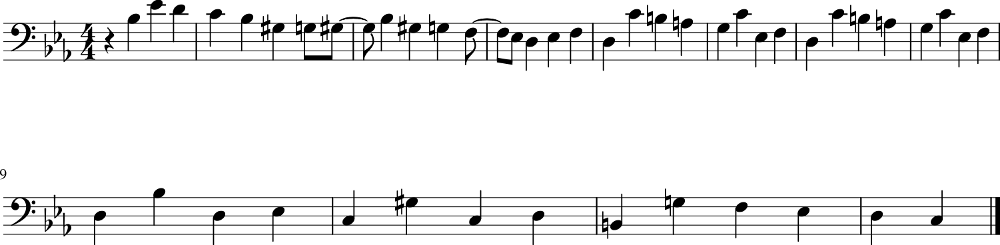

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5231 - loss: 1.2577 - note_outputs_loss: 0.7346
Epoch 328/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4902 - loss: 1.2317 - note_outputs_loss: 0.7415
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


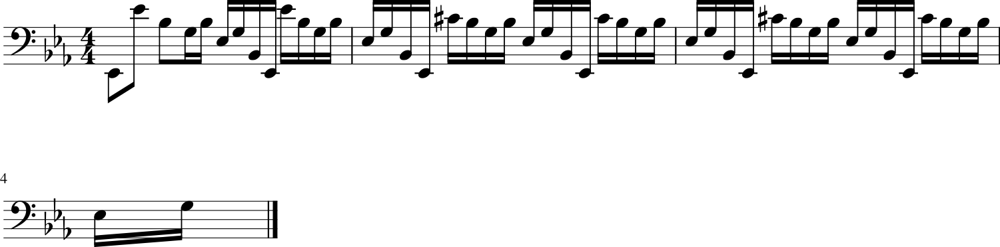

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4906 - loss: 1.2323 - note_outputs_loss: 0.7418
Epoch 329/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5429 - loss: 1.2883 - note_outputs_loss: 0.7454
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'C3', 'G2', 'E2', 'F2', 'B2', 'D3', 'F3', 'B2', 'F2', 'B2', 'D3', 'G3', 'E3', 'D3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


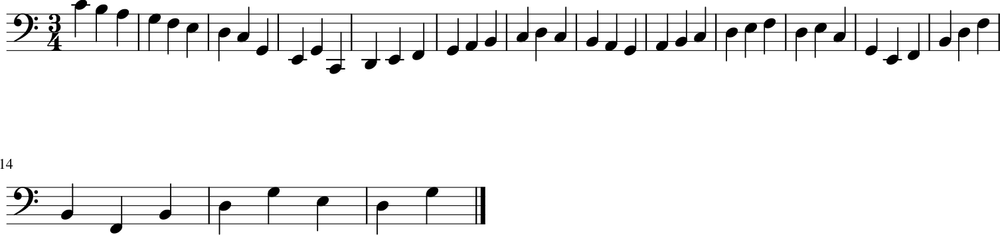

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5428 - loss: 1.2885 - note_outputs_loss: 0.7457
Epoch 330/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5457 - loss: 1.2880 - note_outputs_loss: 0.7423
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B3', 'C4', 'D4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


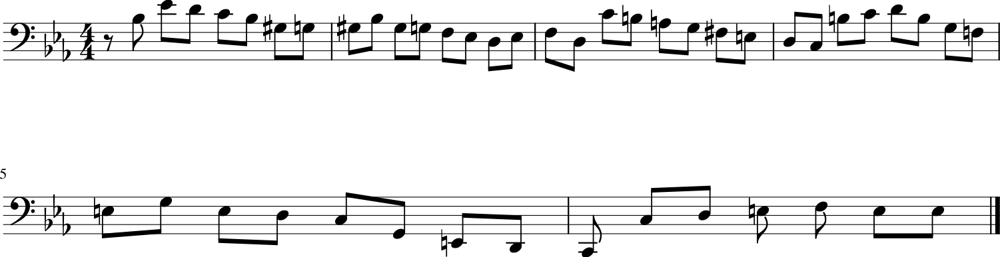

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5455 - loss: 1.2881 - note_outputs_loss: 0.7426
Epoch 331/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5048 - loss: 1.2605 - note_outputs_loss: 0.7556
Generation prompt: [['START', 'G:major'], ['0.0', '0.0']]


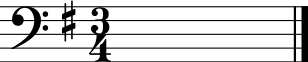

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5051 - loss: 1.2608 - note_outputs_loss: 0.7557
Epoch 332/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5173 - loss: 1.2314 - note_outputs_loss: 0.7141
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4', 'E4'], ['0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


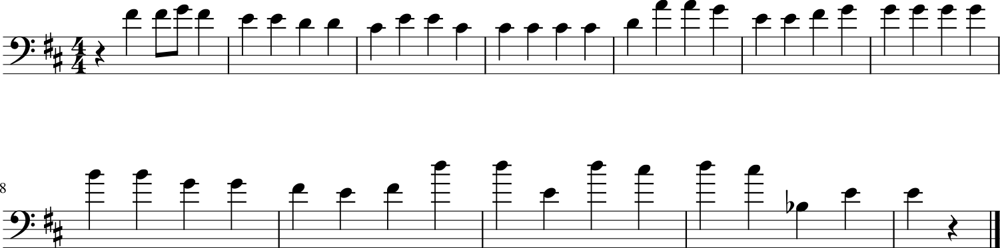

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5174 - loss: 1.2320 - note_outputs_loss: 0.7146
Epoch 333/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4932 - loss: 1.2592 - note_outputs_loss: 0.7660
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


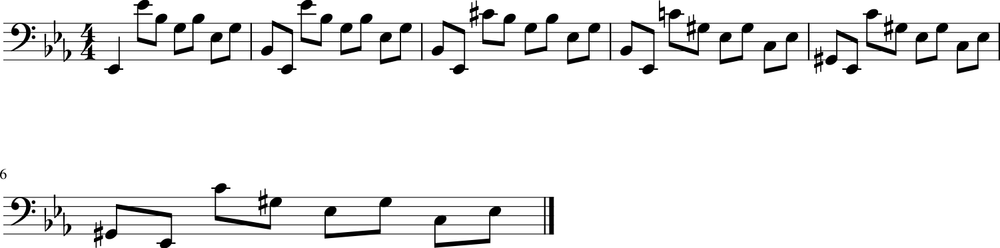

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4935 - loss: 1.2594 - note_outputs_loss: 0.7659
Epoch 334/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5441 - loss: 1.2679 - note_outputs_loss: 0.7237
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

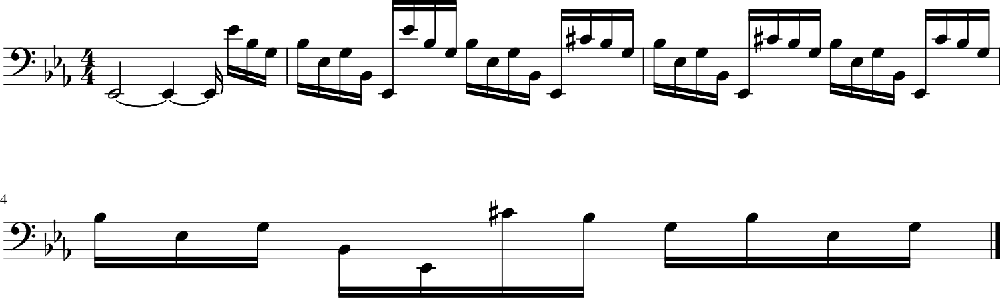

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5440 - loss: 1.2680 - note_outputs_loss: 0.7240
Epoch 335/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5056 - loss: 1.2396 - note_outputs_loss: 0.7340
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'C4', 'B-3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


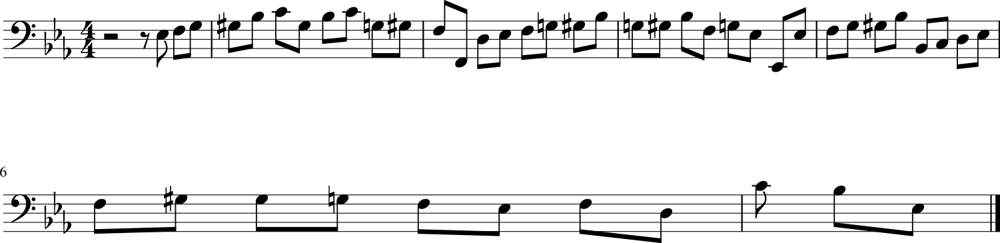

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5058 - loss: 1.2401 - note_outputs_loss: 0.7343
Epoch 336/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5130 - loss: 1.2550 - note_outputs_loss: 0.7420
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'F3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


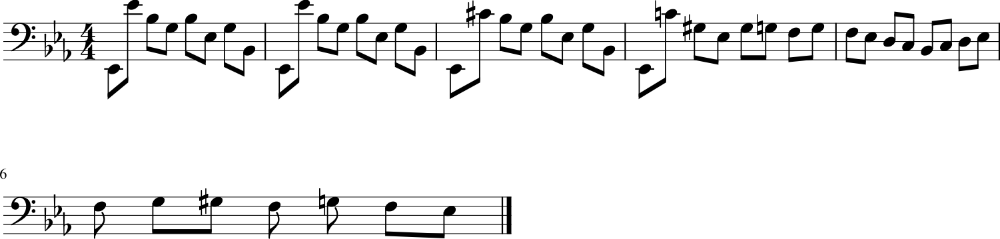

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5131 - loss: 1.2553 - note_outputs_loss: 0.7422
Epoch 337/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4948 - loss: 1.2008 - note_outputs_loss: 0.7059
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


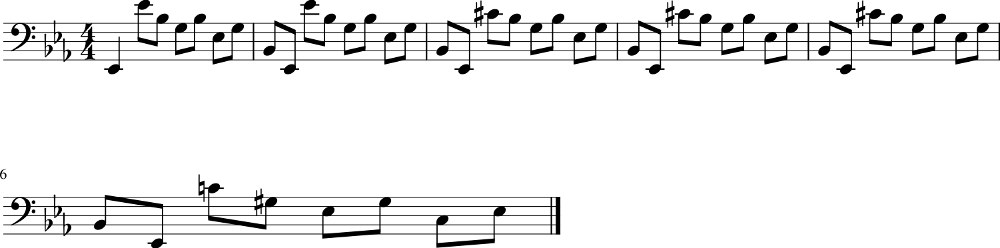

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4952 - loss: 1.2016 - note_outputs_loss: 0.7065
Epoch 338/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5763 - loss: 1.3349 - note_outputs_loss: 0.7586
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E3', 'C3', 'A2', 'B2', 'C3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


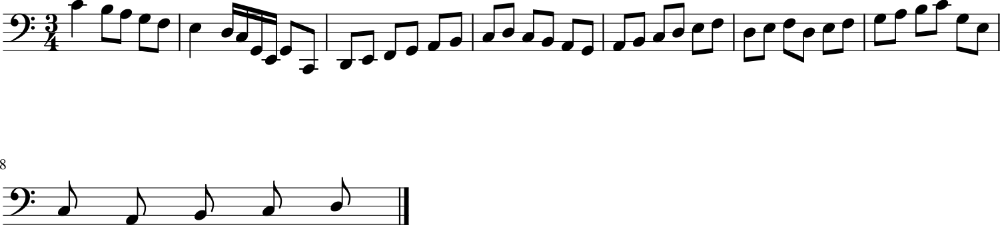

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5758 - loss: 1.3346 - note_outputs_loss: 0.7588
Epoch 339/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4992 - loss: 1.2717 - note_outputs_loss: 0.7725
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


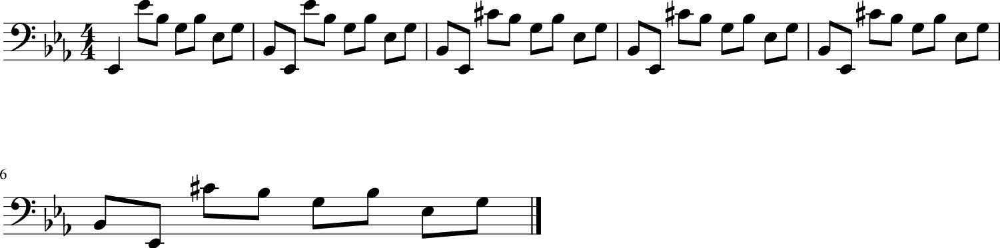

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4994 - loss: 1.2719 - note_outputs_loss: 0.7725
Epoch 340/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5562 - loss: 1.2992 - note_outputs_loss: 0.7430
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


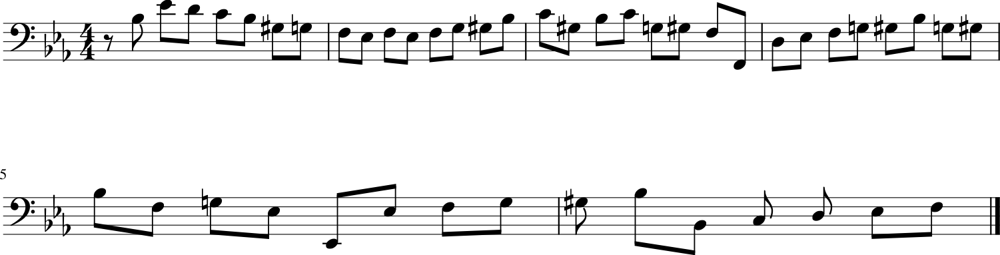

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5559 - loss: 1.2990 - note_outputs_loss: 0.7431
Epoch 341/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5489 - loss: 1.3140 - note_outputs_loss: 0.7651
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'G2', 'G3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


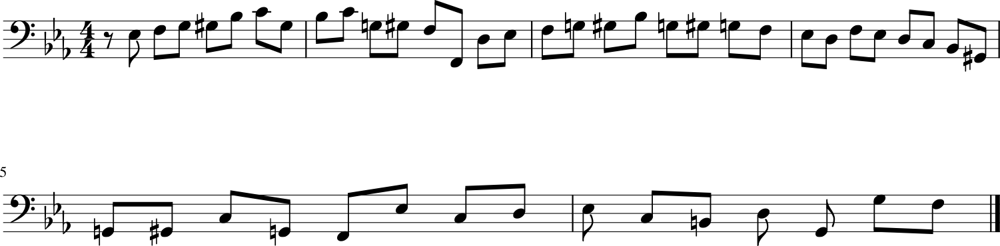

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5487 - loss: 1.3138 - note_outputs_loss: 0.7651
Epoch 342/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5340 - loss: 1.2933 - note_outputs_loss: 0.7593
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


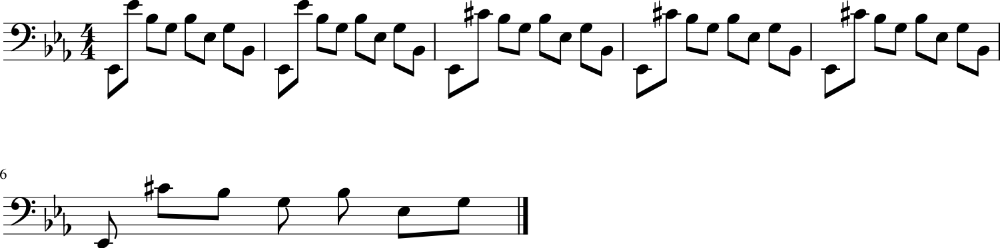

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5339 - loss: 1.2932 - note_outputs_loss: 0.7593
Epoch 343/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5227 - loss: 1.2561 - note_outputs_loss: 0.7334
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


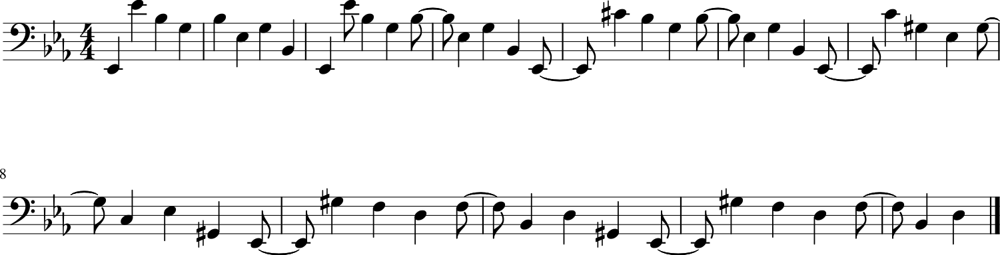

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5228 - loss: 1.2564 - note_outputs_loss: 0.7336
Epoch 344/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5320 - loss: 1.2638 - note_outputs_loss: 0.7318
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


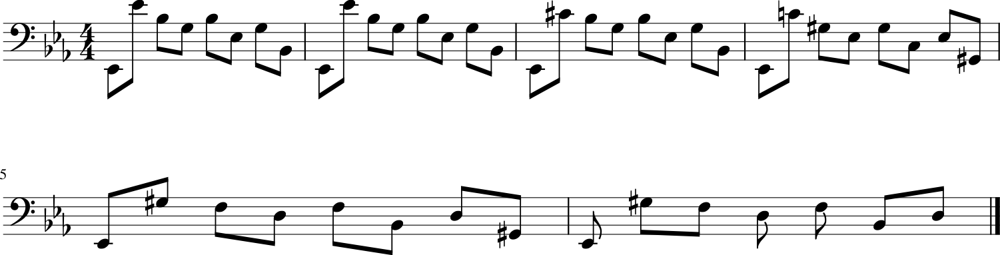

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5320 - loss: 1.2639 - note_outputs_loss: 0.7319
Epoch 345/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5258 - loss: 1.2919 - note_outputs_loss: 0.7660
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'G#3', 'B-3', 'C4', 'A3', 'F#3', 'F3', 'F#3', 'F#3', 'F#3', 'F#3', 'C4', 'F#3', 'C4'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


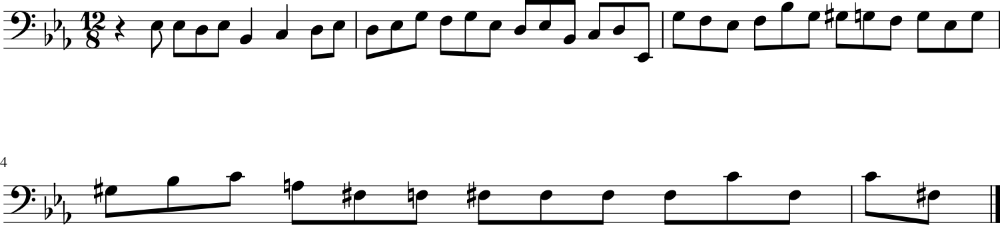

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5258 - loss: 1.2918 - note_outputs_loss: 0.7660
Epoch 346/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5292 - loss: 1.2878 - note_outputs_loss: 0.7586
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


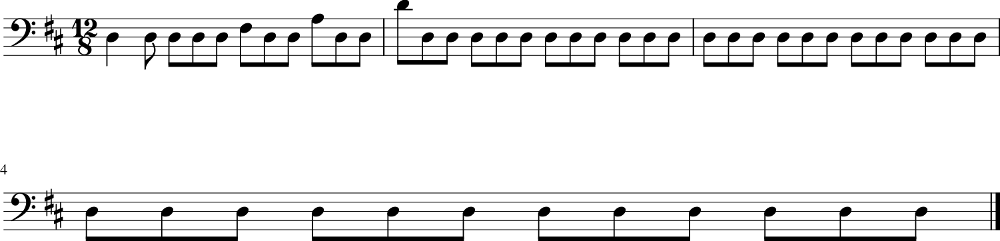

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5292 - loss: 1.2878 - note_outputs_loss: 0.7586
Epoch 347/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4935 - loss: 1.2547 - note_outputs_loss: 0.7612
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'D3', 'B2', 'G2', 'G2', 'D3', 'F3', 'B2', 'F3', 'G2', 'F3', 'D3', 'F3', 'B2', 'F3', 'G2', 'F3', 'D3', 'F3', 'B2', 'F3', 'G2', 'E-3', 'C3', 'E-3', 'B2', 'E-3', 'G2', 'B3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


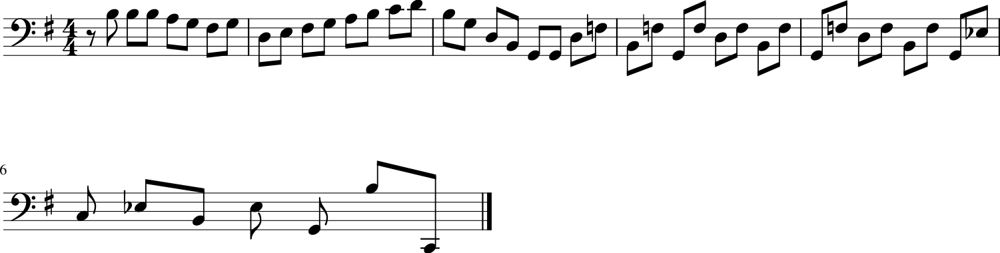

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4938 - loss: 1.2549 - note_outputs_loss: 0.7611
Epoch 348/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5176 - loss: 1.2245 - note_outputs_loss: 0.7069
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'C#3', 'G3', 'A3', 'F3', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'G3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'F3', 'B-2', 'A2', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'C3', 'B-2', 'B-3', 'C4', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


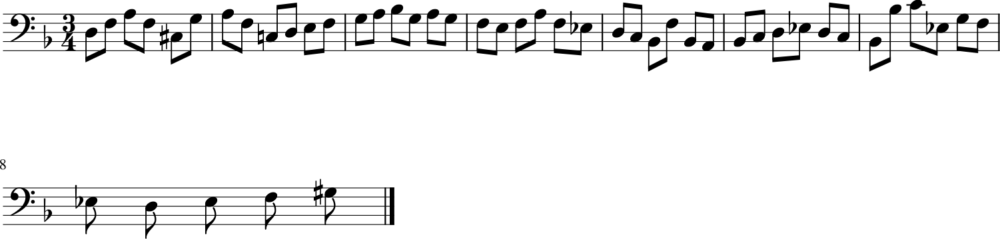

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5177 - loss: 1.2250 - note_outputs_loss: 0.7073
Epoch 349/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5692 - loss: 1.2986 - note_outputs_loss: 0.7294
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'E-4', 'C4', 'D4', 'G3', 'B-3', 'A3', 'G3', 'D3', 'G3', 'F#3', 'G3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'E3', 'F3', 'G3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


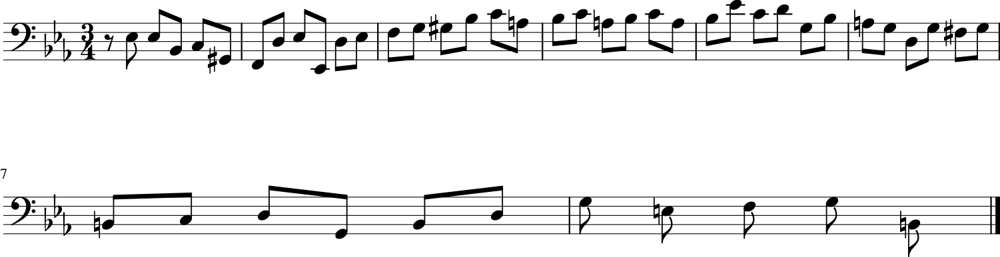

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5688 - loss: 1.2985 - note_outputs_loss: 0.7297
Epoch 350/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5058 - loss: 1.2335 - note_outputs_loss: 0.7277
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'C4', 'C4', 'G3', 'E3', 'C3', 'G2', 'E2', 'C2', 'C4', 'D4', 'C4', 'B3', 'C4', 'D4', 'B3', 'G3', 'D3', 'B2', 'G2', 'F2', 'D4', 'C4', 'B3', 'A3', 'G3', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'F3', 'D3', 'G2', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'G3', 'F3'], ['0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


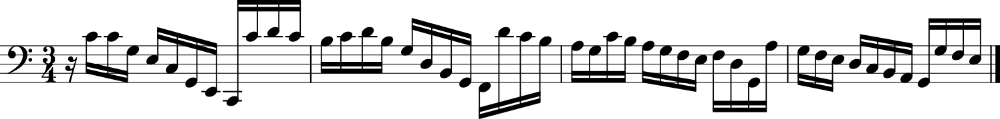

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5060 - loss: 1.2340 - note_outputs_loss: 0.7279
Epoch 351/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5417 - loss: 1.2481 - note_outputs_loss: 0.7064
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


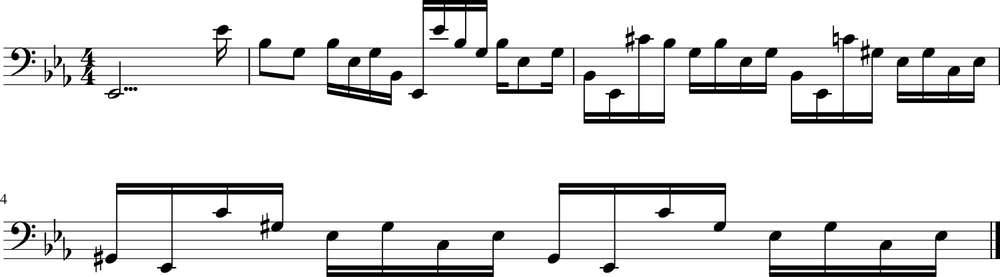

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5416 - loss: 1.2483 - note_outputs_loss: 0.7067
Epoch 352/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5055 - loss: 1.2263 - note_outputs_loss: 0.7208
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.25', '0.25', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


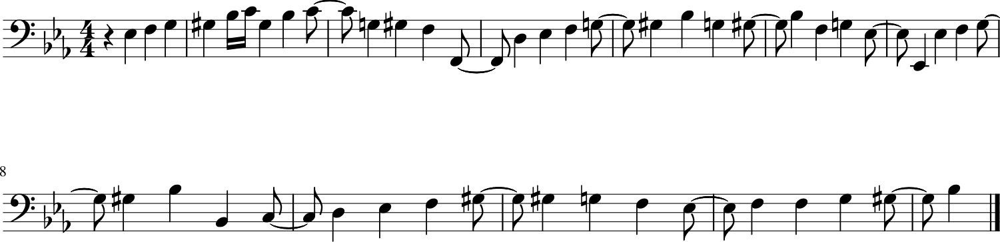

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5057 - loss: 1.2268 - note_outputs_loss: 0.7211
Epoch 353/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5159 - loss: 1.2473 - note_outputs_loss: 0.7314
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'D3', 'C3', 'G2', 'F2', 'A3', 'D3', 'B2', 'C3', 'G#2', 'C3', 'E-3', 'G2', 'C3', 'F2', 'G#2', 'D3', 'F3', 'G#3', 'C3', 'B2', 'D3', 'G3', 'B3', 'D4', 'F3', 'E-3', 'G3', 'C4', 'G3', 'C4', 'B3', 'C4', 'B3', 'C4', 'G3', 'A3', 'B3', 'C4', 'B3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


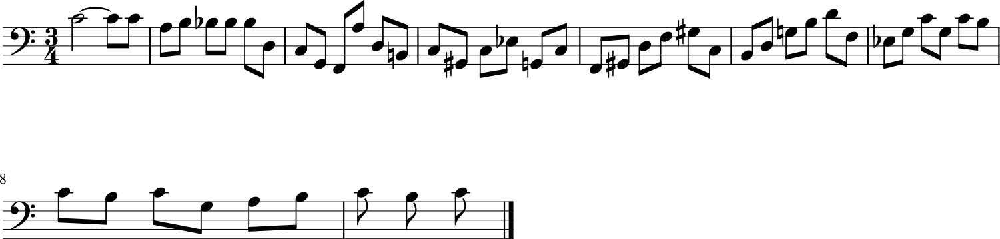

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5161 - loss: 1.2476 - note_outputs_loss: 0.7315
Epoch 354/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5120 - loss: 1.2587 - note_outputs_loss: 0.7467
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'B-3', 'E-4', 'G3', 'F3', 'E-3', 'B-2', 'D4', 'E-4', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'B-3'], ['0.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


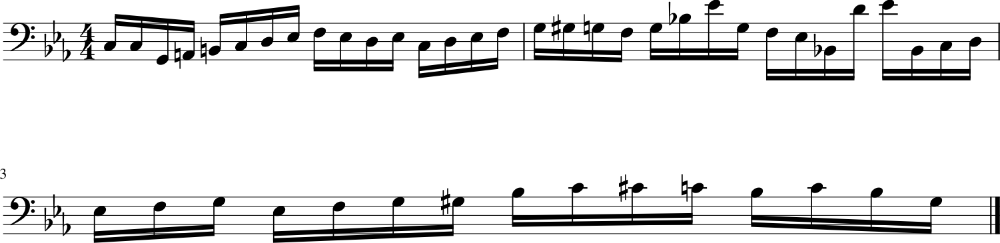

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5121 - loss: 1.2590 - note_outputs_loss: 0.7469
Epoch 355/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5341 - loss: 1.2347 - note_outputs_loss: 0.7006
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'E4', 'E4', 'C#4', 'C#4', 'A3', 'A3', 'G3', 'G3', 'A4', 'A4', 'F#4', 'F#4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


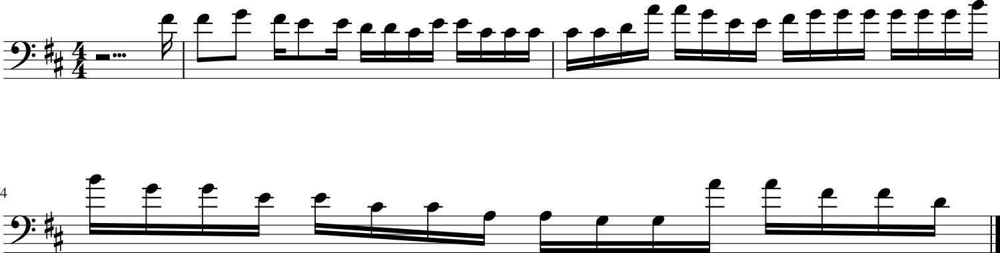

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5341 - loss: 1.2351 - note_outputs_loss: 0.7010
Epoch 356/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5169 - loss: 1.2435 - note_outputs_loss: 0.7266
Generation prompt: [['START', 'E-:major', '3/4TS', 'D4', 'E3', 'E3', 'D3', 'C3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'C3', 'G2', 'C#3', 'B-3', 'A3', 'D3', 'B3', 'F#2', 'A2', 'D3', 'E3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A2', 'F#2', 'D2', 'D3', 'A2', 'B2', 'D3', 'F3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


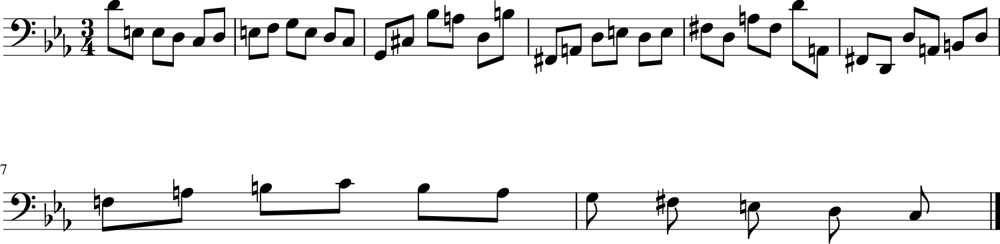

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5170 - loss: 1.2438 - note_outputs_loss: 0.7268
Epoch 357/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5378 - loss: 1.2630 - note_outputs_loss: 0.7251
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


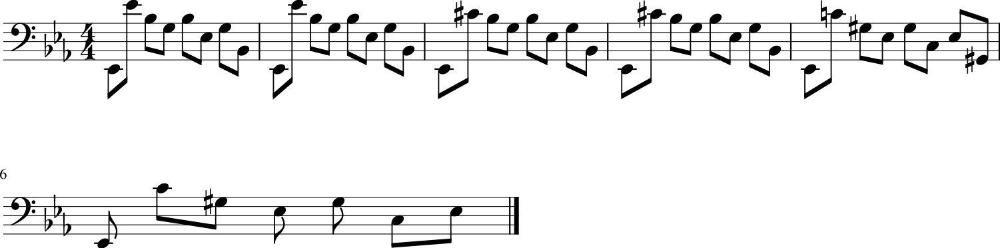

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5377 - loss: 1.2631 - note_outputs_loss: 0.7254
Epoch 358/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5068 - loss: 1.2579 - note_outputs_loss: 0.7511
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'B-2', 'E-2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


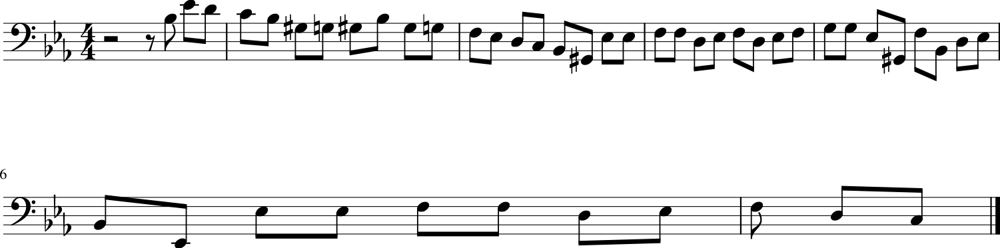

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5070 - loss: 1.2582 - note_outputs_loss: 0.7512
Epoch 359/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5607 - loss: 1.2853 - note_outputs_loss: 0.7245
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


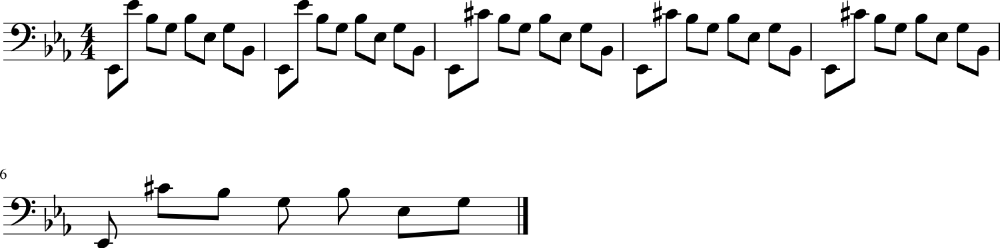

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5604 - loss: 1.2851 - note_outputs_loss: 0.7247
Epoch 360/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - duration_outputs_loss: 0.5387 - loss: 1.2834 - note_outputs_loss: 0.7447
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


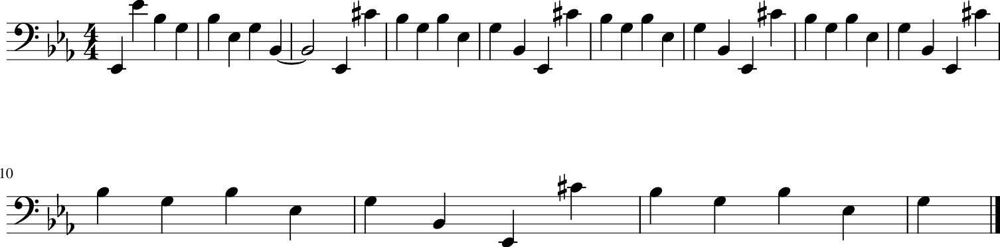

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5386 - loss: 1.2834 - note_outputs_loss: 0.7448
Epoch 361/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5131 - loss: 1.2424 - note_outputs_loss: 0.7293
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'A3', 'B-3', 'G3', 'E3', 'F3', 'A3', 'C#3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'E-2', 'C4', 'B3', 'A3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E-3', 'B2', 'C3', 'F#2', 'G2', 'B3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


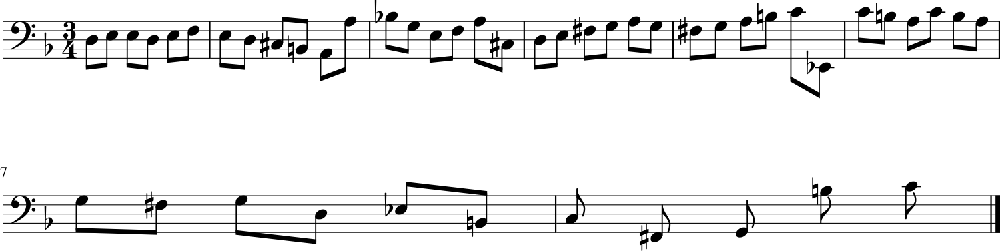

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5132 - loss: 1.2427 - note_outputs_loss: 0.7295
Epoch 362/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5576 - loss: 1.2959 - note_outputs_loss: 0.7382
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


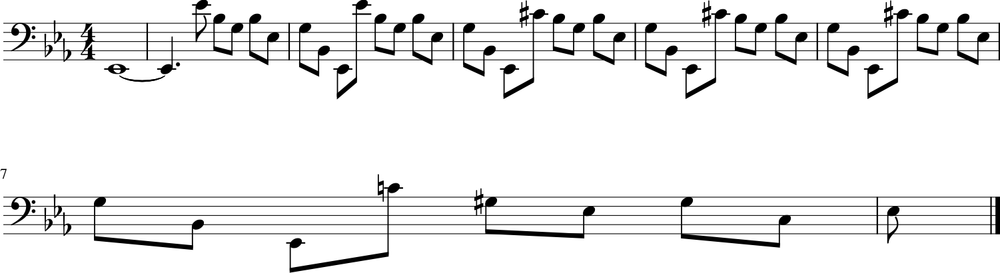

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5573 - loss: 1.2957 - note_outputs_loss: 0.7384
Epoch 363/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5272 - loss: 1.2512 - note_outputs_loss: 0.7240
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'D3', 'G3', 'D3', 'B2', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'A3', 'B3', 'A3', 'A3', 'F#3', 'A3', 'G3', 'A3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'F#3', 'B2', 'D3', 'G#3', 'A3', 'B3', 'D4', 'A2', 'D4', 'C4', 'B3', 'C4', 'E-3', 'F#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


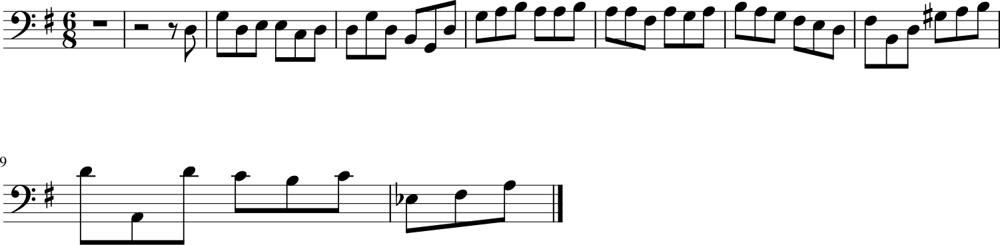

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5272 - loss: 1.2514 - note_outputs_loss: 0.7242
Epoch 364/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5179 - loss: 1.2613 - note_outputs_loss: 0.7435
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4', 'E4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


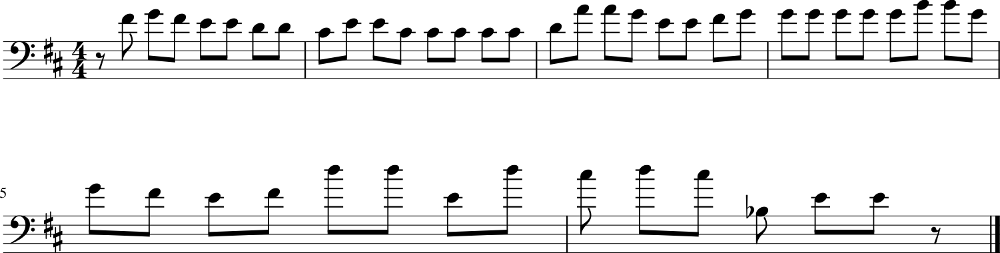

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5180 - loss: 1.2615 - note_outputs_loss: 0.7436
Epoch 365/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5262 - loss: 1.2397 - note_outputs_loss: 0.7136
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


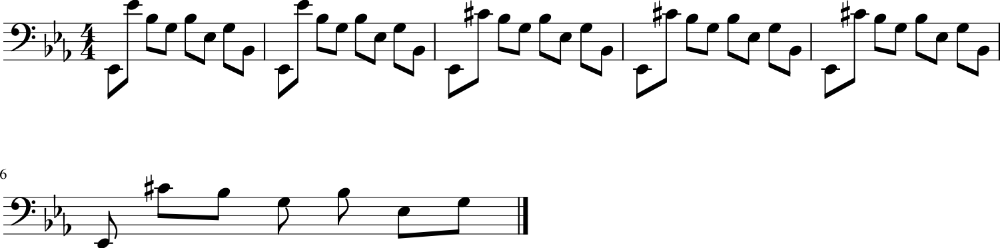

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5261 - loss: 1.2400 - note_outputs_loss: 0.7139
Epoch 366/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5375 - loss: 1.2539 - note_outputs_loss: 0.7165
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

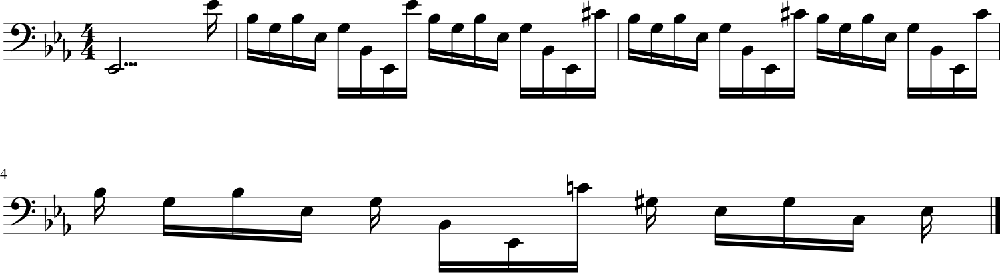

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5374 - loss: 1.2541 - note_outputs_loss: 0.7168
Epoch 367/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5455 - loss: 1.2659 - note_outputs_loss: 0.7204
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4', 'E4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


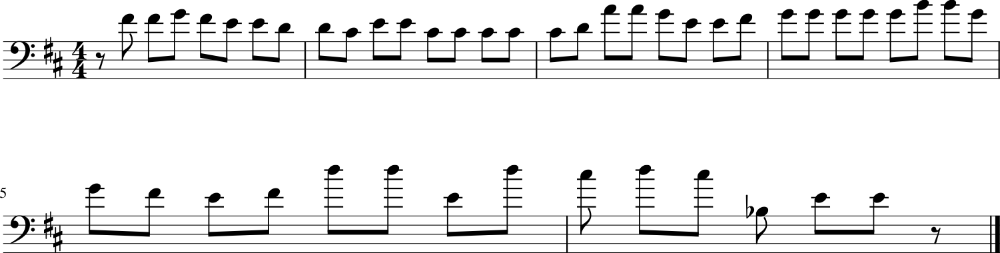

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5454 - loss: 1.2659 - note_outputs_loss: 0.7206
Epoch 368/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5311 - loss: 1.2835 - note_outputs_loss: 0.7524
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


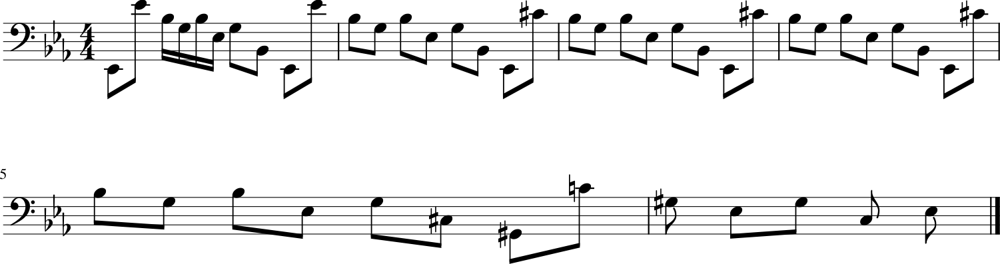

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5311 - loss: 1.2835 - note_outputs_loss: 0.7524
Epoch 369/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5223 - loss: 1.2627 - note_outputs_loss: 0.7404
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'B-3', 'G3', 'A3', 'F3', 'D3', 'F3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F2', 'E2', 'G2', 'C3', 'E2', 'D2', 'B2', 'C3', 'E3', 'G3', 'C4', 'D4', 'C4', 'B3', 'C4', 'A3', 'B3', 'G3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


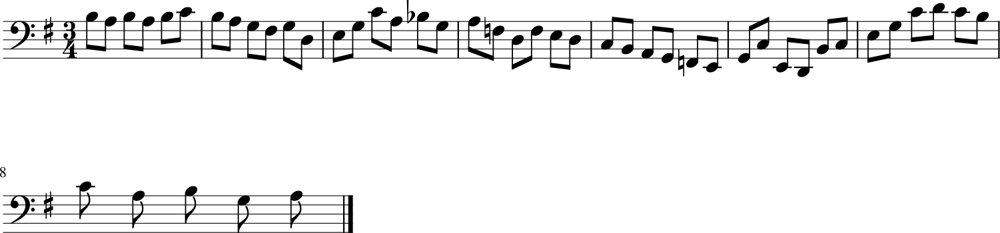

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5224 - loss: 1.2629 - note_outputs_loss: 0.7405
Epoch 370/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5261 - loss: 1.2247 - note_outputs_loss: 0.6986
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


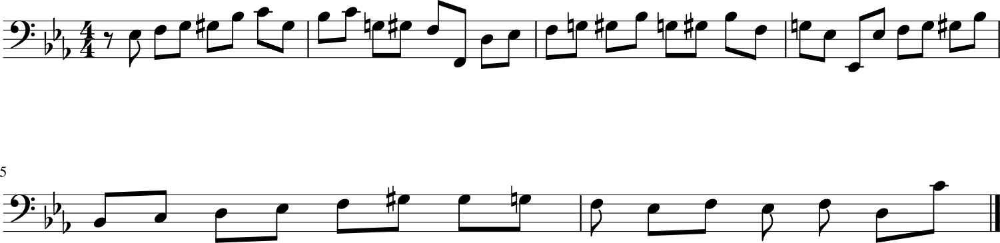

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5261 - loss: 1.2251 - note_outputs_loss: 0.6990
Epoch 371/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5233 - loss: 1.2365 - note_outputs_loss: 0.7131
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'D3', 'B-2', 'G2', 'B-2', 'F2', 'D3', 'E-3', 'B-2', 'C3', 'B-2', 'G2', 'B-2', 'D3', 'G2', 'E-2', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'B-3', 'D3', 'G#3', 'C3', 'D3', 'B2', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


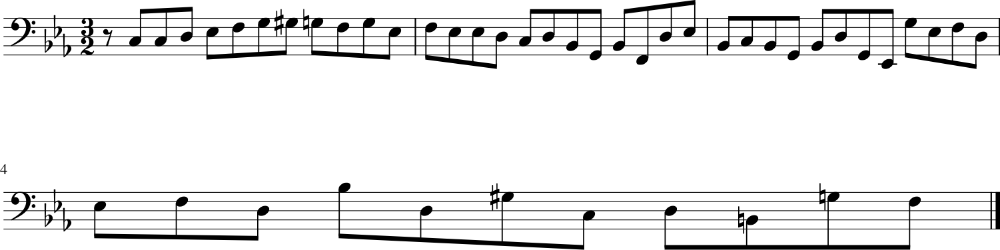

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5234 - loss: 1.2368 - note_outputs_loss: 0.7134
Epoch 372/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5425 - loss: 1.2629 - note_outputs_loss: 0.7204
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


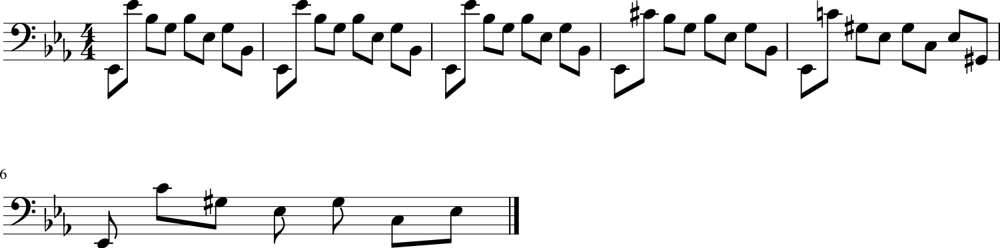

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5424 - loss: 1.2630 - note_outputs_loss: 0.7207
Epoch 373/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5285 - loss: 1.2637 - note_outputs_loss: 0.7353
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'F2', 'G2', 'D3', 'D3', 'D3', 'C3', 'C3', 'G3', 'G#2', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'G#2', 'G2', 'F2', 'E-2', 'G2', 'B2', 'D3', 'F3', 'G#3', 'G3', 'D3', 'E-3', 'G2', 'C3', 'B2'], ['0.0', '2.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


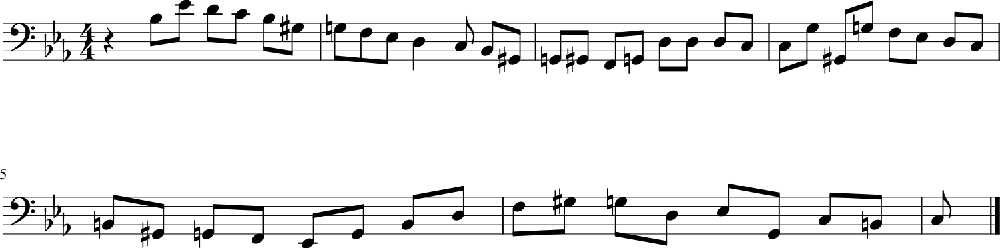

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5284 - loss: 1.2638 - note_outputs_loss: 0.7353
Epoch 374/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5510 - loss: 1.2830 - note_outputs_loss: 0.7320
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'C3', 'B2', 'C3', 'E-2', 'G2', 'C2', 'E-3', 'G3', 'G#3', 'F3', 'G3', 'B-3', 'A3', 'B-3', 'D3', 'E-3', 'F3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3'], ['0.0', '1.0', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


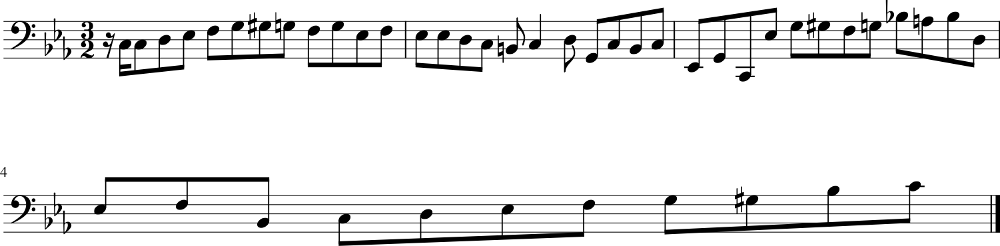

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5508 - loss: 1.2829 - note_outputs_loss: 0.7321
Epoch 375/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5251 - loss: 1.2104 - note_outputs_loss: 0.6853
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'G#3', 'G#3', 'F3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'D3', 'D3', 'D3', 'D3', 'E3', 'B-2', 'G#2', 'B-2', 'G2', 'G#2', 'B-2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


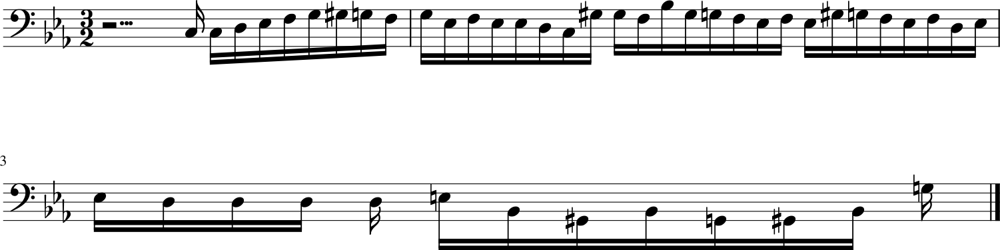

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5251 - loss: 1.2110 - note_outputs_loss: 0.6858
Epoch 376/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5401 - loss: 1.2564 - note_outputs_loss: 0.7163
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


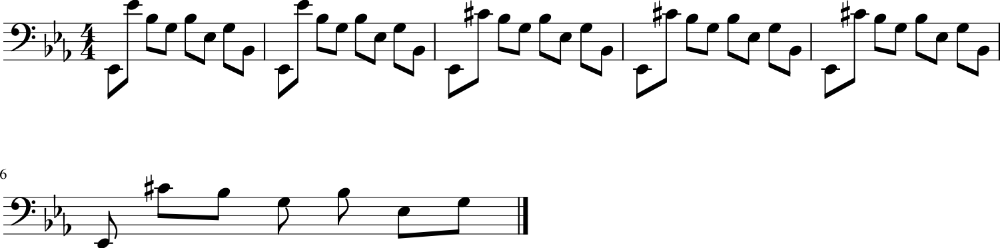

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5400 - loss: 1.2566 - note_outputs_loss: 0.7166
Epoch 377/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5531 - loss: 1.2499 - note_outputs_loss: 0.6968
Generation prompt: [['START', 'E-:major', '12/8TS', 'D3', 'E-3', 'D3', 'E-3', 'B-2', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3'], ['0.0', '1.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


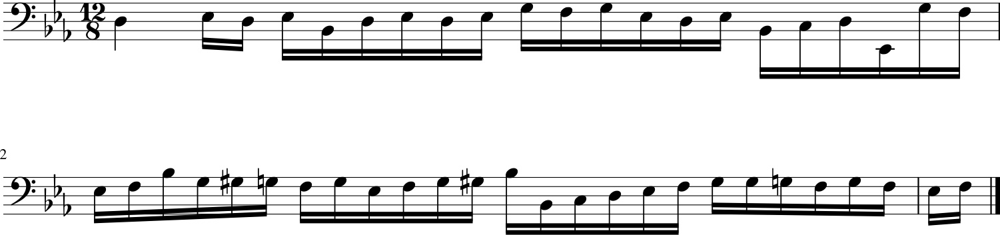

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5528 - loss: 1.2501 - note_outputs_loss: 0.6973
Epoch 378/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5251 - loss: 1.2154 - note_outputs_loss: 0.6903
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'E-3', 'B-2', 'D3', 'E-2', 'G2', 'E-3', 'B-2', 'E-3', 'G3', 'B-3', 'A3', 'B-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


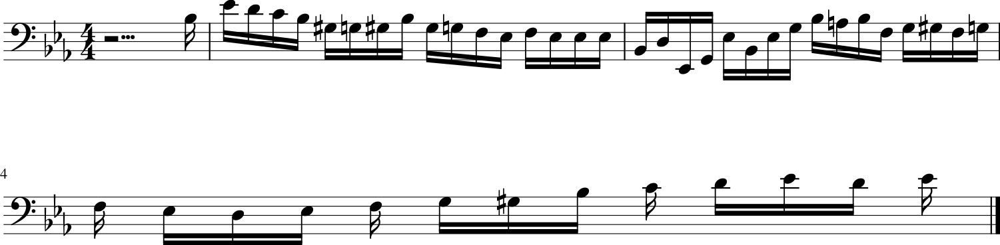

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5252 - loss: 1.2158 - note_outputs_loss: 0.6907
Epoch 379/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5574 - loss: 1.2631 - note_outputs_loss: 0.7057
Generation prompt: [['START', 'E-:major', '12/8TS', '3/4TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'G3', 'F3', 'E-3', 'E-3', 'rest'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


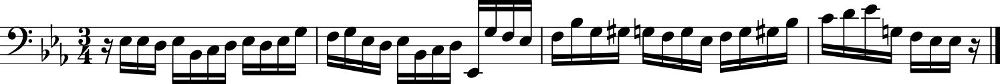

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5571 - loss: 1.2632 - note_outputs_loss: 0.7061
Epoch 380/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5327 - loss: 1.2362 - note_outputs_loss: 0.7035
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'C4', 'D4', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'B-2', 'D3', 'F3', 'B-3', 'A3', 'B-3', 'C4', 'D4', 'E-4', 'F3', 'G3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'D4', 'E-4'], ['0.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


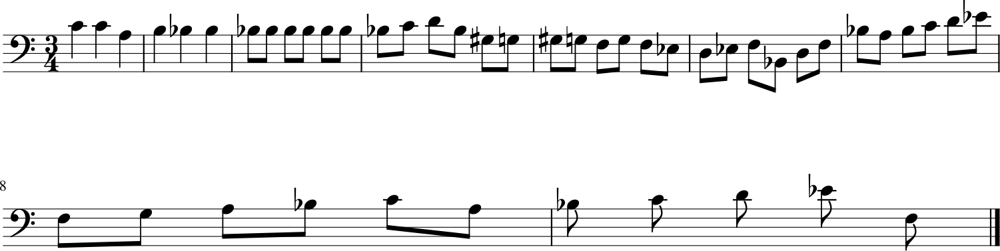

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5326 - loss: 1.2365 - note_outputs_loss: 0.7039
Epoch 381/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4864 - loss: 1.1828 - note_outputs_loss: 0.6964
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#3', 'F3', 'G3', 'B-3', 'D3', 'E-3', 'G2', 'B-2', 'E-2', 'E-3', 'G3', 'G#3', 'F3', 'G3', 'B-3', 'A3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


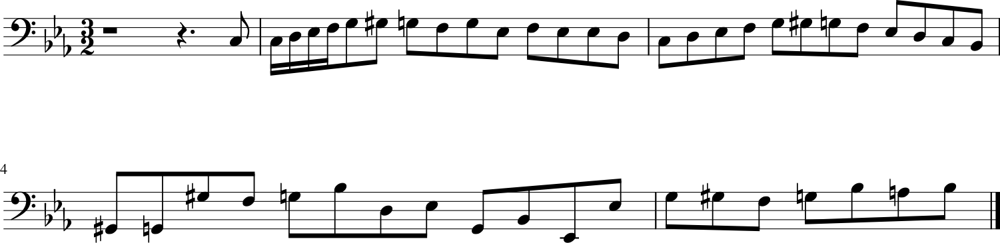

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4867 - loss: 1.1836 - note_outputs_loss: 0.6968
Epoch 382/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5315 - loss: 1.2400 - note_outputs_loss: 0.7085
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]

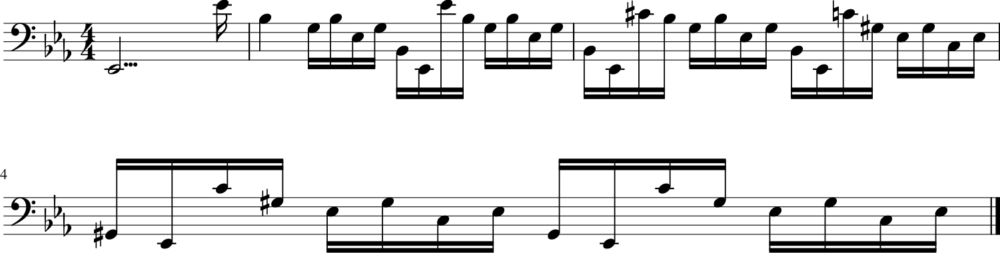

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5314 - loss: 1.2402 - note_outputs_loss: 0.7088
Epoch 383/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5406 - loss: 1.2540 - note_outputs_loss: 0.7135
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'A3', 'D3', 'B-3', 'D3', 'B3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'A3', 'F3', 'D3', 'B3', 'E3', 'G3', 'C4', 'A3', 'G3', 'D4', 'D4', 'C#4', 'D4', 'A3', 'rest', 'E3', 'D2', 'rest'], ['0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


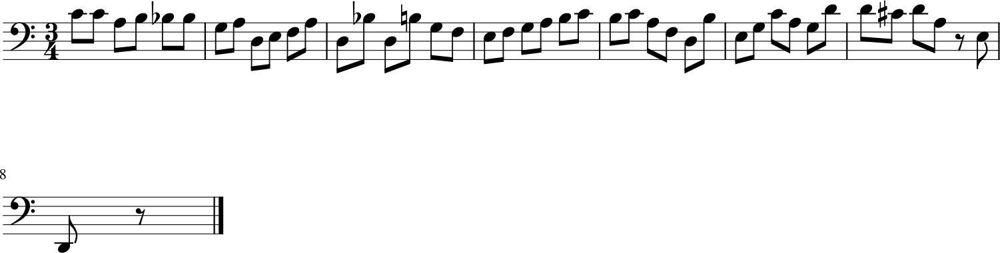

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5404 - loss: 1.2541 - note_outputs_loss: 0.7137
Epoch 384/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5554 - loss: 1.2900 - note_outputs_loss: 0.7347
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'D4', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


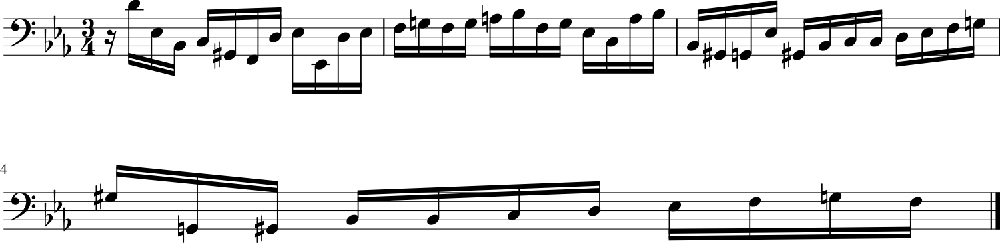

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5551 - loss: 1.2899 - note_outputs_loss: 0.7347
Epoch 385/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5161 - loss: 1.2216 - note_outputs_loss: 0.7055
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


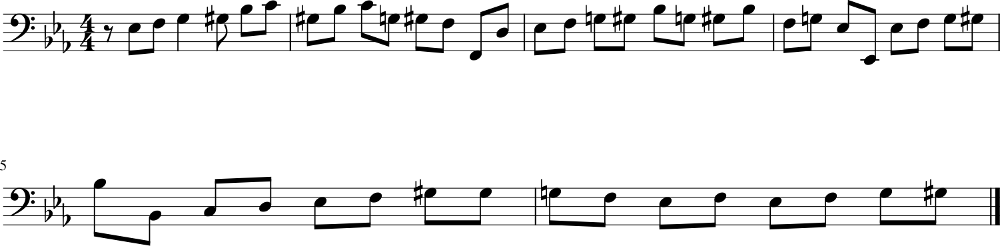

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5162 - loss: 1.2220 - note_outputs_loss: 0.7058
Epoch 386/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4702 - loss: 1.1617 - note_outputs_loss: 0.6915
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '3.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


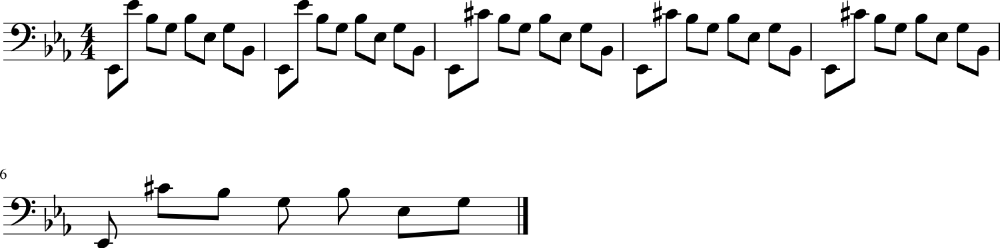

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4707 - loss: 1.1627 - note_outputs_loss: 0.6920
Epoch 387/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4977 - loss: 1.2574 - note_outputs_loss: 0.7598
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'F2', 'G2', 'D3', 'D3', 'D3', 'C3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


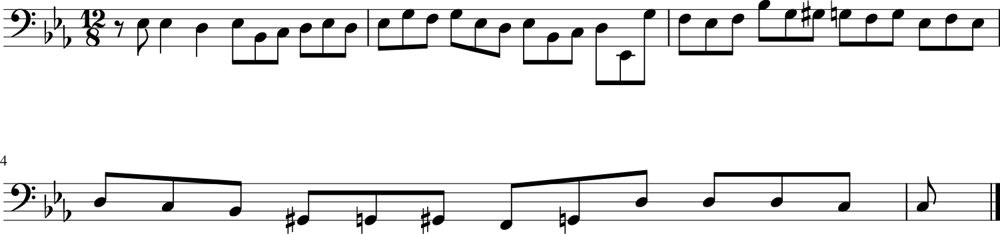

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4979 - loss: 1.2576 - note_outputs_loss: 0.7597
Epoch 388/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5463 - loss: 1.2732 - note_outputs_loss: 0.7269
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'G3', 'F#3', 'G3', 'D3', 'C4', 'E3', 'C3', 'G3', 'A3', 'B3', 'C4', 'D4', 'A3', 'F#3', 'G3', 'D3', 'C3', 'B2', 'G2', 'F2', 'A2', 'B2', 'C3', 'E-2', 'D2', 'E-2', 'C2', 'D2', 'E-2', 'F2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


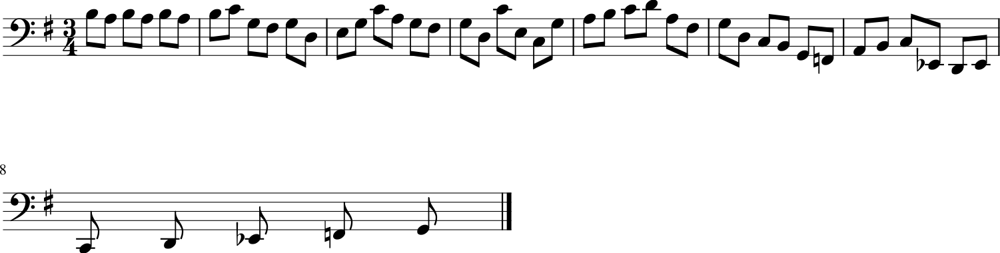

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5461 - loss: 1.2732 - note_outputs_loss: 0.7270
Epoch 389/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5025 - loss: 1.2091 - note_outputs_loss: 0.7067
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


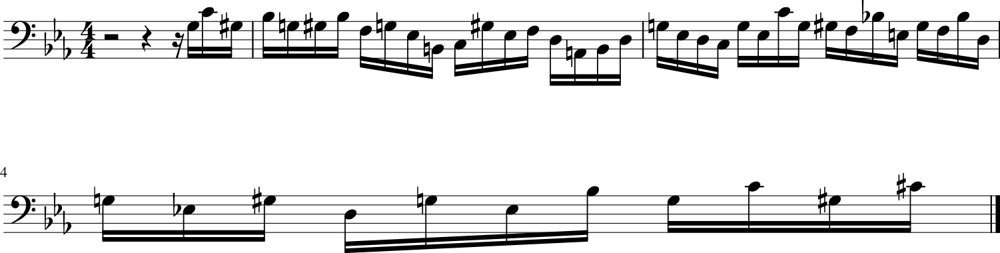

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5027 - loss: 1.2097 - note_outputs_loss: 0.7070
Epoch 390/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5203 - loss: 1.2253 - note_outputs_loss: 0.7050
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'E4', 'G3', 'E-4', 'E4', 'G4', 'A3', 'F#4', 'B3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


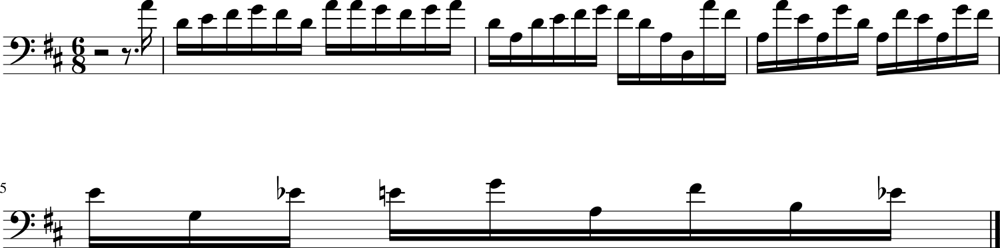

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5204 - loss: 1.2257 - note_outputs_loss: 0.7053
Epoch 391/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5336 - loss: 1.2369 - note_outputs_loss: 0.7033
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'C4', 'D4', 'E-4', 'G3', 'F3', 'E-3', 'E-3', 'rest', 'F3', 'F3', 'D3', 'G3', 'E-3', 'A2', 'F3', 'D3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


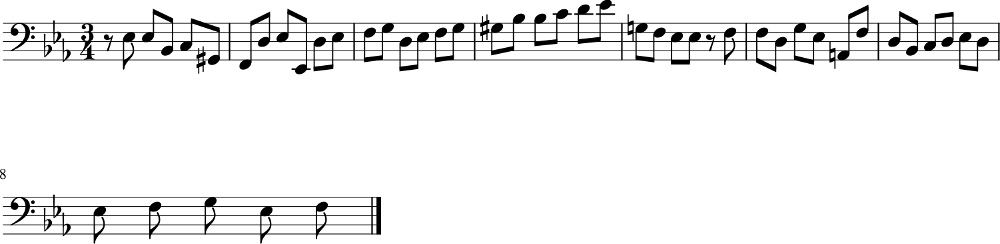

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5336 - loss: 1.2371 - note_outputs_loss: 0.7035
Epoch 392/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4714 - loss: 1.1898 - note_outputs_loss: 0.7184
Generation prompt: [['START', 'E-:major', '12/8TS', '3/4TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B2', 'C3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


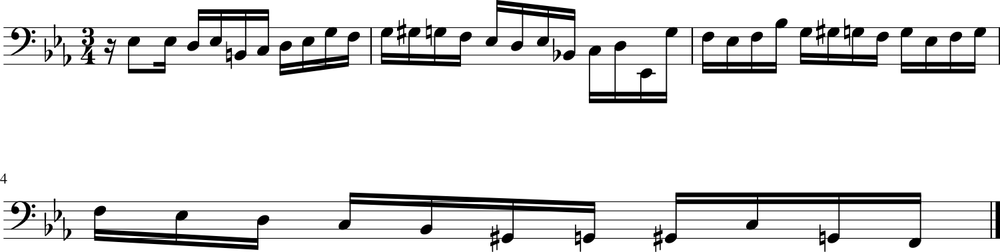

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4719 - loss: 1.1906 - note_outputs_loss: 0.7187
Epoch 393/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5132 - loss: 1.2068 - note_outputs_loss: 0.6936
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'C3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'C3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


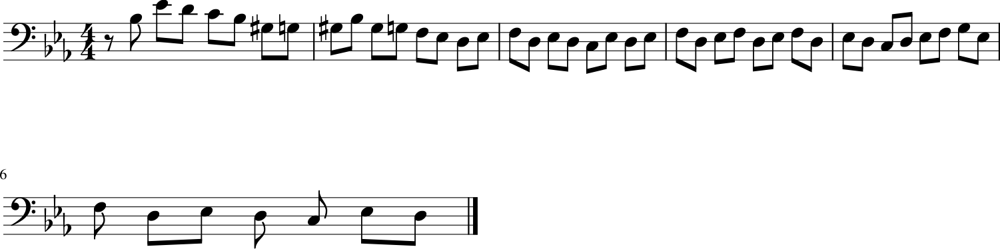

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5133 - loss: 1.2073 - note_outputs_loss: 0.6939
Epoch 394/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5731 - loss: 1.2956 - note_outputs_loss: 0.7225
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


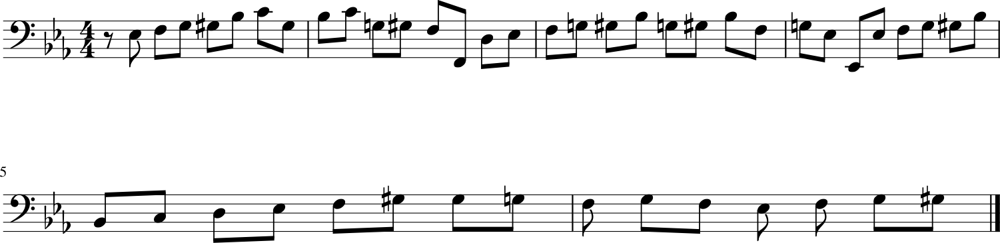

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5727 - loss: 1.2953 - note_outputs_loss: 0.7226
Epoch 395/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5678 - loss: 1.2675 - note_outputs_loss: 0.6997
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'B-3', 'D4', 'G3', 'E-3', 'C4', 'A3', 'F3', 'A3', 'C4', 'B3', 'A3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


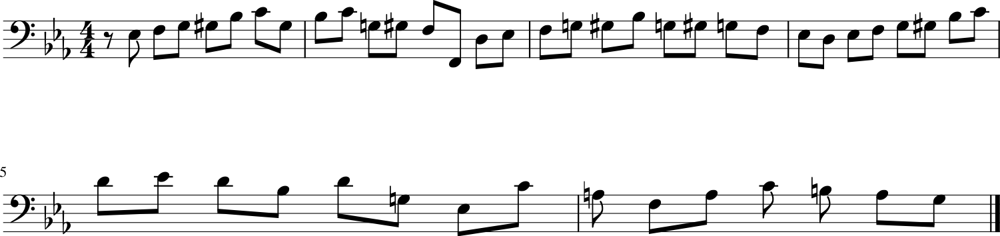

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5674 - loss: 1.2673 - note_outputs_loss: 0.6999
Epoch 396/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5835 - loss: 1.3163 - note_outputs_loss: 0.7328
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


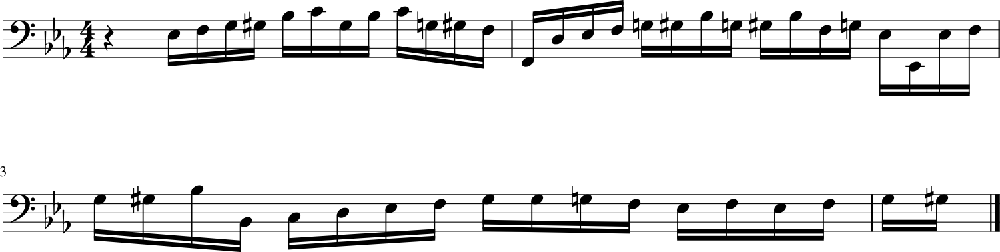

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5830 - loss: 1.3159 - note_outputs_loss: 0.7328
Epoch 397/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5074 - loss: 1.2138 - note_outputs_loss: 0.7064
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'C3', 'E-3', 'G2', 'C3', 'B2', 'C3', 'D3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


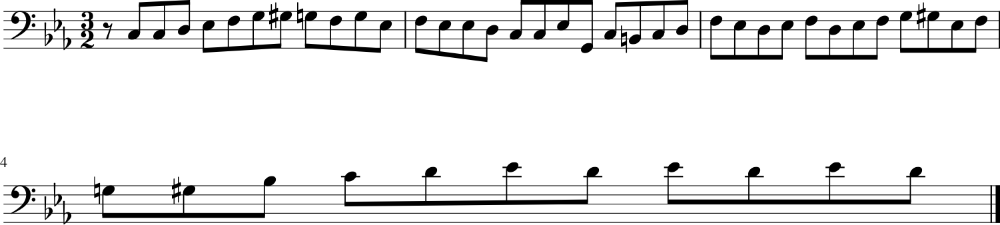

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5075 - loss: 1.2142 - note_outputs_loss: 0.7067
Epoch 398/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5392 - loss: 1.2290 - note_outputs_loss: 0.6898
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


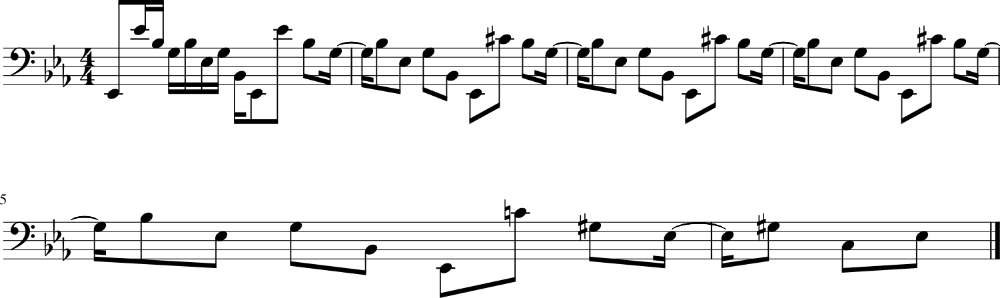

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5390 - loss: 1.2293 - note_outputs_loss: 0.6902
Epoch 399/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5393 - loss: 1.2438 - note_outputs_loss: 0.7045
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


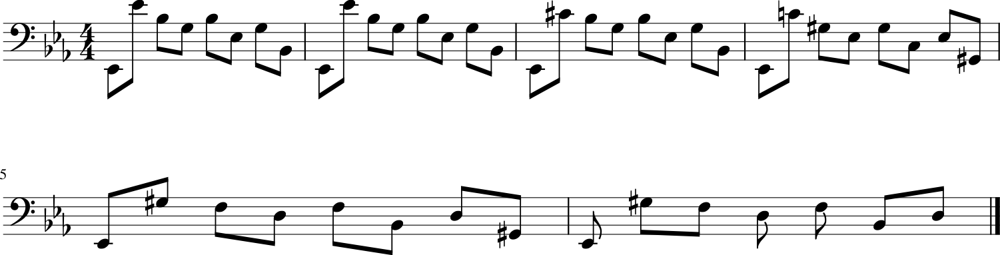

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5391 - loss: 1.2440 - note_outputs_loss: 0.7048
Epoch 400/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4898 - loss: 1.1776 - note_outputs_loss: 0.6878
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


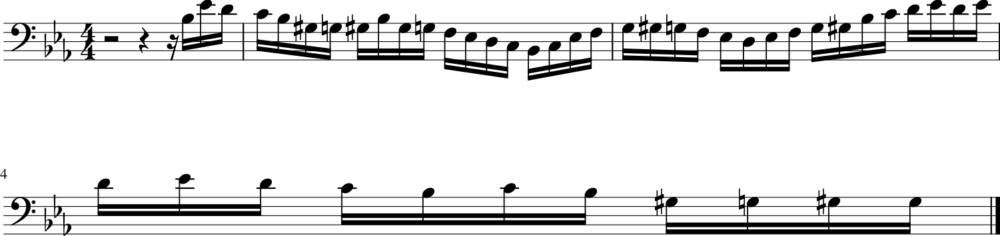

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4901 - loss: 1.1783 - note_outputs_loss: 0.6882
Epoch 401/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5258 - loss: 1.2117 - note_outputs_loss: 0.6859
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-2', 'G#3', 'F3', 'E-3', 'B-2', 'E-3', 'G2', 'B-2', 'E-2', 'G2', 'B-2', 'E-3', 'B-2', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'A2', 'C3', 'F#3', 'A3', 'F#3', 'C4', 'A3', 'F#3', 'C4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


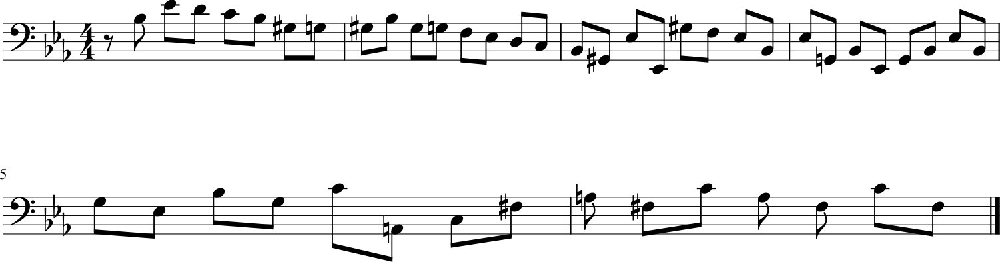

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5258 - loss: 1.2120 - note_outputs_loss: 0.6863
Epoch 402/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5009 - loss: 1.2101 - note_outputs_loss: 0.7092
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


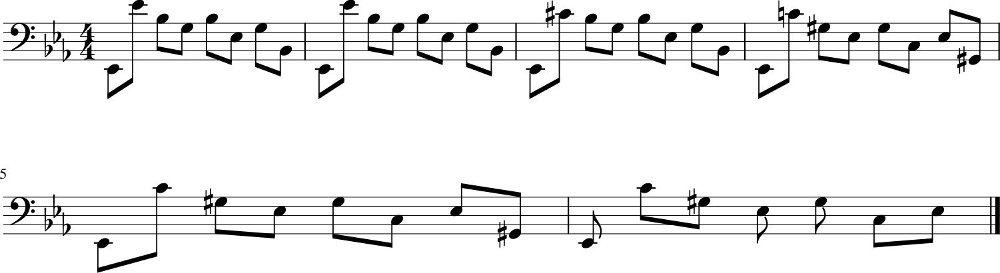

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5011 - loss: 1.2105 - note_outputs_loss: 0.7094
Epoch 403/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5523 - loss: 1.2561 - note_outputs_loss: 0.7038
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'A3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'C4', 'D4', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'B-3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'D4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


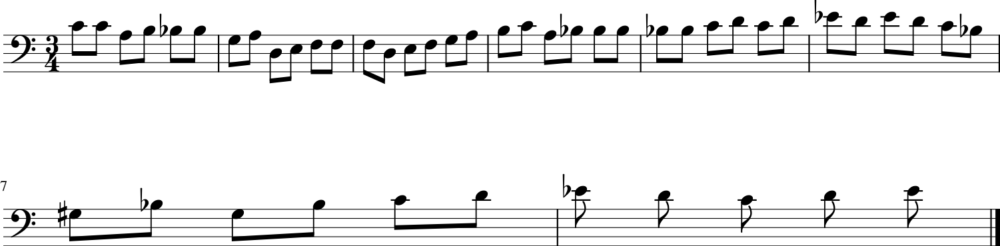

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5521 - loss: 1.2561 - note_outputs_loss: 0.7040
Epoch 404/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5410 - loss: 1.2599 - note_outputs_loss: 0.7188
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'F#2', 'A3', 'G2', 'B2', 'E3', 'G3', 'D3', 'C#3', 'B2', 'C#3', 'A2'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


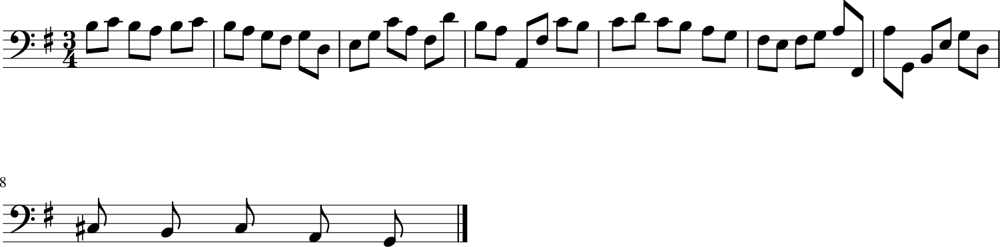

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5409 - loss: 1.2598 - note_outputs_loss: 0.7190
Epoch 405/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5115 - loss: 1.2034 - note_outputs_loss: 0.6919
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'E-4', 'D4', 'C#4', 'C#4', 'C#4', 'D4', 'C#4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'G4', 'E4', 'E4', 'C#4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C#3', 'D3', 'B-2', 'A2', 'G2', 'A2', 'B-2', 'G2', 'A2', 'F2', 'E2', 'C#3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'D3', 'E3', 'F3', 'G3', 'E3', 'F3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


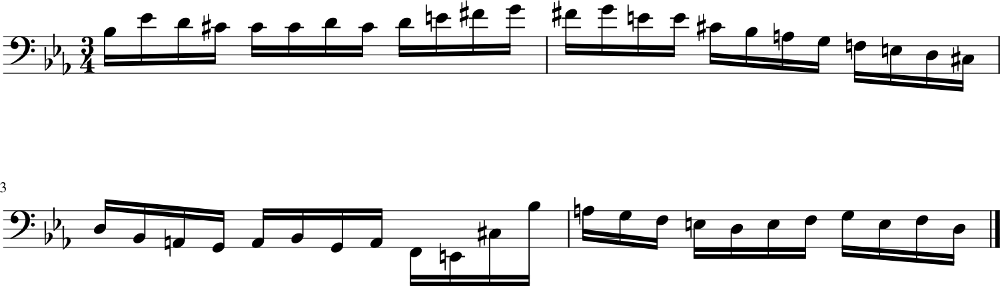

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5116 - loss: 1.2039 - note_outputs_loss: 0.6923
Epoch 406/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5626 - loss: 1.2847 - note_outputs_loss: 0.7220
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


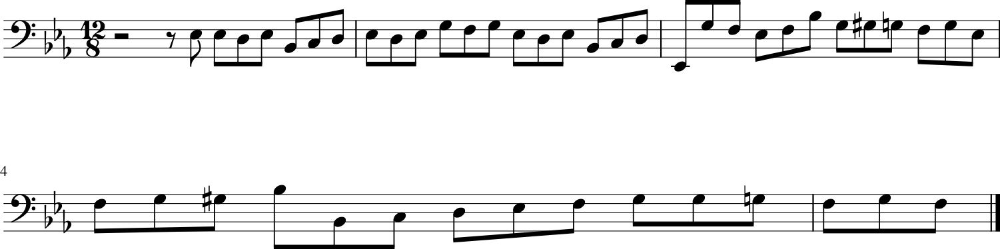

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5622 - loss: 1.2844 - note_outputs_loss: 0.7221
Epoch 407/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5445 - loss: 1.2522 - note_outputs_loss: 0.7077
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'E-3', 'C3', 'B-3', 'B-2', 'G#2', 'G2', 'B-2', 'D3', 'E-3', 'G#2', 'G2', 'B-2', 'C3', 'D3', 'E-3', 'C#4', 'G#2', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C4', 'G2', 'C4', 'B-3'], ['0.0', '0.0', '0.0', '2.75', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


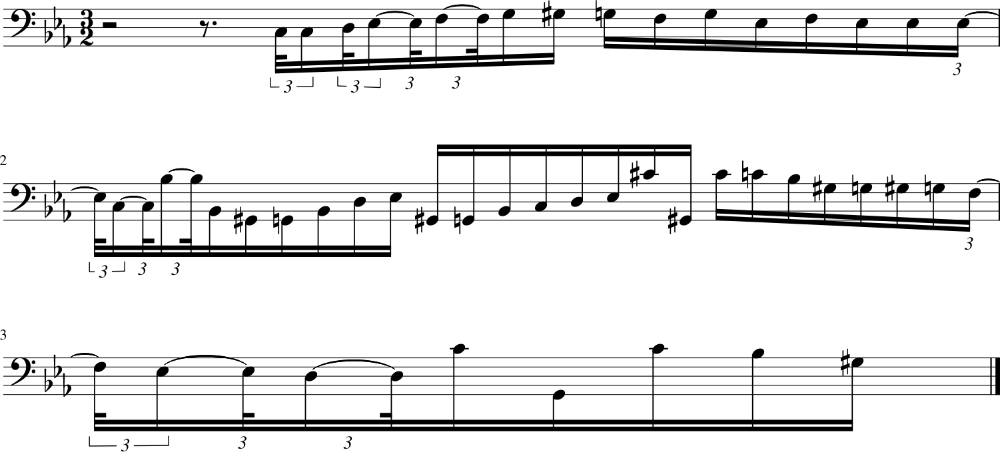

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5444 - loss: 1.2523 - note_outputs_loss: 0.7080
Epoch 408/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5194 - loss: 1.2359 - note_outputs_loss: 0.7165
Generation prompt: [['START', 'D:major', '6/8TS', '3/4TS', 'C#4', 'D4', 'E4', 'E3', 'D3', 'B-3', 'A3', 'B-3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'F3', 'A3', 'D3', 'E3', 'E3', 'C3', 'A2', 'C3', 'E3', 'E3', 'C3', 'A2', 'C3', 'E3', 'F3', 'E3', 'F3', 'D3', 'B2', 'F3', 'B2', 'F3', 'B2', 'F3', 'B2', 'F3', 'D3', 'E-3', 'C3', 'E-3', 'C3'], ['0.0', '0.0', '0.0', '0.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


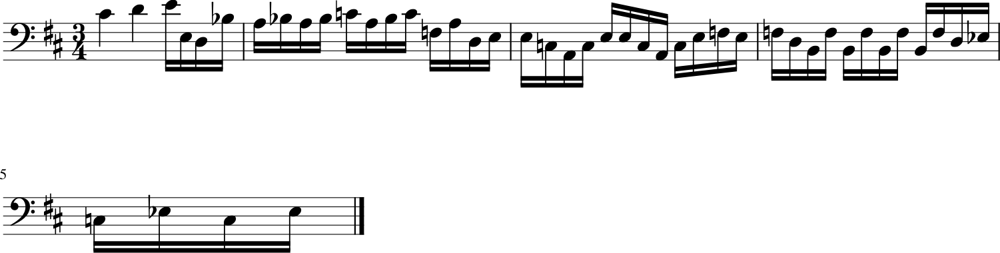

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5194 - loss: 1.2362 - note_outputs_loss: 0.7167
Epoch 409/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5629 - loss: 1.2848 - note_outputs_loss: 0.7219
Generation prompt: [['START', 'C:major'], ['0.0', '0.0']]


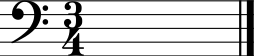

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5626 - loss: 1.2845 - note_outputs_loss: 0.7220
Epoch 410/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5929 - loss: 1.2892 - note_outputs_loss: 0.6963
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'E-3', 'G3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4'], ['0.0', '0.0', '2.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


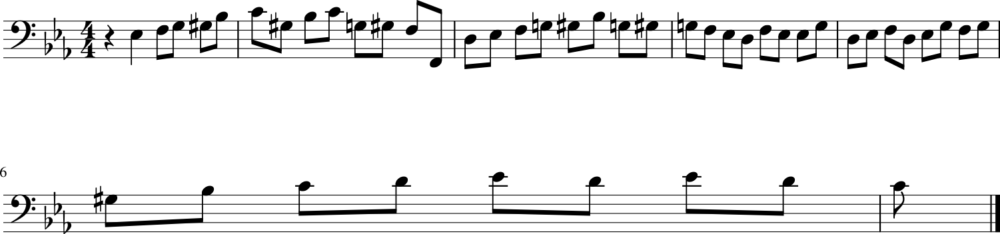

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5923 - loss: 1.2888 - note_outputs_loss: 0.6966
Epoch 411/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5273 - loss: 1.2249 - note_outputs_loss: 0.6976
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B-2', 'D3', 'F3', 'G#3', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'E-4', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


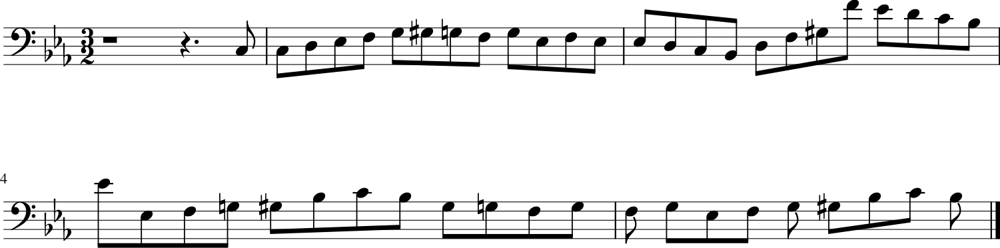

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5273 - loss: 1.2251 - note_outputs_loss: 0.6978
Epoch 412/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5045 - loss: 1.2114 - note_outputs_loss: 0.7069
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


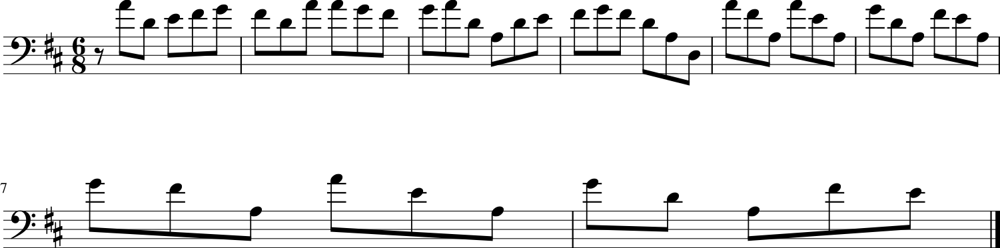

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5047 - loss: 1.2118 - note_outputs_loss: 0.7071
Epoch 413/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5176 - loss: 1.2374 - note_outputs_loss: 0.7198
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


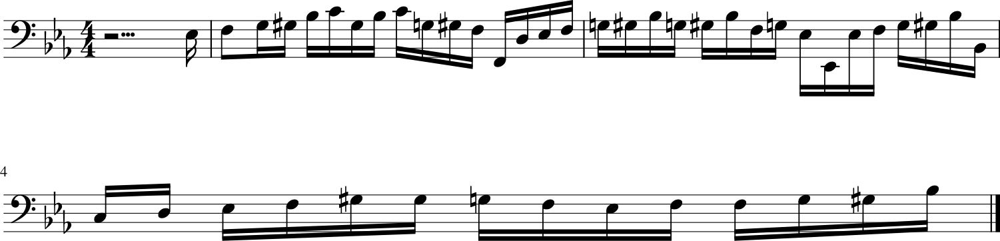

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5177 - loss: 1.2376 - note_outputs_loss: 0.7199
Epoch 414/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5303 - loss: 1.2210 - note_outputs_loss: 0.6907
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '3.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


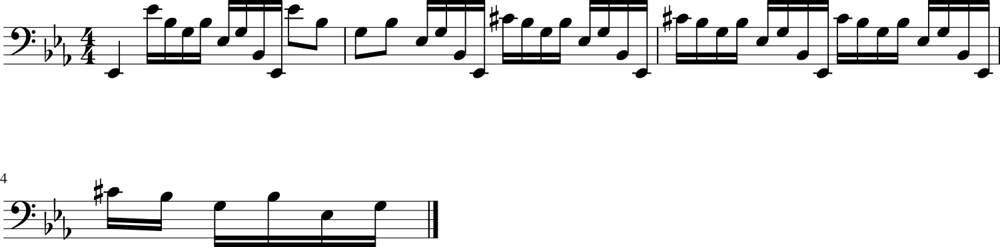

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5303 - loss: 1.2213 - note_outputs_loss: 0.6910
Epoch 415/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4902 - loss: 1.2144 - note_outputs_loss: 0.7242
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'B-2', 'B-2', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'G3', 'C4', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F#3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'D4', 'C4', 'B3', 'C4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


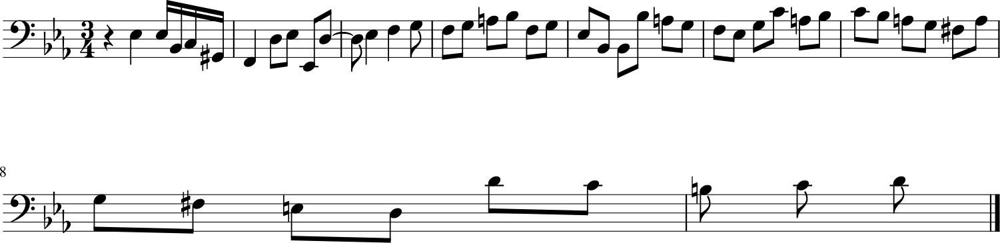

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4905 - loss: 1.2148 - note_outputs_loss: 0.7243
Epoch 416/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5243 - loss: 1.2347 - note_outputs_loss: 0.7105
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'D3', 'B-2', 'D3', 'G#2', 'G2', 'B-2', 'E-3', 'G3', 'B-3', 'C#3', 'C3', 'B-2', 'C3', 'G#2', 'C3', 'G2', 'F2', 'G#2', 'D3', 'F3', 'B-3', 'C3', 'B-2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


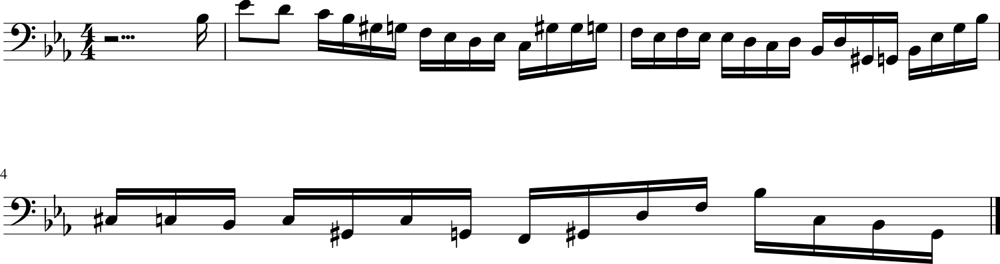

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5243 - loss: 1.2350 - note_outputs_loss: 0.7107
Epoch 417/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5225 - loss: 1.2313 - note_outputs_loss: 0.7088
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'G#2', 'D3', 'F3', 'G#3', 'C3', 'B2', 'D3', 'G3', 'B3', 'D4', 'F3', 'E-3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


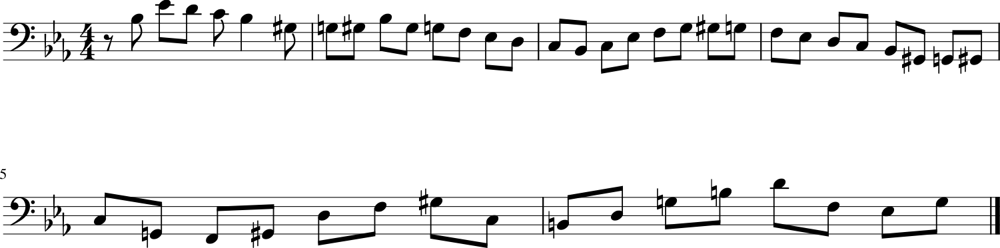

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5225 - loss: 1.2316 - note_outputs_loss: 0.7091
Epoch 418/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4947 - loss: 1.1713 - note_outputs_loss: 0.6765
Generation prompt: [['START', 'E-:major', '3/4TS', 'D3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G#3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


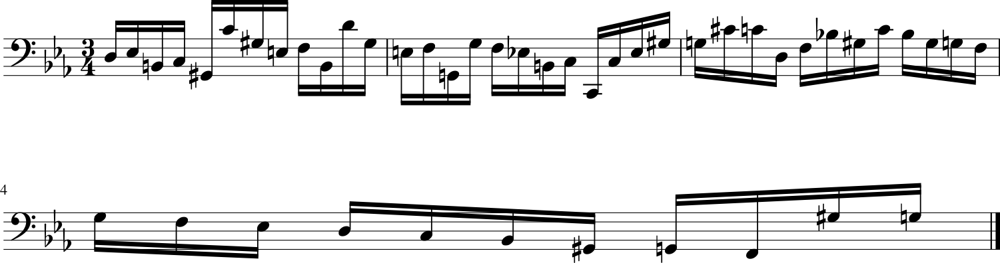

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4950 - loss: 1.1720 - note_outputs_loss: 0.6770
Epoch 419/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5264 - loss: 1.2211 - note_outputs_loss: 0.6946
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

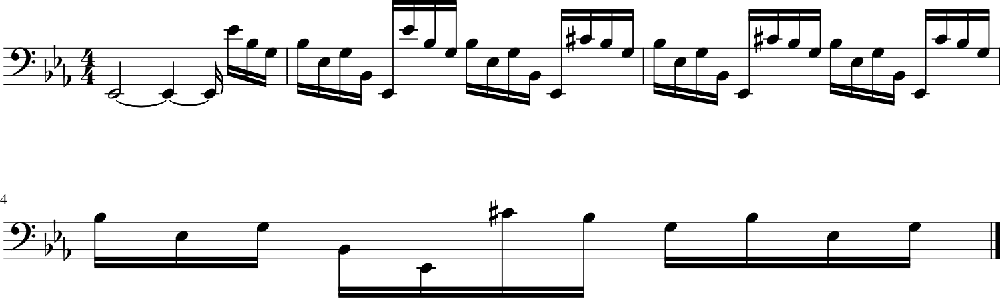

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5264 - loss: 1.2213 - note_outputs_loss: 0.6949
Epoch 420/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5306 - loss: 1.2580 - note_outputs_loss: 0.7274
Generation prompt: [['START', 'F:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'D3', 'G2', 'B-3', 'G3', 'D3', 'G3', 'B-2', 'C3', 'D3', 'G2', 'G2', 'B-2', 'B-3', 'B-3', 'B-3', 'B-3', 'G3', 'B-3', 'E-3', 'B-3', 'G3', 'C4', 'F3', 'C4', 'G3', 'B-3', 'E3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E3', 'F3', 'G#3', 'E-3', 'D3', 'F3', 'G#3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


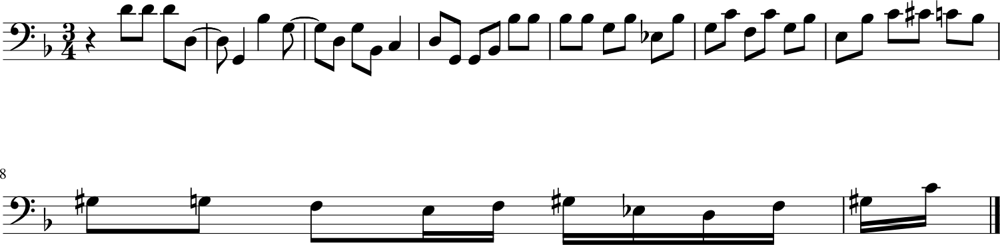

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5305 - loss: 1.2579 - note_outputs_loss: 0.7274
Epoch 421/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5241 - loss: 1.2358 - note_outputs_loss: 0.7117
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


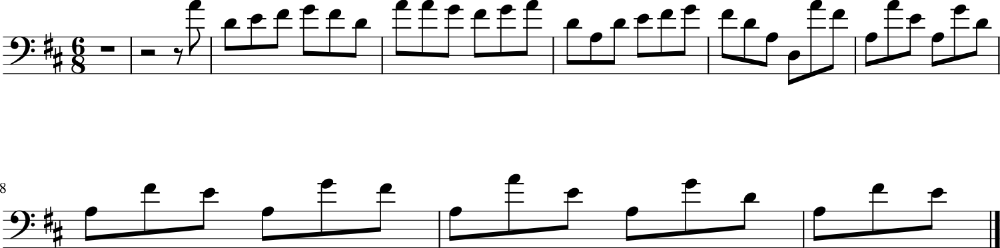

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5242 - loss: 1.2359 - note_outputs_loss: 0.7117
Epoch 422/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4990 - loss: 1.1975 - note_outputs_loss: 0.6985
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'D3', 'D3', 'D3', 'C3', 'C3', 'G3', 'G#2', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


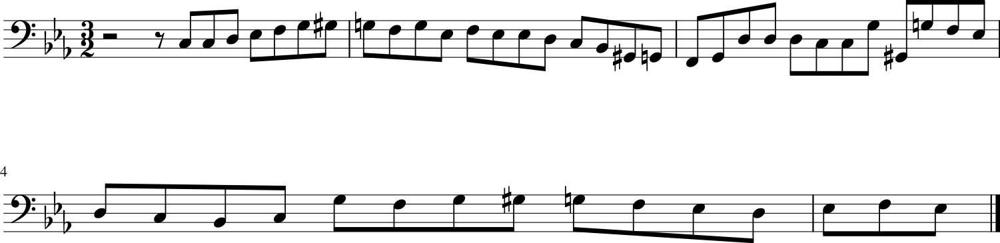

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4993 - loss: 1.1980 - note_outputs_loss: 0.6987
Epoch 423/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5025 - loss: 1.2031 - note_outputs_loss: 0.7007
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'G2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G2', 'F2', 'G#3', 'D3', 'B2', 'D3', 'G#2'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


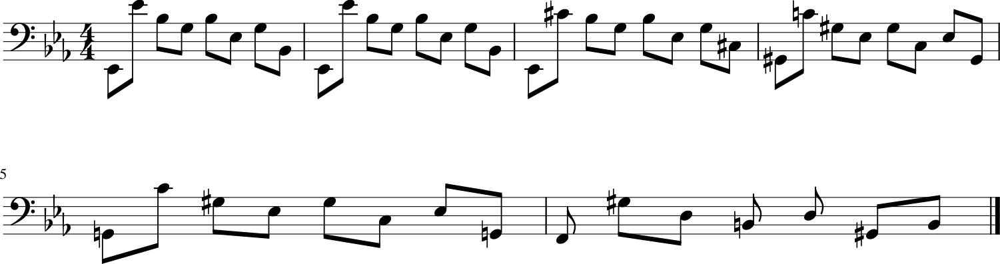

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5027 - loss: 1.2036 - note_outputs_loss: 0.7009
Epoch 424/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5326 - loss: 1.2379 - note_outputs_loss: 0.7052
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'E3', 'C3', 'C2', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'D3', 'D2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'B3', 'G3', 'D3', 'C3', 'B2', 'G2', 'F3', 'E3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


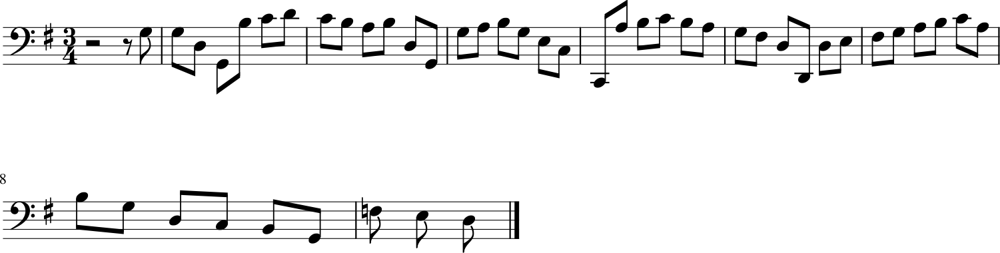

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5326 - loss: 1.2380 - note_outputs_loss: 0.7054
Epoch 425/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5324 - loss: 1.2028 - note_outputs_loss: 0.6704
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B2', 'G3', 'D4', 'F4', 'E-4', 'C2', 'D4', 'C4', 'B-3', 'B-3', 'C4', 'A3', 'A3', 'A3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


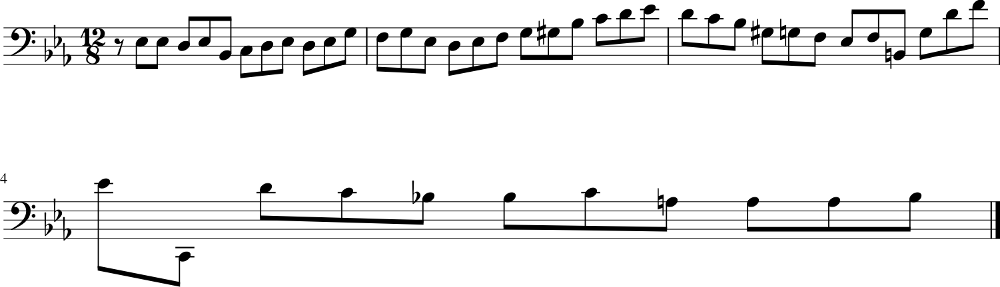

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5323 - loss: 1.2032 - note_outputs_loss: 0.6709
Epoch 426/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5123 - loss: 1.2110 - note_outputs_loss: 0.6988
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'B-2', 'E-2', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '5.5', '0.5', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


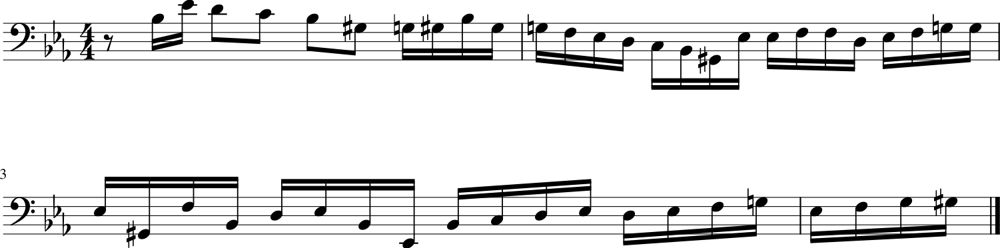

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5124 - loss: 1.2114 - note_outputs_loss: 0.6990
Epoch 427/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5098 - loss: 1.2025 - note_outputs_loss: 0.6927
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'A3', 'D3', 'B-2', 'E3', 'A2', 'G3', 'C#4', 'D4', 'F#3', 'E3', 'D3', 'C#3', 'F#3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


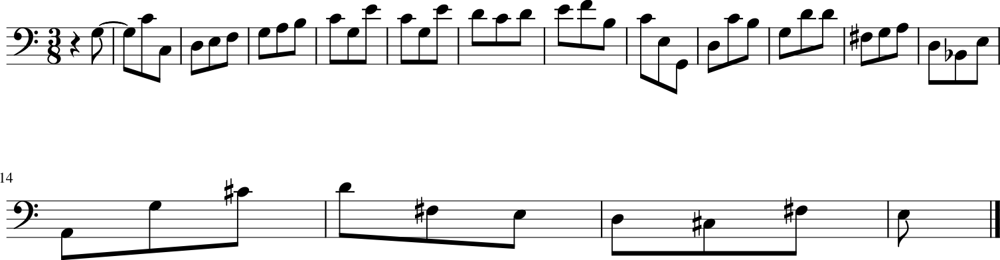

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5100 - loss: 1.2029 - note_outputs_loss: 0.6929
Epoch 428/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5380 - loss: 1.2313 - note_outputs_loss: 0.6933
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'B-2', 'B-2', 'A2', 'B-2', 'B-3', 'C4', 'C4', 'C4', 'C4', 'C4', 'F#3', 'C4', 'F3', 'C4', 'F3', 'C4', 'G3', 'A3', 'C4', 'B3', 'A3', 'B3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


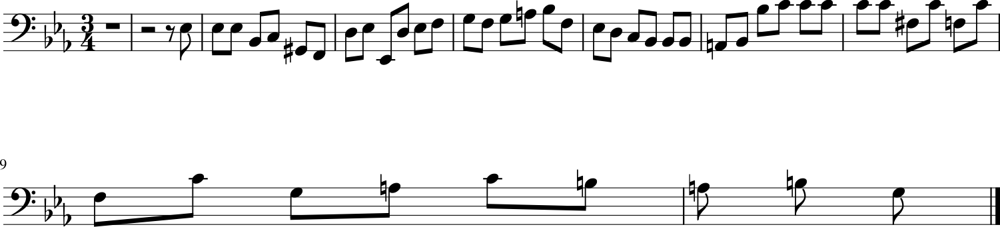

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5379 - loss: 1.2315 - note_outputs_loss: 0.6936
Epoch 429/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5097 - loss: 1.2144 - note_outputs_loss: 0.7046
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'E-3', 'F3', 'B-2', 'D4', 'E-4', 'rest'], ['0.0', '0.0', '0.0', '5.5', '0.5', '1.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


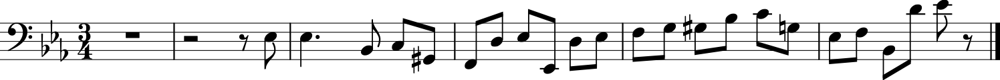

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.5099 - loss: 1.2147 - note_outputs_loss: 0.7048
Epoch 430/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5157 - loss: 1.2143 - note_outputs_loss: 0.6986
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


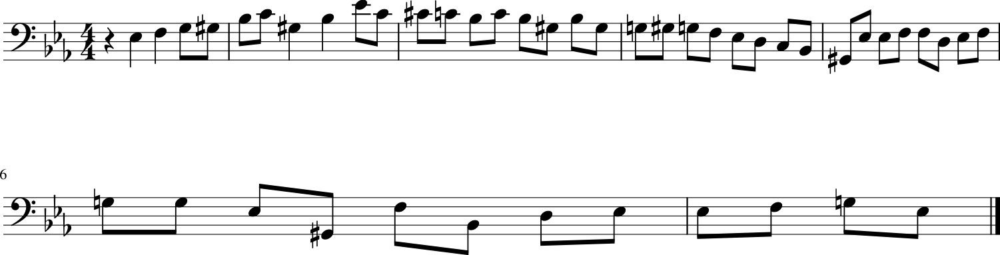

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5158 - loss: 1.2146 - note_outputs_loss: 0.6988
Epoch 431/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5182 - loss: 1.1918 - note_outputs_loss: 0.6736
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'A3', 'B3', 'D4', 'C4', 'G3', 'A3', 'B3', 'G3', 'D3', 'B2', 'B2', 'G2', 'F3', 'D3', 'F3', 'B2', 'F3', 'G2', 'F3', 'D3', 'F3', 'B2', 'F3', 'G2', 'F3', 'D3', 'F3', 'B2', 'F3', 'G2', 'E-3', 'C3', 'E-3', 'B2', 'E-3', 'G2', 'E-3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


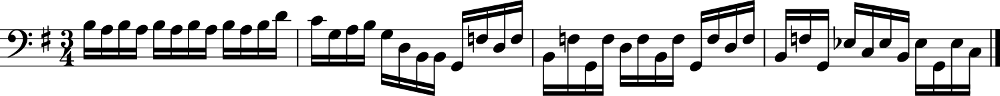

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5183 - loss: 1.1923 - note_outputs_loss: 0.6740
Epoch 432/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5427 - loss: 1.2640 - note_outputs_loss: 0.7213
Generation prompt: [['START', 'G:major', '3/4TS', 'D3', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C4', 'B3', 'A3', 'B3', 'C4', 'A3', 'G#3', 'E3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'G#3', 'F#3', 'E3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


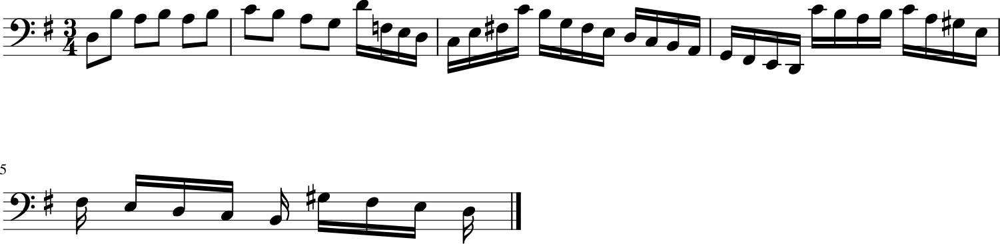

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5426 - loss: 1.2639 - note_outputs_loss: 0.7213
Epoch 433/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5398 - loss: 1.2409 - note_outputs_loss: 0.7011
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'F2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


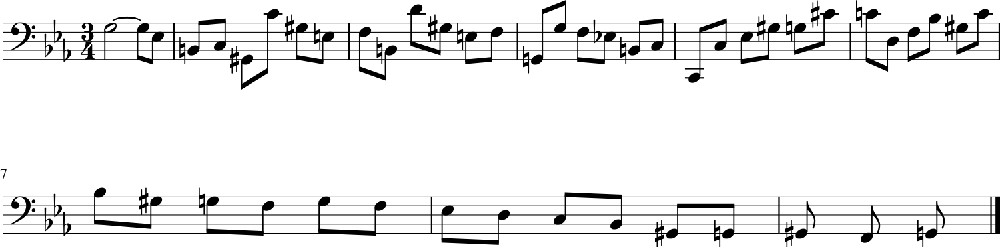

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5397 - loss: 1.2409 - note_outputs_loss: 0.7013
Epoch 434/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4842 - loss: 1.1858 - note_outputs_loss: 0.7017
Generation prompt: [['START', 'C:major'], ['0.0', '0.0']]


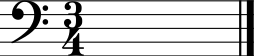

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.4845 - loss: 1.1864 - note_outputs_loss: 0.7019
Epoch 435/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5216 - loss: 1.2063 - note_outputs_loss: 0.6846
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'A3', 'B3', 'C4', 'A3', 'F3', 'D3', 'B3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


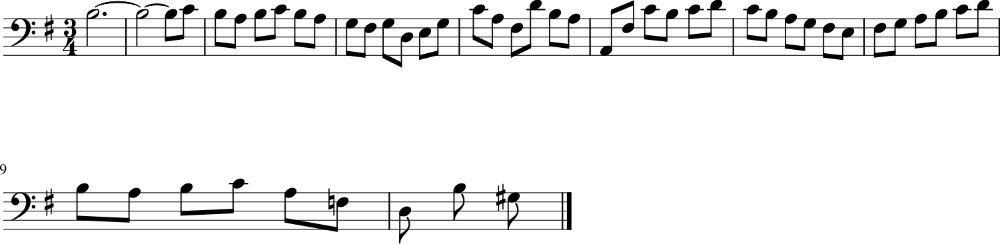

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5217 - loss: 1.2067 - note_outputs_loss: 0.6850
Epoch 436/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5007 - loss: 1.2066 - note_outputs_loss: 0.7059
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'B3', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'G3', 'E3', 'G3', 'B3', 'G3', 'F3', 'E3', 'G3', 'C4', 'E3', 'D3', 'F4', 'E4', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'G3', 'D3', 'B2', 'B2', 'G2', 'F2', 'rest', 'B3', 'A3', 'G3', 'F3', 'E3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


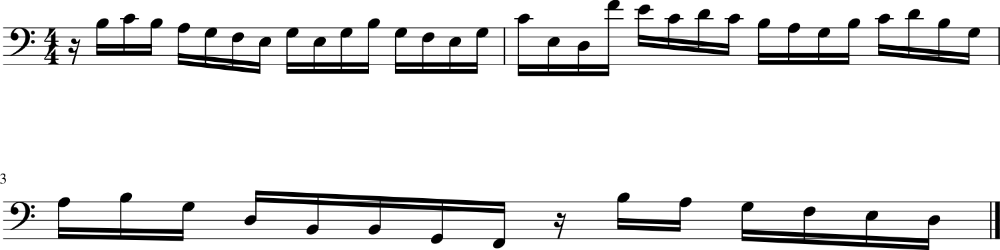

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5009 - loss: 1.2071 - note_outputs_loss: 0.7061
Epoch 437/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4953 - loss: 1.1840 - note_outputs_loss: 0.6887
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'A3', 'B3', 'E3', 'G3', 'C4', 'A3', 'B3', 'G3', 'D3', 'B3', 'A3', 'B3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'G3', 'A3', 'D3', 'B-3', 'A3', 'C4', 'B3', 'C4', 'B-3', 'G3', 'F#3', 'A3', 'E-3', 'C4', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


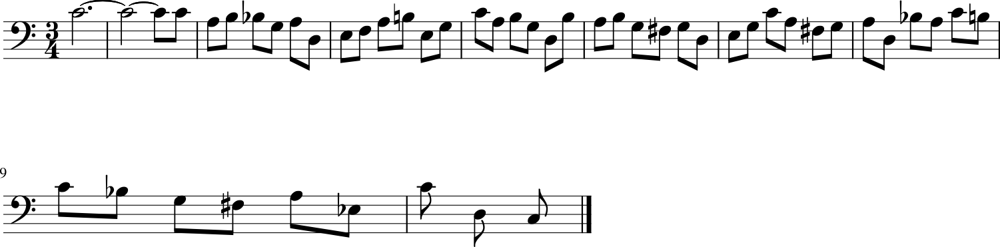

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4956 - loss: 1.1847 - note_outputs_loss: 0.6891
Epoch 438/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5298 - loss: 1.2240 - note_outputs_loss: 0.6942
Generation prompt: [['START', 'E-:major', 'F3', 'G3', 'E-3', 'E-3', 'E-3', 'D3', 'C3', 'B-2', 'E-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'B-2', 'E-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'E-3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


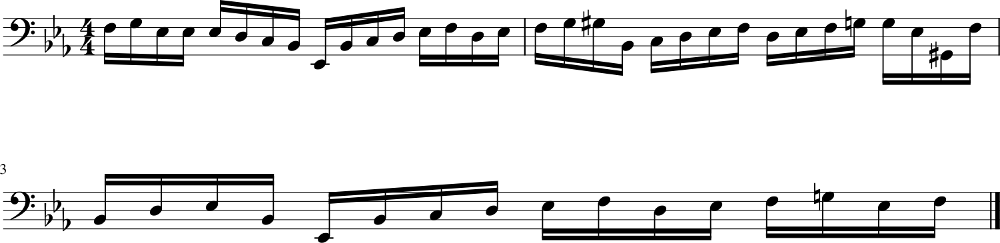

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5297 - loss: 1.2242 - note_outputs_loss: 0.6944
Epoch 439/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5167 - loss: 1.2135 - note_outputs_loss: 0.6968
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'G3', 'A2', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'D3', 'F3', 'G#3', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'E-4', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


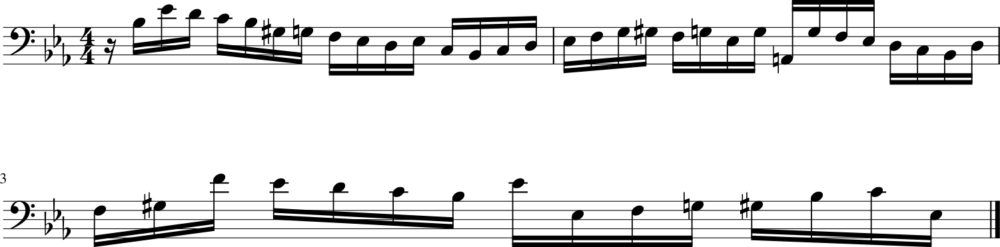

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5168 - loss: 1.2138 - note_outputs_loss: 0.6970
Epoch 440/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5503 - loss: 1.2413 - note_outputs_loss: 0.6910
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'B-3', 'G#3', 'G3', 'F3', 'F3', 'F3', 'G3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E3', 'F3', 'G3', 'G#3', 'B-3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'G3', 'G2'], ['0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


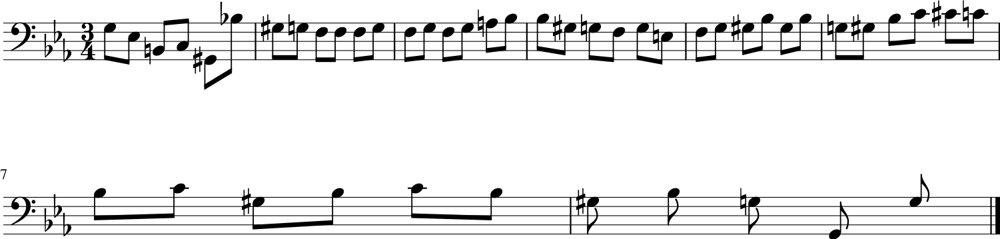

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5501 - loss: 1.2413 - note_outputs_loss: 0.6912
Epoch 441/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5136 - loss: 1.2197 - note_outputs_loss: 0.7061
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


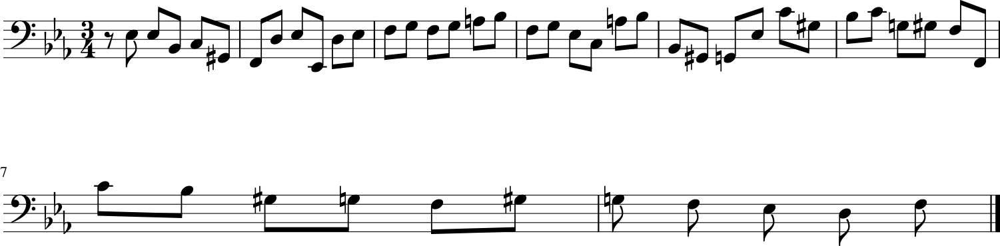

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5137 - loss: 1.2200 - note_outputs_loss: 0.7063
Epoch 442/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5415 - loss: 1.2476 - note_outputs_loss: 0.7061
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'B-2', 'D3', 'F3', 'B-3', 'A3', 'B-3', 'D3', 'C3', 'D3', 'E-3', 'G2', 'B-3', 'B-3', 'G3', 'D3', 'C3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


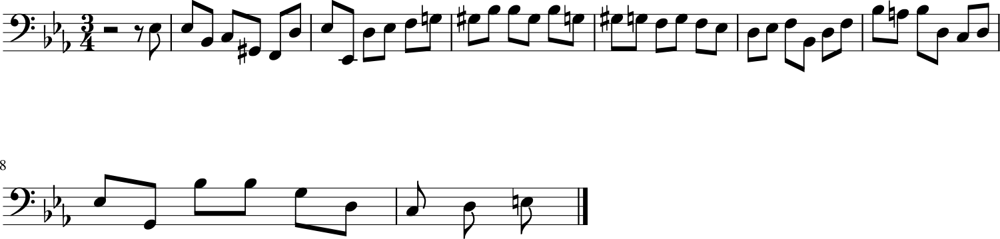

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5413 - loss: 1.2476 - note_outputs_loss: 0.7063
Epoch 443/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5212 - loss: 1.2153 - note_outputs_loss: 0.6941
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


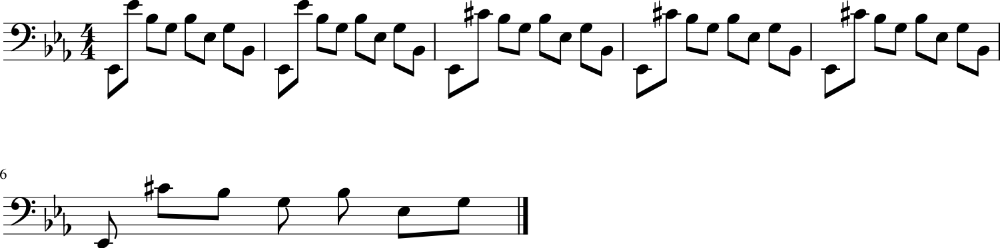

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5212 - loss: 1.2156 - note_outputs_loss: 0.6943
Epoch 444/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5307 - loss: 1.2344 - note_outputs_loss: 0.7037
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


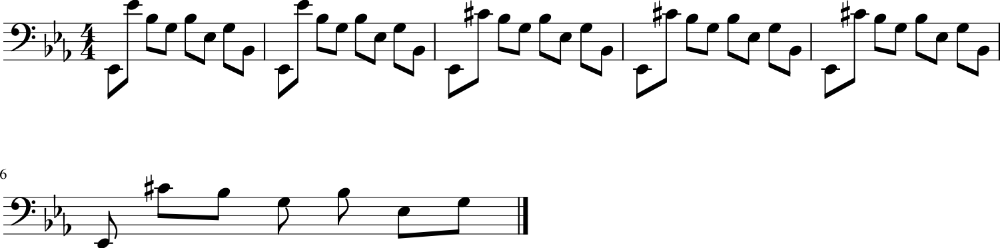

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5306 - loss: 1.2345 - note_outputs_loss: 0.7038
Epoch 445/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5695 - loss: 1.2534 - note_outputs_loss: 0.6839
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


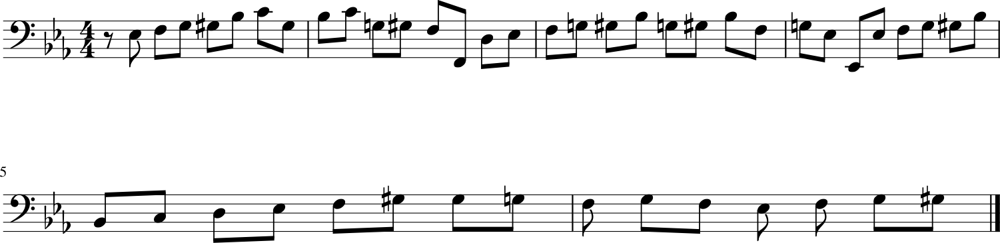

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5691 - loss: 1.2533 - note_outputs_loss: 0.6842
Epoch 446/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4952 - loss: 1.1660 - note_outputs_loss: 0.6708
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25']]


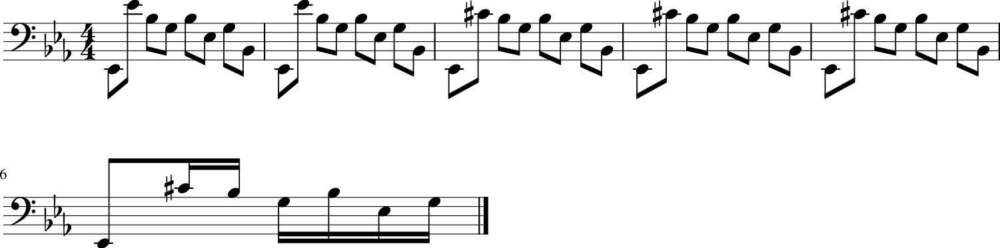

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4955 - loss: 1.1667 - note_outputs_loss: 0.6713
Epoch 447/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5015 - loss: 1.1984 - note_outputs_loss: 0.6969
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'E-3', 'B-2', 'E-2', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


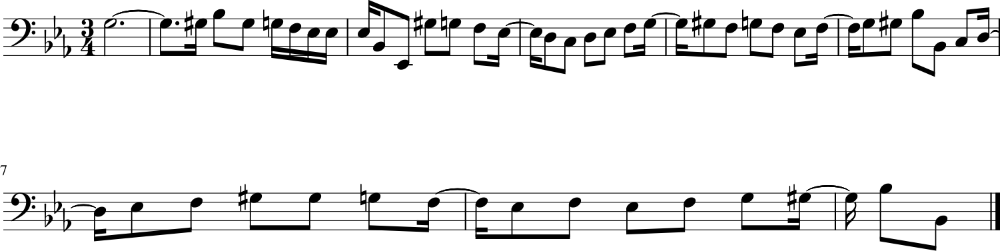

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5018 - loss: 1.1988 - note_outputs_loss: 0.6971
Epoch 448/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5441 - loss: 1.2385 - note_outputs_loss: 0.6944
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


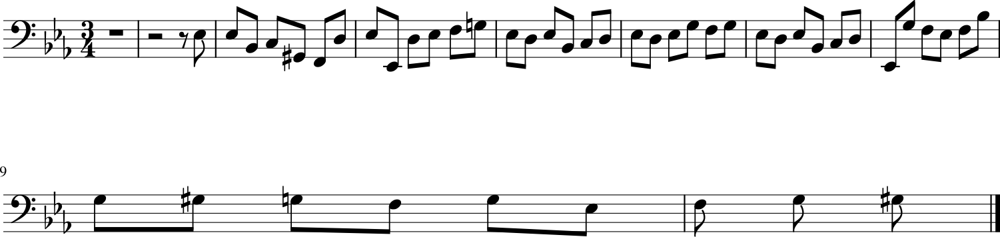

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5439 - loss: 1.2386 - note_outputs_loss: 0.6947
Epoch 449/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5490 - loss: 1.2520 - note_outputs_loss: 0.7030
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'D3', 'B2', 'A2', 'B2', 'D3', 'A2', 'B2', 'G2', 'E3', 'C2', 'B2', 'C#3', 'B2', 'A2', 'B2', 'C3', 'B2', 'A2', 'G2', 'G3', 'F3', 'B2', 'D3', 'F3', 'B3', 'D4', 'C4', 'B3', 'A3', 'B3', 'C4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


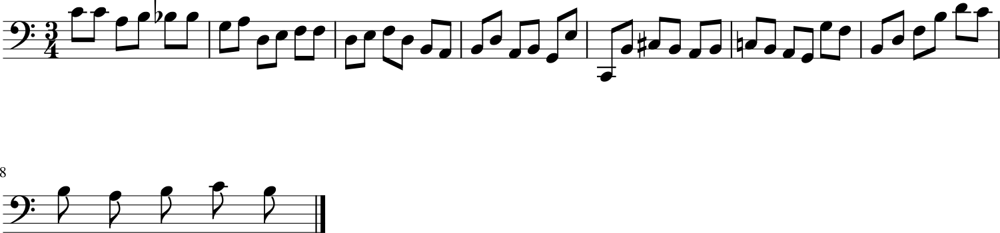

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5488 - loss: 1.2519 - note_outputs_loss: 0.7031
Epoch 450/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5363 - loss: 1.2309 - note_outputs_loss: 0.6946
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'F2', 'G#3', 'G#3', 'G3', 'G#3', 'F3', 'D4'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


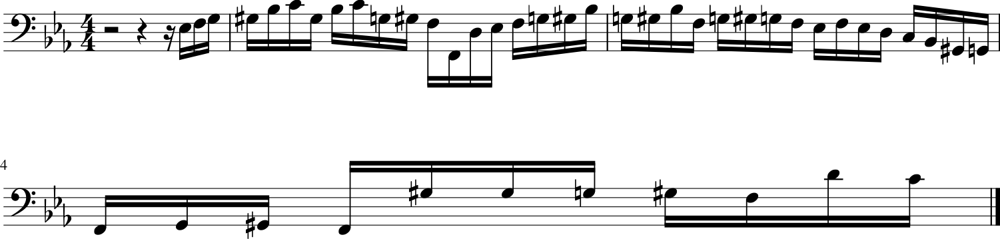

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5362 - loss: 1.2310 - note_outputs_loss: 0.6948
Epoch 451/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5308 - loss: 1.2287 - note_outputs_loss: 0.6980
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


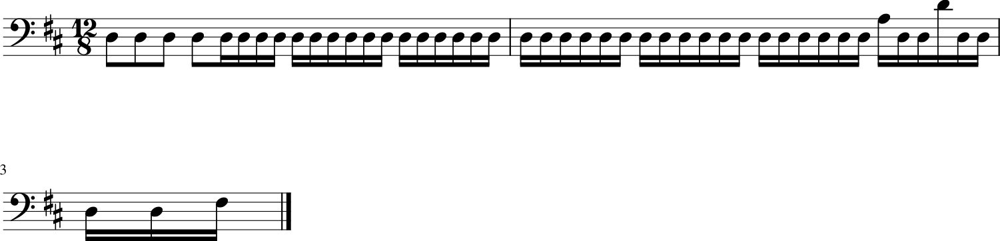

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5307 - loss: 1.2289 - note_outputs_loss: 0.6981
Epoch 452/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5135 - loss: 1.1668 - note_outputs_loss: 0.6533
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


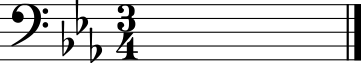

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5136 - loss: 1.1674 - note_outputs_loss: 0.6538
Epoch 453/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5390 - loss: 1.2286 - note_outputs_loss: 0.6896
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B-2', 'D4', 'E-4', 'F3', 'B-3', 'A3', 'G3', 'F4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


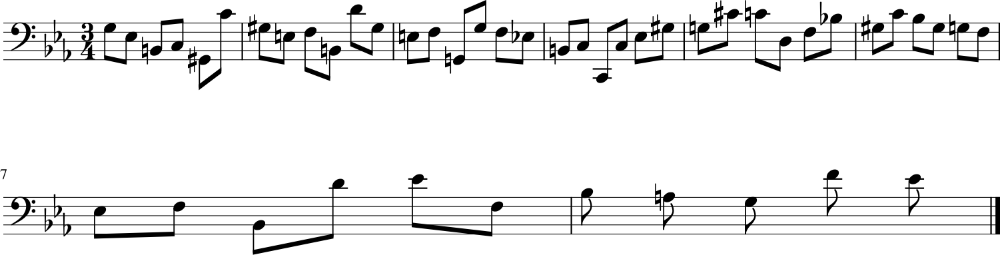

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5389 - loss: 1.2288 - note_outputs_loss: 0.6898
Epoch 454/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5998 - loss: 1.3104 - note_outputs_loss: 0.7106
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


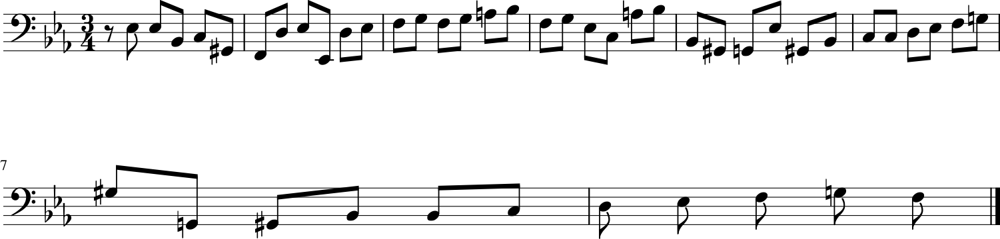

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5991 - loss: 1.3097 - note_outputs_loss: 0.7106
Epoch 455/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5118 - loss: 1.2082 - note_outputs_loss: 0.6964
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


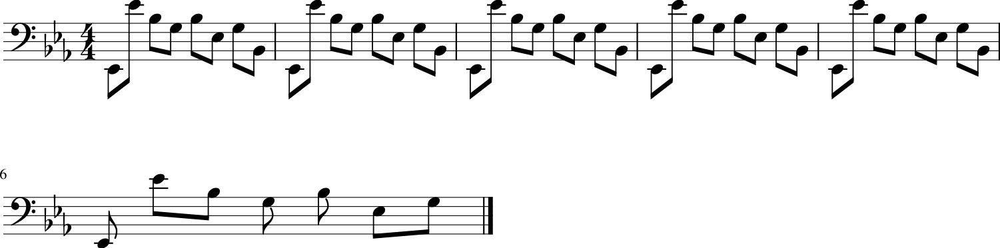

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5119 - loss: 1.2085 - note_outputs_loss: 0.6965
Epoch 456/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5163 - loss: 1.2004 - note_outputs_loss: 0.6841
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'E-3', 'C3', 'G2', 'C3', 'E-3', 'G3', 'C4', 'B-3', 'B-3', 'A3', 'A3', 'C4', 'F#3', 'F#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


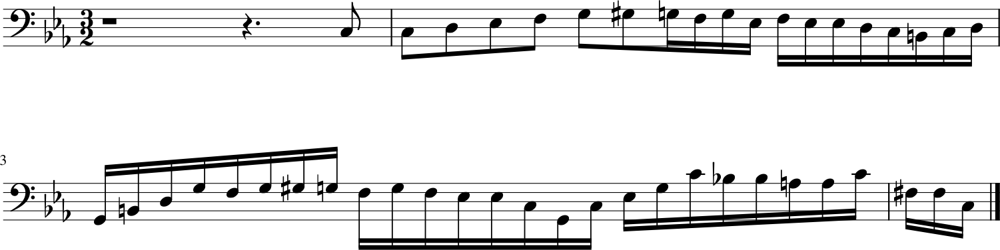

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5164 - loss: 1.2007 - note_outputs_loss: 0.6843
Epoch 457/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4817 - loss: 1.1485 - note_outputs_loss: 0.6667
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


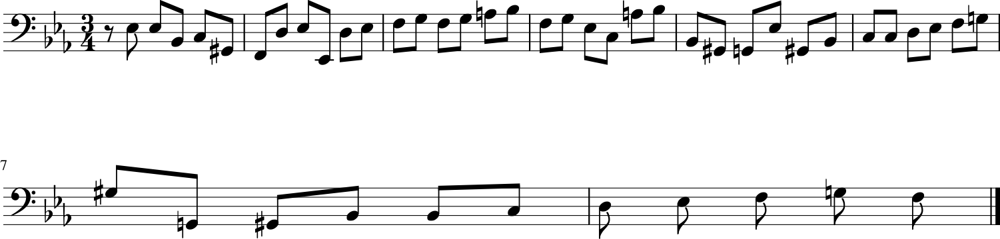

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4821 - loss: 1.1493 - note_outputs_loss: 0.6671
Epoch 458/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5766 - loss: 1.2719 - note_outputs_loss: 0.6953
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'E3', 'E3', 'E3', 'E3', 'C3', 'E3', 'F3', 'D3', 'B2', 'E3', 'C3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C4', 'B3', 'C4', 'rest'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


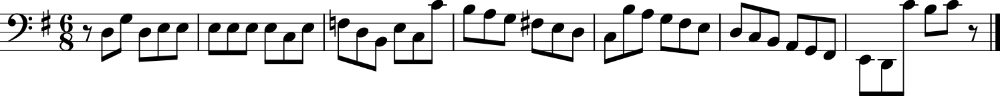

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5761 - loss: 1.2716 - note_outputs_loss: 0.6955
Epoch 459/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5441 - loss: 1.2433 - note_outputs_loss: 0.6992
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'D4', 'E4', 'C4', 'B3', 'A3', 'G3', 'E4', 'F4', 'E4', 'D4', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3'], ['0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


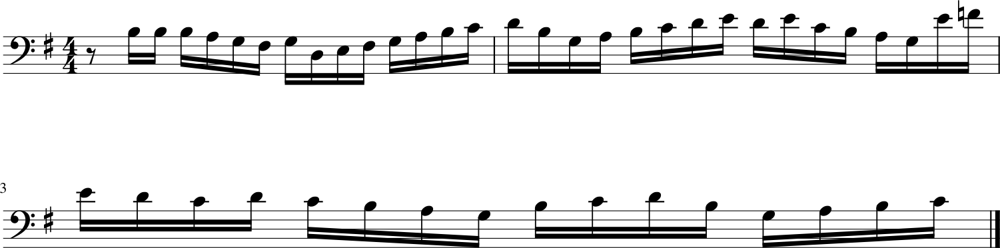

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5439 - loss: 1.2433 - note_outputs_loss: 0.6994
Epoch 460/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5585 - loss: 1.2624 - note_outputs_loss: 0.7040
Generation prompt: [['START', 'G:major', '3/4TS', 'D3', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'A3', 'C3', 'E3', 'A3', 'C4', 'F#3', 'A3', 'C4', 'E4', 'D4', 'C3', 'B2', 'G3', 'A2', 'G2', 'D3', 'F#3', 'G3', 'A3', 'B3', 'D4', 'F#4', 'E4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


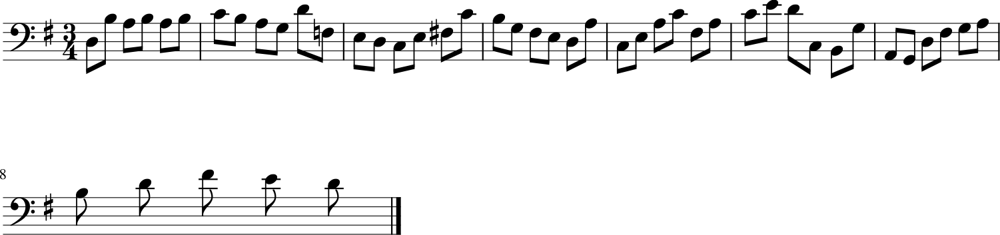

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5581 - loss: 1.2622 - note_outputs_loss: 0.7041
Epoch 461/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5410 - loss: 1.2034 - note_outputs_loss: 0.6624
Generation prompt: [['START', 'G:major', '3/4TS', 'D3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'C3', 'D3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


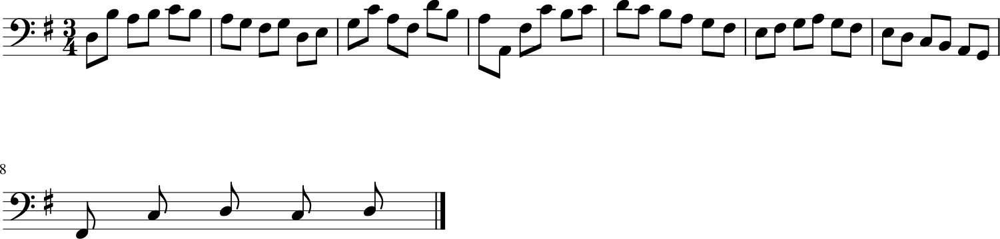

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5408 - loss: 1.2037 - note_outputs_loss: 0.6629
Epoch 462/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5166 - loss: 1.2030 - note_outputs_loss: 0.6865
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'E3', 'C3', 'C2', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'D3', 'D2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'A3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'B2', 'C3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


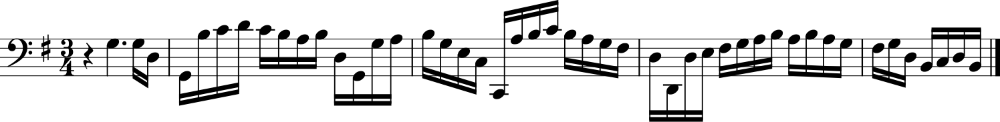

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5167 - loss: 1.2033 - note_outputs_loss: 0.6867
Epoch 463/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5573 - loss: 1.2648 - note_outputs_loss: 0.7075
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'D3', 'G3', 'D3', 'B2', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'A3', 'B3', 'C4', 'B3', 'B3', 'A3', 'A3', 'B3', 'F#3', 'G3', 'G3', 'E3', 'G3', 'A3', 'E3', 'F#3', 'F#3', 'F#3', 'D3', 'F#3', 'G3', 'C#4', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C#4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


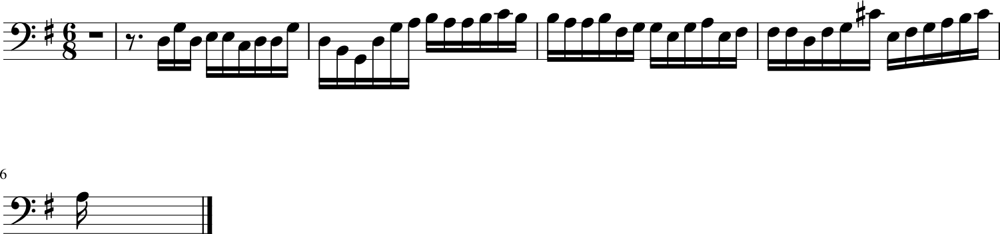

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5570 - loss: 1.2646 - note_outputs_loss: 0.7076
Epoch 464/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5316 - loss: 1.2178 - note_outputs_loss: 0.6861
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


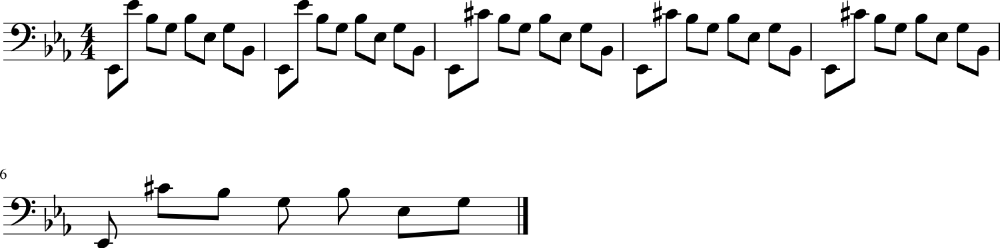

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5316 - loss: 1.2180 - note_outputs_loss: 0.6864
Epoch 465/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5273 - loss: 1.2344 - note_outputs_loss: 0.7071
Generation prompt: [['START', 'F:major', '3/4TS', 'G3', 'A3', 'D3', 'G3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'G#2', 'E3', 'F3', 'E3', 'F3', 'E3', 'D3', 'B3', 'D4', 'E3', 'F3', 'E3', 'D3', 'E3', 'F3', 'G3', 'G3', 'F3', 'E3', 'D3', 'C3', 'E3', 'A3', 'C4', 'A3', 'F3', 'D3', 'C4', 'B3', 'A3', 'G3', 'C4', 'G3', 'B-3', 'A3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


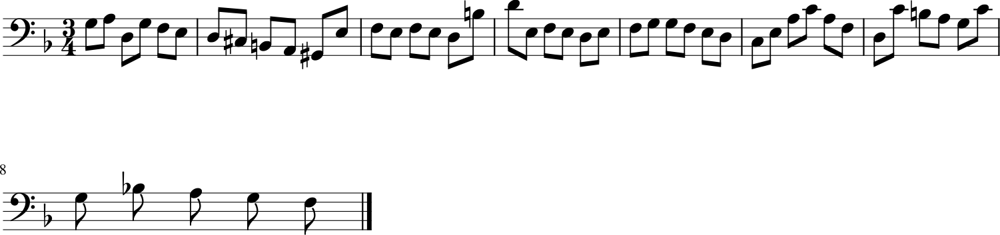

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5272 - loss: 1.2344 - note_outputs_loss: 0.7072
Epoch 466/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5044 - loss: 1.1778 - note_outputs_loss: 0.6734
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'G3', 'D3', 'B2', 'D3', 'F#3', 'G3', 'D3', 'G2', 'G3', 'A3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'F#3', 'D3', 'C3', 'B2', 'D3', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


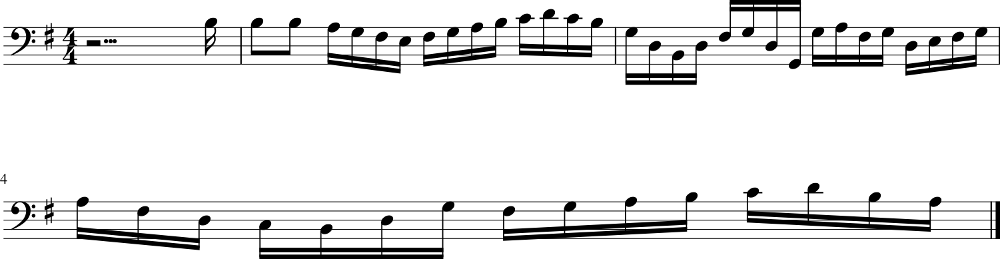

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5046 - loss: 1.1783 - note_outputs_loss: 0.6737
Epoch 467/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5064 - loss: 1.2033 - note_outputs_loss: 0.6969
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'E3', 'C3', 'C2', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'D3', 'D2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'B3', 'G3', 'D3', 'G3', 'A3', 'F#3', 'G3', 'G2'], ['0.0', '0.0', '0.0', '3.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


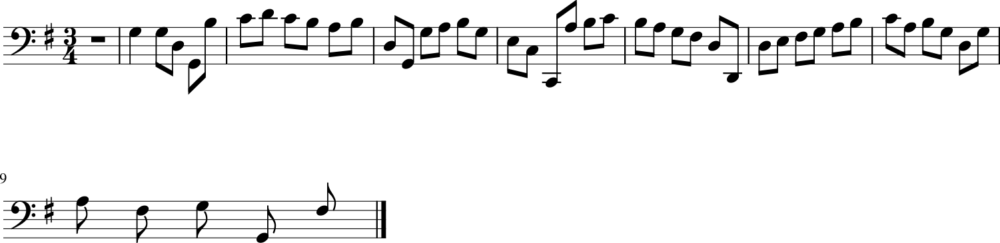

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5066 - loss: 1.2037 - note_outputs_loss: 0.6971
Epoch 468/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5500 - loss: 1.2493 - note_outputs_loss: 0.6993
Generation prompt: [['START', 'D:major'], ['0.0', '0.0']]


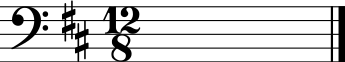

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5498 - loss: 1.2493 - note_outputs_loss: 0.6995
Epoch 469/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5554 - loss: 1.2207 - note_outputs_loss: 0.6653
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'A3', 'G#3', 'B-3', 'B-3', 'F3', 'G3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


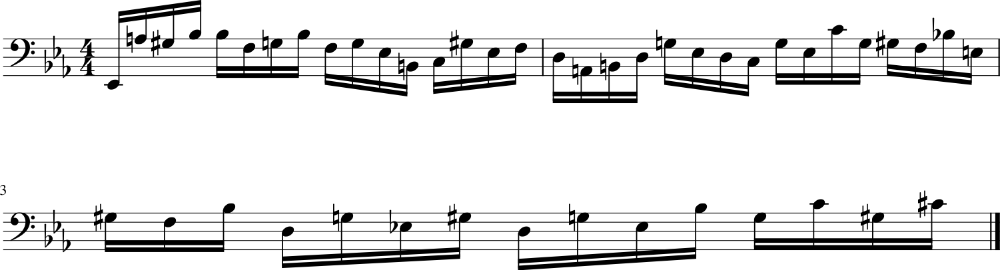

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5551 - loss: 1.2208 - note_outputs_loss: 0.6657
Epoch 470/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5684 - loss: 1.2337 - note_outputs_loss: 0.6653
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'F3', 'B3', 'D3', 'C4', 'rest'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


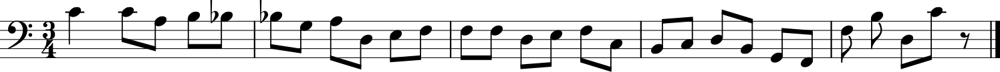

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 63ms/step - duration_outputs_loss: 0.5680 - loss: 1.2337 - note_outputs_loss: 0.6657
Epoch 471/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5569 - loss: 1.2740 - note_outputs_loss: 0.7171
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'B-3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'E-4', 'F#3', 'G3', 'G3', 'C4', 'A3', 'B3', 'B3', 'B3', 'G3', 'D3', 'B2', 'B2', 'G2', 'G2', 'D3', 'F3', 'B2', 'G3', 'F3', 'A2', 'G3', 'F3', 'G2', 'F3', 'E3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


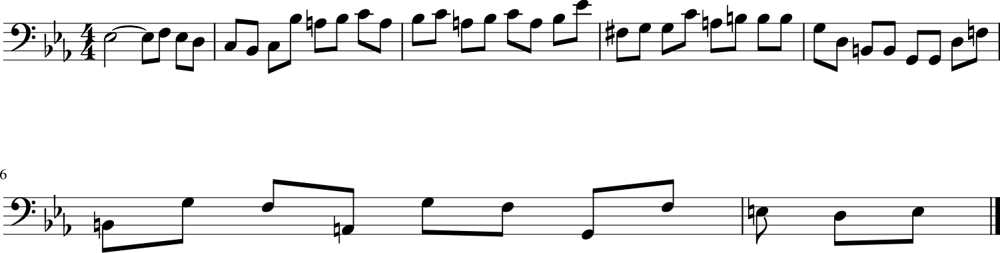

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5566 - loss: 1.2736 - note_outputs_loss: 0.7170
Epoch 472/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4940 - loss: 1.1839 - note_outputs_loss: 0.6899
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'E-4', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


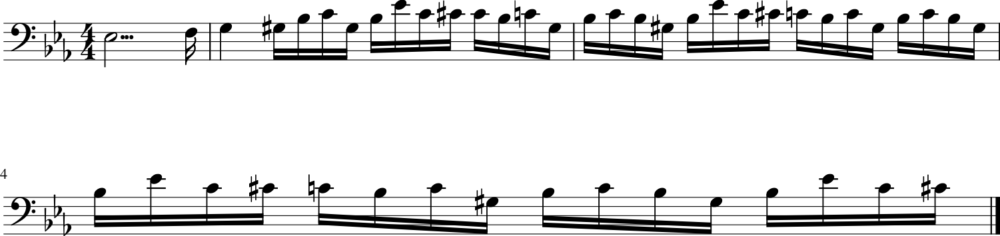

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4943 - loss: 1.1843 - note_outputs_loss: 0.6900
Epoch 473/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5530 - loss: 1.2182 - note_outputs_loss: 0.6652
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


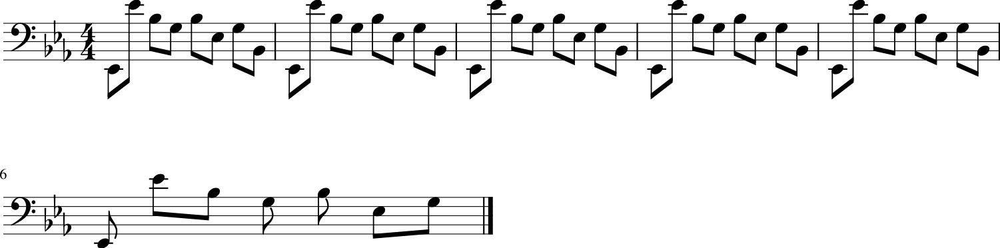

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5528 - loss: 1.2183 - note_outputs_loss: 0.6656
Epoch 474/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5067 - loss: 1.1830 - note_outputs_loss: 0.6763
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'C4', 'D4', 'E-4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


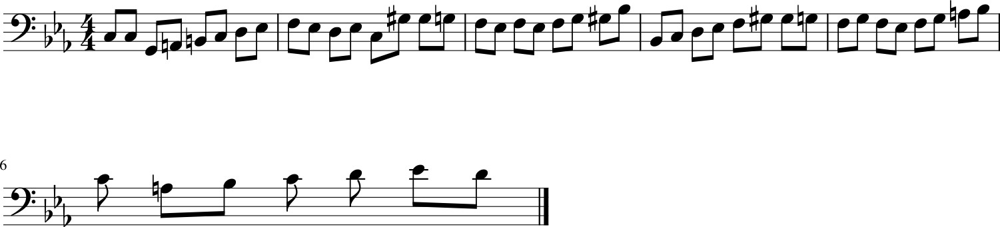

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5069 - loss: 1.1836 - note_outputs_loss: 0.6767
Epoch 475/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5192 - loss: 1.2236 - note_outputs_loss: 0.7045
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'A3', 'F#3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'A3', 'B3', 'C4', 'A3', 'F3', 'D3', 'B3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


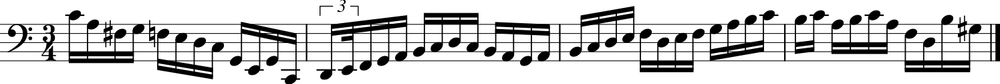

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5192 - loss: 1.2238 - note_outputs_loss: 0.7046
Epoch 476/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5082 - loss: 1.1926 - note_outputs_loss: 0.6844
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'D3', 'A2', 'D2', 'D3', 'F#3', 'A3', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


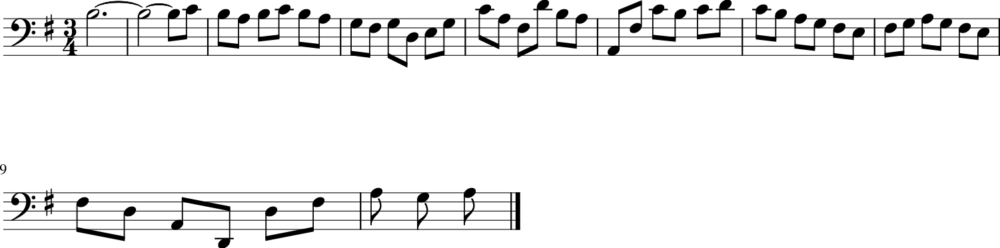

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5084 - loss: 1.1930 - note_outputs_loss: 0.6846
Epoch 477/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5527 - loss: 1.2261 - note_outputs_loss: 0.6734
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


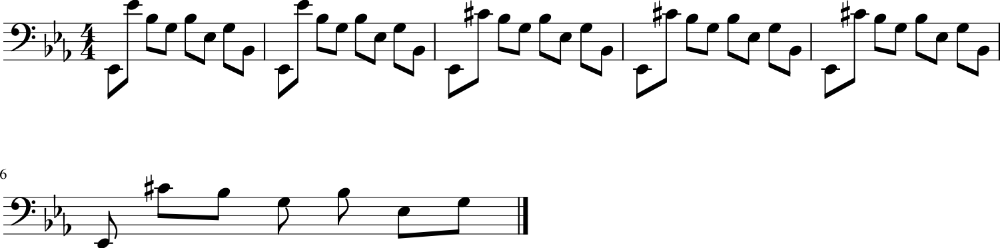

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5524 - loss: 1.2262 - note_outputs_loss: 0.6737
Epoch 478/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4848 - loss: 1.1672 - note_outputs_loss: 0.6824
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


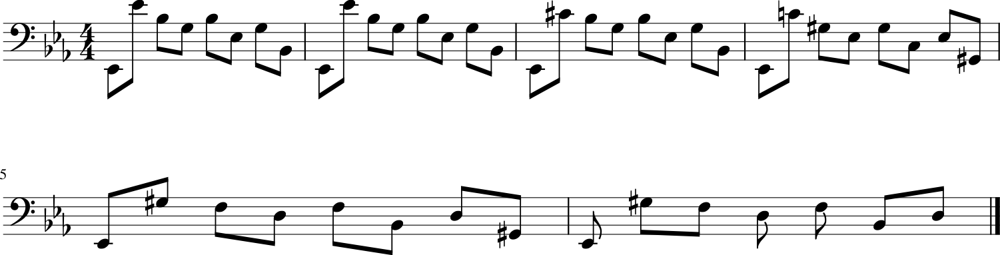

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4852 - loss: 1.1678 - note_outputs_loss: 0.6826
Epoch 479/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5034 - loss: 1.1815 - note_outputs_loss: 0.6781
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E3', 'G3', 'G#3', 'B-3', 'C4', 'C4', 'B-3', 'G#3'], ['0.0', '0.0', '2.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


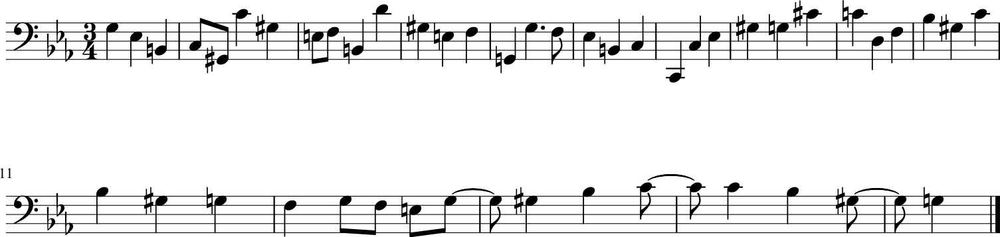

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5036 - loss: 1.1819 - note_outputs_loss: 0.6783
Epoch 480/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5148 - loss: 1.1771 - note_outputs_loss: 0.6622
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'B-3', 'G3', 'A3', 'F3', 'D3', 'F3', 'E3', 'D3', 'C3', 'D3', 'B2', 'C3', 'G3', 'A3', 'F3', 'D3', 'B3', 'C4', 'D4', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'D3', 'C3', 'B2', 'C3', 'D3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


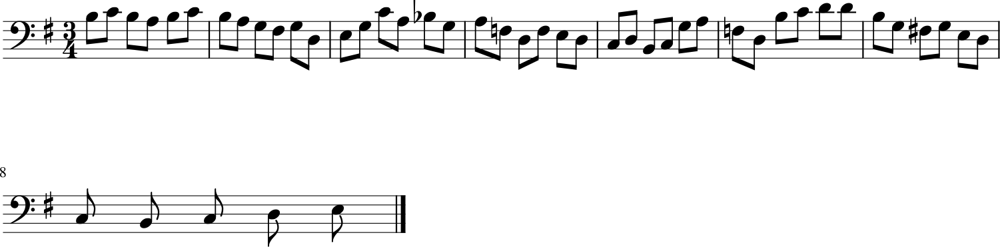

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5150 - loss: 1.1775 - note_outputs_loss: 0.6626
Epoch 481/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5249 - loss: 1.2207 - note_outputs_loss: 0.6957
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'C4', 'D4', 'E-4', 'G3', 'F3', 'E-3', 'E-3', 'rest'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


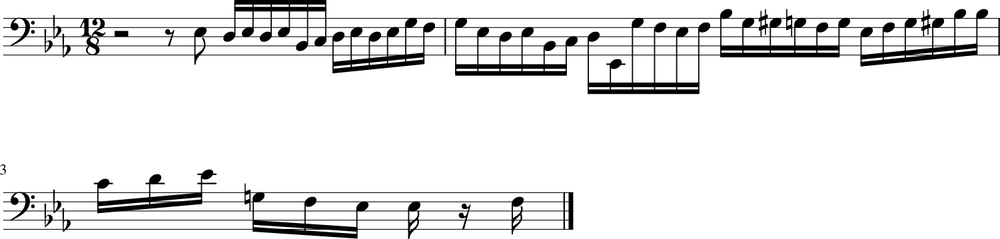

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5249 - loss: 1.2208 - note_outputs_loss: 0.6959
Epoch 482/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5192 - loss: 1.2214 - note_outputs_loss: 0.7022
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3', 'F3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


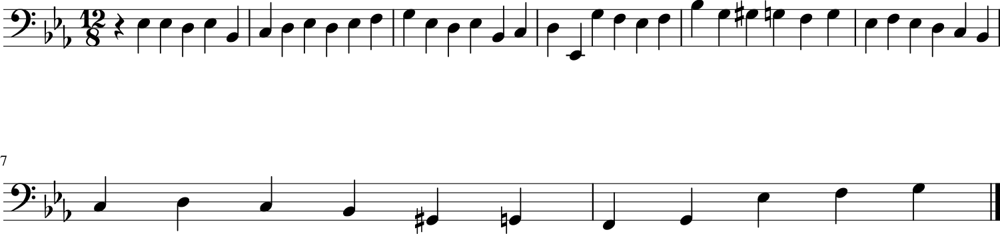

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5192 - loss: 1.2215 - note_outputs_loss: 0.7023
Epoch 483/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4975 - loss: 1.1653 - note_outputs_loss: 0.6678
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


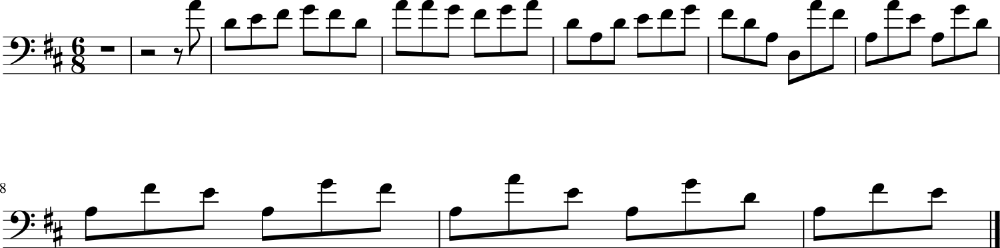

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4978 - loss: 1.1658 - note_outputs_loss: 0.6681
Epoch 484/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5205 - loss: 1.2248 - note_outputs_loss: 0.7043
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'C3', 'D3', 'B2', 'C3', 'C2', 'B2', 'C#3'], ['0.0', '0.0', '0.0', '1.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


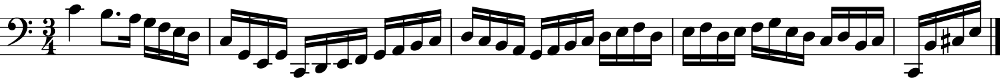

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5205 - loss: 1.2249 - note_outputs_loss: 0.7044
Epoch 485/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5086 - loss: 1.1804 - note_outputs_loss: 0.6718
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'C3', 'B2', 'C3', 'D3', 'F3', 'E-3', 'E3', 'F3', 'B2', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'F3', 'B3', 'D3', 'B3', 'C4', 'G#3', 'F3', 'C4', 'B3', 'A3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


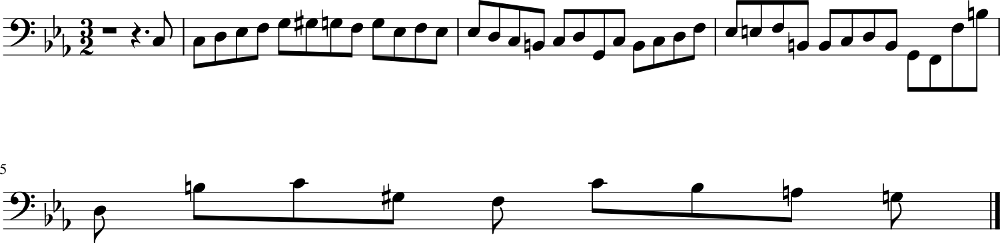

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5087 - loss: 1.1808 - note_outputs_loss: 0.6721
Epoch 486/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5108 - loss: 1.1564 - note_outputs_loss: 0.6456
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


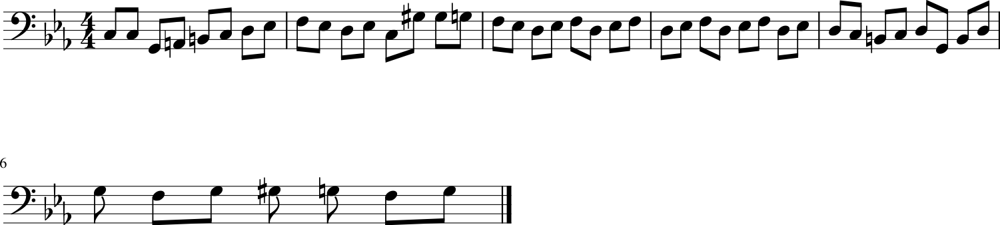

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5109 - loss: 1.1570 - note_outputs_loss: 0.6461
Epoch 487/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5260 - loss: 1.2252 - note_outputs_loss: 0.6992
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


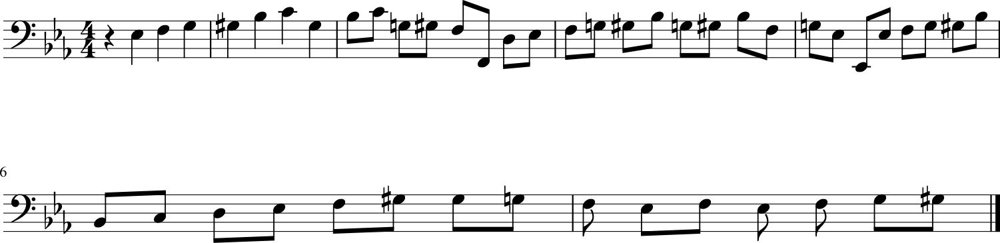

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5260 - loss: 1.2253 - note_outputs_loss: 0.6993
Epoch 488/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5440 - loss: 1.2024 - note_outputs_loss: 0.6584
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'E-4', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'B-2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


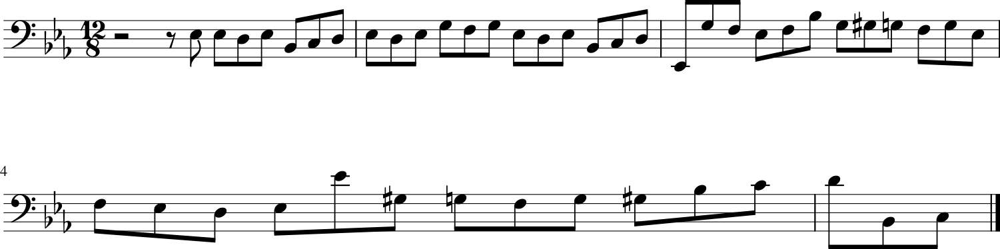

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5438 - loss: 1.2026 - note_outputs_loss: 0.6588
Epoch 489/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5151 - loss: 1.1807 - note_outputs_loss: 0.6656
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'B3', 'E-3', 'D3', 'E-3', 'G3', 'F#3', 'G3', 'A3', 'F#3', 'G3', 'F#3', 'G3', 'D3', 'F#3', 'G3', 'F#3', 'G3', 'D3', 'G2', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'E-2', 'C4', 'B3', 'A3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'E2', 'G3', 'A3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


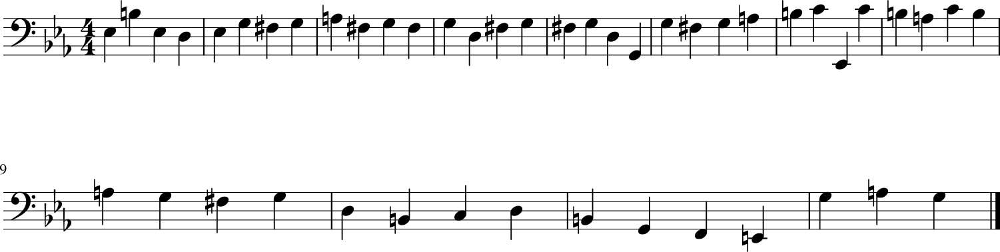

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5152 - loss: 1.1811 - note_outputs_loss: 0.6660
Epoch 490/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4990 - loss: 1.1673 - note_outputs_loss: 0.6682
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


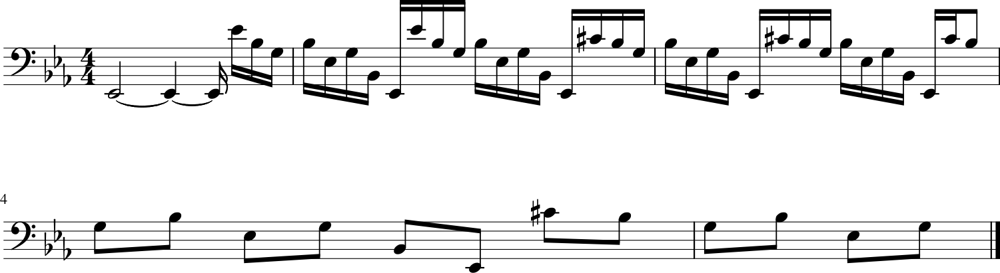

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4992 - loss: 1.1678 - note_outputs_loss: 0.6686
Epoch 491/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5091 - loss: 1.1752 - note_outputs_loss: 0.6661
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


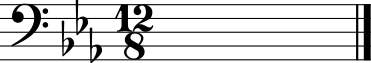

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5092 - loss: 1.1757 - note_outputs_loss: 0.6664
Epoch 492/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5541 - loss: 1.2280 - note_outputs_loss: 0.6739
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'E-3', 'F3', 'B-3', 'D3', 'E-3', 'C3', 'D3', 'F3', 'B-2'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


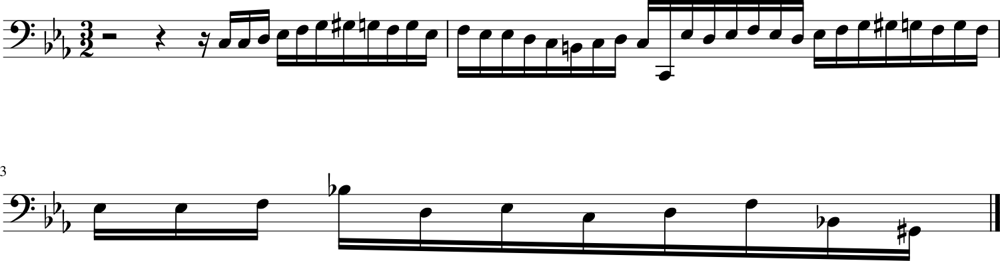

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5538 - loss: 1.2281 - note_outputs_loss: 0.6743
Epoch 493/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4950 - loss: 1.1786 - note_outputs_loss: 0.6837
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'E4', 'E4', 'C#4', 'C#4', 'A3', 'A3', 'G3', 'G3', 'A4', 'A4', 'F#4', 'F#4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


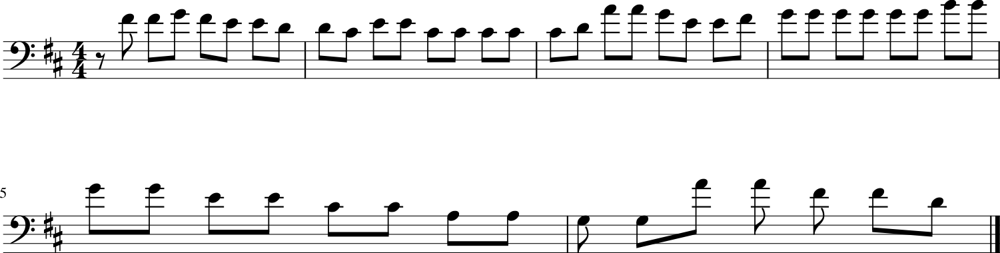

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4952 - loss: 1.1790 - note_outputs_loss: 0.6838
Epoch 494/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5396 - loss: 1.2061 - note_outputs_loss: 0.6665
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


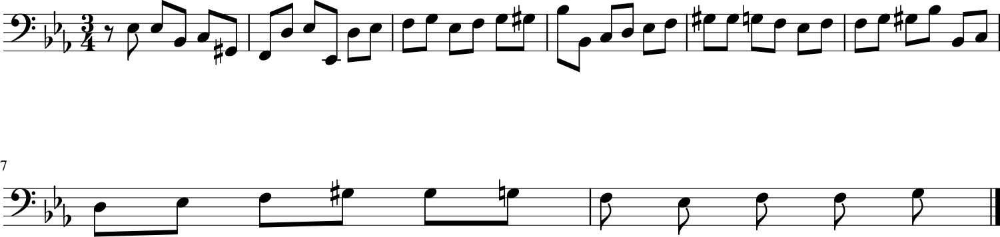

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5395 - loss: 1.2063 - note_outputs_loss: 0.6668
Epoch 495/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4884 - loss: 1.1601 - note_outputs_loss: 0.6716
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


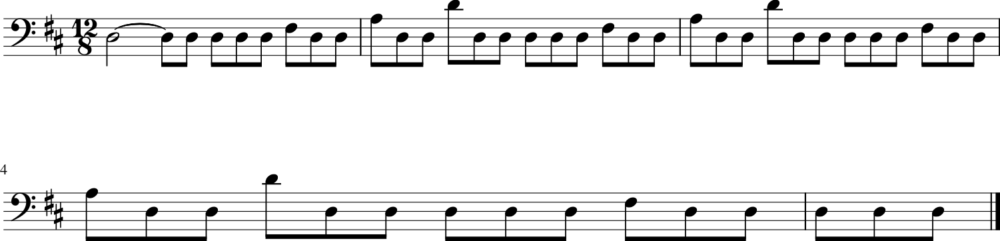

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4887 - loss: 1.1606 - note_outputs_loss: 0.6719
Epoch 496/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4876 - loss: 1.1728 - note_outputs_loss: 0.6852
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'E-3', 'B-3'], ['0.0', '0.0', '0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


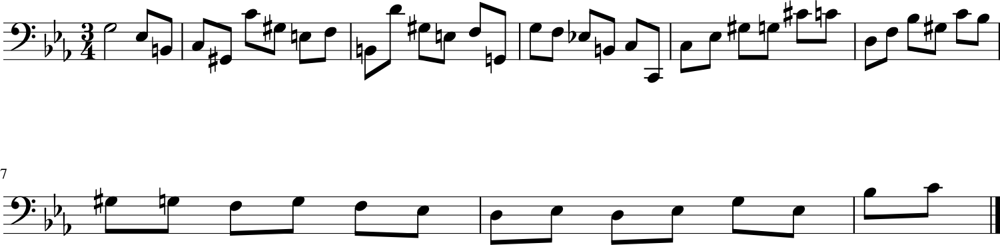

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4879 - loss: 1.1732 - note_outputs_loss: 0.6853
Epoch 497/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5387 - loss: 1.2483 - note_outputs_loss: 0.7096
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'D3', 'D3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B-3', 'C4', 'D4', 'E3', 'B-2', 'A2', 'G2', 'A2', 'F3', 'G2', 'F2', 'C2', 'G2', 'F3', 'E3', 'F3', 'A3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


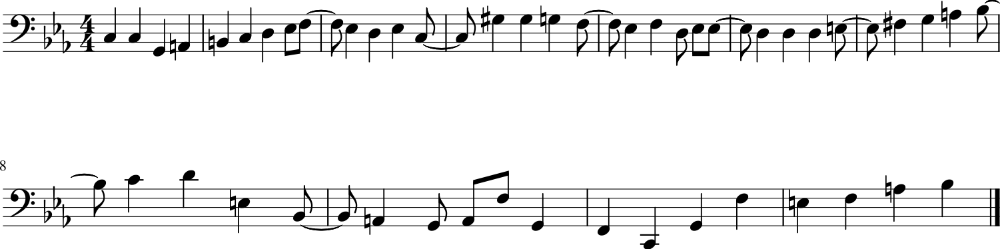

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5386 - loss: 1.2482 - note_outputs_loss: 0.7096
Epoch 498/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5517 - loss: 1.2621 - note_outputs_loss: 0.7104
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


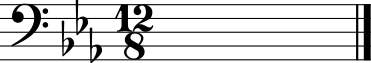

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5514 - loss: 1.2618 - note_outputs_loss: 0.7103
Epoch 499/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5411 - loss: 1.2476 - note_outputs_loss: 0.7064
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'G3', 'D3', 'E-3', 'F3', 'D3', 'B-2', 'G#2', 'G2', 'B-2', 'C3', 'D3', 'E-3', 'C#4', 'G#2', 'C4', 'F3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


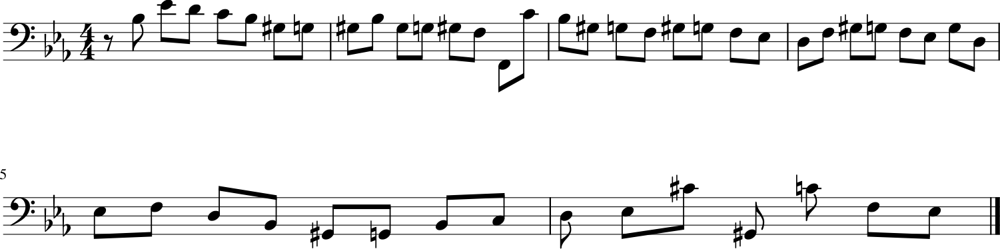

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5410 - loss: 1.2473 - note_outputs_loss: 0.7064
Epoch 500/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5390 - loss: 1.2219 - note_outputs_loss: 0.6829
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'C4', 'D4', 'C4', 'C4', 'A3', 'B-3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F#3', 'G3', 'B-3', 'A3', 'G3', 'F#3', 'G3', 'A3', 'G3', 'G2', 'G3', 'A3', 'G3', 'A3', 'G3', 'F3', 'E3', 'D3', 'F#3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


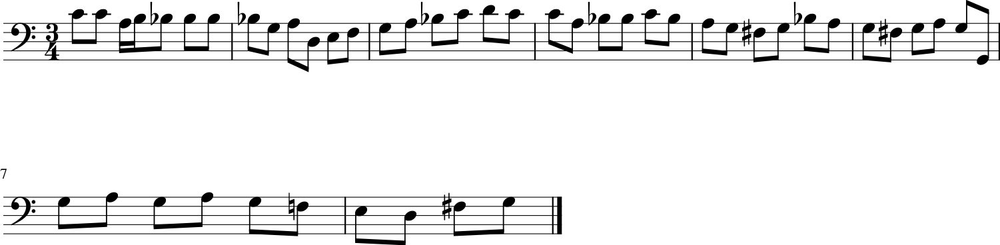

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5389 - loss: 1.2219 - note_outputs_loss: 0.6830
Epoch 501/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5441 - loss: 1.2437 - note_outputs_loss: 0.6996
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


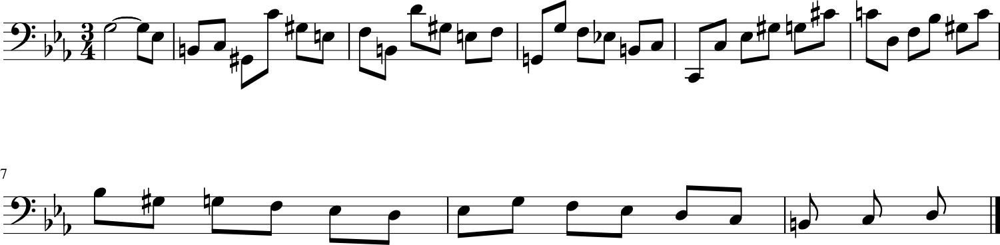

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5439 - loss: 1.2436 - note_outputs_loss: 0.6996
Epoch 502/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5178 - loss: 1.1669 - note_outputs_loss: 0.6491
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


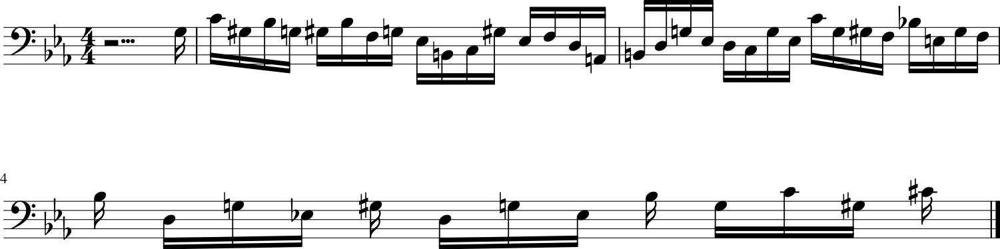

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5178 - loss: 1.1674 - note_outputs_loss: 0.6495
Epoch 503/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5147 - loss: 1.1834 - note_outputs_loss: 0.6687
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'C#4', 'E-3', 'A3', 'C3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'F2', 'G#3', 'G#3', 'G3', 'G#3', 'F3', 'D4', 'C4', 'D4', 'B-3', 'F4', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'G3', 'G#3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


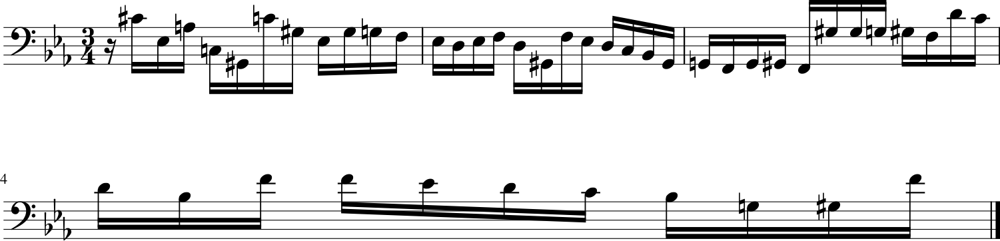

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5148 - loss: 1.1838 - note_outputs_loss: 0.6690
Epoch 504/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5489 - loss: 1.2347 - note_outputs_loss: 0.6857
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'G#2', 'E-3', 'D3', 'D3', 'C3', 'D3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


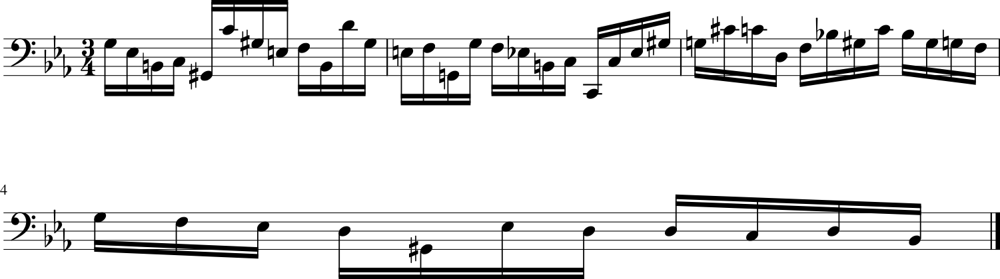

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5487 - loss: 1.2346 - note_outputs_loss: 0.6859
Epoch 505/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4641 - loss: 1.1290 - note_outputs_loss: 0.6650
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'G3', 'E3', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D4', 'C4', 'G3', 'A3', 'F3', 'E3', 'F3', 'G3', 'E3', 'A2', 'D3', 'C#3', 'D3', 'E3', 'A2'], ['0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


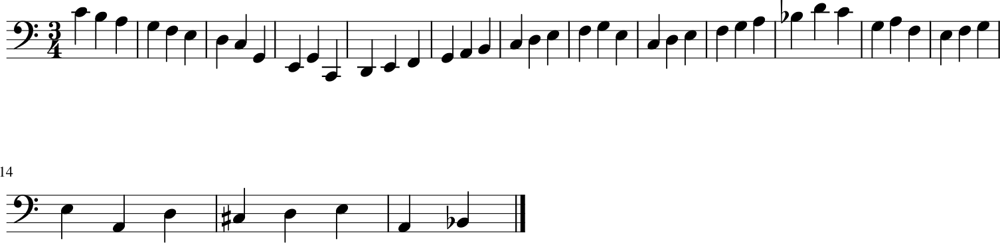

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4647 - loss: 1.1300 - note_outputs_loss: 0.6653
Epoch 506/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5425 - loss: 1.2132 - note_outputs_loss: 0.6707
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'E-3', 'G3', 'B-3', 'E-4', 'C4', 'G3', 'G2', 'B-3', 'G#3', 'B-3', 'C4', 'A3', 'B-3', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


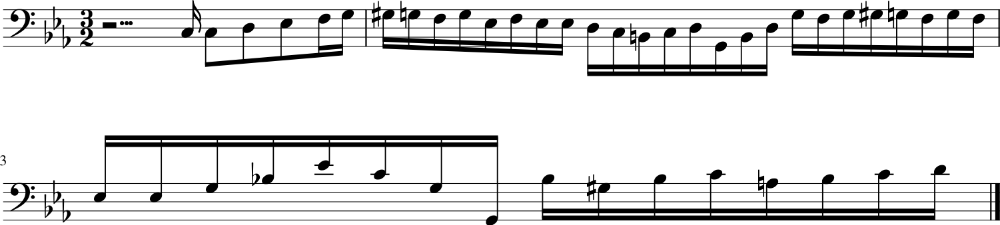

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5424 - loss: 1.2133 - note_outputs_loss: 0.6709
Epoch 507/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5094 - loss: 1.1660 - note_outputs_loss: 0.6566
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'G3', 'F3', 'E-3', 'E-3', 'rest'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


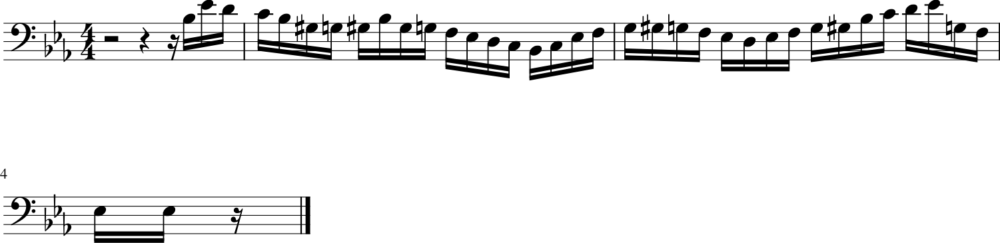

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5096 - loss: 1.1665 - note_outputs_loss: 0.6569
Epoch 508/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5419 - loss: 1.2124 - note_outputs_loss: 0.6705
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'G#3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


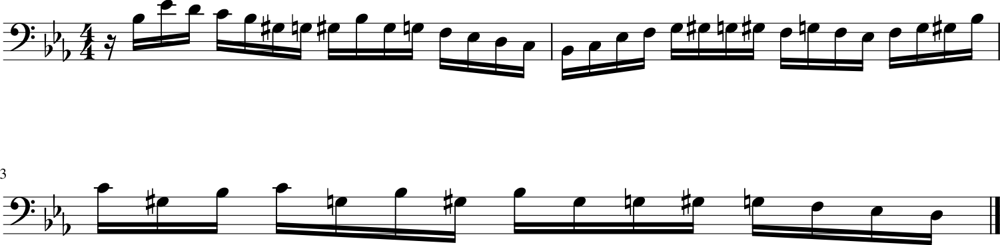

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5417 - loss: 1.2125 - note_outputs_loss: 0.6708
Epoch 509/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4936 - loss: 1.1780 - note_outputs_loss: 0.6843
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'E-3', 'E-3', 'C3', 'D3', 'F3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'C#4', 'C#4', 'B-3', 'C4', 'E4', 'G4', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'B-3', 'D4', 'F4', 'A3', 'B-3', 'B-3', 'D4', 'G4', 'A3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


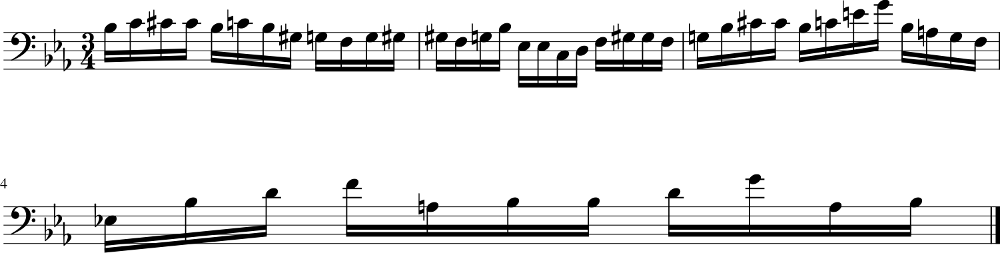

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4939 - loss: 1.1784 - note_outputs_loss: 0.6845
Epoch 510/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5155 - loss: 1.1887 - note_outputs_loss: 0.6732
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4', 'F#3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


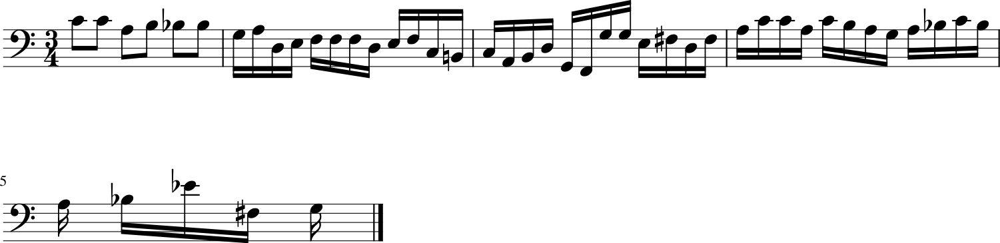

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5156 - loss: 1.1891 - note_outputs_loss: 0.6735
Epoch 511/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5727 - loss: 1.2544 - note_outputs_loss: 0.6818
Generation prompt: [['START', 'E-:major', '12/8TS', '3/4TS', 'D3', 'E-3', 'D3', 'E-3', 'B2', 'C3', 'D3', 'E-3', 'G3', 'A3', 'B-3', 'D4', 'A3', 'G3', 'F#3', 'A3', 'D3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'G#3', 'F3', 'B2', 'G3', 'E-3', 'C2', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'C4', 'E-4', 'B-3'], ['0.0', '0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


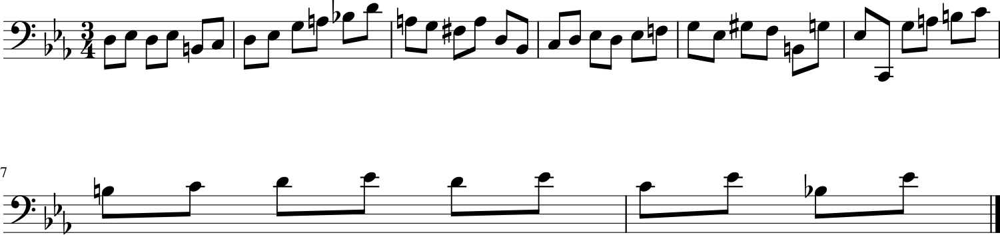

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5722 - loss: 1.2542 - note_outputs_loss: 0.6819
Epoch 512/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4657 - loss: 1.1675 - note_outputs_loss: 0.7018
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '2.75', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12']]


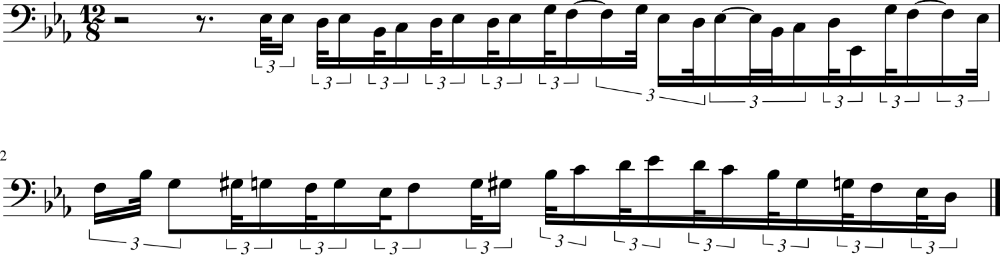

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4662 - loss: 1.1679 - note_outputs_loss: 0.7017
Epoch 513/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5369 - loss: 1.2189 - note_outputs_loss: 0.6820
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


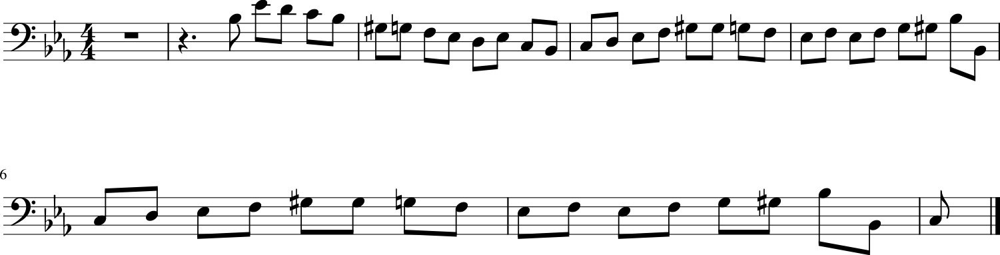

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5368 - loss: 1.2189 - note_outputs_loss: 0.6821
Epoch 514/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5004 - loss: 1.1573 - note_outputs_loss: 0.6569
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'F2', 'G2', 'D3', 'D3', 'D3', 'C3', 'C3', 'G3', 'G#2', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'G#2', 'G2', 'B2', 'D3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/3', '1/3', '1/12', '1/3', '1/3', '1/3', '1/12', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3']]


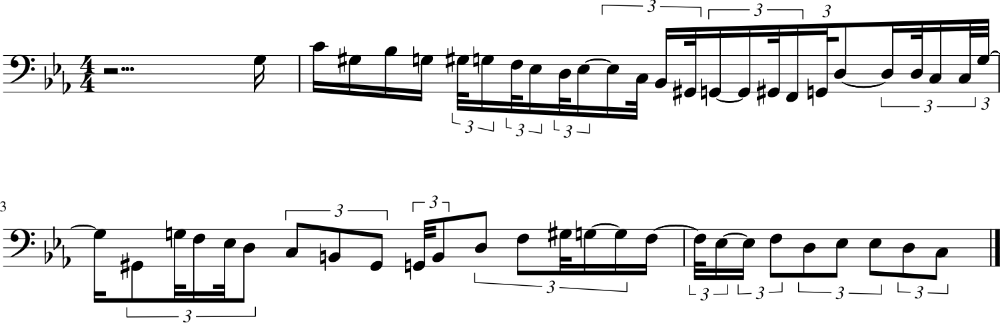

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5006 - loss: 1.1579 - note_outputs_loss: 0.6573
Epoch 515/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4927 - loss: 1.1755 - note_outputs_loss: 0.6828
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G#3', 'G3', 'F3', 'B-2', 'G#3', 'G3', 'F3', 'E-2', 'G3', 'F3', 'E-3', 'A2', 'F#3', 'F3', 'E-3', 'D3', 'F3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B-2', 'D4', 'E-4', 'rest'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


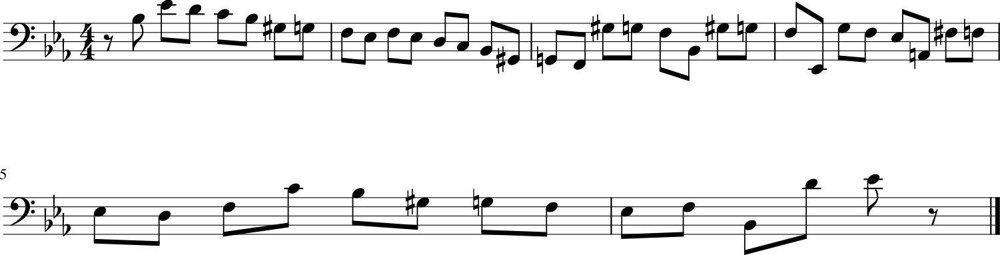

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4929 - loss: 1.1760 - note_outputs_loss: 0.6830
Epoch 516/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5115 - loss: 1.2103 - note_outputs_loss: 0.6988
Generation prompt: [['START', 'F:major', '3/4TS', 'G2', 'B-3', 'A3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'D3', 'G3', 'F3', 'E3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'A3', 'B-3', 'B-3', 'A3', 'B-3', 'G3', 'C4', 'A3', 'D4', 'E4', 'C#4', 'E4', 'D4', 'E4', 'F4', 'E4', 'D4', 'C#4', 'E4', 'A3', 'G3', 'A3', 'D4', 'C#4', 'G4', 'F4', 'E4', 'F4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


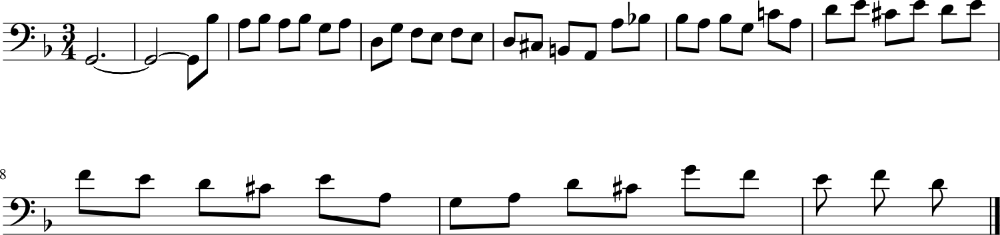

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5116 - loss: 1.2104 - note_outputs_loss: 0.6988
Epoch 517/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5272 - loss: 1.1959 - note_outputs_loss: 0.6688
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'A3', 'D4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'B3', 'D3', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'G3', 'A3', 'F3', 'D3', 'F3', 'E3', 'D3', 'C3', 'D3', 'B2', 'C3', 'C2', 'B2', 'C#3', 'E3', 'A3', 'E3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


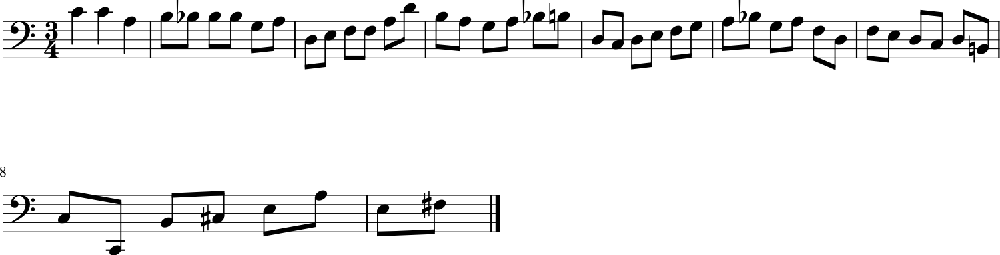

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5272 - loss: 1.1961 - note_outputs_loss: 0.6690
Epoch 518/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4882 - loss: 1.1533 - note_outputs_loss: 0.6651
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'B-2', 'C3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


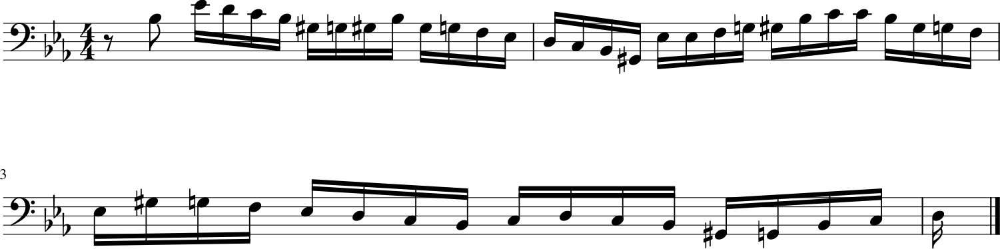

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4885 - loss: 1.1538 - note_outputs_loss: 0.6653
Epoch 519/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5476 - loss: 1.1986 - note_outputs_loss: 0.6510
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'F#3', 'F3', 'F#3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'A2', 'C3', 'E-3', 'F#3', 'F3', 'F#3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'A2', 'C3', 'E-3', 'F#3', 'F3', 'F#3', 'E-3'], ['0.0', '0.0', '0.0', '3.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


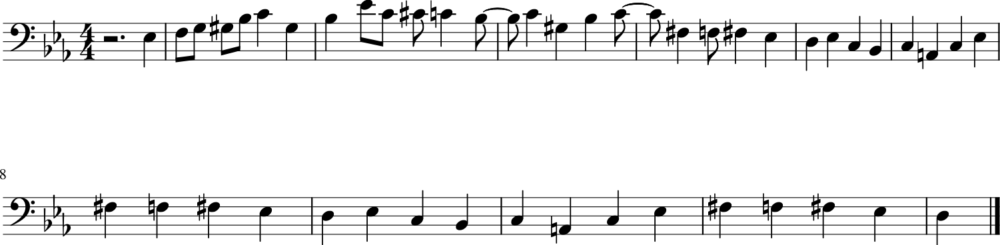

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5474 - loss: 1.1988 - note_outputs_loss: 0.6514
Epoch 520/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5503 - loss: 1.2038 - note_outputs_loss: 0.6535
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


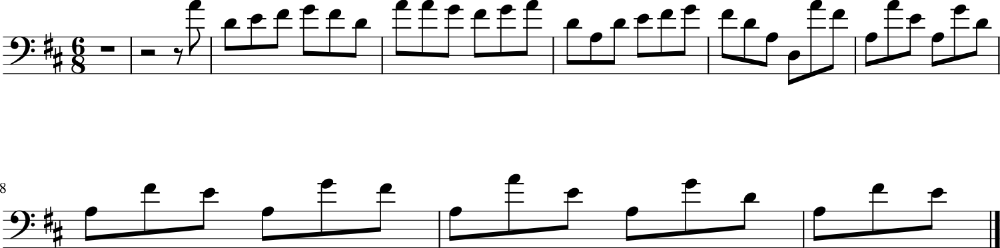

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5500 - loss: 1.2039 - note_outputs_loss: 0.6539
Epoch 521/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5393 - loss: 1.2035 - note_outputs_loss: 0.6643
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'G3', 'D3', 'C3', 'B2', 'A2', 'G2', 'D3', 'F#3', 'A3', 'C4', 'A3', 'F#3', 'D3', 'B3', 'D3', 'E3', 'G3', 'A3', 'C#4', 'D4', 'A3', 'F#3', 'E3', 'D3', 'F3', 'G3', 'B3', 'C4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


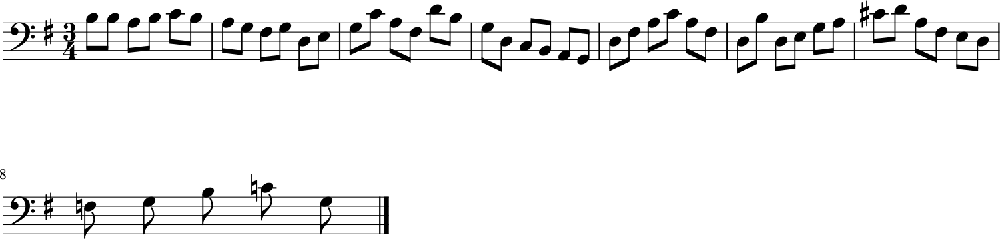

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5391 - loss: 1.2037 - note_outputs_loss: 0.6645
Epoch 522/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5324 - loss: 1.1888 - note_outputs_loss: 0.6565
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'E4', 'E4', 'C#4', 'C#4', 'A3', 'A3', 'G3', 'G3', 'A4', 'A4', 'F#4', 'F#4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


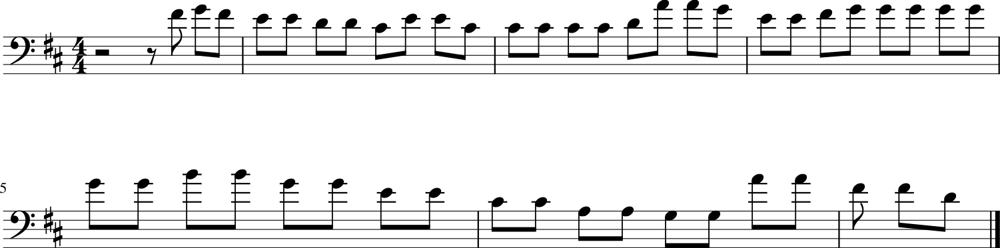

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5323 - loss: 1.1892 - note_outputs_loss: 0.6569
Epoch 523/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5690 - loss: 1.2461 - note_outputs_loss: 0.6771
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


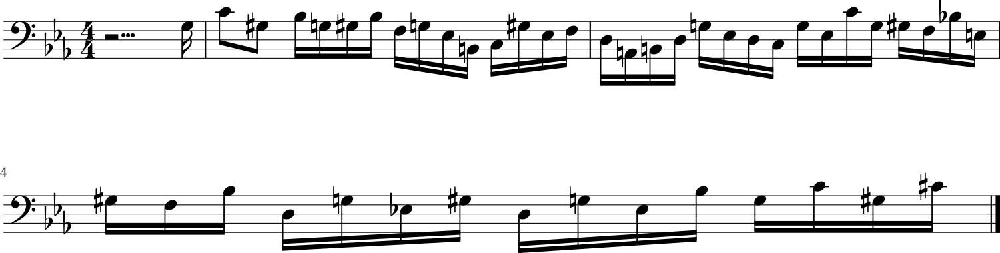

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5686 - loss: 1.2459 - note_outputs_loss: 0.6773
Epoch 524/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5430 - loss: 1.2193 - note_outputs_loss: 0.6763
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


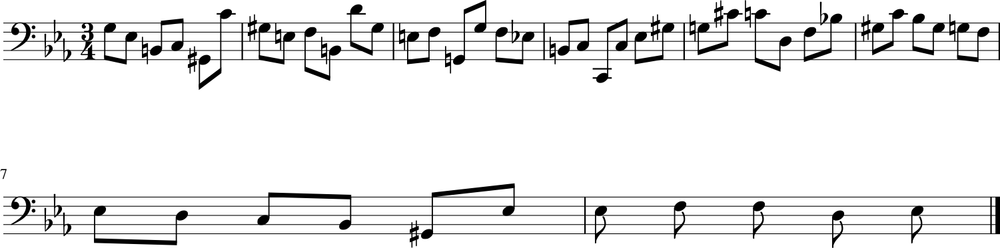

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5428 - loss: 1.2193 - note_outputs_loss: 0.6764
Epoch 525/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5474 - loss: 1.2072 - note_outputs_loss: 0.6598
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'E4', 'E4', 'C#4', 'C#4', 'A3', 'A3', 'G3', 'G3', 'A4', 'A4', 'F#4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


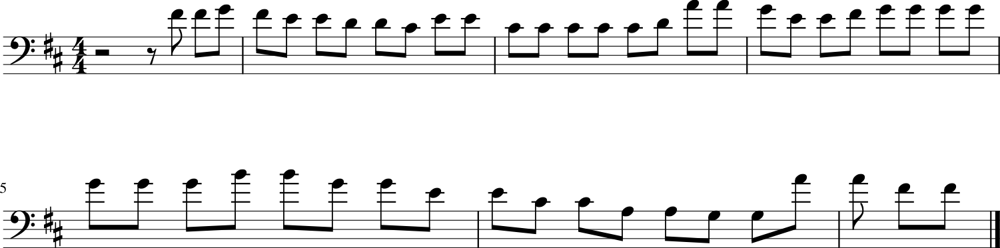

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5472 - loss: 1.2073 - note_outputs_loss: 0.6601
Epoch 526/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4931 - loss: 1.1499 - note_outputs_loss: 0.6568
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'F3', 'A3', 'B2', 'G3', 'C#3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


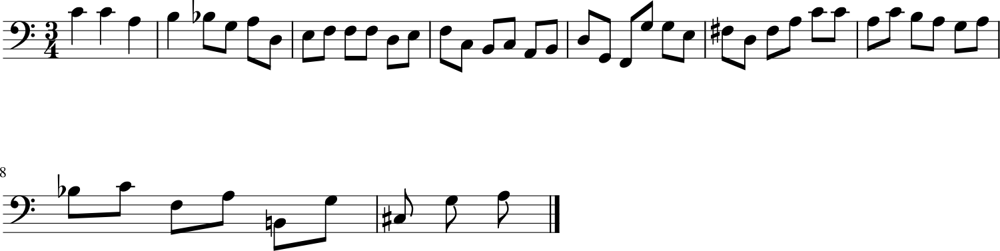

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4934 - loss: 1.1505 - note_outputs_loss: 0.6572
Epoch 527/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5086 - loss: 1.1747 - note_outputs_loss: 0.6661
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


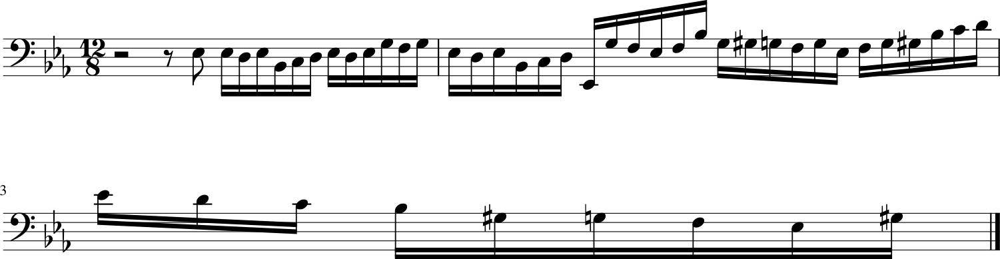

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5088 - loss: 1.1751 - note_outputs_loss: 0.6664
Epoch 528/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5233 - loss: 1.1999 - note_outputs_loss: 0.6766
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


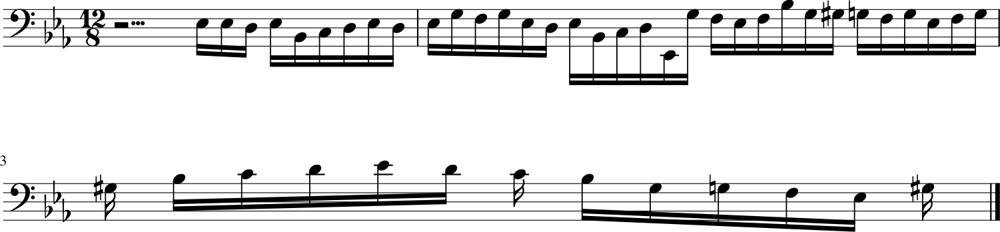

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5233 - loss: 1.2001 - note_outputs_loss: 0.6768
Epoch 529/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5133 - loss: 1.1877 - note_outputs_loss: 0.6743
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'D3', 'B2', 'A2', 'B2', 'D3', 'E2', 'F#3', 'A3', 'C4', 'D4', 'B3', 'C4', 'A3', 'A3', 'C3', 'D3', 'B3', 'E3', 'G#3', 'A3', 'D4', 'E4', 'B3', 'C4', 'F3', 'G3', 'B-3', 'B-3', 'C3', 'E2', 'B-3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


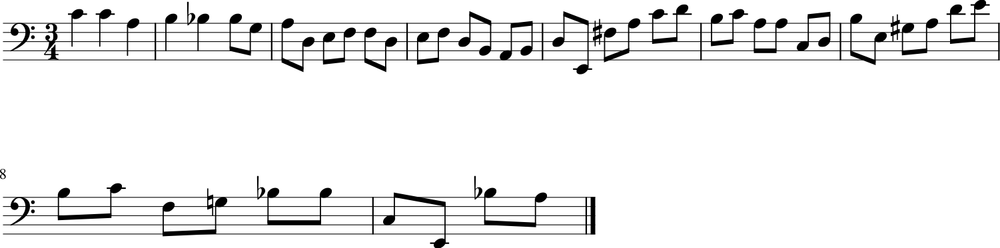

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5135 - loss: 1.1880 - note_outputs_loss: 0.6745
Epoch 530/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4730 - loss: 1.1472 - note_outputs_loss: 0.6742
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'D4', 'C4', 'B3', 'A3', 'B3', 'G3', 'F3', 'E3', 'F3', 'D3', 'E3', 'C3', 'G2', 'E2', 'F3', 'E3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


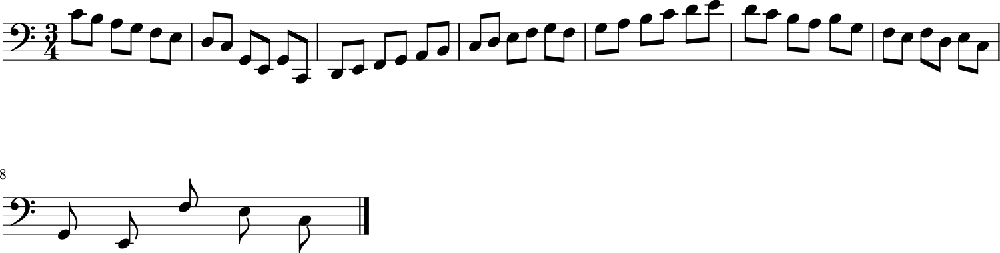

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4735 - loss: 1.1478 - note_outputs_loss: 0.6744
Epoch 531/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5191 - loss: 1.1749 - note_outputs_loss: 0.6558
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


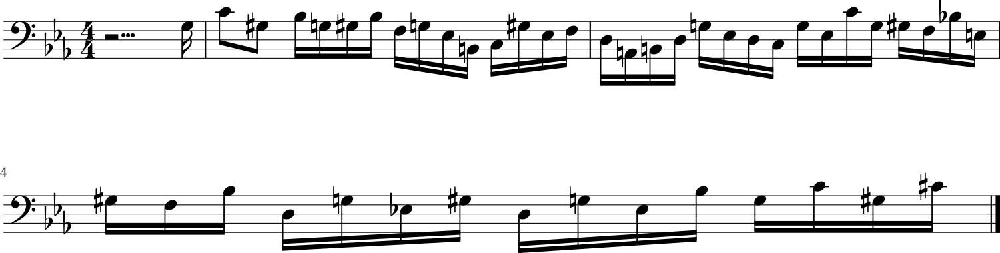

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.5192 - loss: 1.1753 - note_outputs_loss: 0.6562
Epoch 532/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4837 - loss: 1.1470 - note_outputs_loss: 0.6633
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'G2', 'B2', 'D3', 'A2', 'D3', 'G2', 'D3', 'A2', 'B-2', 'G2', 'A2', 'F2', 'E2', 'G3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'G3', 'F3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


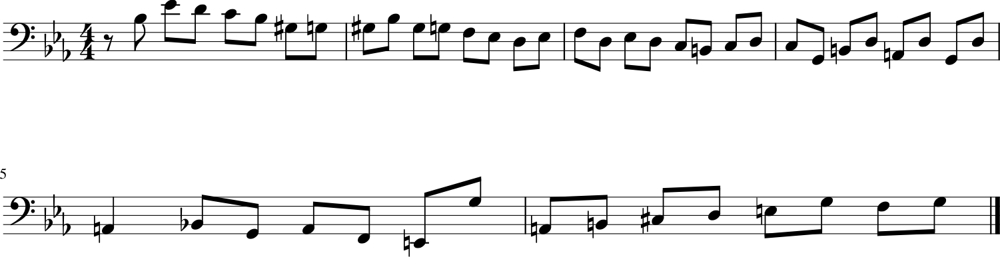

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4841 - loss: 1.1476 - note_outputs_loss: 0.6635
Epoch 533/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5404 - loss: 1.1972 - note_outputs_loss: 0.6568
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'E3', 'C3', 'C2', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'D3', 'D2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'G3', 'A3', 'B-3', 'G3', 'A3', 'F3', 'E3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


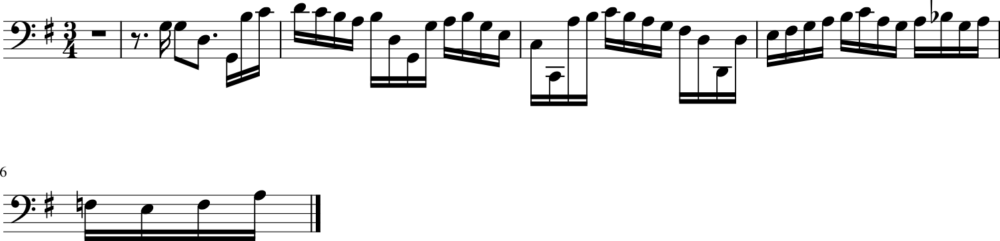

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5402 - loss: 1.1973 - note_outputs_loss: 0.6571
Epoch 534/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5545 - loss: 1.2053 - note_outputs_loss: 0.6508
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B2', 'G#2', 'G2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G2', 'C3', 'G#3', 'E-3', 'F3', 'G3', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'A3', 'B-3', 'G3', 'A3', 'F3', 'E3', 'F3', 'A3', 'F3', 'B-3', 'F3', 'C4', 'F3', 'A3', 'F3', 'E-3', 'D3', 'C3', 'B-2'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


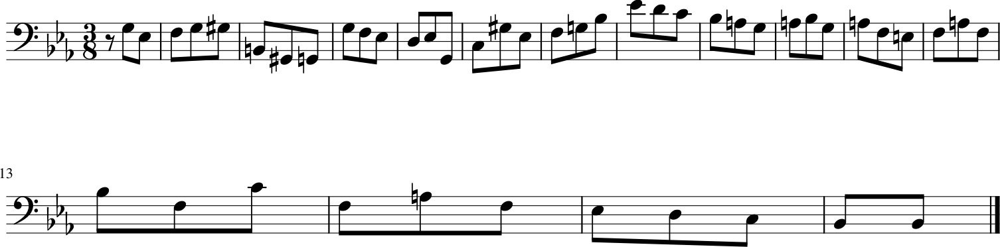

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5542 - loss: 1.2055 - note_outputs_loss: 0.6512
Epoch 535/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5207 - loss: 1.1942 - note_outputs_loss: 0.6735
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'C#4', 'G2', 'C#4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'C#4', 'G#2', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'C4', 'G2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'F3', 'E-3', 'D3', 'E-3', 'F3'], ['0.0', '3.0', '1.0', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


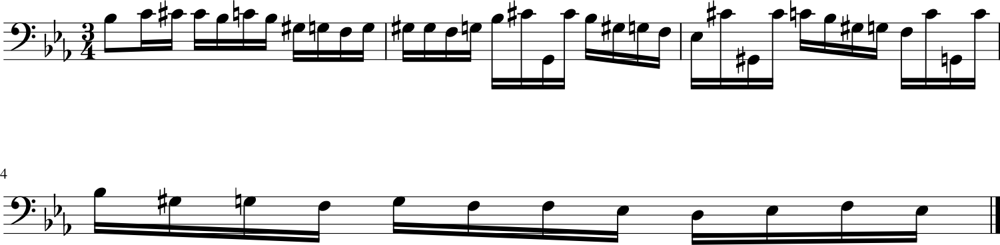

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5207 - loss: 1.1944 - note_outputs_loss: 0.6737
Epoch 536/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5320 - loss: 1.2307 - note_outputs_loss: 0.6988
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


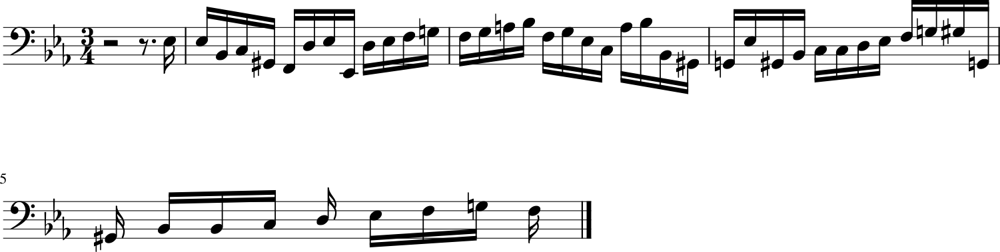

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5319 - loss: 1.2307 - note_outputs_loss: 0.6988
Epoch 537/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5055 - loss: 1.1451 - note_outputs_loss: 0.6397
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


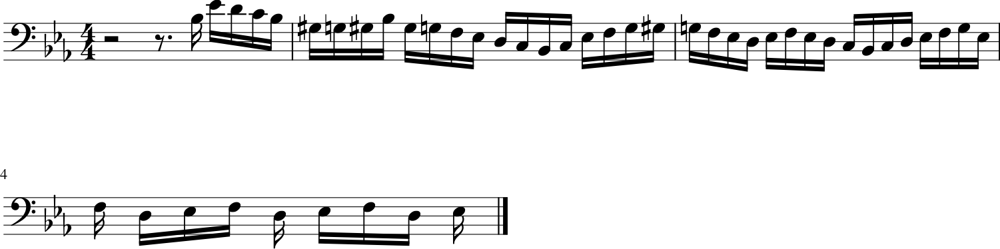

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5056 - loss: 1.1458 - note_outputs_loss: 0.6401
Epoch 538/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4805 - loss: 1.1579 - note_outputs_loss: 0.6774
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


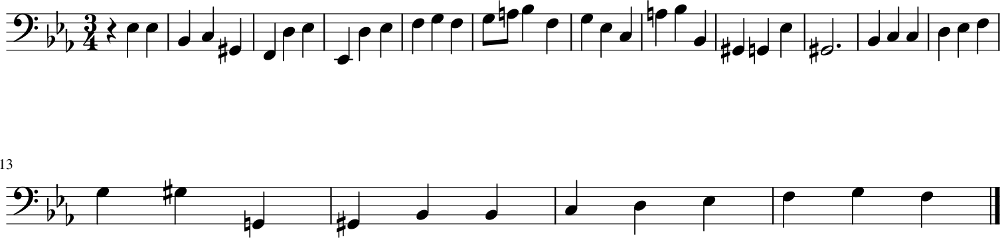

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4809 - loss: 1.1584 - note_outputs_loss: 0.6775
Epoch 539/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5384 - loss: 1.1923 - note_outputs_loss: 0.6539
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'B-3', 'G3', 'G#3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


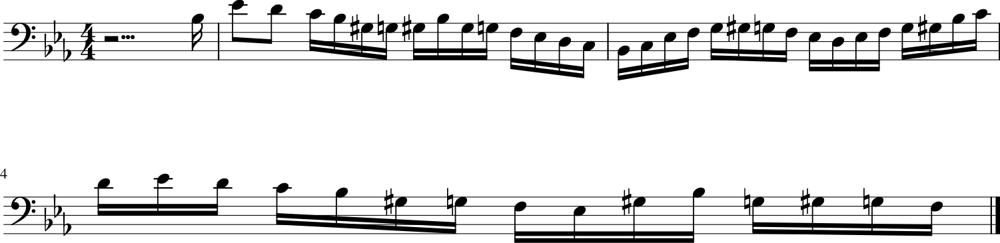

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5382 - loss: 1.1926 - note_outputs_loss: 0.6543
Epoch 540/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4922 - loss: 1.1646 - note_outputs_loss: 0.6723
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'D3', 'D3', 'D3', 'D3', 'D3', 'G3', 'F#3', 'G3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'B-3', 'F#3', 'G3', 'E-3', 'D3', 'C3', 'D3', 'B-2', 'C3'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


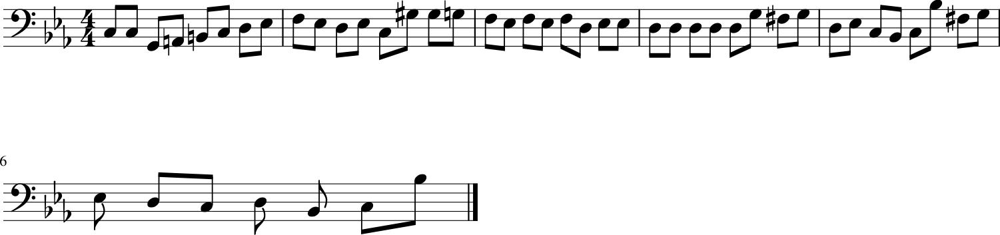

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4925 - loss: 1.1652 - note_outputs_loss: 0.6726
Epoch 541/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5627 - loss: 1.2392 - note_outputs_loss: 0.6766
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


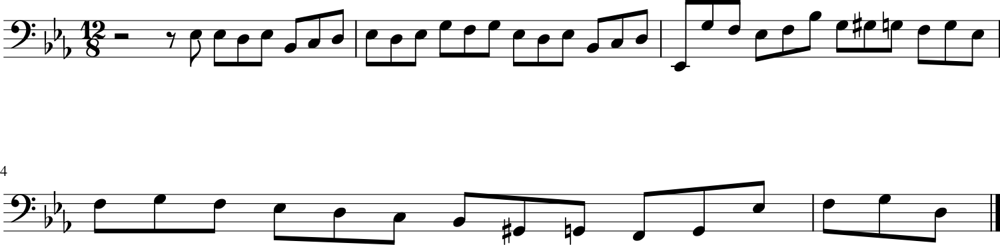

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5623 - loss: 1.2391 - note_outputs_loss: 0.6768
Epoch 542/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4966 - loss: 1.1841 - note_outputs_loss: 0.6875
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


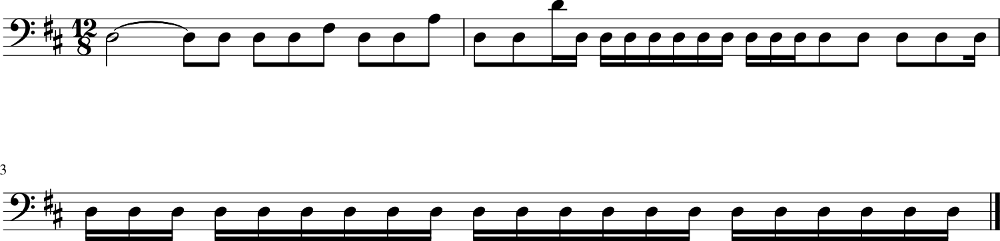

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4969 - loss: 1.1845 - note_outputs_loss: 0.6876
Epoch 543/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5620 - loss: 1.2279 - note_outputs_loss: 0.6659
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


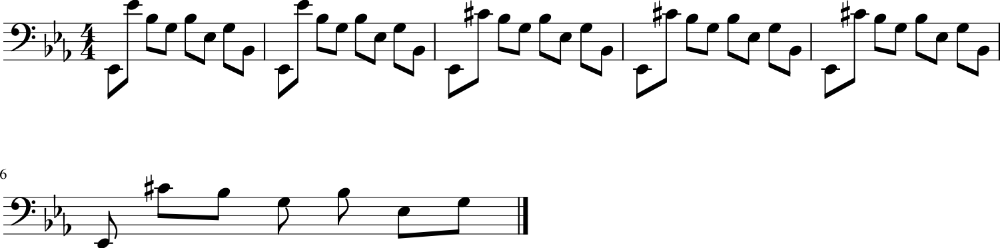

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5616 - loss: 1.2277 - note_outputs_loss: 0.6661
Epoch 544/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5037 - loss: 1.1800 - note_outputs_loss: 0.6763
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


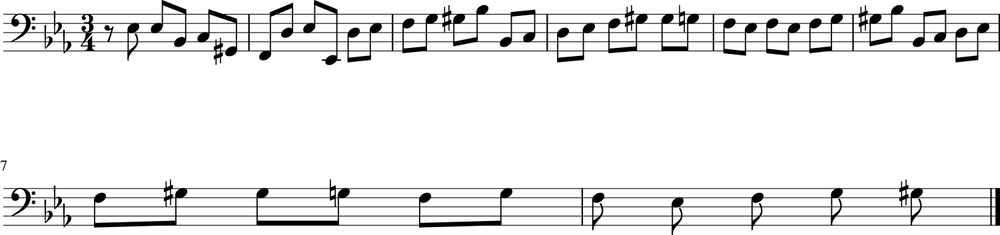

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5039 - loss: 1.1804 - note_outputs_loss: 0.6765
Epoch 545/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5693 - loss: 1.2172 - note_outputs_loss: 0.6479
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'F3', 'D3', 'F3', 'D3', 'F3', 'E3', 'F3', 'C3', 'F3', 'B2', 'F3', 'A2', 'G2', 'B3', 'C4', 'E-4', 'F3', 'D4', 'G3', 'B3', 'C4', 'C2', 'G2', 'A2', 'B2', 'C3', 'B2', 'C3', 'B2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


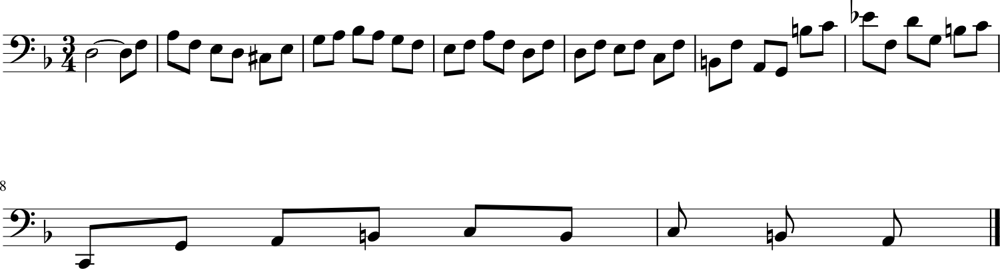

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5689 - loss: 1.2172 - note_outputs_loss: 0.6483
Epoch 546/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5365 - loss: 1.1965 - note_outputs_loss: 0.6601
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'G#3', 'F3', 'G3', 'G#3', 'B-3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'E-3', 'C3', 'B-2', 'G#2', 'G2', 'G#3', 'C4', 'G#3', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


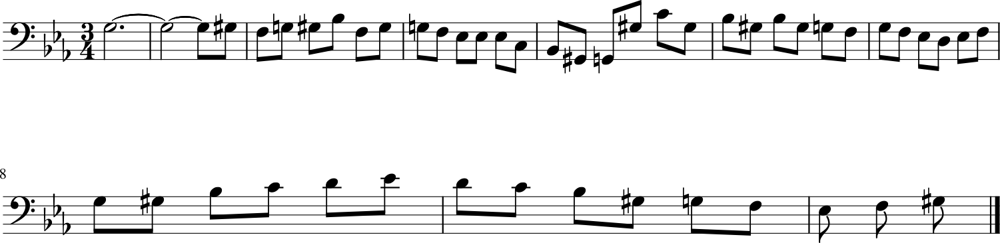

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5363 - loss: 1.1967 - note_outputs_loss: 0.6604
Epoch 547/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5249 - loss: 1.2013 - note_outputs_loss: 0.6763
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


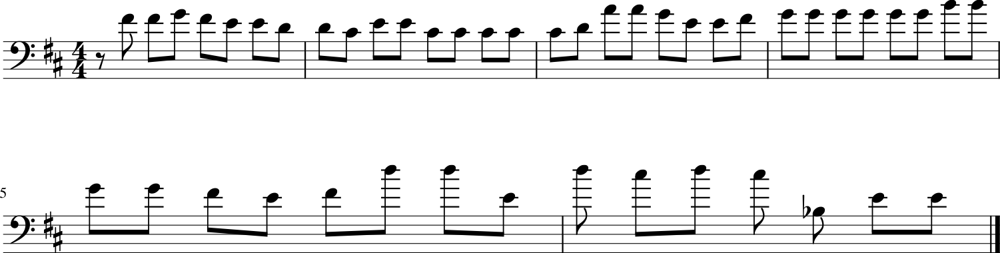

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5250 - loss: 1.2014 - note_outputs_loss: 0.6764
Epoch 548/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5315 - loss: 1.2219 - note_outputs_loss: 0.6904
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


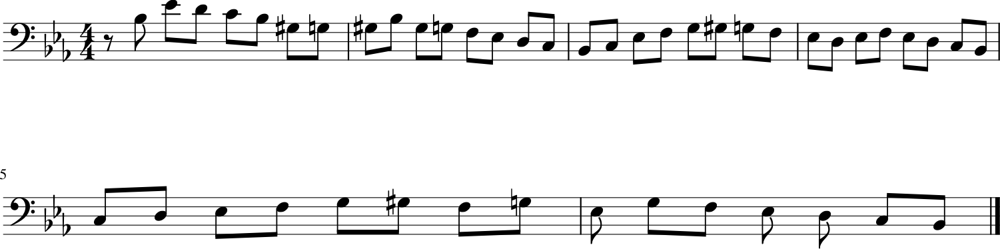

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5314 - loss: 1.2219 - note_outputs_loss: 0.6904
Epoch 549/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5233 - loss: 1.1833 - note_outputs_loss: 0.6600
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3', 'F3', 'G3', 'D3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


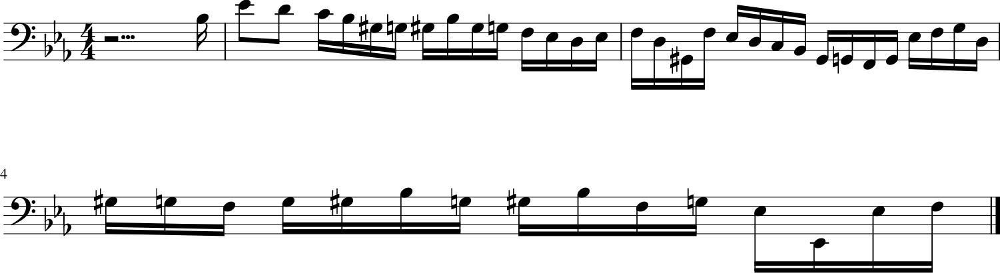

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5233 - loss: 1.1836 - note_outputs_loss: 0.6603
Epoch 550/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5126 - loss: 1.1975 - note_outputs_loss: 0.6849
Generation prompt: [['START', 'E-:major', '3/4TS', 'A3', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'A3', 'G3', 'F3', 'A3', 'E-3', 'A3', 'E-3', 'A3', 'C4', 'B3', 'A3', 'G#3', 'A3', 'B-3', 'C4', 'F#3', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4', 'F#3', 'C4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


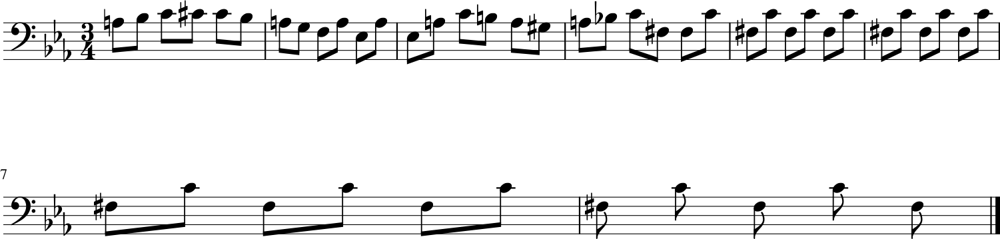

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5127 - loss: 1.1977 - note_outputs_loss: 0.6850
Epoch 551/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5261 - loss: 1.1759 - note_outputs_loss: 0.6497
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'F3', 'F3', 'F3', 'F3', 'F3', 'F3', 'F3', 'F3', 'F3', 'G3', 'F3', 'G3', 'G3', 'C4', 'B-3', 'G3', 'B-3', 'B-3', 'G3', 'B-3', 'E-3', 'C4', 'A3', 'G3', 'A3', 'F3', 'A3', 'E-3', 'A3', 'F3', 'A3', 'D3', 'G#3', 'D3'], ['0.0', '0.0', '2.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


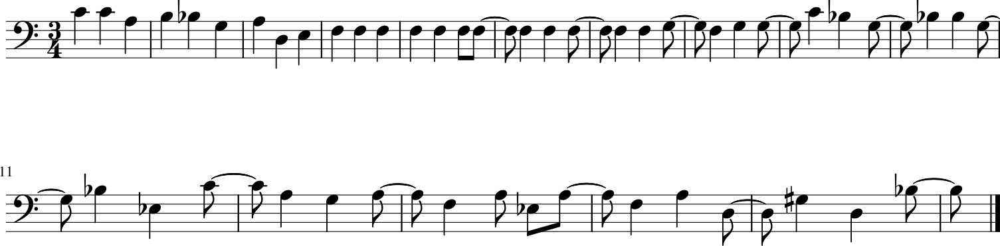

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5261 - loss: 1.1762 - note_outputs_loss: 0.6501
Epoch 552/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5164 - loss: 1.1628 - note_outputs_loss: 0.6465
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


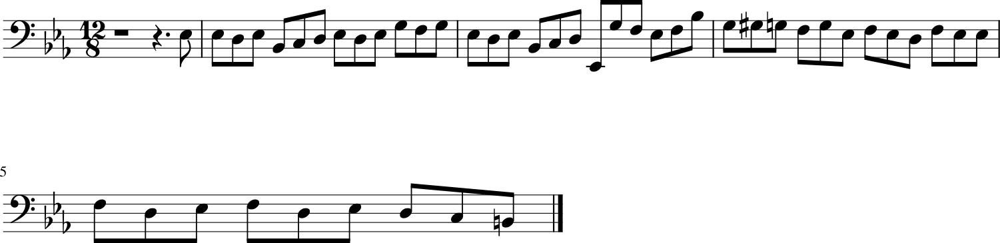

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5164 - loss: 1.1632 - note_outputs_loss: 0.6468
Epoch 553/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4987 - loss: 1.1552 - note_outputs_loss: 0.6566
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'G3', 'B-3', 'D3', 'E-3', 'E-3', 'G3', 'C4', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'F3', 'E-3', 'D3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'C4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '1.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


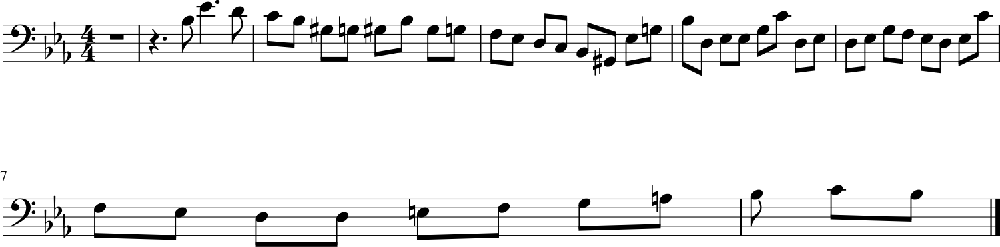

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4989 - loss: 1.1558 - note_outputs_loss: 0.6568
Epoch 554/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5203 - loss: 1.1738 - note_outputs_loss: 0.6535
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5']]


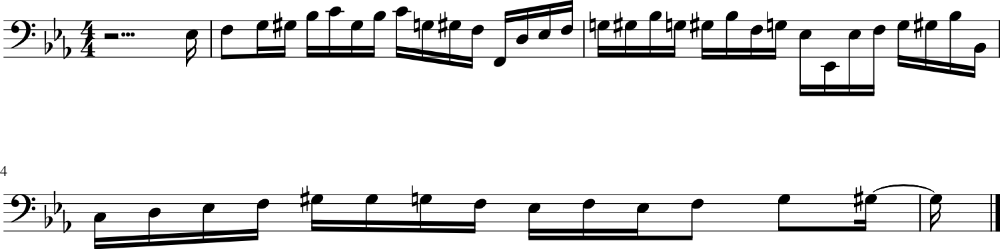

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5204 - loss: 1.1742 - note_outputs_loss: 0.6539
Epoch 555/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5267 - loss: 1.1604 - note_outputs_loss: 0.6337
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


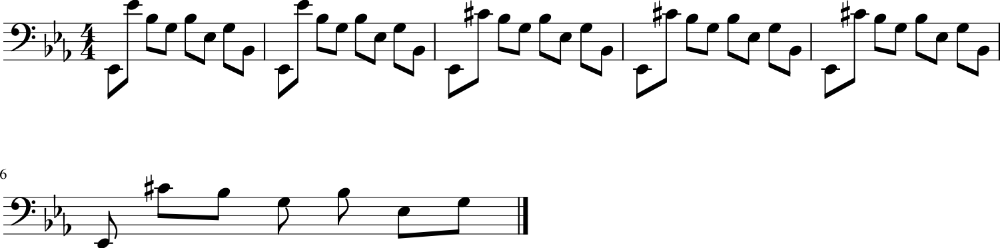

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5266 - loss: 1.1609 - note_outputs_loss: 0.6342
Epoch 556/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5474 - loss: 1.2305 - note_outputs_loss: 0.6831
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '2.5', '0.5', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


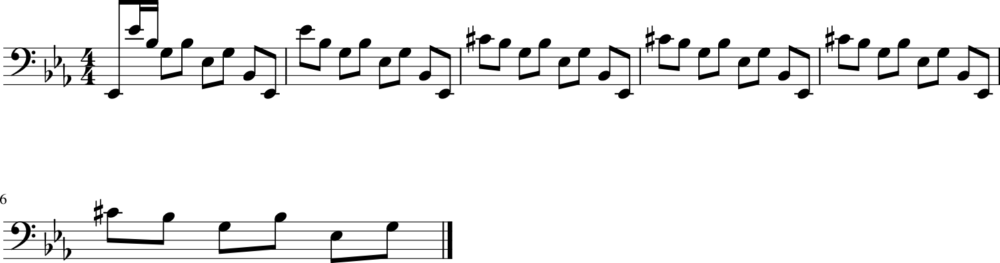

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5472 - loss: 1.2304 - note_outputs_loss: 0.6832
Epoch 557/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4860 - loss: 1.1438 - note_outputs_loss: 0.6578
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4', 'G#3'], ['0.0', '0.0', '0.0', '3.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


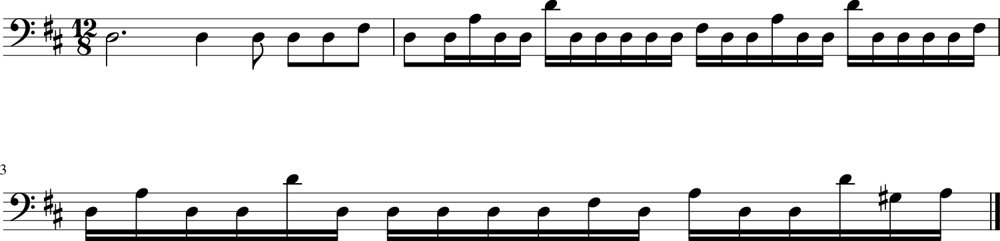

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4863 - loss: 1.1444 - note_outputs_loss: 0.6581
Epoch 558/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5382 - loss: 1.2010 - note_outputs_loss: 0.6628
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


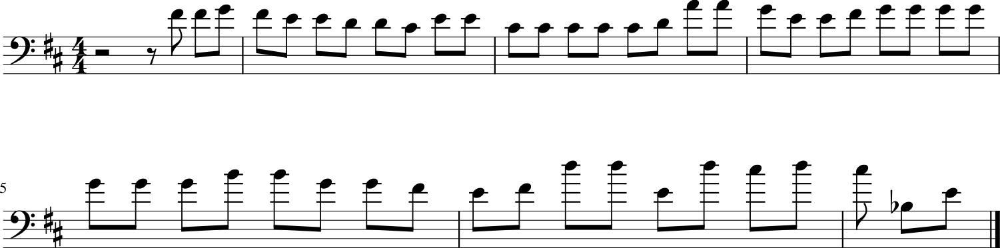

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5381 - loss: 1.2011 - note_outputs_loss: 0.6630
Epoch 559/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4711 - loss: 1.1104 - note_outputs_loss: 0.6393
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


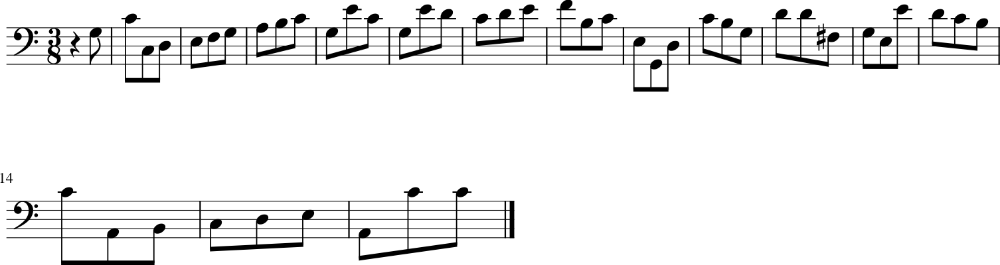

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4716 - loss: 1.1113 - note_outputs_loss: 0.6397
Epoch 560/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5143 - loss: 1.1715 - note_outputs_loss: 0.6572
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


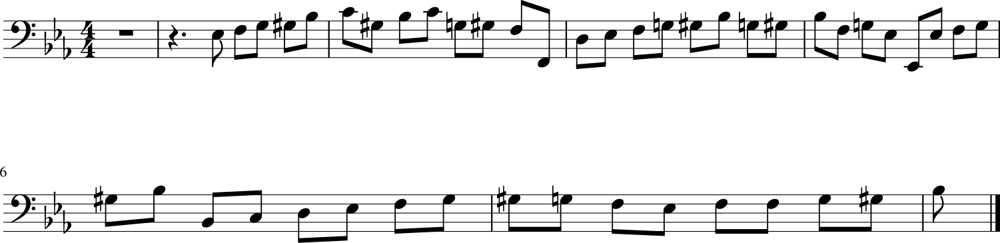

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5144 - loss: 1.1718 - note_outputs_loss: 0.6574
Epoch 561/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5760 - loss: 1.2511 - note_outputs_loss: 0.6751
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'A3', 'B3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


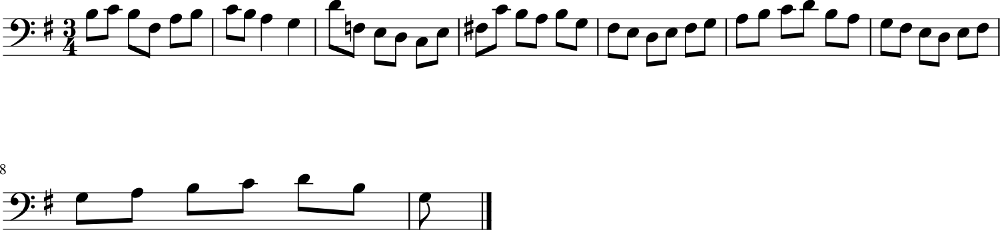

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5755 - loss: 1.2508 - note_outputs_loss: 0.6753
Epoch 562/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5111 - loss: 1.1868 - note_outputs_loss: 0.6757
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'G2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'C3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G#3', 'D3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


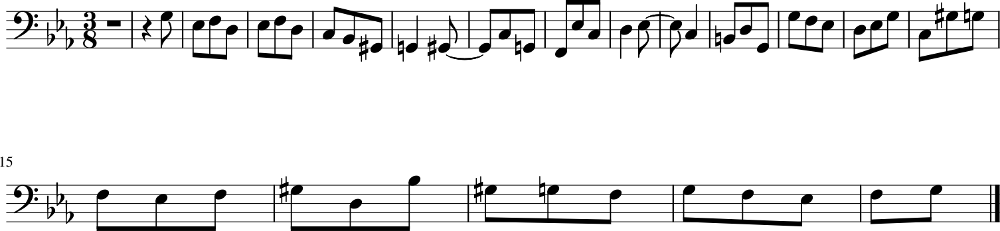

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5112 - loss: 1.1870 - note_outputs_loss: 0.6758
Epoch 563/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5123 - loss: 1.1812 - note_outputs_loss: 0.6689
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


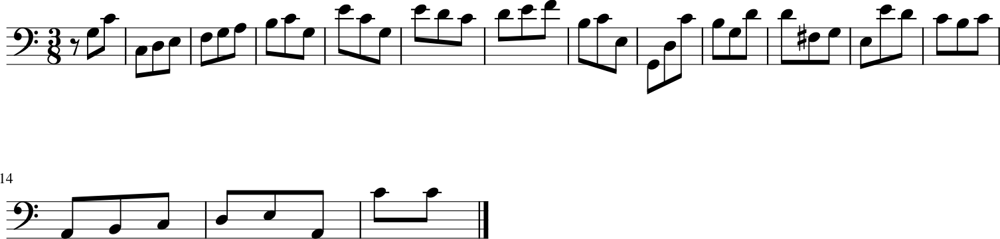

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5124 - loss: 1.1814 - note_outputs_loss: 0.6690
Epoch 564/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4813 - loss: 1.1683 - note_outputs_loss: 0.6870
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '0.0', '0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


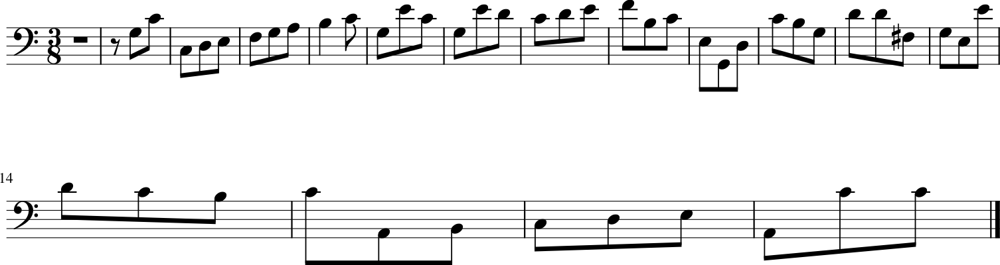

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4817 - loss: 1.1687 - note_outputs_loss: 0.6870
Epoch 565/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5031 - loss: 1.1966 - note_outputs_loss: 0.6934
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


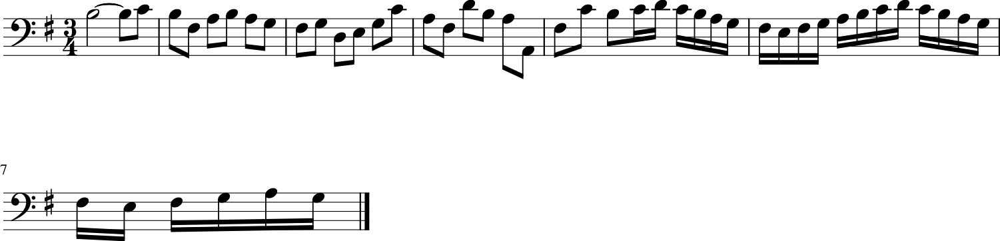

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5034 - loss: 1.1968 - note_outputs_loss: 0.6934
Epoch 566/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5682 - loss: 1.2007 - note_outputs_loss: 0.6324
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'B-2', 'D3', 'F3', 'B-3', 'A3', 'B-3', 'C4', 'D4'], ['0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


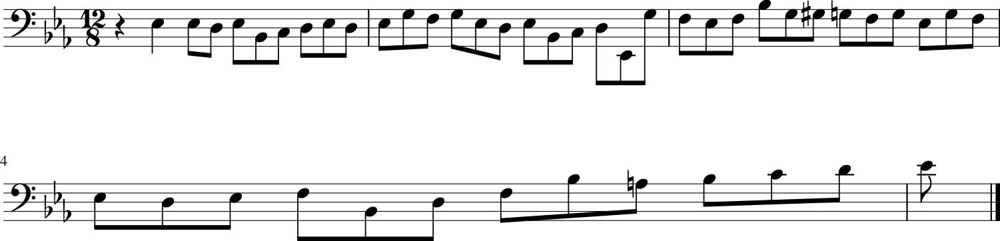

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5678 - loss: 1.2007 - note_outputs_loss: 0.6330
Epoch 567/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5067 - loss: 1.1906 - note_outputs_loss: 0.6839
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'E3', 'D3', 'E3', 'F3', 'D3', 'G3', 'E3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


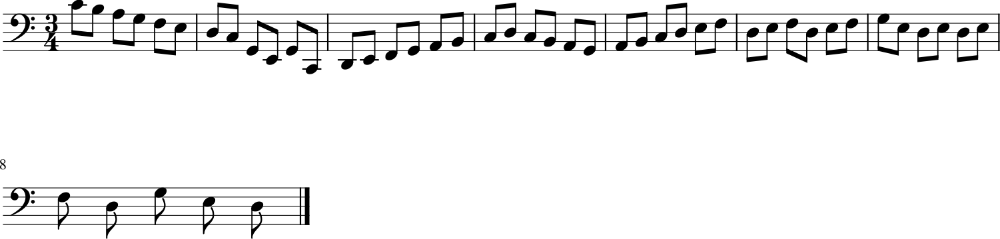

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5069 - loss: 1.1908 - note_outputs_loss: 0.6839
Epoch 568/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5883 - loss: 1.2811 - note_outputs_loss: 0.6927
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'D3', 'C3', 'B-3', 'rest', 'F2', 'A3', 'G3', 'F3', 'E-3', 'D3', 'C4', 'rest', 'G2', 'E-4', 'D4', 'C4', 'C4', 'G3', 'G#3', 'F#3', 'G3', 'D3', 'E-3', 'B2', 'C3', 'F#2', 'G2', 'B3', 'C4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


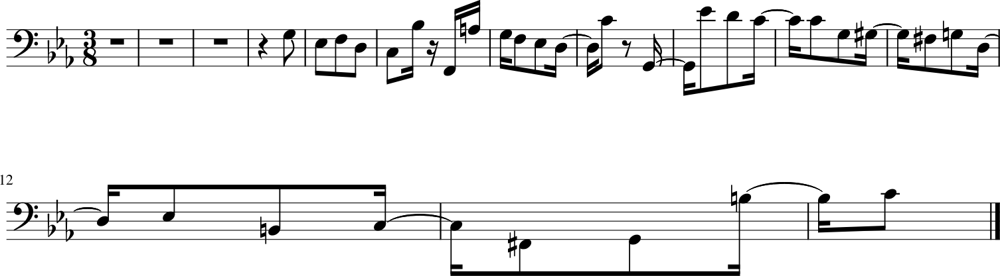

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5878 - loss: 1.2804 - note_outputs_loss: 0.6926
Epoch 569/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5512 - loss: 1.2125 - note_outputs_loss: 0.6614
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


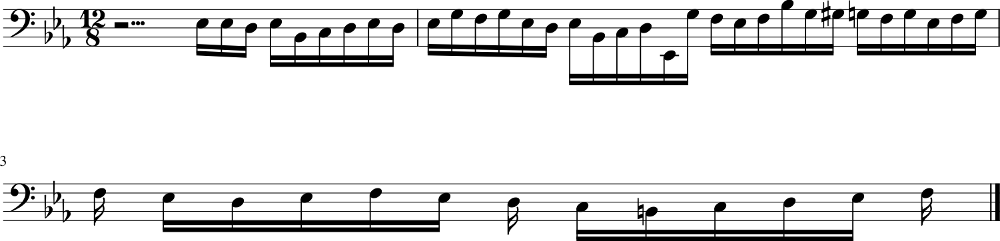

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5509 - loss: 1.2125 - note_outputs_loss: 0.6616
Epoch 570/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5155 - loss: 1.1967 - note_outputs_loss: 0.6812
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'D3', 'G3', 'D3', 'B2', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'A3', 'B3', 'C4', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


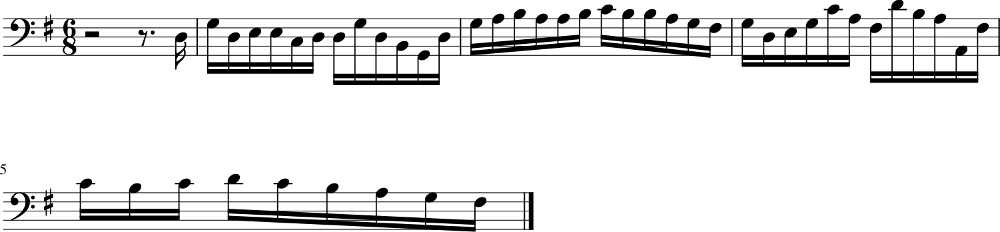

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5156 - loss: 1.1968 - note_outputs_loss: 0.6813
Epoch 571/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4771 - loss: 1.1436 - note_outputs_loss: 0.6665
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '3.0', '1.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


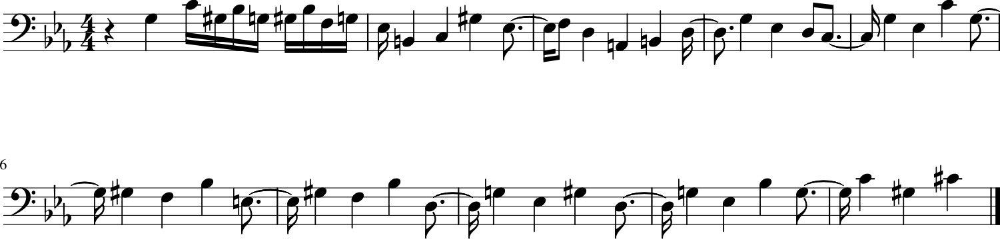

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4775 - loss: 1.1442 - note_outputs_loss: 0.6668
Epoch 572/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4782 - loss: 1.1300 - note_outputs_loss: 0.6518
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


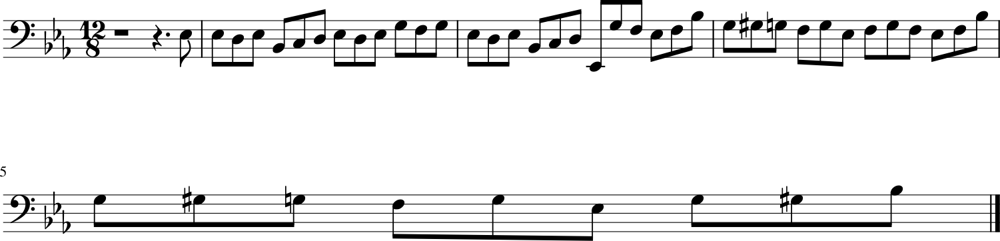

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4787 - loss: 1.1308 - note_outputs_loss: 0.6521
Epoch 573/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4905 - loss: 1.1592 - note_outputs_loss: 0.6687
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B-2', 'D4', 'E-4', 'F3', 'B-3', 'A3', 'G3', 'F3'], ['0.0', '3.0', '3.0', '1.0', '1.0', '0.5', '0.25', '0.25', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.25', '0.25', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


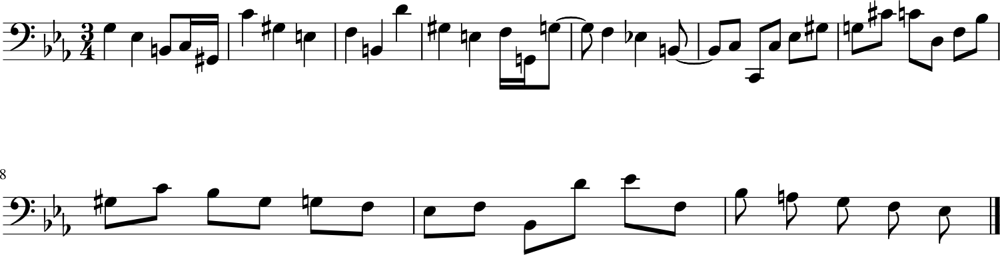

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4908 - loss: 1.1597 - note_outputs_loss: 0.6689
Epoch 574/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5298 - loss: 1.2031 - note_outputs_loss: 0.6733
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'E3', 'E3', 'E3', 'C3', 'C2', 'A3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'E3', 'F3', 'D3', 'E3', 'E3', 'F3', 'D3', 'E3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'G3', 'B-3', 'A3', 'B-3', 'C4', 'D4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


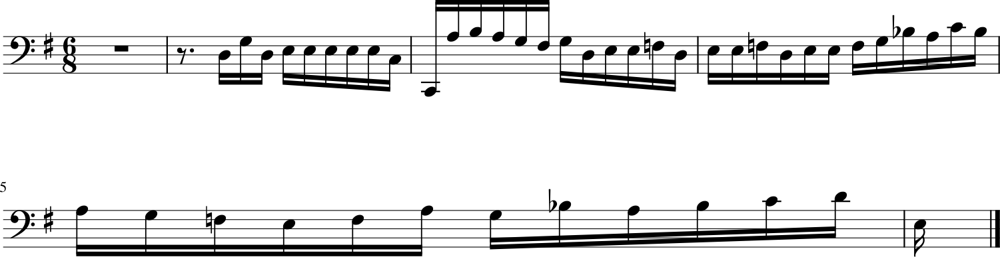

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5298 - loss: 1.2032 - note_outputs_loss: 0.6734
Epoch 575/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5463 - loss: 1.2272 - note_outputs_loss: 0.6809
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'B-2', 'E-2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


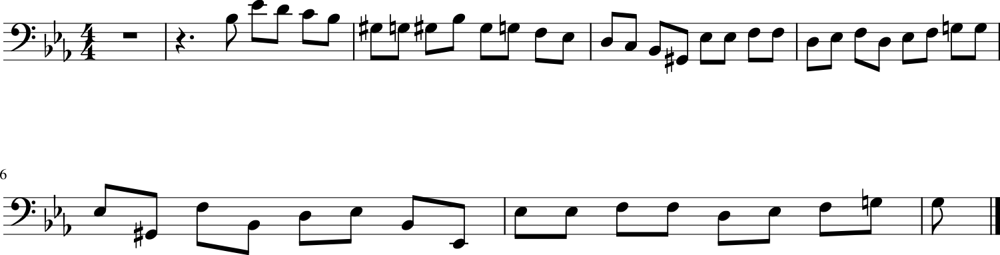

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5461 - loss: 1.2271 - note_outputs_loss: 0.6810
Epoch 576/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5468 - loss: 1.1780 - note_outputs_loss: 0.6312
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


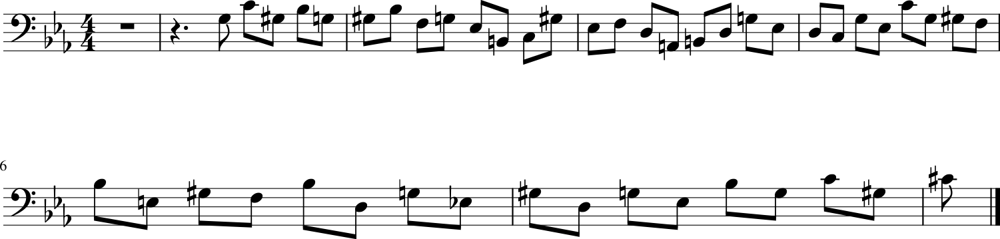

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5466 - loss: 1.1783 - note_outputs_loss: 0.6317
Epoch 577/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4915 - loss: 1.1536 - note_outputs_loss: 0.6621
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'D3', 'B2', 'A2', 'B2', 'D3', 'E2', 'F#3', 'A3', 'C4', 'D4', 'B3', 'C4', 'A3', 'A3', 'C3', 'D3', 'B3', 'E3', 'G#3', 'A3', 'D4', 'E4', 'B3', 'C4', 'F3', 'G3', 'B-3', 'B-3', 'C3', 'E2', 'B-3', 'A3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


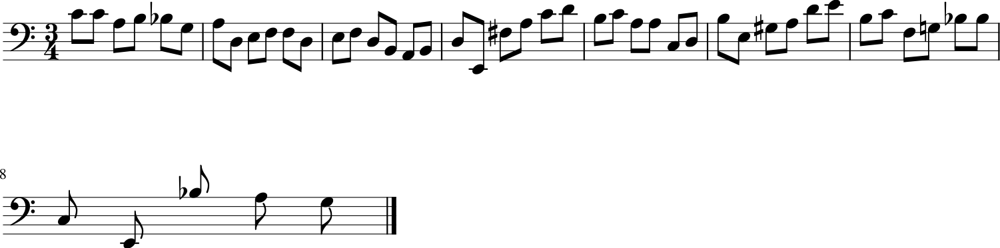

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4918 - loss: 1.1541 - note_outputs_loss: 0.6623
Epoch 578/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5252 - loss: 1.1950 - note_outputs_loss: 0.6698
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'C3', 'B2', 'C3', 'D3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G2', 'C3', 'B2', 'C3', 'D3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


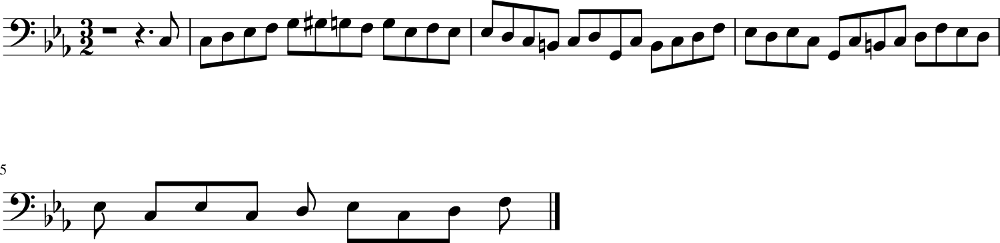

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5252 - loss: 1.1951 - note_outputs_loss: 0.6698
Epoch 579/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5561 - loss: 1.2153 - note_outputs_loss: 0.6592
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


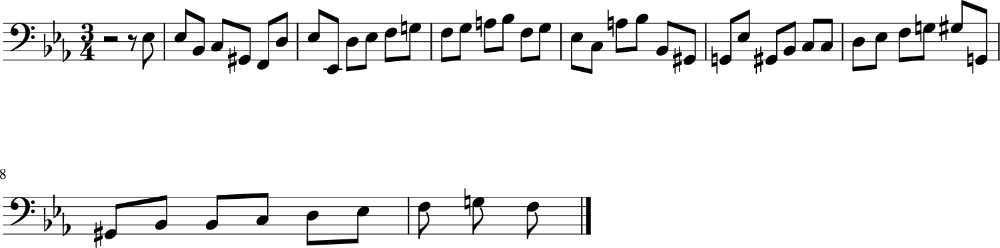

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5558 - loss: 1.2152 - note_outputs_loss: 0.6594
Epoch 580/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5490 - loss: 1.2120 - note_outputs_loss: 0.6629
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


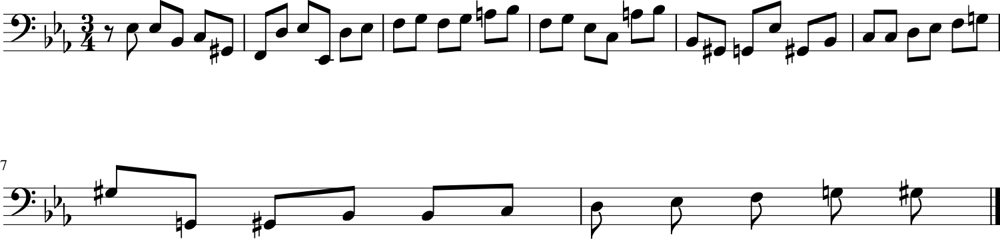

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5488 - loss: 1.2119 - note_outputs_loss: 0.6631
Epoch 581/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5182 - loss: 1.1859 - note_outputs_loss: 0.6677
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


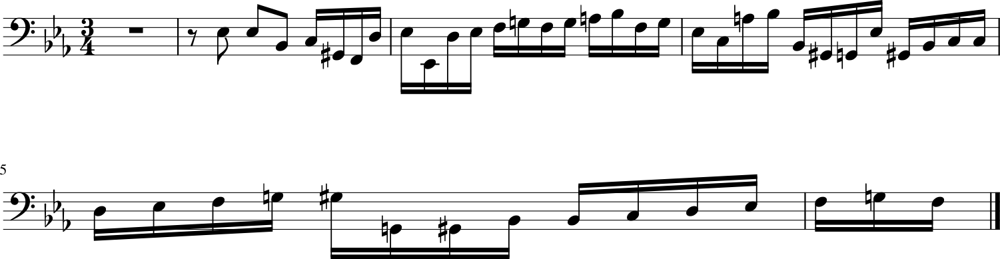

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5182 - loss: 1.1860 - note_outputs_loss: 0.6678
Epoch 582/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5183 - loss: 1.1726 - note_outputs_loss: 0.6543
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


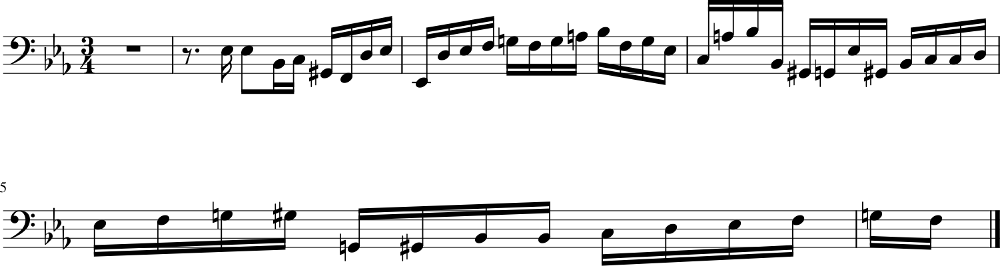

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5184 - loss: 1.1729 - note_outputs_loss: 0.6545
Epoch 583/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5252 - loss: 1.1777 - note_outputs_loss: 0.6524
Generation prompt: [['START', 'D:major', '12/8TS', 'rest', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'A3', 'D3', 'F#3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'B-3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


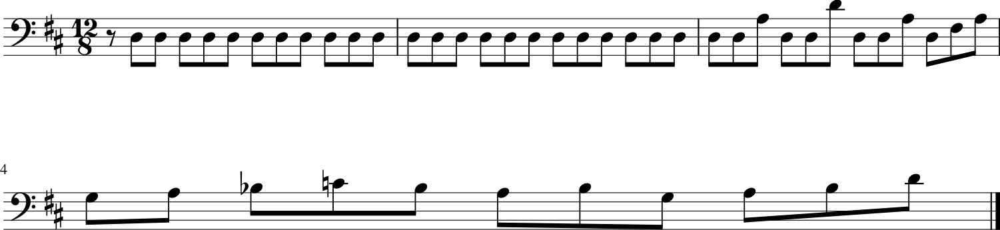

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5252 - loss: 1.1779 - note_outputs_loss: 0.6527
Epoch 584/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4856 - loss: 1.1634 - note_outputs_loss: 0.6778
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'G#3', 'B-3', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'G#3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


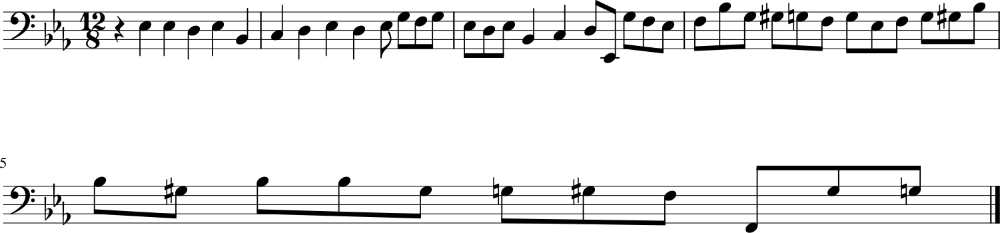

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4860 - loss: 1.1638 - note_outputs_loss: 0.6778
Epoch 585/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4998 - loss: 1.1664 - note_outputs_loss: 0.6665
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'B-3', 'D4', 'G3', 'F3', 'E3', 'F3', 'A3', 'G3', 'B-3', 'A3', 'B-3', 'C4', 'B-3', 'C4', 'A3', 'F#3', 'D4', 'C4', 'B-3', 'A3', 'C4', 'B-3', 'A3', 'B-3', 'G3', 'B-3', 'D4', 'C#4', 'D4', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


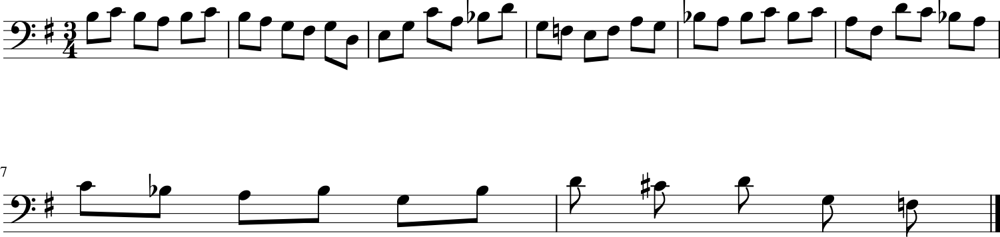

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5001 - loss: 1.1668 - note_outputs_loss: 0.6667
Epoch 586/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4846 - loss: 1.1407 - note_outputs_loss: 0.6560
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'A3', 'B3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


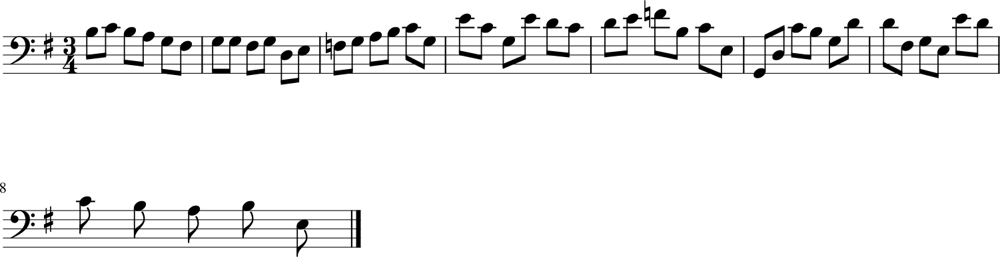

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4850 - loss: 1.1412 - note_outputs_loss: 0.6563
Epoch 587/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5219 - loss: 1.1860 - note_outputs_loss: 0.6641
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'A3', 'D3', 'F#3', 'D3', 'C3', 'B2', 'G3', 'D3', 'B2', 'D3', 'F3', 'B3', 'C4', 'A3', 'B3', 'E3', 'D3', 'C3', 'E3', 'A3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


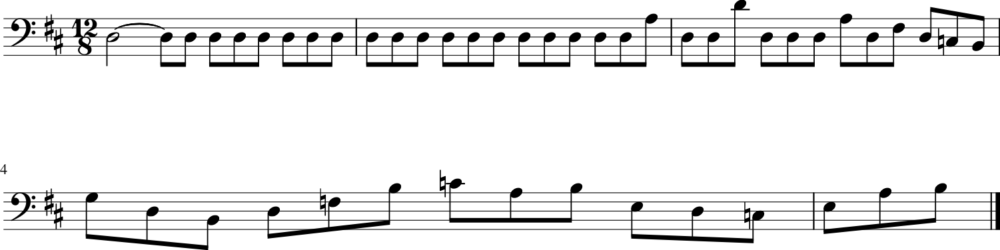

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5220 - loss: 1.1862 - note_outputs_loss: 0.6642
Epoch 588/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5208 - loss: 1.1538 - note_outputs_loss: 0.6330
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'B3', 'A3', 'B3', 'C4', 'D4', 'C4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


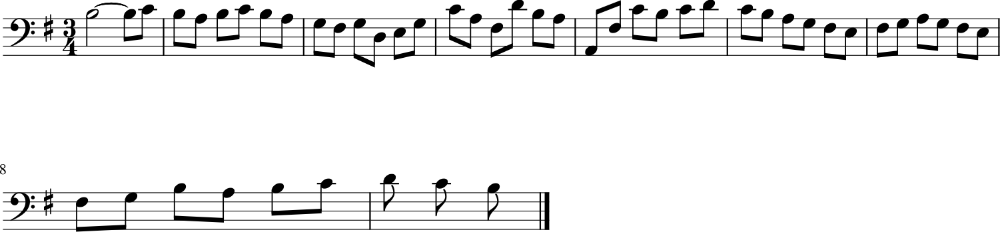

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5208 - loss: 1.1543 - note_outputs_loss: 0.6334
Epoch 589/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5328 - loss: 1.1968 - note_outputs_loss: 0.6640
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


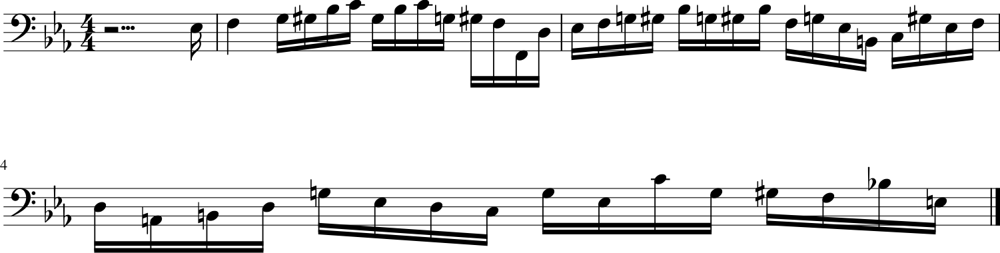

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5327 - loss: 1.1970 - note_outputs_loss: 0.6643
Epoch 590/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5473 - loss: 1.2193 - note_outputs_loss: 0.6719
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


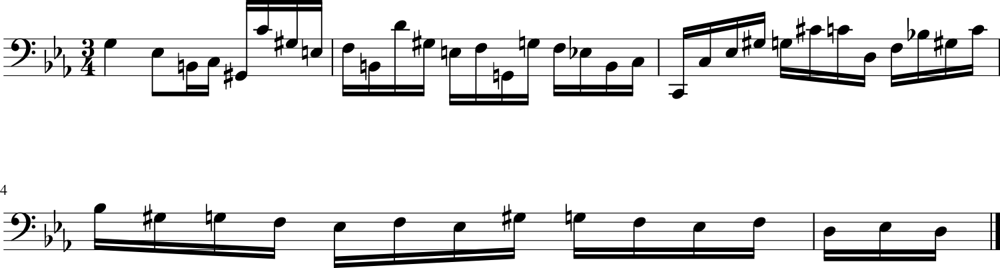

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5471 - loss: 1.2192 - note_outputs_loss: 0.6721
Epoch 591/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5292 - loss: 1.1775 - note_outputs_loss: 0.6484
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


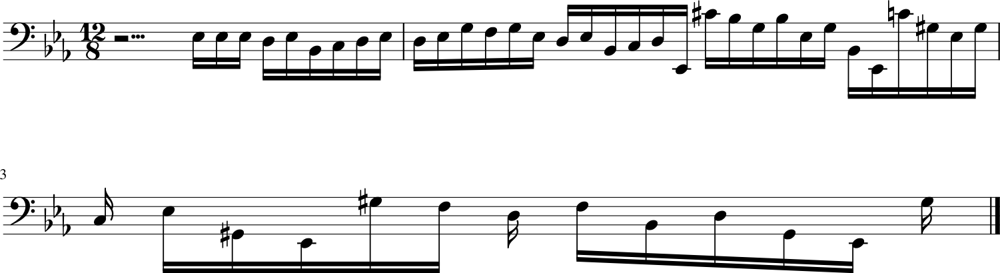

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5291 - loss: 1.1778 - note_outputs_loss: 0.6487
Epoch 592/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4950 - loss: 1.1608 - note_outputs_loss: 0.6658
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B-2', 'D4', 'E-4', 'F3', 'B-3', 'A3', 'G3', 'F3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


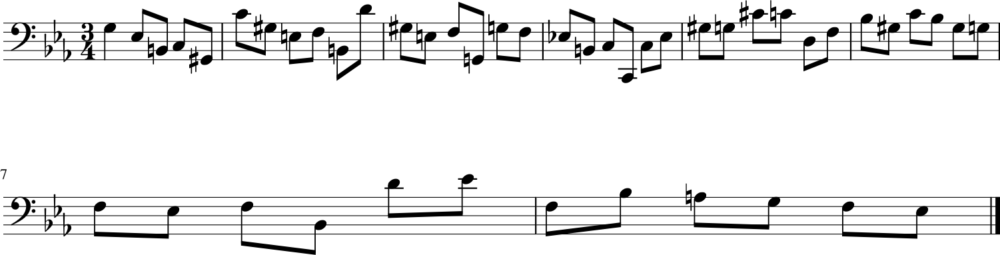

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4953 - loss: 1.1612 - note_outputs_loss: 0.6660
Epoch 593/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5224 - loss: 1.1565 - note_outputs_loss: 0.6341
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


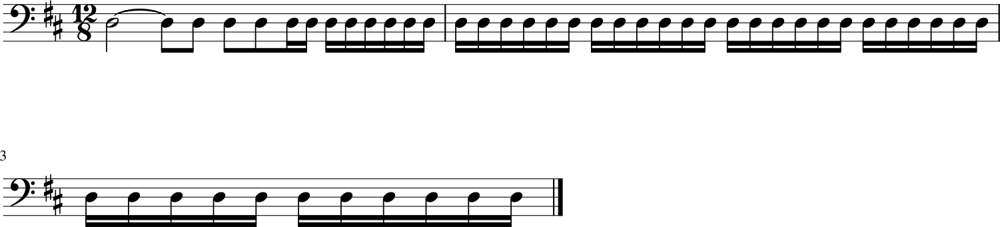

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5224 - loss: 1.1569 - note_outputs_loss: 0.6345
Epoch 594/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5079 - loss: 1.1809 - note_outputs_loss: 0.6731
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'A3', 'F3', 'A3', 'F3', 'A3', 'B3', 'F3', 'B-3', 'A3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


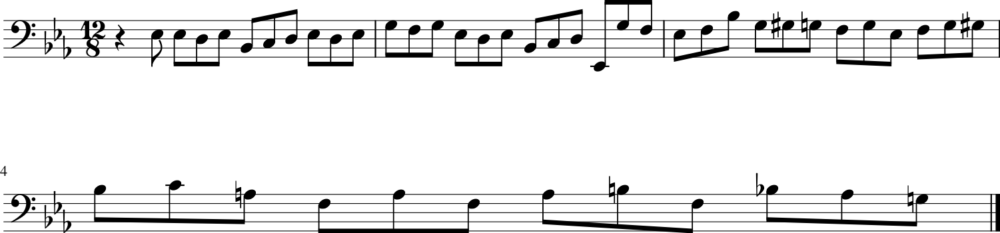

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5080 - loss: 1.1811 - note_outputs_loss: 0.6731
Epoch 595/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5478 - loss: 1.1786 - note_outputs_loss: 0.6308
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


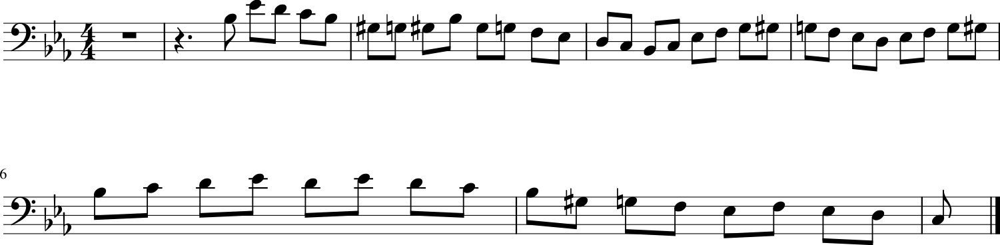

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5475 - loss: 1.1787 - note_outputs_loss: 0.6312
Epoch 596/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4771 - loss: 1.1282 - note_outputs_loss: 0.6511
Generation prompt: [['START', 'E-:major', '3/4TS', 'E-3', 'B-2', 'C3', 'G#2', 'B-2', 'C3', 'G#2', 'B-2', 'G2', 'G#3', 'C4', 'E-3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'G3', 'A3', 'F3', 'A3', 'E-3', 'D3', 'C3', 'B-2', 'F3', 'A2', 'C3', 'F3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'A2', 'E-3', 'D3'], ['0.0', '1.0', '1.0', '0.25', '0.25', '0.25', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


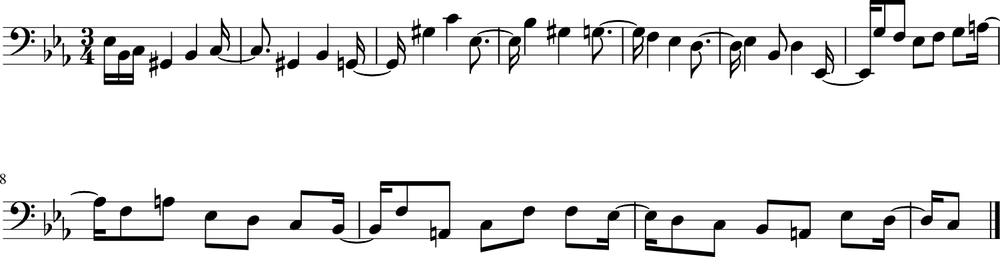

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4776 - loss: 1.1290 - note_outputs_loss: 0.6514
Epoch 597/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4938 - loss: 1.1914 - note_outputs_loss: 0.6976
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'A3', 'D3', 'F#3', 'D3', 'C3', 'B2', 'G3', 'D3', 'B2', 'D3', 'F#3', 'G3', 'D3', 'B2', 'G2', 'A3', 'A3', 'A3', 'B3', 'D4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


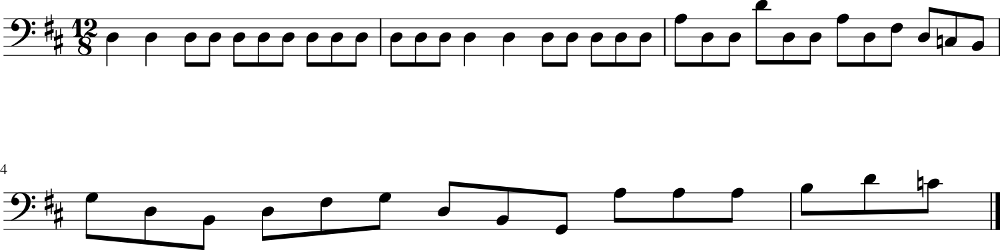

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4941 - loss: 1.1916 - note_outputs_loss: 0.6975
Epoch 598/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5399 - loss: 1.1689 - note_outputs_loss: 0.6290
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'A2', 'D2', 'D3', 'F#3', 'A3', 'G3', 'A3'], ['0.0', '0.0', '0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


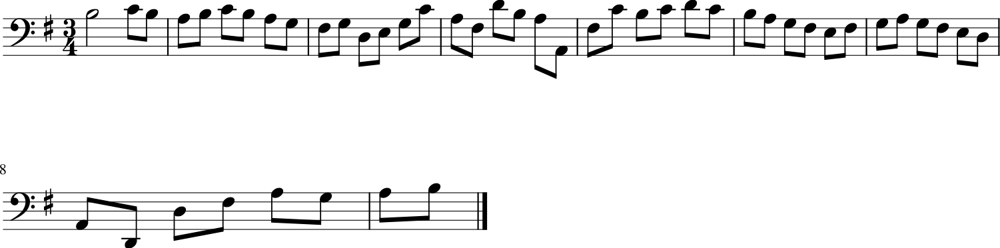

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5397 - loss: 1.1692 - note_outputs_loss: 0.6295
Epoch 599/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5463 - loss: 1.2299 - note_outputs_loss: 0.6836
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3', 'F3', 'G3', 'D3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


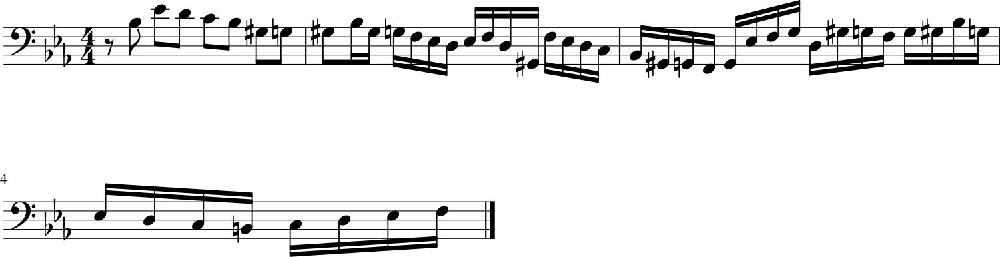

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5461 - loss: 1.2296 - note_outputs_loss: 0.6836
Epoch 600/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5526 - loss: 1.1904 - note_outputs_loss: 0.6378
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'G3', 'A2', 'B-2', 'G2', 'F#2', 'A2', 'B-2', 'C3', 'D2', 'C3', 'B-2', 'A2', 'F#3', 'G3', 'B-3', 'D3', 'A3', 'B-3', 'D4', 'F4', 'A3', 'B-3', 'B-3', 'D4', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


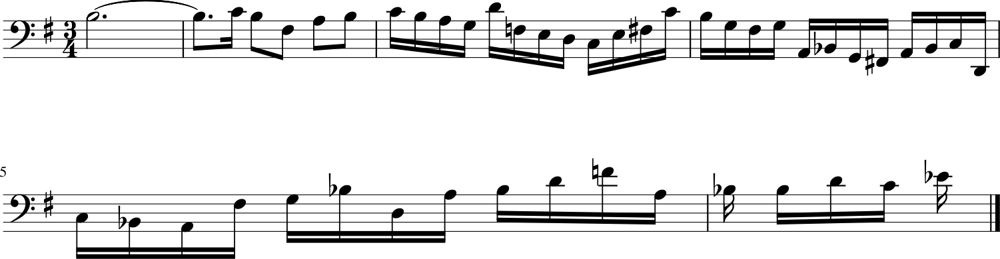

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.5523 - loss: 1.1905 - note_outputs_loss: 0.6382
Epoch 601/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4735 - loss: 1.1278 - note_outputs_loss: 0.6542
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'C4', 'B3', 'A3', 'B-3', 'G3', 'F#3', 'G3', 'E3', 'C#3', 'A2', 'G2', 'F#2', 'A2', 'D3', 'E3', 'F#3', 'G3', 'C4', 'A3', 'B-3', 'D4', 'G3', 'F3', 'E3', 'F3', 'A3', 'G3', 'B-3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F#3', 'A3', 'D4', 'D4', 'D4', 'E-3', 'C4', 'D4', 'E-4', 'A3', 'E-4'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


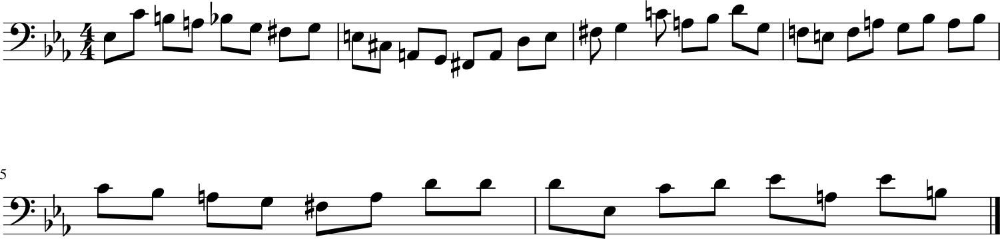

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4740 - loss: 1.1285 - note_outputs_loss: 0.6544
Epoch 602/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5262 - loss: 1.1743 - note_outputs_loss: 0.6481
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'G3', 'A3', 'A3', 'D3', 'F#3', 'E3', 'D3', 'G3', 'A3', 'B-3', 'F#3', 'G3', 'A3', 'C4', 'G3', 'A3', 'B3', 'G3', 'D3', 'C3', 'B2', 'G2', 'F2', 'B-3', 'G3', 'D3'], ['0.0', '3.0', '0.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


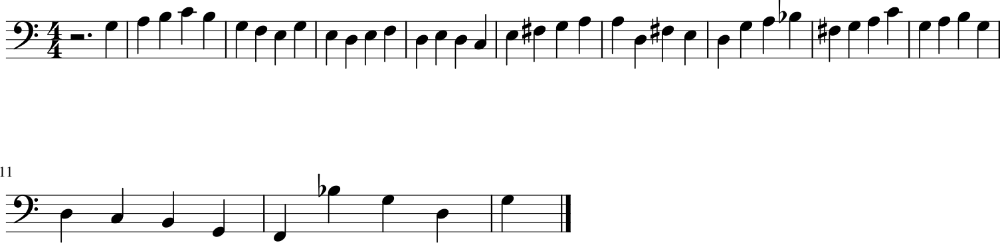

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5262 - loss: 1.1746 - note_outputs_loss: 0.6484
Epoch 603/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4982 - loss: 1.1658 - note_outputs_loss: 0.6677
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'F2', 'B3', 'G3', 'D3', 'E-3', 'C3', 'C4', 'C4', 'B3', 'C4', 'C4', 'G3', 'A3', 'B-3', 'G3', 'C3', 'A3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


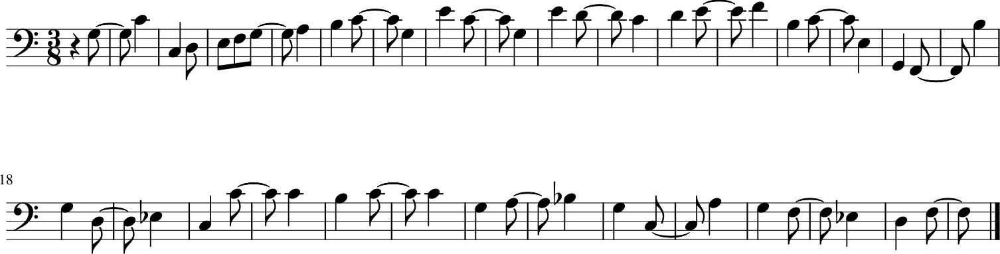

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4984 - loss: 1.1662 - note_outputs_loss: 0.6678
Epoch 604/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5554 - loss: 1.2203 - note_outputs_loss: 0.6650
Generation prompt: [['START', 'D:major'], ['0.0', '0.0']]


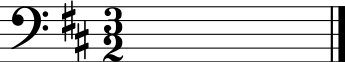

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5551 - loss: 1.2202 - note_outputs_loss: 0.6651
Epoch 605/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5153 - loss: 1.1489 - note_outputs_loss: 0.6335
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'A3', 'G3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


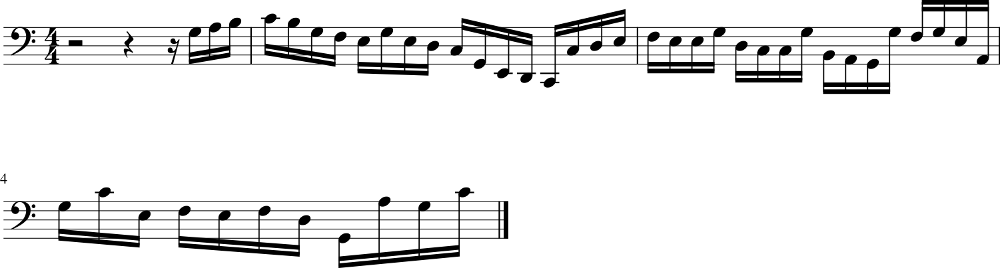

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5154 - loss: 1.1493 - note_outputs_loss: 0.6339
Epoch 606/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5513 - loss: 1.2417 - note_outputs_loss: 0.6904
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'E3', 'C3', 'C2', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'D3', 'D2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'A3', 'G3', 'F#3', 'G3', 'A3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


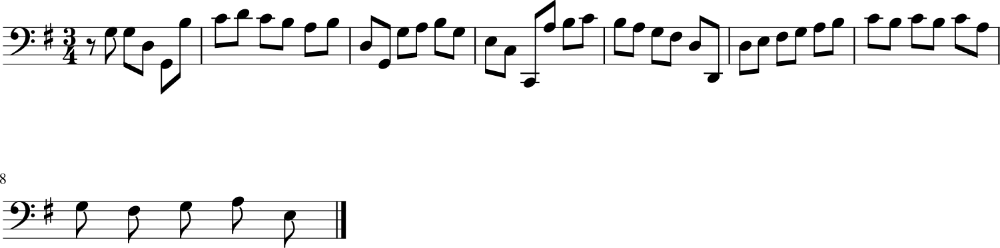

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5510 - loss: 1.2415 - note_outputs_loss: 0.6904
Epoch 607/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5200 - loss: 1.1985 - note_outputs_loss: 0.6784
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


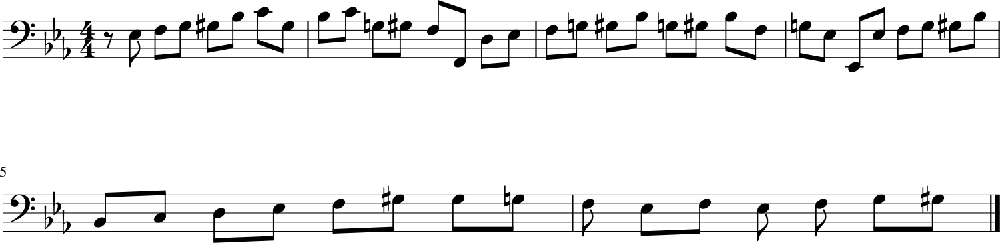

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5201 - loss: 1.1985 - note_outputs_loss: 0.6784
Epoch 608/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5125 - loss: 1.1563 - note_outputs_loss: 0.6438
Generation prompt: [['START', 'E-:major', '3/8TS', 'rest', 'G3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'G2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G3', 'C3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G#3', 'D3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'C4', 'G#3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


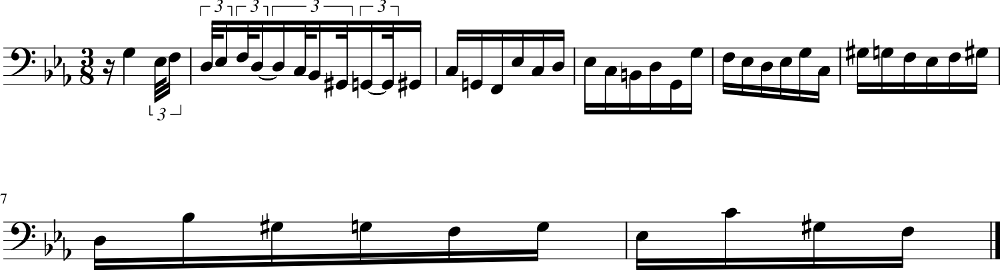

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5126 - loss: 1.1567 - note_outputs_loss: 0.6441
Epoch 609/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4995 - loss: 1.1707 - note_outputs_loss: 0.6712
Generation prompt: [['START', 'G:major'], ['0.0', '0.0']]


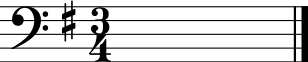

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.4997 - loss: 1.1709 - note_outputs_loss: 0.6713
Epoch 610/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5487 - loss: 1.2147 - note_outputs_loss: 0.6660
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


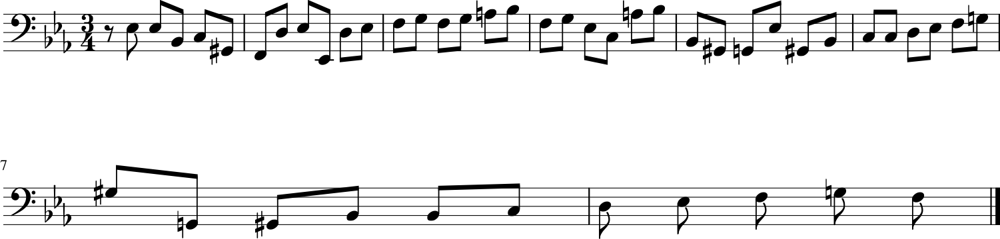

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5485 - loss: 1.2146 - note_outputs_loss: 0.6661
Epoch 611/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5254 - loss: 1.1949 - note_outputs_loss: 0.6695
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


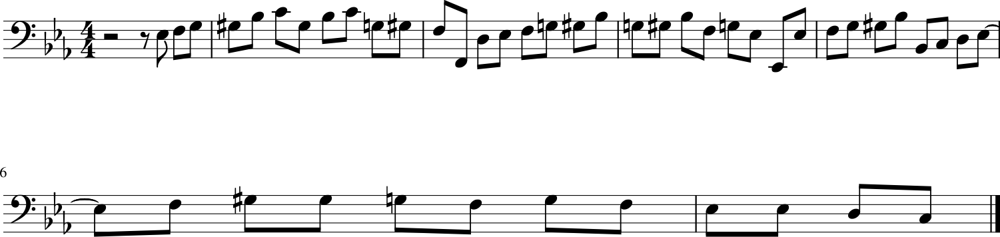

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5254 - loss: 1.1949 - note_outputs_loss: 0.6696
Epoch 612/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5273 - loss: 1.1940 - note_outputs_loss: 0.6667
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'G#3', 'G#3', 'F3', 'B-3', 'A3', 'B-2', 'A2', 'E-3', 'G3', 'B-3', 'D4', 'F4', 'A3', 'D3', 'G#3', 'F#3', 'C4', 'G3', 'C4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'F3', 'B-3', 'A3', 'C4'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '2.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


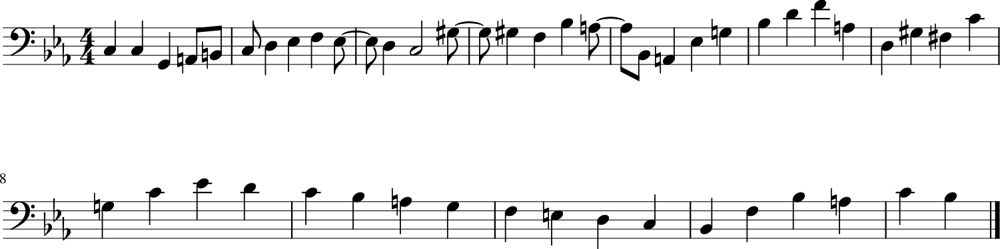

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5272 - loss: 1.1941 - note_outputs_loss: 0.6668
Epoch 613/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.4967 - loss: 1.1513 - note_outputs_loss: 0.6545
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


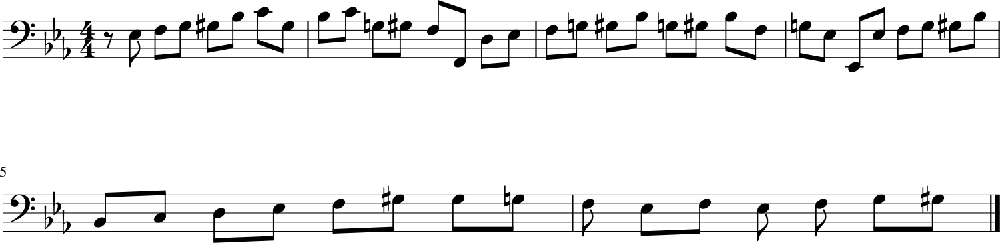

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4970 - loss: 1.1517 - note_outputs_loss: 0.6547
Epoch 614/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5026 - loss: 1.1642 - note_outputs_loss: 0.6616
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'G2', 'B-2', 'E-2', 'B-2', 'C3', 'D3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


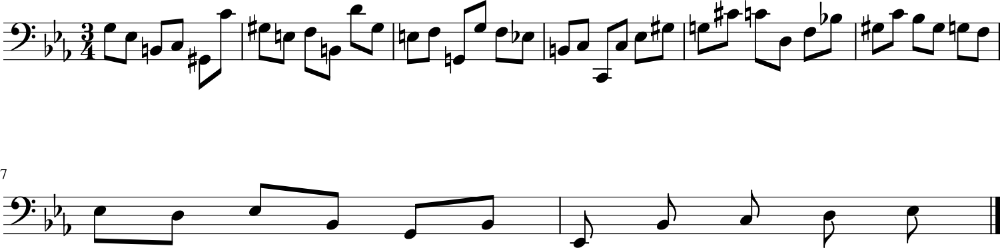

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5028 - loss: 1.1646 - note_outputs_loss: 0.6618
Epoch 615/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4928 - loss: 1.1626 - note_outputs_loss: 0.6698
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'G3', 'F3', 'E-3', 'E-3', 'rest'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


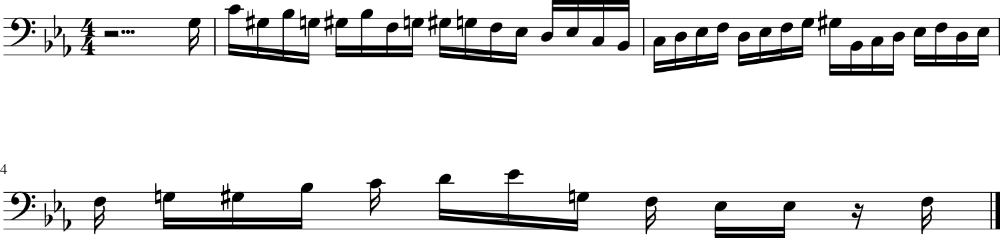

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4931 - loss: 1.1630 - note_outputs_loss: 0.6699
Epoch 616/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5069 - loss: 1.1692 - note_outputs_loss: 0.6624
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B-2', 'D4', 'E-4', 'F3', 'B-3', 'A3', 'G3', 'F4', 'E-4', 'C4', 'E-4', 'C4', 'E-4', 'D4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


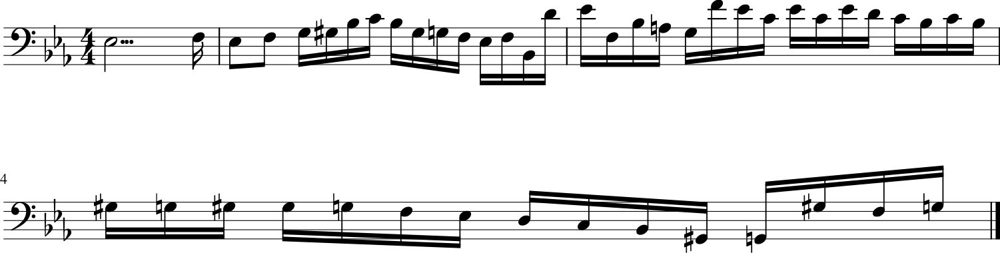

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5070 - loss: 1.1696 - note_outputs_loss: 0.6626
Epoch 617/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5354 - loss: 1.1880 - note_outputs_loss: 0.6525
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


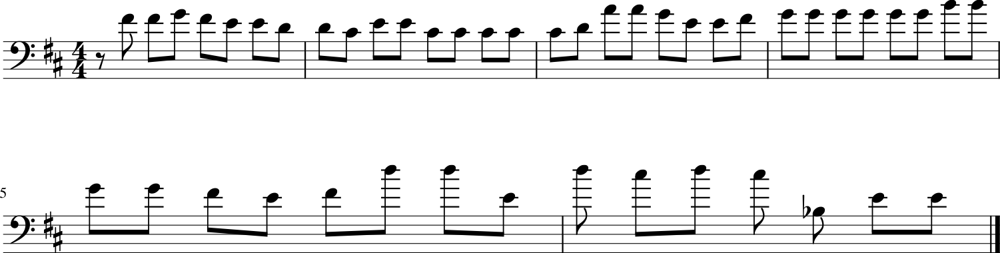

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5353 - loss: 1.1880 - note_outputs_loss: 0.6527
Epoch 618/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4903 - loss: 1.1286 - note_outputs_loss: 0.6383
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'A4', 'G4', 'E4', 'C#4', 'A3', 'G3', 'F#3', 'D4', 'B3', 'B3', 'F#3', 'rest', 'G4', 'G4', 'C#4', 'D3', 'B3', 'D4', 'G4', 'F#4', 'F#3', 'E3', 'F#3', 'F#3', 'C2', 'A3', 'B3', 'C4', 'C4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


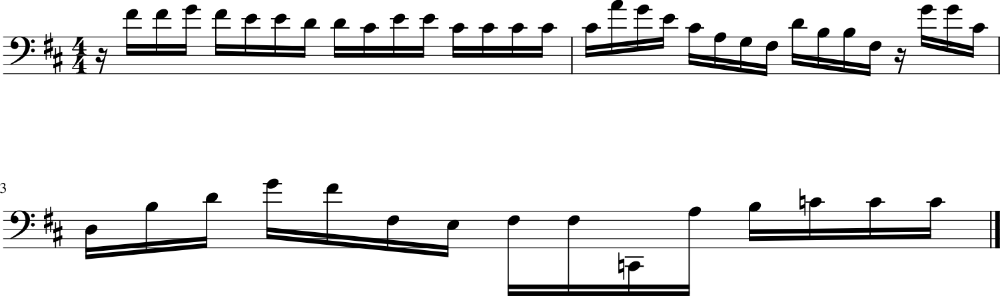

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4906 - loss: 1.1292 - note_outputs_loss: 0.6386
Epoch 619/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5128 - loss: 1.1835 - note_outputs_loss: 0.6707
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'B-3', 'G#3', 'G3', 'F3', 'F3', 'F3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'G3', 'C4', 'A2', 'B2', 'C3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


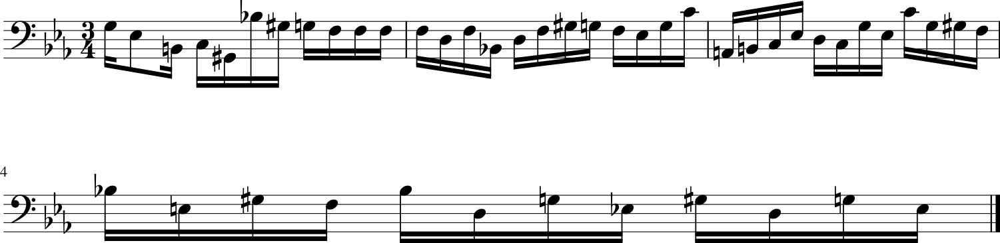

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5129 - loss: 1.1837 - note_outputs_loss: 0.6707
Epoch 620/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5274 - loss: 1.1936 - note_outputs_loss: 0.6663
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4', 'F#3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


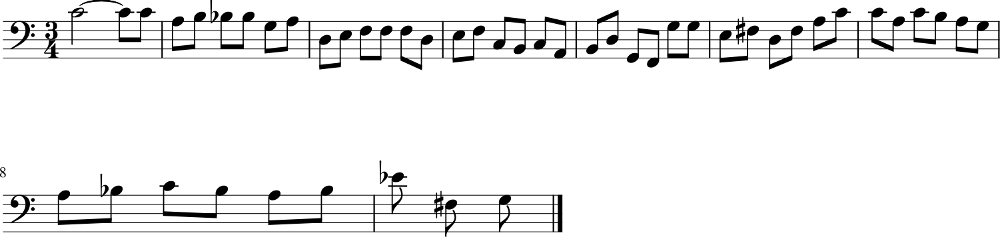

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5273 - loss: 1.1937 - note_outputs_loss: 0.6664
Epoch 621/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4777 - loss: 1.1325 - note_outputs_loss: 0.6547
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

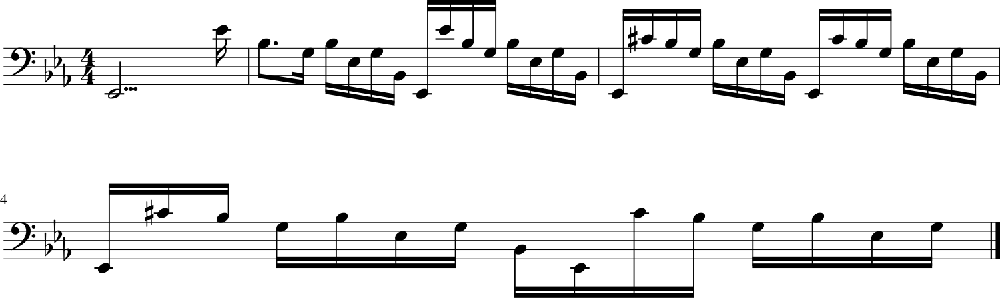

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4782 - loss: 1.1331 - note_outputs_loss: 0.6549
Epoch 622/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4949 - loss: 1.1521 - note_outputs_loss: 0.6572
Generation prompt: [['START', 'G:major', '4/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'D3', 'B3', 'D3', 'G2', 'D3', 'B3', 'D3', 'B3', 'D3', 'G2', 'E3', 'C4', 'B3', 'C4', 'E3', 'C4', 'E3', 'G2', 'E3', 'C4', 'B3', 'C4', 'E3', 'C4', 'E3', 'G2', 'E3', 'C3', 'G2', 'F#3', 'C4', 'F#3', 'G2', 'C3', 'B2', 'C3', 'B2', 'C3', 'D3', 'F3', 'C4'], ['0.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


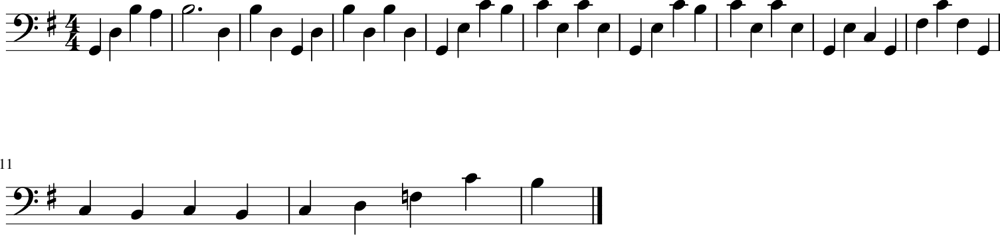

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4952 - loss: 1.1526 - note_outputs_loss: 0.6574
Epoch 623/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5265 - loss: 1.1760 - note_outputs_loss: 0.6494
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3', 'F3', 'G3', 'D3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


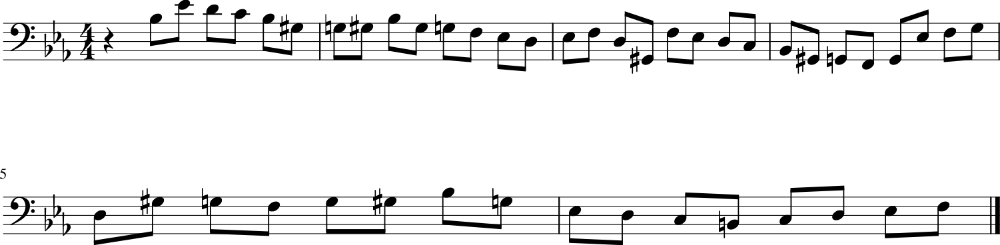

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5265 - loss: 1.1762 - note_outputs_loss: 0.6497
Epoch 624/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5183 - loss: 1.1683 - note_outputs_loss: 0.6499
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'A2', 'C3', 'E3', 'A3', 'B3', 'C4', 'A3', 'E3', 'C3', 'D3', 'B2', 'C3', 'D3', 'B2', 'G2', 'A2', 'B2', 'F2', 'E-2', 'G2', 'C3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


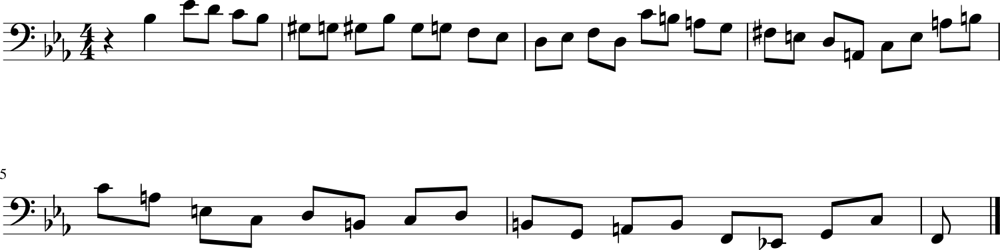

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5184 - loss: 1.1685 - note_outputs_loss: 0.6501
Epoch 625/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5537 - loss: 1.2172 - note_outputs_loss: 0.6635
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-2', 'B-2', 'C3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


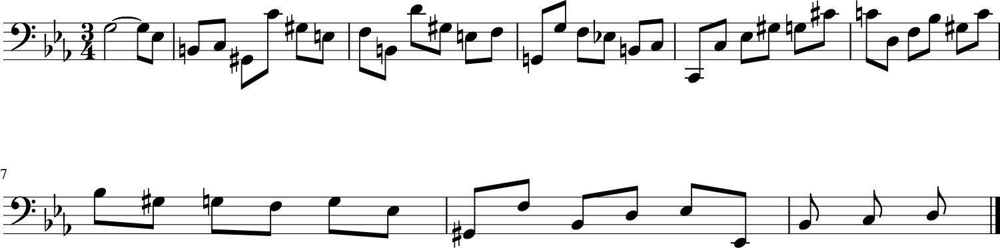

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5534 - loss: 1.2171 - note_outputs_loss: 0.6637
Epoch 626/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5123 - loss: 1.1702 - note_outputs_loss: 0.6579
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'E-3', 'D3', 'C3', 'B2', 'D3', 'C3', 'B2', 'A2', 'G2', 'D3', 'F3', 'B3', 'D4', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C2', 'D2', 'E-2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


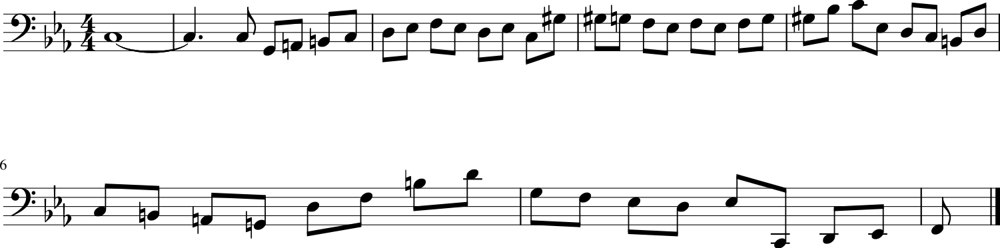

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5124 - loss: 1.1704 - note_outputs_loss: 0.6580
Epoch 627/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4946 - loss: 1.1529 - note_outputs_loss: 0.6584
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-2', 'B-2', 'C3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


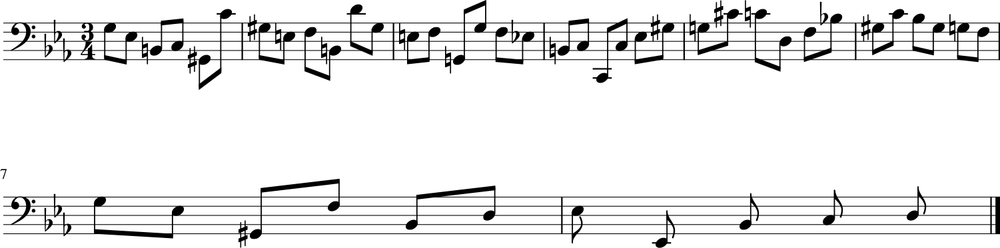

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4948 - loss: 1.1534 - note_outputs_loss: 0.6585
Epoch 628/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.4929 - loss: 1.1248 - note_outputs_loss: 0.6319
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'G3', 'B-3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


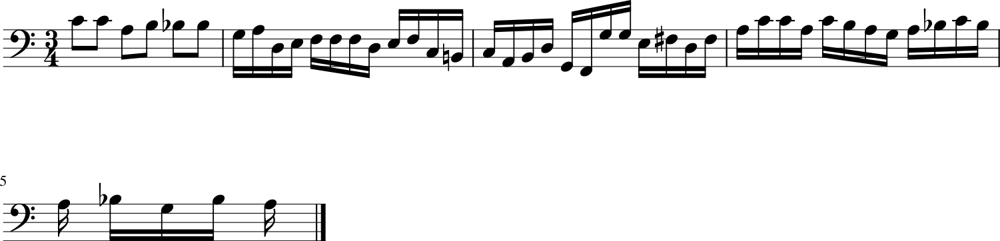

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.4932 - loss: 1.1254 - note_outputs_loss: 0.6322
Epoch 629/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5292 - loss: 1.1675 - note_outputs_loss: 0.6383
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


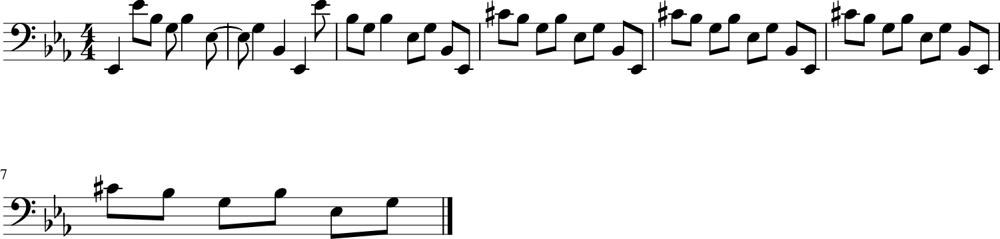

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5291 - loss: 1.1678 - note_outputs_loss: 0.6386
Epoch 630/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5075 - loss: 1.1621 - note_outputs_loss: 0.6547
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


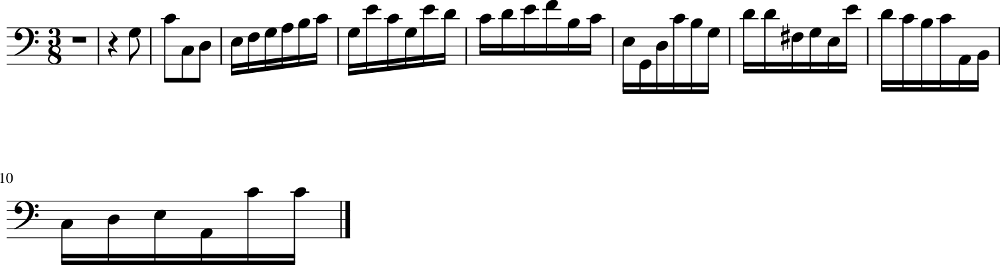

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5076 - loss: 1.1624 - note_outputs_loss: 0.6548
Epoch 631/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5975 - loss: 1.2355 - note_outputs_loss: 0.6380
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'G3', 'F#3', 'E3', 'D3', 'A3', 'C3', 'E3', 'F#3', 'G3', 'A3', 'C3', 'B2', 'G3', 'D3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


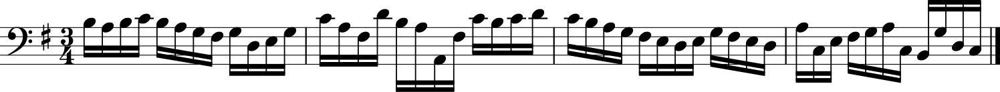

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5968 - loss: 1.2351 - note_outputs_loss: 0.6384
Epoch 632/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5470 - loss: 1.2251 - note_outputs_loss: 0.6781
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


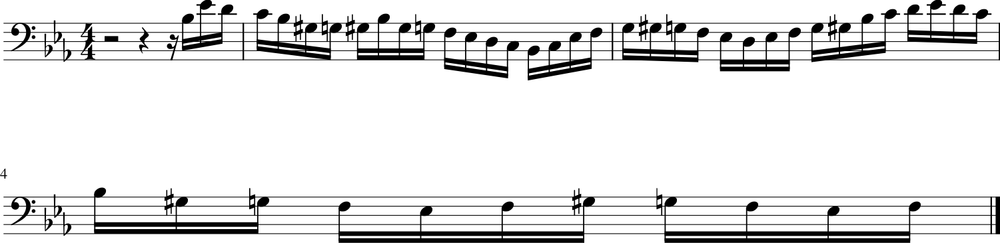

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5467 - loss: 1.2248 - note_outputs_loss: 0.6781
Epoch 633/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5686 - loss: 1.2244 - note_outputs_loss: 0.6557
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'G#3', 'B-3', 'G#3', 'B-3', 'E-4', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'G#3', 'B-3', 'C4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


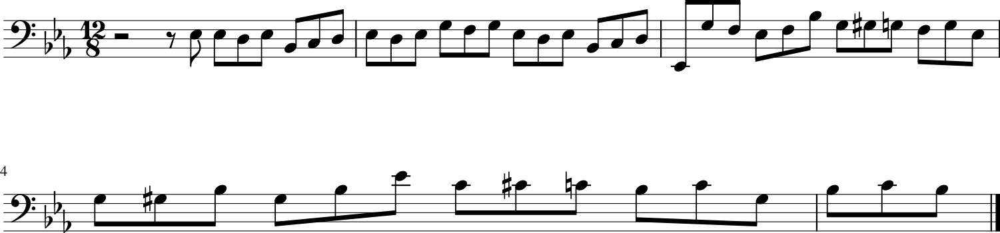

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5682 - loss: 1.2241 - note_outputs_loss: 0.6559
Epoch 634/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5407 - loss: 1.1702 - note_outputs_loss: 0.6295
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'A3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'D3', 'A2', 'D2', 'G2', 'D3', 'B3', 'A3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


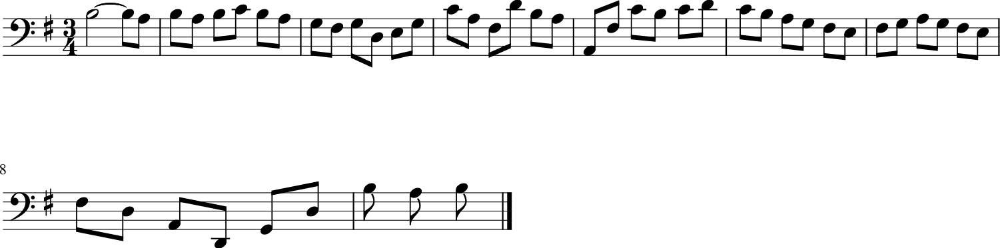

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5405 - loss: 1.1705 - note_outputs_loss: 0.6300
Epoch 635/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5654 - loss: 1.2249 - note_outputs_loss: 0.6595
Generation prompt: [['START', 'F:major'], ['0.0', '0.0']]


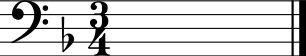

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5650 - loss: 1.2247 - note_outputs_loss: 0.6597
Epoch 636/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5557 - loss: 1.2003 - note_outputs_loss: 0.6446
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'G2', 'B-2', 'E-2', 'B-2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


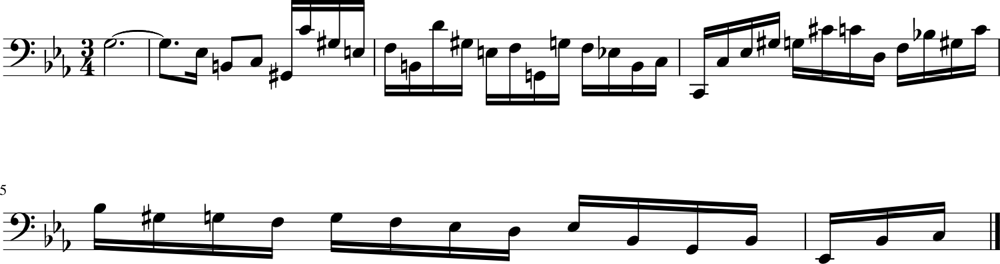

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5554 - loss: 1.2003 - note_outputs_loss: 0.6449
Epoch 637/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4974 - loss: 1.1557 - note_outputs_loss: 0.6583
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'A3', 'D3', 'F#3', 'D3', 'C3', 'B2', 'C3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


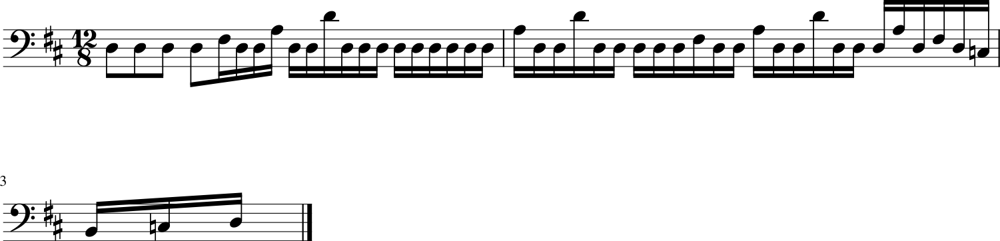

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4976 - loss: 1.1560 - note_outputs_loss: 0.6585
Epoch 638/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4669 - loss: 1.1158 - note_outputs_loss: 0.6489
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'A3', 'B-3', 'A3', 'G3', 'A3', 'F3', 'A3', 'F3', 'A3', 'D3', 'A3', 'B-3', 'D3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '0.25', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/3', '1/12']]


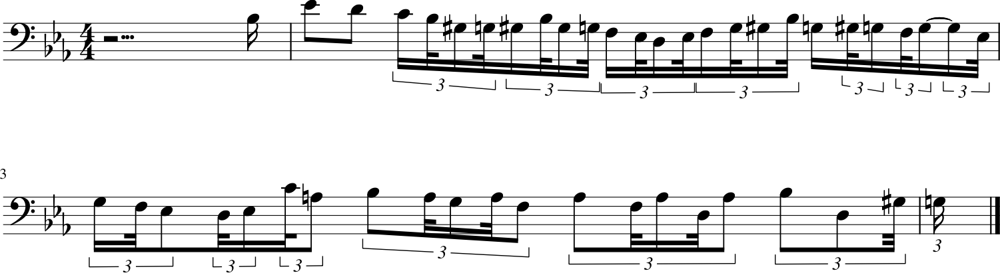

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4674 - loss: 1.1166 - note_outputs_loss: 0.6491
Epoch 639/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5461 - loss: 1.1991 - note_outputs_loss: 0.6530
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'B-2', 'G#2', 'G2', 'B-2', 'C3', 'D3', 'E-3', 'C#4', 'G#2', 'C4', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


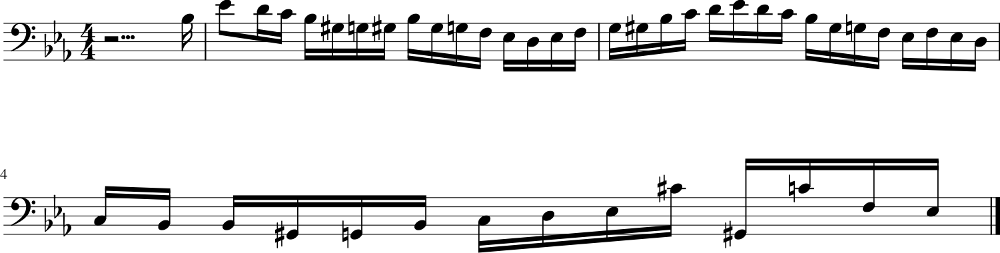

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5458 - loss: 1.1990 - note_outputs_loss: 0.6532
Epoch 640/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5704 - loss: 1.2237 - note_outputs_loss: 0.6533
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'F2', 'G#3', 'G#3', 'G3', 'G#3', 'F3', 'D4', 'C4', 'D4', 'B-3', 'F4', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


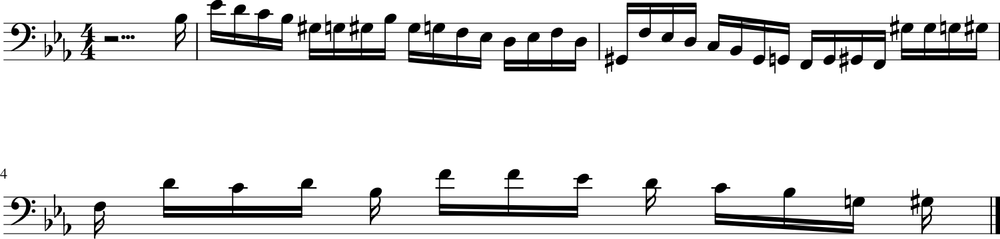

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5700 - loss: 1.2235 - note_outputs_loss: 0.6535
Epoch 641/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5498 - loss: 1.1941 - note_outputs_loss: 0.6443
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


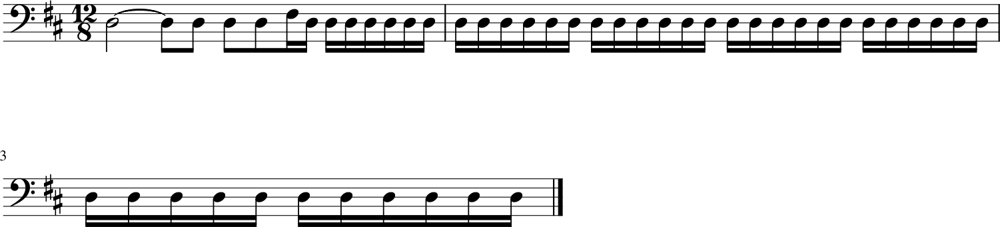

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5495 - loss: 1.1940 - note_outputs_loss: 0.6445
Epoch 642/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4978 - loss: 1.1474 - note_outputs_loss: 0.6496
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


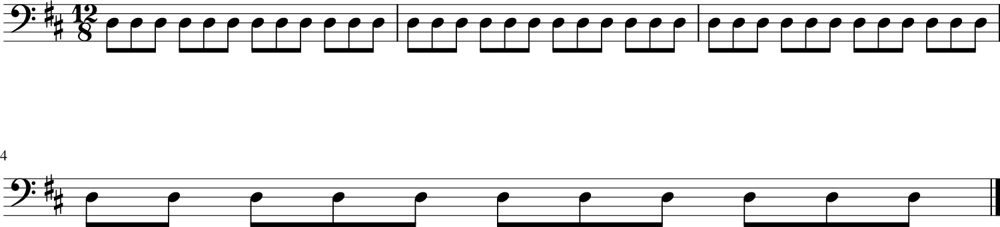

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4980 - loss: 1.1478 - note_outputs_loss: 0.6498
Epoch 643/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5139 - loss: 1.1450 - note_outputs_loss: 0.6311
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'B-3', 'B-3', 'G#3', 'B-3', 'G3', 'G2', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'C4', 'B-3', 'C4', 'B-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


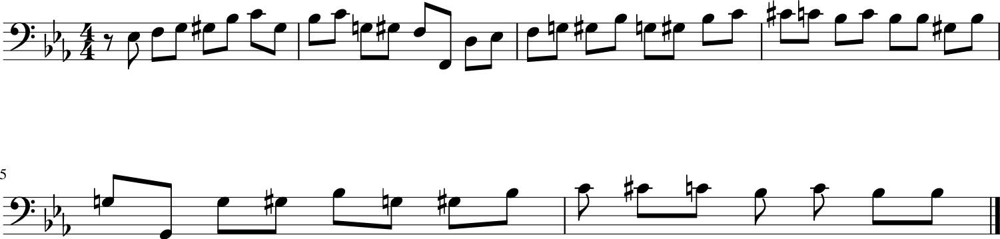

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5140 - loss: 1.1454 - note_outputs_loss: 0.6315
Epoch 644/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5219 - loss: 1.1686 - note_outputs_loss: 0.6467
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25'

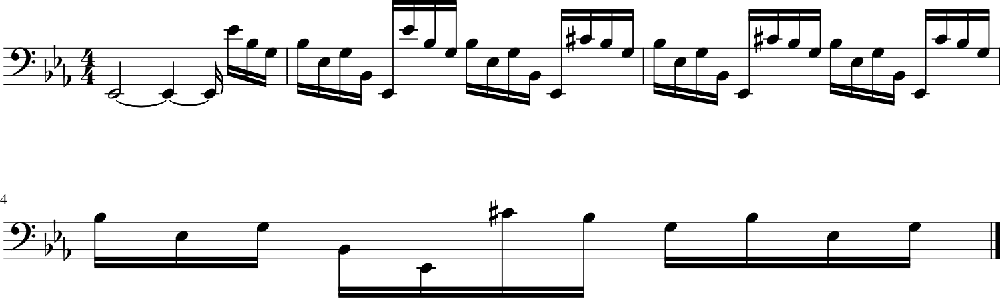

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5219 - loss: 1.1688 - note_outputs_loss: 0.6469
Epoch 645/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4946 - loss: 1.1347 - note_outputs_loss: 0.6402
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


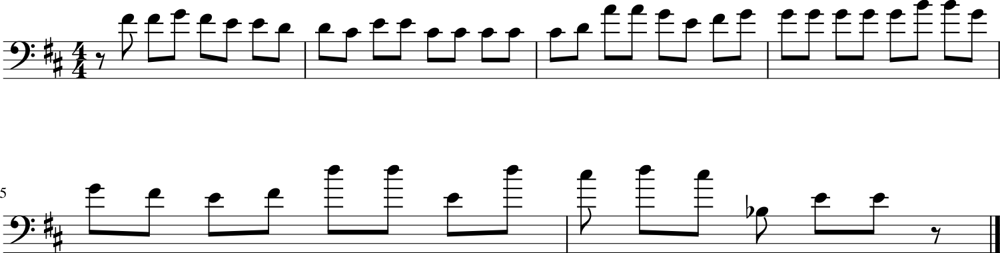

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4948 - loss: 1.1352 - note_outputs_loss: 0.6404
Epoch 646/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5347 - loss: 1.1747 - note_outputs_loss: 0.6400
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3'], ['0.0', '0.0', '0.0', '3.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


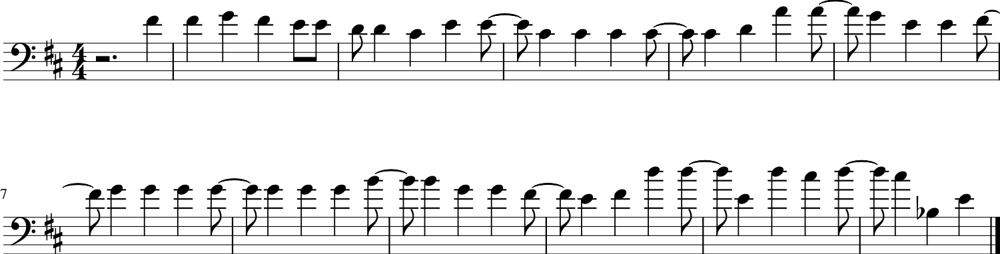

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5345 - loss: 1.1748 - note_outputs_loss: 0.6403
Epoch 647/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4797 - loss: 1.1381 - note_outputs_loss: 0.6584
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'B4', 'G#4', 'A4', 'B4', 'E4', 'G#4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'E3', 'G#3', 'D3', 'A2', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


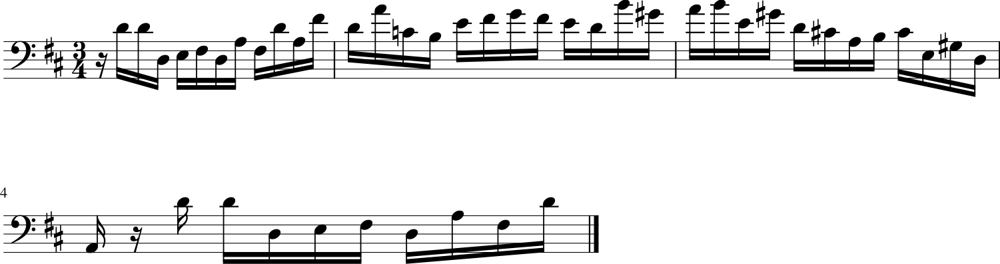

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4801 - loss: 1.1387 - note_outputs_loss: 0.6585
Epoch 648/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5178 - loss: 1.1895 - note_outputs_loss: 0.6717
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


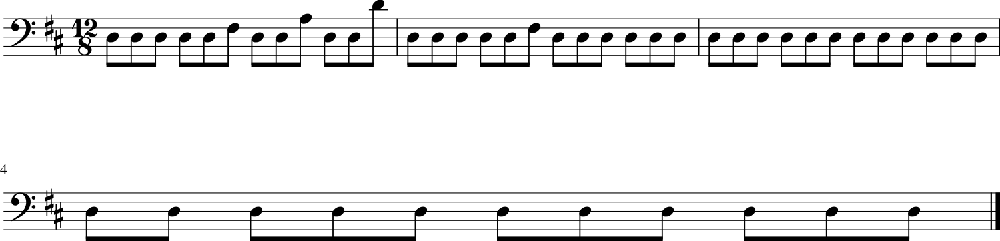

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5179 - loss: 1.1897 - note_outputs_loss: 0.6718
Epoch 649/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4865 - loss: 1.1516 - note_outputs_loss: 0.6651
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'A3', 'G3', 'F3', 'A3', 'A3', 'B3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'C4', 'D4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'B-3', 'E-4', 'G3', 'F3', 'E-3', 'B-2', 'D4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


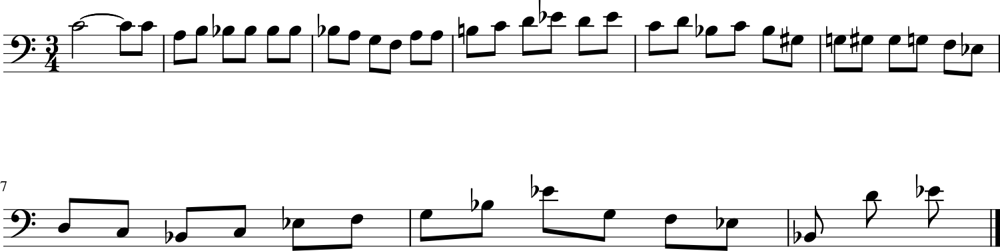

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4869 - loss: 1.1520 - note_outputs_loss: 0.6651
Epoch 650/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4997 - loss: 1.1411 - note_outputs_loss: 0.6415
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


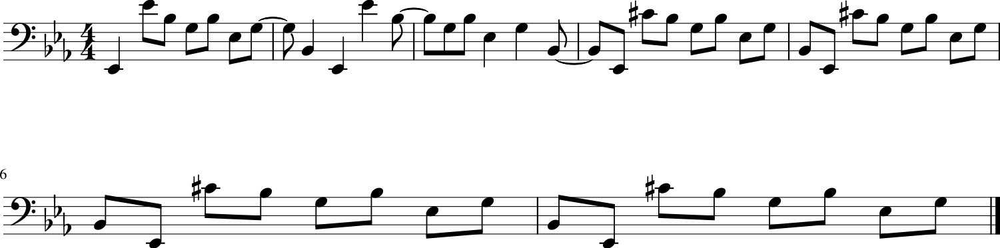

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4999 - loss: 1.1416 - note_outputs_loss: 0.6417
Epoch 651/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5127 - loss: 1.1575 - note_outputs_loss: 0.6448
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


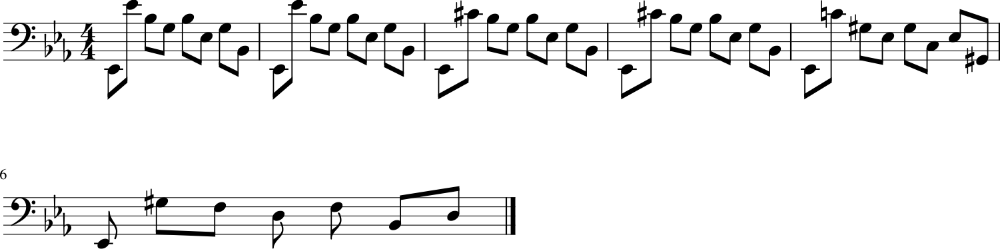

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5128 - loss: 1.1579 - note_outputs_loss: 0.6451
Epoch 652/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4937 - loss: 1.1408 - note_outputs_loss: 0.6471
Generation prompt: [['START', 'G:major', '4/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'D3', 'B3', 'D3', 'G2', 'D3', 'B3', 'A3', 'B3', 'D3', 'B3', 'D3', 'G2', 'E3', 'C4', 'B3', 'C4', 'E3', 'C4', 'E3', 'G2', 'E3', 'C4', 'B3', 'C4', 'E3', 'C4', 'E3', 'G2', 'E3', 'C4', 'B3', 'C4', 'E3', 'C3', 'C4', 'F#3', 'A3', 'C4', 'F#3', 'A3', 'C4'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


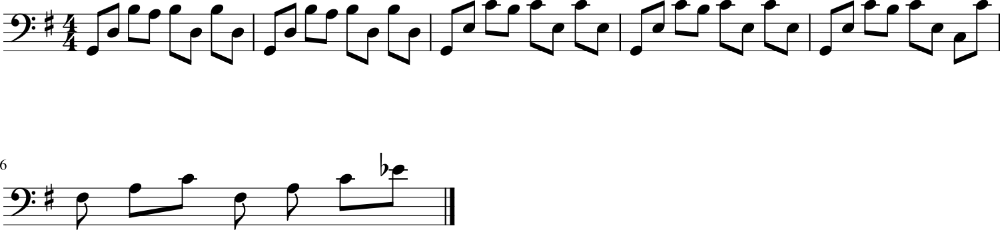

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4940 - loss: 1.1412 - note_outputs_loss: 0.6472
Epoch 653/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5278 - loss: 1.1601 - note_outputs_loss: 0.6323
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


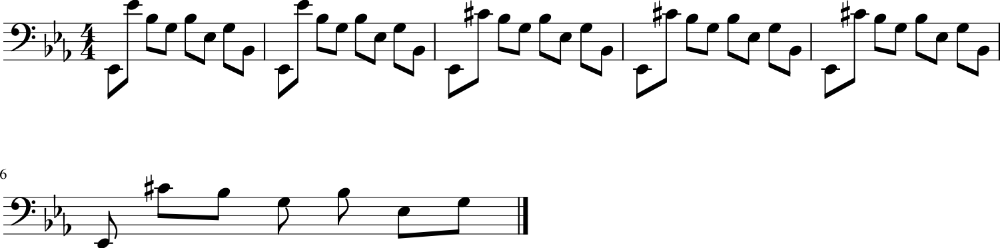

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5277 - loss: 1.1604 - note_outputs_loss: 0.6326
Epoch 654/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5126 - loss: 1.1601 - note_outputs_loss: 0.6475
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'G2', 'F2', 'G2', 'E-2', 'F2', 'A2', 'B2', 'C3', 'E-2', 'D2', 'E-2', 'C2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


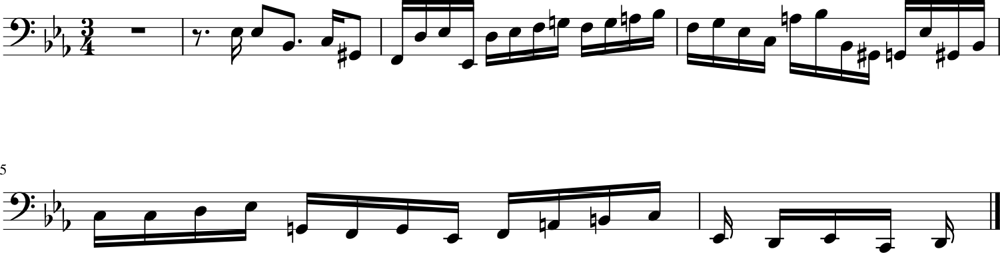

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5127 - loss: 1.1605 - note_outputs_loss: 0.6478
Epoch 655/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5001 - loss: 1.1678 - note_outputs_loss: 0.6677
Generation prompt: [['START', 'E-:major', '3/2TS', 'rest', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'C3', 'B-2', 'G#2', 'G#2', 'C4', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.25', '0.25']]


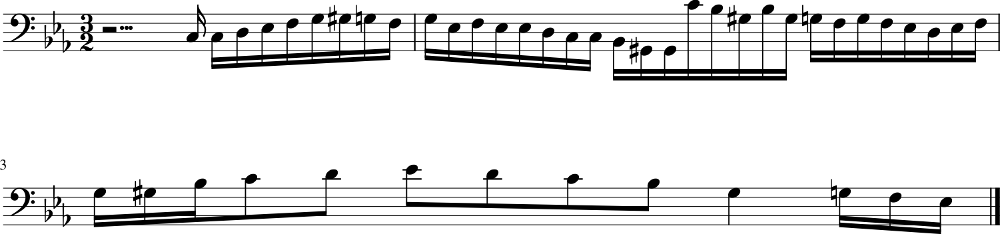

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5003 - loss: 1.1680 - note_outputs_loss: 0.6677
Epoch 656/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4871 - loss: 1.1692 - note_outputs_loss: 0.6821
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'C3', 'G2', 'F2', 'E-3', 'C3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'G2', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


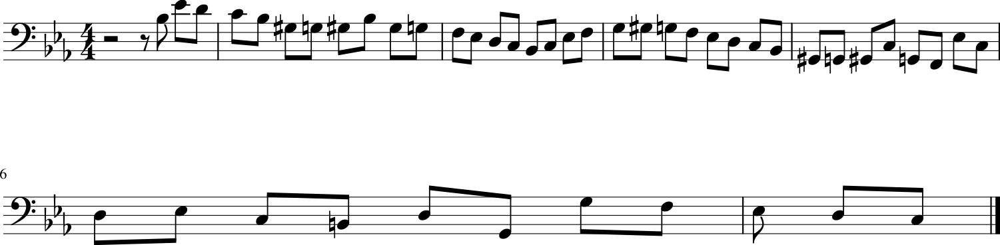

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4874 - loss: 1.1694 - note_outputs_loss: 0.6820
Epoch 657/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5229 - loss: 1.1648 - note_outputs_loss: 0.6419
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


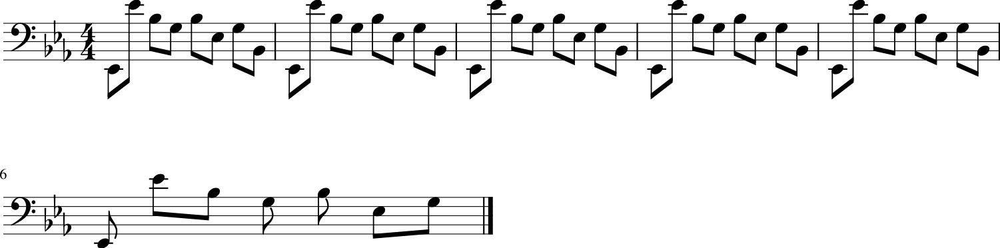

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5229 - loss: 1.1650 - note_outputs_loss: 0.6421
Epoch 658/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5473 - loss: 1.1999 - note_outputs_loss: 0.6525
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


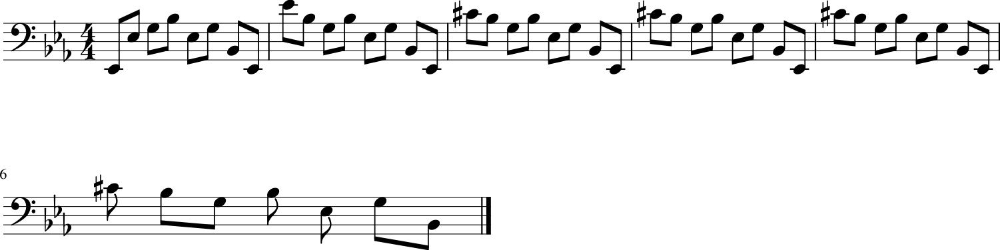

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5471 - loss: 1.1997 - note_outputs_loss: 0.6526
Epoch 659/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5511 - loss: 1.1979 - note_outputs_loss: 0.6468
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


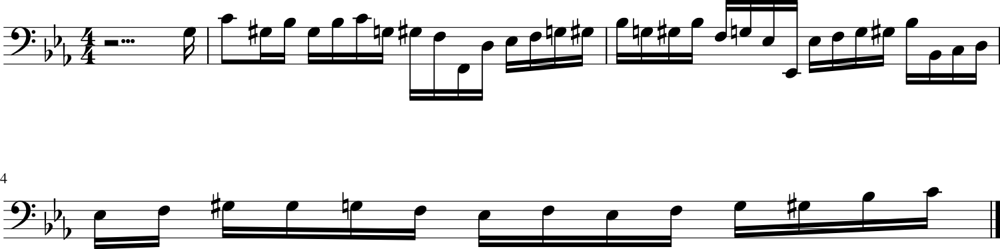

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5508 - loss: 1.1979 - note_outputs_loss: 0.6470
Epoch 660/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5758 - loss: 1.2098 - note_outputs_loss: 0.6341
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'C4', 'B-3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


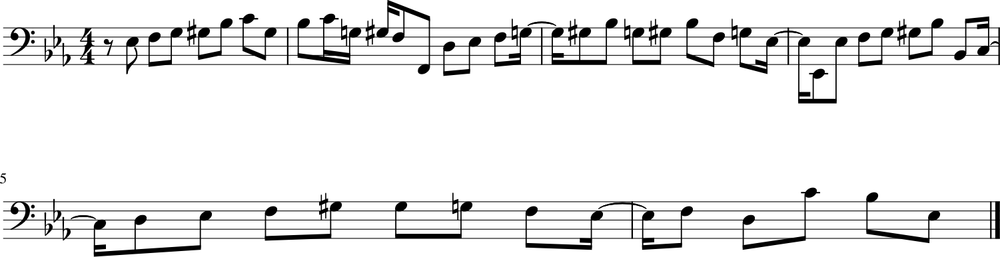

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5753 - loss: 1.2097 - note_outputs_loss: 0.6344
Epoch 661/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5229 - loss: 1.1831 - note_outputs_loss: 0.6601
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'B-3', 'E-4', 'G3', 'F3', 'E-3', 'B-2', 'D4', 'E-4', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


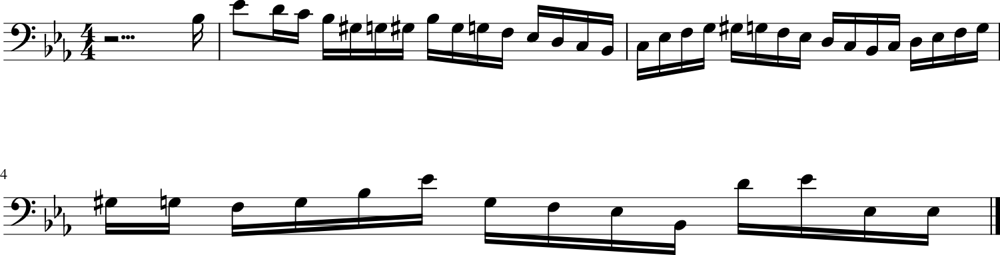

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5229 - loss: 1.1831 - note_outputs_loss: 0.6602
Epoch 662/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5037 - loss: 1.1456 - note_outputs_loss: 0.6419
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


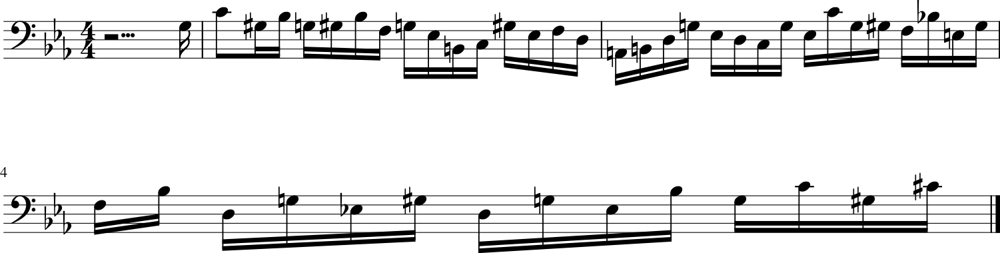

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5039 - loss: 1.1460 - note_outputs_loss: 0.6421
Epoch 663/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5738 - loss: 1.1992 - note_outputs_loss: 0.6254
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


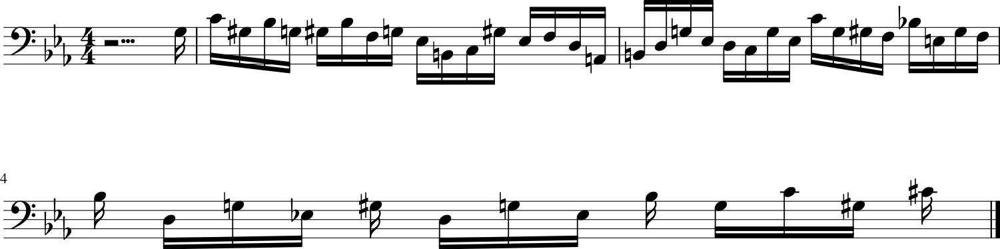

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5734 - loss: 1.1991 - note_outputs_loss: 0.6258
Epoch 664/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5479 - loss: 1.2220 - note_outputs_loss: 0.6741
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


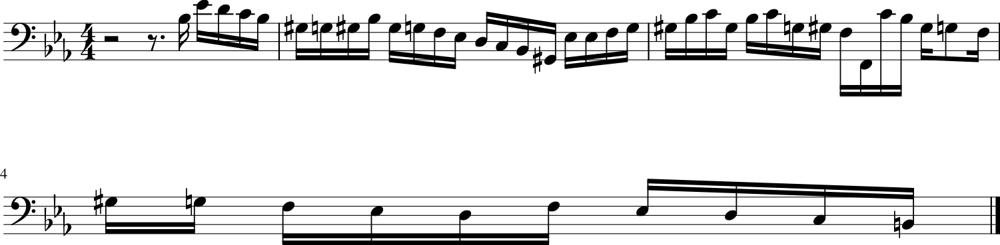

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5477 - loss: 1.2218 - note_outputs_loss: 0.6741
Epoch 665/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5086 - loss: 1.1665 - note_outputs_loss: 0.6579
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '0.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


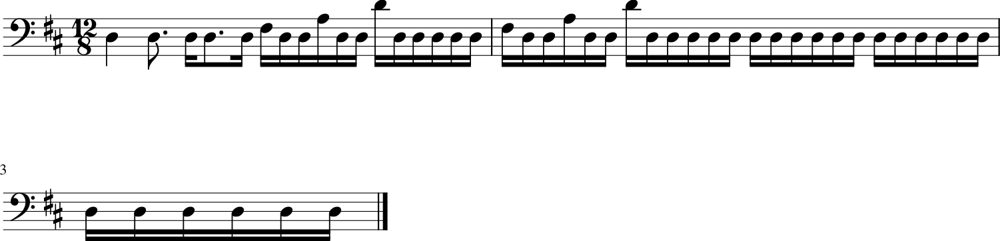

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5088 - loss: 1.1668 - note_outputs_loss: 0.6580
Epoch 666/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5252 - loss: 1.1978 - note_outputs_loss: 0.6726
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

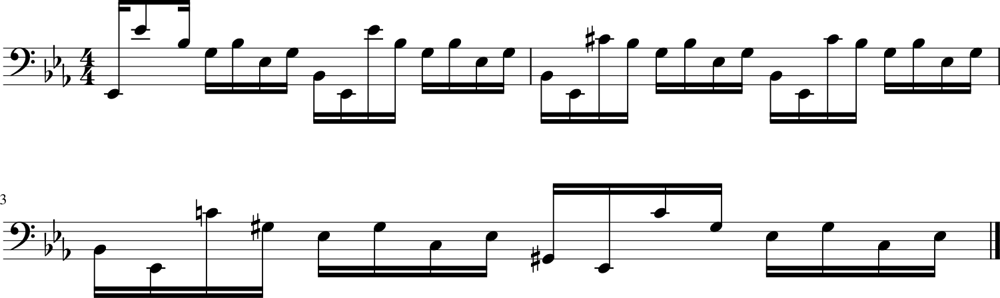

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5252 - loss: 1.1978 - note_outputs_loss: 0.6726
Epoch 667/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4659 - loss: 1.1057 - note_outputs_loss: 0.6398
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


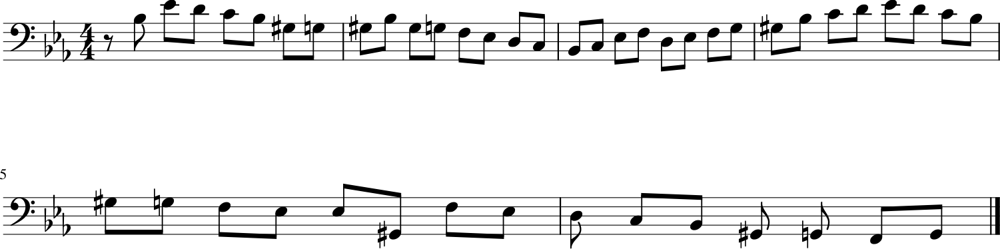

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4664 - loss: 1.1065 - note_outputs_loss: 0.6400
Epoch 668/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5060 - loss: 1.1480 - note_outputs_loss: 0.6420
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


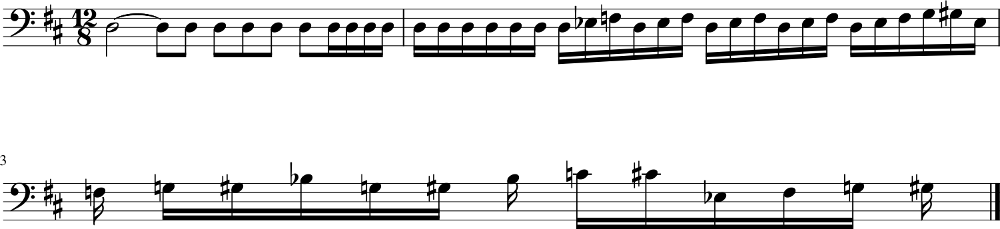

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5061 - loss: 1.1484 - note_outputs_loss: 0.6423
Epoch 669/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5445 - loss: 1.2061 - note_outputs_loss: 0.6616
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'C3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


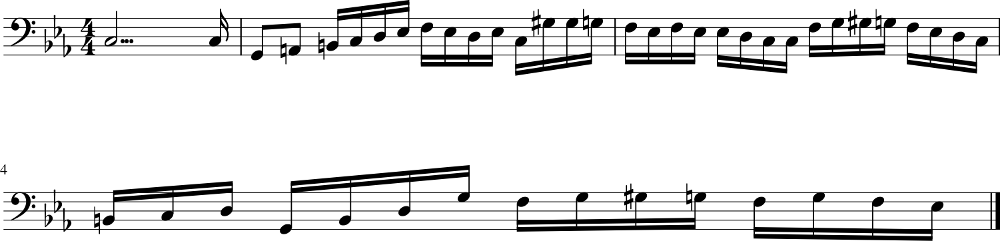

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5443 - loss: 1.2059 - note_outputs_loss: 0.6616
Epoch 670/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5255 - loss: 1.1590 - note_outputs_loss: 0.6335
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'B-2', 'E-2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


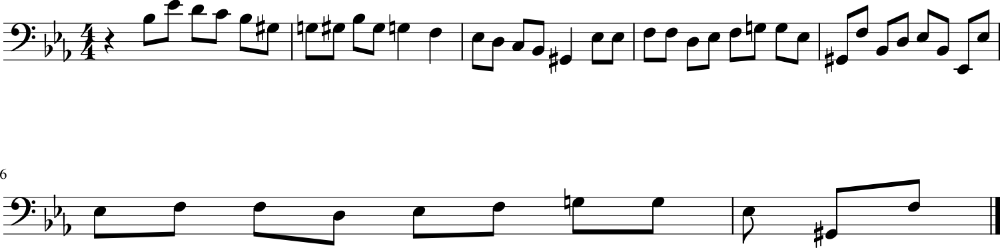

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5255 - loss: 1.1592 - note_outputs_loss: 0.6337
Epoch 671/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5205 - loss: 1.1253 - note_outputs_loss: 0.6048
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

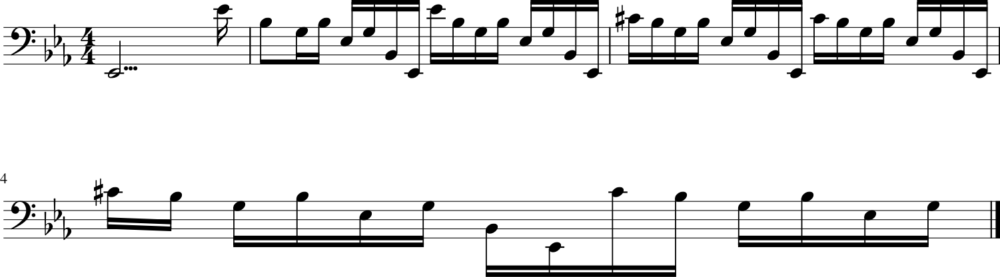

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5205 - loss: 1.1259 - note_outputs_loss: 0.6053
Epoch 672/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5110 - loss: 1.1638 - note_outputs_loss: 0.6528
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'C#4', 'B-3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


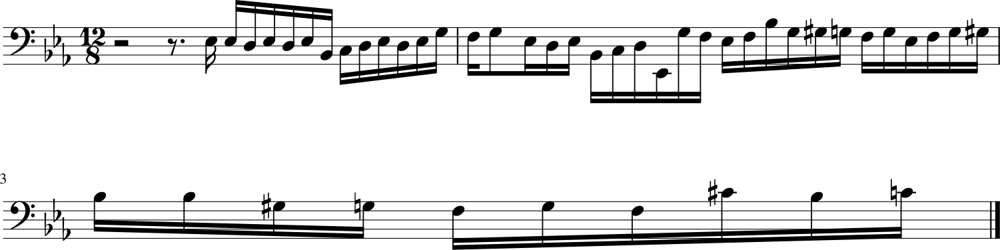

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5111 - loss: 1.1641 - note_outputs_loss: 0.6530
Epoch 673/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5180 - loss: 1.1445 - note_outputs_loss: 0.6265
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'B-3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


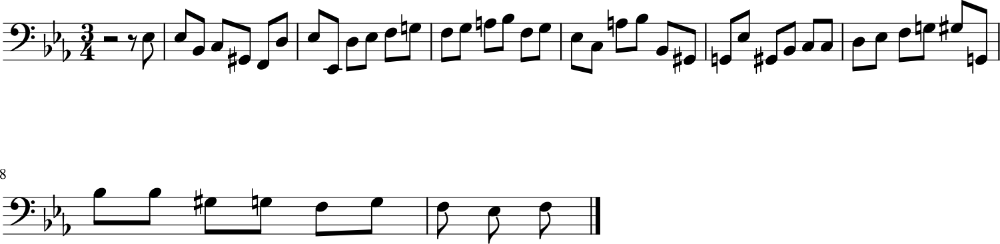

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5181 - loss: 1.1449 - note_outputs_loss: 0.6269
Epoch 674/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5575 - loss: 1.1968 - note_outputs_loss: 0.6393
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'C3', 'F3', 'G#3', 'G#3', 'F3', 'G3', 'C4', 'G3', 'B-3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


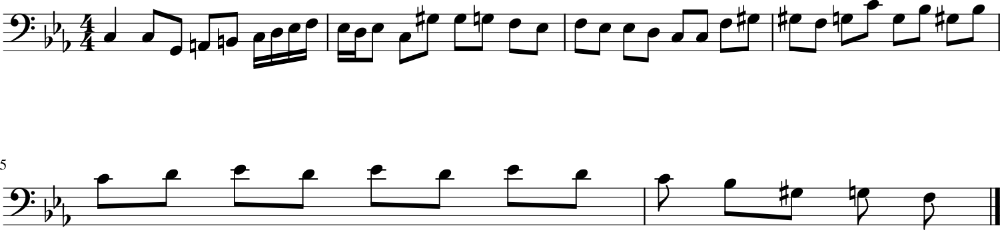

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5572 - loss: 1.1968 - note_outputs_loss: 0.6395
Epoch 675/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5479 - loss: 1.1972 - note_outputs_loss: 0.6493
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


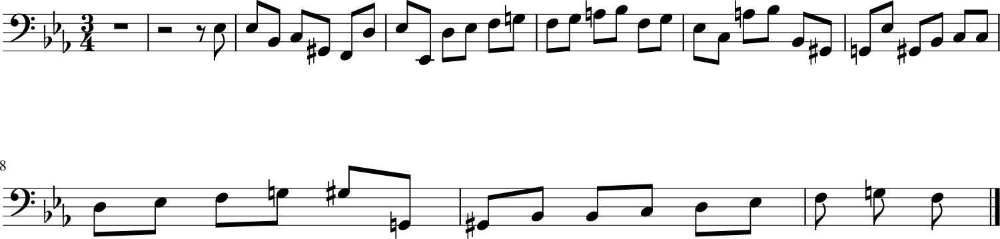

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5477 - loss: 1.1971 - note_outputs_loss: 0.6495
Epoch 676/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5081 - loss: 1.1702 - note_outputs_loss: 0.6621
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'E3', 'F3', 'G3', 'G#3', 'G3', 'G#3', 'F3', 'B3', 'C4', 'D4', 'C4', 'D4', 'B3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3'], ['0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


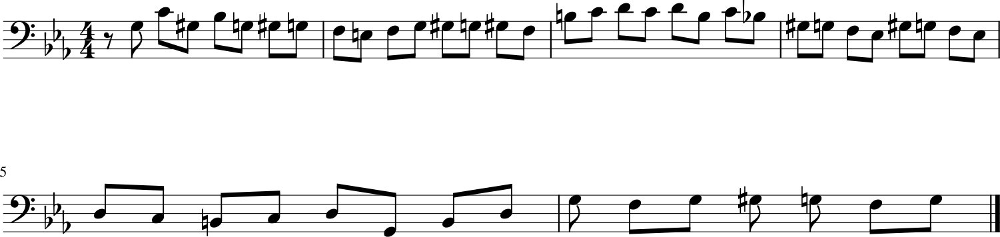

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5083 - loss: 1.1705 - note_outputs_loss: 0.6622
Epoch 677/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5697 - loss: 1.2351 - note_outputs_loss: 0.6655
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'B-3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


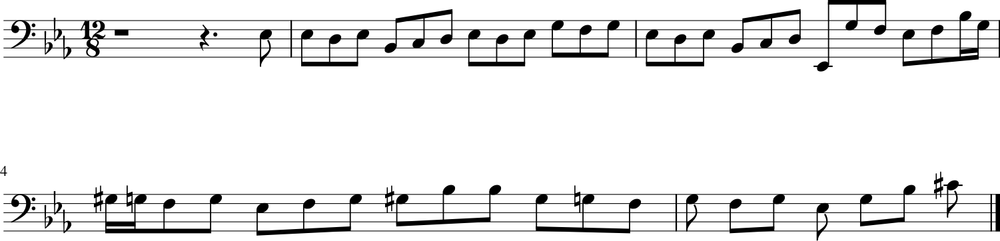

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5692 - loss: 1.2348 - note_outputs_loss: 0.6656
Epoch 678/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5086 - loss: 1.1334 - note_outputs_loss: 0.6248
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'C4', 'D4', 'E-4', 'G3', 'F3', 'E-3', 'E-3', 'rest'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


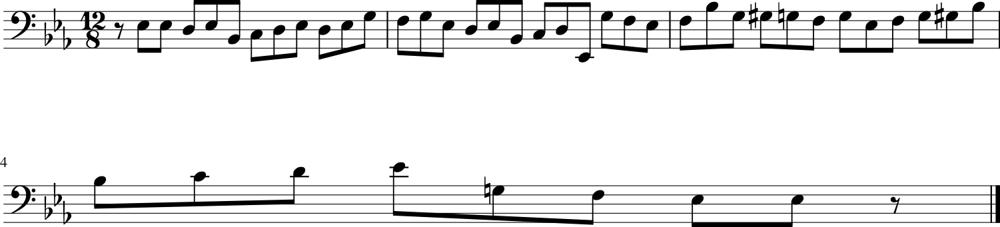

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5087 - loss: 1.1338 - note_outputs_loss: 0.6251
Epoch 679/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5164 - loss: 1.1628 - note_outputs_loss: 0.6464
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]

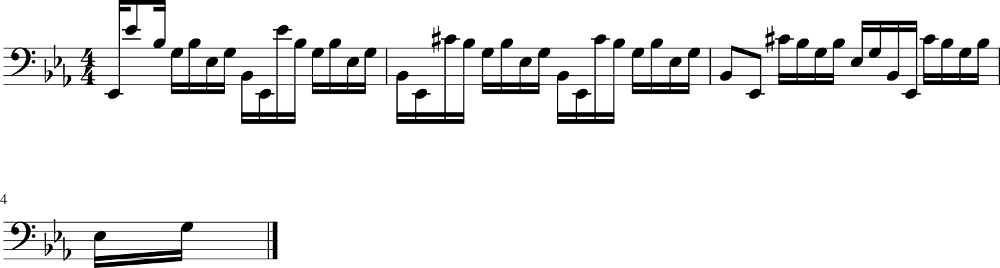

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5165 - loss: 1.1631 - note_outputs_loss: 0.6466
Epoch 680/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5225 - loss: 1.1579 - note_outputs_loss: 0.6354
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'B3', 'E3', 'G2', 'C3', 'D3', 'E-3', 'B2', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'F3', 'E-3', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'C4', 'B3', 'D4', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C2', 'D2', 'E-2', 'F2', 'G2', 'D4', 'C4', 'B3', 'A3', 'B3', 'G2', 'A2'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


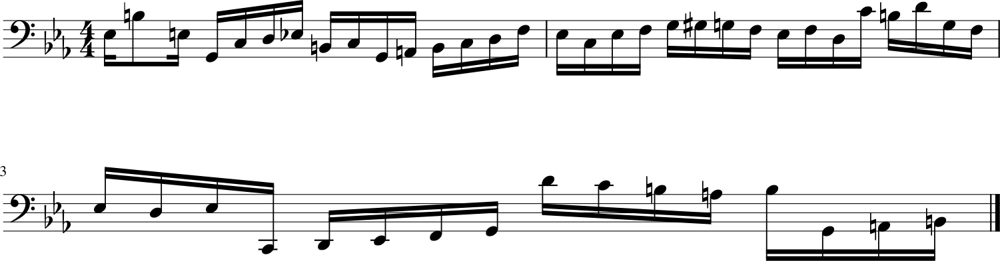

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5225 - loss: 1.1582 - note_outputs_loss: 0.6357
Epoch 681/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4845 - loss: 1.1209 - note_outputs_loss: 0.6364
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


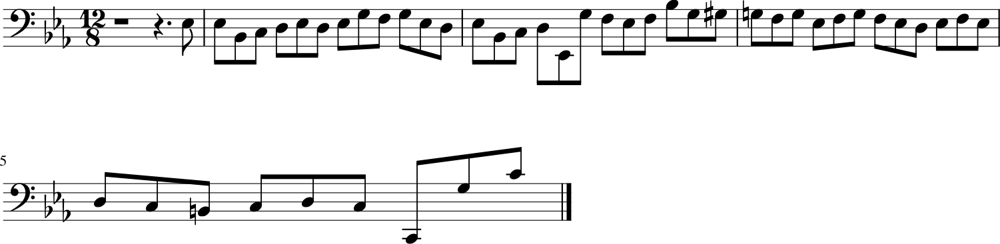

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4848 - loss: 1.1216 - note_outputs_loss: 0.6368
Epoch 682/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5475 - loss: 1.1867 - note_outputs_loss: 0.6392
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'C#4', 'E-3', 'F3', 'G3', 'G#3', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


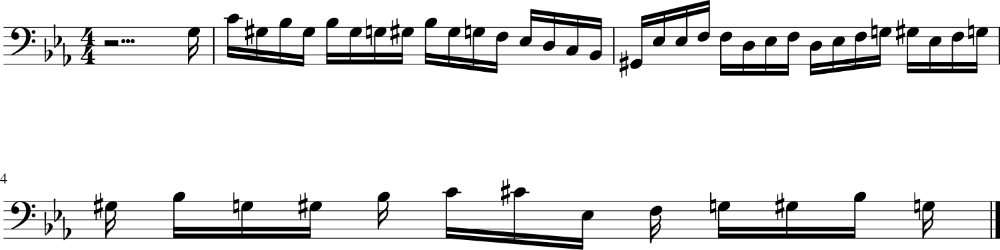

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5472 - loss: 1.1867 - note_outputs_loss: 0.6395
Epoch 683/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4829 - loss: 1.1141 - note_outputs_loss: 0.6311
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

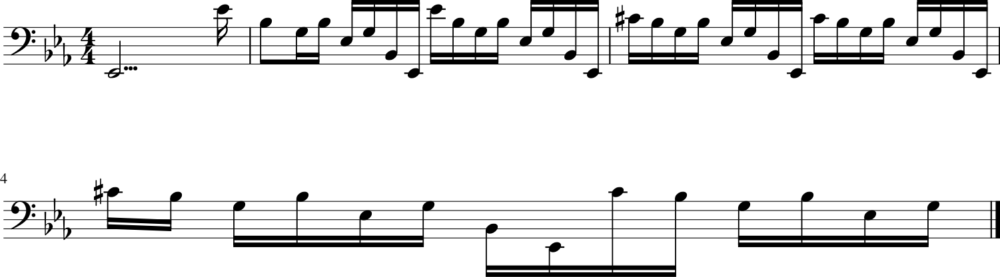

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4833 - loss: 1.1147 - note_outputs_loss: 0.6314
Epoch 684/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4892 - loss: 1.1339 - note_outputs_loss: 0.6448
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


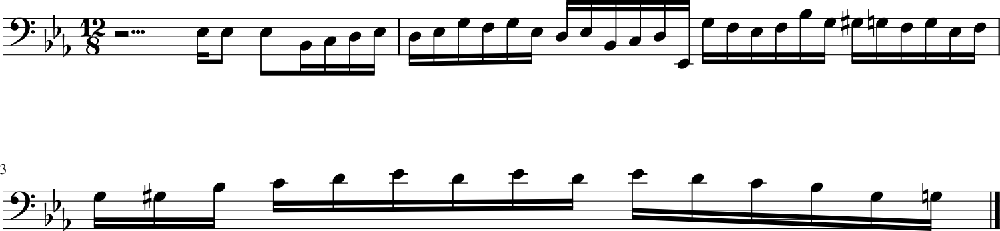

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4895 - loss: 1.1344 - note_outputs_loss: 0.6449
Epoch 685/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5266 - loss: 1.1995 - note_outputs_loss: 0.6728
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'D3', 'B2', 'G2', 'G2', 'D3', 'F3', 'B2', 'C3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


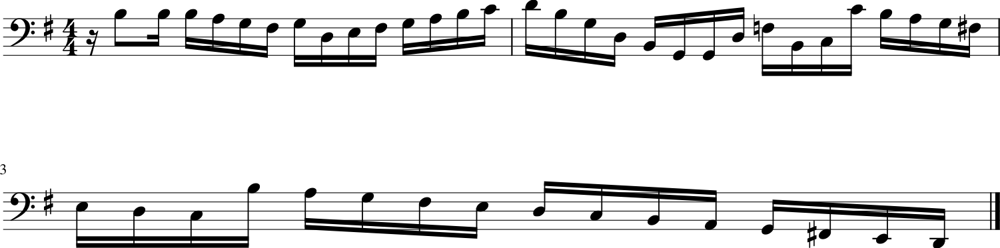

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5266 - loss: 1.1994 - note_outputs_loss: 0.6728
Epoch 686/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5212 - loss: 1.1822 - note_outputs_loss: 0.6609
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'E3', 'A2', 'A3', 'B-3', 'D4', 'C4', 'A3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


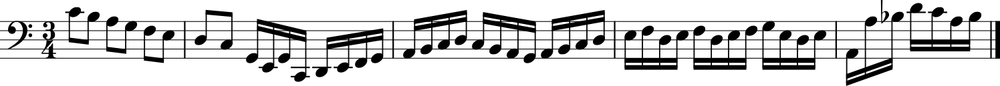

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5212 - loss: 1.1822 - note_outputs_loss: 0.6610
Epoch 687/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5755 - loss: 1.2161 - note_outputs_loss: 0.6405
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'F#2', 'A3', 'G2', 'B2', 'E3', 'G3', 'D3', 'C#3', 'B2', 'C#3', 'A2', 'G2', 'F#2', 'D4', 'C#4', 'B3', 'A3', 'G3', 'B3', 'A3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


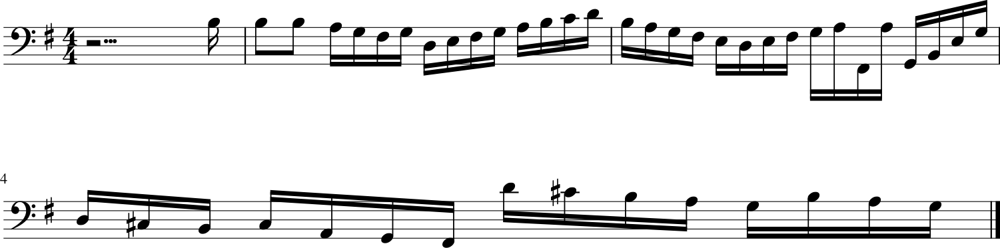

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5750 - loss: 1.2158 - note_outputs_loss: 0.6407
Epoch 688/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4669 - loss: 1.1223 - note_outputs_loss: 0.6554
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'B4', 'A4', 'D4', 'C#4', 'E4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'G4', 'E4', 'F#4', 'G4', 'B4', 'C#5', 'E-5', 'E5', 'E4', 'F#4', 'G4', 'B4', 'F#4', 'G4', 'E5', 'B4', 'G4', 'B4', 'G4', 'E4', 'E5', 'F#4', 'G4', 'B4', 'F#4', 'G4', 'E5', 'B4', 'G4', 'B4', 'G4', 'E4', 'E4', 'C#4'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


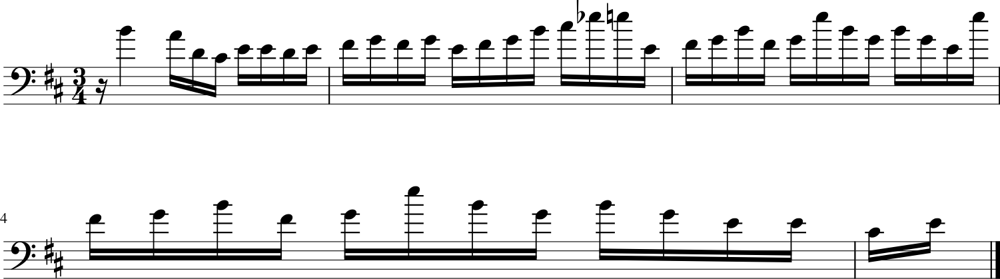

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4675 - loss: 1.1231 - note_outputs_loss: 0.6556
Epoch 689/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5277 - loss: 1.1727 - note_outputs_loss: 0.6450
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'A3', 'D3', 'F#3', 'D3', 'C3', 'B2', 'G3', 'D3', 'B2', 'D3', 'A3', 'B3', 'C4', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'G3', 'D3', 'E3', 'F3', 'D3', 'B2'], ['0.0', '0.0', '0.0', '2.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


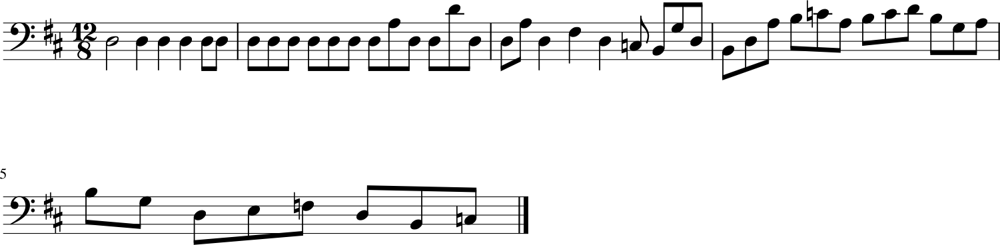

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5276 - loss: 1.1727 - note_outputs_loss: 0.6451
Epoch 690/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5597 - loss: 1.1908 - note_outputs_loss: 0.6311
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


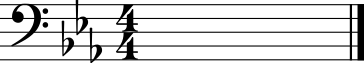

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5593 - loss: 1.1907 - note_outputs_loss: 0.6314
Epoch 691/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5003 - loss: 1.1134 - note_outputs_loss: 0.6131
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


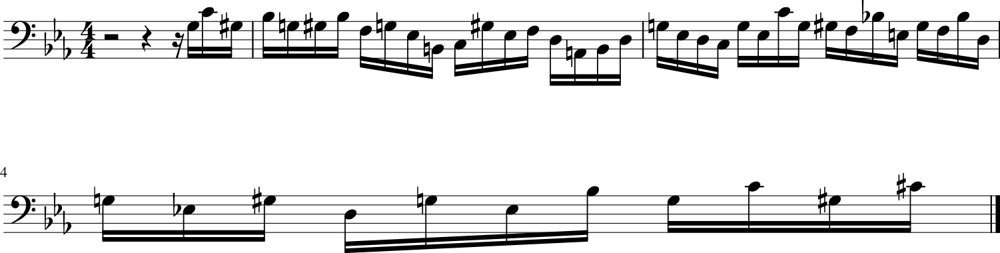

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5005 - loss: 1.1140 - note_outputs_loss: 0.6135
Epoch 692/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5335 - loss: 1.1723 - note_outputs_loss: 0.6388
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


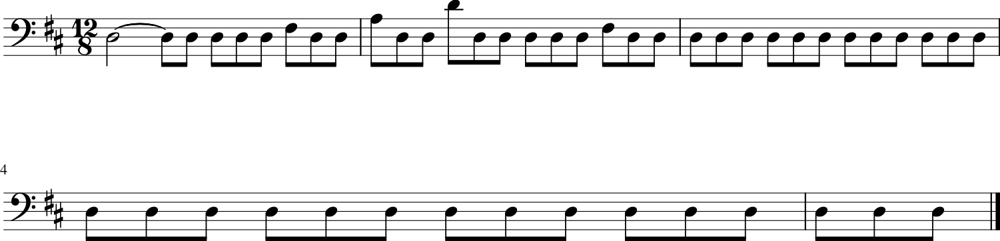

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5334 - loss: 1.1724 - note_outputs_loss: 0.6390
Epoch 693/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5450 - loss: 1.2033 - note_outputs_loss: 0.6583
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'E-2', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '0.0', '3.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


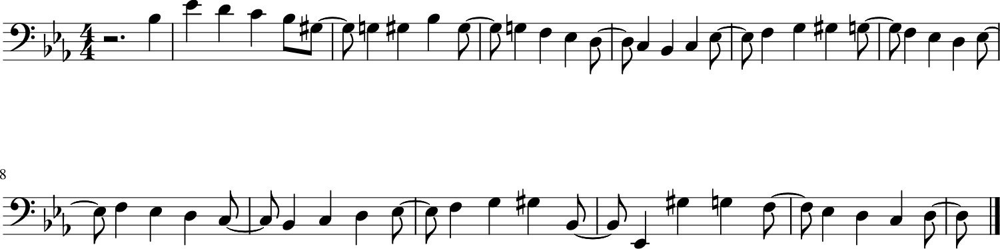

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5448 - loss: 1.2031 - note_outputs_loss: 0.6583
Epoch 694/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5058 - loss: 1.1629 - note_outputs_loss: 0.6571
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'A4', 'G4', 'E4', 'C#4', 'A3', 'G3', 'F#3', 'D4', 'B3', 'B3', 'F#3', 'rest', 'G4', 'G4', 'C#4', 'D3', 'B3', 'D4', 'G4', 'F#4', 'F#3', 'E3', 'F#3', 'F#3', 'C2', 'A3', 'B3', 'C4', 'C4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


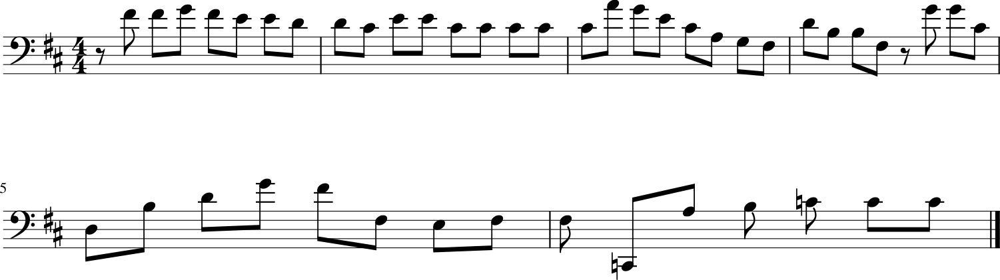

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5059 - loss: 1.1631 - note_outputs_loss: 0.6572
Epoch 695/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4648 - loss: 1.1145 - note_outputs_loss: 0.6498
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'C4', 'B3', 'G3', 'E3', 'C3', 'G2', 'E2', 'B3', 'G3', 'F3', 'E3', 'D3', 'C3', 'B2', 'C3', 'G3', 'F3', 'E3', 'F3', 'B2', 'F3', 'B2', 'G2', 'F3', 'E3', 'D3', 'E3', 'C3', 'C4', 'B3', 'A3', 'B3', 'C4', 'G3', 'F#3', 'B3', 'C4', 'E3', 'D3', 'B3', 'C4', 'C3', 'B2', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


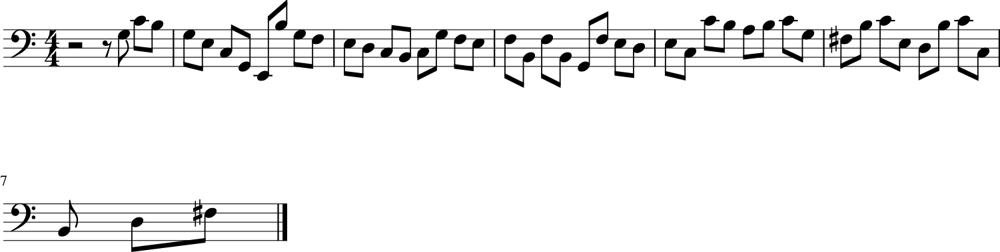

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4653 - loss: 1.1152 - note_outputs_loss: 0.6499
Epoch 696/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4694 - loss: 1.1091 - note_outputs_loss: 0.6397
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


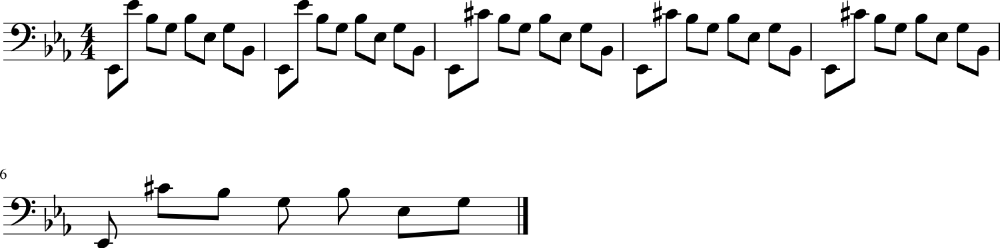

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4699 - loss: 1.1097 - note_outputs_loss: 0.6399
Epoch 697/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5472 - loss: 1.2063 - note_outputs_loss: 0.6591
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


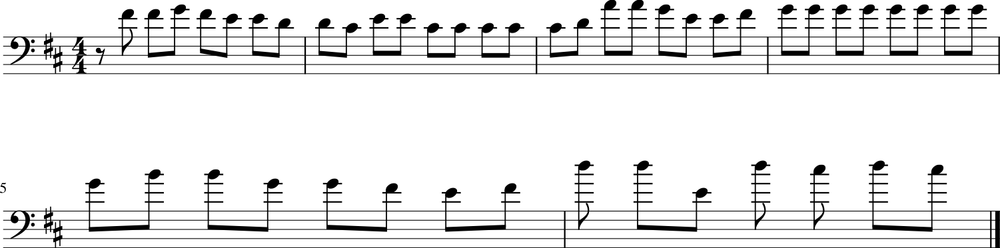

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5469 - loss: 1.2061 - note_outputs_loss: 0.6591
Epoch 698/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4706 - loss: 1.1300 - note_outputs_loss: 0.6595
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


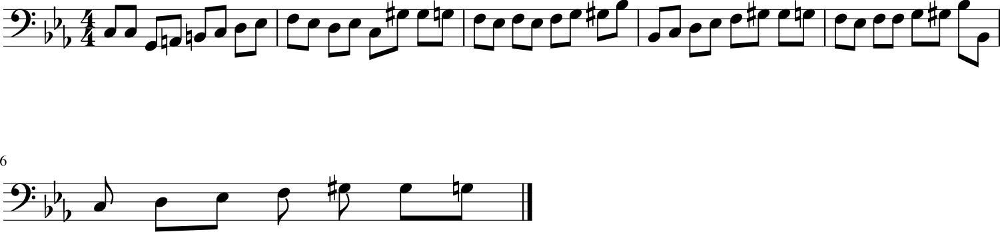

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4711 - loss: 1.1306 - note_outputs_loss: 0.6595
Epoch 699/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5030 - loss: 1.1308 - note_outputs_loss: 0.6277
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'B-3', 'G#3', 'F3', 'F2', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


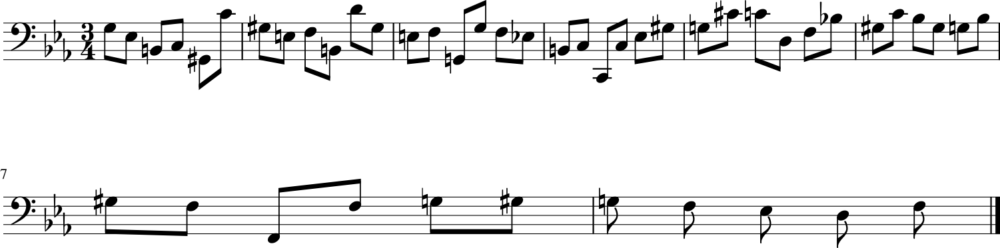

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5032 - loss: 1.1312 - note_outputs_loss: 0.6280
Epoch 700/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5474 - loss: 1.1894 - note_outputs_loss: 0.6420
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


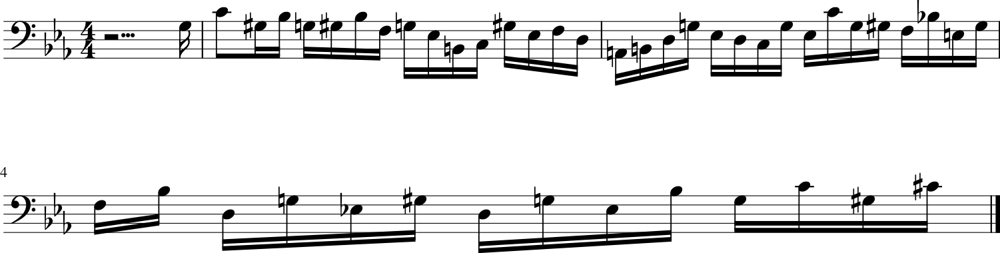

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5471 - loss: 1.1893 - note_outputs_loss: 0.6422
Epoch 701/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4848 - loss: 1.1566 - note_outputs_loss: 0.6718
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


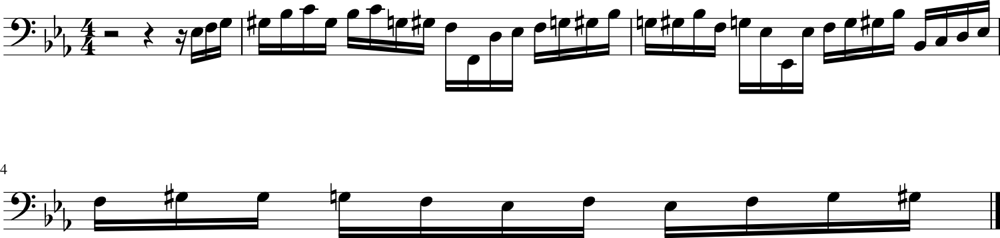

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4852 - loss: 1.1569 - note_outputs_loss: 0.6718
Epoch 702/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5727 - loss: 1.2189 - note_outputs_loss: 0.6463
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


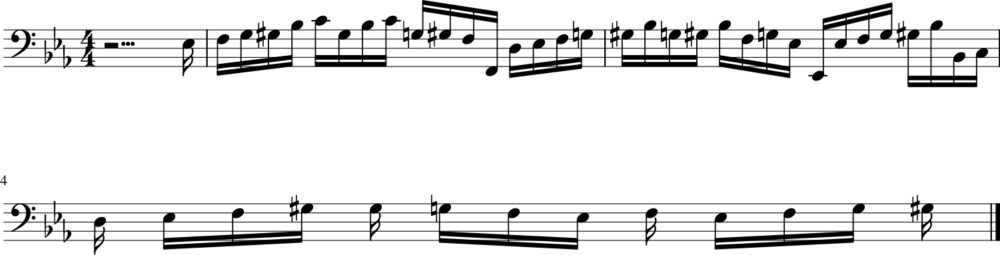

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5722 - loss: 1.2186 - note_outputs_loss: 0.6464
Epoch 703/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5166 - loss: 1.1764 - note_outputs_loss: 0.6598
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'A3', 'D3', 'F#3', 'A3', 'G3', 'B3', 'C4', 'D4', 'C4', 'B3', 'C4', 'C4', 'G3', 'A3', 'B3', 'G3', 'E3', 'D3', 'C3', 'G2'], ['0.0', '0.0', '0.0', '3.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


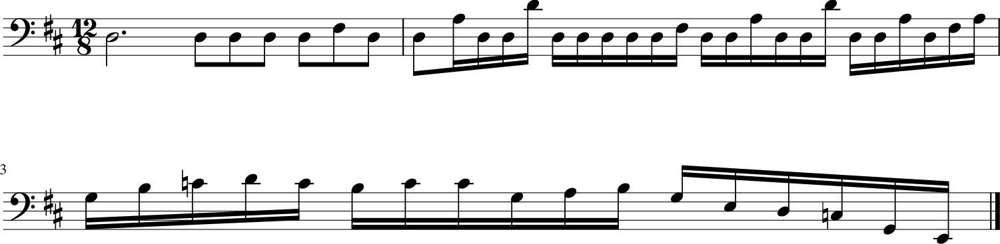

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5167 - loss: 1.1764 - note_outputs_loss: 0.6598
Epoch 704/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4621 - loss: 1.0994 - note_outputs_loss: 0.6373
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


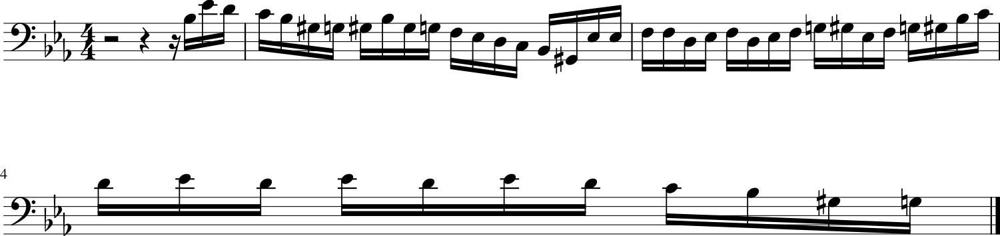

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4626 - loss: 1.1002 - note_outputs_loss: 0.6376
Epoch 705/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5003 - loss: 1.1341 - note_outputs_loss: 0.6337
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


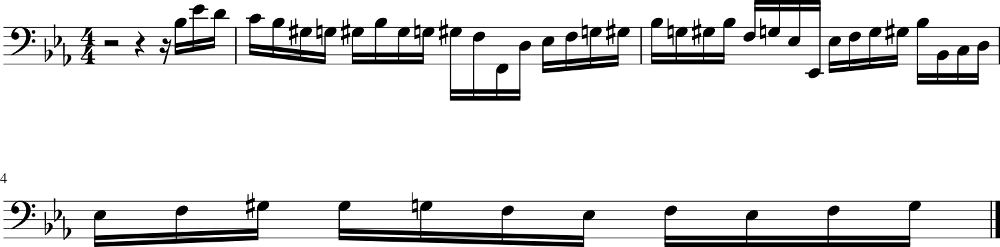

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5005 - loss: 1.1346 - note_outputs_loss: 0.6340
Epoch 706/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5331 - loss: 1.2016 - note_outputs_loss: 0.6685
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'B-2', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'A2', 'C3', 'F#3', 'A3', 'F#3', 'A3', 'F#3', 'D3', 'F#3', 'A2', 'D2', 'A2', 'D3', 'F#3', 'A3', 'C4', 'A3', 'F#3', 'D3', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


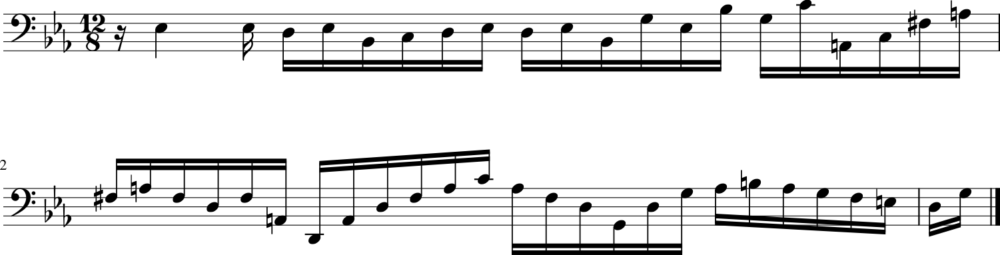

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5330 - loss: 1.2015 - note_outputs_loss: 0.6685
Epoch 707/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5104 - loss: 1.1401 - note_outputs_loss: 0.6298
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'G3', 'E3', 'C3', 'B2', 'C3', 'F#3', 'G2', 'C3', 'B2', 'C3', 'F#2', 'G2', 'C2', 'C3', 'D3', 'E3', 'C3', 'B2', 'A2', 'G2', 'B2', 'D3', 'A2', 'D3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


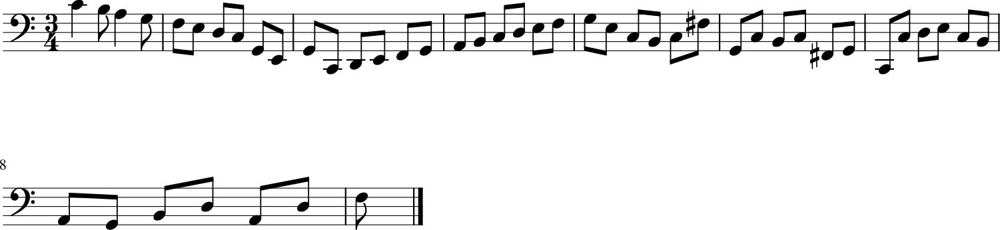

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5105 - loss: 1.1405 - note_outputs_loss: 0.6300
Epoch 708/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5214 - loss: 1.1715 - note_outputs_loss: 0.6500
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '3.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


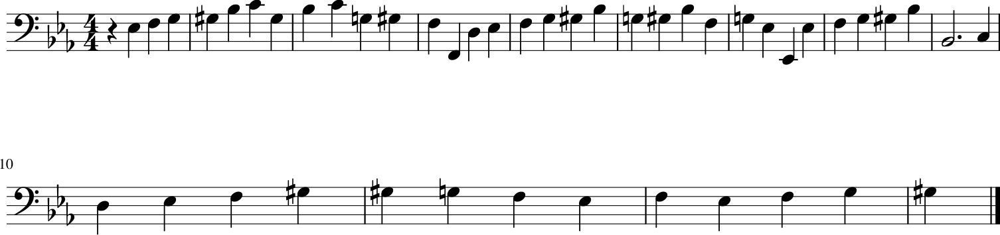

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5215 - loss: 1.1716 - note_outputs_loss: 0.6501
Epoch 709/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4338 - loss: 1.0766 - note_outputs_loss: 0.6428
Generation prompt: [['START', 'C:major'], ['0.0', '0.0']]


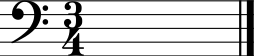

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.4346 - loss: 1.0775 - note_outputs_loss: 0.6429
Epoch 710/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4600 - loss: 1.0955 - note_outputs_loss: 0.6354
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


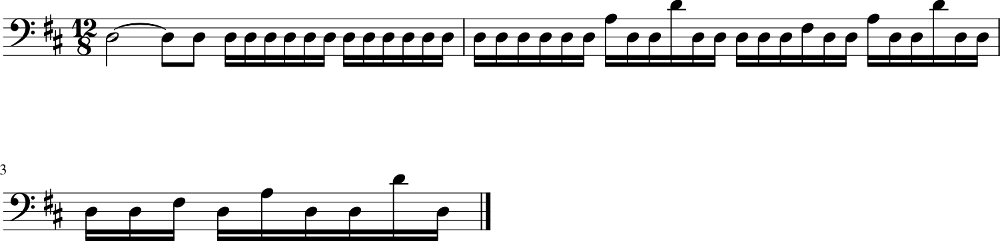

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4606 - loss: 1.0963 - note_outputs_loss: 0.6357
Epoch 711/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5087 - loss: 1.1567 - note_outputs_loss: 0.6480
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'G#3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'C3', 'F3', 'G#3', 'G#3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'D3', 'C3', 'B2', 'A2', 'G2', 'D3', 'F3', 'B3', 'D4', 'G3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


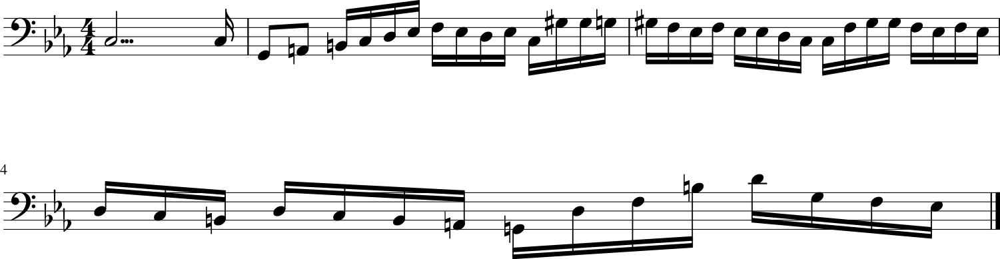

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5088 - loss: 1.1570 - note_outputs_loss: 0.6482
Epoch 712/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4698 - loss: 1.1231 - note_outputs_loss: 0.6533
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'G3', 'C4', 'G3', 'G2', 'C2', 'B2', 'C#3', 'C3', 'E3', 'D3', 'E3', 'F3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'G#3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'C2', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


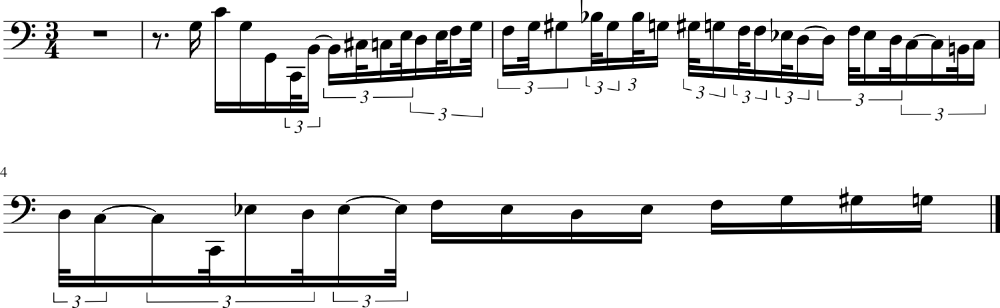

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.4703 - loss: 1.1237 - note_outputs_loss: 0.6534
Epoch 713/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5219 - loss: 1.1708 - note_outputs_loss: 0.6489
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


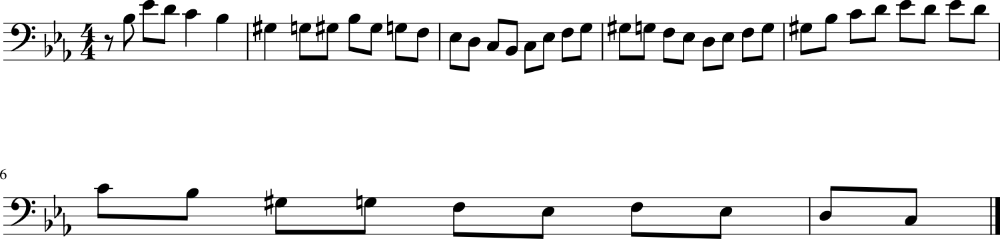

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5218 - loss: 1.1709 - note_outputs_loss: 0.6490
Epoch 714/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5179 - loss: 1.1492 - note_outputs_loss: 0.6313
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


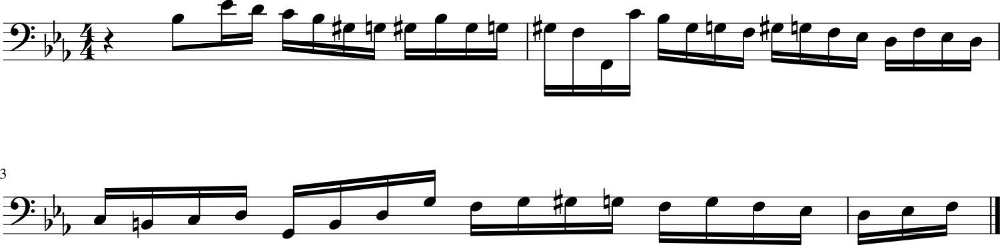

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5180 - loss: 1.1496 - note_outputs_loss: 0.6316
Epoch 715/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5047 - loss: 1.1348 - note_outputs_loss: 0.6300
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


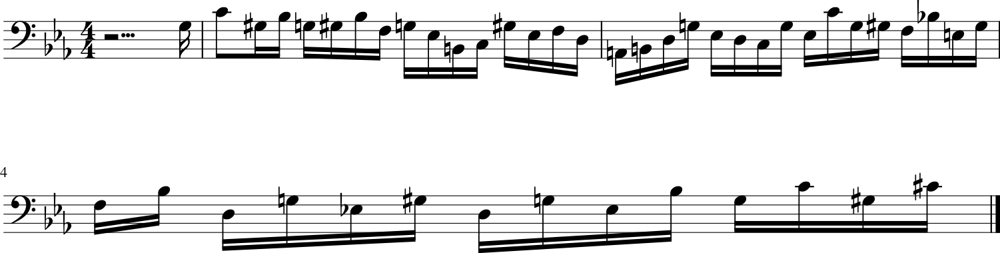

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5049 - loss: 1.1352 - note_outputs_loss: 0.6303
Epoch 716/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5571 - loss: 1.1770 - note_outputs_loss: 0.6199
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


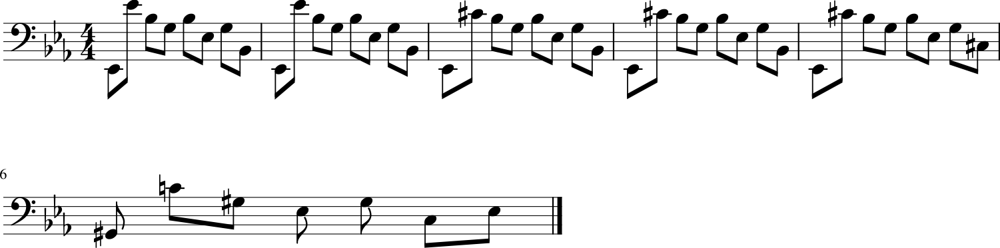

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5568 - loss: 1.1771 - note_outputs_loss: 0.6203
Epoch 717/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5253 - loss: 1.1519 - note_outputs_loss: 0.6266
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.2

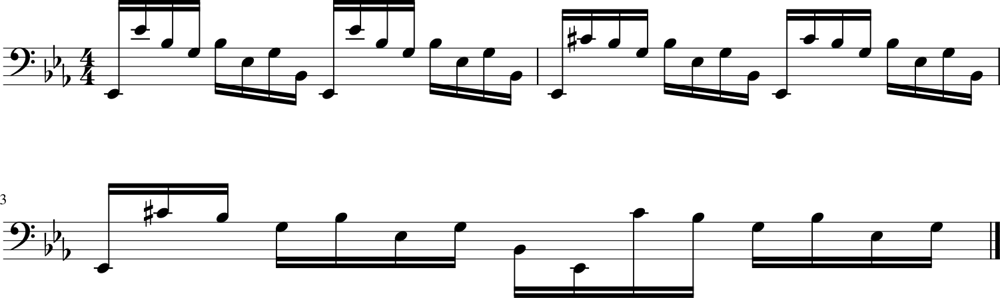

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5253 - loss: 1.1521 - note_outputs_loss: 0.6269
Epoch 718/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5380 - loss: 1.1767 - note_outputs_loss: 0.6387
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'D3', 'E-3', 'C4', 'B-3', 'E-3', 'D3', 'E-3', 'E-4', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C4', 'G2', 'G#2', 'F3', 'B-2', 'D3', 'F3', 'B-3'], ['0.0', '3.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '4.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


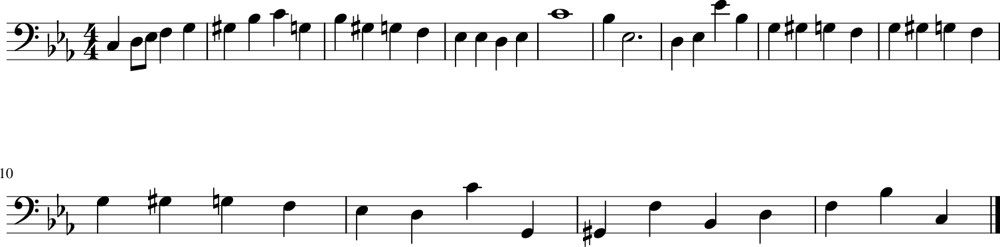

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5379 - loss: 1.1767 - note_outputs_loss: 0.6388
Epoch 719/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4987 - loss: 1.1057 - note_outputs_loss: 0.6070
Generation prompt: [['START', 'E-:major', '3/4TS', 'C4', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'B2', 'D3', 'E-3', 'D3', 'C3', 'B2', 'D3', 'C3', 'D3', 'B2', 'D3', 'F3', 'B3', 'B3', 'E3', 'G#3', 'F3', 'E3', 'D3', 'C3', 'B2', 'C3', 'G3', 'B2', 'E-2', 'C2', 'E-2', 'G3', 'F3', 'E-3', 'G3', 'rest', 'D4', 'D4', 'E-4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


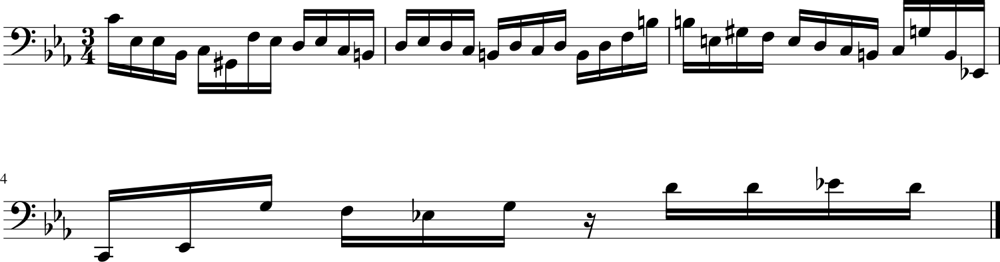

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4989 - loss: 1.1064 - note_outputs_loss: 0.6074
Epoch 720/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5205 - loss: 1.1537 - note_outputs_loss: 0.6332
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'G#3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


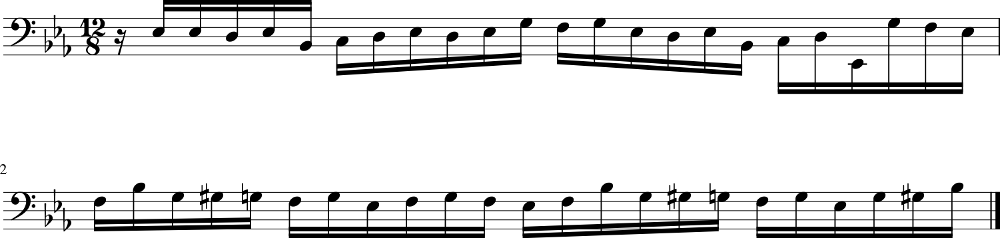

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5205 - loss: 1.1540 - note_outputs_loss: 0.6334
Epoch 721/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - duration_outputs_loss: 0.5049 - loss: 1.1327 - note_outputs_loss: 0.6278
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'C4', 'B-3', 'G#3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-2', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'E-3', 'F3', 'A2', 'B2', 'C3', 'D3', 'B2', 'G2', 'A2', 'B2', 'F2'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


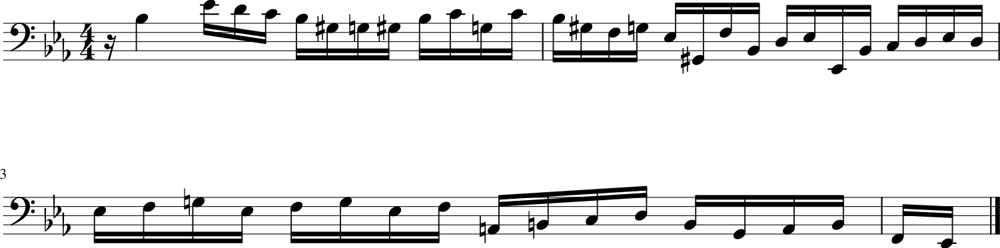

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5050 - loss: 1.1331 - note_outputs_loss: 0.6281
Epoch 722/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5668 - loss: 1.2194 - note_outputs_loss: 0.6526
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


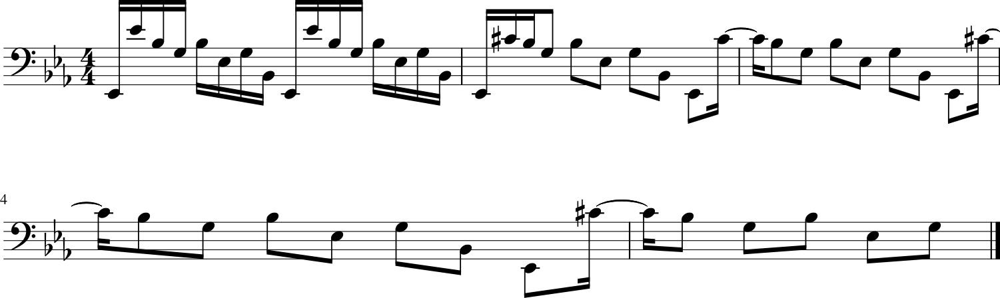

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5664 - loss: 1.2191 - note_outputs_loss: 0.6527
Epoch 723/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5319 - loss: 1.1666 - note_outputs_loss: 0.6347
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'B2', 'D4', 'B3', 'A3', 'A3', 'B3', 'C4', 'A3', 'D4', 'B3', 'A3', 'B3', 'C4', 'A3', 'D4', 'B3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'D4', 'E4', 'F4'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1.0', '1/12', '1/6', '1/12', '1/6', '1/12', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


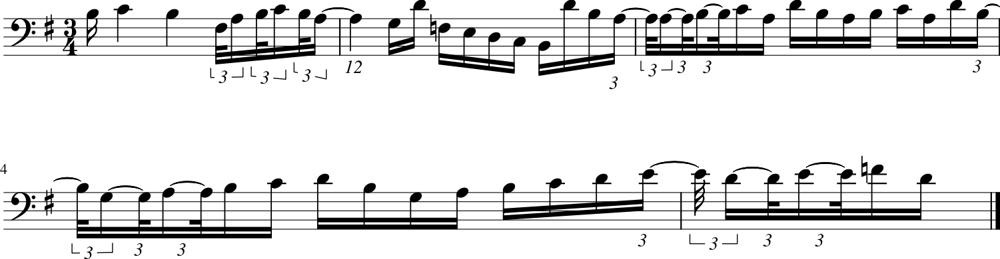

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5318 - loss: 1.1667 - note_outputs_loss: 0.6349
Epoch 724/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5392 - loss: 1.1532 - note_outputs_loss: 0.6140
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


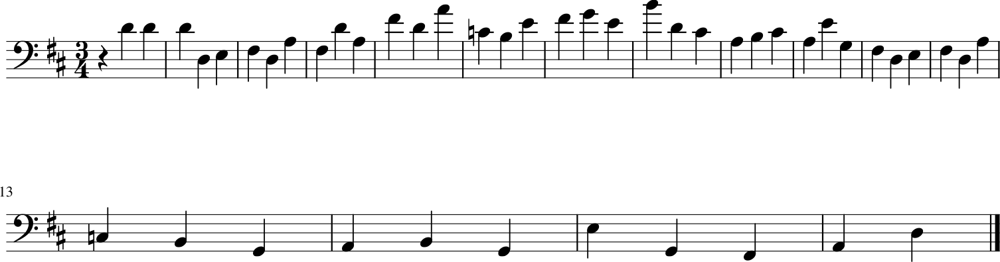

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5391 - loss: 1.1534 - note_outputs_loss: 0.6144
Epoch 725/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5170 - loss: 1.1439 - note_outputs_loss: 0.6269
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4', 'F#3', 'G3'], ['0.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


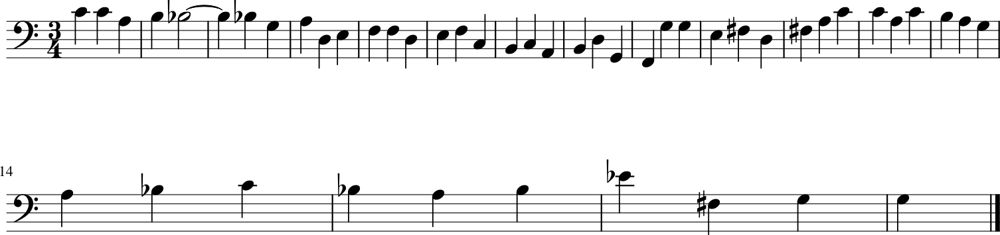

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5171 - loss: 1.1443 - note_outputs_loss: 0.6272
Epoch 726/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5394 - loss: 1.1785 - note_outputs_loss: 0.6390
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


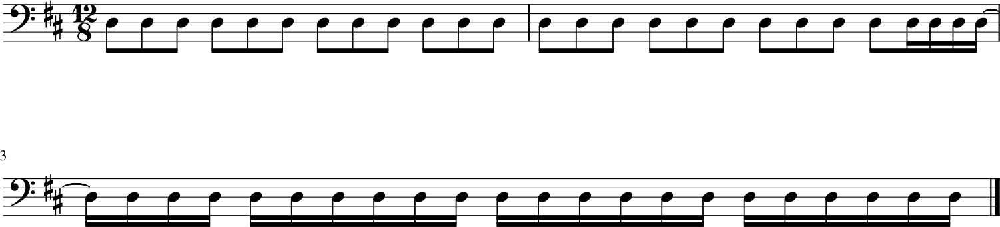

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5393 - loss: 1.1785 - note_outputs_loss: 0.6393
Epoch 727/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5101 - loss: 1.1543 - note_outputs_loss: 0.6442
Generation prompt: [['START', 'E-:major', '3/4TS', 'E-4', 'rest', 'E-3', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'F3', 'A3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'D3', 'F3', 'B3', 'D4', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C2', 'D2', 'E-2', 'F2', 'G2', 'D4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


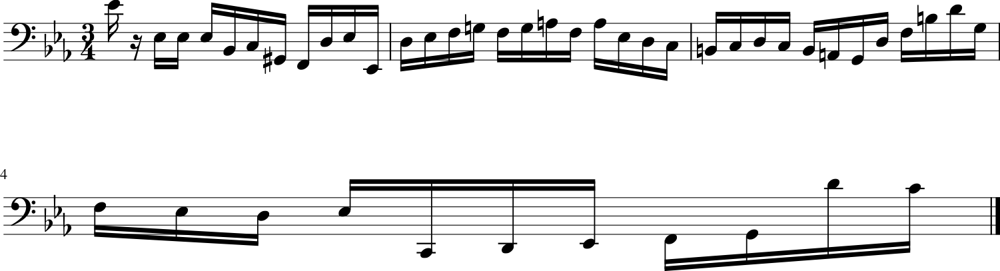

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5102 - loss: 1.1545 - note_outputs_loss: 0.6443
Epoch 728/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5154 - loss: 1.1659 - note_outputs_loss: 0.6505
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'C4', 'B3', 'A3', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


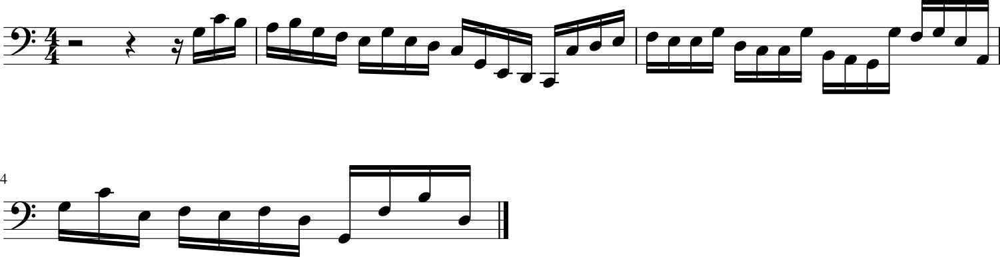

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5154 - loss: 1.1661 - note_outputs_loss: 0.6507
Epoch 729/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4833 - loss: 1.1114 - note_outputs_loss: 0.6281
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


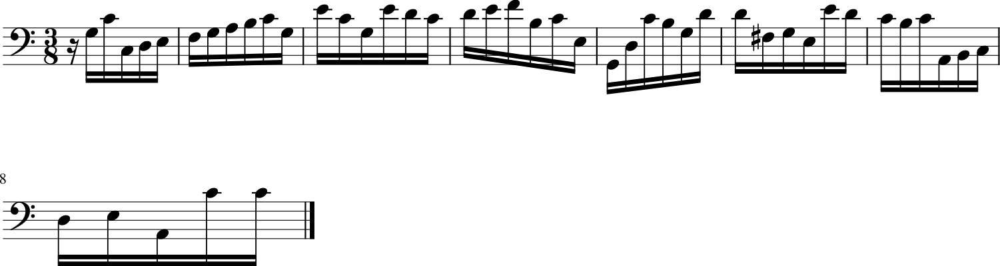

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4837 - loss: 1.1120 - note_outputs_loss: 0.6284
Epoch 730/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5454 - loss: 1.1732 - note_outputs_loss: 0.6278
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'G3', 'B-3', 'C#4', 'E4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'D4', 'D4', 'D4', 'D4', 'F#3', 'G3', 'B2', 'C3', 'A3', 'G3', 'A3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3'], ['0.0', '0.0', '0.0', '2.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


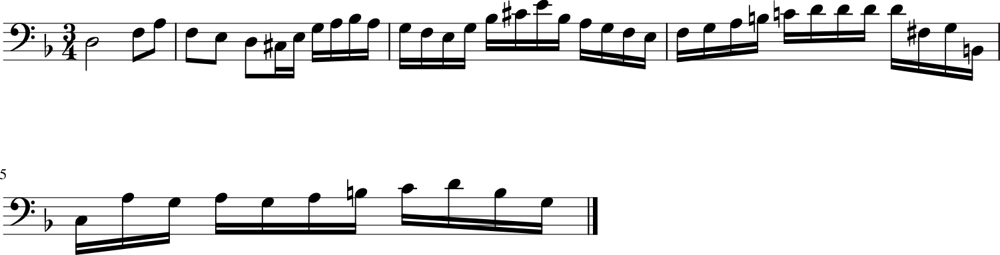

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5452 - loss: 1.1733 - note_outputs_loss: 0.6281
Epoch 731/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4684 - loss: 1.0872 - note_outputs_loss: 0.6187
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25

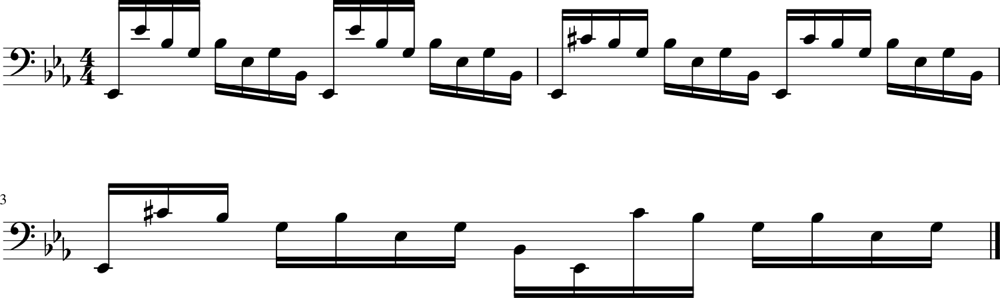

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4689 - loss: 1.0880 - note_outputs_loss: 0.6191
Epoch 732/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4695 - loss: 1.1067 - note_outputs_loss: 0.6372
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'G3', 'A3', 'D3', 'A3', 'D3', 'C3', 'B2'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


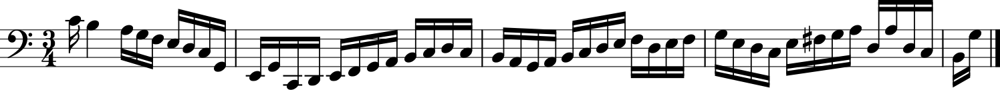

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4700 - loss: 1.1073 - note_outputs_loss: 0.6373
Epoch 733/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.6021 - loss: 1.2287 - note_outputs_loss: 0.6267
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


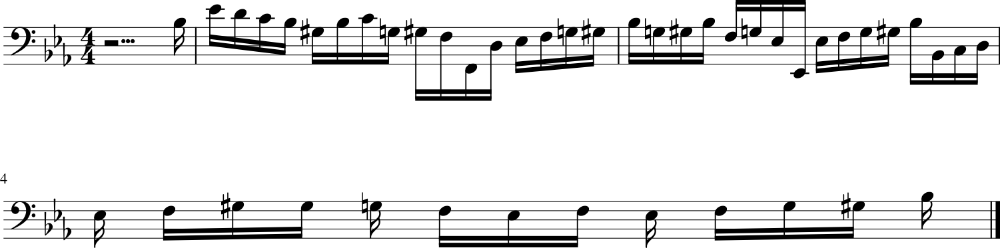

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.6013 - loss: 1.2283 - note_outputs_loss: 0.6269
Epoch 734/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5228 - loss: 1.1599 - note_outputs_loss: 0.6371
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'B-2', 'G#2', 'G2', 'B-2', 'C3', 'D3', 'E-3', 'C#4', 'G#2', 'C4', 'F3', 'E-3', 'F2', 'G#2', 'B-2', 'C3', 'D3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


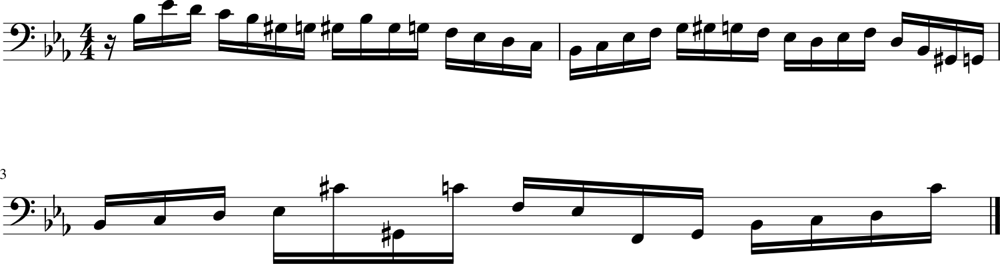

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5228 - loss: 1.1601 - note_outputs_loss: 0.6373
Epoch 735/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5461 - loss: 1.1819 - note_outputs_loss: 0.6358
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

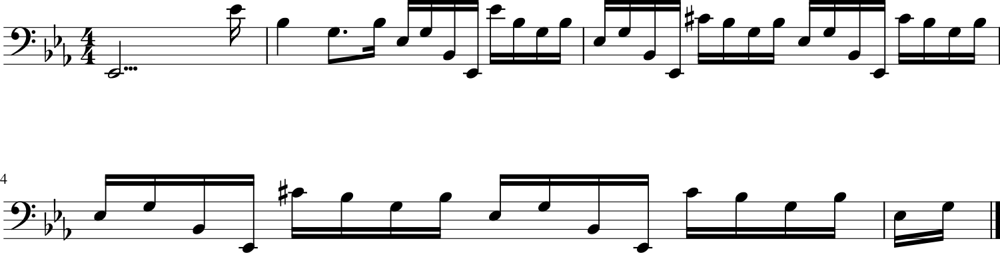

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5459 - loss: 1.1819 - note_outputs_loss: 0.6359
Epoch 736/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5033 - loss: 1.1200 - note_outputs_loss: 0.6166
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


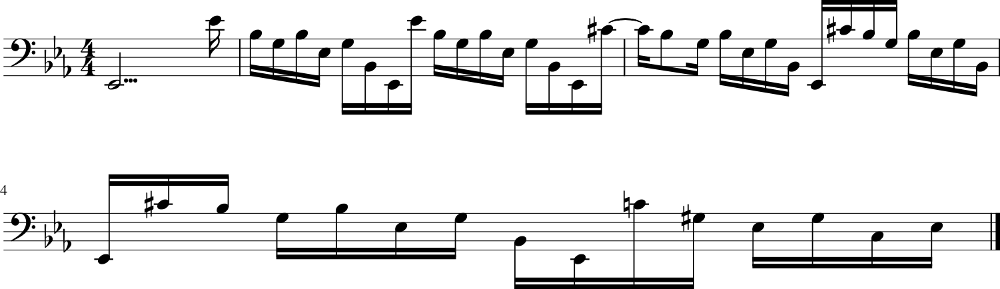

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5035 - loss: 1.1205 - note_outputs_loss: 0.6170
Epoch 737/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4807 - loss: 1.1220 - note_outputs_loss: 0.6413
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'G3', 'E3', 'C3', 'B2', 'C3', 'F#3', 'G2', 'C3', 'B2', 'D3', 'G3', 'E3', 'F3', 'B2', 'C3', 'G2', 'E2', 'C2', 'C4', 'D4', 'C4', 'B3', 'C4', 'D4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.75', '0.25', '1.0', '1.0', '1.0', '1.0', '0.5', '0.25', '0.25', '1.0', '1.0', '1.0', '1.0', '0.25', '0.25', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5']]


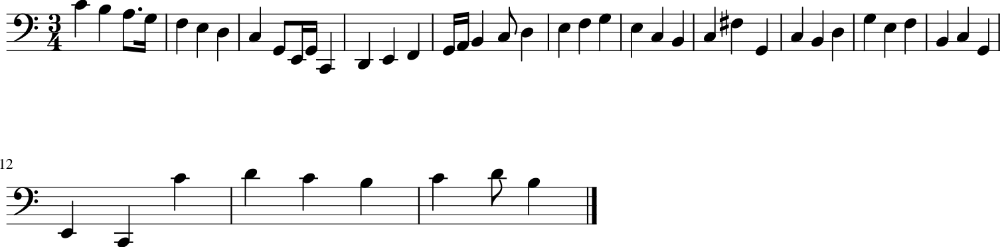

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4811 - loss: 1.1225 - note_outputs_loss: 0.6414
Epoch 738/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.4626 - loss: 1.0977 - note_outputs_loss: 0.6351
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'F3', 'D3', 'C3', 'E3', 'D3', 'B2', 'C3', 'A2', 'C3', 'G2', 'F#2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


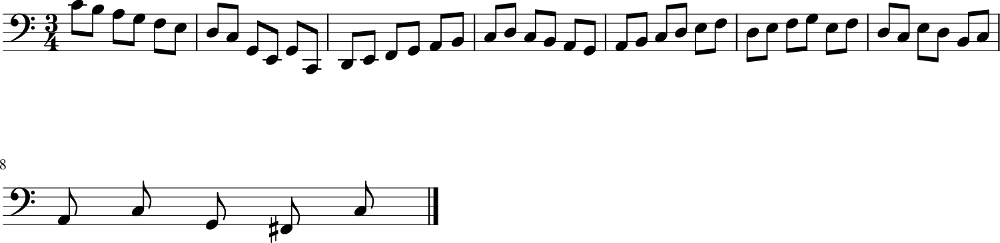

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 63ms/step - duration_outputs_loss: 0.4632 - loss: 1.0985 - note_outputs_loss: 0.6353
Epoch 739/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5293 - loss: 1.1461 - note_outputs_loss: 0.6168
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


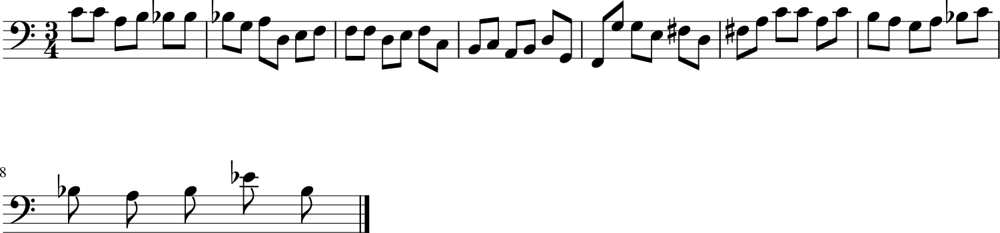

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5292 - loss: 1.1464 - note_outputs_loss: 0.6172
Epoch 740/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5410 - loss: 1.2028 - note_outputs_loss: 0.6618
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

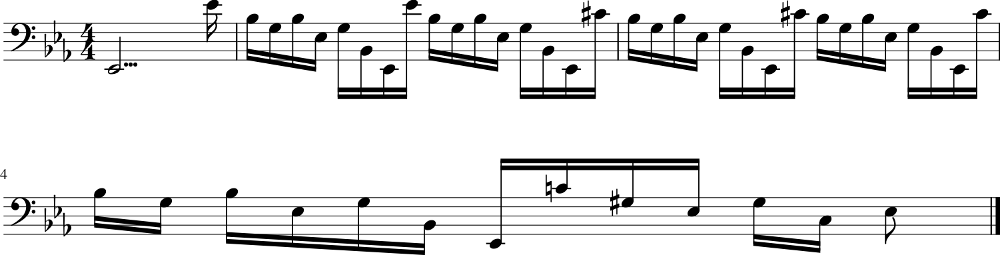

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5408 - loss: 1.2027 - note_outputs_loss: 0.6618
Epoch 741/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5156 - loss: 1.1508 - note_outputs_loss: 0.6352
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


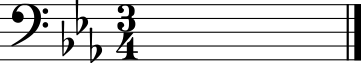

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5157 - loss: 1.1510 - note_outputs_loss: 0.6354
Epoch 742/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5262 - loss: 1.1575 - note_outputs_loss: 0.6314
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'A3', 'D3', 'F#3', 'D3', 'C3', 'D3', 'A3', 'D3', 'C3', 'B2', 'G2', 'D3', 'E3', 'F3', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


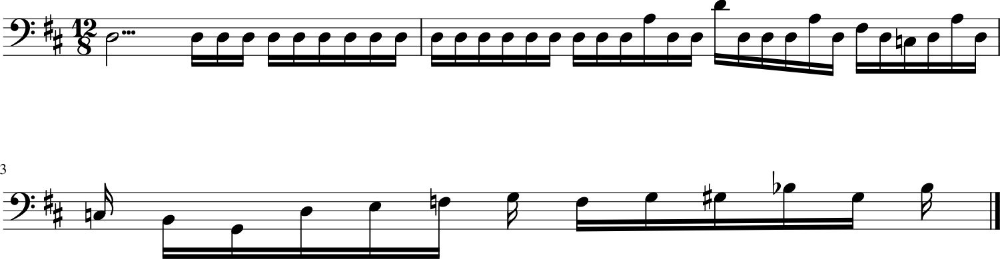

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5261 - loss: 1.1578 - note_outputs_loss: 0.6317
Epoch 743/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5158 - loss: 1.1508 - note_outputs_loss: 0.6351
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'G2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G2', 'F2', 'G#3', 'D3', 'B2', 'D3', 'G#2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


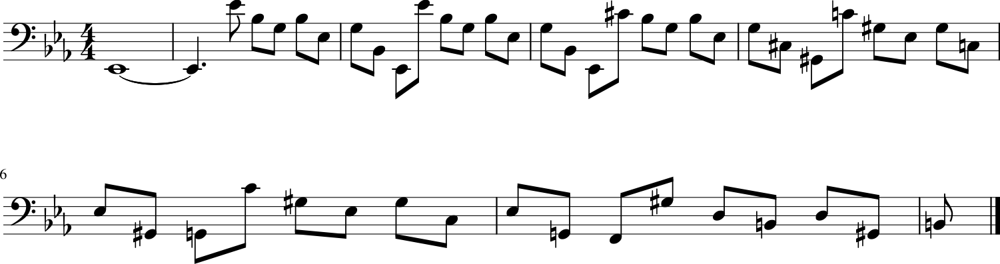

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5158 - loss: 1.1512 - note_outputs_loss: 0.6354
Epoch 744/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5262 - loss: 1.1602 - note_outputs_loss: 0.6339
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'G#3', 'G3', 'F3', 'E-3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


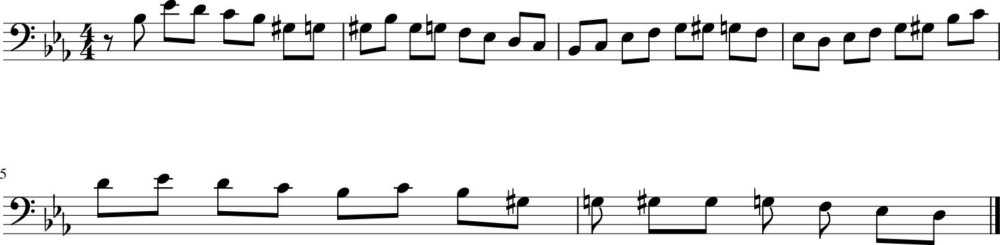

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5262 - loss: 1.1603 - note_outputs_loss: 0.6342
Epoch 745/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5014 - loss: 1.1346 - note_outputs_loss: 0.6332
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'B-3', 'B-3', 'D3', 'E3', 'F3', 'E3', 'F3', 'D3', 'B2', 'G#3', 'G3', 'F3', 'E-3', 'G3', 'C4', 'D4', 'E-4', 'G3', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'F#3', 'A3', 'C4', 'D3', 'G2', 'C3', 'E3', 'A3', 'C4', 'B3', 'E-4', 'C4', 'F#3', 'G2', 'C3', 'E-3', 'G3', 'C3', 'C3', 'B-2', 'G#2'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


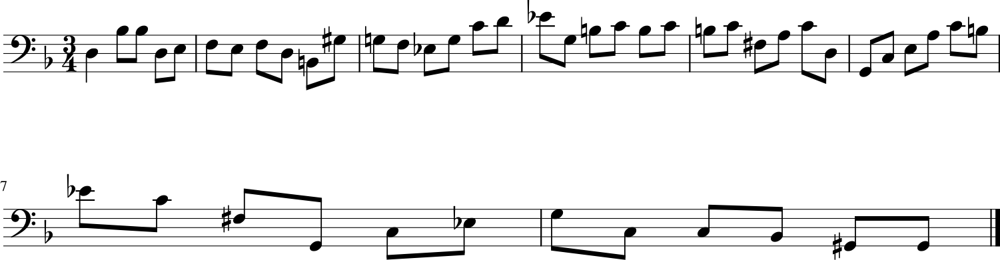

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5016 - loss: 1.1349 - note_outputs_loss: 0.6333
Epoch 746/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4888 - loss: 1.1369 - note_outputs_loss: 0.6481
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'D3', 'G#3', 'E3', 'F3', 'G3', 'A2', 'E3', 'F3', 'E3', 'F3', 'E3', 'F3', 'G3', 'F3', 'A3', 'B-3', 'D3', 'B3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'F3', 'D3', 'B-3', 'A3', 'B-3', 'C4', 'D4', 'A3', 'G#3', 'A3', 'B3', 'E3', 'F3', 'D3', 'C3', 'B2', 'C3', 'E3', 'F#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


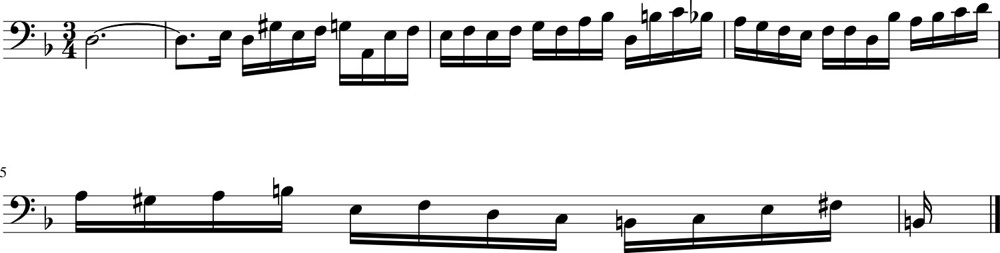

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4891 - loss: 1.1373 - note_outputs_loss: 0.6482
Epoch 747/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5434 - loss: 1.1738 - note_outputs_loss: 0.6303
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


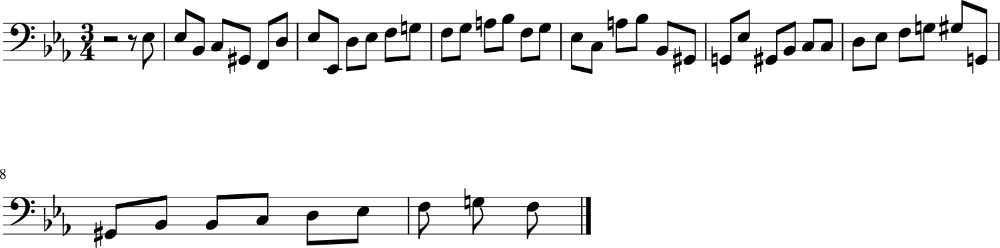

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5432 - loss: 1.1737 - note_outputs_loss: 0.6305
Epoch 748/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5140 - loss: 1.1359 - note_outputs_loss: 0.6219
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


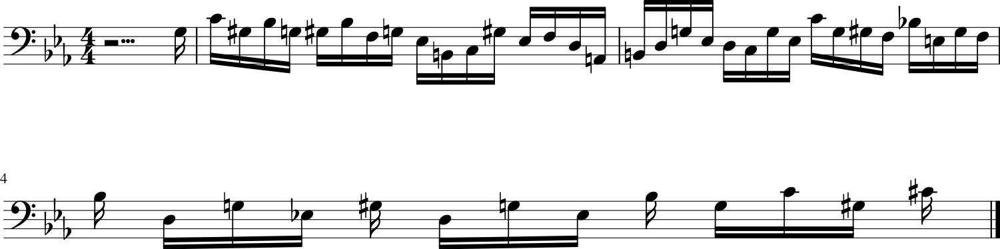

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5141 - loss: 1.1362 - note_outputs_loss: 0.6221
Epoch 749/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5213 - loss: 1.1599 - note_outputs_loss: 0.6386
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'E4', 'A3', 'F#4', 'A3', 'E4', 'D4', 'C#4', 'D4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12']]


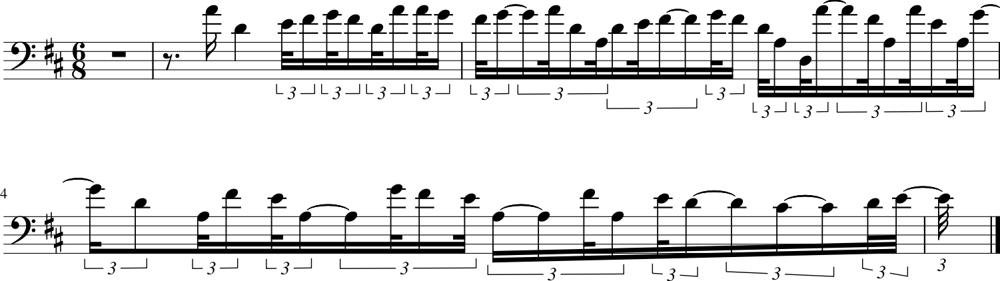

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5213 - loss: 1.1599 - note_outputs_loss: 0.6387
Epoch 750/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5533 - loss: 1.1907 - note_outputs_loss: 0.6374
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


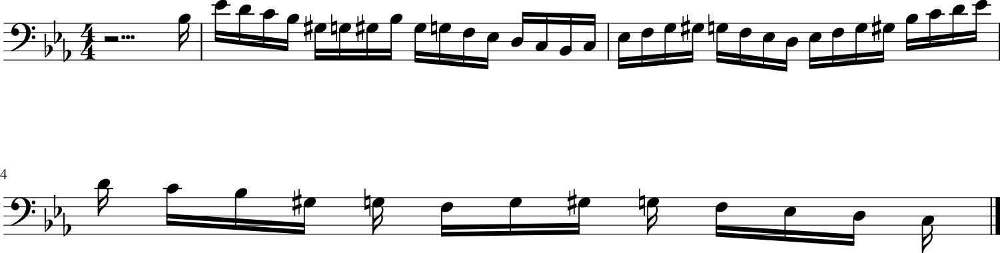

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5530 - loss: 1.1905 - note_outputs_loss: 0.6375
Epoch 751/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4938 - loss: 1.1215 - note_outputs_loss: 0.6277
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


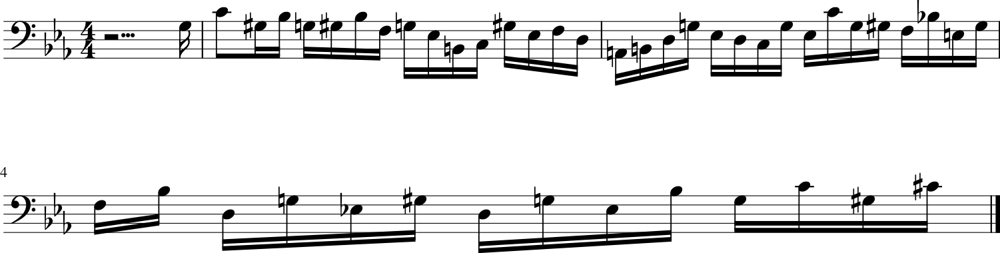

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4940 - loss: 1.1220 - note_outputs_loss: 0.6280
Epoch 752/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5486 - loss: 1.1843 - note_outputs_loss: 0.6357
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


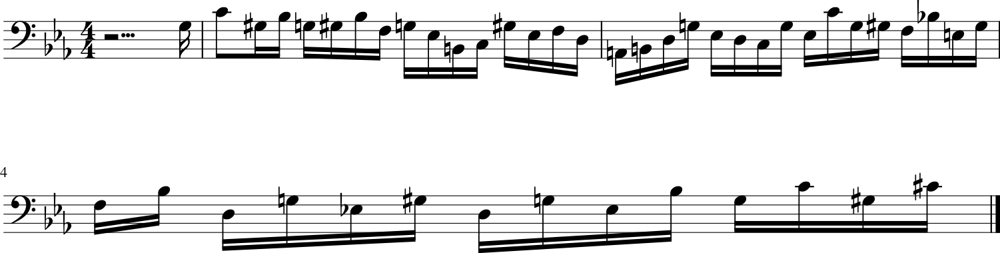

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5483 - loss: 1.1842 - note_outputs_loss: 0.6359
Epoch 753/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5178 - loss: 1.1493 - note_outputs_loss: 0.6316
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'A3', 'B-3', 'D4', 'C4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'D3', 'G3', 'F#3', 'G3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'E3', 'F3', 'G3', 'B2', 'C3', 'E3', 'A3', 'F#3'], ['0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


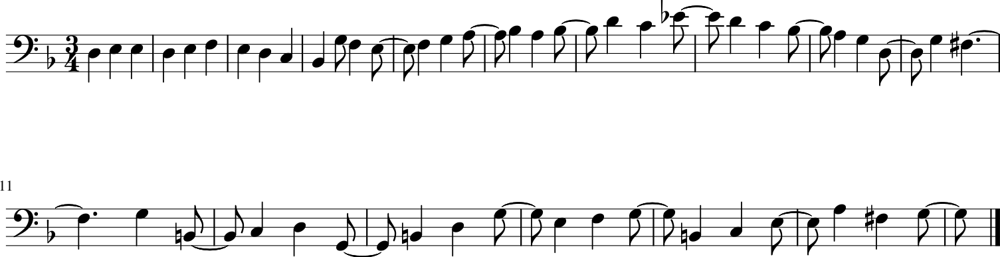

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5178 - loss: 1.1496 - note_outputs_loss: 0.6318
Epoch 754/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5250 - loss: 1.1357 - note_outputs_loss: 0.6107
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1.0', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


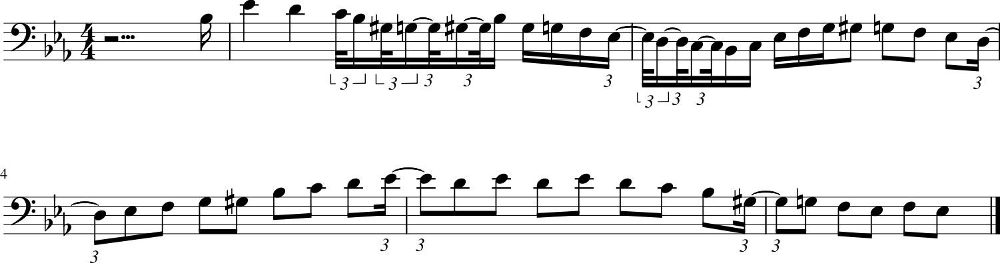

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5250 - loss: 1.1360 - note_outputs_loss: 0.6110
Epoch 755/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5364 - loss: 1.1460 - note_outputs_loss: 0.6096
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


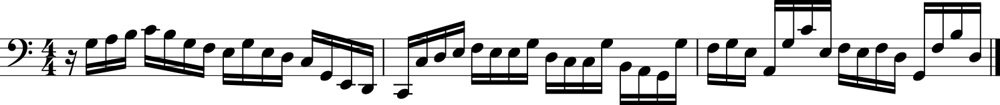

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5363 - loss: 1.1462 - note_outputs_loss: 0.6100
Epoch 756/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5123 - loss: 1.1239 - note_outputs_loss: 0.6117
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1/3', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


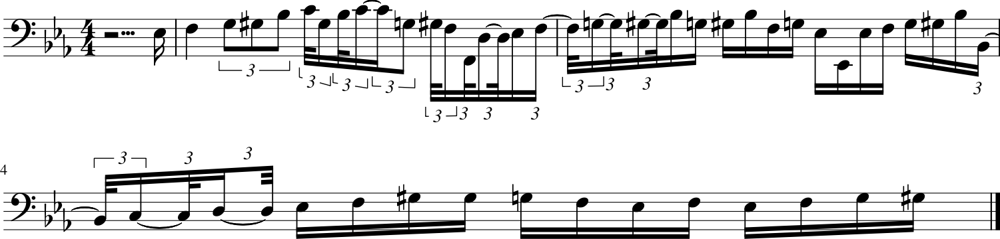

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5123 - loss: 1.1244 - note_outputs_loss: 0.6120
Epoch 757/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5622 - loss: 1.1857 - note_outputs_loss: 0.6235
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'G#3', 'D3', 'E3', 'D3', 'C#3', 'B-3', 'A3', 'B-3', 'E-4', 'B-3', 'B-3', 'A3', 'B-3', 'D4', 'C#3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


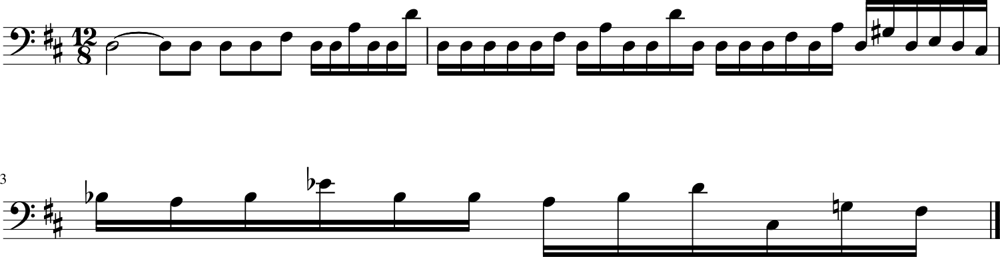

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5619 - loss: 1.1857 - note_outputs_loss: 0.6238
Epoch 758/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5557 - loss: 1.1763 - note_outputs_loss: 0.6206
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


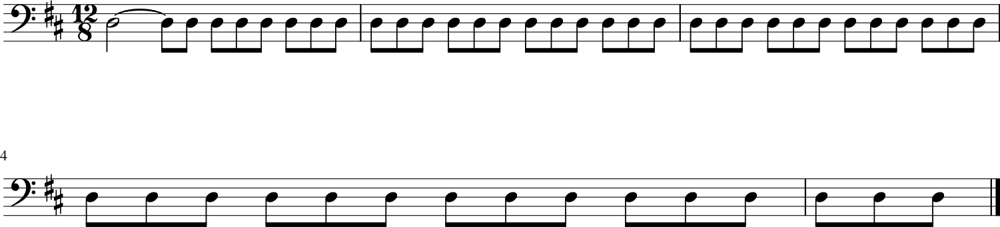

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5554 - loss: 1.1764 - note_outputs_loss: 0.6209
Epoch 759/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5093 - loss: 1.1376 - note_outputs_loss: 0.6284
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'F3', 'G3', 'G#3', 'B-3', 'F3', 'B-3', 'F3', 'B-3', 'F3', 'E-3', 'B-2', 'G3', 'E-3', 'F3', 'G#3', 'B-3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'F3', 'G2', 'G3', 'E3', 'D3', 'D3', 'E4', 'D4', 'E4', 'F4', 'E4', 'D4', 'C#4', 'E4', 'A3', 'G3', 'A3', 'D4', 'C#4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


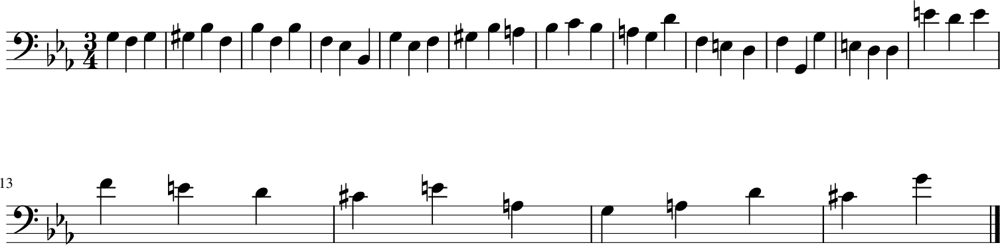

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5094 - loss: 1.1379 - note_outputs_loss: 0.6286
Epoch 760/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4968 - loss: 1.1279 - note_outputs_loss: 0.6311
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


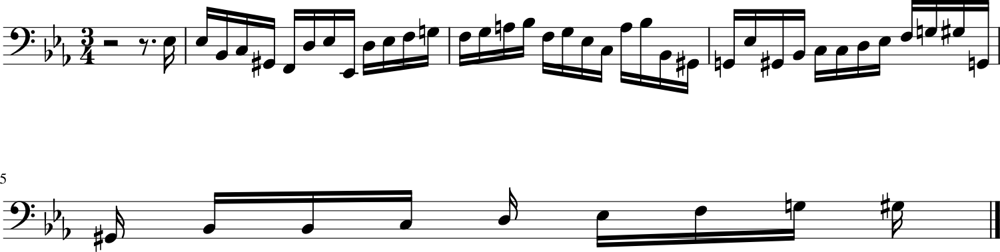

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4971 - loss: 1.1283 - note_outputs_loss: 0.6312
Epoch 761/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5052 - loss: 1.1219 - note_outputs_loss: 0.6167
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


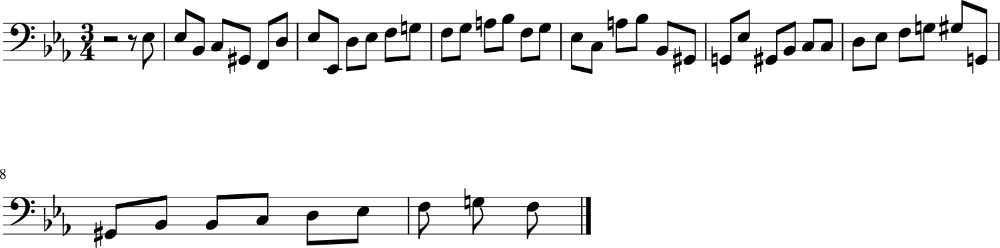

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5053 - loss: 1.1224 - note_outputs_loss: 0.6170
Epoch 762/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5275 - loss: 1.1531 - note_outputs_loss: 0.6257
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


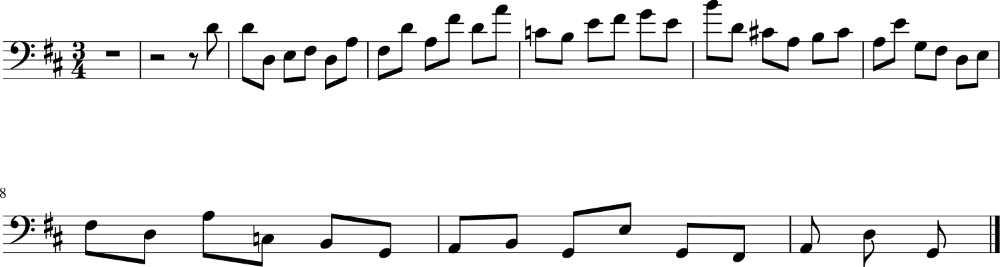

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5274 - loss: 1.1534 - note_outputs_loss: 0.6260
Epoch 763/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4964 - loss: 1.1110 - note_outputs_loss: 0.6147
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'C4', 'G3', 'A3', 'B-3', 'G3', 'D3', 'B-3', 'D3', 'B-3', 'D3', 'G3', 'B-2', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


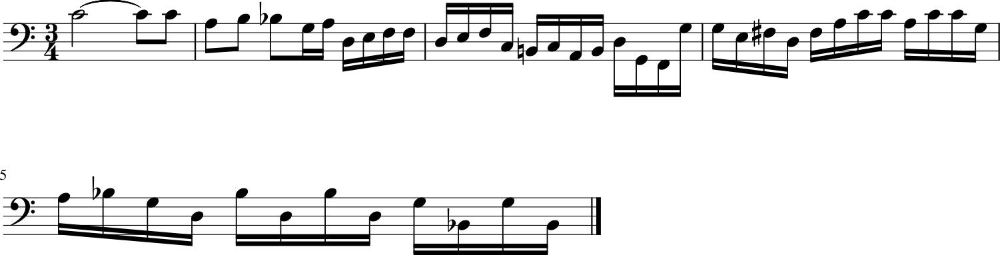

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4966 - loss: 1.1116 - note_outputs_loss: 0.6150
Epoch 764/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5325 - loss: 1.1501 - note_outputs_loss: 0.6176
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'G#3', 'F3', 'F2', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'E-4', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


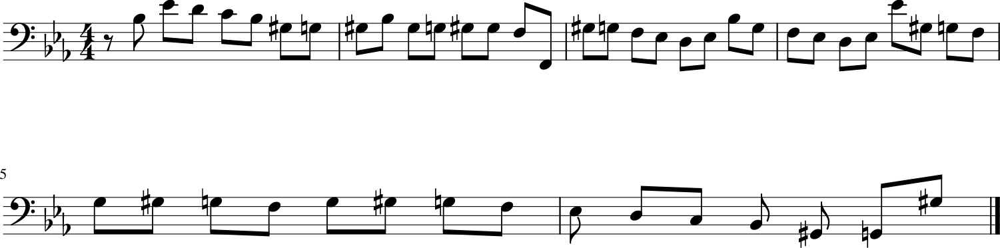

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5324 - loss: 1.1503 - note_outputs_loss: 0.6179
Epoch 765/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5314 - loss: 1.1678 - note_outputs_loss: 0.6364
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'G3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'D3', 'A2'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


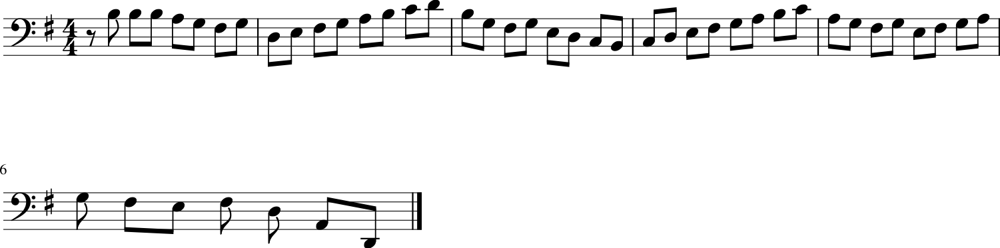

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5313 - loss: 1.1680 - note_outputs_loss: 0.6366
Epoch 766/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5353 - loss: 1.1644 - note_outputs_loss: 0.6290
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


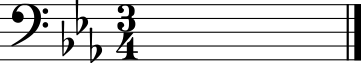

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 59ms/step - duration_outputs_loss: 0.5352 - loss: 1.1644 - note_outputs_loss: 0.6292
Epoch 767/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4880 - loss: 1.1144 - note_outputs_loss: 0.6264
Generation prompt: [['START', 'G:major', '4/4TS', 'G2', 'D3', 'B3', 'A3', 'B3', 'D3', 'B3', 'D3', 'G2', 'D3', 'B3', 'A3', 'B3', 'D3', 'B3', 'D3', 'G2', 'E3', 'C4', 'B3', 'C4', 'E3', 'C4', 'E3', 'G2', 'E3', 'C4', 'B3', 'C4', 'E3', 'C4', 'E3', 'G2', 'F#3', 'C4', 'B3', 'C4', 'F#3', 'C4', 'F#3', 'G2', 'D3', 'B3', 'A3', 'B3', 'G3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


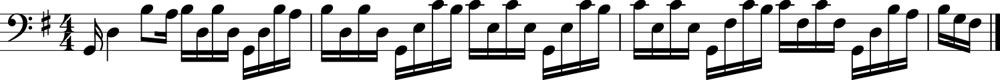

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4883 - loss: 1.1149 - note_outputs_loss: 0.6266
Epoch 768/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5202 - loss: 1.1559 - note_outputs_loss: 0.6357
Generation prompt: [['START', 'C:major'], ['0.0', '0.0']]


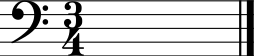

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5202 - loss: 1.1561 - note_outputs_loss: 0.6359
Epoch 769/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4803 - loss: 1.1155 - note_outputs_loss: 0.6352
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


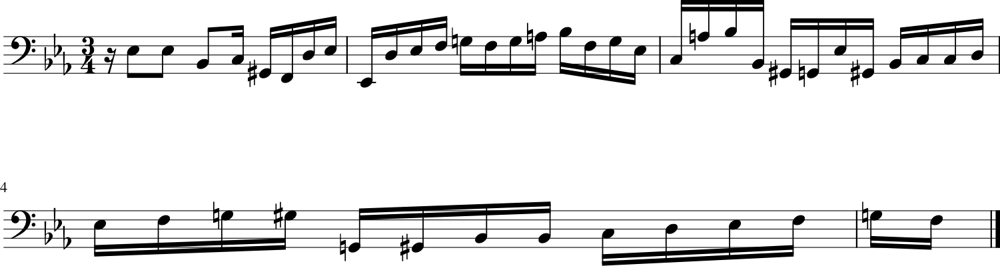

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4807 - loss: 1.1161 - note_outputs_loss: 0.6354
Epoch 770/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5854 - loss: 1.2014 - note_outputs_loss: 0.6159
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


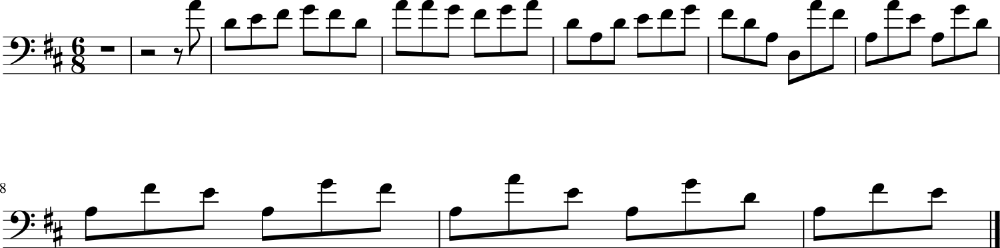

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5849 - loss: 1.2011 - note_outputs_loss: 0.6163
Epoch 771/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5365 - loss: 1.1807 - note_outputs_loss: 0.6441
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


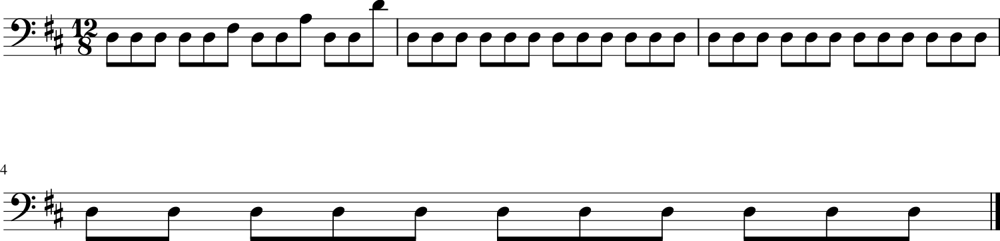

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.5364 - loss: 1.1805 - note_outputs_loss: 0.6442
Epoch 772/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5200 - loss: 1.1487 - note_outputs_loss: 0.6287
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


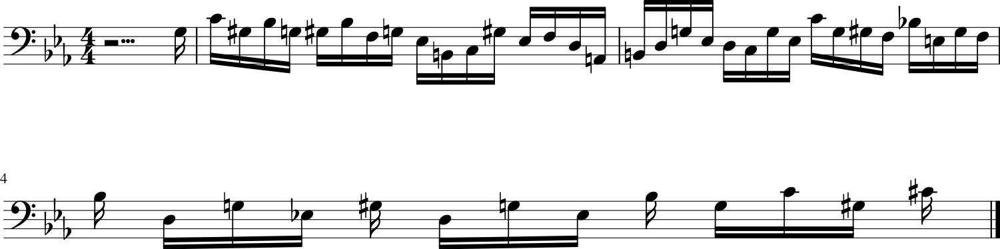

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5200 - loss: 1.1489 - note_outputs_loss: 0.6289
Epoch 773/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5265 - loss: 1.1490 - note_outputs_loss: 0.6225
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'E3', 'C3', 'C2', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'D3', 'D2', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'B3', 'A3', 'A3', 'E4', 'D4', 'E4', 'F4', 'G4', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


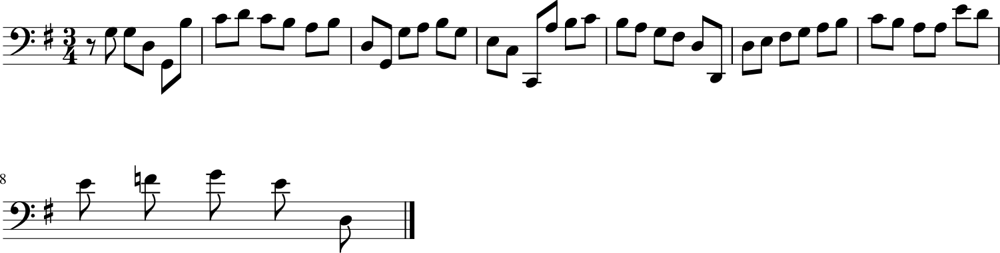

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5265 - loss: 1.1493 - note_outputs_loss: 0.6228
Epoch 774/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4893 - loss: 1.1188 - note_outputs_loss: 0.6294
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


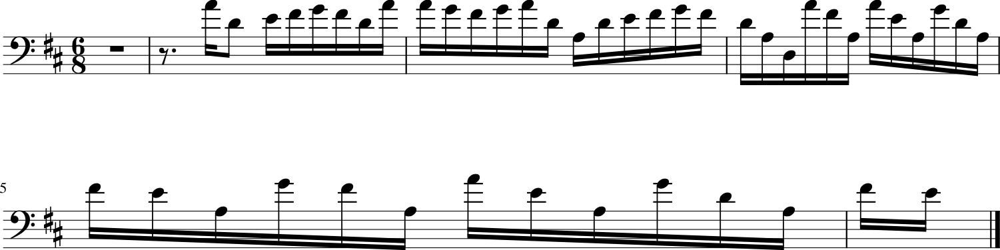

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4897 - loss: 1.1193 - note_outputs_loss: 0.6297
Epoch 775/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5289 - loss: 1.1680 - note_outputs_loss: 0.6390
Generation prompt: [['START', 'E-:major', '12/8TS', 'rest', 'E-3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-3', 'D3', 'E-3', 'G3', 'F3', 'G3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


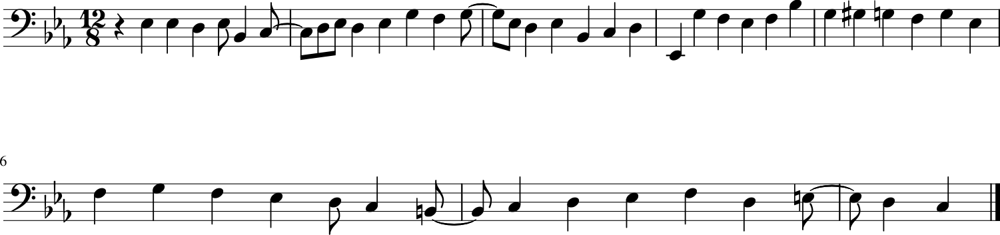

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5289 - loss: 1.1681 - note_outputs_loss: 0.6392
Epoch 776/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5232 - loss: 1.1353 - note_outputs_loss: 0.6121
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


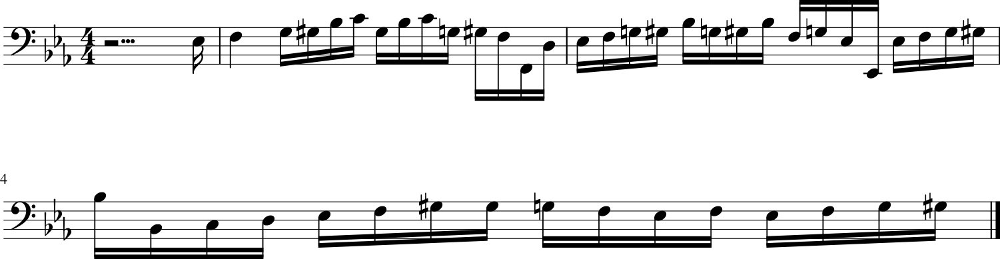

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5232 - loss: 1.1356 - note_outputs_loss: 0.6124
Epoch 777/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5648 - loss: 1.2109 - note_outputs_loss: 0.6460
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


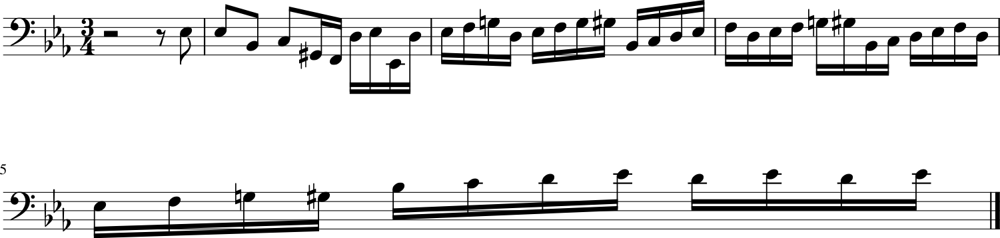

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5644 - loss: 1.2106 - note_outputs_loss: 0.6461
Epoch 778/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5367 - loss: 1.1719 - note_outputs_loss: 0.6352
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']

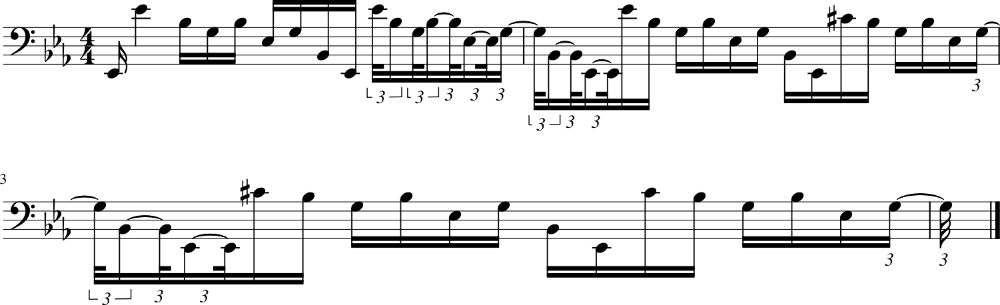

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5366 - loss: 1.1720 - note_outputs_loss: 0.6354
Epoch 779/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4922 - loss: 1.1454 - note_outputs_loss: 0.6532
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'E-3', 'E-3', 'C3', 'D3', 'F3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'B-3', 'G#3', 'G3', 'B-3', 'G#3', 'C#4', 'G3', 'C4', 'G#3', 'E-4', 'A3', 'D4', 'B-3', 'E-4', 'D4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


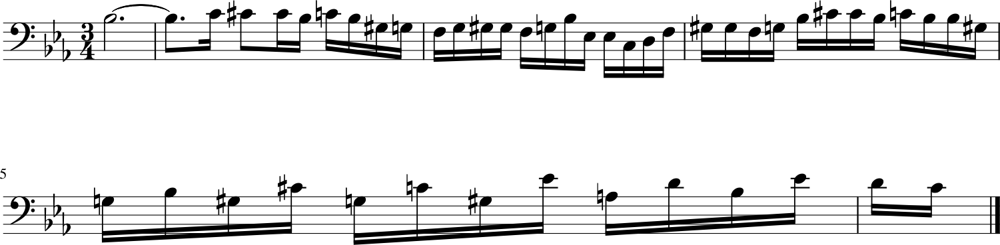

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4924 - loss: 1.1456 - note_outputs_loss: 0.6532
Epoch 780/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4889 - loss: 1.1119 - note_outputs_loss: 0.6231
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


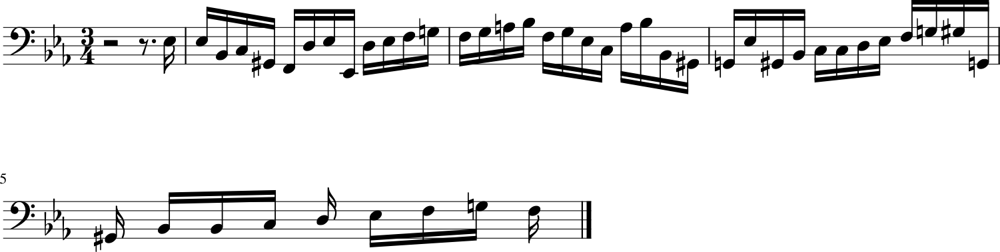

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4892 - loss: 1.1125 - note_outputs_loss: 0.6233
Epoch 781/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5382 - loss: 1.2053 - note_outputs_loss: 0.6672
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'G3', 'B-3', 'G3', 'B-3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3', 'C#4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


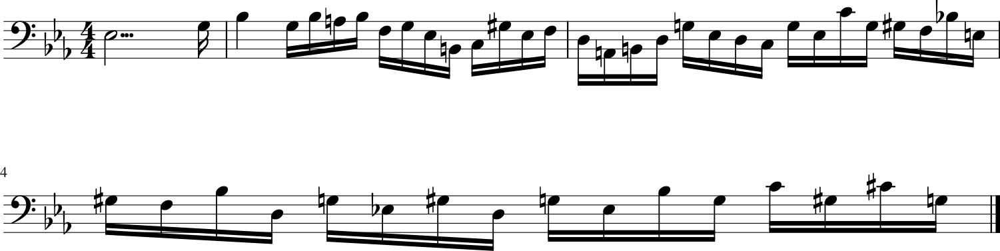

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5380 - loss: 1.2051 - note_outputs_loss: 0.6671
Epoch 782/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5141 - loss: 1.1581 - note_outputs_loss: 0.6440
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


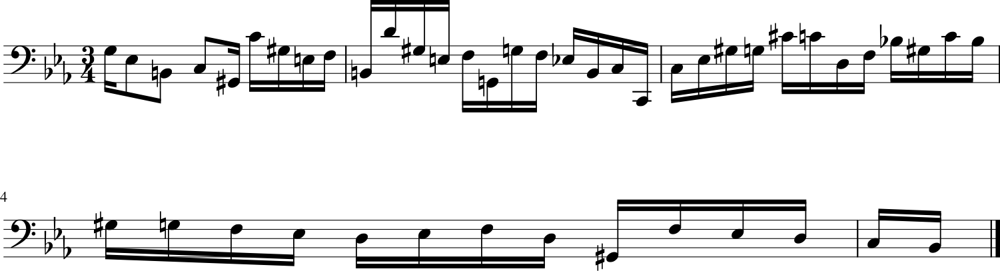

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5142 - loss: 1.1583 - note_outputs_loss: 0.6441
Epoch 783/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4688 - loss: 1.1029 - note_outputs_loss: 0.6340
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


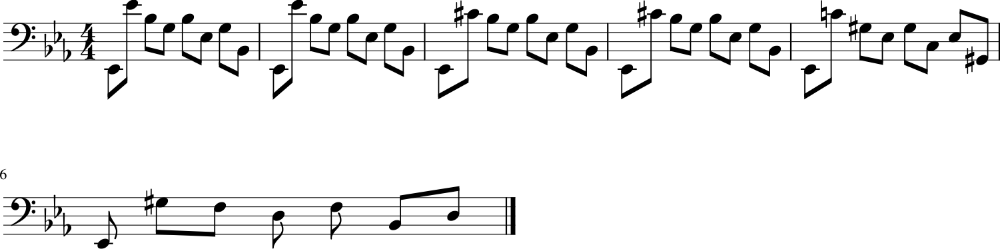

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.4693 - loss: 1.1034 - note_outputs_loss: 0.6341
Epoch 784/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5259 - loss: 1.1460 - note_outputs_loss: 0.6201
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


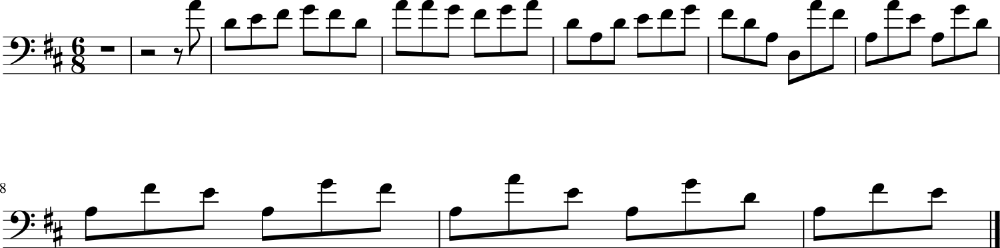

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5259 - loss: 1.1462 - note_outputs_loss: 0.6203
Epoch 785/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5171 - loss: 1.1559 - note_outputs_loss: 0.6388
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'D3', 'E3', 'F3', 'D3', 'B2', 'D3', 'A2', 'B2', 'G2', 'C2', 'F3', 'E3', 'D3', 'E3', 'G3', 'C4', 'D4', 'E4', 'B3', 'C4', 'A3', 'F3', 'G3', 'A3', 'E3', 'F3', 'D3', 'B2', 'A3', 'G3', 'F3', 'E3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


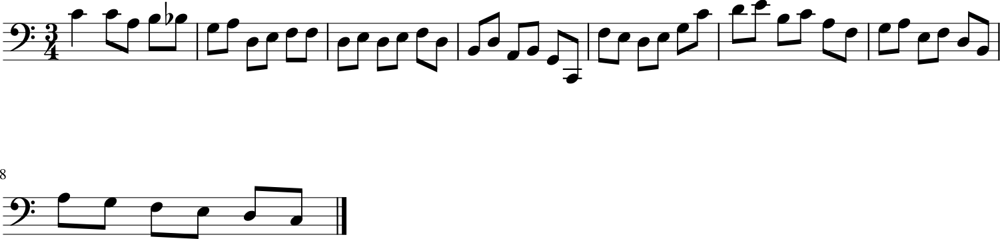

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5171 - loss: 1.1560 - note_outputs_loss: 0.6389
Epoch 786/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5193 - loss: 1.1491 - note_outputs_loss: 0.6299
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'D4', 'C4', 'B3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'A3', 'B-3', 'F#3', 'G3', 'A2', 'F#3', 'C4', 'D4', 'B-3', 'C3', 'A3', 'A3', 'G3', 'A3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


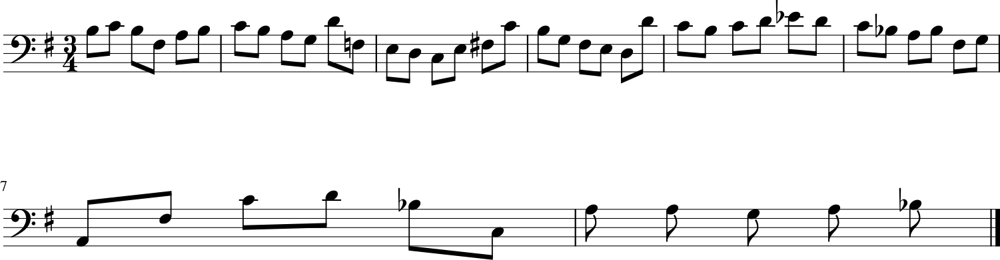

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5193 - loss: 1.1493 - note_outputs_loss: 0.6301
Epoch 787/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5348 - loss: 1.1855 - note_outputs_loss: 0.6507
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


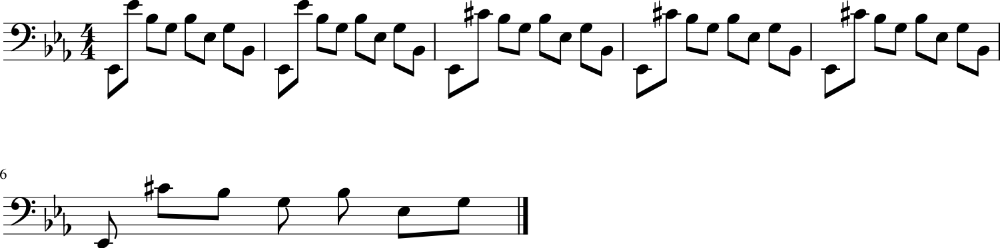

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.5346 - loss: 1.1853 - note_outputs_loss: 0.6507
Epoch 788/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4999 - loss: 1.1334 - note_outputs_loss: 0.6335
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


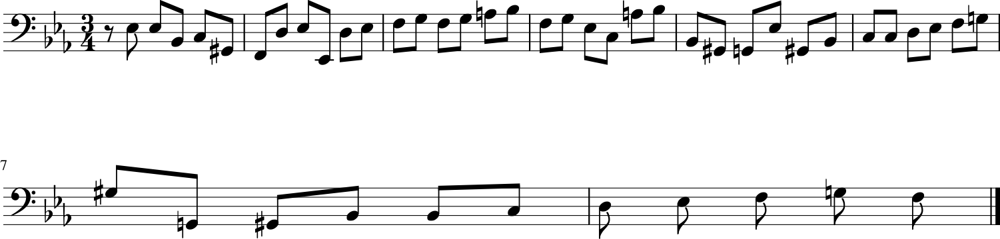

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5001 - loss: 1.1337 - note_outputs_loss: 0.6337
Epoch 789/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5714 - loss: 1.2102 - note_outputs_loss: 0.6387
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


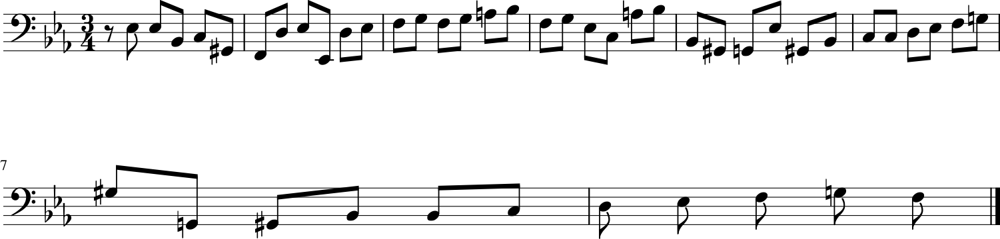

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5710 - loss: 1.2098 - note_outputs_loss: 0.6388
Epoch 790/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5231 - loss: 1.1463 - note_outputs_loss: 0.6231
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'E3', 'C3', 'B-2', 'A2', 'B-2', 'A3', 'G3', 'F3', 'E3', 'D3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


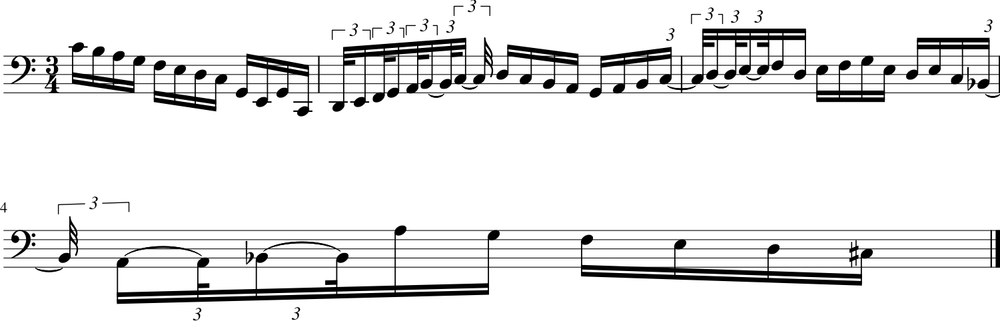

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5231 - loss: 1.1465 - note_outputs_loss: 0.6234
Epoch 791/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4765 - loss: 1.1291 - note_outputs_loss: 0.6526
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'G3', 'A3', 'F#3', 'D4', 'B3', 'D4', 'E3', 'D4', 'C4', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


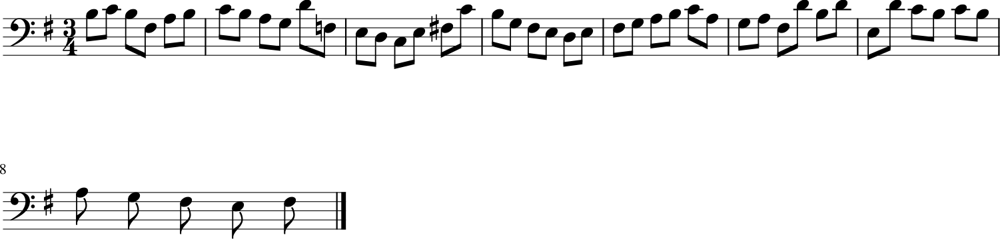

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4769 - loss: 1.1296 - note_outputs_loss: 0.6526
Epoch 792/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4895 - loss: 1.1074 - note_outputs_loss: 0.6178
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'G3', 'A2', 'B-2', 'C3', 'B2', 'F2', 'A2', 'C3', 'A2', 'F2', 'A2', 'C3', 'F3', 'G#3', 'D3', 'E2', 'F#2', 'A2', 'C3', 'E2', 'rest'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


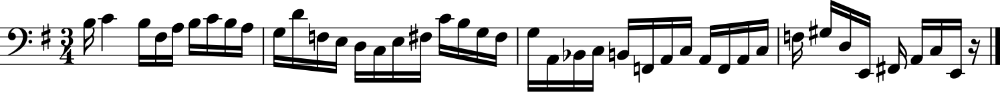

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4898 - loss: 1.1080 - note_outputs_loss: 0.6181
Epoch 793/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4973 - loss: 1.1433 - note_outputs_loss: 0.6459
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


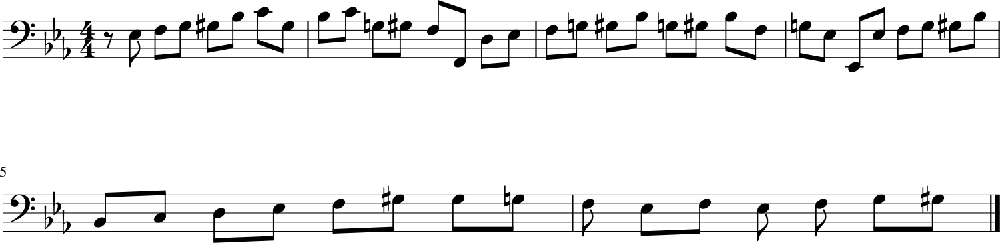

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4976 - loss: 1.1436 - note_outputs_loss: 0.6460
Epoch 794/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5258 - loss: 1.1678 - note_outputs_loss: 0.6420
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


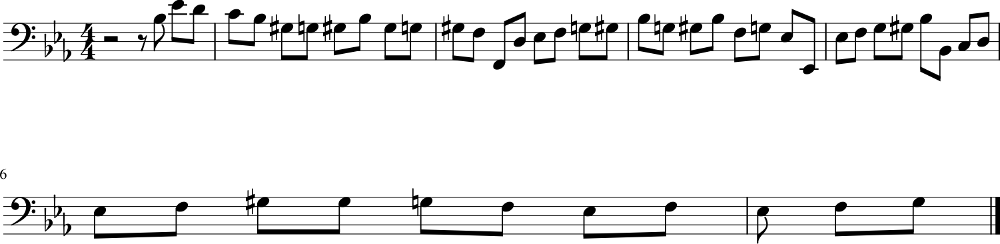

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5257 - loss: 1.1679 - note_outputs_loss: 0.6421
Epoch 795/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5515 - loss: 1.1637 - note_outputs_loss: 0.6122
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'F3', 'G#3', 'B3', 'G#3', 'B3', 'D4', 'C4', 'C4', 'B3', 'A3', 'D4', 'B3', 'A3', 'B3', 'G#3', 'A3', 'B3', 'G#3', 'E3', 'B3', 'G#3', 'E3', 'E4', 'D3', 'C3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


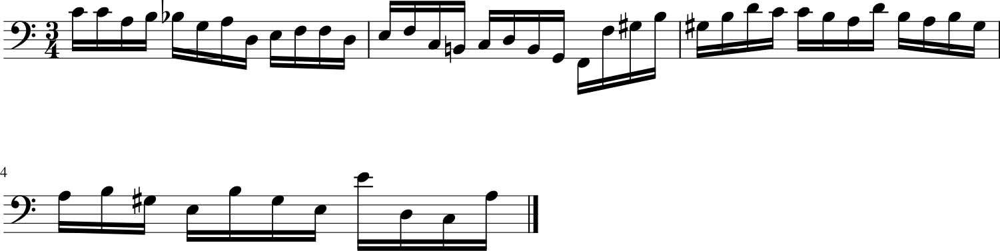

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5513 - loss: 1.1637 - note_outputs_loss: 0.6124
Epoch 796/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5163 - loss: 1.1505 - note_outputs_loss: 0.6342
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


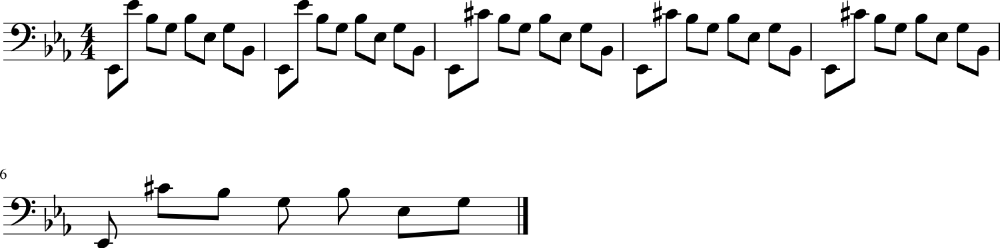

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5163 - loss: 1.1507 - note_outputs_loss: 0.6344
Epoch 797/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5481 - loss: 1.1686 - note_outputs_loss: 0.6205
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


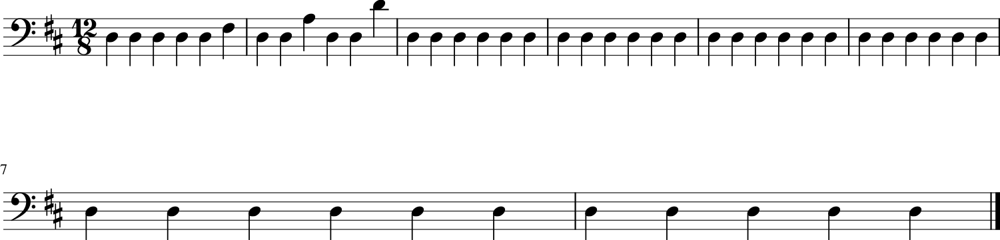

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5478 - loss: 1.1686 - note_outputs_loss: 0.6207
Epoch 798/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5277 - loss: 1.1409 - note_outputs_loss: 0.6132
Generation prompt: [['START', 'C:major', '3/4TS', 'C2', 'C4', 'E3', 'D3', 'E3', 'F3', 'F3', 'G3', 'F3', 'E3', 'D3', 'E3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'C4', 'G3', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'G#2', 'E-3', 'C3', 'D3', 'G#2', 'B-3', 'D3', 'E-3', 'G2', 'F3', 'D3', 'E-3', 'G2', 'F2', 'G2', 'E-3', 'C3', 'B2'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


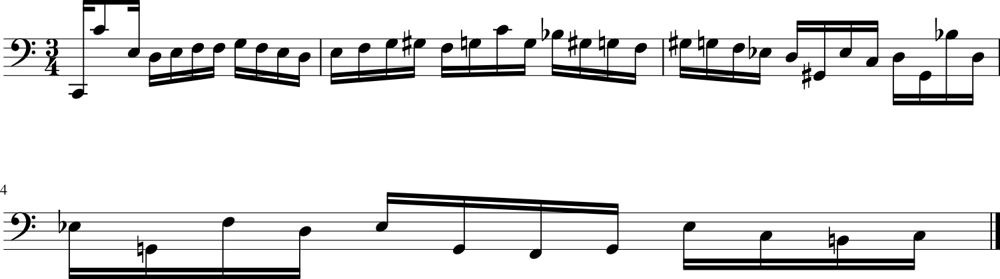

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5276 - loss: 1.1411 - note_outputs_loss: 0.6135
Epoch 799/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5711 - loss: 1.1996 - note_outputs_loss: 0.6285
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3']]


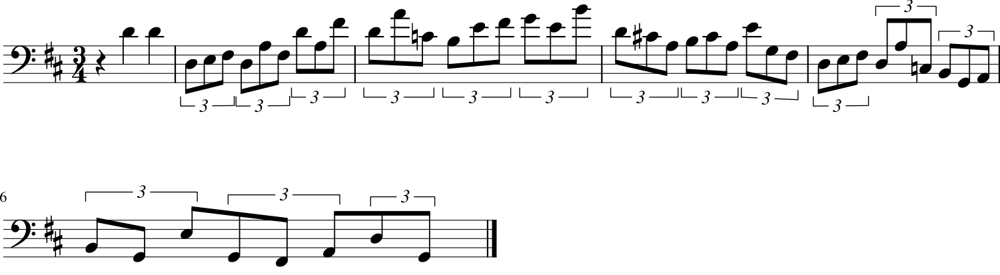

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5707 - loss: 1.1994 - note_outputs_loss: 0.6287
Epoch 800/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4626 - loss: 1.0819 - note_outputs_loss: 0.6193
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


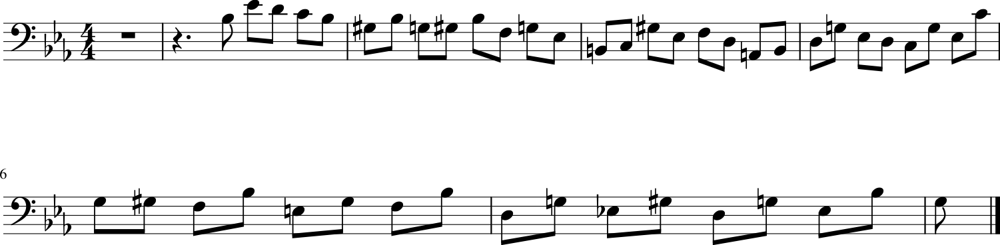

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4631 - loss: 1.0827 - note_outputs_loss: 0.6196
Epoch 801/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5016 - loss: 1.1292 - note_outputs_loss: 0.6276
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'E2', 'G3', 'A3', 'G3', 'F#3', 'G3', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'A3', 'B3', 'A3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1.0', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3', '1/3']]


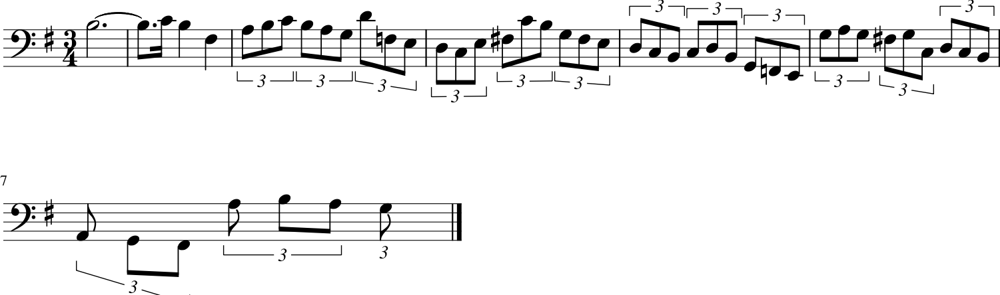

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5018 - loss: 1.1296 - note_outputs_loss: 0.6279
Epoch 802/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5050 - loss: 1.1181 - note_outputs_loss: 0.6131
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'G3', 'A2', 'B-2', 'G2', 'D3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'D3', 'D3', 'C#3', 'B2', 'C#3', 'D3', 'E3', 'F#3', 'E3', 'F#3', 'G3', 'A3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


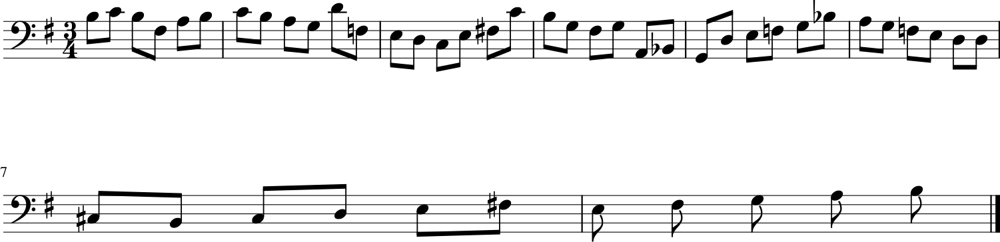

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5052 - loss: 1.1186 - note_outputs_loss: 0.6134
Epoch 803/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5212 - loss: 1.1500 - note_outputs_loss: 0.6288
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]

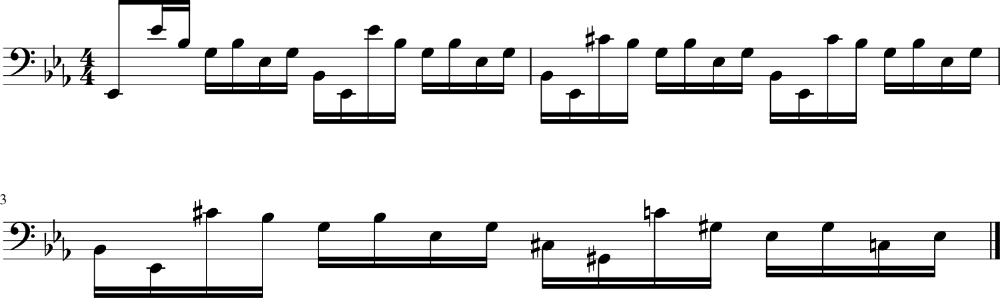

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5212 - loss: 1.1503 - note_outputs_loss: 0.6291
Epoch 804/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4937 - loss: 1.1357 - note_outputs_loss: 0.6420
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'C4', 'B-3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'C3', 'G#2'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


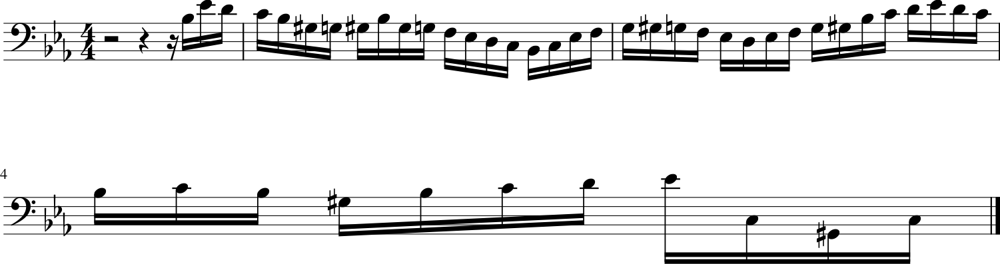

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4939 - loss: 1.1360 - note_outputs_loss: 0.6421
Epoch 805/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5521 - loss: 1.1777 - note_outputs_loss: 0.6256
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'D3', 'F#2', 'E2', 'G2', 'A2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


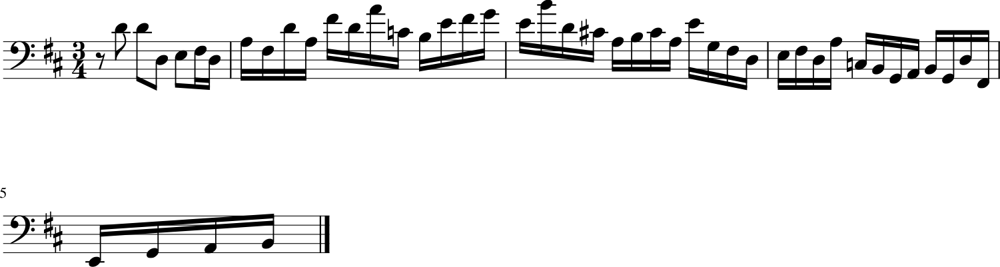

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5518 - loss: 1.1776 - note_outputs_loss: 0.6258
Epoch 806/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4885 - loss: 1.1272 - note_outputs_loss: 0.6387
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'G2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G2', 'F2', 'G#3', 'D3', 'B2', 'D3', 'G#2'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


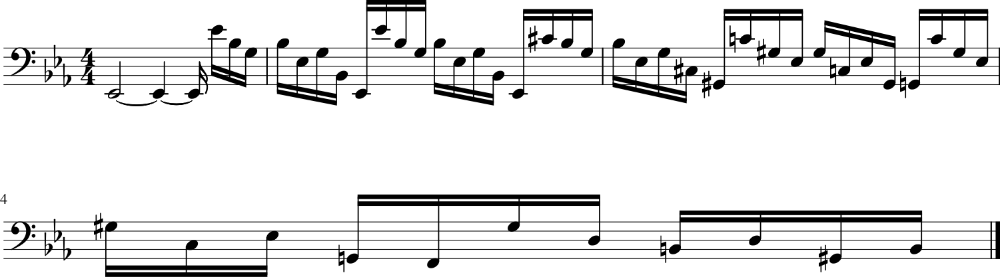

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4888 - loss: 1.1276 - note_outputs_loss: 0.6388
Epoch 807/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5149 - loss: 1.1283 - note_outputs_loss: 0.6134
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


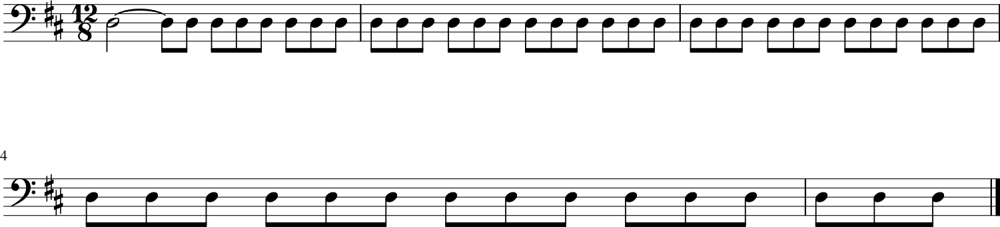

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5149 - loss: 1.1287 - note_outputs_loss: 0.6137
Epoch 808/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5472 - loss: 1.1553 - note_outputs_loss: 0.6081
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'C3', 'F3', 'G#3', 'G#3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'E-3', 'D3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


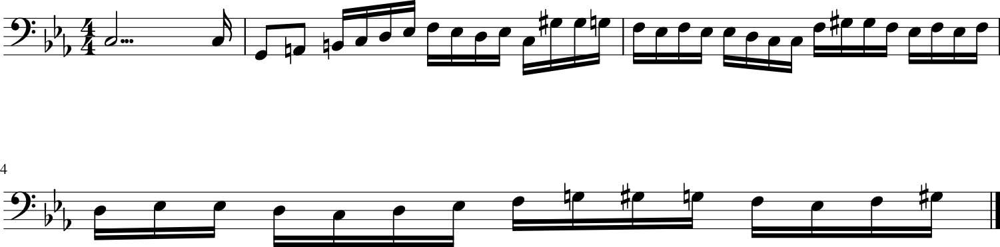

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5469 - loss: 1.1553 - note_outputs_loss: 0.6084
Epoch 809/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5235 - loss: 1.1563 - note_outputs_loss: 0.6328
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'G3', 'F3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'B-2', 'A2', 'G2', 'F2', 'E2', 'F2', 'G2', 'A2', 'F2', 'D2', 'F2', 'A2', 'D3', 'E3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.75', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


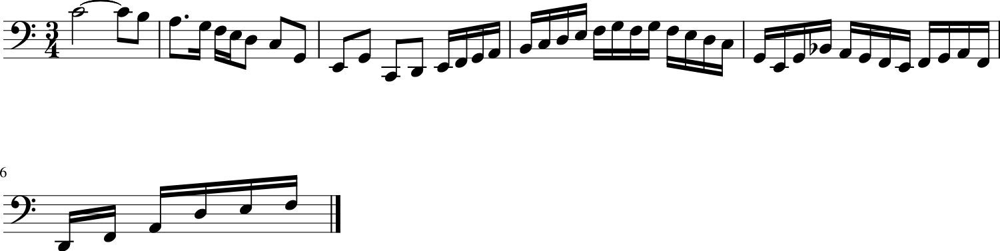

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5235 - loss: 1.1564 - note_outputs_loss: 0.6329
Epoch 810/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5353 - loss: 1.1800 - note_outputs_loss: 0.6446
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'E4', 'F#4', 'E4', 'F#4', 'B3', 'C#4', 'D4', 'B3', 'G#3', 'F#3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


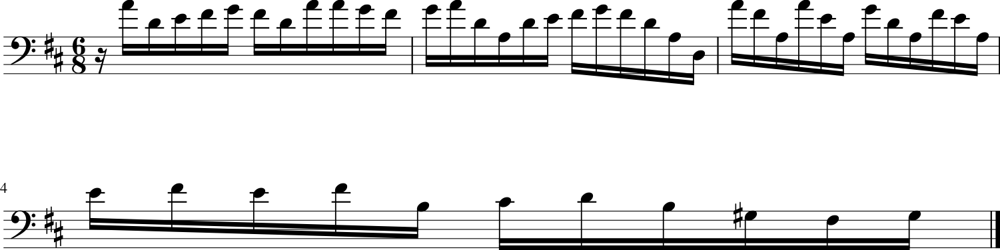

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5352 - loss: 1.1798 - note_outputs_loss: 0.6446
Epoch 811/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5422 - loss: 1.1713 - note_outputs_loss: 0.6290
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


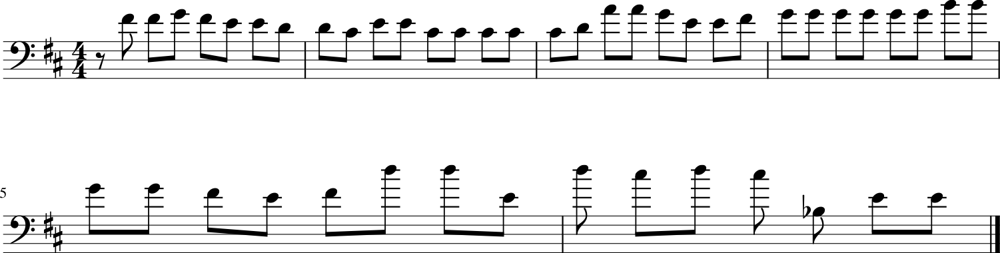

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5420 - loss: 1.1712 - note_outputs_loss: 0.6292
Epoch 812/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4824 - loss: 1.0964 - note_outputs_loss: 0.6141
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'A3', 'D3', 'F#3', 'D3', 'C3', 'B2', 'G3', 'D3', 'B2', 'G2', 'D3', 'F3', 'B3', 'G3', 'E3', 'C3', 'C4', 'A2', 'B2', 'C3', 'E3'], ['0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


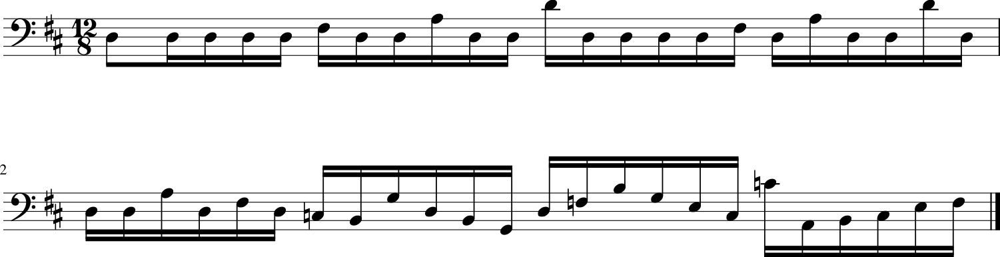

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4828 - loss: 1.0971 - note_outputs_loss: 0.6144
Epoch 813/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4918 - loss: 1.1308 - note_outputs_loss: 0.6390
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'A3', 'A2', 'G3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'C#3', 'A2', 'C3', 'A2', 'F#2', 'C3', 'A2', 'B2', 'A2', 'D2', 'D3', 'F3', 'A2', 'D2', 'A2', 'F3', 'B2', 'F3', 'G2', 'A2', 'D2', 'C2', 'E-4', 'C4', 'G3', 'C4', 'E-3', 'G3', 'C3', 'C2'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


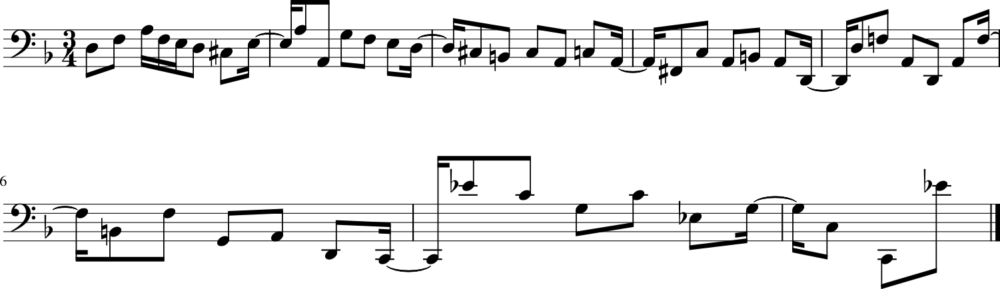

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4920 - loss: 1.1311 - note_outputs_loss: 0.6391
Epoch 814/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5367 - loss: 1.1757 - note_outputs_loss: 0.6390
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


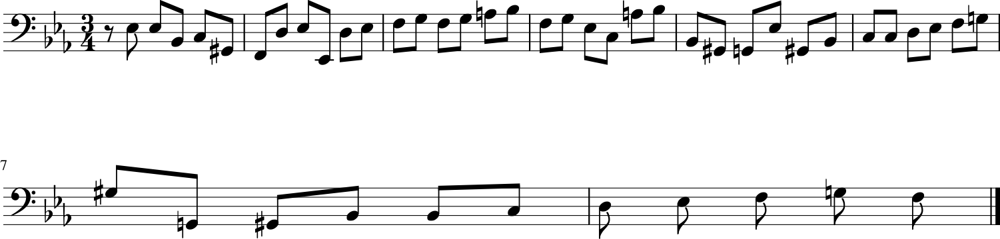

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5365 - loss: 1.1756 - note_outputs_loss: 0.6391
Epoch 815/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5027 - loss: 1.1229 - note_outputs_loss: 0.6202
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'G#3', 'B-3', 'E-4', 'C4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.25', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


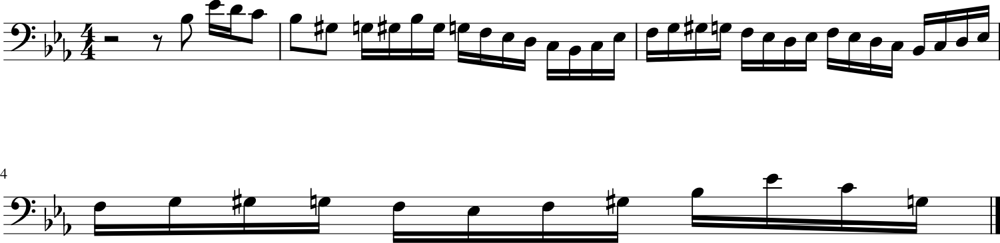

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5029 - loss: 1.1234 - note_outputs_loss: 0.6204
Epoch 816/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5409 - loss: 1.1781 - note_outputs_loss: 0.6372
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'D4', 'C4', 'B3', 'F#4', 'F#4', 'C4', 'G4', 'F#4', 'E4', 'D4', 'G4', 'B3', 'F#3', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'D4', 'B2', 'G3', 'A3', 'B3', 'C4', 'G#3', 'G3', 'E3', 'C3', 'A2', 'C3', 'E3', 'F#3', 'G3', 'A3', 'D3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


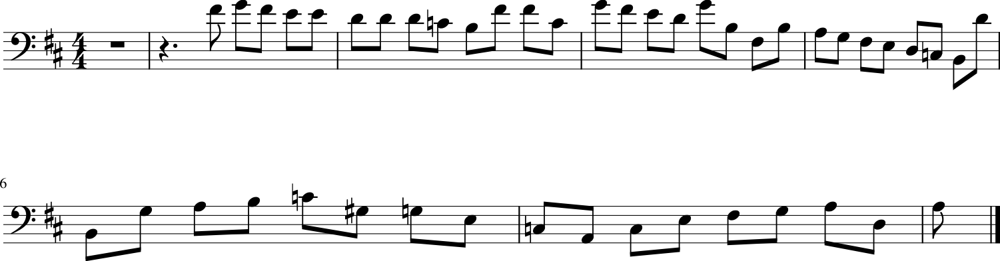

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5407 - loss: 1.1780 - note_outputs_loss: 0.6373
Epoch 817/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4809 - loss: 1.1021 - note_outputs_loss: 0.6212
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '1.0', '0.5', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


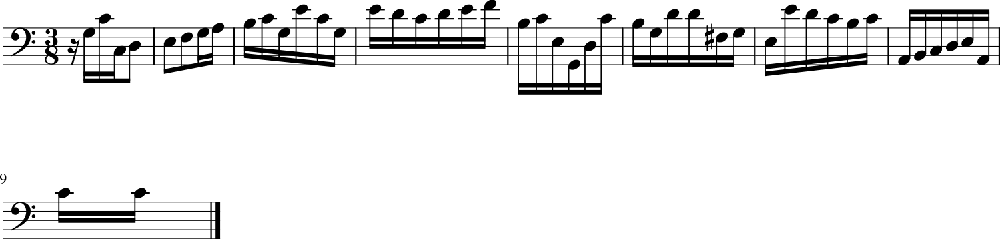

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4813 - loss: 1.1027 - note_outputs_loss: 0.6214
Epoch 818/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5314 - loss: 1.1499 - note_outputs_loss: 0.6185
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


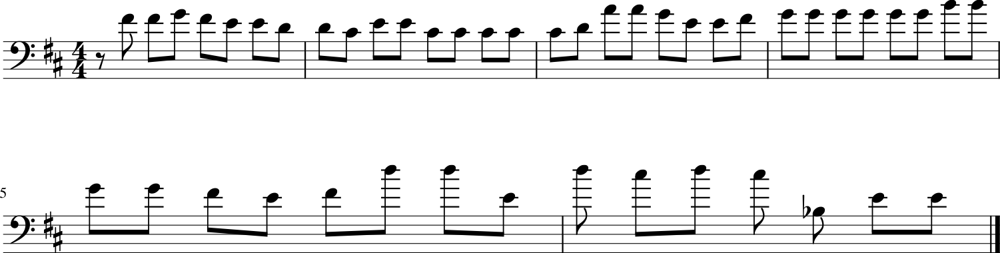

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5313 - loss: 1.1500 - note_outputs_loss: 0.6187
Epoch 819/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5211 - loss: 1.1428 - note_outputs_loss: 0.6217
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'E3', 'G3', 'C4', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'A3', 'C#4', 'D4', 'F#3', 'E3', 'D3', 'F3', 'A3', 'B3', 'F#3', 'G3', 'E3', 'E-3', 'E3', 'B2', 'G2', 'G2', 'E2', 'G3', 'A3'], ['0.0', '0.0', '0.0', '2.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


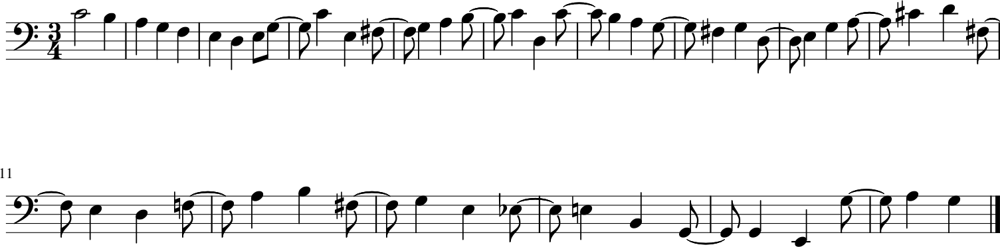

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5211 - loss: 1.1430 - note_outputs_loss: 0.6219
Epoch 820/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5579 - loss: 1.1860 - note_outputs_loss: 0.6281
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B-3', 'C4', 'A3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'A3', 'B3', 'E3', 'C4', 'E3', 'G2', 'F3', 'E3', 'D3', 'E3', 'C3', 'G3', 'G3', 'F3', 'G2', 'A2', 'B2', 'G3', 'F3', 'E3', 'D3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'F#3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


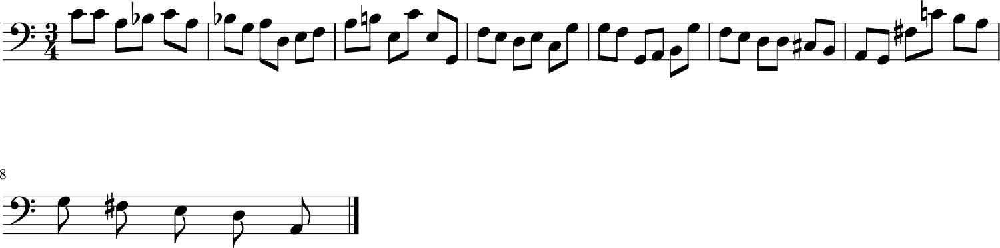

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5576 - loss: 1.1858 - note_outputs_loss: 0.6282
Epoch 821/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5491 - loss: 1.1734 - note_outputs_loss: 0.6243
Generation prompt: [['START', 'G:major', '3/4TS', 'rest', 'G3', 'G3', 'D3', 'G2', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'G3', 'A2', 'B-2', 'G2', 'D3', 'E3', 'A2', 'B-2', 'D3', 'G3', 'E3', 'F3', 'D3', 'G3', 'E3', 'D3', 'E3', 'F3', 'D3', 'G3', 'E3', 'D3', 'E3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


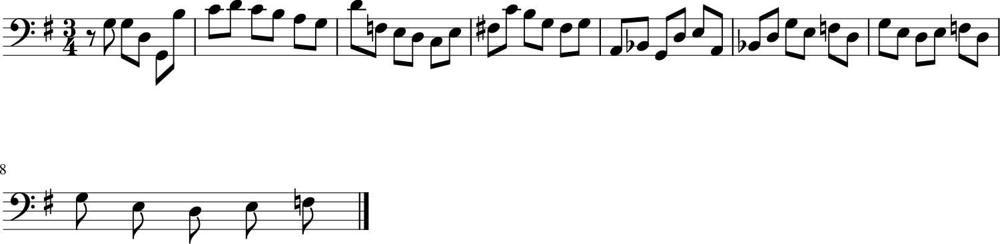

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5489 - loss: 1.1734 - note_outputs_loss: 0.6245
Epoch 822/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5062 - loss: 1.1253 - note_outputs_loss: 0.6191
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'F3', 'C#4', 'G3', 'C#4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'C4', 'F4', 'E-4', 'D4', 'E-4', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'G#3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


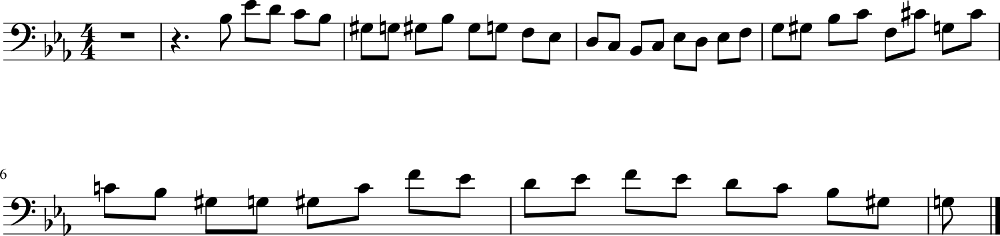

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5064 - loss: 1.1257 - note_outputs_loss: 0.6194
Epoch 823/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5033 - loss: 1.1360 - note_outputs_loss: 0.6328
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'E-3', 'B-2', 'D3', 'E-2', 'G2', 'E-3', 'G3', 'E-3', 'G3', 'C4', 'A2', 'G2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'A2', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'A2', 'E-3', 'D3', 'C3', 'B-2', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


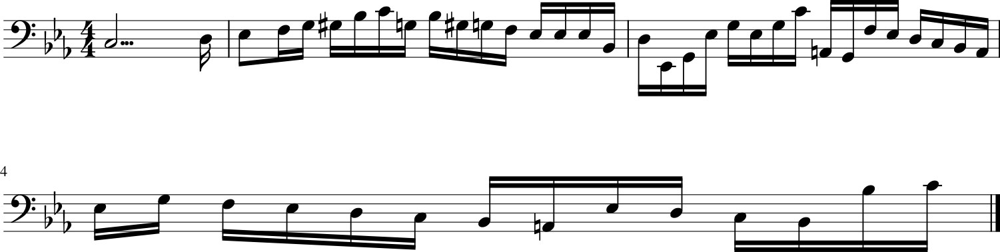

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5034 - loss: 1.1363 - note_outputs_loss: 0.6329
Epoch 824/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5508 - loss: 1.1858 - note_outputs_loss: 0.6350
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1/3', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


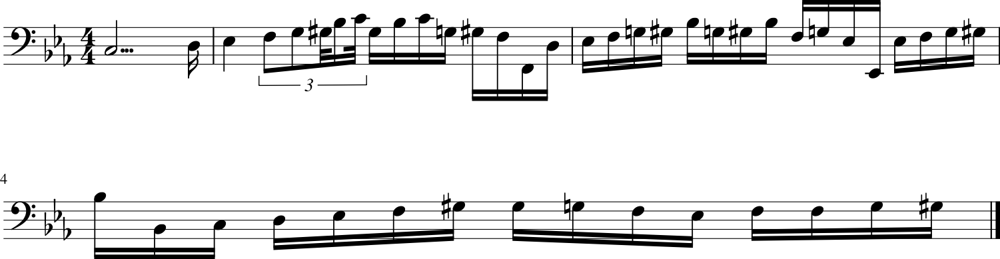

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5505 - loss: 1.1856 - note_outputs_loss: 0.6350
Epoch 825/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5224 - loss: 1.1191 - note_outputs_loss: 0.5967
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


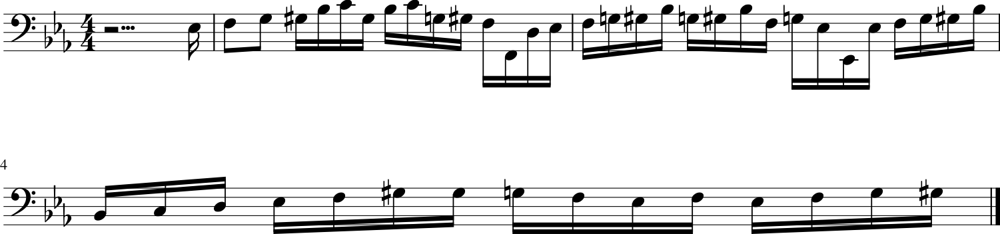

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5224 - loss: 1.1194 - note_outputs_loss: 0.5970
Epoch 826/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5681 - loss: 1.1849 - note_outputs_loss: 0.6168
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


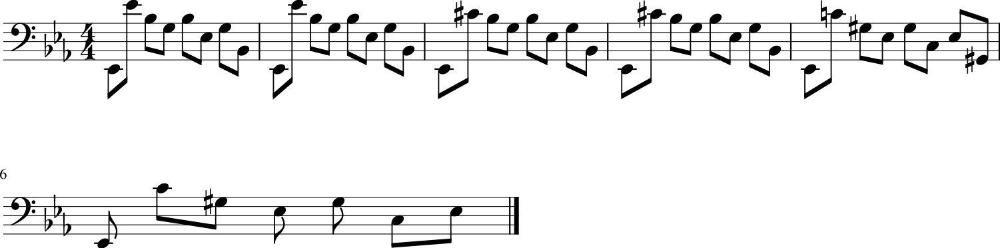

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5677 - loss: 1.1848 - note_outputs_loss: 0.6171
Epoch 827/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4881 - loss: 1.0999 - note_outputs_loss: 0.6118
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '1/6', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


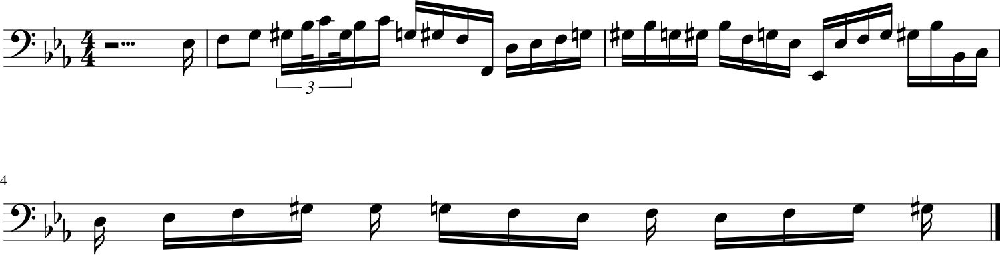

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.4884 - loss: 1.1005 - note_outputs_loss: 0.6121
Epoch 828/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5450 - loss: 1.1752 - note_outputs_loss: 0.6302
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'D3', 'G3', 'D3', 'B2', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'A3', 'B3', 'C4', 'B3', 'B3', 'A3', 'A3', 'B3', 'F#3', 'G3', 'G3', 'E3', 'G3', 'A3', 'E3', 'F#3', 'F#3', 'D3', 'F#3', 'G3', 'B3', 'B3', 'G3', 'E3', 'B2', 'B2', 'G2', 'G2'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


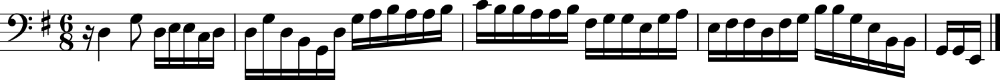

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5447 - loss: 1.1751 - note_outputs_loss: 0.6304
Epoch 829/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5036 - loss: 1.1382 - note_outputs_loss: 0.6345
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'D3', 'A2', 'D2', 'D3', 'F#3', 'A3'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


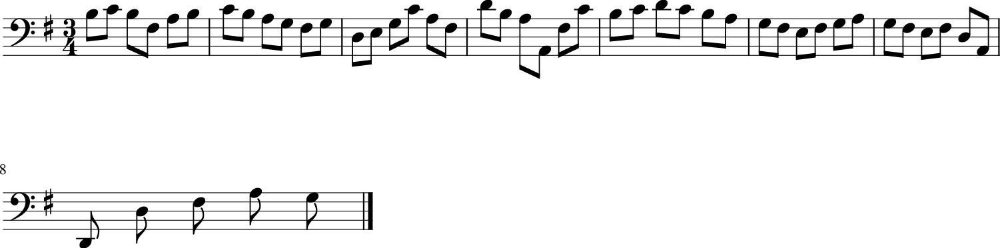

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5038 - loss: 1.1385 - note_outputs_loss: 0.6347
Epoch 830/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5115 - loss: 1.1382 - note_outputs_loss: 0.6268
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'G3', 'E-4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


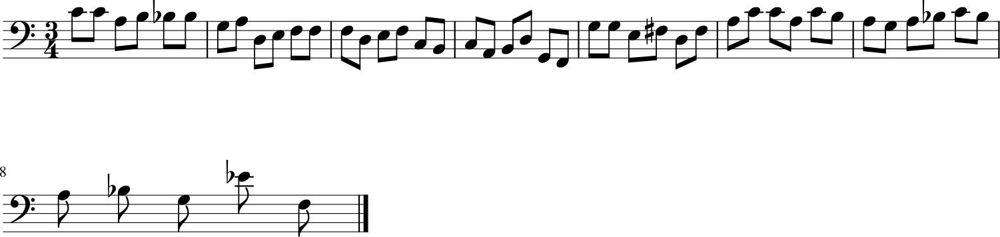

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5116 - loss: 1.1386 - note_outputs_loss: 0.6270
Epoch 831/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4872 - loss: 1.1146 - note_outputs_loss: 0.6274
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


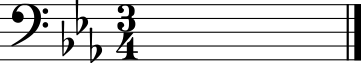

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.4875 - loss: 1.1151 - note_outputs_loss: 0.6276
Epoch 832/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4961 - loss: 1.1272 - note_outputs_loss: 0.6311
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


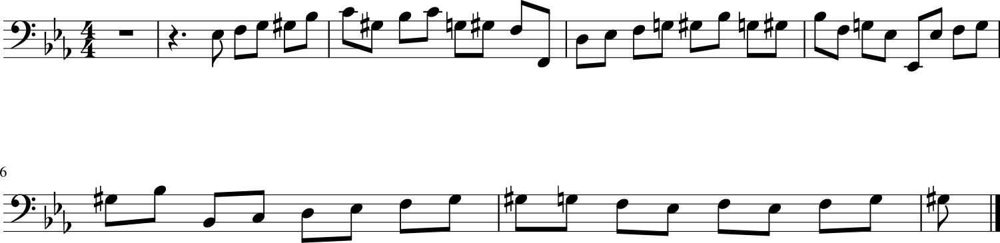

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4963 - loss: 1.1275 - note_outputs_loss: 0.6312
Epoch 833/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5374 - loss: 1.1367 - note_outputs_loss: 0.5993
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'F3', 'B-3', 'F3', 'C4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


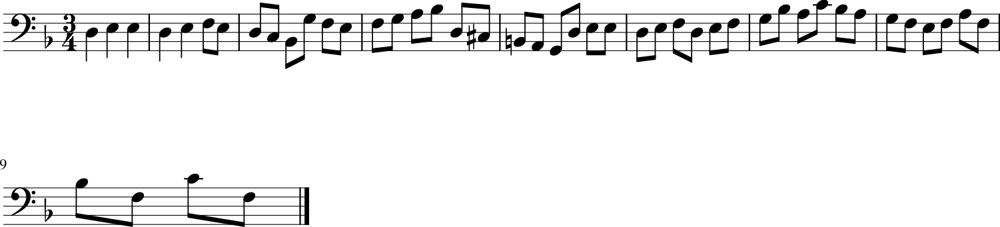

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5372 - loss: 1.1369 - note_outputs_loss: 0.5997
Epoch 834/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5235 - loss: 1.1646 - note_outputs_loss: 0.6410
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


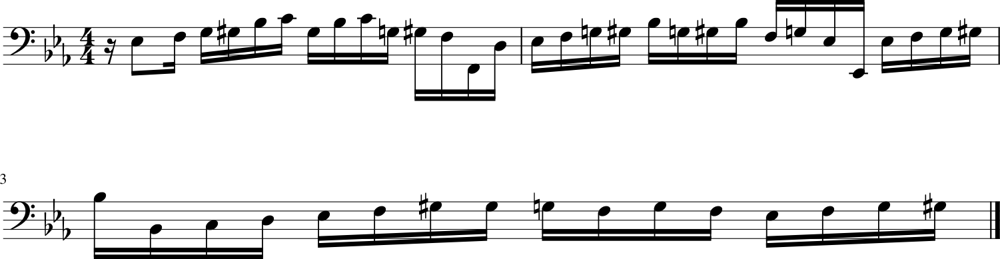

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5235 - loss: 1.1646 - note_outputs_loss: 0.6411
Epoch 835/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4801 - loss: 1.0957 - note_outputs_loss: 0.6156
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'B2', 'C#3', 'D3', 'B2', 'G2', 'B2'], ['0.0', '1.0', '0.75', '0.25', '1.0', '1.0', '1.0', '0.75', '0.25', '1.0', '1.0', '1.0', '1.0', '1.0', '0.75', '0.25', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


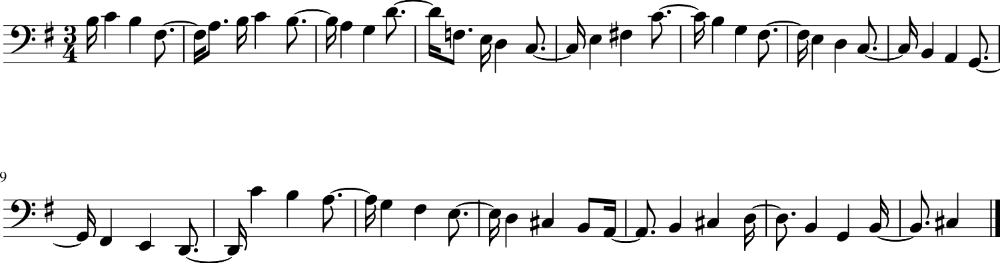

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4805 - loss: 1.0963 - note_outputs_loss: 0.6158
Epoch 836/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4779 - loss: 1.0941 - note_outputs_loss: 0.6162
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4', 'F#3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


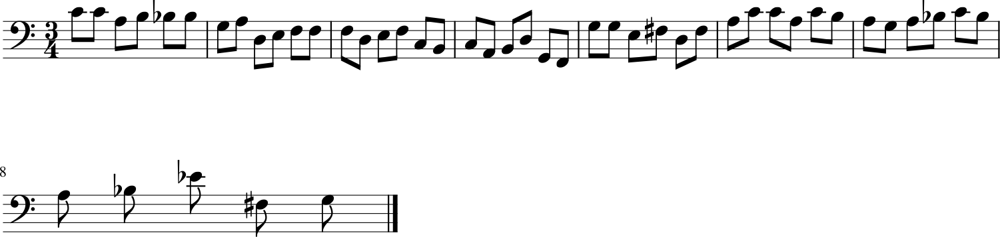

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4783 - loss: 1.0947 - note_outputs_loss: 0.6164
Epoch 837/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5753 - loss: 1.2093 - note_outputs_loss: 0.6340
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'F3', 'F3', 'E3', 'F3', 'C3', 'B2', 'G3', 'C4', 'G3', 'F2', 'D3', 'E4', 'D4', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'F3', 'E3', 'F3', 'D3', 'C3', 'B2', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


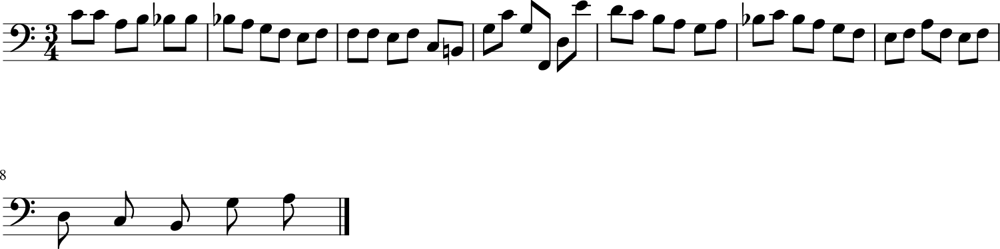

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5748 - loss: 1.2089 - note_outputs_loss: 0.6341
Epoch 838/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5089 - loss: 1.1192 - note_outputs_loss: 0.6103
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


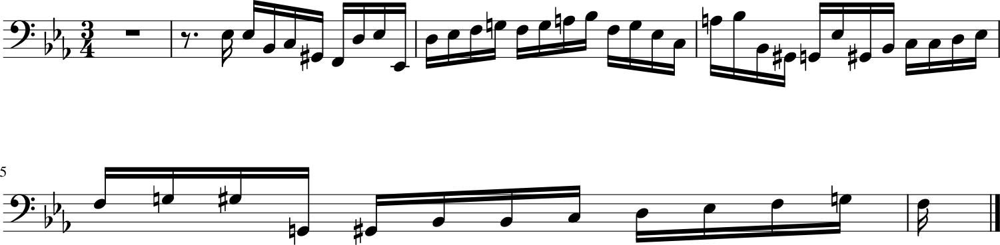

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5090 - loss: 1.1196 - note_outputs_loss: 0.6106
Epoch 839/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5219 - loss: 1.1635 - note_outputs_loss: 0.6416
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'F3', 'E-3', 'E-3', 'G#3', 'G3', 'F3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


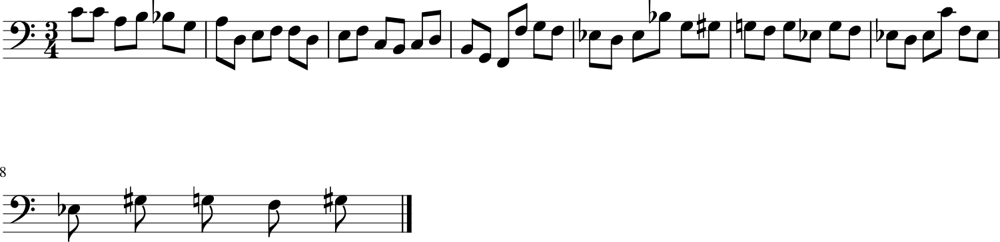

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5219 - loss: 1.1635 - note_outputs_loss: 0.6416
Epoch 840/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5303 - loss: 1.1579 - note_outputs_loss: 0.6276
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'G3', 'F3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


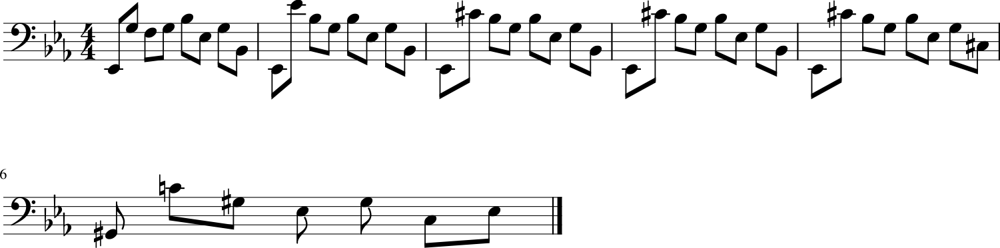

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5302 - loss: 1.1579 - note_outputs_loss: 0.6277
Epoch 841/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4979 - loss: 1.1309 - note_outputs_loss: 0.6329
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'G4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1/12', '1.0', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6']]


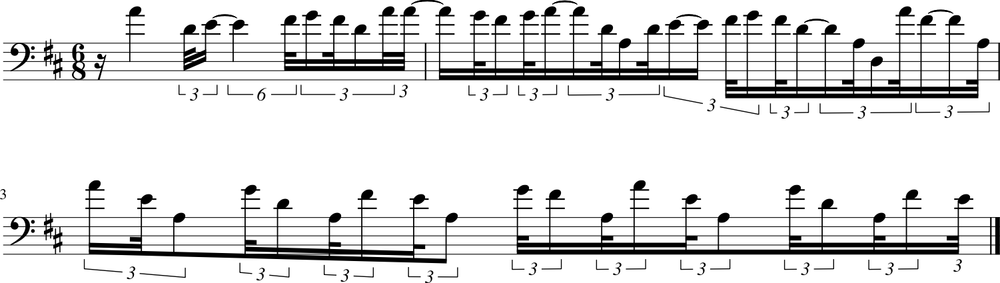

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4982 - loss: 1.1312 - note_outputs_loss: 0.6330
Epoch 842/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5059 - loss: 1.1209 - note_outputs_loss: 0.6150
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


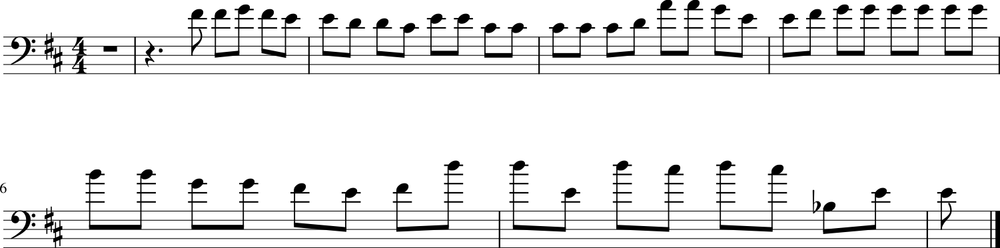

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5061 - loss: 1.1213 - note_outputs_loss: 0.6153
Epoch 843/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5012 - loss: 1.1145 - note_outputs_loss: 0.6133
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


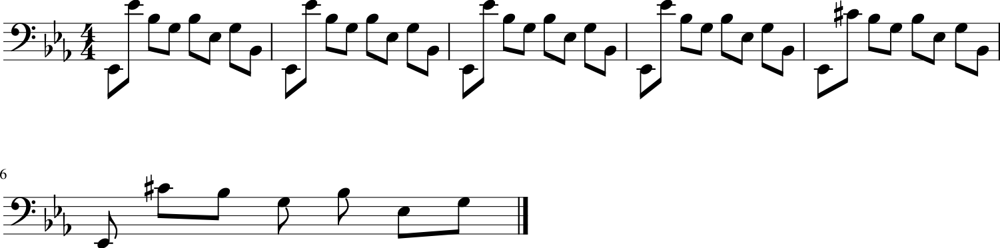

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5013 - loss: 1.1150 - note_outputs_loss: 0.6136
Epoch 844/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5108 - loss: 1.1206 - note_outputs_loss: 0.6098
Generation prompt: [['START', 'G:major', '3/4TS', 'D3', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'G3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'D3', 'A2', 'D2', 'D3', 'F#3', 'A3', 'G3', 'A3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


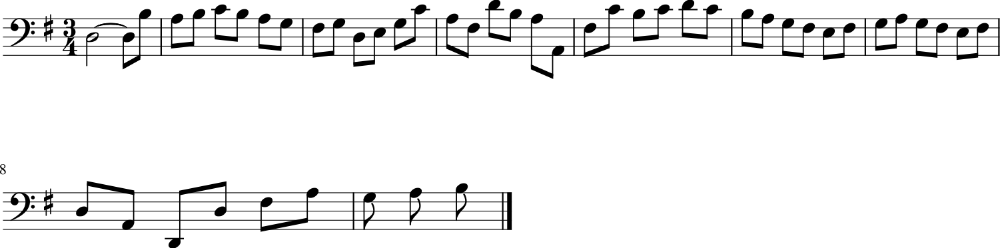

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5109 - loss: 1.1210 - note_outputs_loss: 0.6101
Epoch 845/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4964 - loss: 1.1040 - note_outputs_loss: 0.6076
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'B-2', 'A2', 'E-3', 'E-2', 'G#3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3', 'B-3', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


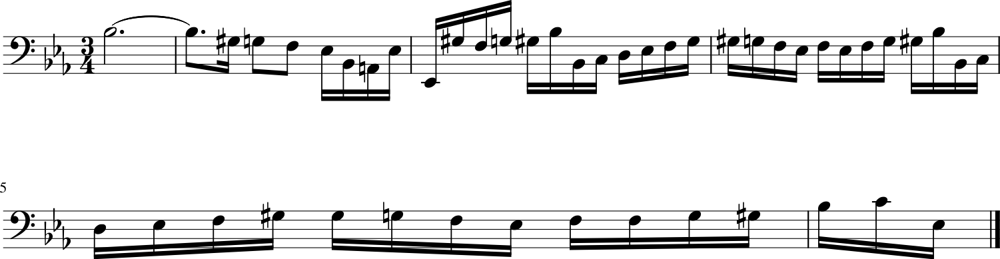

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4966 - loss: 1.1046 - note_outputs_loss: 0.6079
Epoch 846/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4933 - loss: 1.1067 - note_outputs_loss: 0.6134
Generation prompt: [['START', 'E-:major', '3/4TS', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'F3', 'A3', 'E-3', 'A3', 'C4', 'B3', 'G3', 'F3', 'E-3', 'F3', 'B3', 'D4', 'C4', 'G3', 'E-4', 'D4', 'G3', 'F4', 'E-4', 'E4', 'F4', 'D4', 'E-4', 'D4', 'B3', 'C4', 'B3', 'C4', 'B3', 'C4', 'B3', 'A3', 'G#3', 'C3', 'A3', 'C4', 'D4', 'B3', 'A3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.25', '0.25', '0.25']]


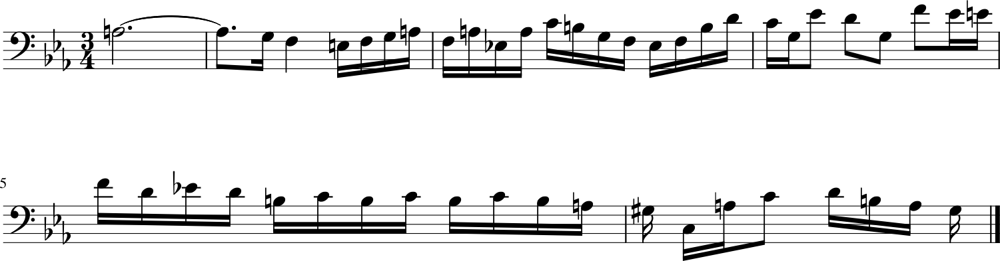

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4935 - loss: 1.1072 - note_outputs_loss: 0.6137
Epoch 847/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4687 - loss: 1.1031 - note_outputs_loss: 0.6344
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


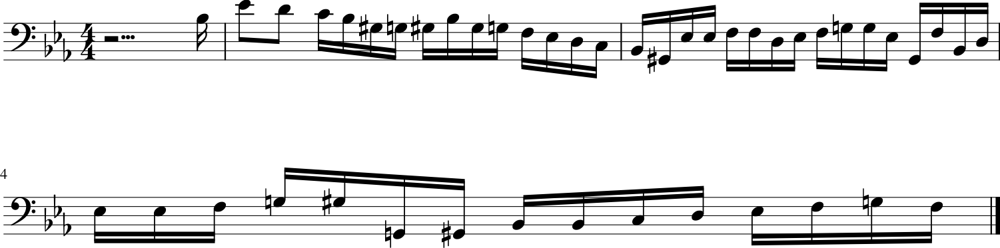

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4692 - loss: 1.1036 - note_outputs_loss: 0.6344
Epoch 848/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5131 - loss: 1.1336 - note_outputs_loss: 0.6205
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'C3', 'B-2', 'G#2', 'G#2', 'C4', 'B-3', 'G#3', 'B-3', 'G3', 'C4', 'G#3', 'B-3', 'G#3', 'B-3', 'G3', 'F3', 'G3', 'F3', 'E3', 'G3', 'G#3', 'B-3', 'C4'], ['0.0', '2.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


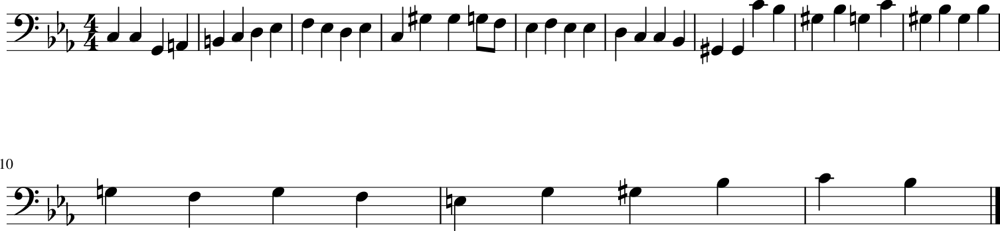

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5131 - loss: 1.1339 - note_outputs_loss: 0.6207
Epoch 849/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5005 - loss: 1.1213 - note_outputs_loss: 0.6208
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


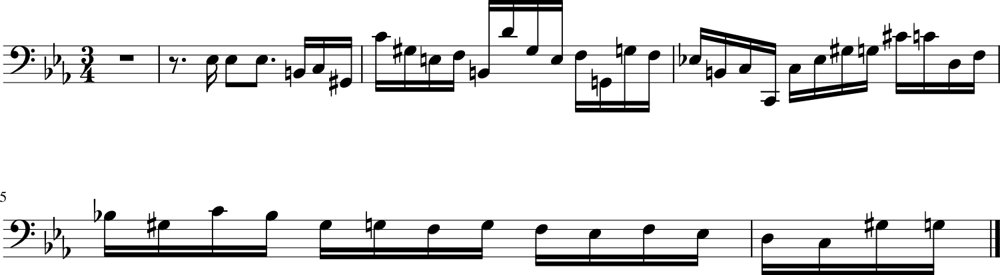

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5006 - loss: 1.1217 - note_outputs_loss: 0.6211
Epoch 850/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5381 - loss: 1.1631 - note_outputs_loss: 0.6250
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'D3', 'E3', 'C#3', 'D3', 'B2', 'C#3', 'A2', 'B2', 'C#3', 'E3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C#4', 'D4', 'E4', 'F#3', 'D3', 'E3', 'F#3', 'A3', 'E3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


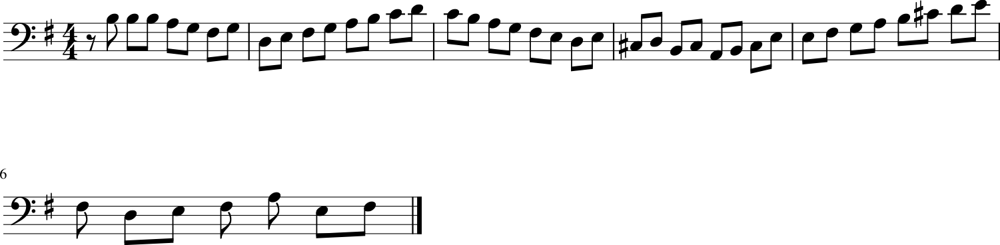

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5379 - loss: 1.1632 - note_outputs_loss: 0.6252
Epoch 851/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5076 - loss: 1.1279 - note_outputs_loss: 0.6203
Generation prompt: [['START', 'D:major', '3/2TS', 'F#4', 'F#4', 'G4', 'E4', 'C#4', 'D4', 'B4', 'A4', 'F#4', 'G4', 'A4', 'G4', 'F#4', 'G4', 'E4', 'F#4', 'F#4', 'G#4', 'A4', 'B4', 'C#4', 'D4', 'E4', 'D4', 'C#4', 'C#4', 'B3', 'B3', 'D4', 'D4', 'C#4', 'C#4', 'F#4', 'F#4', 'G4', 'E4', 'C#4', 'D4', 'B4', 'A4', 'F#4', 'G4', 'A4', 'G4', 'F#4', 'G4'], ['0.0', '3.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


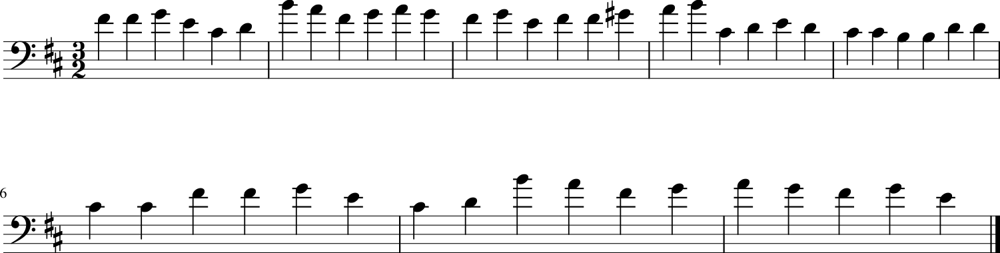

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5077 - loss: 1.1283 - note_outputs_loss: 0.6206
Epoch 852/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5271 - loss: 1.1431 - note_outputs_loss: 0.6161
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'F3', 'E-3', 'D3', 'C4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


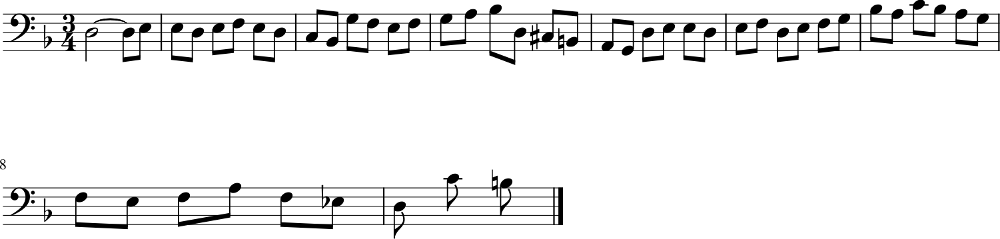

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5270 - loss: 1.1433 - note_outputs_loss: 0.6163
Epoch 853/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5369 - loss: 1.1622 - note_outputs_loss: 0.6253
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


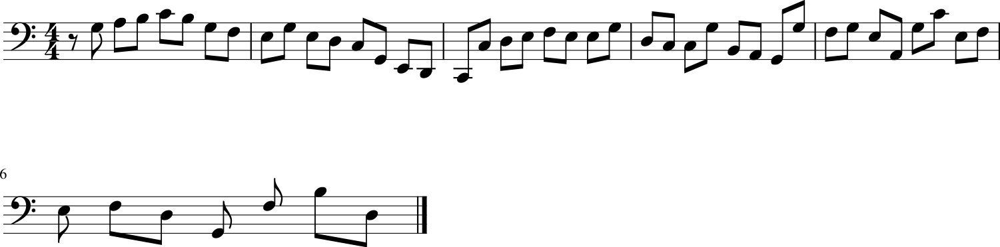

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5368 - loss: 1.1623 - note_outputs_loss: 0.6255
Epoch 854/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5662 - loss: 1.1582 - note_outputs_loss: 0.5920
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2', 'D3', 'G#2', 'E-2', 'G#3', 'F3', 'D3', 'F3', 'B-2'], ['0.0', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


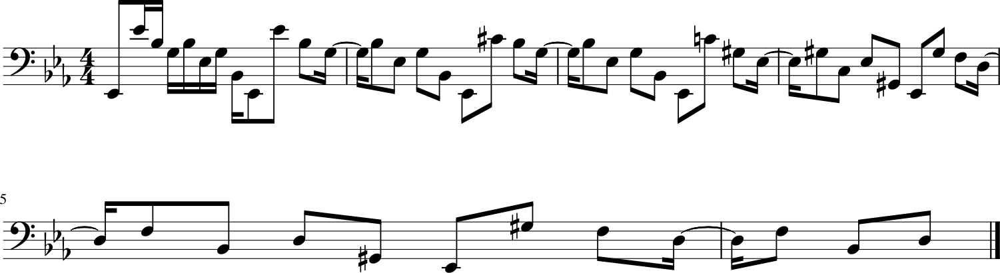

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5658 - loss: 1.1582 - note_outputs_loss: 0.5925
Epoch 855/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5205 - loss: 1.1625 - note_outputs_loss: 0.6419
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2', 'D3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


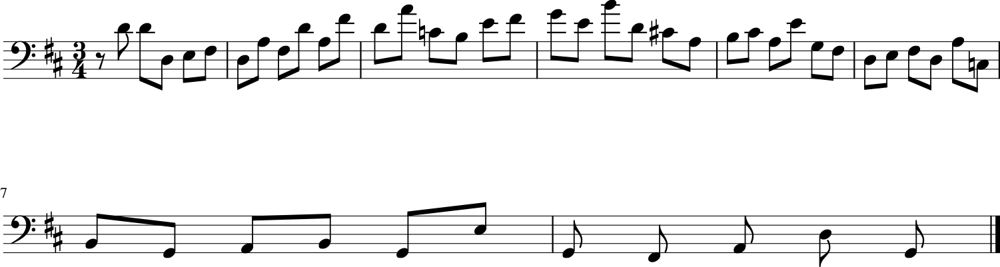

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5205 - loss: 1.1625 - note_outputs_loss: 0.6419
Epoch 856/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5265 - loss: 1.1333 - note_outputs_loss: 0.6068
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'A3', 'B3', 'D3', 'C3', 'B2', 'A2', 'B2', 'D3', 'B2', 'G2', 'A2', 'B2', 'G3', 'A2', 'B2', 'G2', 'A2', 'B2', 'D3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


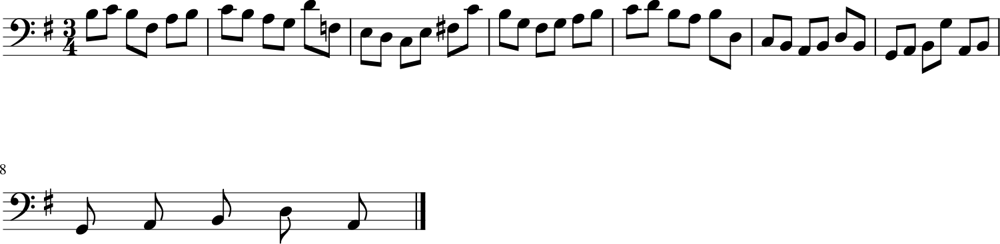

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5264 - loss: 1.1335 - note_outputs_loss: 0.6071
Epoch 857/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5507 - loss: 1.1606 - note_outputs_loss: 0.6099
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'E3', 'C4', 'G#3', 'F3', 'G3', 'F3', 'G3', 'F3', 'E3', 'G3', 'C3', 'B-3', 'G#3', 'B-3', 'G#3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.25', '0.25', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


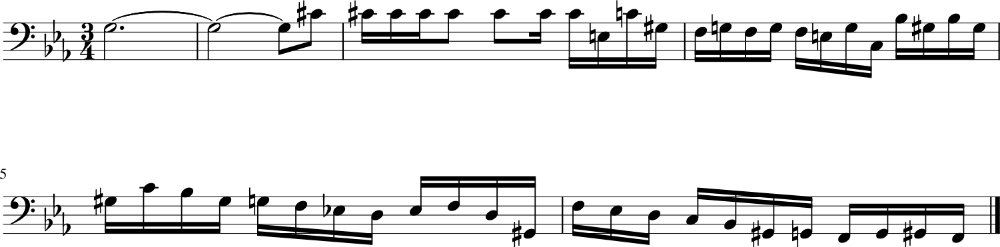

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5504 - loss: 1.1606 - note_outputs_loss: 0.6102
Epoch 858/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5577 - loss: 1.1890 - note_outputs_loss: 0.6312
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'D3', 'B2', 'A2', 'B2', 'D3', 'E2', 'F#3', 'A3', 'C4', 'D4', 'B3', 'C4', 'A3', 'A3', 'C3', 'D3', 'B3', 'E3', 'G#3', 'A3', 'D4', 'E4', 'B3', 'C4', 'F3', 'G3', 'B-3', 'B-3', 'C3', 'E2', 'B-3', 'A3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


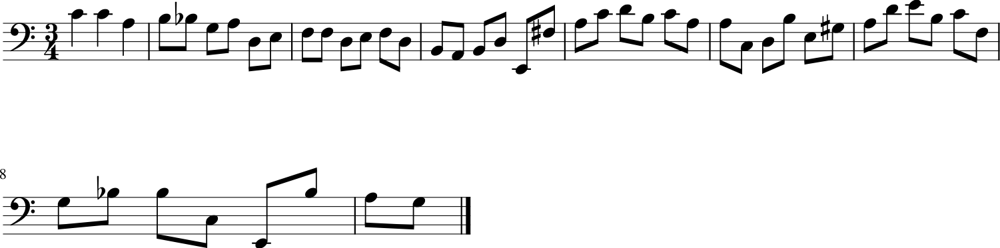

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5574 - loss: 1.1887 - note_outputs_loss: 0.6313
Epoch 859/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5329 - loss: 1.1447 - note_outputs_loss: 0.6118
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'G3', 'B-3', 'A3', 'B-3'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


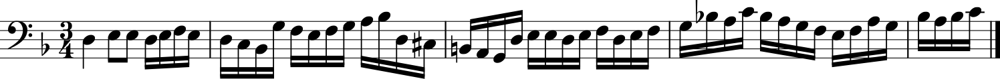

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5328 - loss: 1.1448 - note_outputs_loss: 0.6120
Epoch 860/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4826 - loss: 1.1155 - note_outputs_loss: 0.6329
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'G#2', 'F2', 'G#3', 'G#3', 'G3', 'G#3', 'F3', 'D4', 'C4', 'D4', 'B-3', 'F4', 'F4', 'E-4', 'D4', 'C4', 'B-3', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


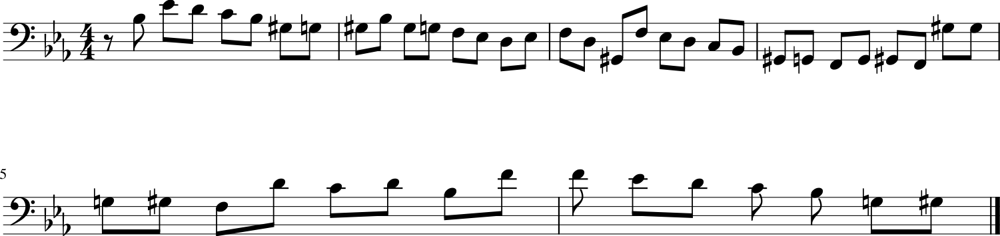

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4829 - loss: 1.1160 - note_outputs_loss: 0.6330
Epoch 861/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5388 - loss: 1.1675 - note_outputs_loss: 0.6287
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


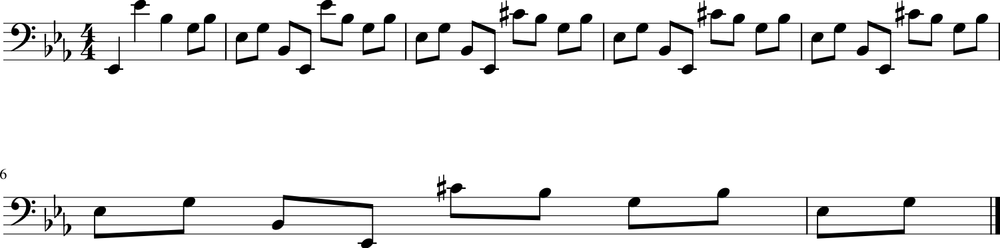

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5386 - loss: 1.1674 - note_outputs_loss: 0.6288
Epoch 862/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5465 - loss: 1.1843 - note_outputs_loss: 0.6377
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


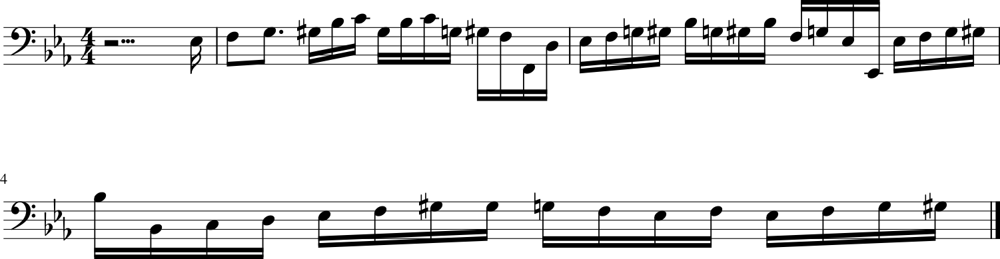

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5463 - loss: 1.1840 - note_outputs_loss: 0.6377
Epoch 863/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5104 - loss: 1.1161 - note_outputs_loss: 0.6057
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


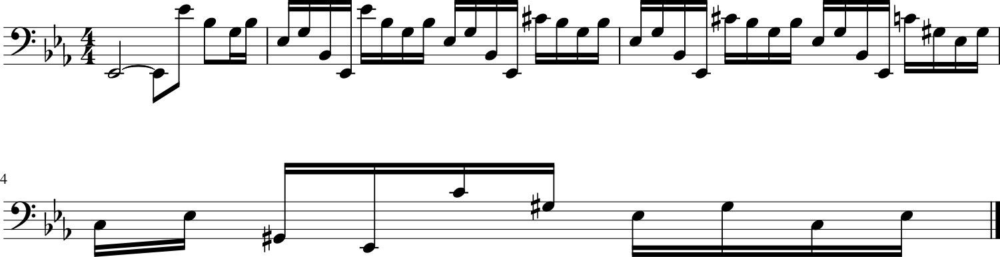

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5105 - loss: 1.1165 - note_outputs_loss: 0.6060
Epoch 864/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5021 - loss: 1.1065 - note_outputs_loss: 0.6044
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E3', 'D3', 'C3', 'E3', 'F#3', 'G3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'A3', 'B3', 'A3', 'G3', 'A3', 'C3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'B3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


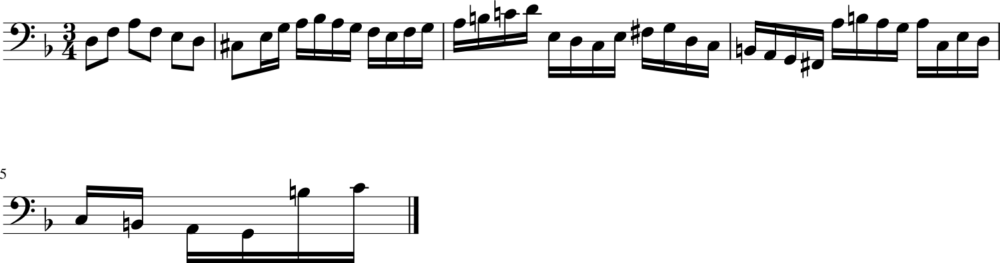

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5023 - loss: 1.1070 - note_outputs_loss: 0.6047
Epoch 865/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5434 - loss: 1.1600 - note_outputs_loss: 0.6166
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'B-2', 'E-2', 'E-3', 'E-3', 'F3', 'F3', 'D3', 'E-3', 'F3', 'G3', 'G3', 'E-3', 'G#2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


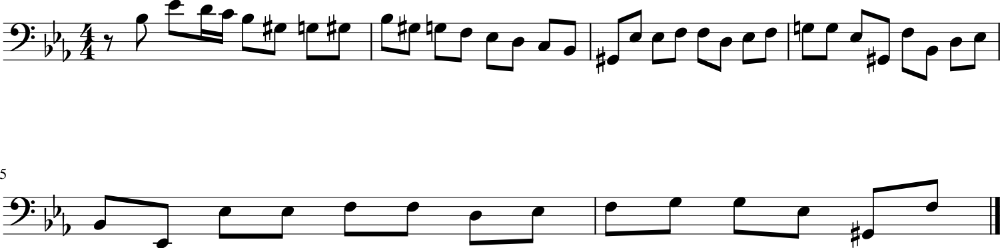

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5432 - loss: 1.1600 - note_outputs_loss: 0.6168
Epoch 866/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4723 - loss: 1.0935 - note_outputs_loss: 0.6212
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'C#3', 'D3', 'E3', 'F3', 'G3', 'F3', 'G3', 'E3', 'F3', 'D3', 'E3', 'C3', 'B-2', 'A2', 'B-2', 'A3', 'G3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'F#3'], ['0.0', '0.0', '0.0', '1.0', '0.75', '0.25', '0.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


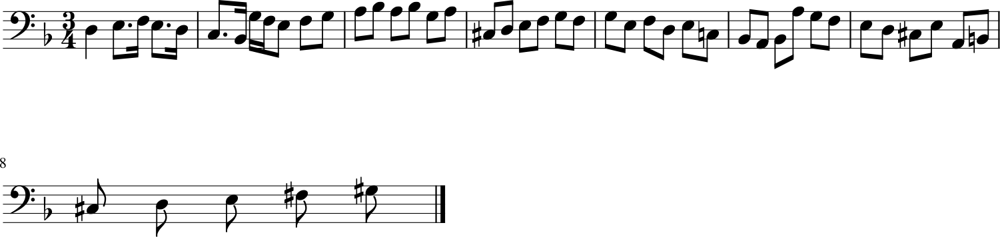

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4728 - loss: 1.0941 - note_outputs_loss: 0.6213
Epoch 867/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5023 - loss: 1.1063 - note_outputs_loss: 0.6040
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


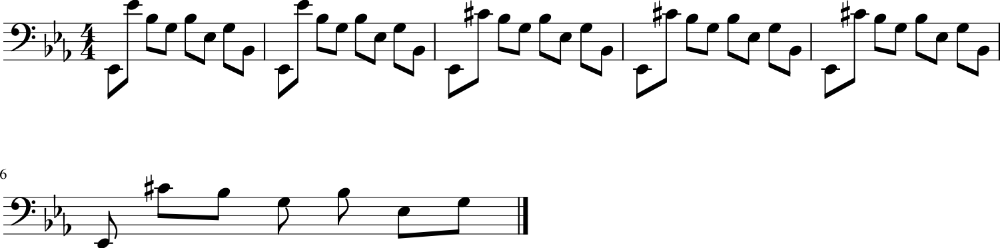

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5025 - loss: 1.1068 - note_outputs_loss: 0.6043
Epoch 868/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5404 - loss: 1.1617 - note_outputs_loss: 0.6212
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'C4', 'G2', 'B-2', 'C3', 'D3', 'E-3', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


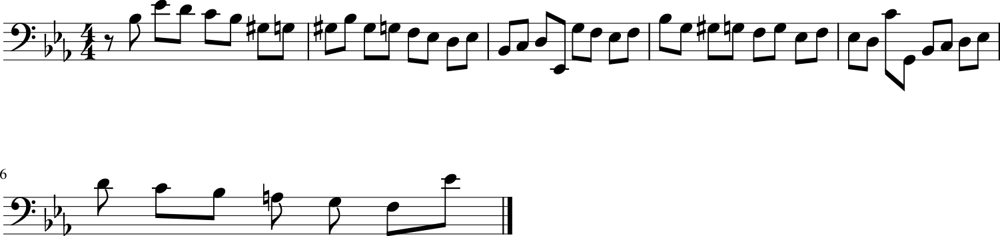

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5402 - loss: 1.1616 - note_outputs_loss: 0.6213
Epoch 869/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4949 - loss: 1.1079 - note_outputs_loss: 0.6129
Generation prompt: [['START', 'G:major', '3/4TS', 'C2', 'A3', 'B-3', 'G#3', 'G3', 'F3', 'F3', 'F3', 'F3', 'F3', 'E-3', 'D3', 'E-3', 'E-3', 'D3', 'E-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'B-2', 'D4', 'E-4', 'rest'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


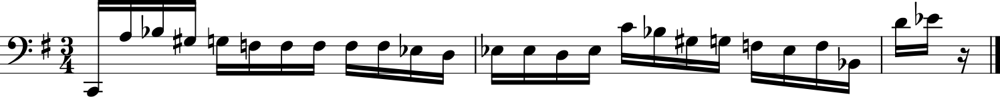

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - duration_outputs_loss: 0.4952 - loss: 1.1083 - note_outputs_loss: 0.6132
Epoch 870/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5672 - loss: 1.1884 - note_outputs_loss: 0.6212
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


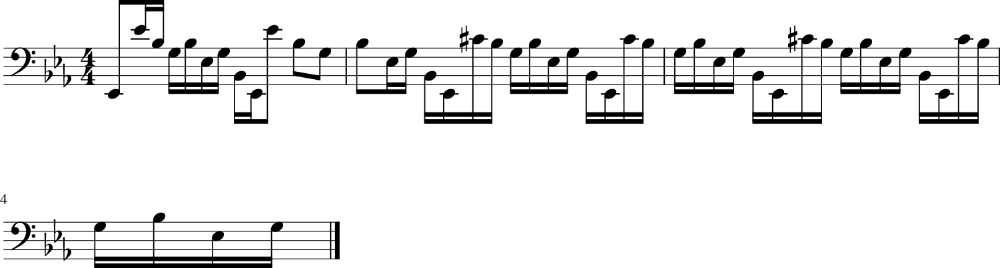

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5668 - loss: 1.1882 - note_outputs_loss: 0.6214
Epoch 871/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5297 - loss: 1.1371 - note_outputs_loss: 0.6074
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'G#2', 'G2', 'F2', 'E-2', 'E-4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'B-2', 'G2', 'C#4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'C#4', 'G#2', 'C#4', 'C4', 'B-3'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


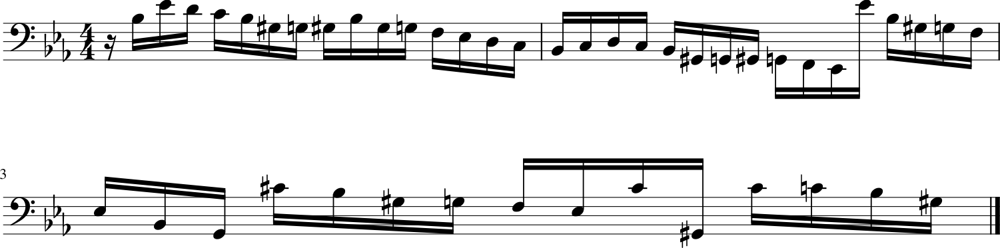

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5296 - loss: 1.1373 - note_outputs_loss: 0.6077
Epoch 872/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5037 - loss: 1.1307 - note_outputs_loss: 0.6271
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


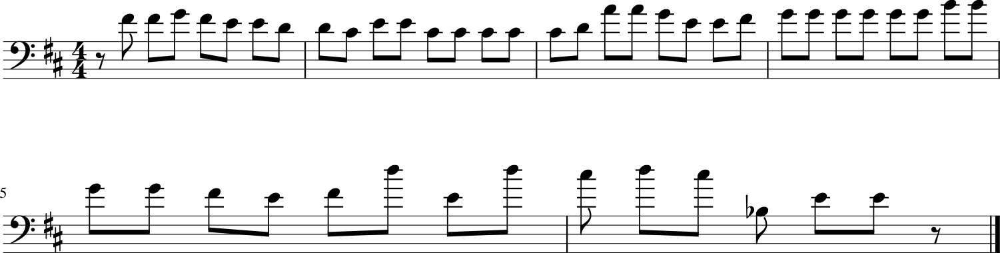

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5038 - loss: 1.1311 - note_outputs_loss: 0.6273
Epoch 873/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5041 - loss: 1.1051 - note_outputs_loss: 0.6009
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'C3', 'G3', 'A3', 'D3', 'F3', 'A3', 'B3', 'E3', 'G3', 'C4', 'A3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


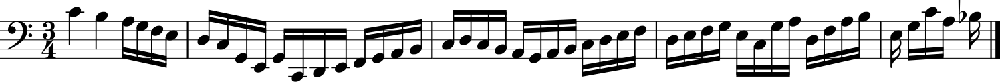

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5043 - loss: 1.1056 - note_outputs_loss: 0.6013
Epoch 874/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4978 - loss: 1.1122 - note_outputs_loss: 0.6144
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


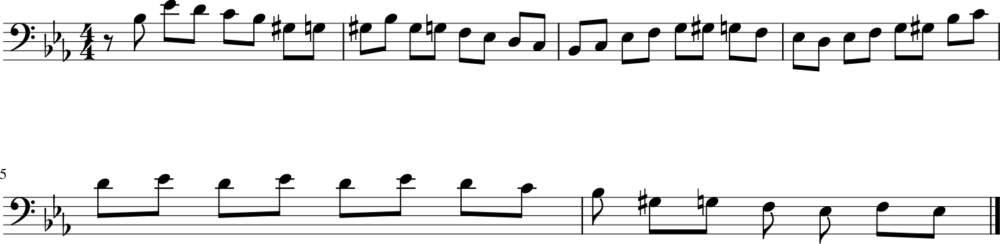

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4980 - loss: 1.1126 - note_outputs_loss: 0.6146
Epoch 875/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5203 - loss: 1.1431 - note_outputs_loss: 0.6228
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


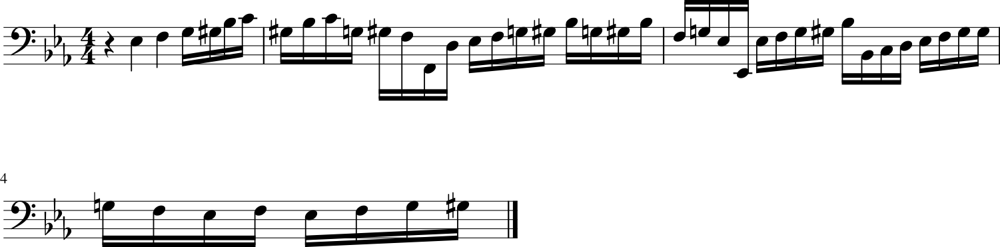

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5203 - loss: 1.1432 - note_outputs_loss: 0.6230
Epoch 876/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5927 - loss: 1.2126 - note_outputs_loss: 0.6199
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'A3', 'D3', 'F#3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'D4', 'C4', 'C4', 'D3', 'C3', 'B2', 'A2', 'G2', 'D2', 'C4', 'B3', 'B3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


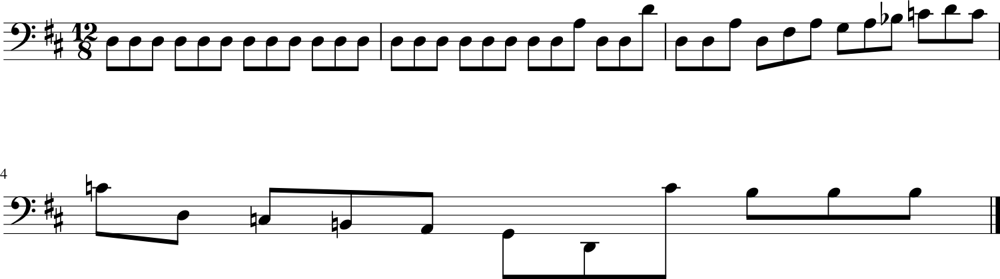

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5920 - loss: 1.2121 - note_outputs_loss: 0.6201
Epoch 877/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5060 - loss: 1.1106 - note_outputs_loss: 0.6047
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'F3', 'G3', 'E-3', 'G3', 'D3', 'C3', 'G#3', 'G2', 'G#3', 'F3', 'B-3', 'B-3', 'G3', 'F3', 'E-3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


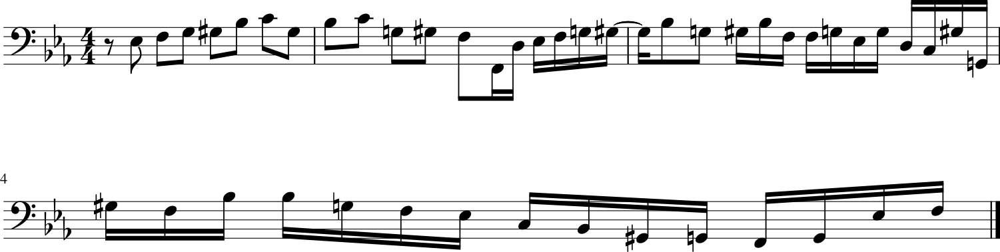

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5061 - loss: 1.1111 - note_outputs_loss: 0.6050
Epoch 878/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5442 - loss: 1.1621 - note_outputs_loss: 0.6179
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


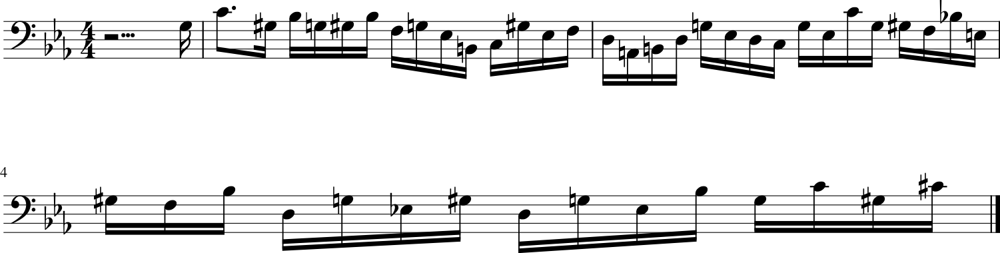

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5440 - loss: 1.1621 - note_outputs_loss: 0.6181
Epoch 879/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5742 - loss: 1.2145 - note_outputs_loss: 0.6403
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'F#4', 'F#4', 'E4', 'E4', 'G4', 'G4', 'G4', 'E4', 'B4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4', 'E4', 'rest', 'G4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


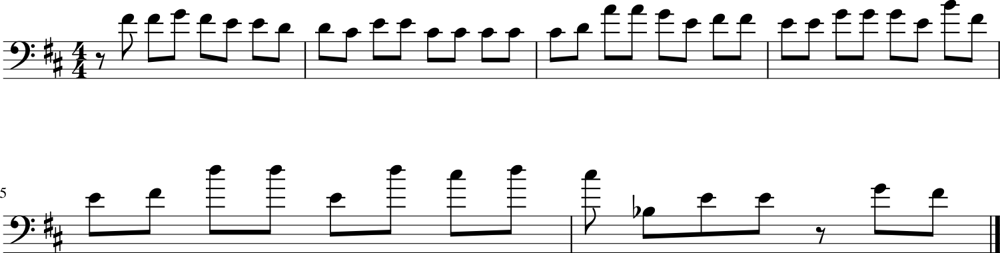

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5737 - loss: 1.2140 - note_outputs_loss: 0.6402
Epoch 880/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5480 - loss: 1.1948 - note_outputs_loss: 0.6467
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'A3', 'G3'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


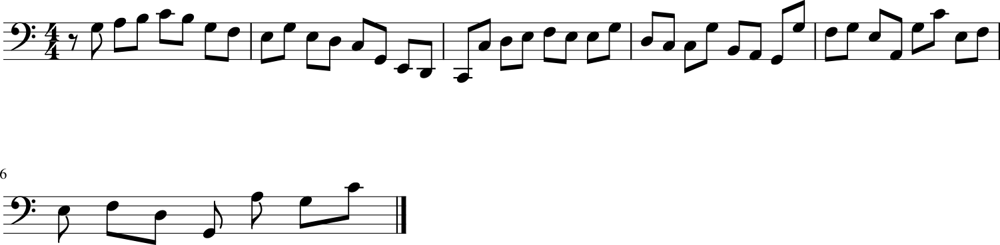

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5478 - loss: 1.1945 - note_outputs_loss: 0.6467
Epoch 881/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5559 - loss: 1.1850 - note_outputs_loss: 0.6291
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'G#3', 'G#3', 'F3', 'F2', 'D3', 'G3', 'B3', 'A3', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C#2', 'A2', 'E3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'C#2', 'A2', 'E3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


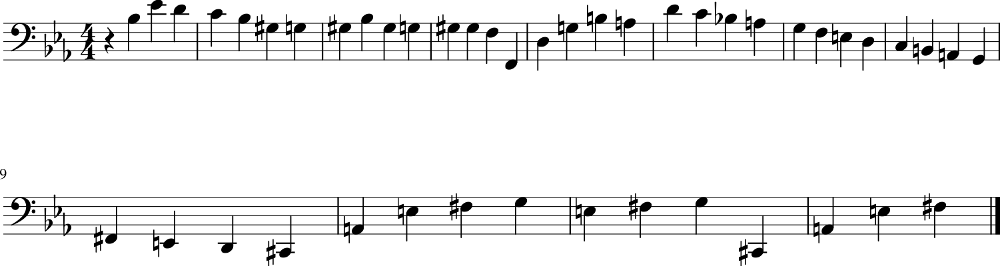

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5556 - loss: 1.1847 - note_outputs_loss: 0.6291
Epoch 882/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5629 - loss: 1.1717 - note_outputs_loss: 0.6088
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'B-3', 'A3', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A3', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


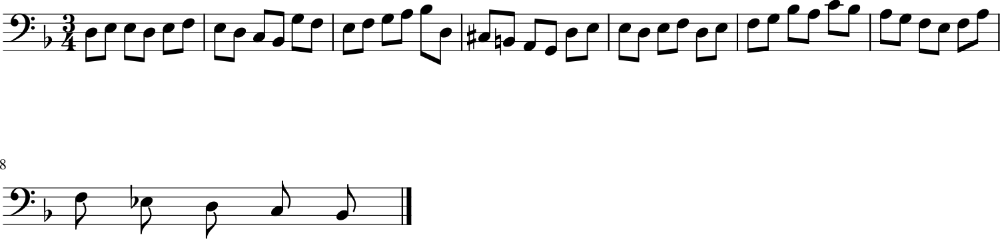

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5625 - loss: 1.1715 - note_outputs_loss: 0.6090
Epoch 883/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5809 - loss: 1.1815 - note_outputs_loss: 0.6006
Generation prompt: [['START', 'F:major', '3/4TS', 'A3', 'B-3', 'B-3', 'A3', 'B-3', 'G3', 'A3', 'D3', 'G3', 'F3', 'E3', 'F3', 'E3', 'D3', 'C#3', 'B2', 'A2', 'A3', 'B-3', 'B-3', 'A3', 'B-3', 'G3', 'C4', 'A3', 'D4', 'E4', 'C#4', 'E4', 'D4', 'E4', 'F4', 'E4', 'D4', 'C#4', 'E4', 'A3', 'G3', 'A3', 'D4', 'C#4', 'G4', 'F4', 'E4', 'F4', 'D4'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


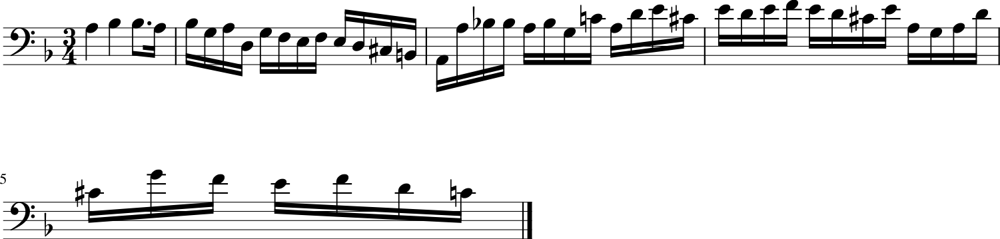

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5803 - loss: 1.1813 - note_outputs_loss: 0.6009
Epoch 884/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5056 - loss: 1.1211 - note_outputs_loss: 0.6155
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


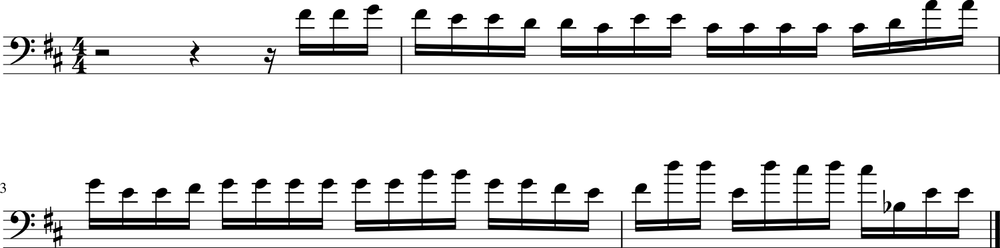

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5058 - loss: 1.1215 - note_outputs_loss: 0.6157
Epoch 885/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5500 - loss: 1.1637 - note_outputs_loss: 0.6137
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'G2', 'B3', 'A3', 'A3', 'A3', 'B3', 'A3', 'F#3', 'A3', 'F#3', 'G3', 'G3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'B2', 'D3', 'C#3', 'E3', 'B2', 'C#3', 'E3', 'A3', 'E3', 'D3', 'E3', 'C3', 'E3', 'C3', 'G3', 'A3', 'C3', 'D3', 'A3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1.0', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12']]


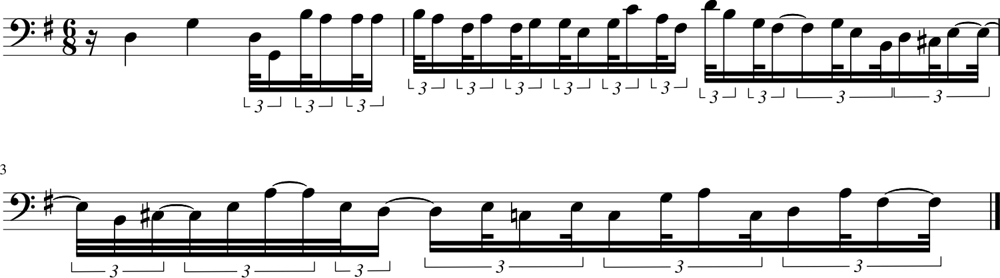

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5497 - loss: 1.1636 - note_outputs_loss: 0.6139
Epoch 886/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5490 - loss: 1.1573 - note_outputs_loss: 0.6084
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'E4', 'C4', 'A3', 'A3', 'A3', 'A3', 'A3', 'B-3', 'A3', 'C4', 'E4'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


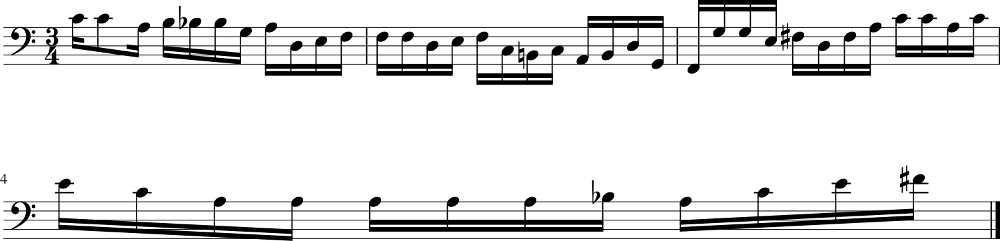

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5487 - loss: 1.1574 - note_outputs_loss: 0.6087
Epoch 887/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5272 - loss: 1.1419 - note_outputs_loss: 0.6147
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'G3', 'B-3', 'C#4', 'E4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'G3', 'C4', 'E4', 'C4', 'A3', 'F3', 'E4', 'D4', 'C4', 'B3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


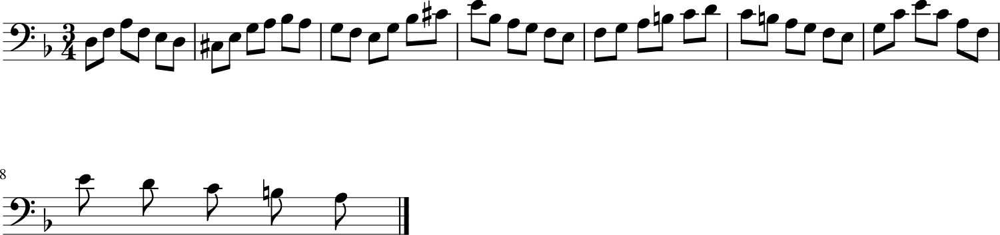

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5272 - loss: 1.1420 - note_outputs_loss: 0.6149
Epoch 888/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5157 - loss: 1.1158 - note_outputs_loss: 0.6001
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


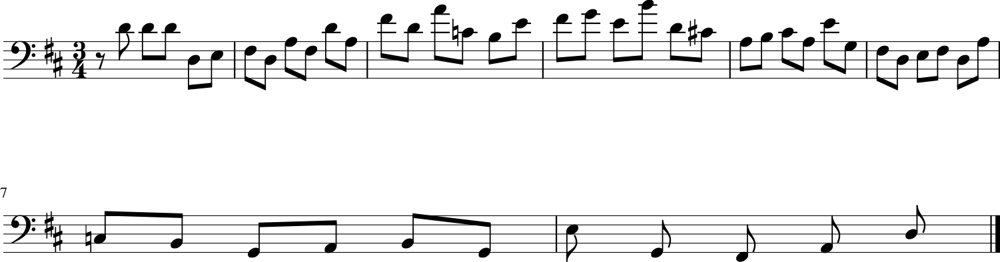

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5158 - loss: 1.1162 - note_outputs_loss: 0.6004
Epoch 889/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4975 - loss: 1.1197 - note_outputs_loss: 0.6222
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'D5', 'C#5', 'D5', 'A4', 'F#4', 'A4', 'F#4'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


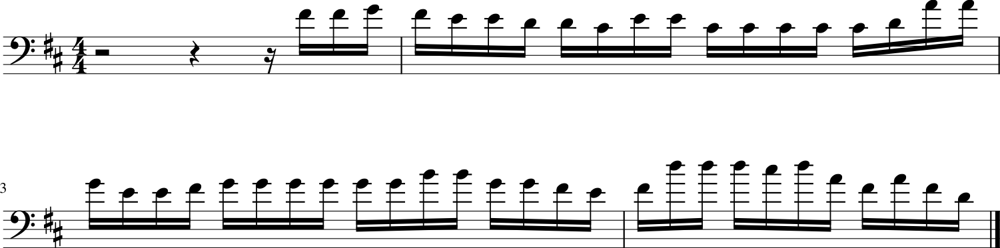

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4977 - loss: 1.1201 - note_outputs_loss: 0.6224
Epoch 890/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5394 - loss: 1.1613 - note_outputs_loss: 0.6218
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


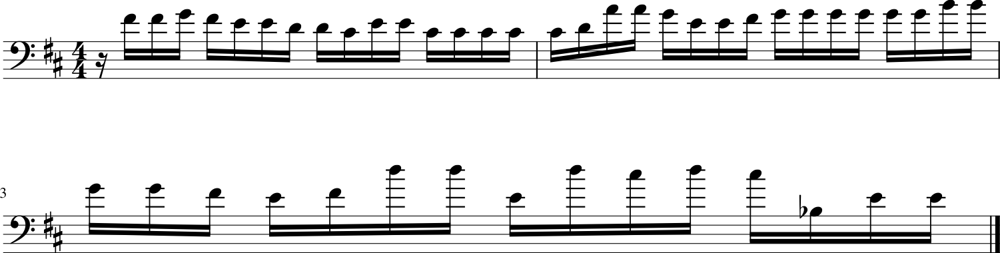

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5392 - loss: 1.1612 - note_outputs_loss: 0.6219
Epoch 891/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5294 - loss: 1.1468 - note_outputs_loss: 0.6174
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'D5', 'C#5', 'D5', 'C#5', 'D5', 'A4', 'F#4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


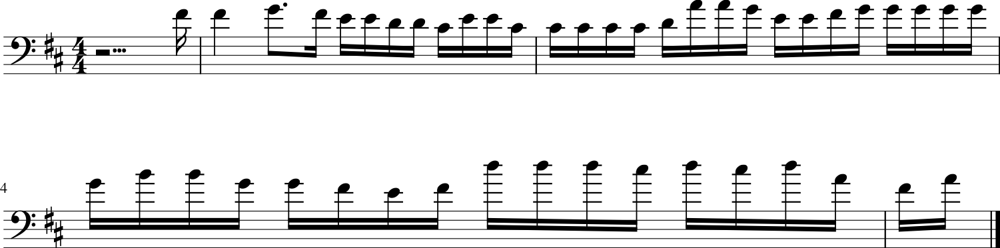

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5293 - loss: 1.1469 - note_outputs_loss: 0.6176
Epoch 892/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5266 - loss: 1.1539 - note_outputs_loss: 0.6273
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


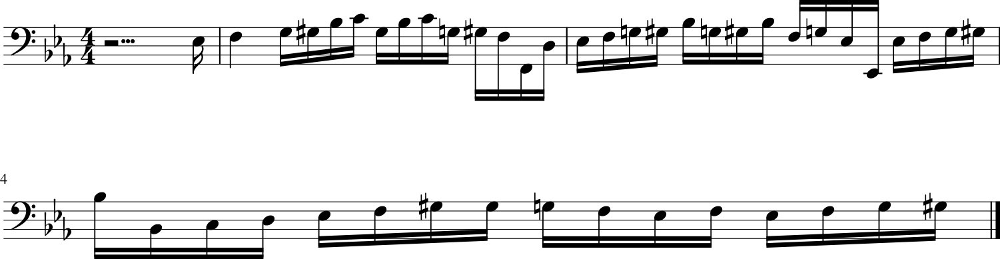

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5265 - loss: 1.1539 - note_outputs_loss: 0.6274
Epoch 893/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5423 - loss: 1.1440 - note_outputs_loss: 0.6017
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


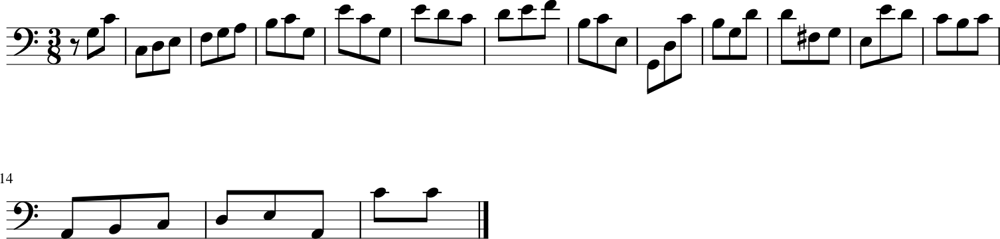

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5421 - loss: 1.1441 - note_outputs_loss: 0.6020
Epoch 894/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4737 - loss: 1.0799 - note_outputs_loss: 0.6062
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


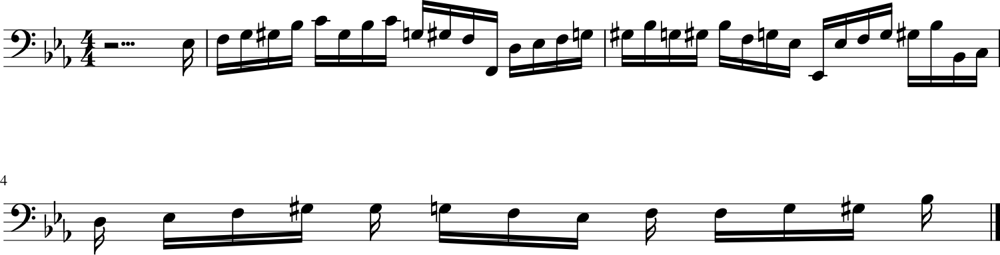

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4742 - loss: 1.0806 - note_outputs_loss: 0.6065
Epoch 895/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5078 - loss: 1.1422 - note_outputs_loss: 0.6344
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


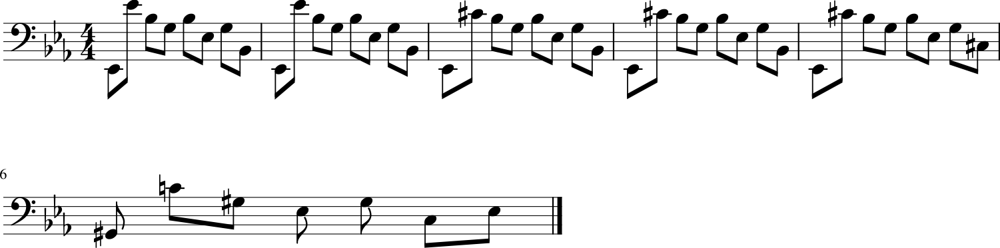

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5079 - loss: 1.1424 - note_outputs_loss: 0.6344
Epoch 896/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5279 - loss: 1.1500 - note_outputs_loss: 0.6221
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


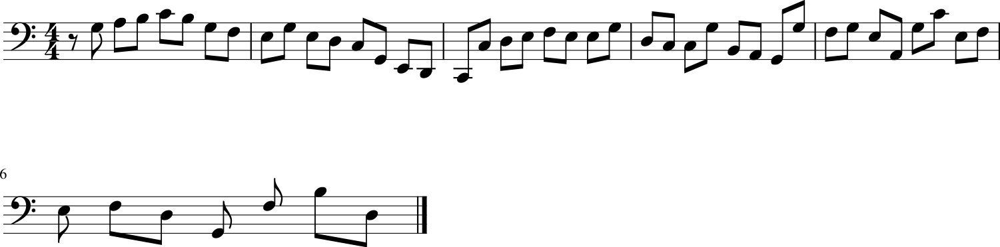

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5279 - loss: 1.1502 - note_outputs_loss: 0.6223
Epoch 897/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4668 - loss: 1.0955 - note_outputs_loss: 0.6287
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'D4', 'D5', 'D5', 'D5', 'A4', 'A4', 'A4'], ['0.0', '3.75', '0.25', '1/12', '1/3', '1/3', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


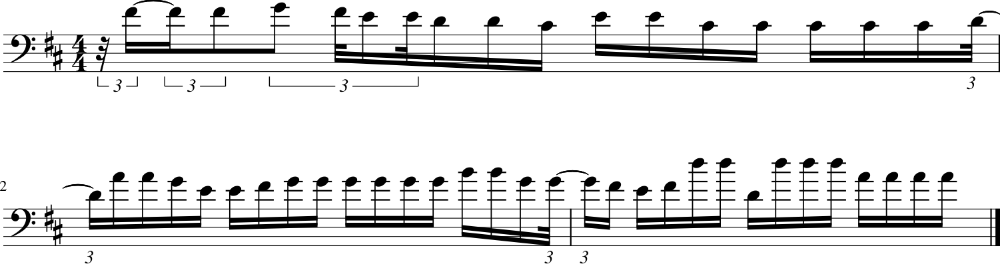

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4673 - loss: 1.0961 - note_outputs_loss: 0.6288
Epoch 898/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5325 - loss: 1.1366 - note_outputs_loss: 0.6040
Generation prompt: [['START', 'E-:major'], ['0.0', '0.0']]


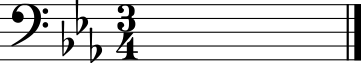

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5325 - loss: 1.1368 - note_outputs_loss: 0.6043
Epoch 899/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5368 - loss: 1.1524 - note_outputs_loss: 0.6156
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4', 'F#3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


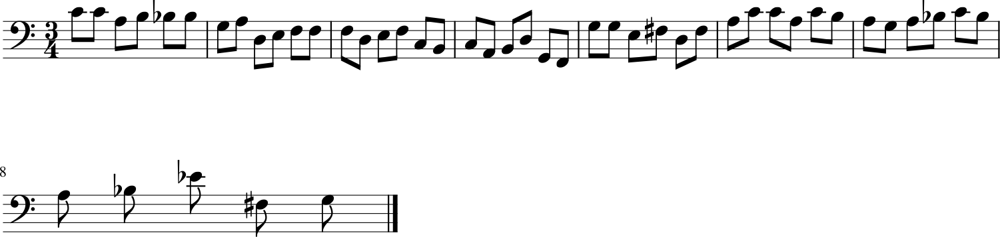

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5367 - loss: 1.1524 - note_outputs_loss: 0.6158
Epoch 900/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4915 - loss: 1.1036 - note_outputs_loss: 0.6121
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5']]


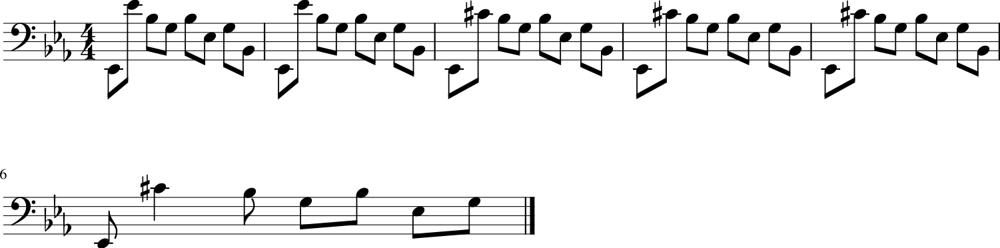

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4918 - loss: 1.1041 - note_outputs_loss: 0.6123
Epoch 901/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4587 - loss: 1.0696 - note_outputs_loss: 0.6109
Generation prompt: [['START', 'D:major', '6/8TS', 'rest', 'A4', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A4', 'A4', 'G4', 'F#4', 'G4', 'A4', 'D4', 'A3', 'D4', 'E4', 'F#4', 'G4', 'F#4', 'D4', 'A3', 'D3', 'A4', 'F#4', 'A3', 'A4', 'E4', 'A3', 'G4', 'D4', 'A3', 'F#4', 'E4', 'A3', 'E4', 'F#4', 'E4', 'F#4', 'B3', 'C#4', 'D4', 'B3', 'G#3', 'F#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


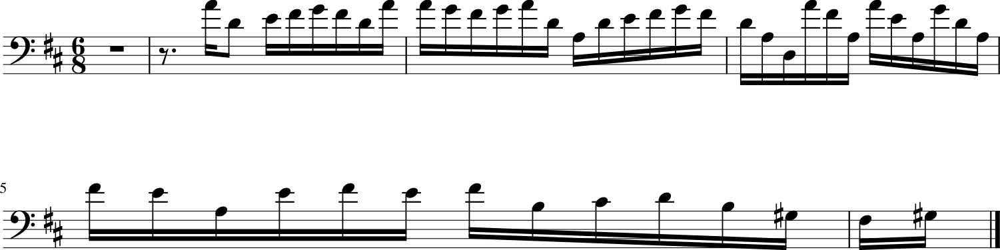

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4593 - loss: 1.0704 - note_outputs_loss: 0.6111
Epoch 902/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4698 - loss: 1.0766 - note_outputs_loss: 0.6068
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


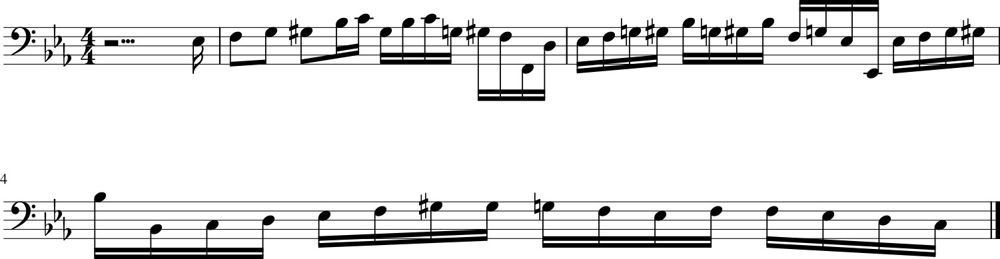

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4703 - loss: 1.0773 - note_outputs_loss: 0.6070
Epoch 903/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - duration_outputs_loss: 0.5017 - loss: 1.1104 - note_outputs_loss: 0.6087
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


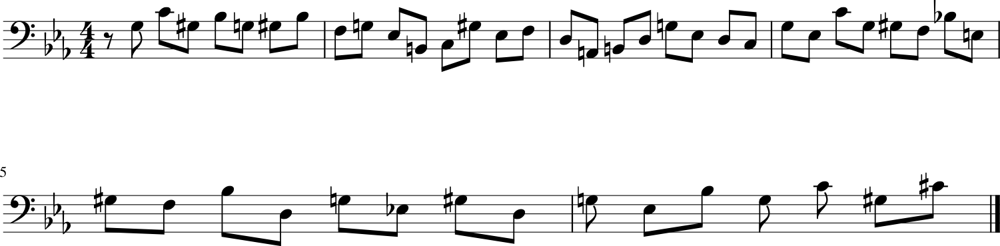

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5018 - loss: 1.1108 - note_outputs_loss: 0.6090
Epoch 904/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5024 - loss: 1.1252 - note_outputs_loss: 0.6227
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'E4', 'B4', 'F#4', 'E4', 'A4', 'G4', 'E4', 'B4', 'F#4', 'E4', 'A4', 'G4', 'E4', 'B4', 'F#4', 'E4', 'A4'], ['0.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


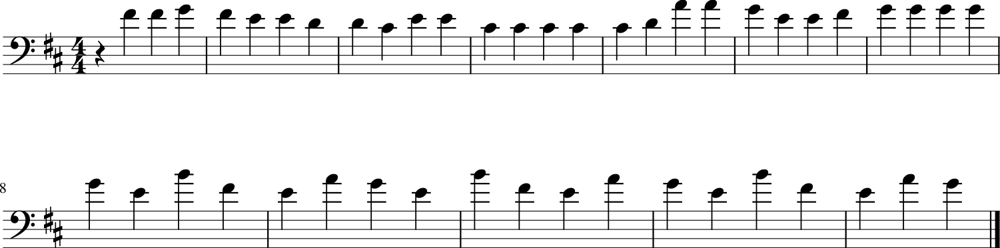

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5026 - loss: 1.1254 - note_outputs_loss: 0.6228
Epoch 905/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5085 - loss: 1.1510 - note_outputs_loss: 0.6425
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'E-3', 'G3', 'B-3', 'D3', 'E-3', 'E-3', 'G3', 'C4', 'D3', 'E-3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'E-3', 'G3', 'B-3', 'E-4', 'B-3', 'G3', 'E-3', 'E-3', 'F#3', 'C4', 'F3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


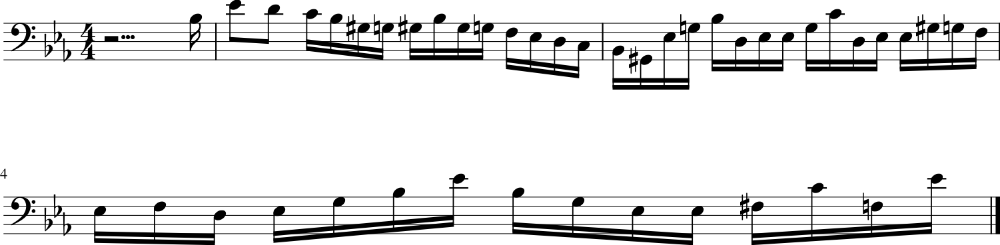

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5086 - loss: 1.1511 - note_outputs_loss: 0.6424
Epoch 906/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5330 - loss: 1.1374 - note_outputs_loss: 0.6044
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


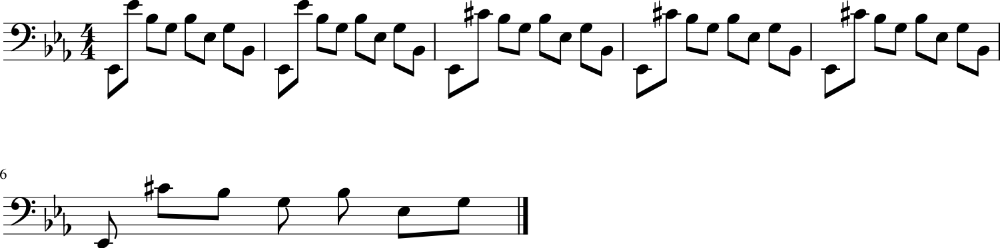

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5329 - loss: 1.1377 - note_outputs_loss: 0.6047
Epoch 907/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4885 - loss: 1.0969 - note_outputs_loss: 0.6084
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'E-4', 'C4', 'G3', 'C4', 'E-3', 'G3', 'C3', 'C2', 'E-4', 'C4', 'G3', 'C4', 'E-3', 'G3', 'C3', 'C2', 'E-4', 'C4', 'G3', 'C4', 'E-3', 'G3', 'C3', 'C2', 'E-4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


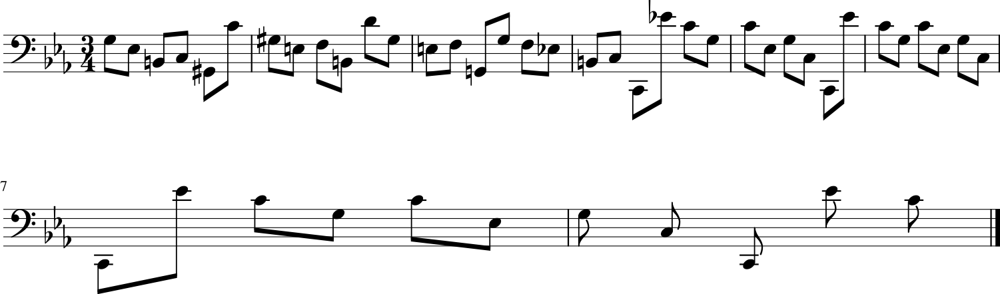

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4888 - loss: 1.0974 - note_outputs_loss: 0.6087
Epoch 908/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5073 - loss: 1.1207 - note_outputs_loss: 0.6134
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


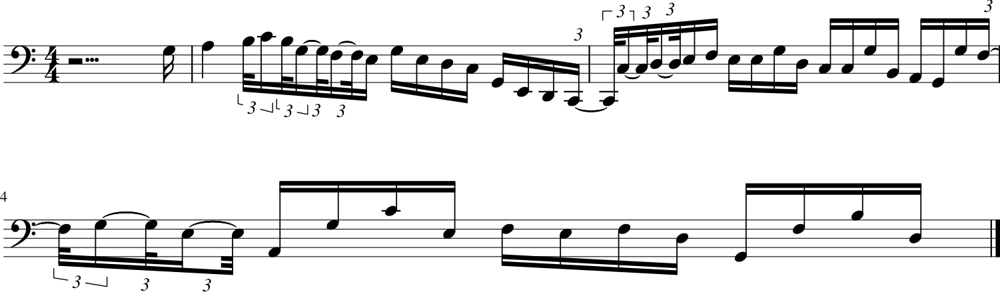

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5074 - loss: 1.1210 - note_outputs_loss: 0.6136
Epoch 909/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5155 - loss: 1.1333 - note_outputs_loss: 0.6179
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '0.0', '3.0', '3.75', '0.25', '1.0', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/6']]


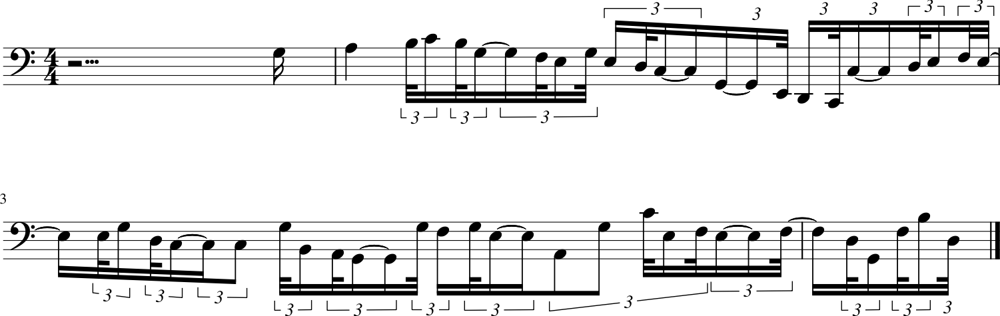

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5155 - loss: 1.1335 - note_outputs_loss: 0.6180
Epoch 910/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5268 - loss: 1.1345 - note_outputs_loss: 0.6077
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'A2', 'B2', 'F3', 'E3', 'C2', 'F#3', 'C2', 'G3', 'C2', 'A3', 'G2', 'B3', 'G2', 'C4', 'G2', 'D4', 'G2', 'E4', 'G2', 'F#4', 'C4', 'F#4', 'C4', 'D4', 'F#4', 'G4', 'B3', 'A3', 'G4', 'F#4', 'D3', 'B3', 'D4', 'E4', 'G3', 'F#3', 'E4', 'D4', 'B2'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


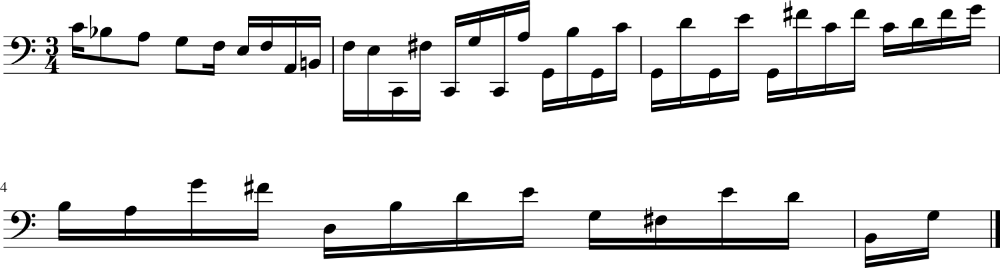

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5268 - loss: 1.1348 - note_outputs_loss: 0.6080
Epoch 911/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5274 - loss: 1.1758 - note_outputs_loss: 0.6484
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'G3', 'C4', 'A3', 'F#3', 'D4', 'B3', 'A3', 'A2', 'F#3', 'C4', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'F#3', 'E3', 'F#3', 'E-3', 'D3', 'F3', 'A3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3'], ['0.0', '0.0', '2.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


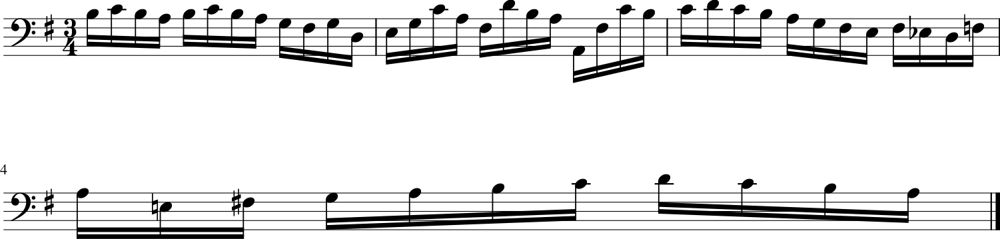

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5273 - loss: 1.1757 - note_outputs_loss: 0.6484
Epoch 912/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5038 - loss: 1.1345 - note_outputs_loss: 0.6307
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'B3', 'A3', 'G3', 'F3', 'E3', 'F3', 'D4', 'E3', 'C3', 'C4', 'A2', 'B2', 'C3', 'D2', 'C4', 'B3', 'C4', 'D4', 'B3', 'C4', 'A3', 'G#3', 'E3', 'B3', 'G#3', 'F#3', 'G#3', 'A3', 'B3', 'G#3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


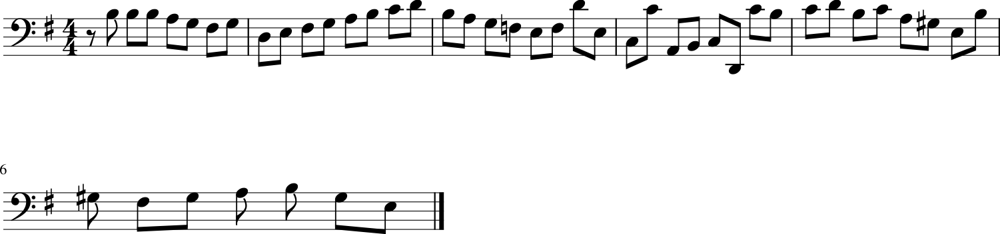

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5039 - loss: 1.1347 - note_outputs_loss: 0.6308
Epoch 913/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5250 - loss: 1.1518 - note_outputs_loss: 0.6268
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'E3', 'F3', 'G3', 'C3', 'B2', 'C3', 'C4', 'B3', 'A3', 'B3', 'G3', 'D3', 'E3', 'F3', 'B2', 'A2', 'B2', 'G3', 'F3', 'E3', 'D3', 'E3', 'C3', 'C4', 'B3', 'A3', 'B3', 'C4', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'A3', 'G3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'E-2', 'C4', 'B3', 'A3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


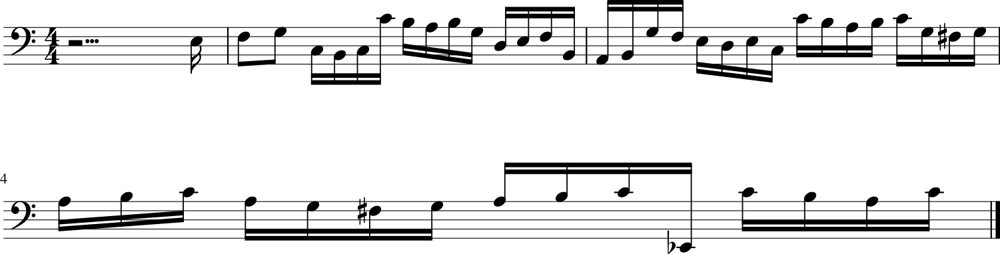

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5249 - loss: 1.1518 - note_outputs_loss: 0.6269
Epoch 914/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4840 - loss: 1.1017 - note_outputs_loss: 0.6177
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'A3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'F4', 'D4', 'E4', 'F4', 'E4', 'D4', 'C#4', 'D4', 'B-3', 'D4', 'A3', 'D4', 'F4', 'E-4', 'C4', 'E-4', 'A3', 'D4', 'B-3', 'D4', 'G3', 'E-3', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


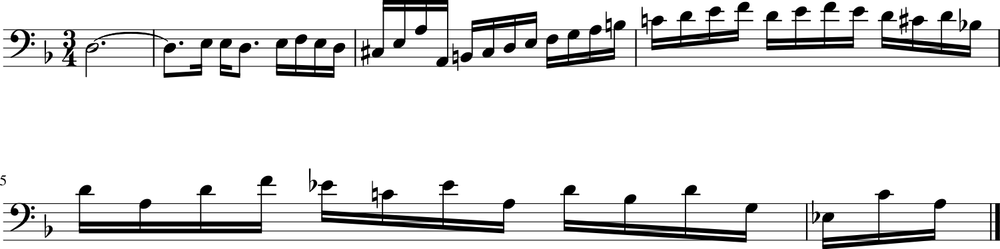

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4844 - loss: 1.1022 - note_outputs_loss: 0.6178
Epoch 915/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5455 - loss: 1.1504 - note_outputs_loss: 0.6049
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'G3', 'A3', 'C3', 'B-2', 'A2', 'B-2', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


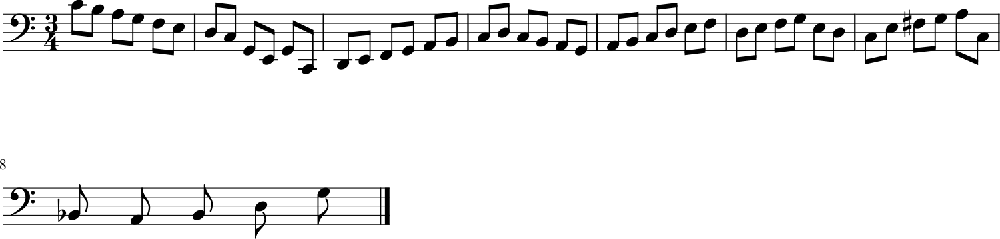

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5452 - loss: 1.1505 - note_outputs_loss: 0.6052
Epoch 916/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5620 - loss: 1.1690 - note_outputs_loss: 0.6070
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'D3', 'C4'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


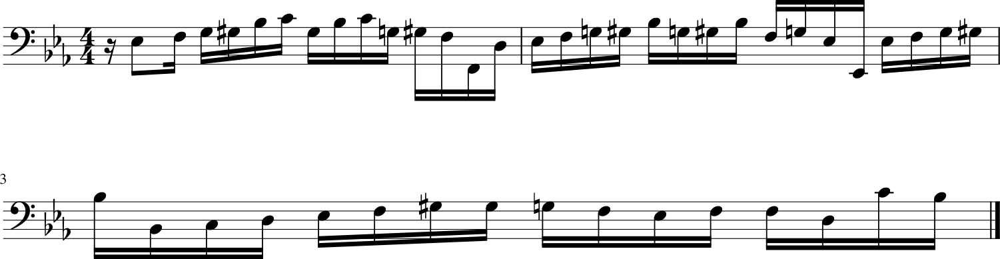

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5616 - loss: 1.1689 - note_outputs_loss: 0.6073
Epoch 917/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5283 - loss: 1.1462 - note_outputs_loss: 0.6178
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


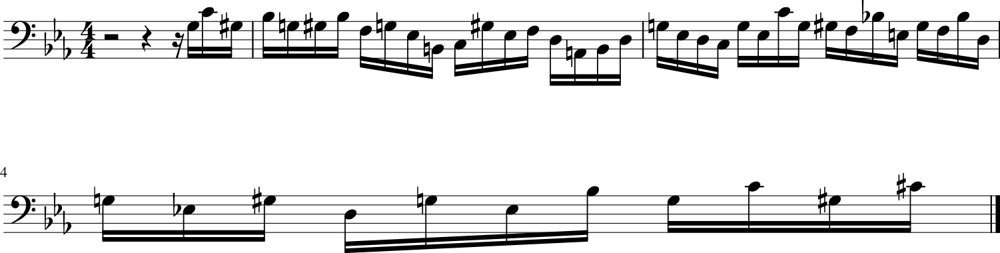

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5283 - loss: 1.1462 - note_outputs_loss: 0.6180
Epoch 918/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4971 - loss: 1.1155 - note_outputs_loss: 0.6184
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '1.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


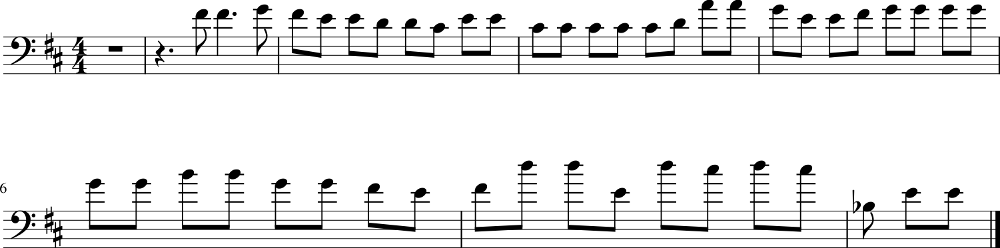

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4974 - loss: 1.1159 - note_outputs_loss: 0.6185
Epoch 919/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5568 - loss: 1.1606 - note_outputs_loss: 0.6038
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'D3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'F3', 'F3', 'F3', 'G3', 'G#3', 'B-3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'C4', 'G#3', 'F3', 'D4', 'E-4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'F3', 'G3', 'G#3', 'B-3', 'C4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


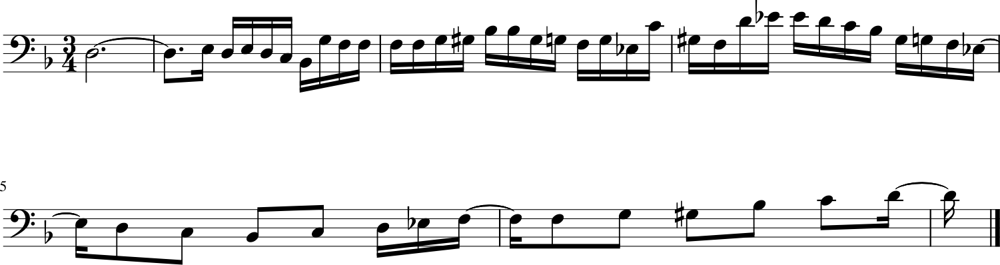

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5565 - loss: 1.1605 - note_outputs_loss: 0.6040
Epoch 920/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4875 - loss: 1.1048 - note_outputs_loss: 0.6173
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'C3', 'A2', 'C#3', 'E3', 'F3', 'E3', 'D3', 'B2', 'A2', 'B2', 'C3', 'A2', 'D3', 'G2', 'B3', 'C4', 'D3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


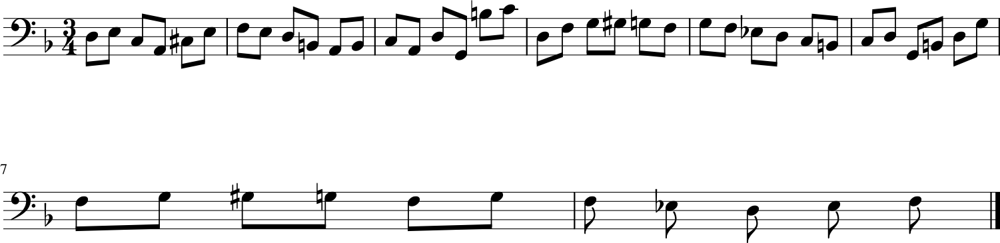

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4878 - loss: 1.1052 - note_outputs_loss: 0.6174
Epoch 921/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5599 - loss: 1.1808 - note_outputs_loss: 0.6209
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'G3', 'B-3', 'C#4', 'E4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'F3', 'D3', 'C3', 'B-2', 'A2', 'B-2', 'D3', 'B-2', 'E3', 'F3', 'D3', 'B-2', 'G3', 'B-2', 'B-3', 'B-3', 'A3', 'G#2', 'E-3'], ['0.0', '0.0', '0.0', '2.0', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


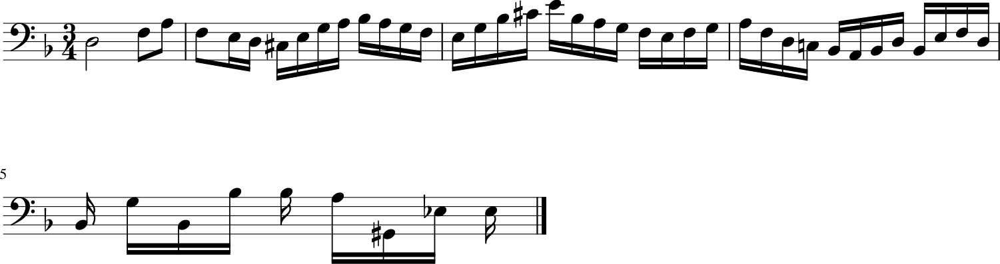

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5595 - loss: 1.1806 - note_outputs_loss: 0.6210
Epoch 922/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5262 - loss: 1.1456 - note_outputs_loss: 0.6193
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'D3', 'C4', 'B-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


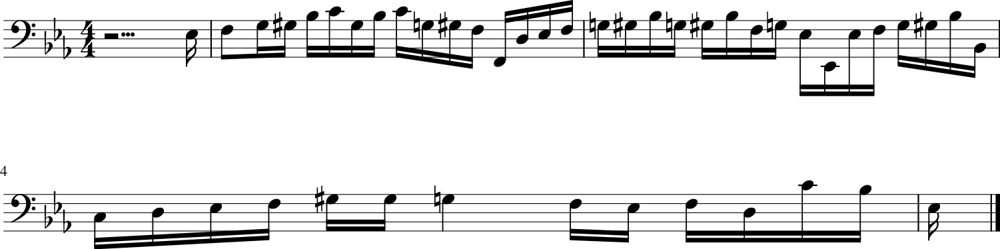

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5262 - loss: 1.1457 - note_outputs_loss: 0.6195
Epoch 923/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4877 - loss: 1.1014 - note_outputs_loss: 0.6137
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


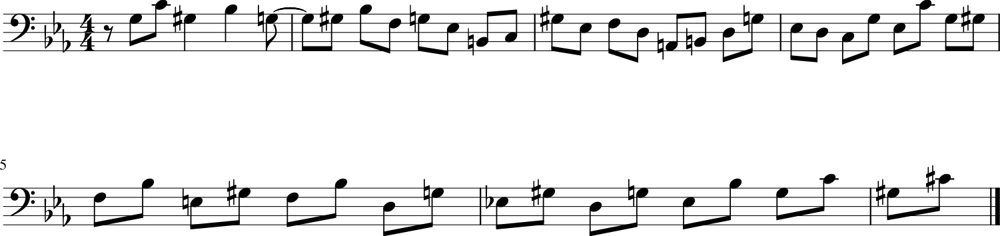

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4880 - loss: 1.1019 - note_outputs_loss: 0.6139
Epoch 924/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5526 - loss: 1.1819 - note_outputs_loss: 0.6293
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


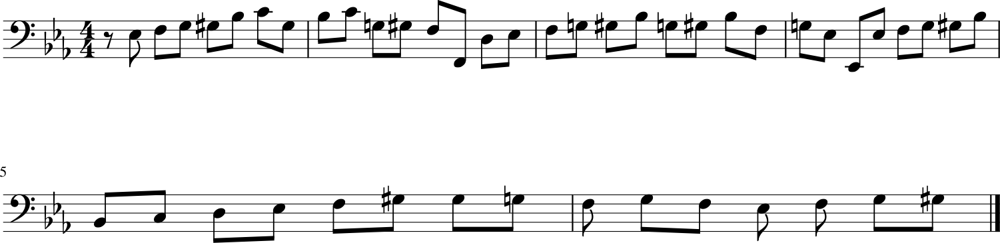

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5523 - loss: 1.1817 - note_outputs_loss: 0.6294
Epoch 925/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5240 - loss: 1.1226 - note_outputs_loss: 0.5986
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E-3', 'B-3', 'G3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1/3', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


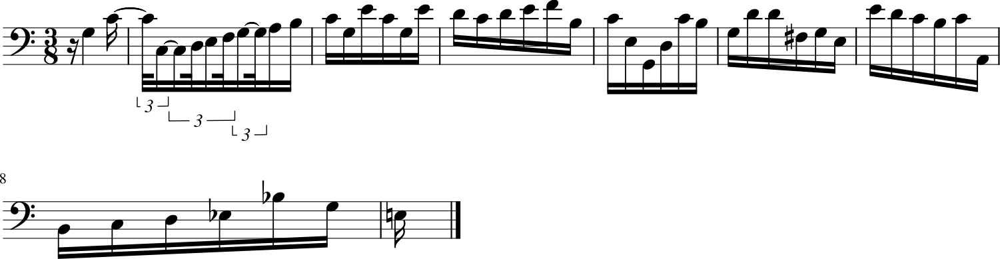

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5239 - loss: 1.1228 - note_outputs_loss: 0.5989
Epoch 926/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5281 - loss: 1.1542 - note_outputs_loss: 0.6260
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'E-3', 'B-2', 'C3', 'G#2', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'G3', 'F3', 'E3', 'F3', 'G3', 'G#3', 'F3', 'G3', 'C4', 'G3', 'B-3', 'G#3', 'B-3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'G3', 'F3', 'E3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'C4', 'B-3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '1.5', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


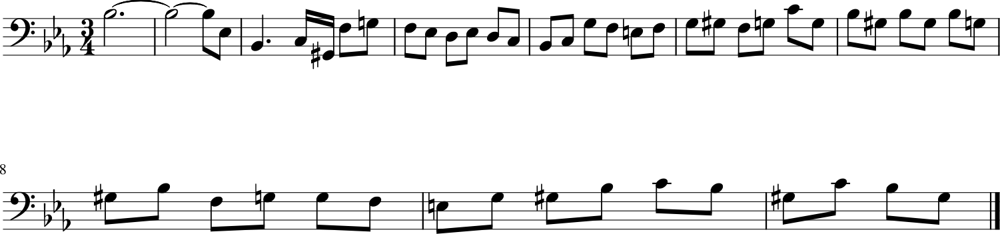

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5281 - loss: 1.1542 - note_outputs_loss: 0.6261
Epoch 927/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5029 - loss: 1.1207 - note_outputs_loss: 0.6178
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-2', 'B-2', 'C3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


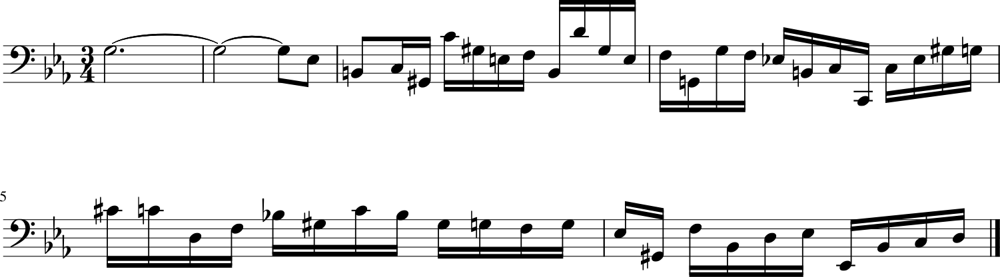

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5030 - loss: 1.1210 - note_outputs_loss: 0.6179
Epoch 928/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5768 - loss: 1.1780 - note_outputs_loss: 0.6012
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'E-3', 'E-3', 'C3', 'D3', 'F3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'C#4', 'C#4', 'B-3', 'C4', 'E4', 'G4', 'B-3', 'A3', 'G3', 'F3', 'E-3', 'B-3', 'D4', 'F4', 'A3', 'B-3', 'B-3', 'D4', 'G4', 'A3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


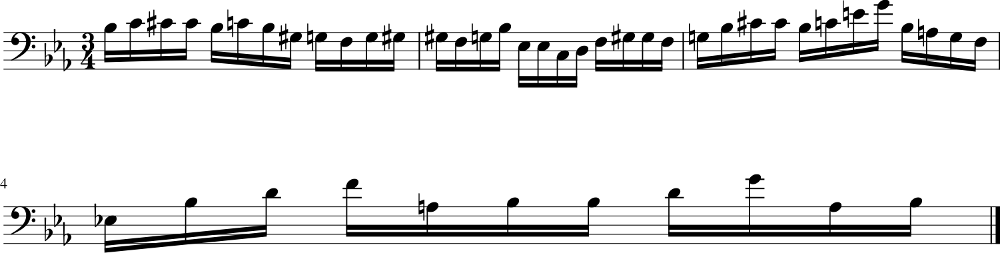

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5763 - loss: 1.1778 - note_outputs_loss: 0.6015
Epoch 929/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5829 - loss: 1.2046 - note_outputs_loss: 0.6217
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'B-2', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


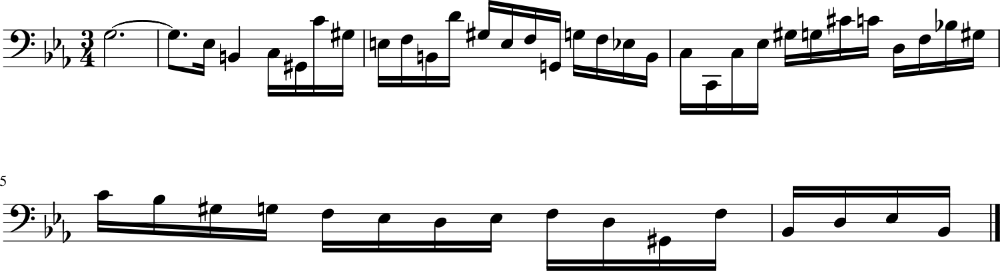

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5823 - loss: 1.2042 - note_outputs_loss: 0.6218
Epoch 930/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5189 - loss: 1.1307 - note_outputs_loss: 0.6118
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'G#2', 'F3', 'B-2', 'D3', 'E-3', 'E-2', 'B-2', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


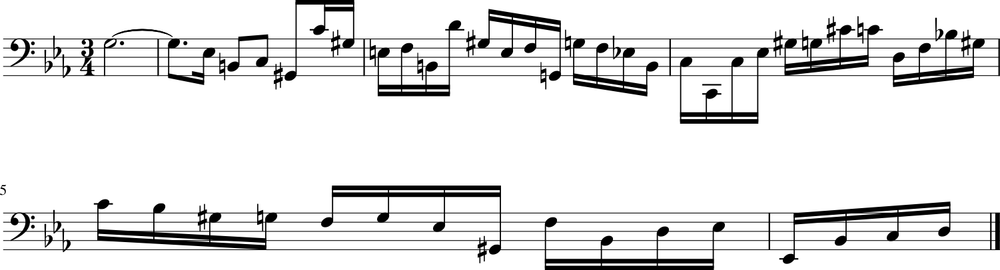

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5189 - loss: 1.1309 - note_outputs_loss: 0.6120
Epoch 931/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5012 - loss: 1.0980 - note_outputs_loss: 0.5969
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


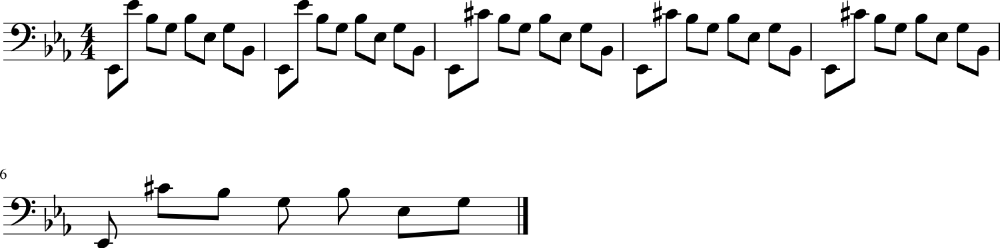

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5014 - loss: 1.0985 - note_outputs_loss: 0.5972
Epoch 932/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5065 - loss: 1.1124 - note_outputs_loss: 0.6060
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'C#3', 'G#2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'G2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G2', 'F2', 'G#3', 'D3', 'B2', 'D3', 'G#2'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


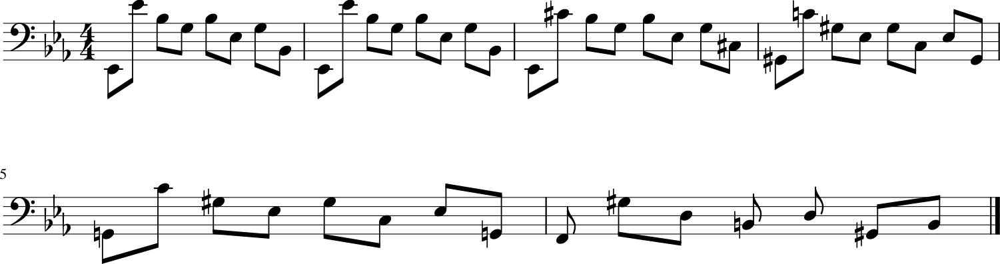

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5066 - loss: 1.1128 - note_outputs_loss: 0.6062
Epoch 933/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5316 - loss: 1.1533 - note_outputs_loss: 0.6217
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'E-3', 'E-3', 'C3', 'D3', 'F3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'C#4', 'C#4', 'B-3', 'F3', 'G3', 'B-3', 'G3', 'C#4', 'G3', 'C#4', 'G3', 'C#4', 'G#2', 'C4', 'G#3', 'C4', 'G#3', 'B-3', 'G#3', 'C3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


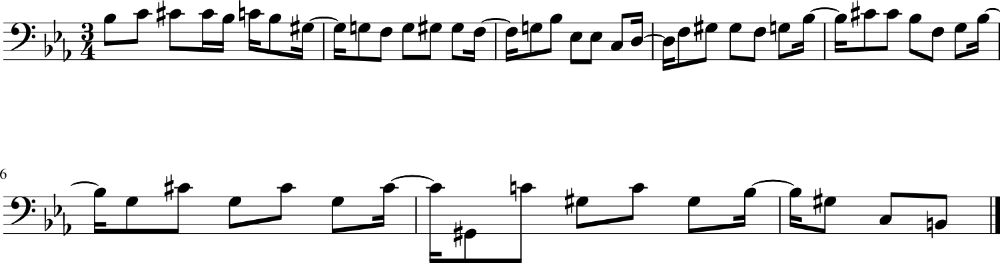

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5315 - loss: 1.1532 - note_outputs_loss: 0.6217
Epoch 934/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5701 - loss: 1.1732 - note_outputs_loss: 0.6031
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'E-3', 'C3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


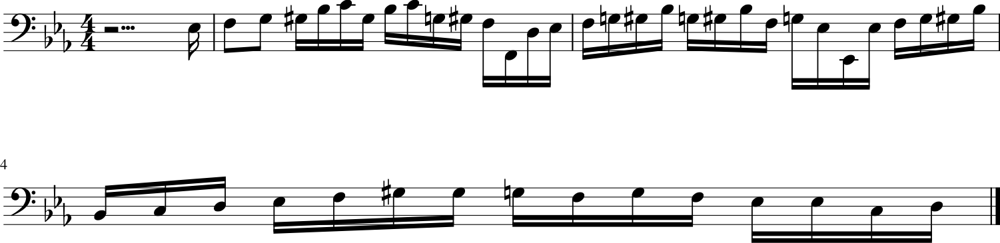

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5697 - loss: 1.1731 - note_outputs_loss: 0.6034
Epoch 935/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5121 - loss: 1.1175 - note_outputs_loss: 0.6054
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'C#4', 'D4', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3', 'E-3', 'G#2', 'E-2', 'C4', 'G#3', 'E-3', 'G#3', 'C3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


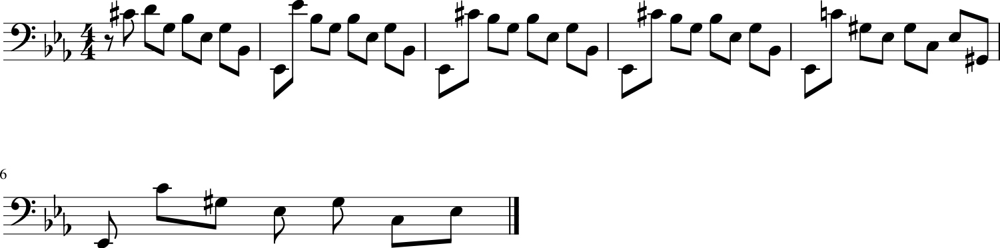

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5122 - loss: 1.1178 - note_outputs_loss: 0.6056
Epoch 936/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5583 - loss: 1.1775 - note_outputs_loss: 0.6193
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


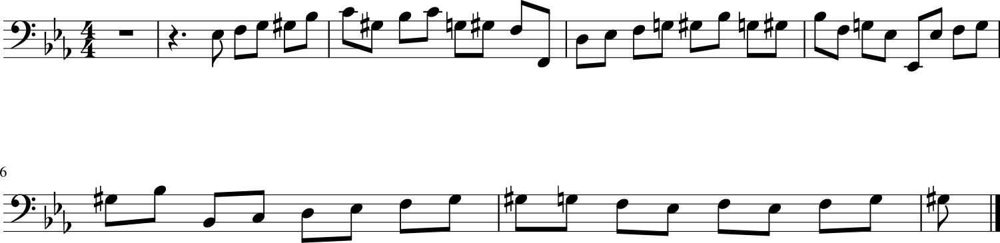

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5579 - loss: 1.1774 - note_outputs_loss: 0.6194
Epoch 937/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5456 - loss: 1.1752 - note_outputs_loss: 0.6296
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'A3', 'C4', 'A3', 'D3', 'G2', 'B3', 'A3', 'B3', 'D3', 'G2', 'G3', 'A3', 'B3', 'G3', 'G2', 'F3', 'E3', 'G3', 'C4', 'E3', 'D3', 'F4', 'E4', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'B3', 'C4', 'D4', 'B3', 'G3', 'F#3', 'G3', 'E3', 'D3', 'C3', 'B2', 'C3', 'D3', 'E3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


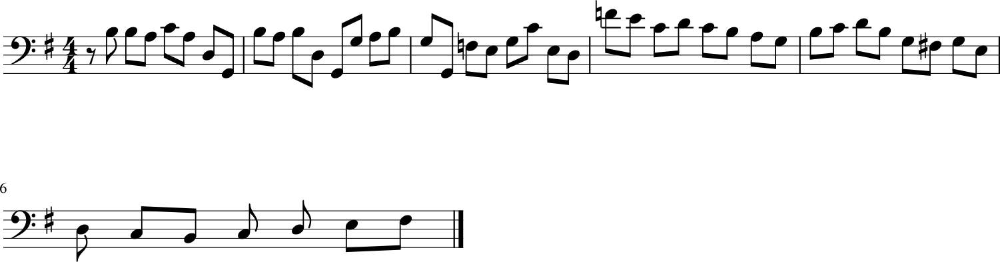

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5454 - loss: 1.1751 - note_outputs_loss: 0.6297
Epoch 938/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5150 - loss: 1.1391 - note_outputs_loss: 0.6240
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-3', 'F3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'E-3', 'E-3', 'C3', 'D3', 'C3', 'D3', 'B-2', 'D3', 'G#2', 'G2', 'B-2', 'E-3', 'G3', 'B-3', 'D3', 'C3', 'B-2', 'C3', 'G#2', 'C3', 'G2', 'F2', 'G#2', 'D3', 'F3', 'G#3', 'C3', 'B2'], ['0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12']]


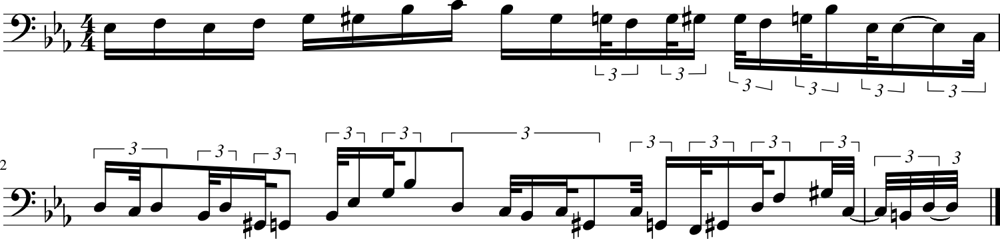

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5151 - loss: 1.1392 - note_outputs_loss: 0.6242
Epoch 939/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5308 - loss: 1.1448 - note_outputs_loss: 0.6140
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C#2', 'A2', 'E3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'C#2', 'A2', 'E3', 'F#3', 'G3', 'E3', 'F#3', 'G3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


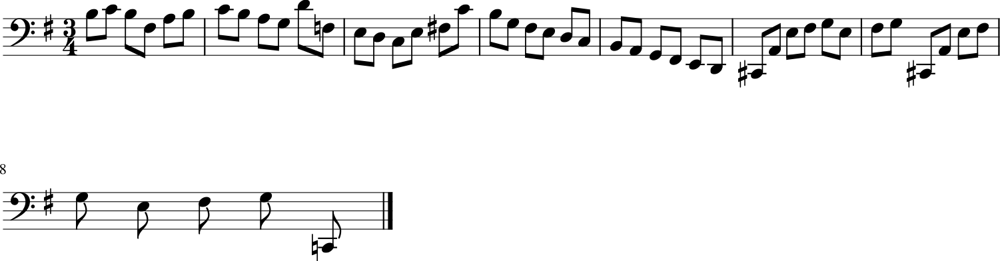

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5307 - loss: 1.1449 - note_outputs_loss: 0.6142
Epoch 940/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5483 - loss: 1.1722 - note_outputs_loss: 0.6238
Generation prompt: [['START', 'E-:major'], ['0.0', '2.5']]


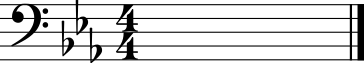

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5481 - loss: 1.1720 - note_outputs_loss: 0.6239
Epoch 941/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5287 - loss: 1.1333 - note_outputs_loss: 0.6046
Generation prompt: [['START', 'E-:major'], ['0.0', '3.0']]


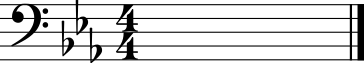

107/107 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - duration_outputs_loss: 0.5287 - loss: 1.1334 - note_outputs_loss: 0.6048
Epoch 942/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5058 - loss: 1.1337 - note_outputs_loss: 0.6278
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'D3', 'G3', 'D3', 'B2', 'G2', 'D3', 'G3', 'A3', 'B3', 'A3', 'A3', 'B3', 'C4', 'B3', 'B3', 'A3', 'A3', 'B3', 'F#3', 'G3', 'G3', 'E3', 'G3', 'A3', 'E3', 'F#3', 'F#3', 'D3', 'F#3', 'G3', 'B3', 'G3', 'E3', 'B2', 'D3', 'C#3', 'E3', 'A3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


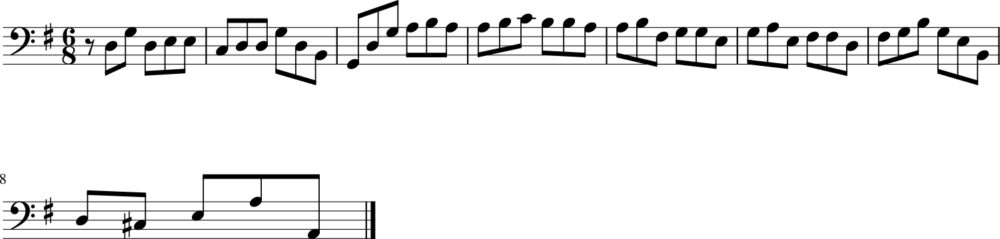

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5060 - loss: 1.1339 - note_outputs_loss: 0.6279
Epoch 943/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5320 - loss: 1.1464 - note_outputs_loss: 0.6144
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'A3', 'F#3', 'D3', 'C3', 'B2', 'G2', 'B2', 'D3', 'G3', 'A3', 'B3', 'G3', 'E3', 'D3', 'C3', 'E3', 'A3', 'C4', 'F#3', 'A3', 'C4', 'E4', 'D4'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


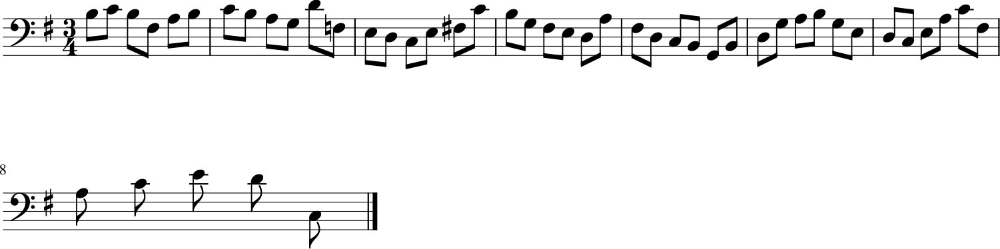

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5318 - loss: 1.1464 - note_outputs_loss: 0.6146
Epoch 944/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5583 - loss: 1.1875 - note_outputs_loss: 0.6293
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'D3', 'E-3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '1/12', '1/6', '1/3', '1/3', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12']]


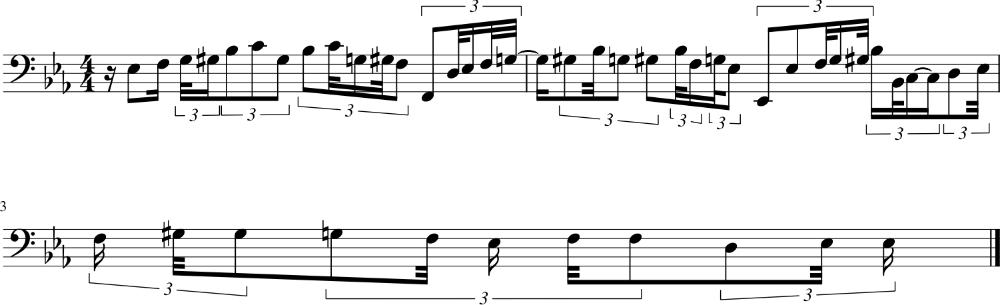

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5579 - loss: 1.1872 - note_outputs_loss: 0.6292
Epoch 945/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5427 - loss: 1.1298 - note_outputs_loss: 0.5871
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'D3', 'E3', 'F3', 'G3', 'E3', 'D3', 'C3', 'E3', 'A3', 'C4', 'A3', 'F3', 'D3', 'C4', 'B3', 'A3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


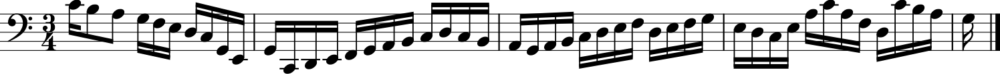

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5425 - loss: 1.1300 - note_outputs_loss: 0.5875
Epoch 946/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5458 - loss: 1.1709 - note_outputs_loss: 0.6251
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


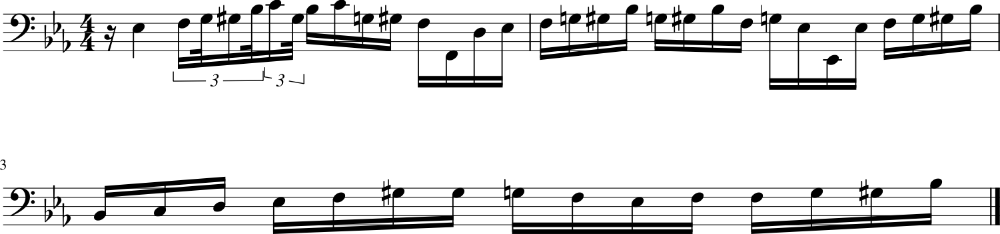

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5455 - loss: 1.1707 - note_outputs_loss: 0.6252
Epoch 947/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5023 - loss: 1.1011 - note_outputs_loss: 0.5987
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'G3', 'A3', 'F3', 'G3', 'E3', 'D3', 'C3', 'B2', 'C3', 'G2', 'E2', 'B2', 'D3', 'G3', 'B3', 'C4', 'D4', 'B3', 'G3', 'D3', 'B2', 'D3', 'F3', 'D3', 'B2', 'A2', 'B2', 'G2'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


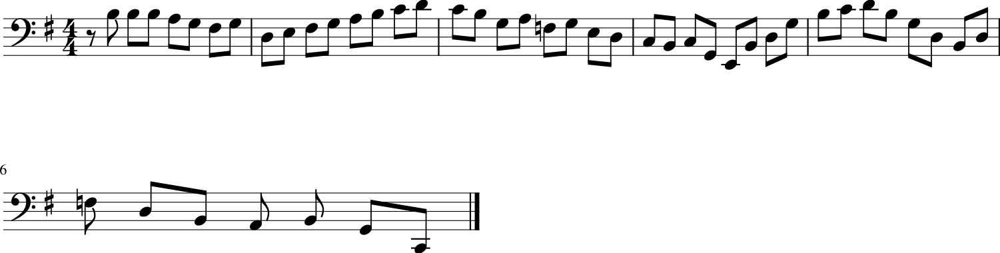

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5025 - loss: 1.1016 - note_outputs_loss: 0.5991
Epoch 948/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5019 - loss: 1.1044 - note_outputs_loss: 0.6026
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'C3', 'D3', 'B2', 'G2', 'F2', 'E2', 'G3', 'A3', 'G3', 'F#3', 'G3', 'C3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'A3', 'B3', 'A3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


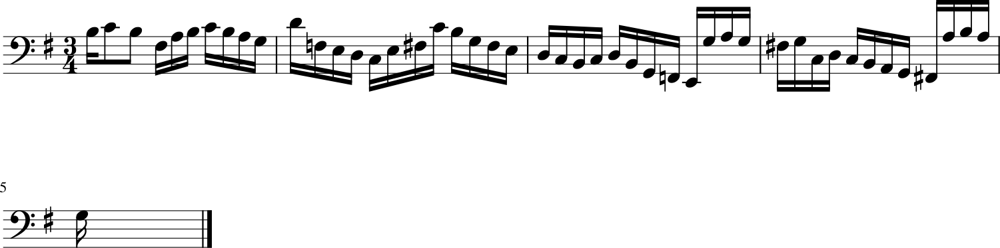

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5020 - loss: 1.1049 - note_outputs_loss: 0.6028
Epoch 949/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5534 - loss: 1.1645 - note_outputs_loss: 0.6111
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'D3', 'B2', 'A2', 'B2', 'D3', 'E2', 'F#3', 'A3', 'C4', 'D4', 'B3', 'C4', 'A3', 'A3', 'C3', 'D3', 'B3', 'E3', 'G#3', 'A3', 'D4', 'E4', 'B3', 'C4', 'F3', 'G3', 'B-3', 'B-3', 'C3', 'E2', 'B-3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


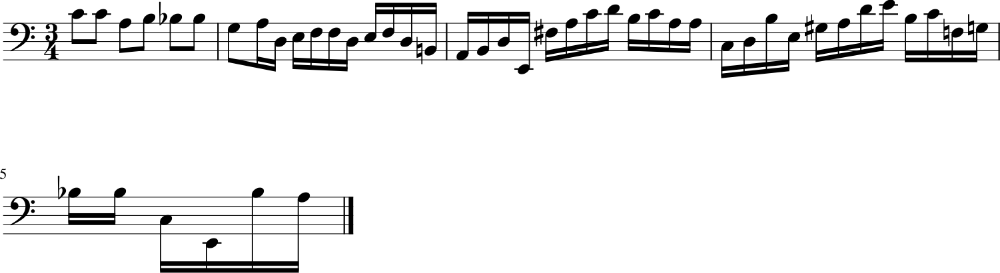

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5530 - loss: 1.1643 - note_outputs_loss: 0.6112
Epoch 950/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4799 - loss: 1.0856 - note_outputs_loss: 0.6056
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'G3', 'A2', 'B-2', 'G2', 'D3', 'E3', 'F3', 'D3', 'G3', 'E3', 'C3', 'B-2', 'A2', 'G2', 'A2', 'F2', 'E2', 'G3', 'A2', 'B2', 'C#3', 'D3', 'E3', 'G3', 'F3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


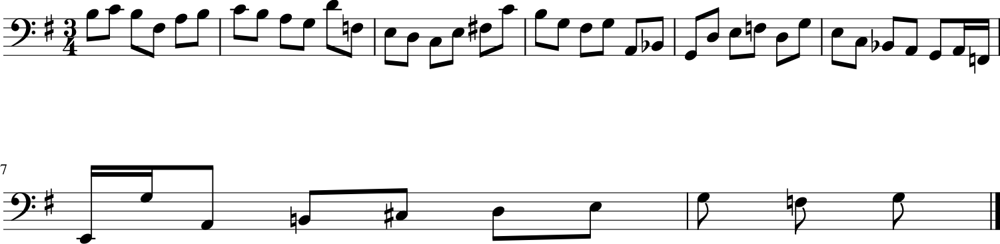

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4803 - loss: 1.0862 - note_outputs_loss: 0.6059
Epoch 951/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.6086 - loss: 1.2261 - note_outputs_loss: 0.6175
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'A4', 'A4', 'A4', 'B4', 'A4', 'G4', 'F#4', 'E4', 'F#4', 'G4', 'F#4', 'E4', 'D4', 'F#4', 'F#4', 'F#4', 'E4', 'D4', 'E4', 'F#4', 'G4', 'D4', 'C#4', 'B3', 'A3', 'A4', 'A4', 'A4', 'B4', 'A4', 'G4', 'F#4', 'E4', 'F#4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


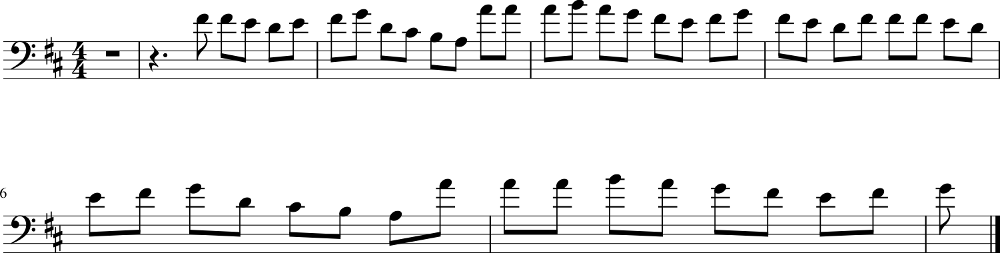

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.6078 - loss: 1.2254 - note_outputs_loss: 0.6176
Epoch 952/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5266 - loss: 1.1143 - note_outputs_loss: 0.5877
Generation prompt: [['START', 'G:major', '6/8TS', 'rest', 'D3', 'G3', 'D3', 'E3', 'E3', 'C3', 'D3', 'B2', 'G2', 'D3', 'B2', 'G2', 'D3', 'G2', 'G2', 'G3', 'G2', 'G2', 'G2', 'G2', 'G2', 'G2', 'G2', 'G2', 'C3', 'G2', 'D4', 'G2', 'C4', 'B-3', 'A3', 'G3', 'G#3', 'G3', 'F3', 'E3', 'B-3', 'F2', 'A3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C3'], ['0.0', '0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


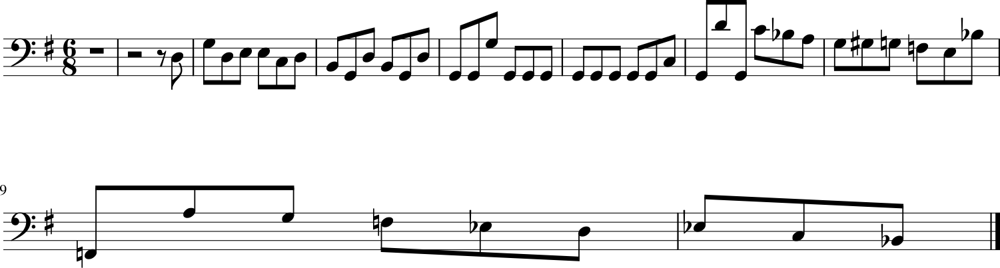

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5265 - loss: 1.1147 - note_outputs_loss: 0.5881
Epoch 953/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5234 - loss: 1.1305 - note_outputs_loss: 0.6070
Generation prompt: [['START', 'C:major', '3/4TS', 'rest', 'C4', 'C4', 'G3', 'E3', 'C3', 'G2', 'E2', 'C2', 'C4', 'D4', 'C4', 'B3', 'C4', 'D4', 'B3', 'G3', 'D3', 'B2', 'G2', 'F2', 'D4', 'C4', 'B3', 'A3', 'G3', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'F3', 'D3', 'B-3', 'A3', 'B-3', 'C4', 'D4', 'A3', 'G#3', 'A3', 'B3', 'E3', 'F3', 'D3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


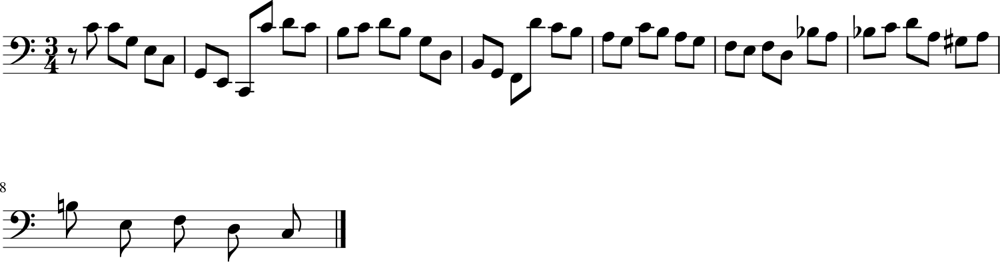

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5234 - loss: 1.1307 - note_outputs_loss: 0.6073
Epoch 954/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5056 - loss: 1.0974 - note_outputs_loss: 0.5918
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'E-3', 'E-3', 'B-2', 'C3', 'D3', 'E-2', 'G3', 'F3', 'E-3', 'F3', 'B-3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2', 'G2', 'F2', 'G2', 'E-3', 'F3', 'G3', 'D3', 'G#3', 'G3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


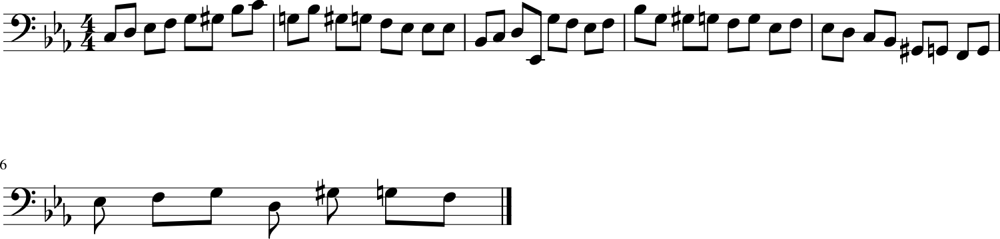

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5058 - loss: 1.0979 - note_outputs_loss: 0.5921
Epoch 955/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5282 - loss: 1.1431 - note_outputs_loss: 0.6149
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2', 'D3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


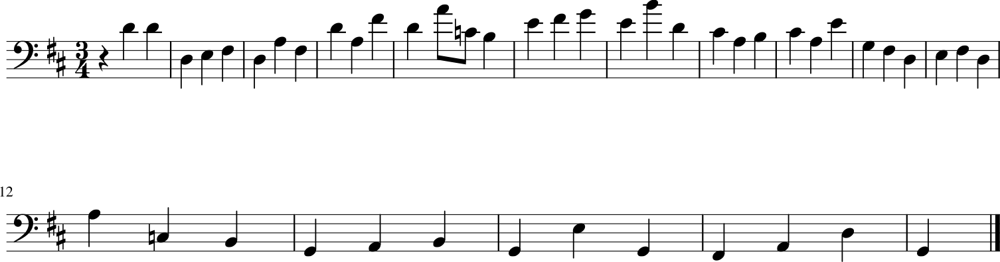

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5281 - loss: 1.1431 - note_outputs_loss: 0.6150
Epoch 956/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4967 - loss: 1.1091 - note_outputs_loss: 0.6124
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'D5', 'G4', 'F#4'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


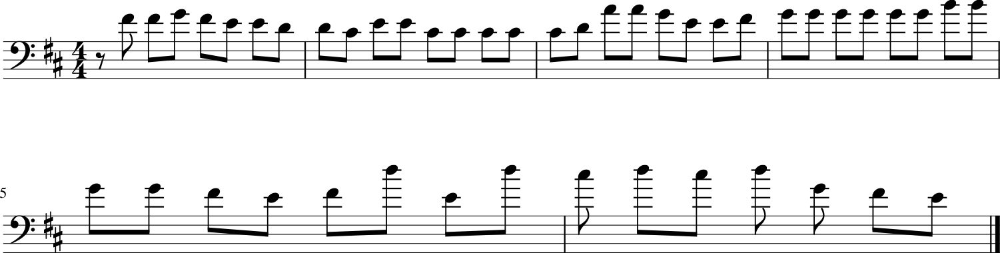

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4970 - loss: 1.1095 - note_outputs_loss: 0.6126
Epoch 957/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4973 - loss: 1.0991 - note_outputs_loss: 0.6019
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'F3', 'B-2'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


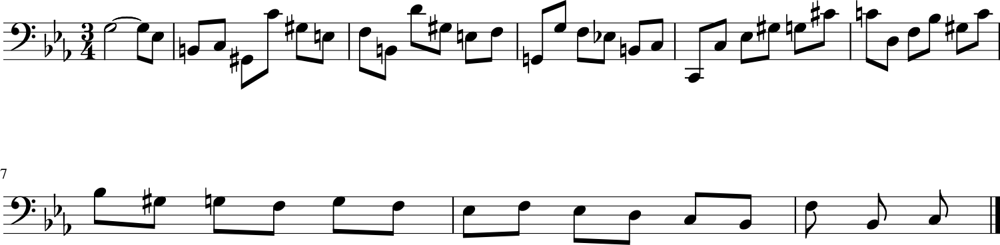

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4975 - loss: 1.0996 - note_outputs_loss: 0.6021
Epoch 958/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5509 - loss: 1.1436 - note_outputs_loss: 0.5927
Generation prompt: [['START', 'D:major', '3/4TS', 'rest', 'D4', 'D4', 'D3', 'E3', 'F#3', 'D3', 'A3', 'F#3', 'D4', 'A3', 'F#4', 'D4', 'A4', 'C4', 'B3', 'E4', 'F#4', 'G4', 'E4', 'B4', 'D4', 'C#4', 'A3', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D3', 'E3', 'F#3', 'D3', 'A3', 'C3', 'B2', 'G2', 'A2', 'B2', 'G2', 'E3', 'G2', 'F#2', 'A2', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


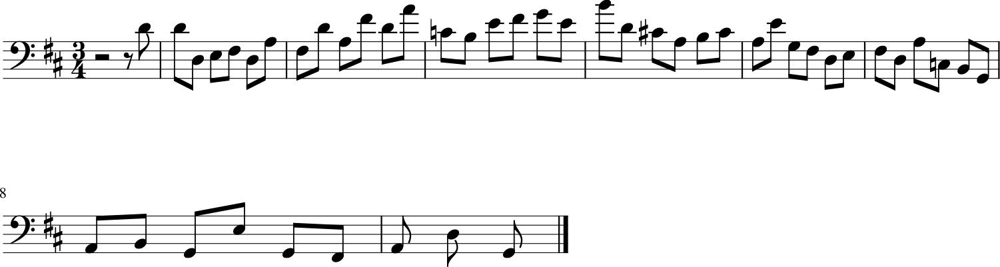

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5506 - loss: 1.1436 - note_outputs_loss: 0.5930
Epoch 959/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5473 - loss: 1.1592 - note_outputs_loss: 0.6119
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'E-3', 'E-3', 'B-2', 'C3', 'G#2', 'F2', 'D3', 'E-3', 'E-2', 'D3', 'E-3', 'F3', 'G3', 'F3', 'G3', 'A3', 'B-3', 'F3', 'G3', 'E-3', 'C3', 'A3', 'B-3', 'B-2', 'G#2', 'G2', 'E-3', 'G#2', 'B-2', 'C3', 'C3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'G2', 'G#2', 'B-2', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


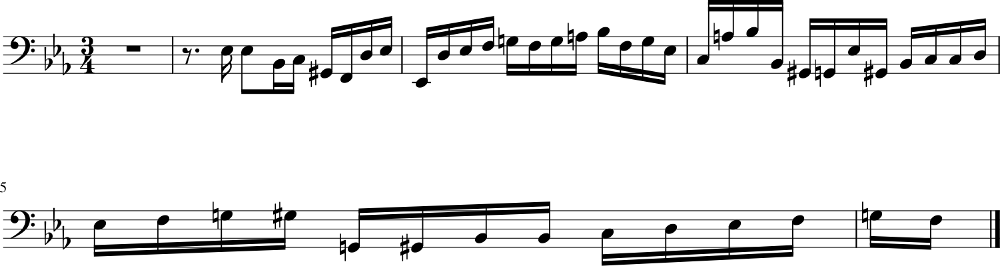

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5470 - loss: 1.1591 - note_outputs_loss: 0.6121
Epoch 960/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4992 - loss: 1.1299 - note_outputs_loss: 0.6307
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3'], ['0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


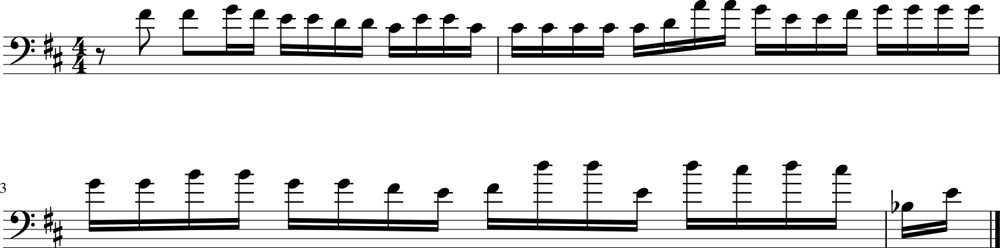

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4994 - loss: 1.1301 - note_outputs_loss: 0.6307
Epoch 961/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4990 - loss: 1.1111 - note_outputs_loss: 0.6121
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


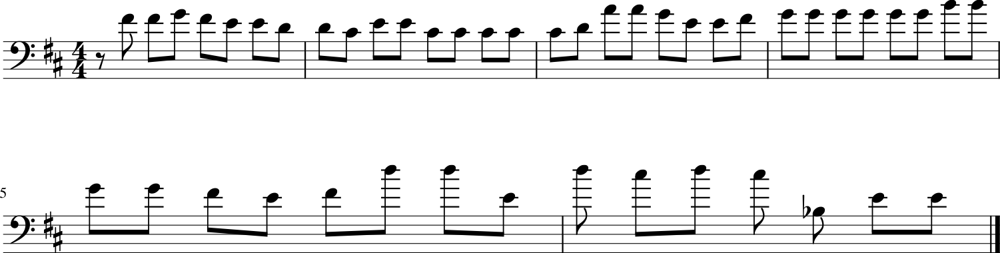

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4992 - loss: 1.1115 - note_outputs_loss: 0.6123
Epoch 962/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4873 - loss: 1.1129 - note_outputs_loss: 0.6256
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '0.0', '2.5', '0.5', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


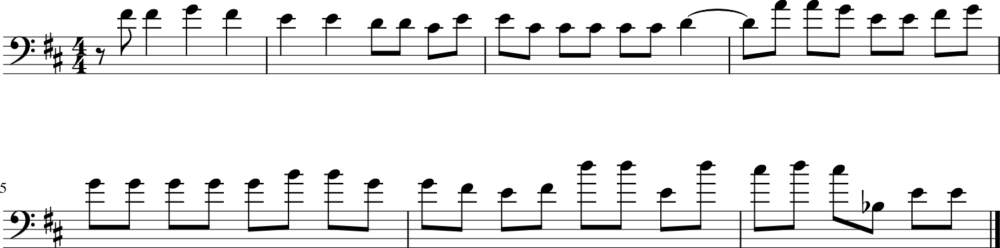

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4876 - loss: 1.1132 - note_outputs_loss: 0.6257
Epoch 963/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5046 - loss: 1.1059 - note_outputs_loss: 0.6013
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'G3', 'C4', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'B2', 'C3', 'G#3', 'E-3', 'F3', 'D3', 'A2', 'B2', 'D3', 'G3', 'E-3', 'D3', 'C3', 'G3', 'E-3', 'C4', 'G3', 'G#3', 'F3', 'B-3', 'E3', 'G#3', 'F3', 'B-3', 'D3', 'G3', 'E-3', 'G#3', 'D3', 'G3', 'E-3', 'B-3', 'G3', 'C4', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


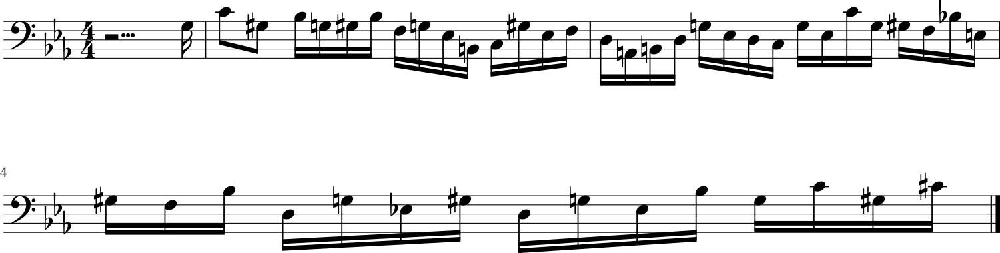

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5048 - loss: 1.1063 - note_outputs_loss: 0.6016
Epoch 964/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5354 - loss: 1.1431 - note_outputs_loss: 0.6077
Generation prompt: [['START', 'D:major', '12/8TS', 'D3', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3', 'F#3', 'D3', 'A3', 'D3', 'D3', 'D4', 'D3', 'D3', 'D3', 'D3'], ['0.0', '0.0', '0.0', '3.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '0.25', '0.25', '0.25', '0.25', '1.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


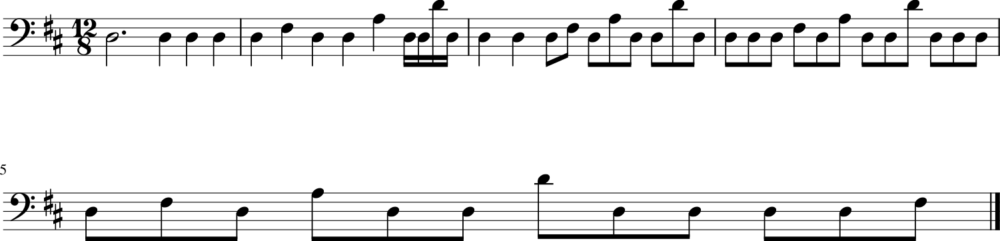

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5353 - loss: 1.1432 - note_outputs_loss: 0.6079
Epoch 965/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5533 - loss: 1.1573 - note_outputs_loss: 0.6040
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'B3', 'A3', 'G3', 'F3', 'E3', 'D3', 'C3', 'G2', 'E2', 'G2', 'C2', 'D2', 'E2', 'F2', 'G2', 'A2', 'B2', 'C3', 'D3', 'E3', 'F3', 'G3', 'E3', 'C3', 'G2', 'B2', 'C3', 'C4', 'B3', 'A3', 'G3', 'F#3', 'A3', 'D4', 'G3', 'D3', 'B2', 'B2', 'G2', 'F2', 'C2', 'G2', 'F3', 'E3', 'F3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


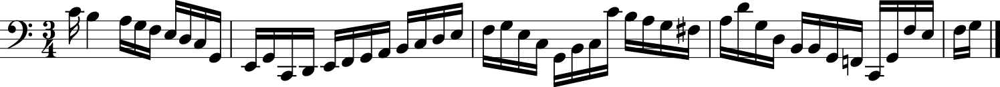

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5530 - loss: 1.1573 - note_outputs_loss: 0.6043
Epoch 966/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5290 - loss: 1.1498 - note_outputs_loss: 0.6208
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'C4', 'E-4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'F3', 'B-2', 'C3', 'D3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '1/3', '1/3', '1/12', '1/6', '1/12', '1/6', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


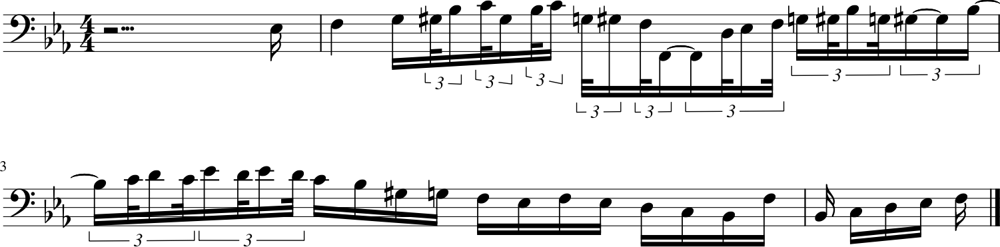

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5289 - loss: 1.1498 - note_outputs_loss: 0.6208
Epoch 967/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4833 - loss: 1.0855 - note_outputs_loss: 0.6022
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'F3', 'F3', 'F3', 'E3', 'C#4', 'C#4', 'F3', 'C#4', 'F3', 'C#4', 'G3', 'C#4', 'B-3', 'B3', 'D4', 'D4', 'G3', 'F3', 'G#3', 'G3', 'F3', 'D3', 'B3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'F3', 'F3', 'G3', 'E-3', 'F2', 'D3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


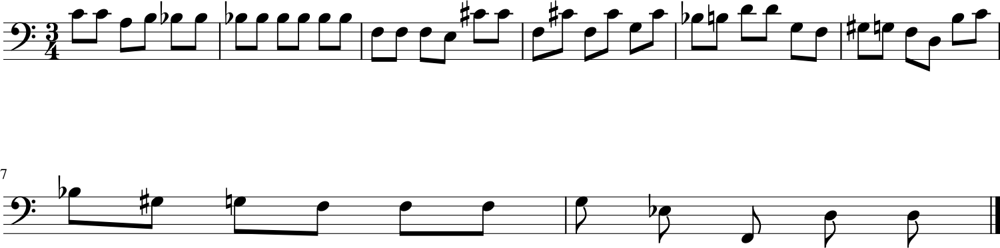

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4836 - loss: 1.0861 - note_outputs_loss: 0.6024
Epoch 968/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5910 - loss: 1.1979 - note_outputs_loss: 0.6069
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'G#3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'C3', 'E-3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'G#3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


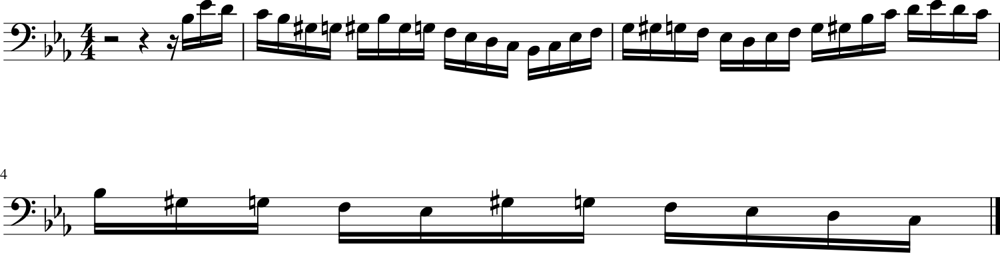

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5904 - loss: 1.1974 - note_outputs_loss: 0.6071
Epoch 969/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5260 - loss: 1.1214 - note_outputs_loss: 0.5954
Generation prompt: [['START', 'E-:major', '3/4TS', 'G3', 'E-3', 'B2', 'C3', 'G#2', 'C4', 'G#3', 'E3', 'F3', 'B2', 'D4', 'G#3', 'E3', 'F3', 'G2', 'G3', 'F3', 'E-3', 'B2', 'C3', 'C2', 'C3', 'E-3', 'G#3', 'G3', 'C#4', 'C4', 'D3', 'F3', 'B-3', 'G#3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3'], ['0.0', '0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


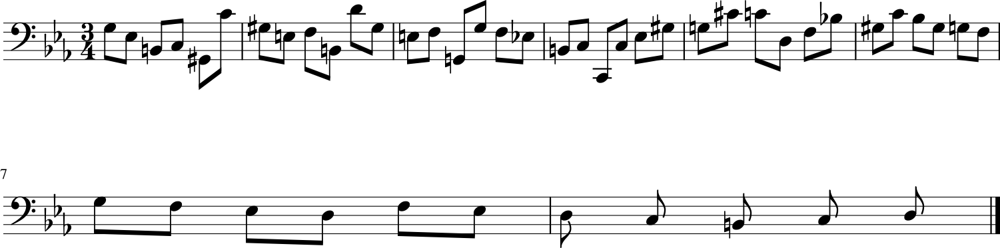

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5260 - loss: 1.1217 - note_outputs_loss: 0.5957
Epoch 970/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5278 - loss: 1.1203 - note_outputs_loss: 0.5926
Generation prompt: [['START', 'G:major', '4/4TS', 'rest', 'B3', 'B3', 'B3', 'A3', 'G3', 'F#3', 'G3', 'D3', 'E3', 'F#3', 'G3', 'A3', 'B3', 'C4', 'D4', 'C4', 'B3', 'A3', 'G3', 'A3', 'F3', 'E3', 'G3', 'C4', 'E4', 'C4', 'A3', 'F3', 'E4', 'D4', 'C4', 'B3', 'A3', 'B3', 'D4', 'B3', 'C4', 'A3', 'D4', 'B3', 'C4', 'A3', 'D4', 'B3', 'C4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


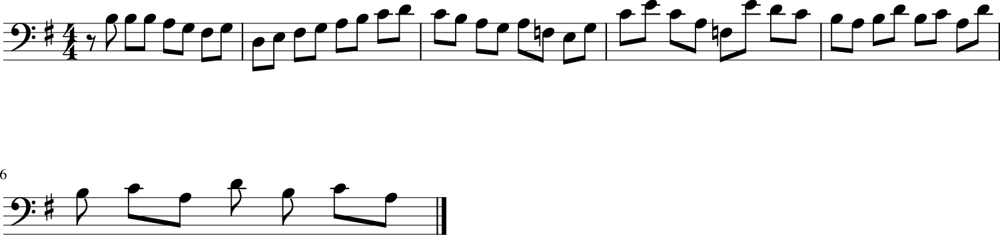

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5277 - loss: 1.1206 - note_outputs_loss: 0.5929
Epoch 971/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5164 - loss: 1.1322 - note_outputs_loss: 0.6158
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'G3', 'A2', 'B-2', 'G2', 'F#2', 'A2', 'B-2', 'C3', 'A2', 'B-2', 'D3', 'G3', 'B-3', 'G#3', 'G3', 'G#3', 'F#3', 'G3', 'E-4', 'D3', 'G3', 'F#3', 'G3', 'E-3', 'D3'], ['0.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


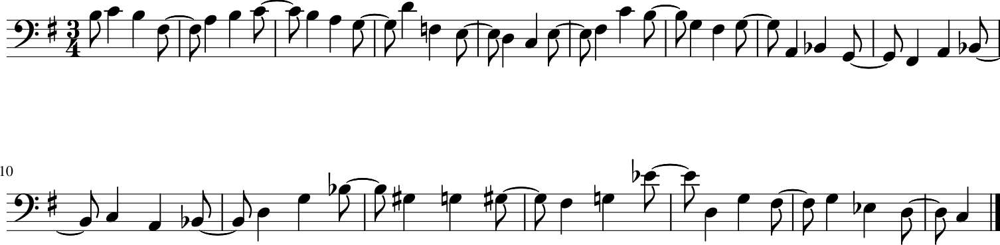

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5165 - loss: 1.1324 - note_outputs_loss: 0.6159
Epoch 972/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5573 - loss: 1.1780 - note_outputs_loss: 0.6207
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'D4', 'C4', 'C4', 'C4', 'C4', 'B-3', 'A3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


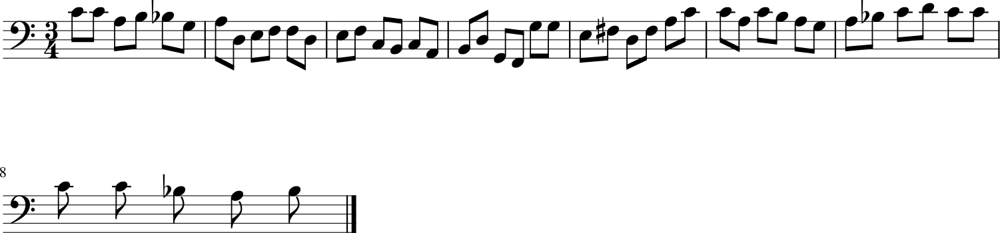

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5570 - loss: 1.1777 - note_outputs_loss: 0.6208
Epoch 973/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4955 - loss: 1.0887 - note_outputs_loss: 0.5932
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'A3', 'B-3', 'A3', 'B-3', 'A3', 'G3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3', 'A3'], ['0.0', '0.0', '0.0', '1.0', '1.0', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


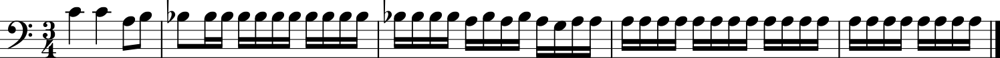

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4957 - loss: 1.0892 - note_outputs_loss: 0.5935
Epoch 974/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5085 - loss: 1.0949 - note_outputs_loss: 0.5864
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C#2', 'A2', 'E3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'C#2', 'A2', 'E3', 'F#3', 'G3', 'E3', 'F#3', 'G3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


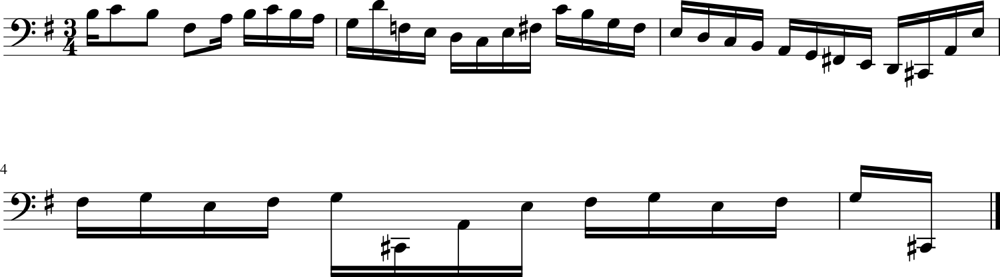

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.5087 - loss: 1.0954 - note_outputs_loss: 0.5868
Epoch 975/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5044 - loss: 1.1076 - note_outputs_loss: 0.6031
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '0.0', '0.0', '5.5', '0.5', '1.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


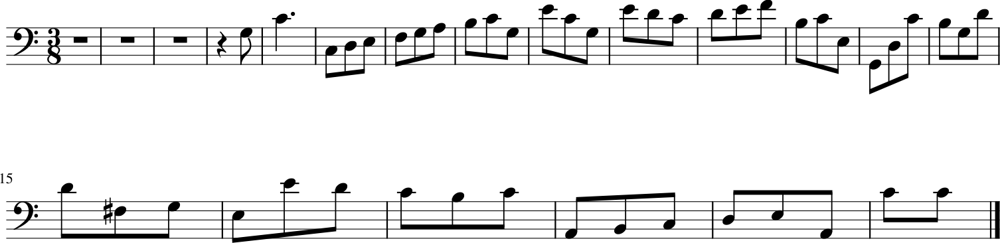

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5046 - loss: 1.1080 - note_outputs_loss: 0.6034
Epoch 976/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5404 - loss: 1.1527 - note_outputs_loss: 0.6123
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


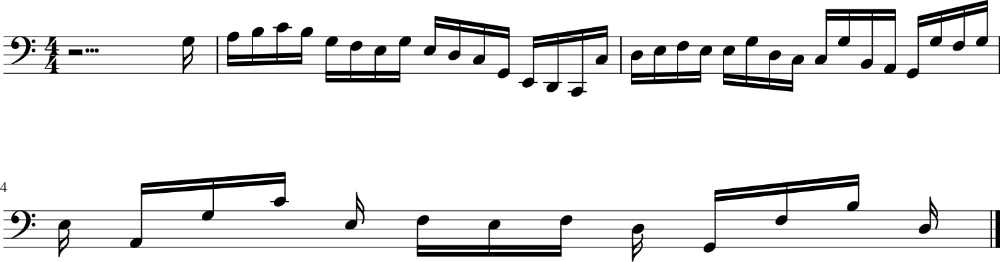

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5402 - loss: 1.1527 - note_outputs_loss: 0.6125
Epoch 977/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5178 - loss: 1.1153 - note_outputs_loss: 0.5975
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'F2', 'E2', 'D2', 'F2', 'A2', 'D3', 'F3', 'A3', 'D4', 'C4', 'F3', 'D4', 'E3', 'B-3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'F3', 'A3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


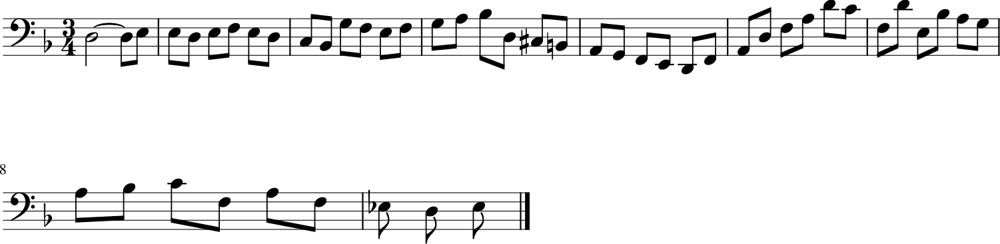

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - duration_outputs_loss: 0.5178 - loss: 1.1156 - note_outputs_loss: 0.5978
Epoch 978/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5060 - loss: 1.1057 - note_outputs_loss: 0.5997
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'E-3', 'B-3', 'F#3', 'E-3', 'B-3', 'A3', 'G3', 'A3', 'F#3', 'E-3', 'D3', 'D4', 'F#3', 'E-4', 'B-3', 'E-3', 'A3', 'G3', 'B3', 'C4', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F#3', 'G3', 'D2', 'C4', 'A3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


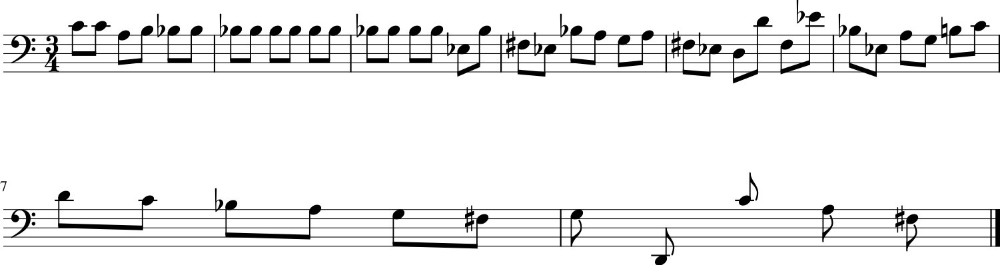

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5061 - loss: 1.1061 - note_outputs_loss: 0.6000
Epoch 979/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5481 - loss: 1.1645 - note_outputs_loss: 0.6164
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'B3', 'A3', 'G3', 'A3', 'B-3', 'C4', 'B-3', 'A3', 'B-3', 'E-4', 'F#3', 'G3'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25']]


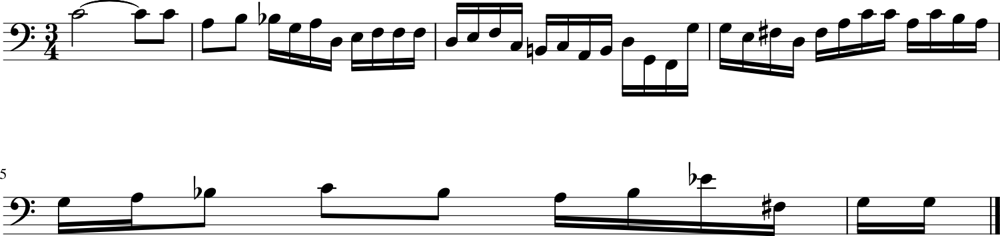

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5479 - loss: 1.1644 - note_outputs_loss: 0.6165
Epoch 980/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5473 - loss: 1.1307 - note_outputs_loss: 0.5834
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'F3', 'F3', 'F3', 'D3', 'E3', 'F3', 'C3', 'B2', 'C3', 'A2', 'B2', 'D3', 'G2', 'F2', 'G3', 'G3', 'E3', 'F#3', 'D3', 'F#3', 'A3', 'C4', 'C4', 'A3', 'C4', 'C4', 'G3', 'A3', 'B-3', 'G3', 'D3', 'B-3', 'G3', 'B-3', 'A3', 'B-3'], ['0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


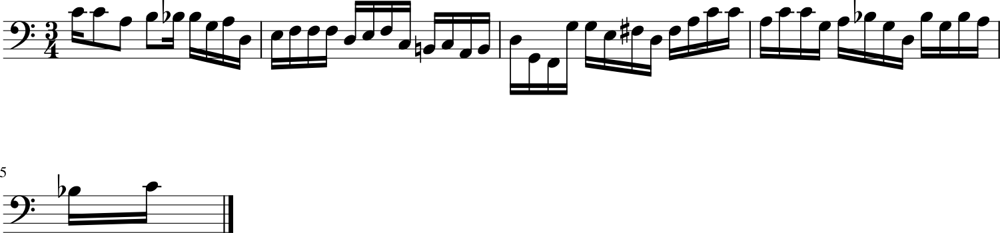

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5470 - loss: 1.1308 - note_outputs_loss: 0.5838
Epoch 981/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4838 - loss: 1.1186 - note_outputs_loss: 0.6348
Generation prompt: [['START', 'E-:major', '3/4TS', 'rest', 'B-3', 'E-4', 'D4', 'C4', 'D4', 'E-4', 'D4', 'C4', 'B3', 'C4', 'D4', 'G3', 'G#3', 'F3', 'E-3', 'D3', 'E-3', 'C4', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B2', 'C3', 'D3', 'G2', 'B2', 'D3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


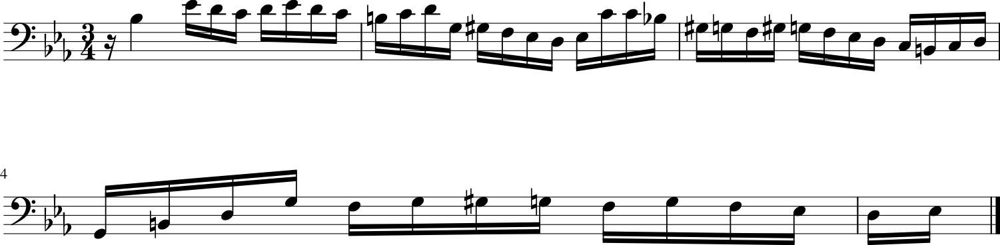

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4841 - loss: 1.1189 - note_outputs_loss: 0.6348
Epoch 982/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5300 - loss: 1.1430 - note_outputs_loss: 0.6130
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'E-3', 'E-3', 'C3', 'D3', 'F3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'E-3'], ['0.0', '0.0', '3.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


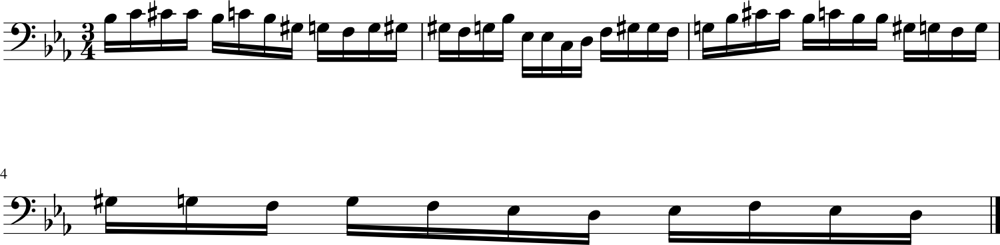

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5299 - loss: 1.1431 - note_outputs_loss: 0.6132
Epoch 983/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5213 - loss: 1.1259 - note_outputs_loss: 0.6047
Generation prompt: [['START', 'E-:major', '3/4TS', 'B-3', 'C4', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'E-3', 'E-3', 'C3', 'D3', 'F3', 'G#3', 'G#3', 'F3', 'G3', 'B-3', 'C#4', 'C#4', 'B-3', 'C4', 'B-3', 'B-3', 'G#3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'C3', 'B-2', 'G#2'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


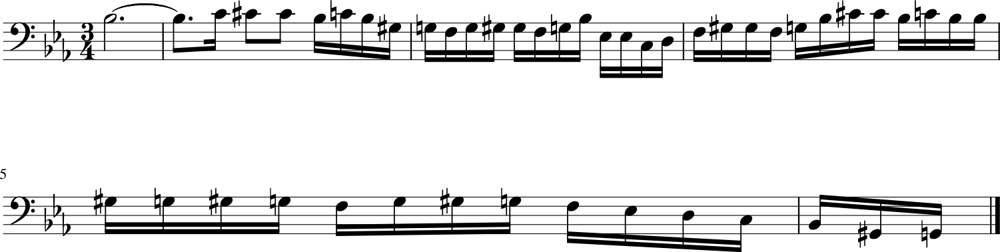

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5213 - loss: 1.1261 - note_outputs_loss: 0.6049
Epoch 984/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - duration_outputs_loss: 0.5451 - loss: 1.1603 - note_outputs_loss: 0.6152
Generation prompt: [['START', 'F:major', '3/4TS', 'D4', 'D4', 'D4', 'D4', 'A3', 'B-3', 'A3', 'G3', 'F3', 'G3', 'A3', 'F3', 'G3', 'C#4', 'D3', 'G#2', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'G2', 'B2', 'C3', 'G3', 'E-3', 'C4', 'G3', 'C4', 'G3', 'G#3', 'B3', 'B-3', 'G#3', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'F3', 'D3', 'G#2', 'F3', 'E-3', 'D3', 'C3'], ['0.0', '0.0', '0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


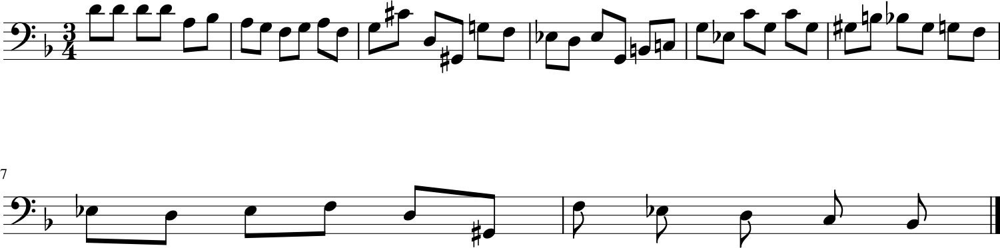

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5449 - loss: 1.1603 - note_outputs_loss: 0.6154
Epoch 985/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5455 - loss: 1.1585 - note_outputs_loss: 0.6130
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'F3', 'G3', 'G#3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


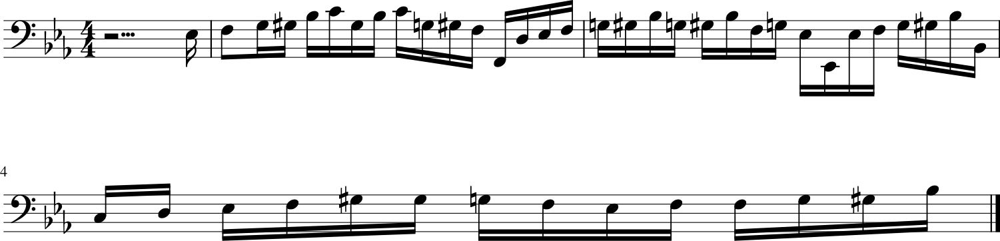

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5452 - loss: 1.1584 - note_outputs_loss: 0.6132
Epoch 986/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5526 - loss: 1.1599 - note_outputs_loss: 0.6073
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]

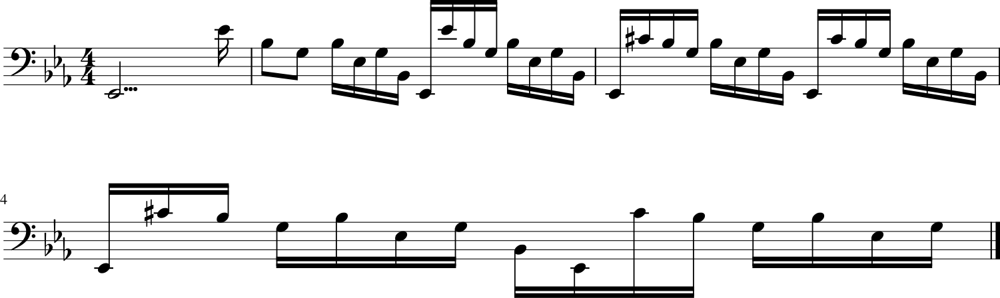

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5523 - loss: 1.1598 - note_outputs_loss: 0.6075
Epoch 987/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4811 - loss: 1.0708 - note_outputs_loss: 0.5896
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'E4', 'E4', 'C#4', 'C#4', 'A3', 'A3', 'G3', 'G3', 'A4', 'A4', 'F#4', 'F#4'], ['0.0', '1.0', '1.0', '1.0', '1.0', '0.5', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0', '1.0']]


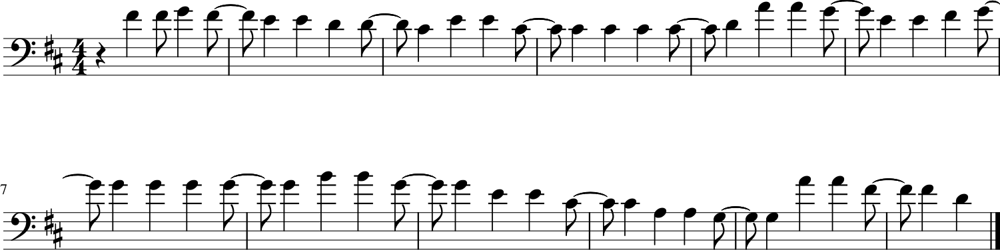

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4815 - loss: 1.0715 - note_outputs_loss: 0.5900
Epoch 988/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4700 - loss: 1.0797 - note_outputs_loss: 0.6097
Generation prompt: [['START', 'G:major', '3/4TS', 'B3', 'C4', 'B3', 'F#3', 'A3', 'B3', 'C4', 'B3', 'A3', 'G3', 'D4', 'F3', 'E3', 'D3', 'C3', 'E3', 'F#3', 'C4', 'B3', 'G3', 'F#3', 'E3', 'D3', 'C3', 'B2', 'A2', 'G2', 'F#2', 'E2', 'D2', 'C#2', 'A2', 'E3', 'F#3', 'G3', 'E3', 'F#3', 'G3', 'C#2', 'A2', 'E3', 'F#3', 'G3', 'E3', 'F#3', 'G3'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1.0', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


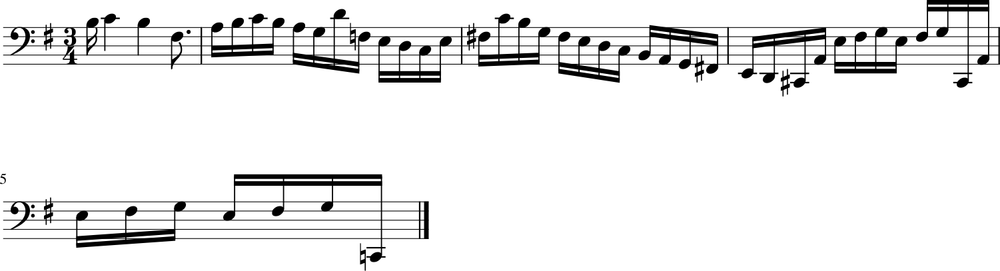

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4704 - loss: 1.0803 - note_outputs_loss: 0.6099
Epoch 989/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5682 - loss: 1.1759 - note_outputs_loss: 0.6077
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'E3', 'D3', 'C3', 'B-2', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'B-3', 'D3', 'C#3', 'B2', 'A2', 'G2', 'D3', 'E3', 'E3', 'D3', 'E3', 'F3', 'D3', 'E3', 'C3', 'C2', 'B2', 'C#3', 'E3', 'A3', 'E3', 'D4', 'C#4', 'B3', 'C#4', 'A3', 'E4', 'G3', 'F#3', 'D4'], ['0.0', '2.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


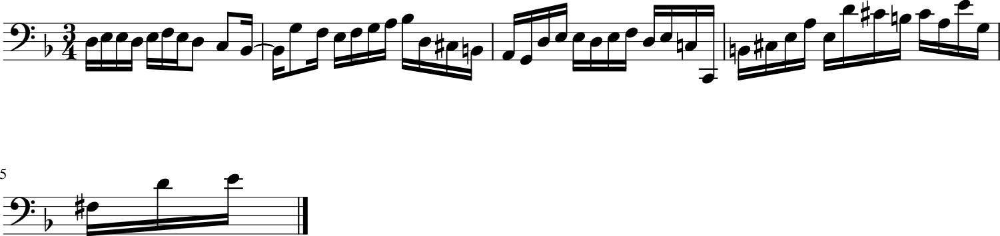

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - duration_outputs_loss: 0.5677 - loss: 1.1756 - note_outputs_loss: 0.6079
Epoch 990/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5500 - loss: 1.1531 - note_outputs_loss: 0.6031
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'B-3', 'E-3', 'B-3', 'F#3', 'E-3', 'D3', 'D4', 'D4', 'D4', 'G#3', 'F3', 'D4', 'E4', 'B3', 'G#3', 'A3', 'B3', 'C#4', 'F#3', 'E4', 'D4', 'C#4', 'D4', 'C#4', 'D4', 'F#4', 'C4', 'A3', 'B3', 'C#4'], ['0.0', '0.0', '0.0', '2.5', '0.5', '0.5', '0.5', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


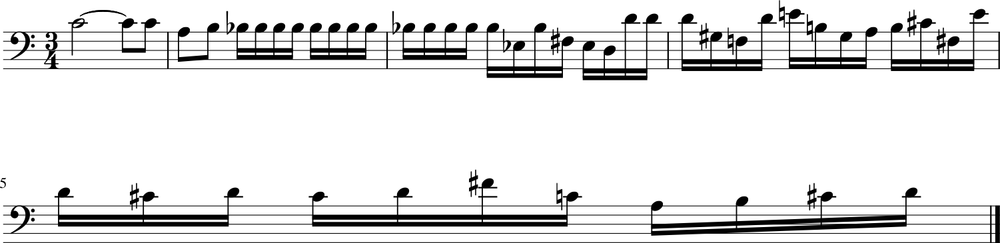

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5497 - loss: 1.1531 - note_outputs_loss: 0.6034
Epoch 991/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4981 - loss: 1.1225 - note_outputs_loss: 0.6243
Generation prompt: [['START', 'C:major', '3/4TS', 'C4', 'C4', 'A3', 'B3', 'B-3', 'G3', 'A3', 'D3', 'E3', 'C3', 'G2', 'F2', 'B-3', 'G3', 'D3', 'B-3', 'G#3', 'G3', 'F3', 'E3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'G#3', 'G3', 'F3', 'G3', 'F3', 'E-3', 'D3', 'G#2', 'G2', 'B-2', 'D3', 'E-3', 'E-3', 'C4', 'F3', 'E-3', 'E-3', 'F3', 'D3', 'B-2'], ['0.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


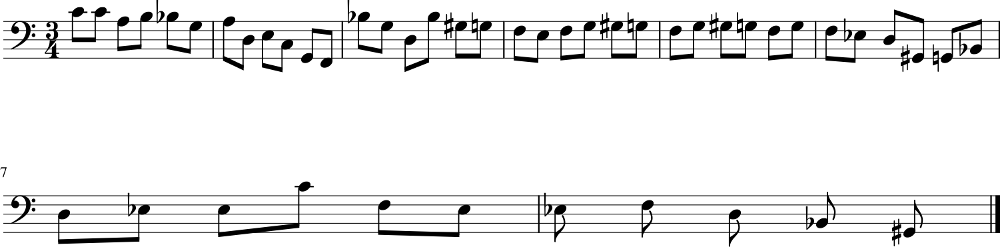

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.4983 - loss: 1.1227 - note_outputs_loss: 0.6244
Epoch 992/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5146 - loss: 1.0992 - note_outputs_loss: 0.5846
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'E4', 'E4', 'C#4', 'C#4', 'A3', 'A3', 'G3', 'G3', 'A4', 'A4', 'F#4', 'F#4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.75', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


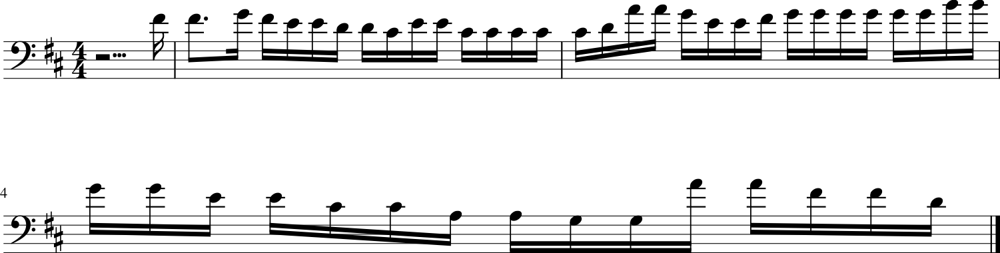

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5147 - loss: 1.0997 - note_outputs_loss: 0.5850
Epoch 993/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5507 - loss: 1.1588 - note_outputs_loss: 0.6080
Generation prompt: [['START', 'E-:major', '4/4TS', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'E-4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3', 'G3', 'B-2', 'E-2', 'C#4', 'B-3', 'G3', 'B-3', 'E-3'], ['0.0', '5.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


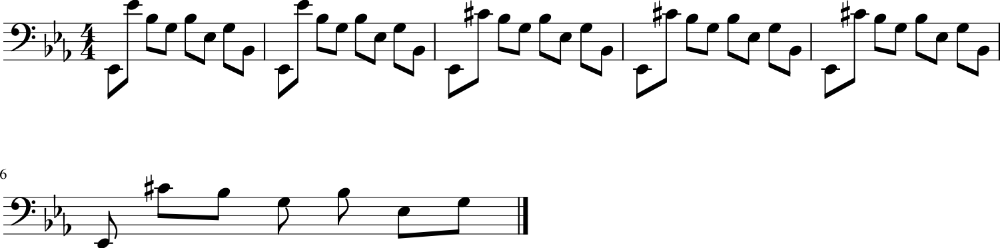

107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - duration_outputs_loss: 0.5505 - loss: 1.1587 - note_outputs_loss: 0.6082
Epoch 994/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5191 - loss: 1.1120 - note_outputs_loss: 0.5929
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


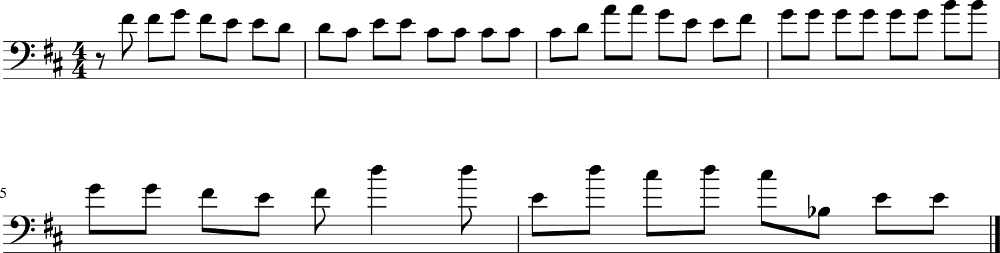

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - duration_outputs_loss: 0.5191 - loss: 1.1123 - note_outputs_loss: 0.5932
Epoch 995/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5264 - loss: 1.1108 - note_outputs_loss: 0.5844
Generation prompt: [['START', 'E-:major', '4/4TS', 'C3', 'C3', 'G2', 'A2', 'B2', 'C3', 'D3', 'E-3', 'F3', 'E-3', 'D3', 'E-3', 'C3', 'G#3', 'G#3', 'G3', 'G#3', 'F3', 'E-3', 'F3', 'E-3', 'E-3', 'D3', 'C3', 'B2', 'D3', 'C3', 'B2', 'A2', 'G2', 'D3', 'F3', 'B3', 'D4', 'G3', 'F3', 'E-3', 'D3', 'E-3', 'C2', 'D2', 'E-2', 'F2', 'G2', 'D4', 'C4'], ['0.0', '0.0', '0.0', '1.0', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


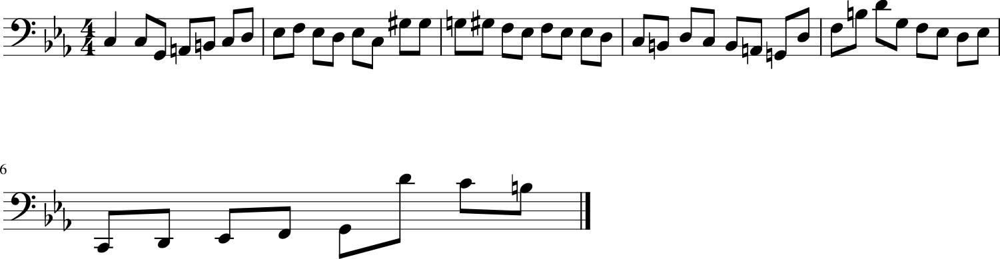

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5263 - loss: 1.1111 - note_outputs_loss: 0.5848
Epoch 996/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5620 - loss: 1.1544 - note_outputs_loss: 0.5923
Generation prompt: [['START', 'E-:major', '4/4TS', 'rest', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'C4', 'G#3', 'B-3', 'C4', 'G3', 'G#3', 'F3', 'F2', 'D3', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'G3', 'G#3', 'B-3', 'F3', 'G3', 'E-3', 'E-2', 'E-3', 'F3', 'G3', 'G#3', 'B-3', 'B-2', 'C3', 'D3', 'E-3', 'F3', 'G#3', 'G#3', 'G3', 'F3', 'E-3', 'F3', 'E-3', 'F3', 'G3'], ['0.0', '0.0', '0.0', '3.75', '0.25', '0.5', '0.5', '1/6', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


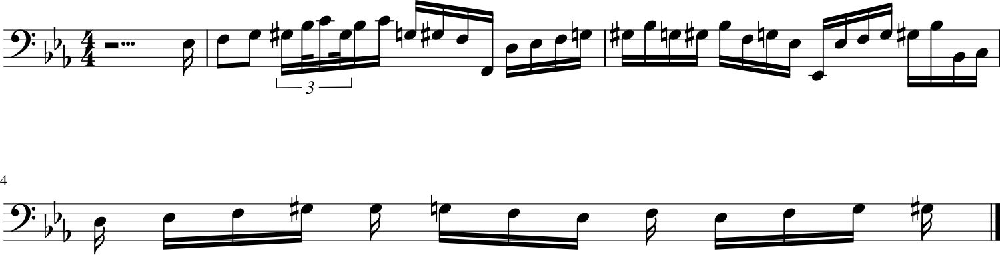

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5616 - loss: 1.1543 - note_outputs_loss: 0.5927
Epoch 997/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5070 - loss: 1.1227 - note_outputs_loss: 0.6157
Generation prompt: [['START', 'C:major', '4/4TS', 'rest', 'G3', 'A3', 'B3', 'C4', 'B3', 'G3', 'F3', 'E3', 'G3', 'E3', 'D3', 'C3', 'G2', 'E2', 'D2', 'C2', 'C3', 'D3', 'E3', 'F3', 'E3', 'E3', 'G3', 'D3', 'C3', 'C3', 'G3', 'B2', 'A2', 'G2', 'G3', 'F3', 'G3', 'E3', 'A2', 'G3', 'C4', 'E3', 'F3', 'E3', 'F3', 'D3', 'G2', 'F3', 'B3'], ['0.0', '2.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5', '0.5']]


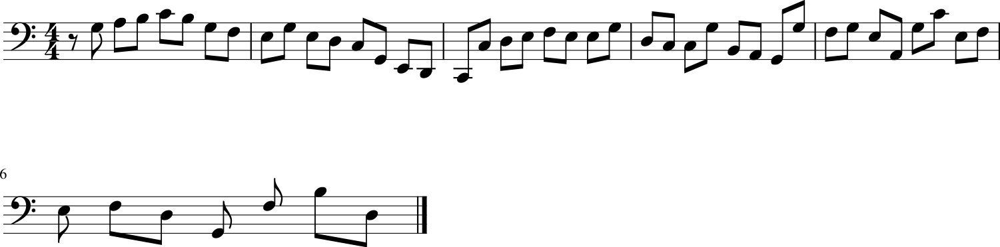

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5071 - loss: 1.1229 - note_outputs_loss: 0.6158
Epoch 998/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4981 - loss: 1.1181 - note_outputs_loss: 0.6200
Generation prompt: [['START', 'F:major', '3/4TS', 'D3', 'F3', 'A3', 'F3', 'E3', 'D3', 'C#3', 'E3', 'G3', 'A3', 'B-3', 'A3', 'G3', 'F3', 'E3', 'G3', 'B-3', 'C#4', 'E4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'F3', 'G3', 'A3', 'F3', 'D3', 'C3', 'B-2', 'A2', 'B-2', 'D3', 'F3', 'A3', 'D4', 'C4', 'B-3', 'A3', 'G3', 'F3', 'E3', 'G3', 'B-3', 'D4'], ['0.0', '0.0', '0.0', '3.75', '0.25', '1.0', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


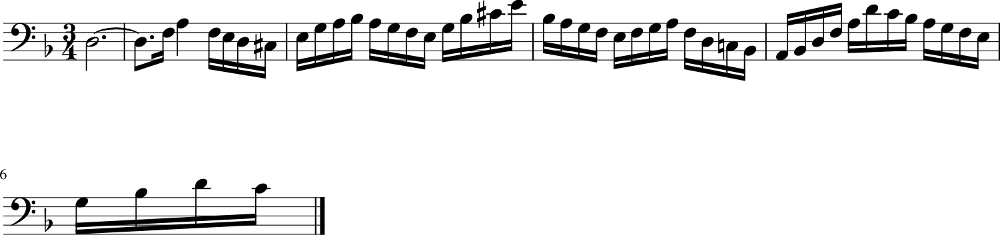

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4983 - loss: 1.1184 - note_outputs_loss: 0.6201
Epoch 999/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.5108 - loss: 1.1333 - note_outputs_loss: 0.6225
Generation prompt: [['START', 'D:major', '4/4TS', 'rest', 'F#4', 'F#4', 'G4', 'F#4', 'E4', 'E4', 'D4', 'D4', 'C#4', 'E4', 'E4', 'C#4', 'C#4', 'C#4', 'C#4', 'C#4', 'D4', 'A4', 'A4', 'G4', 'E4', 'E4', 'F#4', 'G4', 'G4', 'G4', 'G4', 'G4', 'G4', 'B4', 'B4', 'G4', 'G4', 'F#4', 'E4', 'F#4', 'D5', 'D5', 'E4', 'D5', 'C#5', 'D5', 'C#5', 'B-3', 'E4'], ['0.0', '0.0', '0.0', '3.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


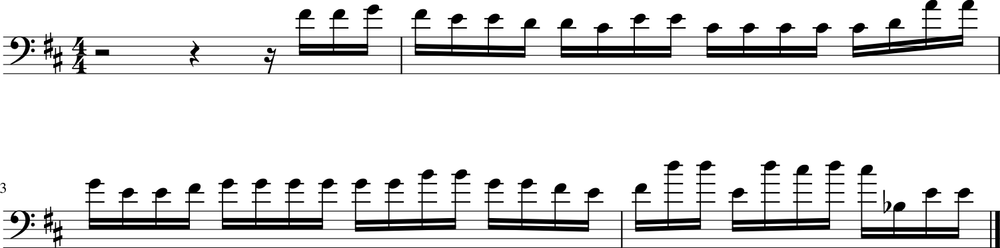

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.5109 - loss: 1.1334 - note_outputs_loss: 0.6225
Epoch 1000/1000
107/107 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - duration_outputs_loss: 0.4641 - loss: 1.0606 - note_outputs_loss: 0.5965
Generation prompt: [['START', 'C:major', '3/8TS', 'rest', 'G3', 'C4', 'C3', 'D3', 'E3', 'F3', 'G3', 'A3', 'B3', 'C4', 'G3', 'E4', 'C4', 'G3', 'E4', 'D4', 'C4', 'D4', 'E4', 'F4', 'B3', 'C4', 'E3', 'G2', 'D3', 'C4', 'B3', 'G3', 'D4', 'D4', 'F#3', 'G3', 'E3', 'E4', 'D4', 'C4', 'B3', 'C4', 'A2', 'B2', 'C3', 'D3', 'E3', 'A2', 'C4'], ['0.0', '0.0', '3.75', '0.25', '1.0', '1/3', '1/3', '1/12', '1/6', '1/12', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25', '0.25']]


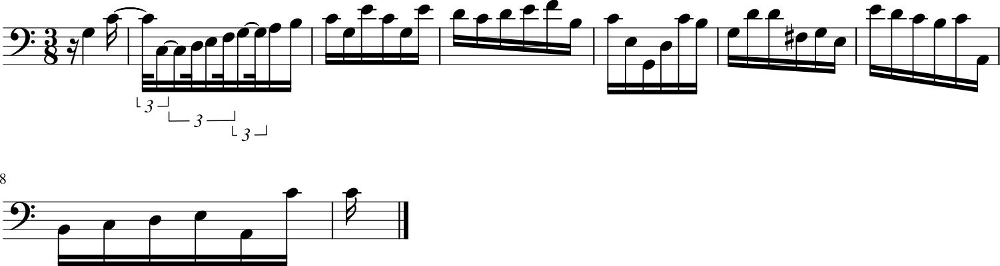

107/107 ━━━━━━━━━━━━━━━━━━━━ 7s 62ms/step - duration_outputs_loss: 0.4646 - loss: 1.0614 - note_outputs_loss: 0.5968


In [41]:
# Train the model
model.fit(
    ds,
    epochs=EPOCHS,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        music_generator,
    ],
)

In [55]:
# Save the final model
os.makedirs("./models", exist_ok=True)
model.save("./models/model.keras")

# Music Generation

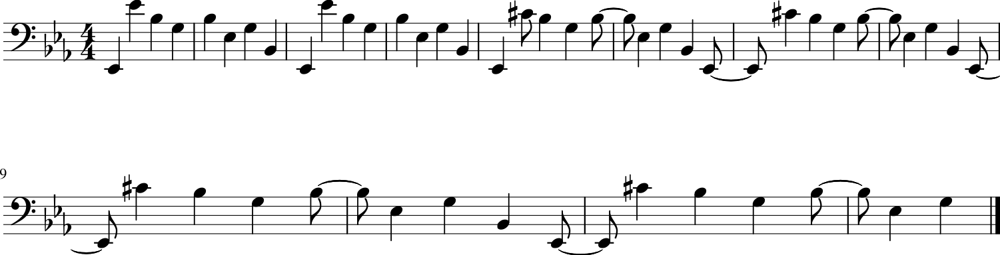

In [56]:
# Generate music
info = music_generator.generate(
    ["START"],
    ["0.0"],
    max_tokens=50,
    temperature=0.5
)
midi_stream = info[-1]["midi"].chordify()
midi_stream.show()

In [57]:
# Generate a timestamped MIDI file path
timestr = time.strftime("%Y%m%d-%H%M%S")
midi_file_path = os.path.join("/content/output", "output-" + timestr + ".mid")

# Write music to the MIDI file
midi_stream.write("midi", fp=midi_file_path)

'/content/output/output-20250215-090858.mid'

In [58]:
def display_note_probabilities(info, notes_vocab, max_pitch=70, pitch_min=35, pitch_max=70, figsize=(8, 8), vmin=-0.5, vmax=0.5):
    """
    Displays a heatmap of note probabilities over time.

    Args:
        info (list): A list of dictionaries produced by the MusicGenerator,
            where each dictionary contains a "note_probs" key with a list or array
            of note probabilities.
        notes_vocab (list): A list mapping token indices to note strings.
        max_pitch (int): Maximum MIDI pitch value for the grid (default is 70).
        pitch_min (int): Minimum MIDI pitch value to display (default is 35).
        pitch_max (int): Maximum MIDI pitch value to display (default is 70).
        figsize (tuple): Figure size for the plot.
        vmin (float): Minimum value for colormap scaling.
        vmax (float): Maximum value for colormap scaling.
    """
    seq_len = len(info)
    grid = np.zeros((max_pitch, seq_len), dtype=np.float32)

    # Fill the grid with note probabilities
    for j in range(seq_len):
        for i, prob in enumerate(info[j]["note_probs"]):
            try:
                # Convert token index to MIDI pitch using music21's Note
                pitch = music21.note.Note(notes_vocab[i]).pitch.midi
                if pitch < max_pitch:
                    grid[pitch, j] = prob
            except Exception:
                # Skip tokens that cannot be converted to a note
                pass

    # Plot the heatmap for the specified pitch range
    fig, ax = plt.subplots(figsize=figsize)
    ax.set_yticks(np.arange(pitch_min, pitch_max))
    im = ax.imshow(
        grid[pitch_min:pitch_max, :],
        origin="lower",
        cmap="coolwarm",
        vmin=vmin,
        vmax=vmax,
        extent=[0, seq_len, pitch_min, pitch_max],
    )
    plt.colorbar(im, ax=ax)
    plt.xlabel("Sequence Position")
    plt.ylabel("MIDI Pitch")
    plt.title("Note Probabilities")
    plt.show()

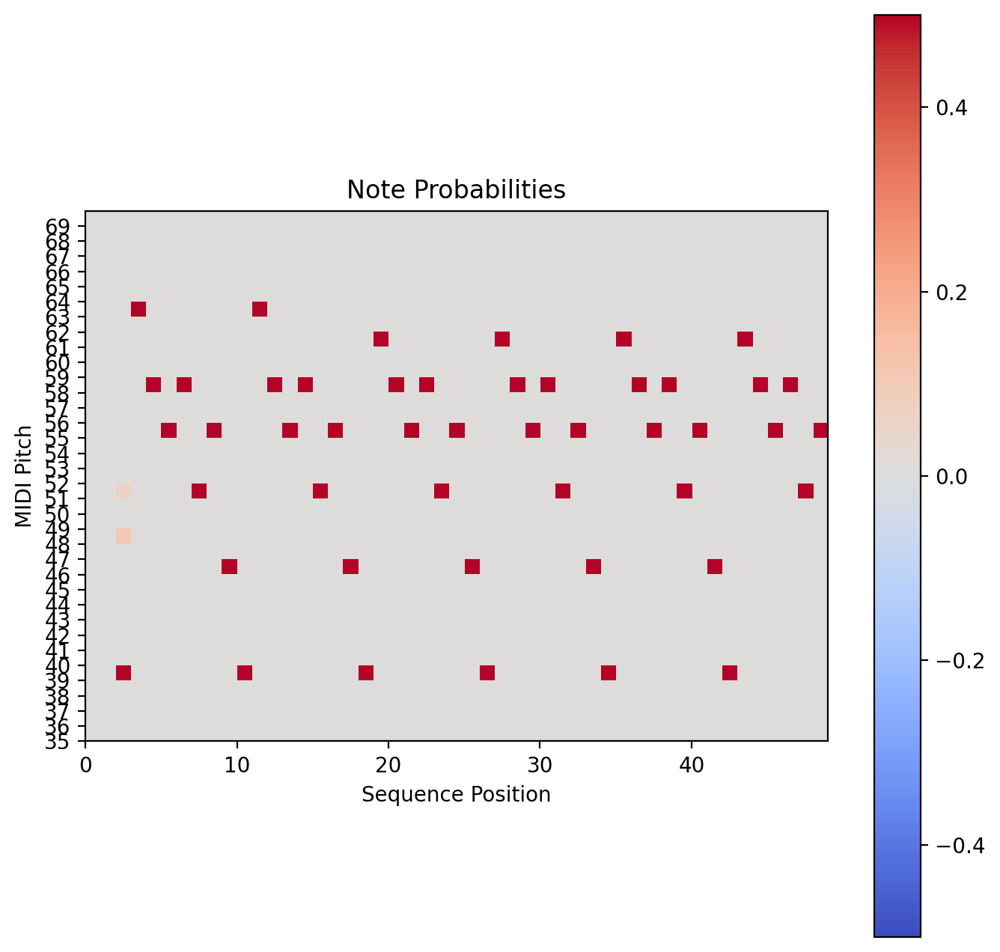

In [59]:
# Display note probabilities
display_note_probabilities(info, notes_vocab)

In [60]:
def display_attention_plot(info, plot_size=20, figsize=(8, 8)):
    """
    Displays an attention heatmap based on the information generated by the MusicGenerator.

    Args:
        info (list): A list of dictionaries produced by MusicGenerator, where each dictionary
            contains an "atts" key with the attention scores, a "chosen_note" key, and a "prompt" key.
        plot_size (int): The number of time steps (rows/columns) to display (default is 20).
        figsize (tuple): Figure size for the plot (default is (8, 8)).
    """
    att_matrix = np.zeros((plot_size, plot_size))
    prediction_output = []
    last_prompt = []

    for j in range(plot_size):
        # Get the maximum attention over all heads for time step j
        atts = info[j]["atts"].max(axis=0)
        att_matrix[:(j + 1), j] = atts
        prediction_output.append(info[j]["chosen_note"][0])
        last_prompt.append(info[j]["prompt"][0][-1])

    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(att_matrix, cmap="Greens", interpolation="nearest")

    # Set minor grid lines for clarity
    ax.set_xticks(np.arange(-0.5, plot_size, 1), minor=True)
    ax.set_yticks(np.arange(-0.5, plot_size, 1), minor=True)
    ax.grid(which="minor", color="black", linestyle="-", linewidth=1)

    # Set major ticks and labels
    ax.set_xticks(np.arange(plot_size))
    ax.set_yticks(np.arange(plot_size))
    ax.set_xticklabels(prediction_output[:plot_size])
    ax.set_yticklabels(last_prompt[:plot_size])
    ax.xaxis.tick_top()

    plt.setp(
        ax.get_xticklabels(),
        rotation=90,
        ha="left",
        va="center",
        rotation_mode="anchor",
    )
    plt.show()

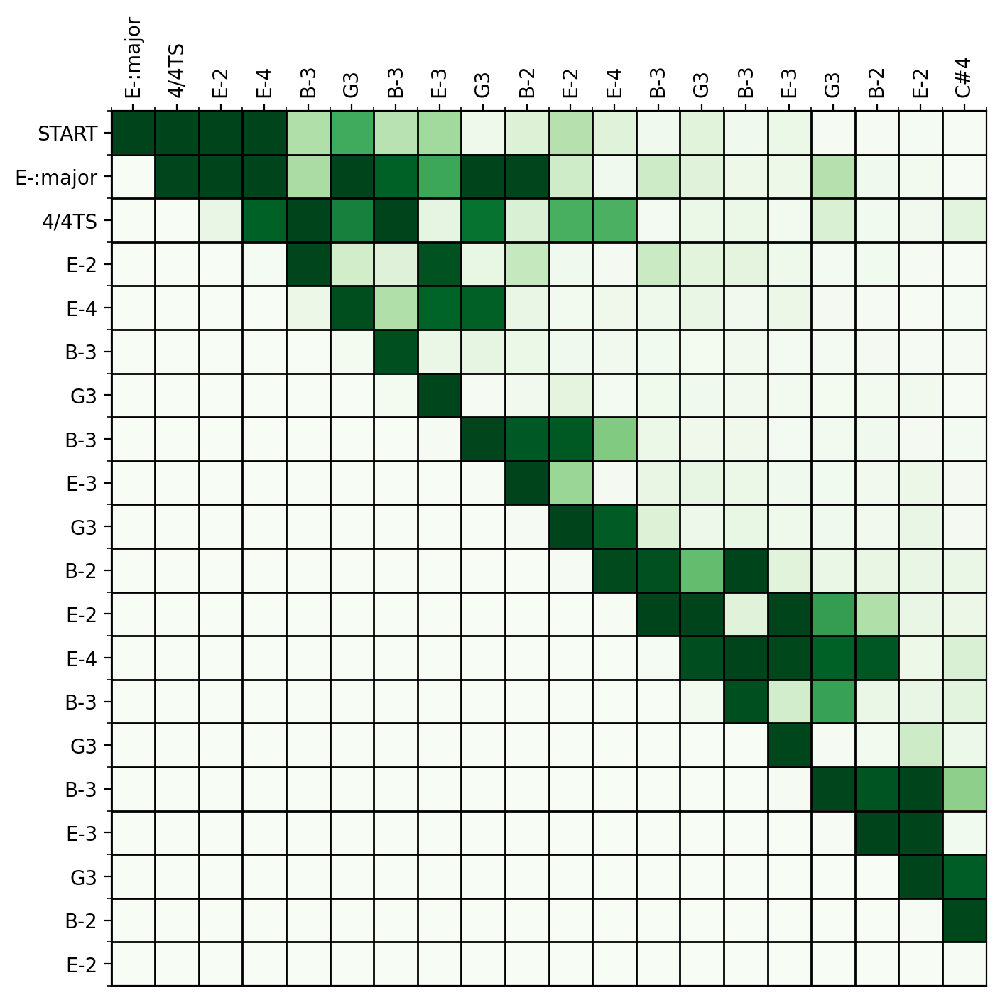

In [61]:
# Display attention plot
display_attention_plot(info, plot_size=20, figsize=(8, 8))

In [62]:
!pip install -q midi2audio

In [66]:
!apt-get update && apt-get install -y fluidsynth

Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:6 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:7 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:8 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Get:9 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Fetched 388 kB in 2s (241 kB/s)
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
R

In [67]:
from midi2audio import FluidSynth
from IPython.display import Audio
import os

In [68]:
def play_midi_file(midi_path):
    # Create a corresponding WAV file path
    wav_path = os.path.splitext(midi_path)[0] + ".wav"
    # Convert MIDI to WAV using FluidSynth
    fs = FluidSynth()
    fs.midi_to_audio(midi_path, wav_path)
    # Return an IPython Audio object
    return Audio(wav_path)

In [69]:
# Convert the generated MIDI file and display the audio player
audio = play_midi_file(midi_file_path)
display(audio)